# Importing Necessary Libraries

In [3]:
pip install --upgrade

Note: you may need to restart the kernel to use updated packages.


ERROR: You must give at least one requirement to install (see "pip help install")


In [125]:
#importing all the necessary liraries
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder,OneHotEncoder
import matplotlib.pyplot as plt

import keras
from keras.models import Sequential
from keras. layers import Activation
from keras.layers.core import Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import categorical_crossentropy
from tensorflow.keras.utils import to_categorical

# Loading Data

In [126]:
#Loading dataset
trainDataSet = pd.read_csv(r"C:\Users\bisha\OneDrive\Desktop\hrv dataset\data\final\train.csv")

In [127]:
#displaying data sample
trainDataSet.head()

,MEAN_RR,MEDIAN_RR,SDRR,RMSSD,SDSD,SDRR_RMSSD,HR,pNN25,pNN50,SD1,...,HF,HF_PCT,HF_NU,TP,LF_HF,HF_LF,sampen,higuci,datasetId,condition
0,885.157845,853.763730,140.972741,15.554505,15.553371,9.063146,69.499952,11.133333,0.533333,11.001565,...,15.522603,0.421047,1.514737,3686.666157,65.018055,0.015380,2.139754,1.163485,2,no stress
1,939.425371,948.357865,81.317742,12.964439,12.964195,6.272369,64.363150,5.600000,0.000000,9.170129,...,2.108525,0.070133,0.304603,3006.487251,327.296635,0.003055,2.174499,1.084711,2,interruption
2,898.186047,907.006860,84.497236,16.305279,16.305274,5.182201,67.450066,13.066667,0.200000,11.533417,...,13.769729,0.512671,1.049528,2685.879461,94.280910,0.010607,2.135350,1.176315,2,interruption
3,881.757865,893.460030,90.370537,15.720468,15.720068,5.748591,68.809562,11.800000,0.133333,11.119476,...,18.181913,0.529387,1.775294,3434.520980,55.328701,0.018074,2.178341,1.179688,2,no stress
4,809.625331,811.184865,62.766242,19.213819,19.213657,3.266724,74.565728,20.200000,0.200000,13.590641,...,48.215822,1.839473,3.279993,2621.175204,29.487873,0.033912,2.221121,1.249612,2,no stress


In [128]:
#loading test sample
testDataSet = pd.read_csv(r"C:\Users\bisha\OneDrive\Desktop\hrv dataset\data\final\train.csv")

In [129]:
#displaying test sample
testDataSet.head()

,MEAN_RR,MEDIAN_RR,SDRR,RMSSD,SDSD,SDRR_RMSSD,HR,pNN25,pNN50,SD1,...,HF,HF_PCT,HF_NU,TP,LF_HF,HF_LF,sampen,higuci,datasetId,condition
0,885.157845,853.763730,140.972741,15.554505,15.553371,9.063146,69.499952,11.133333,0.533333,11.001565,...,15.522603,0.421047,1.514737,3686.666157,65.018055,0.015380,2.139754,1.163485,2,no stress
1,939.425371,948.357865,81.317742,12.964439,12.964195,6.272369,64.363150,5.600000,0.000000,9.170129,...,2.108525,0.070133,0.304603,3006.487251,327.296635,0.003055,2.174499,1.084711,2,interruption
2,898.186047,907.006860,84.497236,16.305279,16.305274,5.182201,67.450066,13.066667,0.200000,11.533417,...,13.769729,0.512671,1.049528,2685.879461,94.280910,0.010607,2.135350,1.176315,2,interruption
3,881.757865,893.460030,90.370537,15.720468,15.720068,5.748591,68.809562,11.800000,0.133333,11.119476,...,18.181913,0.529387,1.775294,3434.520980,55.328701,0.018074,2.178341,1.179688,2,no stress
4,809.625331,811.184865,62.766242,19.213819,19.213657,3.266724,74.565728,20.200000,0.200000,13.590641,...,48.215822,1.839473,3.279993,2621.175204,29.487873,0.033912,2.221121,1.249612,2,no stress


In [130]:
#Looking for the shape of test data set
testDataSet.shape

(369289, 36)

In [131]:
#checking if there are any null values
testDataSet.isnull().sum()

MEAN_RR              0
MEDIAN_RR            0
SDRR                 0
RMSSD                0
SDSD                 0
SDRR_RMSSD           0
HR                   0
pNN25                0
pNN50                0
SD1                  0
SD2                  0
KURT                 0
SKEW                 0
MEAN_REL_RR          0
MEDIAN_REL_RR        0
SDRR_REL_RR          0
RMSSD_REL_RR         0
SDSD_REL_RR          0
SDRR_RMSSD_REL_RR    0
KURT_REL_RR          0
SKEW_REL_RR          0
VLF                  0
VLF_PCT              0
LF                   0
LF_PCT               0
LF_NU                0
HF                   0
HF_PCT               0
HF_NU                0
TP                   0
LF_HF                0
HF_LF                0
sampen               0
higuci               0
datasetId            0
condition            0
dtype: int64

# Preprocessing

In [132]:
#Droping unnecessary columns
trainSamples = trainDataSet.drop(['condition','datasetId'], axis = 1)

In [133]:
trainSamples

,MEAN_RR,MEDIAN_RR,SDRR,RMSSD,SDSD,SDRR_RMSSD,HR,pNN25,pNN50,SD1,...,LF_PCT,LF_NU,HF,HF_PCT,HF_NU,TP,LF_HF,HF_LF,sampen,higuci
0,885.157845,853.763730,140.972741,15.554505,15.553371,9.063146,69.499952,11.133333,0.533333,11.001565,...,27.375666,98.485263,15.522603,0.421047,1.514737,3686.666157,65.018055,0.015380,2.139754,1.163485
1,939.425371,948.357865,81.317742,12.964439,12.964195,6.272369,64.363150,5.600000,0.000000,9.170129,...,22.954139,99.695397,2.108525,0.070133,0.304603,3006.487251,327.296635,0.003055,2.174499,1.084711
2,898.186047,907.006860,84.497236,16.305279,16.305274,5.182201,67.450066,13.066667,0.200000,11.533417,...,48.335104,98.950472,13.769729,0.512671,1.049528,2685.879461,94.280910,0.010607,2.135350,1.176315
3,881.757865,893.460030,90.370537,15.720468,15.720068,5.748591,68.809562,11.800000,0.133333,11.119476,...,29.290305,98.224706,18.181913,0.529387,1.775294,3434.520980,55.328701,0.018074,2.178341,1.179688
4,809.625331,811.184865,62.766242,19.213819,19.213657,3.266724,74.565728,20.200000,0.200000,13.590641,...,54.242160,96.720007,48.215822,1.839473,3.279993,2621.175204,29.487873,0.033912,2.221121,1.249612
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
369284,721.396910,721.533965,36.377559,9.609941,9.609936,3.785409,83.384647,0.933333,0.000000,6.797519,...,48.219676,89.119683,38.227175,5.886975,10.880317,649.351702,8.190908,0.122087,2.096850,1.314910
369285,984.266492,978.622945,74.918433,13.762274,13.761705,5.443754,61.314243,6.333333,0.200000,9.734243,...,31.481178,99.642453,2.573834,0.112964,0.357547,2278.456746,278.683532,0.003588,2.131264,1.175975
369286,1025.499743,1024.968400,95.309200,23.051254,23.050395,4.134664,59.028594,30.400000,2.066667,16.304530,...,54.870376,99.819930,4.287216,0.098983,0.180070,4331.259564,554.340761,0.001804,2.215643,1.140232
369287,798.123167,803.559610,78.449897,16.736686,16.736657,4.687302,75.978628,10.000000,1.466667,11.838553,...,43.587168,96.477005,46.636158,1.591647,3.522995,2930.056129,27.384942,0.036516,2.091628,1.181937


In [134]:
trainSamples.shape


(369289, 34)

# Extracting labels from train and test dataset

In [135]:
trainLabels = trainDataSet['condition']

In [136]:
trainLabels = pd.get_dummies(trainDataSet['condition'])

In [137]:
trainLabels

,interruption,no stress,time pressure
0,0,1,0
1,1,0,0
2,1,0,0
3,0,1,0
4,0,1,0
...,...,...,...
369284,0,1,0
369285,0,1,0
369286,0,1,0
369287,0,1,0


In [138]:
testSamples = testDataSet.drop(['condition','datasetId'], axis = 1)


In [139]:
testLabels = testDataSet['condition']

In [140]:
testLabels= pd.get_dummies(testDataSet['condition'])

In [141]:
testLabels

,interruption,no stress,time pressure
0,0,1,0
1,1,0,0
2,1,0,0
3,0,1,0
4,0,1,0
...,...,...,...
369284,0,1,0
369285,0,1,0
369286,0,1,0
369287,0,1,0


# Normalization

In [142]:
#Normalizing using Min Max Scaler
scaling = MinMaxScaler(feature_range=(0,1))
trainSamples = scaling.fit_transform(trainSamples)

In [143]:
trainSamples

array([[0.43596493, 0.29623337, 0.21209913, ..., 0.03539462, 0.94718154,
        0.39574294],
       [0.50603051, 0.37951539, 0.100855  , ..., 0.00679268, 0.96648135,
        0.15501473],
       [0.45278583, 0.34310938, 0.10678409, ..., 0.02431648, 0.94473507,
        0.43494913],
       ...,
       [0.61716237, 0.4469644 , 0.12694615, ..., 0.00388866, 0.98933569,
        0.32468371],
       [0.32359321, 0.25203294, 0.09550707, ..., 0.0844439 , 0.92044908,
        0.45213052],
       [0.34464579, 0.26226264, 0.07545588, ..., 0.08234303, 0.98519767,
        0.61149533]])

In [144]:
testSamples = scaling.fit_transform(testSamples)

In [145]:
testSamples

array([[0.43596493, 0.29623337, 0.21209913, ..., 0.03539462, 0.94718154,
        0.39574294],
       [0.50603051, 0.37951539, 0.100855  , ..., 0.00679268, 0.96648135,
        0.15501473],
       [0.45278583, 0.34310938, 0.10678409, ..., 0.02431648, 0.94473507,
        0.43494913],
       ...,
       [0.61716237, 0.4469644 , 0.12694615, ..., 0.00388866, 0.98933569,
        0.32468371],
       [0.32359321, 0.25203294, 0.09550707, ..., 0.0844439 , 0.92044908,
        0.45213052],
       [0.34464579, 0.26226264, 0.07545588, ..., 0.08234303, 0.98519767,
        0.61149533]])

# Normalization and Encoding


In [146]:
trainDataSet.condition.value_counts()

no stress        200082
interruption     105150
time pressure     64057
Name: condition, dtype: int64

In [147]:
pd.DataFrame(trainLabels) 

,interruption,no stress,time pressure
0,0,1,0
1,1,0,0
2,1,0,0
3,0,1,0
4,0,1,0
...,...,...,...
369284,0,1,0
369285,0,1,0
369286,0,1,0
369287,0,1,0


In [148]:
trainLabels.shape

(369289, 3)

In [149]:

model = Sequential()
model.add(Dense(34, input_shape= (34,), activation = 'relu'))
model.add(Dense(64, activation = 'relu'))
model.add(Dense(36, activation = 'relu'))
model.add(Dense(12, activation = 'relu'))
model.add(Dense(9, activation = 'relu'))
model.add(Dense(3, activation = 'softmax'))

In [150]:
model.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_36 (Dense)             (None, 34)                1190      
_________________________________________________________________
dense_37 (Dense)             (None, 64)                2240      
_________________________________________________________________
dense_38 (Dense)             (None, 36)                2340      
_________________________________________________________________
dense_39 (Dense)             (None, 12)                444       
_________________________________________________________________
dense_40 (Dense)             (None, 9)                 117       
_________________________________________________________________
dense_41 (Dense)             (None, 3)                 30        
Total params: 6,361
Trainable params: 6,361
Non-trainable params: 0
____________________________________________________

In [151]:
model.compile(optimizer=Adam(learning_rate=0.0001),loss='categorical_crossentropy', metrics=['accuracy'])
trained_model = model.fit(trainSamples,trainLabels, validation_split=0.1 ,batch_size=100,epochs=50,shuffle=True,verbose=2)

Epoch 1/50
3324/3324 - 3s - loss: 0.8649 - accuracy: 0.6142 - val_loss: 0.7412 - val_accuracy: 0.6715
Epoch 2/50
3324/3324 - 3s - loss: 0.6487 - accuracy: 0.7337 - val_loss: 0.5849 - val_accuracy: 0.7582
Epoch 3/50
3324/3324 - 3s - loss: 0.5387 - accuracy: 0.7815 - val_loss: 0.5007 - val_accuracy: 0.7944
Epoch 4/50
3324/3324 - 3s - loss: 0.4729 - accuracy: 0.8063 - val_loss: 0.4482 - val_accuracy: 0.8230
Epoch 5/50
3324/3324 - 3s - loss: 0.4207 - accuracy: 0.8301 - val_loss: 0.4029 - val_accuracy: 0.8394
Epoch 6/50
3324/3324 - 3s - loss: 0.3787 - accuracy: 0.8493 - val_loss: 0.3592 - val_accuracy: 0.8669
Epoch 7/50
3324/3324 - 3s - loss: 0.3430 - accuracy: 0.8674 - val_loss: 0.3314 - val_accuracy: 0.8780
Epoch 8/50
3324/3324 - 3s - loss: 0.3146 - accuracy: 0.8808 - val_loss: 0.3041 - val_accuracy: 0.8894
Epoch 9/50
3324/3324 - 3s - loss: 0.2912 - accuracy: 0.8907 - val_loss: 0.2905 - val_accuracy: 0.8930
Epoch 10/50
3324/3324 - 3s - loss: 0.2707 - accuracy: 0.8987 - val_loss: 0.2702 - 

In [152]:
test_loss, test_acc = model.evaluate(testSamples,testLabels)

11541/11541 [==============================] - 8s 683us/step - loss: 0.0424 - accuracy: 0.9857


# Visualization


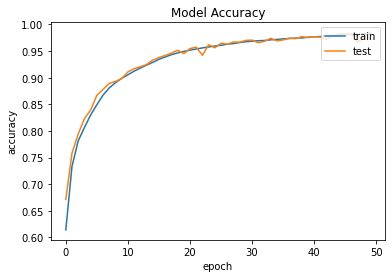

In [153]:
plt.plot(trained_model.history['accuracy'])
plt.plot(trained_model.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','test'],loc = 'upper right')

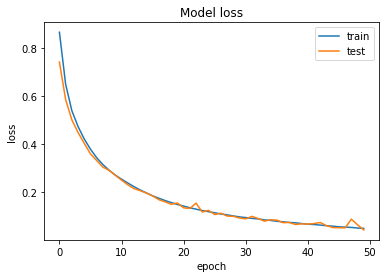

In [154]:
plt.plot(trained_model.history['loss'])
plt.plot(trained_model.history['val_loss'])
plt.title('Model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','test'],loc = 'upper right')

# Prediction

In [155]:
predictions = model.predict(testSamples, batch_size = 10, verbose = 2)

36929/36929 - 14s


In [156]:
for i in predictions:
    print (i)

[0.1350395  0.8370455  0.02791492]
[9.9946755e-01 5.3515617e-08 5.3242338e-04]
[9.9946040e-01 5.3389714e-04 5.7627849e-06]
[2.5063460e-03 9.9746585e-01 2.7836484e-05]
[0.00176046 0.99714845 0.0010911 ]
[1.6363035e-14 1.0000000e+00 2.5874464e-24]
[6.0267494e-06 9.9999189e-01 1.9947843e-06]
[5.8451195e-09 1.0000000e+00 4.7894647e-13]
[9.9988055e-01 1.1948664e-04 3.1151406e-09]
[3.4545918e-04 9.9951446e-01 1.4009507e-04]
[3.0322876e-03 1.4654727e-05 9.9695301e-01]
[8.4410414e-07 9.9999917e-01 7.9591951e-09]
[1.7527998e-05 9.9998248e-01 8.5843645e-14]
[9.8611045e-01 1.3855209e-02 3.4322507e-05]
[2.9837493e-05 9.9996722e-01 3.0218716e-06]
[1.3929011e-06 9.9999857e-01 2.0990374e-14]
[3.5344315e-04 7.3378760e-01 2.6585886e-01]
[1.10509645e-04 9.99889374e-01 1.60317668e-07]
[0.01656514 0.15909876 0.82433605]
[9.9765247e-01 2.3055680e-03 4.1981886e-05]
[1.1037971e-03 9.9889612e-01 4.4517954e-14]
[1.4024603e-04 9.9985969e-01 2.7739601e-15]
[0.17348894 0.56616074 0.26035032]
[1.00000000e+00 1.587

[1.04021645e-07 9.99999881e-01 2.74920069e-08]
[2.9850474e-01 7.0149523e-01 9.4768332e-08]
[0.0042856  0.97635615 0.01935818]
[2.5947356e-05 9.9997401e-01 5.6294509e-13]
[1.1859344e-06 9.9999881e-01 5.9992435e-13]
[8.5801374e-05 9.9991059e-01 3.5989858e-06]
[0.0813703  0.03819251 0.88043714]
[1.0000000e+00 7.6472726e-12 1.3926746e-08]
[6.4970000e-04 9.9934918e-01 1.0312576e-06]
[3.3562595e-03 9.9664378e-01 9.1732853e-16]
[1.3932705e-06 9.9999857e-01 4.8012861e-16]
[1.5302131e-01 2.5571779e-05 8.4695309e-01]
[1.03121065e-05 9.99989629e-01 5.36664686e-08]
[2.9740701e-04 9.9970251e-01 4.2069113e-09]
[3.9792624e-03 9.9559158e-01 4.2911817e-04]
[6.1826257e-04 5.7982602e-03 9.9358350e-01]
[7.4405498e-06 9.9401867e-01 5.9738318e-03]
[2.3945149e-06 9.9999762e-01 3.1358587e-09]
[9.9998164e-01 1.8307504e-05 1.7834458e-11]
[1.5579586e-08 1.0000000e+00 2.6015657e-12]
[7.4742029e-06 9.9975711e-01 2.3538888e-04]
[7.0295886e-05 9.9992967e-01 5.7739947e-20]
[1.370912e-06 9.995289e-01 4.696453e-04]
[9.

[9.9193341e-01 8.0666225e-03 2.0725677e-10]
[0.00990233 0.41450933 0.5755884 ]
[9.9997485e-01 6.6048358e-07 2.4428948e-05]
[2.6023386e-05 9.9997401e-01 2.1260236e-09]
[0.00422703 0.9943784  0.00139457]
[1.0000000e+00 2.5444338e-08 6.7515269e-12]
[0.00108525 0.00479714 0.9941176 ]
[0.09547819 0.01539764 0.88912416]
[9.9957365e-01 4.2635819e-04 1.1666660e-09]
[9.9475503e-01 3.9114326e-04 4.8538544e-03]
[3.7067817e-03 9.4396310e-05 9.9619883e-01]
[6.2093241e-03 3.4852914e-05 9.9375582e-01]
[3.2087101e-04 9.9749160e-01 2.1876432e-03]
[1.6160229e-06 9.9999833e-01 1.0470020e-08]
[0.00382099 0.99171877 0.00446029]
[3.8863120e-05 9.9996114e-01 3.9318798e-10]
[9.9999654e-01 3.4871728e-06 1.8685578e-10]
[2.6325483e-07 3.0644642e-07 9.9999940e-01]
[1.000000e+00 9.345518e-09 9.295614e-13]
[4.3958389e-05 9.9995565e-01 3.5890864e-07]
[9.9981159e-01 1.8730990e-04 1.1120459e-06]
[2.1674402e-06 9.9999785e-01 1.6729177e-09]
[4.9429739e-01 5.0552738e-01 1.7521715e-04]
[9.6381855e-06 9.9943966e-01 5.50719

[2.5394317e-03 1.4255180e-05 9.9744630e-01]
[8.7043401e-03 9.9122405e-01 7.1618102e-05]
[1.0000000e+00 2.2959103e-18 1.4019834e-09]
[2.6467274e-05 9.9996829e-01 5.2247838e-06]
[5.5224253e-03 6.9750269e-05 9.9440789e-01]
[0.00540364 0.32177567 0.6728206 ]
[1.3524863e-03 2.2487372e-06 9.9864525e-01]
[3.6873769e-17 1.0000000e+00 2.0384479e-30]
[9.9983037e-01 1.0318011e-14 1.6964093e-04]
[9.9960810e-01 2.0912288e-04 1.8281801e-04]
[3.6457692e-05 1.9243212e-02 9.8072034e-01]
[0.12389654 0.00293903 0.8731645 ]
[2.8913312e-03 1.5438920e-04 9.9695432e-01]
[0.00343481 0.01026335 0.9863019 ]
[3.0287723e-09 1.0000000e+00 6.4144523e-10]
[3.6734875e-06 9.9999619e-01 8.2399424e-08]
[3.7142702e-06 9.9999619e-01 7.4781227e-08]
[8.4009342e-05 9.9991596e-01 3.9006649e-11]
[9.9997175e-01 2.1266149e-07 2.7978900e-05]
[1.0000000e+00 4.3186571e-14 5.4108726e-14]
[1.5016752e-02 9.8483676e-01 1.4654151e-04]
[2.1356903e-04 9.9978644e-01 3.3445446e-08]
[4.4223743e-05 4.5938859e-07 9.9995530e-01]
[3.2413216e-05 

[3.1068956e-07 9.9999964e-01 5.8480644e-08]
[2.1381253e-05 9.9396282e-01 6.0158526e-03]
[2.5334753e-02 8.7205585e-09 9.7466516e-01]
[1.0000000e+00 3.9232693e-13 2.2193898e-10]
[9.9999511e-01 4.7798676e-06 1.6598376e-07]
[9.9971777e-01 2.8218899e-04 3.3911228e-11]
[0.00397245 0.00569796 0.9903296 ]
[0.17398848 0.00208662 0.82392484]
[1.0963261e-05 9.9997199e-01 1.7048673e-05]
[1.6198341e-06 9.9999833e-01 3.5798948e-08]
[2.7519095e-04 9.9972481e-01 2.3261776e-11]
[1.000000e+00 8.257523e-10 4.654998e-14]
[5.0366057e-06 9.9999321e-01 1.7442383e-06]
[8.0808051e-05 9.9991345e-01 5.7613297e-06]
[1.0000000e+00 6.1053884e-11 9.1087443e-10]
[1.0090068e-04 9.9989903e-01 9.0966665e-09]
[0.03505845 0.9617364  0.00320523]
[1.0000000e+00 1.1608367e-08 1.5567131e-09]
[9.9999654e-01 6.4848791e-07 2.8565187e-06]
[0.00183434 0.00110557 0.9970601 ]
[8.6883966e-07 9.9999893e-01 1.7982245e-07]
[1.3896922e-05 9.9998605e-01 2.6751884e-11]
[4.856168e-07 9.999995e-01 8.567487e-17]
[2.5907255e-04 9.9973816e-01 2

[2.5397936e-08 1.0000000e+00 3.0955110e-12]
[9.9997509e-01 2.4902196e-05 4.8289541e-09]
[0.11663526 0.84623796 0.03712676]
[9.7213668e-01 2.3851520e-08 2.7863346e-02]
[9.9999988e-01 7.4025726e-14 1.0346246e-07]
[2.7012713e-03 9.9633431e-01 9.6437847e-04]
[7.2019611e-05 9.9992764e-01 4.0116379e-07]
[9.5858192e-04 9.9904114e-01 2.8492494e-07]
[3.7512396e-04 9.9962485e-01 4.4831008e-08]
[9.8571765e-01 1.5772480e-06 1.4280866e-02]
[9.9799651e-01 1.9926198e-03 1.0864378e-05]
[9.999485e-01 6.843988e-11 5.150382e-05]
[1.02121426e-07 9.99999881e-01 1.26870925e-09]
[9.7658426e-01 5.6354365e-05 2.3359427e-02]
[9.9984884e-01 4.8437005e-06 1.4629534e-04]
[7.5311436e-07 9.9999893e-01 3.7868753e-07]
[9.9580401e-01 2.0638437e-04 3.9895400e-03]
[9.9999893e-01 1.1054789e-06 1.9280946e-13]
[9.9961448e-01 2.8291295e-04 1.0259266e-04]
[2.1257142e-04 9.9920446e-01 5.8294606e-04]
[0.00842112 0.00557108 0.98600775]
[1.6291468e-05 9.9998367e-01 2.5237479e-09]
[9.9954396e-01 9.4753659e-07 4.5507203e-04]
[9.999

[2.3141069e-05 9.9915719e-01 8.1968040e-04]
[3.6868599e-07 9.9999964e-01 3.6979766e-09]
[0.9887271  0.00128211 0.00999076]
[1.4101360e-04 9.9902797e-01 8.3108945e-04]
[8.4400126e-05 9.9975139e-01 1.6420761e-04]
[4.3071882e-04 9.9590212e-01 3.6671518e-03]
[9.9798167e-01 1.4003675e-03 6.1792822e-04]
[9.9996984e-01 1.9024378e-06 2.8256001e-05]
[9.7371172e-04 9.9902630e-01 1.3646566e-10]
[2.5840229e-04 9.9974161e-01 7.3918205e-09]
[1.20222925e-04 9.96960700e-01 2.91901664e-03]
[1.4573740e-05 9.9874038e-01 1.2451763e-03]
[1.1545199e-03 9.9872786e-01 1.1759744e-04]
[1.2959558e-02 3.0472365e-04 9.8673570e-01]
[1.0000000e+00 4.4712202e-08 5.2853288e-10]
[6.0439448e-05 9.9992895e-01 1.0594234e-05]
[2.4956971e-04 9.9975044e-01 1.4216465e-09]
[4.2995282e-02 6.6451328e-08 9.5700467e-01]
[4.5842694e-06 9.9999547e-01 4.5470263e-09]
[7.2384574e-03 9.9258316e-01 1.7843083e-04]
[0.00734252 0.07639959 0.9162579 ]
[2.9218327e-06 9.9999702e-01 4.1433834e-09]
[0.00155456 0.00237804 0.9960674 ]
[9.9986255e-

[1.0000000e+00 4.2459473e-11 2.2101830e-08]
[2.1437262e-04 1.2548521e-05 9.9977309e-01]
[1.0000000e+00 8.7236263e-22 1.0880473e-08]
[9.8326206e-01 5.3483773e-10 1.6737882e-02]
[0.0662493  0.09190701 0.8418437 ]
[2.3561297e-03 8.6990804e-07 9.9764293e-01]
[0.00344613 0.9919214  0.00463239]
[5.6098367e-04 9.9943894e-01 4.2346709e-11]
[3.9331202e-04 9.9960643e-01 2.2014861e-07]
[1.3111193e-06 9.9999869e-01 1.4905789e-08]
[9.9997783e-01 3.5409709e-08 2.2135779e-05]
[1.15457595e-04 9.99835253e-01 4.91790561e-05]
[2.4883287e-08 1.0000000e+00 5.2725013e-10]
[6.5364911e-05 9.9981672e-01 1.1802051e-04]
[0.03059851 0.0015844  0.9678171 ]
[1.000000e+00 4.903765e-09 7.646558e-12]
[4.6074735e-03 8.3033883e-06 9.9538428e-01]
[1.18343225e-04 9.99872327e-01 9.26112261e-06]
[1.1465021e-04 9.9987113e-01 1.4196735e-05]
[6.4853353e-05 9.9993336e-01 1.7717994e-06]
[9.361412e-06 9.999820e-01 8.527019e-06]
[7.4125019e-06 9.9999249e-01 1.7822889e-07]
[9.9675542e-01 1.0530403e-08 3.2445507e-03]
[1.2404006e-05 

[1.6000804e-06 9.9999845e-01 2.9086902e-09]
[2.4339508e-05 9.9997568e-01 4.6402479e-11]
[1.0000000e+00 2.5720320e-19 1.4739598e-08]
[3.0970230e-05 9.9994493e-01 2.4033145e-05]
[9.9999964e-01 5.8601992e-24 4.0058057e-07]
[1.0000000e+00 2.7330075e-28 2.4276438e-22]
[0.01001771 0.0013697  0.9886126 ]
[2.3676679e-02 1.2489744e-04 9.7619843e-01]
[4.3236964e-06 9.9999571e-01 1.8779818e-10]
[0.00921575 0.9665492  0.02423501]
[2.5059673e-05 9.9965668e-01 3.1829308e-04]
[1.0000000e+00 1.1158992e-16 7.1060204e-13]
[9.9683654e-01 3.1633086e-03 1.2493004e-07]
[9.8910052e-01 1.0891551e-02 7.9000183e-06]
[1.6539670e-05 9.9998343e-01 2.0703756e-12]
[9.9931753e-01 1.6846305e-06 6.8078667e-04]
[3.0146863e-03 2.1278250e-04 9.9677247e-01]
[9.9984956e-01 5.1986813e-08 1.5044068e-04]
[2.7438242e-04 9.9847060e-01 1.2550451e-03]
[5.550764e-08 1.000000e+00 6.047628e-10]
[1.4848509e-09 1.0000000e+00 7.1759154e-14]
[1.8424915e-04 9.9975830e-01 5.7419165e-05]
[3.9540805e-07 9.9999964e-01 9.6361386e-10]
[0.000772

[0.18823035 0.7490381  0.06273161]
[1.0000000e+00 3.2299044e-12 6.8623035e-10]
[1.9646589e-02 9.8033476e-01 1.8592849e-05]
[1.6222543e-04 9.9972802e-01 1.0970579e-04]
[9.9997449e-01 1.0326052e-07 2.5335787e-05]
[0.00210531 0.9942644  0.00363035]
[0.01649149 0.9790922  0.00441637]
[9.9999404e-01 5.9302029e-06 3.3994006e-17]
[4.4676002e-05 9.9995530e-01 5.1055981e-08]
[2.1198703e-10 1.0000000e+00 3.8577285e-15]
[1.7397084e-05 9.9992990e-01 5.2665117e-05]
[6.7100882e-05 9.9993289e-01 6.3089955e-10]
[1.4178684e-07 9.9999988e-01 6.2374368e-09]
[3.9333147e-03 2.4992849e-05 9.9604166e-01]
[9.9737012e-01 2.6298850e-03 5.8061667e-09]
[3.1664815e-05 9.9996412e-01 4.1201238e-06]
[4.8644874e-06 9.9999511e-01 2.1511713e-16]
[5.8470301e-02 1.8502289e-10 9.4152969e-01]
[1.0000000e+00 1.4000276e-20 1.3818710e-08]
[1.5174691e-06 9.9999845e-01 1.7816136e-10]
[2.6792837e-03 9.9720025e-01 1.2043073e-04]
[9.9999964e-01 3.2234433e-07 2.6422049e-09]
[5.8687800e-01 6.4653266e-10 4.1312191e-01]
[3.1851517e-09 

[9.9999630e-01 2.8560885e-09 3.7297646e-06]
[1.0000000e+00 8.5960502e-14 1.3535422e-11]
[1.0884500e-04 9.9986923e-01 2.1968546e-05]
[6.9100561e-04 9.9930894e-01 3.0481449e-12]
[3.7605487e-02 9.6217155e-01 2.2302521e-04]
[1.0000000e+00 1.3538247e-13 2.7710459e-10]
[9.999974e-01 1.282459e-06 1.336838e-06]
[3.6590680e-07 9.9999940e-01 1.9179633e-07]
[9.9542230e-01 4.5777392e-03 1.9238012e-12]
[3.2005416e-06 9.9999678e-01 1.3320076e-10]
[8.4316207e-14 1.0000000e+00 3.5290035e-25]
[1.4746214e-04 9.9985254e-01 1.9269872e-11]
[4.70340240e-07 9.99999523e-01 1.06832547e-16]
[1.0000000e+00 1.5423252e-10 8.9298550e-14]
[9.9999952e-01 4.7089543e-07 1.2074682e-11]
[2.4829178e-05 9.9990726e-01 6.7884350e-05]
[4.4824998e-07 1.4997492e-07 9.9999940e-01]
[3.2754266e-05 9.9996722e-01 8.0049863e-11]
[1.4935996e-07 9.9999988e-01 4.0942975e-08]
[2.9568147e-04 2.6025239e-01 7.3945194e-01]
[9.995092e-01 5.186841e-08 4.907432e-04]
[1.7986491e-03 1.4585387e-13 9.9820137e-01]
[2.5421397e-03 1.0972872e-05 9.9744

[6.0883009e-05 9.9993885e-01 2.5094036e-07]
[1.47927585e-05 9.90780056e-01 9.20514110e-03]
[1.0000000e+00 2.4402873e-09 3.9101891e-09]
[1.3161245e-04 9.9986839e-01 5.6262838e-08]
[1.0000000e+00 4.2394134e-20 3.5159231e-21]
[0.06471787 0.02781314 0.907469  ]
[1.2419514e-05 9.9993145e-01 5.6161720e-05]
[2.4274716e-03 9.9757010e-01 2.3342939e-06]
[5.8882026e-04 9.9926287e-01 1.4834192e-04]
[9.9562436e-01 7.0770133e-11 4.3757055e-03]
[9.9975401e-01 2.4597754e-04 9.3380444e-18]
[3.0249881e-04 4.1860898e-07 9.9969709e-01]
[0.9646412  0.03358045 0.00177827]
[9.9994206e-01 5.7927085e-05 1.8742226e-08]
[1.2907892e-03 5.7473767e-06 9.9870348e-01]
[1.2976343e-05 9.9998438e-01 2.6530663e-06]
[1.1062751e-06 9.9999893e-01 1.8899734e-12]
[2.8611822e-07 9.9999750e-01 2.2540080e-06]
[1.0000000e+00 3.1507734e-11 3.1336796e-08]
[9.9942648e-01 2.0414125e-05 5.5315427e-04]
[1.5034623e-03 3.5278617e-06 9.9849296e-01]
[1.1328821e-06 9.9999869e-01 8.5463995e-08]
[1.3764236e-02 9.8613572e-01 1.0002961e-04]
[1.

[1.12142615e-07 9.99999881e-01 1.44246792e-08]
[9.999989e-01 7.561013e-08 9.604878e-07]
[1.0000000e+00 5.4459024e-09 3.2490388e-09]
[8.0408005e-05 9.9991930e-01 2.2454398e-07]
[1.0000000e+00 3.7667788e-10 8.0713164e-10]
[0.82930994 0.16657    0.00412008]
[1.0000000e+00 2.4740827e-09 5.0406700e-14]
[4.8782862e-05 6.8891936e-06 9.9994433e-01]
[2.0505383e-03 5.0632912e-05 9.9789882e-01]
[9.96458352e-01 1.06169384e-04 3.43548344e-03]
[1.0000000e+00 7.5466318e-18 6.4811335e-17]
[6.2362658e-04 9.9917763e-01 1.9865333e-04]
[1.4364119e-05 2.9784809e-07 9.9998534e-01]
[1.0000000e+00 3.1762088e-13 9.7306343e-13]
[4.2603636e-04 9.9956757e-01 6.4268370e-06]
[9.1440403e-01 1.3120939e-11 8.5595980e-02]
[1.4690861e-02 8.2176743e-04 9.8448735e-01]
[8.3380420e-04 9.9916625e-01 5.0485960e-10]
[2.2755743e-03 9.9771881e-01 5.5789251e-06]
[1.0000000e+00 1.8253261e-27 1.1804580e-20]
[7.3460610e-06 9.9945754e-01 5.3511007e-04]
[9.9598062e-01 3.2567218e-04 3.6936607e-03]
[5.1707928e-05 9.9994397e-01 4.3187952

[9.9695957e-01 5.2245811e-04 2.5180029e-03]
[3.8836477e-12 1.0000000e+00 3.2984032e-17]
[7.4947784e-06 9.9973100e-01 2.6151256e-04]
[2.03577541e-02 1.21854115e-04 9.79520440e-01]
[6.3001055e-05 9.9992597e-01 1.0977738e-05]
[6.6674320e-06 9.9999332e-01 4.8420006e-09]
[6.3979369e-06 9.9999297e-01 6.1344412e-07]
[1.4411180e-02 9.8558885e-01 5.7874017e-10]
[1.3938557e-03 9.9802655e-01 5.7948136e-04]
[1.0000000e+00 5.3917137e-09 4.7275401e-09]
[6.2690522e-03 9.9373078e-01 2.4341134e-07]
[0.00108621 0.9963586  0.00255524]
[9.9999797e-01 1.5798222e-06 4.9541779e-07]
[0.04825508 0.57331824 0.3784267 ]
[1.1796831e-05 9.9998808e-01 1.6528519e-07]
[2.9845436e-05 9.9996638e-01 3.8231674e-06]
[1.3172746e-04 9.9986827e-01 1.8610647e-08]
[5.3309725e-04 9.9946696e-01 1.0629851e-09]
[9.9999988e-01 1.5787852e-07 2.1340319e-14]
[4.7329311e-05 9.9994934e-01 3.3709621e-06]
[1.1408877e-04 9.9988592e-01 1.4375193e-08]
[1.1843031e-08 9.9999964e-01 3.7206448e-07]
[1.2093519e-04 9.9986005e-01 1.8924880e-05]
[4.

[4.9763947e-04 4.3626433e-06 9.9949801e-01]
[9.4084668e-01 1.2244472e-10 5.9153326e-02]
[0.00858037 0.14105839 0.8503612 ]
[1.6337659e-03 8.3477420e-07 9.9836546e-01]
[4.4250144e-05 9.9994946e-01 6.3246434e-06]
[5.2420173e-06 9.9999404e-01 7.4202336e-07]
[0.2220116  0.09286153 0.6851269 ]
[3.5429521e-06 9.9999642e-01 3.0257837e-08]
[4.8832053e-08 1.0000000e+00 6.4540429e-10]
[1.0000000e+00 6.0093549e-12 6.5914266e-13]
[9.9996126e-01 2.3313100e-09 3.8751132e-05]
[6.3981063e-04 2.9661808e-06 9.9935728e-01]
[1.1302989e-03 2.1295284e-07 9.9886948e-01]
[9.9999928e-01 7.3284053e-07 1.1370374e-09]
[0.05499715 0.8504311  0.09457174]
[1.0486025e-05 9.9998689e-01 2.6164482e-06]
[9.9639660e-01 1.5713173e-08 3.6034251e-03]
[9.9866998e-01 1.3300399e-03 2.2862360e-11]
[2.7426449e-03 9.9724650e-01 1.0893560e-05]
[9.744194e-01 4.429259e-04 2.513770e-02]
[9.9106067e-01 1.0251144e-06 8.9382231e-03]
[3.3537837e-04 9.9965250e-01 1.2201729e-05]
[1.5077549e-03 2.0431512e-06 9.9849021e-01]
[4.6700994e-03 9.9

[9.9984682e-01 2.8132892e-08 1.5319385e-04]
[4.0853233e-03 9.9591464e-01 2.0526519e-08]
[9.8892081e-01 1.1079190e-02 1.0349551e-09]
[1.0011669e-04 9.9989986e-01 2.5080596e-14]
[0.42122635 0.54384524 0.03492841]
[1.2879039e-01 1.5535032e-05 8.7119412e-01]
[1.6602395e-05 9.9998343e-01 1.1928586e-14]
[7.0472481e-05 9.9992955e-01 2.1656936e-09]
[1.0000000e+00 1.4996313e-09 9.1430726e-13]
[1.3953904e-04 9.9980611e-01 5.4324097e-05]
[1.1954467e-02 7.3711626e-04 9.8730844e-01]
[4.1482254e-04 9.9958318e-01 2.0774273e-06]
[2.0797343e-03 9.9773288e-01 1.8731484e-04]
[6.5836334e-04 9.9934083e-01 8.5351468e-07]
[3.1741316e-04 9.9968255e-01 9.6724032e-11]
[1.0000000e+00 4.3234484e-24 2.2658943e-24]
[8.5450692e-06 9.9996030e-01 3.1117073e-05]
[1.7201434e-03 9.5521693e-07 9.9827886e-01]
[7.0536421e-06 9.9999297e-01 3.5575219e-12]
[2.2773680e-16 1.0000000e+00 5.8466072e-30]
[0.00645404 0.0212327  0.9723132 ]
[3.9329019e-04 9.9734807e-01 2.2585683e-03]
[0.01049342 0.16185077 0.82765585]
[1.7380629e-05 

[2.4030156e-05 9.9993312e-01 4.2788652e-05]
[1.7728687e-03 1.4843529e-07 9.9822694e-01]
[7.650731e-03 3.215682e-05 9.923171e-01]
[9.9999666e-01 2.8267393e-06 4.5956753e-07]
[1.07985215e-05 9.99989152e-01 1.83174417e-12]
[1.3017911e-04 9.9974889e-01 1.2093616e-04]
[3.9403254e-08 1.0000000e+00 1.9140492e-12]
[2.7360611e-03 9.9726200e-01 1.8765919e-06]
[9.9985254e-01 5.9264967e-12 1.4747972e-04]
[3.5289253e-05 9.9996471e-01 1.3489340e-09]
[9.999999e-01 8.723188e-08 7.372382e-09]
[9.9989533e-01 1.3899544e-05 9.0679809e-05]
[9.9999952e-01 4.8160155e-07 1.7698975e-09]
[2.0657727e-02 9.7927022e-01 7.2085750e-05]
[1.06899215e-05 9.99706089e-01 2.83196947e-04]
[4.0064744e-17 1.0000000e+00 5.0517165e-30]
[0.0016082  0.02812114 0.9702707 ]
[1.3437712e-05 9.9998653e-01 4.0508164e-18]
[1.0000000e+00 1.3282456e-08 6.6317492e-15]
[1.344282e-05 9.999355e-01 5.097025e-05]
[1.0655804e-01 1.3837214e-07 8.9344180e-01]
[2.6149889e-03 9.9733293e-01 5.2082938e-05]
[1.0000000e+00 9.6356823e-10 1.6415695e-12]


[2.2885981e-06 9.9999774e-01 2.1220337e-10]
[3.3839835e-06 9.9998808e-01 8.5945649e-06]
[5.9712036e-03 1.2711105e-04 9.9390173e-01]
[6.6168963e-05 9.9970007e-01 2.3377036e-04]
[5.5723841e-04 9.7012246e-01 2.9320428e-02]
[9.9861991e-01 1.3801083e-03 3.1343435e-11]
[9.8928786e-06 9.9999011e-01 3.9745602e-09]
[1.6870469e-04 9.9982738e-01 3.9368097e-06]
[0.29830727 0.2088917  0.49280098]
[9.9999917e-01 8.2402298e-09 8.5267300e-07]
[9.1145301e-01 3.0921758e-11 8.8546984e-02]
[4.8672562e-05 9.9995136e-01 7.6891515e-09]
[1.0000000e+00 1.4016605e-12 4.7237748e-08]
[9.9999988e-01 1.5009245e-09 1.7722715e-07]
[0.00409838 0.01705821 0.97884345]
[1.4883628e-06 9.9999857e-01 2.8940863e-09]
[1.2260627e-04 9.9987638e-01 8.9773744e-07]
[4.6419702e-03 2.1929852e-06 9.9535584e-01]
[4.0813626e-05 9.9995923e-01 4.0791213e-14]
[4.6788220e-05 9.9995232e-01 8.3266104e-07]
[9.9974066e-01 9.8573371e-14 2.5937182e-04]
[0.00101022 0.9745978  0.02439202]
[9.9999726e-01 1.4263839e-10 2.7050385e-06]
[9.9587137e-01 

[1.0000000e+00 8.6535764e-18 4.1477467e-08]
[9.9999356e-01 3.9348080e-09 6.4654232e-06]
[6.1268083e-06 9.9998045e-01 1.3482957e-05]
[9.9992144e-01 7.7971526e-05 5.4987100e-07]
[9.9999988e-01 1.2946815e-07 8.7039907e-12]
[1.6170546e-02 1.2287598e-04 9.8370659e-01]
[8.4161150e-07 9.9999917e-01 5.2970917e-10]
[1.4897764e-08 1.0000000e+00 5.1778195e-12]
[0.02068781 0.9215897  0.05772256]
[2.1388858e-05 9.9982005e-01 1.5867081e-04]
[5.1056157e-04 1.1749223e-05 9.9947768e-01]
[3.1568714e-05 9.9807465e-01 1.8938547e-03]
[9.9733245e-01 2.6675339e-03 7.4975333e-17]
[7.3984862e-05 4.4684003e-07 9.9992561e-01]
[1.0000000e+00 2.2714202e-09 5.1250815e-10]
[9.9999905e-01 1.0022875e-06 2.9814220e-08]
[5.804468e-03 7.928975e-05 9.941162e-01]
[9.9998140e-01 1.2209044e-06 1.7440358e-05]
[1.2749959e-04 9.9987245e-01 1.3791182e-14]
[3.211328e-01 6.788158e-01 5.139812e-05]
[9.8098695e-05 9.9990129e-01 6.0015958e-07]
[4.3058358e-03 9.9569380e-01 3.4776647e-07]
[1.9449688e-05 9.9998057e-01 1.1261319e-09]
[1.

[9.996791e-01 5.551189e-14 3.209408e-04]
[7.0930272e-04 9.9928707e-01 3.6924303e-06]
[2.2025230e-05 9.9997795e-01 2.3010740e-09]
[9.9999726e-01 1.8953532e-08 2.7779263e-06]
[9.9705839e-01 2.9268737e-03 1.4700104e-05]
[2.1938741e-04 9.9974996e-01 3.0571126e-05]
[0.75549364 0.21921065 0.02529564]
[9.6969944e-01 3.0300608e-02 6.2260253e-10]
[1.9818080e-07 9.9999976e-01 1.6117863e-10]
[1.2623808e-05 9.9998498e-01 2.3307286e-06]
[1.7580107e-03 9.9808514e-01 1.5681759e-04]
[1.0000000e+00 7.0798211e-15 2.4888153e-10]
[2.9283579e-04 9.9970251e-01 4.5992315e-06]
[3.6245331e-06 9.9999642e-01 1.5606183e-11]
[3.7076159e-05 9.9996293e-01 8.2319934e-10]
[3.5344633e-01 1.9845240e-07 6.4655352e-01]
[8.5265697e-07 9.9999082e-01 8.3776667e-06]
[1.829010e-04 9.951385e-01 4.678521e-03]
[0.00914074 0.9352204  0.05563894]
[9.9989676e-01 7.5194343e-06 9.5676682e-05]
[1.8255214e-05 9.9998140e-01 3.2354757e-07]
[9.9785089e-01 2.1490678e-03 1.0464364e-09]
[0.03564796 0.94307196 0.02128014]
[9.9999952e-01 5.0696

[6.771916e-05 9.999323e-01 6.625257e-15]
[1.1555212e-05 9.9998844e-01 5.2927129e-10]
[4.8422758e-03 1.4414651e-05 9.9514329e-01]
[1.4219016e-03 1.1501340e-04 9.9846315e-01]
[1.0000000e+00 1.4715736e-10 1.9613464e-12]
[9.9868685e-01 6.0023657e-24 1.3130952e-03]
[0.19876944 0.11655163 0.6846789 ]
[6.4632445e-07 9.9999940e-01 5.3361549e-10]
[1.9419034e-05 9.9998057e-01 1.0456657e-09]
[0.00925753 0.02825809 0.9624844 ]
[1.4938996e-08 1.0000000e+00 1.6067662e-16]
[1.9680791e-02 9.8008704e-01 2.3211105e-04]
[3.9410093e-06 9.9999607e-01 6.3195862e-09]
[1.6887673e-03 9.9831128e-01 6.1872479e-15]
[9.9986088e-01 3.9296810e-09 1.3914763e-04]
[2.5418098e-05 9.9818808e-01 1.7864885e-03]
[3.2905862e-02 2.4740370e-05 9.6706945e-01]
[9.9999785e-01 1.4718624e-06 7.5890591e-07]
[5.4120443e-07 9.9999940e-01 4.7681978e-09]
[9.999958e-01 6.889824e-08 4.099497e-06]
[0.03956768 0.00131604 0.9591162 ]
[9.9956495e-01 2.2841962e-06 4.3277798e-04]
[9.9973780e-01 2.6223660e-04 4.4861063e-15]
[2.9565233e-06 9.9994

[1.7897061e-03 9.9821031e-01 4.8627324e-10]
[3.0539813e-05 9.9996305e-01 6.4156234e-06]
[4.7458045e-05 9.9995148e-01 1.1228600e-06]
[1.1647743e-05 9.9998772e-01 6.4388865e-07]
[4.261702e-08 1.000000e+00 9.813423e-10]
[4.5793652e-07 9.9999952e-01 4.7572951e-10]
[9.9999976e-01 2.3603377e-07 2.3897323e-11]
[9.9961531e-01 3.8461440e-04 9.3737285e-09]
[1.2743805e-05 9.9998724e-01 1.9626903e-13]
[0.8873222  0.06798106 0.04469686]
[1.0108648e-05 9.9998641e-01 3.4104437e-06]
[2.2163379e-08 1.0000000e+00 5.6072352e-12]
[9.99881983e-01 1.18034965e-04 2.78309008e-11]
[1.4480570e-05 9.9982762e-01 1.5790862e-04]
[9.538703e-03 9.904427e-01 1.854633e-05]
[7.4880553e-08 9.9999988e-01 5.5110726e-17]
[2.8565293e-05 9.9996734e-01 4.0222617e-06]
[0.0514004  0.84084004 0.10775954]
[4.9217609e-03 1.3238074e-08 9.9507821e-01]
[1.0973410e-11 1.0000000e+00 4.0634906e-15]
[5.3728272e-05 9.9994600e-01 2.7658919e-07]
[1.000000e+00 3.786927e-14 2.830664e-09]
[0.08437618 0.02690565 0.8887181 ]
[9.9999905e-01 1.5342

[9.9957567e-01 5.6577926e-10 4.2434182e-04]
[2.5723326e-05 9.9997425e-01 1.9321565e-12]
[1.7056353e-03 9.9829179e-01 2.6409332e-06]
[1.3633475e-04 9.9838960e-01 1.4739770e-03]
[1.3753967e-06 9.9999857e-01 2.2142827e-14]
[1.5914618e-05 1.0072603e-03 9.9897683e-01]
[9.9995077e-01 4.8897737e-06 4.4305056e-05]
[9.9999964e-01 3.0708250e-07 3.7104944e-10]
[2.3720782e-04 9.9938774e-01 3.7498222e-04]
[9.99826491e-01 1.13882845e-04 5.96912032e-05]
[3.9423445e-05 9.9996054e-01 1.1687688e-08]
[9.9982125e-01 1.2833533e-14 1.7876324e-04]
[9.972728e-01 4.020162e-10 2.727237e-03]
[1.0551939e-04 9.9989450e-01 2.4628664e-09]
[3.7750689e-04 1.1312820e-09 9.9962246e-01]
[1.5170997e-03 9.9848288e-01 1.1222451e-12]
[1.4316964e-05 9.9976701e-01 2.1873871e-04]
[1.000000e+00 4.724144e-12 4.236000e-10]
[0.20805535 0.7686599  0.0232848 ]
[0.00249243 0.23370066 0.7638068 ]
[9.9922252e-01 1.4035071e-08 7.7742862e-04]
[0.04016915 0.01397306 0.94585776]
[0.00783868 0.02573996 0.96642137]
[1.8544812e-05 9.9989641e-0

[1.0000000e+00 4.0695849e-16 1.1448063e-10]
[3.5623597e-07 9.9999893e-01 7.4186920e-07]
[8.0149848e-06 9.9998844e-01 3.6314066e-06]
[1.5561338e-05 9.9998438e-01 7.3214008e-09]
[1.0000000e+00 1.1380898e-10 6.0513834e-12]
[9.9999976e-01 2.7476554e-07 7.3866130e-12]
[1.0387461e-03 9.9841332e-01 5.4792105e-04]
[7.296477e-04 9.992624e-01 7.983322e-06]
[1.7811577e-05 9.9998224e-01 1.0297589e-08]
[0.67925495 0.06351897 0.2572261 ]
[0.9875251  0.00530247 0.00717249]
[4.0143827e-06 9.9999595e-01 6.1987957e-09]
[4.3586502e-04 9.9956173e-01 2.3700711e-06]
[2.0605492e-05 9.9992681e-01 5.2515345e-05]
[7.7825069e-02 9.2211407e-01 6.0935457e-05]
[9.7755265e-01 2.2447368e-02 1.3473938e-11]
[2.3669024e-06 9.9999762e-01 1.5277517e-11]
[9.9999535e-01 1.2695931e-07 4.5601905e-06]
[6.7976266e-02 9.3201184e-01 1.1911377e-05]
[1.5620794e-02 9.8437506e-01 4.1650082e-06]
[6.4707206e-06 9.9998474e-01 8.8371926e-06]
[2.2428943e-09 1.0000000e+00 3.0198619e-19]
[3.667518e-06 9.969326e-01 3.063672e-03]
[8.2527775e-

[7.4499717e-04 9.9899834e-01 2.5667888e-04]
[3.0641723e-04 9.9886948e-01 8.2416553e-04]
[0.02433198 0.01543445 0.96023357]
[1.000000e+00 1.482191e-13 2.127323e-10]
[1.1463865e-05 9.9997485e-01 1.3701189e-05]
[1.0064249e-03 5.9633596e-05 9.9893397e-01]
[7.2669669e-04 9.9927336e-01 1.4589373e-11]
[1.0000000e+00 2.6403995e-11 3.4665776e-15]
[5.1329766e-06 9.9998760e-01 7.3250667e-06]
[6.6808795e-08 9.9999976e-01 8.0819831e-08]
[0.01664083 0.9820472  0.00131198]
[7.0758724e-01 1.0364679e-09 2.9241273e-01]
[9.9925476e-01 7.4519904e-04 1.6538246e-18]
[2.5350698e-03 2.4614715e-06 9.9746239e-01]
[8.1907689e-05 3.5100867e-10 9.9991810e-01]
[9.9999988e-01 1.5055975e-10 1.6500005e-07]
[2.8183746e-05 9.9997187e-01 2.6420883e-11]
[4.1461055e-04 9.9931061e-01 2.7483542e-04]
[9.9999964e-01 1.8021693e-07 1.3887042e-07]
[1.1350363e-05 9.9998868e-01 1.3933144e-09]
[0.11686404 0.2656676  0.61746836]
[2.2632169e-06 9.9999774e-01 3.3954800e-13]
[1.6527826e-08 1.0000000e+00 5.3221778e-15]
[0.00278363 0.0023

[5.9713080e-04 9.9878174e-01 6.2111265e-04]
[9.9973565e-01 9.4163086e-09 2.6429881e-04]
[9.9955243e-01 1.9721434e-05 4.2782095e-04]
[1.0000000e+00 2.6252267e-09 1.1434226e-14]
[3.2562407e-04 9.9965775e-01 1.6656639e-05]
[2.0018405e-07 9.9999976e-01 1.0751581e-11]
[2.2134956e-03 5.1046158e-07 9.9778593e-01]
[1.0000000e+00 4.3322070e-09 2.1654167e-09]
[1.0119457e-04 9.9989879e-01 4.7384438e-13]
[1.0000000e+00 5.4577712e-15 5.3892427e-14]
[0.00219826 0.00277706 0.9950246 ]
[4.8296549e-03 9.9517030e-01 1.5194342e-08]
[6.2618215e-05 9.9993610e-01 1.3639821e-06]
[1.2647294e-10 1.0000000e+00 4.4529911e-15]
[1.2162999e-05 9.9998462e-01 3.1825573e-06]
[8.8786557e-03 9.9087548e-01 2.4592038e-04]
[1.5809127e-07 9.9999988e-01 4.9899300e-11]
[2.9108088e-04 9.9964929e-01 5.9588830e-05]
[7.0656918e-04 1.1960323e-04 9.9917382e-01]
[1.2840537e-04 9.9987149e-01 7.2011055e-08]
[9.8364037e-01 5.0833041e-05 1.6308747e-02]
[1.5166309e-02 9.8476726e-01 6.6458218e-05]
[9.9874890e-01 9.3313574e-04 3.1789578e-0

[7.7269450e-03 4.4662354e-04 9.9182642e-01]
[0.05117865 0.936788   0.01203325]
[6.7560066e-04 9.9739623e-01 1.9281722e-03]
[1.0000000e+00 4.2227863e-10 1.0154186e-11]
[1.0000000e+00 5.5804628e-13 1.0586878e-14]
[9.5155656e-07 9.9999905e-01 1.0677834e-08]
[9.934822e-01 9.686539e-05 6.420878e-03]
[1.5413962e-05 9.9994993e-01 3.4721357e-05]
[6.9051337e-01 7.3119409e-08 3.0948654e-01]
[0.01377891 0.09474435 0.89147675]
[1.4983044e-05 9.9998438e-01 5.5705135e-07]
[3.4338664e-05 9.9996567e-01 5.5644676e-09]
[2.9440758e-07 9.9999976e-01 3.0764016e-10]
[7.5197095e-06 9.9999249e-01 5.7812416e-10]
[9.9895060e-01 2.8000100e-04 7.6934765e-04]
[4.3788081e-05 9.9995625e-01 2.3545660e-10]
[7.0832897e-07 9.9999928e-01 1.3296324e-10]
[0.03698553 0.00267702 0.96033746]
[3.0368165e-04 9.9969637e-01 9.5896810e-09]
[1.6659731e-02 9.8325181e-01 8.8440895e-05]
[2.9623268e-05 9.9995708e-01 1.3261428e-05]
[8.3161241e-05 9.9990511e-01 1.1724211e-05]
[1.3250174e-11 1.0000000e+00 2.5786995e-14]
[1.2116412e-06 9.9

[4.1123261e-03 3.5356890e-05 9.9585235e-01]
[3.5000401e-06 9.9999654e-01 7.2114142e-10]
[9.9999928e-01 7.6235767e-07 3.4477075e-09]
[9.6911812e-01 3.0881830e-02 2.1914871e-10]
[0.00242069 0.9876913  0.00988807]
[9.9923873e-01 7.6130085e-04 3.0277963e-08]
[9.8809832e-01 1.1896771e-02 4.9786363e-06]
[7.5973890e-05 9.9991024e-01 1.3876969e-05]
[0.00442029 0.05360315 0.94197655]
[1.1376693e-05 9.9994636e-01 4.2340391e-05]
[6.753941e-05 9.999324e-01 8.928736e-15]
[9.9998689e-01 9.4485619e-09 1.3123642e-05]
[3.3077463e-06 9.9999535e-01 1.3581023e-06]
[1.3736163e-06 9.9999177e-01 6.8101449e-06]
[9.9904114e-01 2.4853172e-04 7.1031775e-04]
[2.4355062e-05 9.9997461e-01 1.0325004e-06]
[1.0000000e+00 7.9289534e-25 3.9762976e-13]
[6.2128852e-06 9.9998927e-01 4.5676406e-06]
[1.156798e-09 1.000000e+00 4.033617e-10]
[0.00447984 0.00689569 0.98862445]
[5.1858024e-05 9.9994814e-01 8.5252569e-12]
[9.9999809e-01 1.1515394e-08 1.9279969e-06]
[9.9920136e-01 7.9860172e-04 2.3285313e-08]
[0.00629646 0.0045743

[6.0997248e-01 7.1625870e-08 3.9002746e-01]
[0.02976593 0.02093054 0.9493035 ]
[1.4762637e-04 9.9865580e-01 1.1965997e-03]
[1.6050898e-04 9.9982172e-01 1.7818214e-05]
[1.1532774e-04 9.9871552e-01 1.1691327e-03]
[6.7137671e-06 9.9891138e-01 1.0819462e-03]
[0.00265266 0.0058946  0.9914527 ]
[1.155083e-03 9.988392e-01 5.693502e-06]
[7.9603633e-03 5.3111644e-04 9.9150848e-01]
[1.0029053e-01 1.0637260e-08 8.9970952e-01]
[0.00133246 0.99537647 0.00329109]
[9.9920374e-01 1.1097006e-06 7.9517352e-04]
[8.8268828e-01 1.1731164e-01 1.2808182e-07]
[9.9997115e-01 2.8865377e-05 1.0696155e-10]
[9.9206018e-01 1.6112129e-11 7.9397894e-03]
[6.5748272e-06 9.9999344e-01 2.1941088e-10]
[5.8688663e-02 1.0483497e-07 9.4131124e-01]
[2.2952168e-03 4.1449757e-06 9.9770063e-01]
[1.3213041e-02 2.0538154e-04 9.8658156e-01]
[9.9996328e-01 3.6722795e-05 1.0464272e-10]
[2.8057566e-03 2.5233271e-04 9.9694186e-01]
[9.9974364e-01 2.5628312e-04 9.4239162e-08]
[8.6009288e-03 9.0956957e-05 9.9130815e-01]
[1.2418329e-04 9.9

[1.000000e+00 6.649234e-13 6.991247e-10]
[1.54647460e-05 9.99984384e-01 1.01971146e-07]
[2.1097653e-06 9.9999774e-01 6.5798979e-08]
[9.9951077e-01 2.7102593e-04 2.1815793e-04]
[9.4269247e-08 9.9999988e-01 1.0987955e-09]
[9.9671614e-01 3.2838788e-03 8.2883755e-11]
[9.7844201e-01 2.1557998e-02 2.8772278e-11]
[9.999137e-01 8.631429e-06 7.772214e-05]
[2.3167732e-03 3.8703047e-06 9.9767941e-01]
[7.1811569e-06 9.9856418e-01 1.4287363e-03]
[3.2540967e-05 9.9996746e-01 1.1854254e-10]
[4.6767312e-04 9.9929917e-01 2.3317730e-04]
[0.00390973 0.89040035 0.10568991]
[1.4548463e-06 9.9999857e-01 2.0946558e-09]
[4.6943154e-05 9.9994898e-01 4.0107425e-06]
[9.9990356e-01 5.4435557e-05 4.1982341e-05]
[1.6508787e-09 1.0000000e+00 1.7615984e-18]
[0.01241642 0.04774323 0.9398404 ]
[1.9387651e-05 9.9998057e-01 3.5473106e-14]
[9.3761921e-01 5.0802944e-05 6.2329959e-02]
[9.9501014e-01 4.9523329e-03 3.7536553e-05]
[7.0116585e-08 9.9999988e-01 2.3181068e-09]
[2.7917074e-06 9.9992108e-01 7.6123317e-05]
[7.766755

[2.2410228e-05 9.9997759e-01 6.2556665e-10]
[3.4202735e-03 3.8442658e-07 9.9657935e-01]
[0.07998732 0.01989831 0.9001144 ]
[6.7763205e-05 9.9993217e-01 7.2285296e-08]
[4.6564586e-02 9.5338166e-01 5.3712836e-05]
[1.0000000e+00 1.7232496e-16 2.0165142e-11]
[1.0000000e+00 2.6162011e-30 3.0095456e-27]
[1.7091952e-05 9.9998295e-01 4.5324540e-14]
[6.2131221e-08 9.9999976e-01 8.5312621e-08]
[0.00741361 0.84466875 0.14791766]
[3.6455429e-04 9.9963546e-01 4.0095718e-12]
[9.9999833e-01 1.5904319e-17 1.6507620e-06]
[9.9984980e-01 2.1301801e-12 1.5022610e-04]
[8.8659064e-05 9.9991131e-01 1.5519006e-12]
[9.9990773e-01 4.9369955e-08 9.2318165e-05]
[6.284022e-05 1.343951e-16 9.999372e-01]
[2.3758017e-05 9.9997628e-01 4.1653752e-08]
[5.8747246e-05 9.9993455e-01 6.6716643e-06]
[2.9031233e-05 9.9995947e-01 1.1412833e-05]
[1.2901119e-10 1.0000000e+00 3.4716525e-19]
[9.999995e-01 8.343221e-20 4.973074e-07]
[1.7869820e-06 9.9999821e-01 2.8513528e-13]
[8.0168955e-03 5.1386746e-06 9.9197793e-01]
[2.3490473e-

[3.2620575e-02 9.6737939e-01 4.0317111e-10]
[7.3405309e-04 9.9925846e-01 7.4612617e-06]
[9.9998426e-01 1.2837943e-08 1.5701435e-05]
[2.3887090e-01 7.6110280e-01 2.6335285e-05]
[1.3129073e-04 9.9986804e-01 7.7437147e-07]
[3.9394663e-04 9.9960595e-01 6.7021105e-08]
[2.7465853e-06 9.9999690e-01 3.1696848e-07]
[1.9831285e-05 9.9997151e-01 8.7433964e-06]
[4.6857714e-08 1.0000000e+00 6.5160616e-10]
[8.3252562e-06 9.9991584e-01 7.5841839e-05]
[1.4608045e-05 9.9998534e-01 1.0758453e-09]
[1.9857323e-05 9.9993229e-01 4.7845082e-05]
[2.2613995e-06 9.9999738e-01 3.3123095e-07]
[7.4564894e-05 9.9992526e-01 8.8410076e-08]
[0.12998956 0.86173666 0.00827379]
[7.3250930e-04 9.9926752e-01 1.6210542e-13]
[3.7645957e-05 5.8932955e-08 9.9996233e-01]
[3.2723721e-05 9.9996698e-01 2.0221962e-07]
[4.081827e-05 9.999558e-01 3.490058e-06]
[3.3961445e-08 1.0000000e+00 8.1421680e-13]
[1.4695501e-05 9.9917501e-01 8.1034732e-04]
[9.3508525e-08 9.9999988e-01 4.9549107e-09]
[5.6364247e-06 9.9999440e-01 7.9154647e-09]


[3.4520985e-04 9.9965215e-01 2.6420516e-06]
[1.0000000e+00 7.1822546e-18 3.9741696e-08]
[9.6434533e-06 9.9962163e-01 3.6871384e-04]
[2.8322011e-04 9.9970871e-01 8.0027685e-06]
[8.3830510e-06 9.9984455e-01 1.4707727e-04]
[1.8031168e-13 1.0000000e+00 2.0760383e-22]
[6.8261495e-12 1.0000000e+00 9.5331306e-13]
[1.3400278e-03 8.6870117e-05 9.9857306e-01]
[2.8913564e-04 9.9874592e-01 9.6500316e-04]
[9.9999821e-01 1.7440741e-06 5.9249244e-10]
[0.00173092 0.99063194 0.00763721]
[3.0861597e-04 9.9969137e-01 3.3221197e-09]
[9.9999988e-01 1.1165535e-07 5.4080550e-14]
[9.4505936e-05 9.9986804e-01 3.7464273e-05]
[9.9998605e-01 2.5800747e-07 1.3763852e-05]
[5.7038756e-07 9.9999762e-01 1.8228291e-06]
[1.0000000e+00 1.2327624e-18 9.1567331e-14]
[1.2531410e-02 2.4368147e-04 9.8722494e-01]
[8.9313733e-05 2.2023838e-10 9.9991071e-01]
[1.7384249e-04 9.9979323e-01 3.2860942e-05]
[3.2852852e-06 9.9999666e-01 2.7773320e-11]
[7.1461523e-06 9.9999285e-01 7.9992756e-13]
[1.0000000e+00 5.7049657e-11 4.0051167e-1

[9.7837685e-09 1.0000000e+00 2.3429696e-12]
[3.6965137e-06 9.9996483e-01 3.1482548e-05]
[1.0479776e-04 9.9988806e-01 7.1364616e-06]
[1.6645503e-06 9.9999833e-01 2.7861774e-10]
[9.99532223e-01 1.16179115e-11 4.67855833e-04]
[1.9642428e-05 9.9987078e-01 1.0957506e-04]
[2.9022576e-06 9.9710244e-01 2.8947324e-03]
[2.7931270e-05 7.2887487e-09 9.9997211e-01]
[1.0780082e-04 9.9989223e-01 8.0771967e-09]
[1.0000000e+00 1.6086138e-14 1.0948792e-09]
[0.00337706 0.9871903  0.00943274]
[9.9999964e-01 7.0793583e-08 2.2660146e-07]
[2.6876218e-05 9.9996889e-01 4.2873739e-06]
[9.9774569e-01 2.1785859e-03 7.5641590e-05]
[9.2600338e-04 9.9907374e-01 2.6925602e-07]
[1.2923878e-05 9.9998713e-01 3.5337845e-08]
[2.0836352e-03 9.9788648e-01 2.9915785e-05]
[1.0000000e+00 5.5044507e-11 1.3409829e-09]
[1.0000000e+00 5.0015737e-15 1.6023506e-19]
[9.3720661e-04 2.8323762e-03 9.9623042e-01]
[0.027243   0.02178154 0.9509755 ]
[1.0591407e-05 3.8645867e-02 9.6134359e-01]
[9.9998367e-01 4.8397152e-07 1.5899815e-05]
[9.

[2.2431325e-02 5.6173103e-06 9.7756302e-01]
[8.5009594e-07 9.9999917e-01 2.3910784e-09]
[9.4657364e-05 9.9989367e-01 1.1623213e-05]
[1.103224e-06 9.999989e-01 9.929773e-10]
[0.0475894  0.90773225 0.04467831]
[9.9998033e-01 1.9719229e-05 6.6829120e-09]
[4.7177114e-06 9.9999523e-01 2.1197752e-10]
[1.1409462e-01 8.8575327e-01 1.5209518e-04]
[3.2591782e-04 9.9934465e-01 3.2935358e-04]
[9.9999583e-01 4.1389458e-06 7.4978681e-09]
[1.0980107e-05 9.9974877e-01 2.4022302e-04]
[9.9999917e-01 8.3456047e-07 3.8049328e-09]
[5.3479598e-05 9.9994648e-01 5.9046783e-08]
[4.3004870e-02 7.0450903e-04 9.5629060e-01]
[9.9391816e-04 9.9900609e-01 5.0286495e-08]
[3.2347243e-04 9.9966943e-01 7.1038521e-06]
[1.0000000e+00 3.5405252e-14 6.9016298e-10]
[0.03051763 0.00137737 0.9681051 ]
[0.01547215 0.00271451 0.9818133 ]
[1.0000000e+00 1.3455547e-30 4.3464768e-27]
[6.0646312e-07 9.9999940e-01 1.3314738e-08]
[7.0443163e-03 9.9293900e-01 1.6731668e-05]
[9.9998486e-01 1.5134747e-05 1.2880676e-08]
[9.9987769e-01 9.3

[9.9995875e-01 4.1285290e-05 1.6094443e-13]
[6.6397065e-01 3.5754092e-05 3.3599353e-01]
[2.0688449e-04 9.9978620e-01 6.9230141e-06]
[1.5681715e-05 9.9998260e-01 1.7136038e-06]
[1.4102953e-05 9.9998581e-01 8.4956795e-08]
[2.5531025e-07 9.9999976e-01 2.5990261e-08]
[8.4597981e-01 3.2541909e-09 1.5402022e-01]
[9.9923074e-01 5.7295558e-13 7.6923834e-04]
[2.1096088e-02 9.7888893e-01 1.5062999e-05]
[9.278663e-13 1.000000e+00 1.641281e-20]
[2.4728733e-04 2.1088761e-08 9.9975270e-01]
[1.1246891e-05 9.9998879e-01 3.2516955e-15]
[3.4036336e-04 9.9959737e-01 6.2292696e-05]
[1.0598627e-03 6.1637770e-06 9.9893397e-01]
[1.3397207e-03 9.9866033e-01 7.4491819e-12]
[1.0000000e+00 8.3094767e-09 2.0763158e-14]
[5.7125402e-07 9.9984467e-01 1.5471576e-04]
[8.700237e-05 9.906502e-01 9.262760e-03]
[1.2064854e-05 9.9998796e-01 5.2454481e-09]
[2.2475791e-05 9.9997306e-01 4.4418684e-06]
[1.0000000e+00 1.0077623e-15 1.1288960e-12]
[2.0026654e-07 9.9999976e-01 4.7008554e-15]
[9.9969745e-01 3.0198641e-04 5.8360172

[8.7710032e-06 9.9982625e-01 1.6500091e-04]
[1.0000000e+00 4.2963725e-23 4.7767839e-13]
[6.797547e-05 9.998467e-01 8.533680e-05]
[1.0000000e+00 1.9263532e-29 9.9432966e-21]
[2.9929110e-05 9.9996984e-01 1.9815218e-07]
[2.4258379e-05 9.9997580e-01 3.7514628e-08]
[8.6545539e-01 1.3451225e-01 3.2412259e-05]
[6.5841770e-05 9.9993289e-01 1.3468481e-06]
[6.0855982e-12 1.0000000e+00 1.3882652e-14]
[6.2745406e-11 1.0000000e+00 6.1815556e-14]
[9.9736065e-01 2.8632416e-05 2.6107456e-03]
[5.1459020e-01 4.8540926e-01 4.6430279e-07]
[9.9865663e-01 9.7170168e-11 1.3432946e-03]
[9.999995e-01 4.566326e-07 6.151139e-10]
[9.997681e-01 2.276778e-04 4.258663e-06]
[9.9996090e-01 2.2744052e-05 1.6379317e-05]
[0.9629263  0.00120078 0.03587286]
[1.7600943e-03 9.9823987e-01 4.8787160e-14]
[7.5497934e-07 9.9999928e-01 1.2172535e-08]
[9.9998760e-01 1.2264687e-05 9.8290464e-08]
[1.7502254e-01 6.3462742e-09 8.2497740e-01]
[6.2059932e-08 9.9999988e-01 1.3526676e-14]
[0.01256559 0.001306   0.98612845]
[9.0652758e-01 

[0.00197992 0.02316436 0.9748557 ]
[3.2011332e-05 9.9996555e-01 2.4067183e-06]
[9.99767125e-01 2.18529400e-04 1.42944955e-05]
[9.9989903e-01 1.0053261e-04 4.2588201e-07]
[2.1794534e-03 9.9781895e-01 1.5662856e-06]
[9.8959231e-01 1.0407706e-02 3.7508809e-11]
[6.1871269e-04 7.8195089e-04 9.9859935e-01]
[8.2193536e-14 1.0000000e+00 7.8804956e-25]
[0.7897216  0.20647883 0.00379957]
[3.4431640e-08 1.0000000e+00 3.0227133e-16]
[2.7317215e-05 9.9994016e-01 3.2492600e-05]
[0.04652686 0.93917227 0.01430079]
[5.6619692e-04 9.9943274e-01 1.0924101e-06]
[2.1055212e-05 9.9991667e-01 6.2199841e-05]
[9.7397339e-01 2.6026497e-02 8.5145828e-08]
[2.6300759e-03 9.9681681e-01 5.5310223e-04]
[5.848635e-07 9.999994e-01 2.445930e-12]
[1.2268878e-04 9.9978226e-01 9.5158270e-05]
[4.449139e-05 9.999553e-01 2.141269e-07]
[1.000000e+00 1.129263e-18 9.988371e-16]
[2.6487018e-04 9.9972171e-01 1.3332634e-05]
[9.9847263e-01 1.5109635e-04 1.3762735e-03]
[0.8997696  0.09788556 0.00234478]
[0.06540557 0.17422394 0.76037

[9.4332378e-08 9.9999988e-01 4.5193814e-11]
[2.9639760e-03 7.0951164e-06 9.9702901e-01]
[7.1185768e-06 9.9999285e-01 1.8746839e-10]
[4.9474300e-04 9.9946326e-01 4.2019758e-05]
[0.00135981 0.00229147 0.99634874]
[1.000000e+00 5.806977e-22 5.520730e-25]
[1.1184347e-02 3.8188769e-05 9.8877746e-01]
[1.8544698e-02 9.8067755e-01 7.7775912e-04]
[1.7186547e-08 1.0000000e+00 2.7911414e-16]
[6.1578426e-06 9.9999380e-01 1.5156641e-10]
[9.9999630e-01 8.8520330e-11 3.7549294e-06]
[9.9953473e-01 4.6533285e-04 6.0858860e-09]
[7.0877586e-06 9.9997520e-01 1.7820830e-05]
[2.109580e-05 9.999342e-01 4.474273e-05]
[5.7798519e-07 9.9999940e-01 1.1602825e-12]
[1.0000000e+00 1.9103418e-29 7.5287244e-24]
[2.3549834e-04 9.9976426e-01 2.6788842e-07]
[2.152107e-05 9.990362e-01 9.423223e-04]
[1.0000000e+00 1.7712996e-13 1.1211007e-08]
[1.0032969e-03 9.9831676e-01 6.8005209e-04]
[7.6004493e-05 9.9992394e-01 2.8977420e-09]
[0.0435186  0.9457498  0.01073163]
[1.0000000e+00 5.1187171e-23 4.3171164e-18]
[7.3961006e-09 

[5.9639660e-08 9.9999988e-01 3.0020413e-08]
[8.710243e-05 4.974950e-07 9.999124e-01]
[5.9494272e-05 9.9947649e-01 4.6403991e-04]
[5.7302701e-04 9.1256356e-01 8.6863473e-02]
[5.327289e-05 9.999467e-01 2.800003e-09]
[1.7181919e-05 9.9998283e-01 6.1805741e-11]
[2.4527734e-02 4.4994280e-04 9.7502226e-01]
[5.9139482e-03 9.9372464e-01 3.6137263e-04]
[1.3232167e-07 9.9999988e-01 1.7672803e-09]
[1.1176358e-04 9.9986458e-01 2.3582033e-05]
[9.991223e-01 7.467819e-06 8.701482e-04]
[1.4265856e-03 9.9857318e-01 2.6810284e-07]
[3.8540774e-04 4.2699348e-08 9.9961448e-01]
[9.9970704e-01 2.9293905e-04 1.6532255e-15]
[2.2163177e-03 9.9775738e-01 2.6322234e-05]
[9.9372649e-01 6.2734718e-03 1.4948534e-11]
[9.9999881e-01 1.1704623e-06 9.1217034e-10]
[2.475743e-05 9.999745e-01 7.544244e-07]
[1.6109303e-05 9.9998391e-01 5.2477986e-09]
[9.9930871e-01 7.2310024e-14 6.9131650e-04]
[9.9807417e-01 1.8510177e-03 7.4830321e-05]
[4.8484122e-07 9.9999952e-01 1.0841269e-09]
[0.99684215 0.00193917 0.00121875]
[1.353806

[1.6910293e-05 9.9934584e-01 6.3723116e-04]
[4.4187405e-03 9.9553692e-01 4.4414424e-05]
[9.9999964e-01 4.1444417e-07 1.4966559e-13]
[3.7150690e-03 1.5568423e-04 9.9612927e-01]
[2.7463868e-06 9.9995422e-01 4.2978008e-05]
[6.03987792e-05 9.99925375e-01 1.41565515e-05]
[3.8245034e-06 9.9999619e-01 6.1122227e-09]
[9.999988e-01 8.581340e-08 1.106620e-06]
[4.396377e-05 9.999560e-01 1.974768e-10]
[1.3362088e-04 9.9986327e-01 3.0788613e-06]
[1.4703383e-07 9.9999988e-01 4.2044341e-08]
[6.3570369e-05 9.9993646e-01 3.9562342e-12]
[9.9986565e-01 1.2885047e-14 1.3438940e-04]
[2.5684843e-05 9.9997437e-01 2.8738059e-10]
[0.49359798 0.5028675  0.00353442]
[3.3336655e-05 2.2879900e-02 9.7708672e-01]
[0.06032146 0.9359487  0.00372986]
[2.2579105e-04 1.9445867e-08 9.9977416e-01]
[9.9221802e-01 7.7818753e-03 7.6779081e-08]
[7.4251926e-07 9.9999928e-01 8.4398844e-14]
[4.3170666e-04 9.9956125e-01 7.0427677e-06]
[1.8349324e-03 3.7359720e-04 9.9779153e-01]
[1.0000000e+00 9.4046886e-09 5.2356934e-21]
[1.610099

[1.0518047e-04 9.9988747e-01 7.3561419e-06]
[9.9970347e-01 7.8596221e-14 2.9655651e-04]
[1.3132720e-08 1.0000000e+00 1.9451916e-13]
[3.4415597e-04 1.2123756e-03 9.9844354e-01]
[9.5095384e-06 9.9999046e-01 7.8345268e-11]
[9.9966574e-01 1.5937391e-04 1.7499928e-04]
[3.681073e-04 9.932920e-15 9.996319e-01]
[8.5758383e-04 5.6272620e-07 9.9914181e-01]
[1.5857477e-03 4.8182014e-06 9.9840945e-01]
[9.9841905e-01 9.7452401e-04 6.0644699e-04]
[1.1183922e-03 9.9887198e-01 9.5956684e-06]
[8.7352830e-04 9.9866784e-01 4.5866618e-04]
[1.0000000e+00 1.1429181e-08 8.7764223e-09]
[6.423769e-06 9.999931e-01 4.902712e-07]
[1.4883152e-05 9.9998510e-01 3.1230738e-14]
[5.7077486e-05 9.9666023e-01 3.2827458e-03]
[1.0000000e+00 2.2759787e-12 7.5448821e-09]
[2.1823960e-05 9.9997795e-01 1.8086884e-07]
[9.2381799e-07 9.9999225e-01 6.7453361e-06]
[4.159210e-05 9.999584e-01 9.295936e-13]
[2.6849914e-06 9.9999726e-01 1.2290521e-10]
[1.8484199e-05 9.9998152e-01 3.5622938e-09]
[3.6069585e-03 1.1596472e-08 9.9639302e-0

[3.8210910e-05 9.9995375e-01 8.0096333e-06]
[2.3408486e-06 9.9999738e-01 2.1483751e-07]
[9.0675643e-03 3.9913146e-05 9.9089253e-01]
[1.8764487e-04 9.9365717e-01 6.1551710e-03]
[3.2001124e-05 9.9996805e-01 4.8916671e-10]
[8.9586734e-05 9.9991000e-01 3.5578293e-07]
[9.9998391e-01 1.5660422e-05 5.3390835e-07]
[9.996247e-01 8.562430e-06 3.667210e-04]
[2.1754764e-03 9.9782455e-01 2.9153775e-09]
[2.6088546e-04 9.9973911e-01 8.0557848e-14]
[7.4516975e-06 9.9999249e-01 1.7342304e-08]
[9.9999762e-01 1.2140684e-11 2.4095837e-06]
[5.8876358e-06 9.9999416e-01 9.7788426e-09]
[1.1086060e-08 1.0000000e+00 6.8813544e-12]
[4.6493037e-06 9.9947482e-01 5.2050466e-04]
[9.9995446e-01 2.6899895e-06 4.2762153e-05]
[9.9006847e-06 9.9999011e-01 4.8027466e-09]
[9.9999535e-01 1.4487468e-17 4.6446103e-06]
[9.9999630e-01 3.3437686e-18 3.6594563e-06]
[4.3934715e-06 9.9999535e-01 2.2599663e-07]
[0.0007655  0.45763168 0.5416028 ]
[9.3150529e-04 9.9863154e-01 4.3684410e-04]
[9.9692327e-01 2.4555211e-03 6.2116212e-04]


[6.3456176e-04 9.9936467e-01 7.7926916e-07]
[1.0529808e-03 9.9894089e-01 6.2191698e-06]
[7.0058115e-05 9.9992990e-01 2.3240967e-10]
[5.0074340e-07 9.9999952e-01 2.5680904e-11]
[9.8793131e-01 3.6848808e-06 1.2065034e-02]
[9.9184239e-01 8.1576575e-03 1.1635627e-11]
[5.5478113e-03 8.6695998e-08 9.9445206e-01]
[9.8671931e-01 7.1306004e-13 1.3280697e-02]
[9.999901e-01 8.854620e-13 9.952098e-06]
[8.7009162e-01 3.9933706e-11 1.2990843e-01]
[4.5854244e-06 9.9807870e-01 1.9167084e-03]
[1.3080899e-03 9.9869198e-01 5.1552508e-12]
[9.9861073e-01 3.2206215e-05 1.3570248e-03]
[8.6105665e-06 9.9999130e-01 1.3551929e-07]
[2.2574563e-03 9.9733436e-01 4.0815820e-04]
[1.9379053e-04 9.9980074e-01 5.4708298e-06]
[5.7443336e-05 9.9994254e-01 4.2707903e-08]
[1.0000000e+00 1.6142236e-17 3.0759011e-08]
[9.9615771e-01 3.7449274e-06 3.8384702e-03]
[1.3014881e-06 9.9999869e-01 4.3543619e-16]
[9.9996042e-01 3.9560346e-05 3.6521325e-08]
[9.9445361e-01 5.5463440e-03 6.0414956e-17]
[9.9999988e-01 6.2631747e-13 1.4296

[1.2808339e-01 5.3749480e-13 8.7191653e-01]
[5.1408495e-07 9.9999952e-01 6.2067920e-09]
[0.36233333 0.34612542 0.29154125]
[2.1654920e-05 9.9970657e-01 2.7171781e-04]
[1.0000000e+00 4.7377133e-09 8.8935364e-13]
[9.9999201e-01 3.6880246e-16 7.9455513e-06]
[2.4677842e-05 9.9993610e-01 3.9227427e-05]
[7.5207317e-05 9.9992478e-01 6.2272685e-09]
[1.4454779e-06 9.9999857e-01 1.2250080e-09]
[1.2277798e-08 1.0000000e+00 1.0718545e-13]
[1.1052447e-03 9.9889225e-01 2.5411405e-06]
[7.9240941e-05 9.9989939e-01 2.1309537e-05]
[5.1168568e-05 9.9994588e-01 3.0284946e-06]
[1.7292393e-08 1.0000000e+00 4.1341575e-10]
[3.3721240e-05 9.9996245e-01 3.8422399e-06]
[3.5833995e-04 9.9962592e-01 1.5691019e-05]
[9.9999726e-01 1.1284982e-06 1.6128172e-06]
[9.7772772e-07 9.9999905e-01 5.8035027e-08]
[8.8178355e-01 1.1821645e-01 1.9589325e-11]
[1.0000000e+00 8.0290057e-16 1.5179771e-09]
[1.9892664e-06 9.9960905e-01 3.8899356e-04]
[6.3593252e-06 9.9973327e-01 2.6045708e-04]
[0.04203457 0.9434226  0.01454282]
[2.857

[7.8043288e-10 1.0000000e+00 5.5617667e-11]
[3.0438426e-07 9.9999750e-01 2.1163567e-06]
[9.2870905e-06 9.9999070e-01 6.6933620e-10]
[8.0308795e-01 2.3371385e-11 1.9691199e-01]
[3.0191027e-04 9.9246806e-01 7.2300429e-03]
[1.0000000e+00 3.5611375e-16 1.0082435e-14]
[0.06011909 0.93792886 0.00195196]
[0.00877734 0.0074515  0.9837712 ]
[5.8142444e-08 1.0000000e+00 1.4821374e-09]
[2.3859751e-03 2.4694935e-04 9.9736708e-01]
[0.01932439 0.96372527 0.01695033]
[1.0000000e+00 1.6414450e-11 1.3287172e-15]
[2.4699103e-04 9.9975246e-01 5.8122151e-07]
[2.0596923e-02 1.8414512e-09 9.7940308e-01]
[4.0571658e-06 9.9999595e-01 4.8490185e-09]
[1.0000000e+00 8.6514182e-21 2.7515335e-13]
[1.3691392e-15 1.0000000e+00 1.1019396e-24]
[2.1265612e-05 9.9997878e-01 1.6855682e-10]
[3.7228489e-07 9.9999964e-01 5.2329883e-09]
[1.809043e-08 1.000000e+00 8.526800e-17]
[2.2883729e-05 9.9997699e-01 1.2361043e-07]
[3.8535109e-06 9.9999619e-01 2.7175917e-08]
[6.6318607e-04 9.9793577e-01 1.4010424e-03]
[9.9999952e-01 4.2

[0.03358373 0.00721797 0.95919824]
[2.070940e-04 9.997894e-01 3.418084e-06]
[1.6336862e-03 4.9557246e-07 9.9836582e-01]
[1.04832085e-04 9.99895215e-01 4.27533096e-12]
[0.00443719 0.7810615  0.21450134]
[4.2471573e-05 9.9995756e-01 1.1788658e-10]
[7.950327e-04 9.986987e-01 5.062546e-04]
[1.5153101e-02 6.1710326e-10 9.8484695e-01]
[1.8151050e-02 9.8184896e-01 3.1518299e-09]
[4.7182137e-04 9.2983377e-01 6.9694333e-02]
[6.3034684e-05 9.9993694e-01 1.7657823e-15]
[1.3038792e-07 9.9999988e-01 8.0391395e-11]
[9.9006760e-01 1.0840217e-04 9.8241195e-03]
[5.6832530e-08 1.0000000e+00 3.4244618e-10]
[5.7524982e-14 1.0000000e+00 2.8447192e-21]
[9.9881530e-01 1.4349617e-23 1.1846680e-03]
[9.9593740e-07 9.9989176e-01 1.0729932e-04]
[1.0192114e-03 9.9894017e-01 4.0609550e-05]
[2.1178680e-03 1.5143942e-05 9.9786699e-01]
[4.0133535e-03 9.9175543e-07 9.9598569e-01]
[9.9825567e-01 3.3310160e-05 1.7110256e-03]
[9.7817083e-06 9.9975163e-01 2.3861809e-04]
[4.4740897e-04 9.9955243e-01 8.0660506e-08]
[1.317551

[5.4433793e-05 9.9994552e-01 1.6748868e-12]
[1.1817575e-05 9.9998820e-01 3.0790619e-09]
[1.2518505e-07 9.9999988e-01 1.3724776e-08]
[9.9999940e-01 5.3201364e-07 1.2042058e-07]
[1.0650511e-04 9.9989343e-01 1.3491113e-08]
[1.8221008e-05 9.9998176e-01 1.0012344e-10]
[9.9999940e-01 5.8211685e-07 7.9354761e-12]
[1.000000e+00 6.906925e-32 6.061777e-28]
[9.9999499e-01 1.6325572e-07 4.8744573e-06]
[5.4229964e-05 3.8170075e-12 9.9994576e-01]
[1.000000e+00 9.361424e-18 7.615200e-10]
[1.9313352e-06 9.9999809e-01 2.7250231e-09]
[1.2749446e-05 9.9998724e-01 1.4969125e-08]
[1.8986073e-06 9.9999797e-01 8.4410274e-08]
[2.6330077e-03 7.9183537e-06 9.9735910e-01]
[9.9999976e-01 1.3980331e-10 2.3193205e-07]
[1.6856303e-06 9.9999833e-01 3.5464572e-12]
[3.6596408e-04 9.9963093e-01 3.1361640e-06]
[9.1716720e-06 3.1116221e-02 9.6887457e-01]
[9.9996758e-01 8.7457547e-06 2.3689825e-05]
[1.0133962e-04 9.9989867e-01 3.2442621e-10]
[8.0933487e-03 9.9190253e-01 4.0973200e-06]
[1.4016873e-02 9.8597753e-01 5.6756453

[9.167628e-01 4.717882e-06 8.323254e-02]
[9.9997163e-01 6.3561297e-06 2.2105580e-05]
[4.3850619e-01 1.1399947e-10 5.6149375e-01]
[0.00128215 0.00178846 0.99692935]
[0.3716186  0.56780034 0.06058106]
[6.3623649e-09 1.0000000e+00 1.9729269e-18]
[9.5415805e-03 9.9045104e-01 7.3876740e-06]
[1.2642402e-03 9.3335548e-04 9.9780244e-01]
[6.2885006e-06 9.9983847e-01 1.5521447e-04]
[3.9957278e-05 4.7232716e-06 9.9995530e-01]
[6.4910971e-08 9.9999988e-01 2.8679774e-09]
[9.999994e-01 5.402556e-07 7.585586e-12]
[0.02325546 0.9747586  0.00198586]
[7.8311987e-06 9.9999213e-01 2.3454930e-10]
[1.2875702e-04 9.9969482e-01 1.7654707e-04]
[1.0000000e+00 3.6299699e-08 4.9866937e-08]
[7.5703215e-06 9.9999237e-01 7.1382938e-10]
[4.1538929e-03 9.9582398e-01 2.2114218e-05]
[2.7610418e-01 8.5519204e-08 7.2389573e-01]
[9.3582926e-08 9.9999988e-01 1.0671774e-12]
[1.0000000e+00 4.7881802e-08 5.6249234e-11]
[1.9488735e-04 1.5772603e-06 9.9980360e-01]
[8.4609271e-04 3.0631118e-03 9.9609083e-01]
[1.9559080e-03 9.9801

[9.7404154e-06 9.9999022e-01 1.7293492e-10]
[9.6722779e-06 9.9998736e-01 2.9750961e-06]
[1.000000e+00 2.454370e-13 8.469122e-19]
[9.959008e-06 9.999900e-01 4.057484e-09]
[1.2660032e-02 1.9583125e-04 9.8714417e-01]
[9.9648223e-06 9.9993467e-01 5.5336557e-05]
[1.0069958e-07 9.9999988e-01 3.8607730e-09]
[1.0000000e+00 2.0785293e-08 1.4613996e-11]
[5.368769e-06 9.999472e-01 4.743906e-05]
[1.9572431e-04 9.9731761e-01 2.4866792e-03]
[1.0483172e-05 1.2044250e-14 9.9998951e-01]
[1.0000000e+00 3.0184518e-11 3.0007626e-13]
[1.0000000e+00 1.4093322e-09 4.2922148e-14]
[9.9999952e-01 4.5592245e-07 4.3557954e-08]
[0.01027418 0.9860642  0.0036616 ]
[5.5822212e-04 9.9928790e-01 1.5396699e-04]
[1.1546565e-05 9.9997127e-01 1.7167848e-05]
[2.4992990e-04 9.9863380e-01 1.1162558e-03]
[4.8710926e-06 9.9991775e-01 7.7395751e-05]
[5.8364053e-06 9.9999416e-01 2.7627744e-11]
[0.00158151 0.08967596 0.90874255]
[6.1453131e-05 9.9993646e-01 2.0380730e-06]
[4.0428645e-06 9.6606612e-01 3.3929911e-02]
[4.730528e-07 9

[2.3278299e-04 9.9976462e-01 2.5718361e-06]
[1.0000000e+00 6.2968576e-13 5.1271543e-10]
[9.9984813e-01 7.8811624e-10 1.5188742e-04]
[1.0933011e-03 9.9826092e-01 6.4578291e-04]
[9.9999833e-01 1.6129004e-06 1.8387227e-09]
[9.1915011e-01 8.0849886e-02 6.1370346e-11]
[9.999951e-01 3.029279e-08 4.934556e-06]
[9.9994421e-01 5.5816967e-05 7.1720305e-09]
[3.2367486e-09 1.0000000e+00 5.5311323e-14]
[0.93863225 0.05188508 0.00948265]
[3.1937619e-05 9.9982786e-01 1.4022524e-04]
[1.6917025e-05 9.9997926e-01 3.8463336e-06]
[1.0000000e+00 2.4563833e-21 2.3192939e-15]
[1.0058072e-01 8.9937216e-01 4.7029152e-05]
[3.5992815e-09 1.0000000e+00 2.8393164e-16]
[5.4751217e-06 9.9999452e-01 1.5797615e-11]
[1.1652761e-05 9.9998832e-01 1.9948534e-15]
[1.1763771e-03 4.5805678e-05 9.9877781e-01]
[9.9998677e-01 1.3290018e-05 3.1743198e-13]
[6.8266432e-05 9.9991047e-01 2.1163429e-05]
[1.0235624e-05 9.9998665e-01 3.1079323e-06]
[0.00724764 0.02047655 0.9722758 ]
[1.0674669e-04 9.9989319e-01 1.7809214e-12]
[2.259533

[0.00561491 0.0543743  0.9400107 ]
[0.03799662 0.90764564 0.05435769]
[9.9996734e-01 1.3432406e-05 1.9141287e-05]
[0.07547597 0.03523781 0.88928616]
[2.9693719e-03 9.9702209e-01 8.5538786e-06]
[1.000000e+00 1.176174e-13 8.959263e-15]
[3.6660571e-05 9.9995732e-01 5.9463973e-06]
[6.6041662e-03 6.8364950e-04 9.9271226e-01]
[2.4328104e-03 9.9756694e-01 2.1074999e-07]
[1.2851733e-04 9.9978179e-01 8.9790185e-05]
[8.82738471e-01 1.01907016e-09 1.17261514e-01]
[9.9995983e-01 3.5321977e-05 4.8612737e-06]
[1.0000000e+00 3.6657524e-16 4.9995958e-09]
[3.9009454e-05 9.9996102e-01 1.0651842e-11]
[2.9767866e-04 9.9969327e-01 9.1158399e-06]
[2.8382749e-10 1.0000000e+00 3.4202337e-09]
[1.6128384e-04 9.9983871e-01 8.0954878e-09]
[2.4448182e-05 9.9985111e-01 1.2439003e-04]
[3.1189222e-04 9.9968743e-01 7.1840225e-07]
[2.4704756e-03 9.9752921e-01 3.4427455e-07]
[6.1981875e-04 9.9931800e-01 6.2175226e-05]
[9.9999988e-01 1.3375102e-07 9.6490327e-10]
[5.5354758e-07 9.9999940e-01 8.0264275e-09]
[0.00619909 0.9

[2.3681423e-05 9.9997628e-01 3.7149204e-09]
[9.9999285e-01 7.1630802e-06 4.0391203e-08]
[9.9989235e-01 1.2899321e-05 9.4796727e-05]
[1.7983793e-05 9.9998200e-01 3.2372455e-13]
[1.5466943e-05 9.9987948e-01 1.0500293e-04]
[9.9999571e-01 2.0255607e-07 4.0654809e-06]
[9.9967015e-01 1.0784589e-11 3.2982838e-04]
[9.9977547e-01 6.7495072e-05 1.5710908e-04]
[9.4644547e-06 9.9998283e-01 7.6922070e-06]
[4.5554622e-04 9.9954444e-01 1.4647049e-10]
[0.99240375 0.00110916 0.00648708]
[2.2141900e-02 5.1093198e-06 9.7785300e-01]
[1.5203706e-04 9.9984777e-01 7.1026534e-08]
[2.0804841e-03 2.2472549e-04 9.9769479e-01]
[4.7067120e-03 2.7659567e-05 9.9526560e-01]
[5.9479643e-03 9.9336928e-01 6.8276521e-04]
[1.0000000e+00 2.2214535e-09 7.1146959e-14]
[0.01383939 0.9771812  0.0089795 ]
[9.573583e-01 8.991778e-13 4.264165e-02]
[1.14664182e-07 9.99897242e-01 1.02647915e-04]
[1.0000000e+00 7.3621006e-23 1.9985089e-16]
[0.22533871 0.77098054 0.00368078]
[0.10211066 0.01273652 0.8851529 ]
[6.3126748e-07 9.9999940

[9.9842131e-01 8.4183875e-11 1.5787386e-03]
[7.7330613e-09 1.0000000e+00 2.8544136e-11]
[1.9816891e-04 9.9980181e-01 3.2481842e-09]
[4.1890177e-03 5.6177868e-10 9.9581099e-01]
[8.4534418e-05 9.9991262e-01 2.8606462e-06]
[1.0000000e+00 3.1929486e-17 4.0790119e-12]
[6.9034417e-07 9.9999189e-01 7.3784740e-06]
[9.9959081e-01 9.6990914e-12 4.0915754e-04]
[1.0000000e+00 5.3072146e-08 2.2367734e-08]
[9.9999988e-01 2.1659594e-11 9.9677806e-08]
[5.0192673e-05 1.7946022e-05 9.9993181e-01]
[1.0000000e+00 7.8318824e-11 1.1898858e-10]
[2.1387097e-05 9.9997330e-01 5.4130724e-06]
[1.3085821e-05 9.9998569e-01 1.1444931e-06]
[2.8238927e-03 9.9640489e-01 7.7126088e-04]
[1.6624265e-04 1.7715847e-07 9.9983358e-01]
[3.0719504e-05 5.2823745e-02 9.4714558e-01]
[9.974726e-04 8.595828e-08 9.990025e-01]
[0.00165024 0.9615438  0.03680599]
[1.0000000e+00 1.1639618e-21 2.6881274e-17]
[0.01329719 0.03434795 0.95235485]
[1.7737679e-07 9.9999988e-01 8.9670328e-13]
[9.98824298e-01 1.09449735e-04 1.06624642e-03]
[9.997

[1.6287969e-03 8.1250864e-06 9.9836308e-01]
[0.12358143 0.16458985 0.7118287 ]
[7.493541e-04 9.991788e-01 7.178417e-05]
[9.9687117e-01 3.2207302e-13 3.1287917e-03]
[6.864551e-05 9.999310e-01 3.229881e-07]
[1.0915053e-03 9.9890006e-01 8.4192970e-06]
[0.01200854 0.00348331 0.98450816]
[1.0000000e+00 2.1352148e-16 2.9882022e-10]
[2.4451518e-03 9.9754012e-01 1.4706155e-05]
[3.3531145e-05 9.9996650e-01 6.8002661e-09]
[9.5991585e-05 9.9990392e-01 9.4057441e-08]
[6.4197659e-05 9.9993575e-01 1.6071768e-10]
[2.8724188e-04 9.9971181e-01 9.0276205e-07]
[1.0000000e+00 1.8853905e-10 7.5365647e-10]
[9.9996221e-01 2.5292528e-07 3.7597089e-05]
[3.4832261e-05 9.9996507e-01 1.1408837e-07]
[7.2295452e-04 9.9927706e-01 1.6192963e-09]
[1.3931148e-04 2.9124083e-02 9.7073662e-01]
[4.5355968e-03 1.2233230e-07 9.9546427e-01]
[1.5777075e-06 9.9999845e-01 7.1866540e-11]
[9.9976546e-01 2.3453285e-04 6.1497457e-10]
[2.1265178e-08 1.0000000e+00 2.3206548e-13]
[4.313695e-05 9.999310e-01 2.592351e-05]
[3.9046377e-02 

[9.9995637e-01 2.5167658e-06 4.1132749e-05]
[0.9891934  0.00272532 0.0080814 ]
[2.0638119e-05 9.9997938e-01 3.7247088e-09]
[1.000000e+00 7.258769e-11 1.341233e-10]
[2.1114586e-06 9.9999702e-01 7.8502103e-07]
[3.0505516e-05 9.9996948e-01 3.4001721e-10]
[1.5289987e-04 9.9984467e-01 2.4088338e-06]
[1.0000000e+00 1.4671091e-21 2.3639821e-08]
[2.8736247e-05 9.9991453e-01 5.6777706e-05]
[1.3848891e-06 9.9999857e-01 7.6589224e-09]
[9.8849941e-06 9.9998903e-01 1.0582950e-06]
[9.9333149e-01 3.0235334e-08 6.6685239e-03]
[1.5948528e-06 9.9999809e-01 3.5062743e-07]
[2.1646474e-04 9.9977189e-01 1.1661333e-05]
[9.8156160e-01 1.8438388e-02 8.1272411e-12]
[9.9971062e-01 2.8854844e-04 8.4884300e-07]
[1.0000000e+00 3.0430112e-09 1.2165899e-09]
[1.4831240e-05 9.9956101e-01 4.2423035e-04]
[4.7797312e-06 9.9999523e-01 4.7226549e-11]
[5.8700491e-05 7.8231915e-16 9.9994135e-01]
[0.00640926 0.5981323  0.3954584 ]
[1.0000000e+00 6.3953703e-25 7.1174197e-19]
[9.9978477e-01 1.0200094e-04 1.1316810e-04]
[1.471887

[9.99888062e-01 1.11775145e-04 1.77763695e-07]
[9.9999917e-01 3.1283030e-15 8.3774052e-07]
[9.9317282e-01 6.8271942e-03 2.2095099e-08]
[0.000884   0.19793041 0.8011856 ]
[1.3585741e-05 9.9998641e-01 2.1283989e-13]
[1.0000000e+00 3.0155448e-08 2.9085101e-10]
[1.000000e+00 1.497486e-11 6.353352e-10]
[3.4626203e-03 9.9653733e-01 6.3651285e-08]
[9.4166321e-01 5.8336806e-02 3.4290076e-13]
[1.8089610e-04 3.7869454e-09 9.9981910e-01]
[3.6915881e-04 9.9961084e-01 1.9978339e-05]
[9.9999821e-01 1.8127944e-06 6.4685735e-10]
[9.9985898e-01 1.3791947e-04 3.0978097e-06]
[9.9999928e-01 2.0752572e-18 7.4216246e-07]
[9.9999976e-01 1.3308687e-10 2.2020434e-07]
[3.1951749e-05 9.9996805e-01 3.6749697e-11]
[0.00128688 0.00172639 0.9969867 ]
[1.6632449e-04 9.9983370e-01 1.8410440e-10]
[1.0000000e+00 2.1523705e-10 7.1294397e-09]
[1.3640070e-05 9.9998534e-01 1.1152024e-06]
[0.00314045 0.00851931 0.98834026]
[0.02398723 0.00172344 0.97428936]
[1.0000000e+00 8.1402529e-14 1.4716204e-11]
[9.9990666e-01 6.0715479

[9.9928147e-01 1.9358065e-05 6.9915433e-04]
[2.1129167e-06 9.9999785e-01 3.7321524e-09]
[5.6725214e-05 9.9994326e-01 1.3094942e-14]
[1.3535265e-05 9.9961925e-01 3.6716377e-04]
[1.1501526e-03 9.9884987e-01 6.5763889e-10]
[9.999863e-01 4.736765e-08 1.370792e-05]
[5.1810875e-06 9.9987447e-01 1.2042857e-04]
[1.0227198e-03 1.5907096e-07 9.9897718e-01]
[1.0000000e+00 2.0513232e-11 6.3970811e-09]
[9.9864823e-01 7.2132546e-04 6.3046481e-04]
[0.00582862 0.97875667 0.01541471]
[2.0090202e-03 9.9797994e-01 1.1071958e-05]
[2.2100604e-03 9.9778998e-01 2.3672182e-11]
[1.797181e-05 9.999820e-01 8.130743e-12]
[3.7134112e-06 9.9999475e-01 1.6053554e-06]
[2.7702683e-05 9.9997234e-01 3.2627533e-13]
[1.6546751e-03 9.9759334e-01 7.5189810e-04]
[9.9957448e-01 8.4583753e-06 4.1705175e-04]
[4.9293142e-02 3.5954374e-05 9.5067090e-01]
[0.00380188 0.006197   0.9900011 ]
[0.26607335 0.0944669  0.6394597 ]
[0.02141994 0.84376436 0.13481566]
[1.6240584e-02 7.5129574e-05 9.8368430e-01]
[8.2346285e-04 2.6874824e-05 9

[9.999200e-01 5.126895e-12 8.001755e-05]
[0.98865205 0.00654526 0.0048026 ]
[2.5706306e-05 9.9988747e-01 8.6788088e-05]
[7.6080646e-08 9.9999988e-01 7.8429468e-10]
[5.9291098e-04 9.9821860e-01 1.1884356e-03]
[1.8118494e-09 1.0000000e+00 1.8208843e-17]
[1.000000e+00 6.014824e-16 7.680425e-12]
[7.6316486e-05 9.9928182e-01 6.4189488e-04]
[9.7947754e-04 9.9902046e-01 2.0463520e-12]
[0.9572852  0.03577804 0.00693669]
[0.0095802  0.09562125 0.8947985 ]
[4.6813017e-05 9.9995005e-01 3.0747360e-06]
[1.0000000e+00 2.0877301e-13 1.1389070e-09]
[1.6537949e-03 4.8364711e-08 9.9834621e-01]
[0.05633505 0.00292228 0.9407427 ]
[2.4078386e-03 9.9759221e-01 4.7233069e-08]
[1.0000000e+00 2.2147648e-09 3.3172035e-10]
[1.3466661e-03 3.4643044e-06 9.9864990e-01]
[0.00101725 0.34080255 0.6581802 ]
[9.9999714e-01 1.6584669e-17 2.8827296e-06]
[7.0462331e-05 9.9992955e-01 5.1106418e-11]
[1.0000000e+00 1.9082909e-11 4.5100759e-10]
[9.9999475e-01 1.1029142e-08 5.2562527e-06]
[2.0152213e-06 9.9999785e-01 6.3018348e

[3.9006892e-04 9.8451406e-01 1.5095859e-02]
[7.8705335e-01 2.1294656e-01 7.2382967e-08]
[0.10383551 0.8336679  0.06249658]
[6.1345631e-01 6.4279263e-08 3.8654357e-01]
[1.4723913e-04 3.0362974e-06 9.9984968e-01]
[5.6435133e-06 9.9999440e-01 1.9054016e-09]
[9.9999869e-01 3.1078824e-07 9.1231686e-07]
[0.94889355 0.01813441 0.03297202]
[7.2786643e-06 8.9629762e-11 9.9999273e-01]
[4.4975418e-04 2.8268409e-05 9.9952197e-01]
[1.0000000e+00 1.5115903e-11 6.2033552e-19]
[0.51815856 0.45079887 0.03104251]
[5.0240947e-04 2.9385945e-15 9.9949753e-01]
[9.9951434e-01 7.2352362e-14 4.8566249e-04]
[7.3951742e-05 9.9992609e-01 1.0000937e-08]
[9.5100421e-04 3.7442064e-07 9.9904865e-01]
[1.4703737e-02 7.3894212e-04 9.8455739e-01]
[1.0000000e+00 8.4198052e-26 1.4472883e-19]
[4.2848947e-07 9.9999952e-01 5.9274465e-12]
[5.0800199e-06 9.9999487e-01 2.7297648e-12]
[1.000000e+00 7.546179e-16 1.017617e-15]
[3.1875752e-04 9.9840754e-01 1.2737248e-03]
[1.5152725e-07 9.9999988e-01 5.9216602e-13]
[1.3567946e-03 9.9

[9.99989510e-01 1.04993105e-05 4.50375603e-09]
[1.9198869e-06 9.9999797e-01 1.4705682e-07]
[1.2642138e-04 9.9983335e-01 4.0140767e-05]
[3.4037296e-06 9.9999654e-01 4.4896119e-08]
[1.3306681e-03 9.9835867e-01 3.1067812e-04]
[9.9999797e-01 6.6006514e-12 2.0127397e-06]
[1.3610363e-08 1.0000000e+00 1.3174458e-13]
[0.01843399 0.9758999  0.00566621]
[7.3989894e-04 9.9899703e-01 2.6306059e-04]
[1.0000000e+00 1.5402927e-15 5.5781511e-14]
[1.323419e-06 9.999987e-01 1.436809e-09]
[1.6084463e-04 9.9983835e-01 8.3578732e-07]
[9.9999964e-01 3.8590932e-07 3.6236002e-14]
[5.6282209e-07 9.9999940e-01 3.8450008e-09]
[1.1538435e-04 9.9907613e-01 8.0842664e-04]
[4.7830210e-05 9.9905056e-01 9.0156117e-04]
[1.000000e+00 3.931377e-08 2.260512e-12]
[0.00109565 0.99567574 0.00322858]
[8.6989382e-04 9.8041576e-01 1.8714294e-02]
[1.2165864e-03 9.9741714e-04 9.9778593e-01]
[9.9998724e-01 5.0724272e-16 1.2718855e-05]
[2.3569292e-04 9.9976426e-01 1.8630374e-08]
[3.1466534e-11 1.0000000e+00 1.4751303e-11]
[9.975717

[1.0000000e+00 3.3585568e-08 1.5914670e-16]
[1.0000000e+00 1.7013699e-10 4.1293934e-12]
[9.9967706e-01 2.0257314e-06 3.2091077e-04]
[9.9990904e-01 8.4835995e-07 9.0123853e-05]
[3.0909428e-05 9.9996912e-01 1.6952623e-11]
[9.9999964e-01 3.1004694e-07 5.3581393e-12]
[1.7365773e-04 1.8027364e-06 9.9982458e-01]
[3.9446382e-03 9.9558890e-01 4.6637282e-04]
[7.9873156e-05 9.9992013e-01 9.0403345e-12]
[9.9825078e-01 1.7433502e-03 5.8069149e-06]
[4.7448645e-10 1.0000000e+00 1.6721267e-13]
[1.3918082e-02 9.8607814e-01 3.7290611e-06]
[0.00346748 0.9933523  0.00318016]
[7.1007668e-07 9.9999928e-01 2.0762496e-08]
[2.77793884e-01 7.22103477e-01 1.02622194e-04]
[3.5847017e-06 9.9999642e-01 7.0460042e-09]
[9.9997556e-01 8.5728420e-09 2.4444300e-05]
[0.05856241 0.9396075  0.00183008]
[1.0608397e-08 1.0000000e+00 1.9314388e-13]
[4.0555466e-04 4.7033434e-04 9.9912411e-01]
[1.0000000e+00 5.7953414e-13 2.6412665e-18]
[8.309609e-05 9.997460e-01 1.709285e-04]
[9.7997022e-01 5.3438435e-23 2.0029806e-02]
[9.999

[9.9998510e-01 1.4862089e-05 1.3244704e-10]
[6.0762322e-05 9.9993920e-01 4.8945781e-10]
[2.5629168e-04 9.7930050e-01 2.0443283e-02]
[5.0772622e-04 9.1973513e-01 7.9757109e-02]
[0.01440701 0.3378527  0.64774036]
[4.0745097e-05 9.9995923e-01 1.8765787e-09]
[1.0664464e-03 8.5269922e-04 9.9808085e-01]
[2.1980055e-05 9.9997807e-01 9.5189101e-10]
[1.2163439e-06 9.9999845e-01 3.0740560e-07]
[9.9999666e-01 2.4362251e-08 3.3583601e-06]
[9.9768555e-01 2.3837659e-07 2.3142106e-03]
[4.7126153e-04 4.2292968e-06 9.9952447e-01]
[9.6111161e-01 4.9699238e-04 3.8391426e-02]
[1.0263953e-05 9.9998975e-01 8.7254204e-10]
[5.5088545e-05 9.9994218e-01 2.7340793e-06]
[4.6645667e-07 9.9999952e-01 5.0781296e-10]
[1.0467905e-04 9.9989533e-01 1.1379589e-08]
[5.6946683e-06 9.9999428e-01 7.7955370e-10]
[1.7409372e-04 9.9776459e-01 2.0613377e-03]
[1.1340874e-05 9.9998868e-01 4.7994981e-09]
[2.8170401e-03 4.1569336e-05 9.9714142e-01]
[3.7325644e-06 9.9984550e-01 1.5075403e-04]
[0.00127176 0.00221747 0.9965108 ]
[1.441

[1.3124750e-09 1.0000000e+00 4.2188914e-13]
[9.9976927e-01 4.9395645e-14 2.3069646e-04]
[1.0000000e+00 3.6033351e-16 1.2308767e-09]
[9.9917006e-01 8.2953437e-04 4.9812132e-07]
[4.1598320e-04 8.5026723e-01 1.4931680e-01]
[5.2118849e-04 9.9947888e-01 5.0168447e-09]
[1.8442224e-05 9.9867493e-01 1.3065746e-03]
[9.9998927e-01 1.9061861e-07 1.0512303e-05]
[1.000000e+00 8.519538e-12 2.360296e-16]
[1.5601761e-07 9.9999988e-01 3.4910714e-17]
[1.2001483e-06 9.9999881e-01 2.5522516e-08]
[8.5438696e-05 9.9947327e-01 4.4130883e-04]
[6.8587506e-01 3.1412446e-01 5.0685406e-07]
[9.9356521e-07 9.9999905e-01 3.0858114e-08]
[3.0876425e-05 6.3764944e-08 9.9996901e-01]
[4.611719e-06 9.968418e-01 3.153560e-03]
[1.0000000e+00 1.4682733e-14 3.4145280e-14]
[1.000000e+00 1.969282e-16 4.388847e-08]
[0.00127529 0.05585211 0.9428726 ]
[9.9867541e-01 6.7530793e-14 1.3245682e-03]
[0.00289212 0.04724721 0.94986063]
[1.0000000e+00 6.1168112e-11 2.0353239e-08]
[1.27193225e-05 9.99915242e-01 7.19419695e-05]
[3.5880036e-

[1.1953599e-06 9.9999881e-01 1.5764535e-12]
[9.9613380e-01 7.3764689e-11 3.8661722e-03]
[2.8261557e-06 9.9999714e-01 1.4358213e-08]
[1.2189920e-06 9.9999881e-01 1.1091308e-09]
[1.0000000e+00 6.6854848e-11 4.8930016e-09]
[9.7896887e-08 9.9999988e-01 9.1481076e-14]
[2.24060432e-06 9.99983072e-01 1.46033035e-05]
[3.5176768e-08 9.9999988e-01 1.3673454e-07]
[1.0000000e+00 2.4991696e-11 1.0342449e-09]
[2.7485464e-07 9.9999976e-01 4.9237290e-08]
[0.04926478 0.94045234 0.01028295]
[1.000000e+00 5.022323e-13 6.307903e-10]
[6.4819666e-05 9.9993360e-01 1.5010735e-06]
[1.4962198e-04 9.9985039e-01 2.6324964e-08]
[1.0000000e+00 5.0663251e-15 1.6378522e-14]
[9.2744058e-01 1.8840440e-09 7.2559446e-02]
[2.8453507e-02 9.7154182e-01 4.6816967e-06]
[1.0045732e-01 1.5977093e-05 8.9952666e-01]
[9.9999940e-01 1.5580444e-07 4.8064345e-07]
[0.9883034  0.00632351 0.00537307]
[0.00220046 0.0018107  0.9959888 ]
[9.9999917e-01 3.2195944e-11 8.8048847e-07]
[1.6060432e-04 9.9983943e-01 2.8347706e-08]
[3.5573874e-02 

[7.5478110e-11 1.0000000e+00 2.8621108e-15]
[6.7088126e-06 9.9970609e-01 2.8719232e-04]
[9.9832278e-01 1.6465972e-03 3.0528008e-05]
[9.1449408e-07 9.9999905e-01 8.2913641e-11]
[2.7793330e-06 9.9999726e-01 4.1539718e-09]
[3.789720e-05 9.999621e-01 8.832406e-14]
[2.2767052e-04 2.2469358e-08 9.9977237e-01]
[1.9666943e-04 9.9980336e-01 2.2091348e-14]
[1.9127380e-07 9.9999976e-01 1.1302428e-15]
[1.8504956e-08 1.0000000e+00 1.6382439e-09]
[1.5861763e-02 9.8413473e-01 3.5701148e-06]
[6.0512757e-06 9.9991810e-01 7.5809759e-05]
[9.999995e-01 3.716566e-09 4.833523e-07]
[1.5523544e-04 9.9984479e-01 2.6879896e-15]
[4.1087253e-05 9.9995887e-01 2.0941540e-08]
[0.00914173 0.9808384  0.01001981]
[2.179523e-03 4.330204e-06 9.978161e-01]
[1.5880572e-04 9.9984121e-01 1.6842648e-08]
[6.5806971e-10 1.0000000e+00 1.8886897e-15]
[0.17358445 0.0637182  0.7626974 ]
[1.2896389e-07 9.9999988e-01 9.2023112e-13]
[0.9098019  0.06931954 0.02087862]
[9.9979252e-01 1.9013842e-04 1.7403769e-05]
[9.9784935e-01 1.2885025

[1.1638767e-07 9.9999988e-01 1.9829749e-20]
[3.4469226e-03 4.8973238e-06 9.9654824e-01]
[2.590011e-06 9.999974e-01 7.924155e-10]
[4.3607019e-05 9.9993157e-01 2.4832292e-05]
[0.00167439 0.1637799  0.8345457 ]
[6.9540022e-08 9.9999988e-01 1.9793597e-15]
[5.2986697e-06 9.9999368e-01 1.1049756e-06]
[1.0000000e+00 5.1041264e-14 4.4504192e-11]
[1.6655713e-04 9.9982858e-01 4.8967777e-06]
[1.2659247e-07 9.9999988e-01 3.8711823e-10]
[3.2779240e-05 7.3499564e-06 9.9995983e-01]
[2.2279485e-06 9.9999774e-01 1.5748231e-08]
[9.9998903e-01 5.2282020e-17 1.0977343e-05]
[2.5496145e-05 9.9997151e-01 3.0223889e-06]
[2.7570018e-04 9.9972433e-01 3.3110592e-08]
[5.1812935e-06 9.9999249e-01 2.4211831e-06]
[9.9996996e-01 3.2924879e-07 2.9682755e-05]
[9.9764556e-01 2.3533995e-03 1.0733153e-06]
[0.05781005 0.10542391 0.83676606]
[9.99890924e-01 2.26131050e-07 1.08797554e-04]
[0.00396858 0.9940837  0.00194776]
[1.6351098e-05 9.9998367e-01 1.2273325e-10]
[2.9808558e-03 9.9614811e-01 8.7106141e-04]
[3.0988700e-05 

[4.8242244e-05 9.9583274e-01 4.1190688e-03]
[2.1805996e-01 4.3656432e-06 7.8193563e-01]
[2.7856886e-04 9.9966824e-01 5.3161180e-05]
[0.09340084 0.8967032  0.00989591]
[1.04441106e-07 9.99999762e-01 1.29630237e-07]
[0.00443349 0.00820485 0.98736167]
[2.9018859e-04 9.9932313e-01 3.8674142e-04]
[9.9860340e-01 1.3966471e-03 3.1296920e-11]
[2.0927723e-06 9.9999785e-01 2.7345559e-09]
[2.1153723e-03 8.0673502e-08 9.9788457e-01]
[9.994894e-01 5.105612e-04 9.138715e-10]
[2.7862702e-06 9.9999714e-01 7.2911185e-08]
[1.0519134e-04 9.9989164e-01 3.1072520e-06]
[1.5465275e-08 1.0000000e+00 1.1905178e-16]
[4.8142518e-08 1.0000000e+00 5.3221863e-12]
[7.392060e-11 1.000000e+00 2.760753e-14]
[1.0000000e+00 9.8718408e-11 1.6498376e-08]
[7.1571940e-06 9.9999285e-01 7.7029416e-10]
[2.2859595e-04 4.1624439e-06 9.9976724e-01]
[6.3199086e-06 9.9998641e-01 7.2552143e-06]
[9.9985743e-01 4.3987964e-12 1.4255414e-04]
[1.0471963e-03 1.3569961e-07 9.9895263e-01]
[1.0000000e+00 4.4085438e-13 1.6784634e-09]
[7.776363

[2.4919538e-04 9.9954164e-01 2.0921489e-04]
[9.9998498e-01 1.5001682e-05 1.5712960e-11]
[6.8766832e-02 9.3123257e-01 6.5335314e-07]
[7.2217805e-09 1.0000000e+00 1.4985565e-16]
[0.00908049 0.03970415 0.9512153 ]
[9.9999845e-01 4.8058220e-12 1.5865538e-06]
[7.0403417e-05 9.9991894e-01 1.0648664e-05]
[1.1457188e-07 9.9999988e-01 1.9725725e-11]
[1.5813669e-03 2.2919080e-06 9.9841630e-01]
[2.0118532e-06 9.9999797e-01 7.1325080e-14]
[1.3977293e-03 9.9860209e-01 2.7256007e-07]
[4.5565812e-05 9.9995446e-01 6.0127528e-11]
[6.0036708e-02 4.7222758e-04 9.3949109e-01]
[2.3564325e-12 1.0000000e+00 4.7433609e-18]
[9.9982810e-01 4.0384527e-09 1.7188380e-04]
[3.3863115e-16 1.0000000e+00 8.6970746e-30]
[7.03524202e-05 1.05447304e-16 9.99929667e-01]
[9.9579680e-01 4.2025805e-03 5.7111470e-07]
[0.00310529 0.02930902 0.9675857 ]
[6.5317014e-03 1.5726304e-04 9.9331105e-01]
[9.9479586e-01 1.0588634e-12 5.2041714e-03]
[9.9999988e-01 1.5617823e-07 2.5479350e-08]
[1.56601192e-04 9.99829531e-01 1.37969155e-05]


[0.00964065 0.00445383 0.9859055 ]
[2.0010051e-05 9.9997997e-01 2.2562908e-10]
[1.0029081e-05 3.7592088e-06 9.9998617e-01]
[1.1802905e-06 9.9999881e-01 1.0002231e-09]
[9.9998915e-01 4.2496416e-16 1.0898900e-05]
[1.0000000e+00 1.3344196e-18 1.2201090e-15]
[7.3307674e-05 9.9992669e-01 5.5534323e-14]
[4.7722489e-05 9.9995208e-01 2.5809373e-07]
[8.3190372e-04 1.5881119e-06 9.9916649e-01]
[1.2526796e-04 9.9987268e-01 2.0500033e-06]
[2.9898509e-05 9.9996924e-01 8.3416785e-07]
[9.8988861e-01 2.4772852e-11 1.0111389e-02]
[1.5732558e-06 9.9999845e-01 1.1631149e-09]
[9.9996281e-01 2.9358519e-06 3.4213401e-05]
[4.4070644e-04 9.9949110e-01 6.8146299e-05]
[1.0000000e+00 1.3180848e-31 1.2876964e-27]
[2.3575765e-05 9.9997640e-01 1.7300859e-08]
[1.0000000e+00 9.8743691e-10 1.1492184e-11]
[1.9916692e-03 9.9739397e-01 6.1432389e-04]
[1.1684481e-06 9.9999881e-01 2.0598117e-12]
[1.7206362e-06 9.9999833e-01 5.5266630e-10]
[3.0828079e-03 7.7963950e-06 9.9690944e-01]
[1.6892844e-05 9.9998307e-01 5.5396065e-1

[9.9999905e-01 2.0383528e-15 1.0034908e-06]
[1.6513131e-06 9.9999833e-01 9.8250887e-11]
[9.2359000e-01 7.5981610e-02 4.2843493e-04]
[1.3935678e-03 1.3249104e-04 9.9847394e-01]
[9.9998212e-01 3.0086371e-06 1.4891356e-05]
[1.0636737e-09 1.0000000e+00 2.9410603e-14]
[9.0211835e-03 9.9067831e-01 3.0056672e-04]
[5.7964632e-03 4.0452174e-04 9.9379903e-01]
[2.8942400e-04 9.9968481e-01 2.5738454e-05]
[1.0302325e-09 1.0000000e+00 2.4364674e-14]
[9.997353e-01 2.647533e-04 9.462111e-12]
[1.0000000e+00 5.1214497e-16 1.2748699e-14]
[3.4368408e-05 5.6439708e-04 9.9940121e-01]
[6.1390847e-06 9.9989367e-01 1.0012915e-04]
[7.2121933e-02 8.8322515e-05 9.2778975e-01]
[0.6775229  0.31607053 0.00640661]
[4.7006970e-03 1.8311855e-04 9.9511623e-01]
[9.9894994e-01 9.1129704e-10 1.0500436e-03]
[0.01613099 0.01042107 0.973448  ]
[1.8815188e-03 9.9803144e-01 8.7095344e-05]
[0.00908935 0.01534671 0.97556394]
[1.3488211e-02 5.3233723e-04 9.8597950e-01]
[7.7786000e-04 9.9475491e-01 4.4672024e-03]
[0.00403011 0.9902

[9.8964745e-01 2.8656379e-05 1.0323934e-02]
[1.0000000e+00 6.0387463e-12 1.0123969e-09]
[2.5606231e-04 9.9974388e-01 1.9711903e-08]
[0.06430282 0.00292767 0.93276954]
[1.7764074e-05 9.9998200e-01 2.5357633e-07]
[5.9731874e-06 9.9999404e-01 3.1984829e-13]
[9.8109031e-06 9.9997187e-01 1.8326455e-05]
[7.1777060e-05 9.9992824e-01 1.3297008e-09]
[9.9988222e-01 1.0425312e-18 1.1780243e-04]
[0.03134787 0.04985311 0.918799  ]
[8.238969e-15 1.000000e+00 9.911335e-21]
[0.00119685 0.00422691 0.9945762 ]
[1.7376420e-05 9.9983728e-01 1.4524325e-04]
[7.5105587e-03 5.0884279e-05 9.9243861e-01]
[1.1626526e-04 9.9985874e-01 2.5051164e-05]
[2.1653659e-05 9.9997830e-01 2.0936045e-11]
[1.9522161e-03 2.8689575e-04 9.9776089e-01]
[1.0035203e-03 6.6736218e-04 9.9832910e-01]
[5.3217814e-06 9.9999428e-01 3.6575977e-07]
[1.5979949e-05 9.9998403e-01 3.4683034e-10]
[1.1764704e-04 9.9861848e-01 1.2638747e-03]
[3.1025076e-05 9.9996901e-01 1.5537911e-12]
[3.1402666e-05 9.9996781e-01 8.7636028e-07]
[1.3412321e-04 9.9

[0.83265835 0.04518874 0.12215289]
[2.6443070e-02 2.5112367e-12 9.7355700e-01]
[1.0000000e+00 5.7880002e-15 2.0909559e-15]
[1.6772830e-04 9.9953437e-01 2.9789089e-04]
[1.30705575e-05 9.99986887e-01 1.68654674e-10]
[5.3525548e-07 9.9999952e-01 4.7456066e-09]
[8.9169036e-05 9.9982184e-01 8.9063484e-05]
[3.2337924e-05 9.9996150e-01 6.2077852e-06]
[0.00607088 0.00708516 0.986844  ]
[3.9161833e-12 1.0000000e+00 4.8331573e-16]
[7.001656e-10 1.000000e+00 1.507435e-12]
[9.9999881e-01 2.4091132e-10 1.2301836e-06]
[9.3946809e-01 2.8764118e-06 6.0529079e-02]
[9.3702591e-05 9.9990284e-01 3.4074637e-06]
[0.23900613 0.16551287 0.5954809 ]
[6.7304796e-08 9.9999988e-01 1.9057941e-12]
[9.9999416e-01 3.4295308e-08 5.8012174e-06]
[4.1268631e-05 9.9995673e-01 2.0119755e-06]
[0.32256013 0.0685697  0.6088702 ]
[0.00320949 0.00187789 0.9949126 ]
[3.5781813e-06 9.9999642e-01 1.5136099e-08]
[9.9999714e-01 2.8126312e-06 2.7844131e-08]
[1.4615868e-04 9.9788082e-01 1.9730050e-03]
[3.1895173e-04 9.8296493e-01 1.67

[1.0000000e+00 3.6359357e-12 4.3220307e-09]
[3.7187099e-06 9.9943238e-01 5.6384277e-04]
[9.7592306e-01 5.4829067e-04 2.3528684e-02]
[1.0755932e-04 9.9989247e-01 9.9238306e-10]
[9.8111373e-01 1.8123591e-02 7.6273899e-04]
[1.0000000e+00 2.9682862e-10 1.6656348e-11]
[2.9388788e-05 9.9997056e-01 5.5002530e-13]
[2.4853458e-04 9.9975127e-01 2.3707859e-07]
[4.7793687e-06 9.9995184e-01 4.3345732e-05]
[0.0131283  0.02550597 0.9613657 ]
[4.1488097e-06 9.9999583e-01 4.1182943e-08]
[9.0140902e-06 9.9999094e-01 4.7341725e-10]
[0.00797369 0.00733648 0.98468983]
[1.2459101e-04 9.9986899e-01 6.4094056e-06]
[1.7487644e-05 9.9998248e-01 1.4798516e-09]
[6.7421947e-06 9.9998987e-01 3.3912004e-06]
[1.8888561e-04 4.4779324e-07 9.9981064e-01]
[0.00883909 0.97368854 0.01747247]
[1.8106502e-06 9.9999821e-01 4.7832802e-15]
[1.2350679e-06 9.9999881e-01 2.0727120e-11]
[0.08864301 0.39866427 0.51269275]
[2.5425687e-05 9.9997461e-01 4.9637415e-13]
[1.0000000e+00 1.8776301e-08 1.5045829e-08]
[4.7537927e-05 9.9993956

[4.5741890e-06 8.7400651e-01 1.2598887e-01]
[2.3662008e-16 1.0000000e+00 1.2349347e-29]
[3.8809038e-05 9.9996090e-01 2.4665394e-07]
[5.4555625e-04 9.9945289e-01 1.5356741e-06]
[1.0000000e+00 3.6734488e-10 7.0043842e-09]
[1.6787891e-10 1.0000000e+00 5.5144887e-14]
[1.3605151e-05 9.9998641e-01 4.8328697e-09]
[2.3262844e-05 1.1822649e-06 9.9997556e-01]
[5.008494e-07 9.999995e-01 4.380688e-13]
[5.7303685e-05 9.9993277e-01 9.8666096e-06]
[7.9927859e-06 9.9996531e-01 2.6656928e-05]
[9.7514945e-01 2.4850555e-02 2.7719195e-11]
[2.0384844e-06 9.9999797e-01 2.3407717e-08]
[4.1098552e-05 9.9421763e-01 5.7412498e-03]
[0.03768517 0.69225186 0.27006295]
[0.1760379  0.01945833 0.80450374]
[6.3499388e-06 9.9999368e-01 3.4872858e-08]
[0.00543772 0.9303744  0.06418788]
[1.851189e-06 9.999980e-01 7.642315e-08]
[1.7822570e-08 9.9999988e-01 1.3217335e-07]
[0.00677085 0.9903289  0.00290022]
[5.008851e-04 9.994991e-01 6.573027e-09]
[3.1399264e-05 9.9951339e-01 4.5520288e-04]
[9.9805021e-01 3.4671856e-18 1.94

[2.36821696e-04 9.99763191e-01 1.42933265e-08]
[8.6913462e-04 8.9186817e-01 1.0726264e-01]
[1.5271848e-05 9.9998474e-01 3.0545249e-09]
[6.0022812e-06 9.9999404e-01 2.4159816e-13]
[1.2479055e-03 2.3891016e-06 9.9874973e-01]
[7.9752986e-05 9.9991846e-01 1.8415794e-06]
[2.315824e-03 4.069581e-06 9.976801e-01]
[9.9289203e-01 2.0806408e-07 7.1077012e-03]
[3.2540872e-06 9.9999654e-01 1.8667031e-07]
[6.8079086e-04 9.9735510e-01 1.9641782e-03]
[1.0000000e+00 2.0182382e-11 2.7426626e-17]
[2.4415944e-10 1.0000000e+00 2.0190441e-17]
[5.2316132e-04 6.1867535e-01 3.8080150e-01]
[1.0000000e+00 5.5855033e-08 1.5675893e-08]
[3.0960051e-05 9.9986994e-01 9.8995661e-05]
[1.5652919e-04 9.9981779e-01 2.5737458e-05]
[2.6974482e-03 9.9728763e-01 1.5019702e-05]
[0.00176999 0.02201935 0.9762106 ]
[9.8323453e-06 9.9999022e-01 8.3626136e-12]
[7.9920142e-09 1.0000000e+00 1.6068076e-14]
[1.19898150e-05 9.99987841e-01 1.17247986e-07]
[1.0230199e-14 1.0000000e+00 1.5379548e-24]
[0.00273276 0.05965104 0.93761617]
[4.

[1.2442433e-10 1.0000000e+00 2.1925115e-11]
[7.9176643e-06 9.9999213e-01 4.4383489e-10]
[1.0000000e+00 5.5487924e-24 5.4830594e-24]
[1.4314111e-04 9.9985039e-01 6.4928945e-06]
[9.9969840e-01 3.0062898e-04 9.7136387e-07]
[1.0000000e+00 1.1340039e-09 8.6067055e-16]
[6.7690185e-06 1.3787728e-09 9.9999321e-01]
[2.1596592e-02 4.2229085e-04 9.7798115e-01]
[4.5921344e-05 9.9605113e-01 3.9029717e-03]
[5.132947e-10 1.000000e+00 2.107229e-13]
[0.52946335 0.355227   0.11530964]
[9.9999189e-01 1.1201395e-06 7.0829169e-06]
[1.0000000e+00 5.9583726e-08 6.8779005e-09]
[2.707510e-02 6.577372e-05 9.728591e-01]
[1.0244945e-04 9.8889357e-01 1.1004048e-02]
[4.2209458e-03 9.8227669e-05 9.9568081e-01]
[9.6401989e-01 1.6143651e-11 3.5980165e-02]
[0.00257806 0.10790013 0.88952184]
[2.8804125e-04 9.9971181e-01 1.6843785e-07]
[3.4488205e-04 2.5539741e-05 9.9962962e-01]
[3.9235428e-03 2.9340017e-09 9.9607641e-01]
[1.1117569e-03 9.9888808e-01 2.8150779e-07]
[6.9155738e-13 1.0000000e+00 1.1613329e-19]
[2.3964338e-

[2.1194639e-04 9.9978811e-01 1.0223489e-10]
[9.9990392e-01 7.1070179e-13 9.6039475e-05]
[1.8860452e-06 9.9999809e-01 2.1751236e-09]
[6.7116355e-04 1.0125510e-05 9.9931872e-01]
[5.0854683e-04 9.9949145e-01 2.4404715e-08]
[1.4935858e-06 9.9999499e-01 3.4770221e-06]
[0.02665314 0.00336303 0.9699838 ]
[2.0099142e-06 9.9999785e-01 7.7333141e-08]
[5.316320e-04 9.994368e-01 3.157483e-05]
[7.4889208e-04 5.5018347e-04 9.9870086e-01]
[1.0000000e+00 3.5246566e-11 1.7353913e-12]
[9.9963856e-01 3.9123701e-13 3.6144737e-04]
[0.01907731 0.9651797  0.01574306]
[3.1622737e-06 9.9999678e-01 4.6585300e-09]
[7.623497e-05 9.993032e-01 6.205374e-04]
[1.6698682e-08 1.0000000e+00 3.2481845e-16]
[4.982429e-02 9.496438e-01 5.319634e-04]
[0.06245619 0.04794367 0.8896001 ]
[0.01199119 0.00749591 0.980513  ]
[0.00127797 0.00220467 0.9965173 ]
[1.9882305e-01 1.6352988e-05 8.0116057e-01]
[3.5458556e-06 9.9999642e-01 1.8184103e-13]
[0.00260869 0.9698836  0.02750761]
[9.9613500e-01 3.8650837e-03 1.0371388e-08]
[0.0027

[9.9999917e-01 8.8371883e-07 2.2825242e-08]
[2.6928127e-04 9.9968636e-01 4.4300396e-05]
[1.0000000e+00 1.3058622e-10 5.1074958e-14]
[8.4674313e-05 9.9991536e-01 5.4610538e-09]
[9.8889750e-01 1.1068616e-02 3.3781929e-05]
[4.8608712e-05 9.9936563e-01 5.8580714e-04]
[5.1053771e-08 9.9999976e-01 2.1543897e-07]
[5.5007386e-05 9.9994504e-01 8.7211083e-09]
[9.9999630e-01 3.5545085e-12 3.6713761e-06]
[7.4606193e-10 1.0000000e+00 3.3913454e-13]
[4.7349071e-04 2.5628114e-02 9.7389847e-01]
[1.6177648e-10 1.0000000e+00 1.1239934e-19]
[6.247084e-04 9.993753e-01 9.882830e-15]
[5.4980991e-03 9.9441236e-01 8.9531291e-05]
[7.6430646e-05 9.9981791e-01 1.0575389e-04]
[5.8185816e-07 9.9999833e-01 1.0885117e-06]
[3.3035738e-04 9.9959522e-01 7.4497642e-05]
[3.6337489e-05 9.9996328e-01 3.3827848e-07]
[6.1118632e-04 9.9685365e-01 2.5352060e-03]
[0.03987977 0.32028115 0.6398391 ]
[1.3939507e-03 1.9481388e-04 9.9841118e-01]
[0.01155918 0.00101197 0.98742884]
[9.9841011e-01 1.5141071e-03 7.5797572e-05]
[6.111541

[1.9454912e-14 1.0000000e+00 1.0065437e-24]
[0.00273278 0.01002375 0.9872435 ]
[2.9244454e-04 9.9970645e-01 1.0966711e-06]
[5.9319609e-06 9.9985933e-01 1.3465257e-04]
[9.996884e-01 3.110507e-04 5.558826e-07]
[6.8710964e-05 9.9990845e-01 2.2913213e-05]
[4.810102e-03 2.960598e-09 9.951899e-01]
[1.0000000e+00 2.3896426e-14 1.1946477e-10]
[1.0576743e-05 7.8144424e-08 9.9998939e-01]
[3.9692619e-05 9.9944776e-01 5.1249884e-04]
[4.6544183e-06 9.9999535e-01 2.0834183e-11]
[1.14363414e-04 9.99885201e-01 4.91191201e-07]
[1.6632988e-05 9.9998200e-01 1.3200226e-06]
[0.00947878 0.00812669 0.9823945 ]
[9.9986696e-01 6.1058613e-06 1.2699020e-04]
[0.00286509 0.01359255 0.9835423 ]
[2.1868766e-05 9.9966669e-01 3.1140752e-04]
[9.8653513e-01 1.3321202e-02 1.4364476e-04]
[1.8731604e-10 1.0000000e+00 3.7797565e-13]
[2.5510769e-08 1.0000000e+00 6.1217875e-10]
[9.993505e-01 6.495425e-04 7.992434e-12]
[1.7188731e-05 9.9992430e-01 5.8510581e-05]
[1.2545173e-06 9.9999869e-01 1.3409754e-10]
[0.9572884  0.0377037

[9.9683797e-01 1.4083820e-06 3.1605675e-03]
[9.9999988e-01 3.2930946e-11 1.3030278e-07]
[5.9852184e-05 9.9993908e-01 1.0608087e-06]
[4.3962661e-02 5.0292879e-06 9.5603234e-01]
[1.5018082e-06 9.9999845e-01 6.5087685e-11]
[1.0000000e+00 3.7974170e-13 5.2167205e-11]
[1.8641117e-07 9.9999976e-01 2.3603114e-10]
[5.6558076e-08 1.0000000e+00 3.3209733e-12]
[1.0000000e+00 1.2074134e-15 1.5585919e-15]
[1.2366456e-05 9.9976629e-01 2.2133533e-04]
[2.92599270e-05 9.99852419e-01 1.18372925e-04]
[0.00238557 0.9820571  0.01555734]
[5.146998e-09 1.000000e+00 9.370661e-14]
[4.0731975e-06 9.9999523e-01 6.9750411e-07]
[3.2591191e-04 9.9949133e-01 1.8278531e-04]
[4.1852980e-03 2.3115150e-05 9.9579155e-01]
[3.7384827e-05 9.9996257e-01 6.5629962e-12]
[1.5655014e-07 9.9999988e-01 6.0726188e-17]
[1.4473787e-06 9.9999857e-01 4.0661511e-08]
[9.9954945e-01 6.6821819e-14 4.5055756e-04]
[9.999988e-01 2.763873e-07 9.429086e-07]
[1.6430279e-06 9.9999797e-01 3.7505137e-07]
[1.0000000e+00 7.9974779e-19 3.1582916e-09]


[0.00266075 0.9936527  0.00368648]
[5.328724e-07 9.999995e-01 3.711508e-09]
[5.7277281e-04 7.7346531e-06 9.9941957e-01]
[1.0000000e+00 7.5029626e-13 1.0216454e-10]
[9.9998856e-01 6.8771374e-06 4.5374459e-06]
[9.9999845e-01 1.5581776e-06 6.3758417e-12]
[1.02447675e-05 9.99989748e-01 3.46344664e-09]
[8.2355324e-04 3.2846119e-06 9.9917310e-01]
[5.3350005e-04 9.9944013e-01 2.6367810e-05]
[1.2462422e-05 9.9995863e-01 2.8854034e-05]
[9.9999821e-01 1.1145064e-08 1.7431562e-06]
[9.999958e-01 3.649234e-11 4.113207e-06]
[6.0539757e-10 1.0000000e+00 9.1984549e-16]
[1.8124569e-02 3.0963711e-04 9.8156583e-01]
[9.9771881e-01 1.2550230e-06 2.2799503e-03]
[3.2302134e-07 9.9999869e-01 9.9747729e-07]
[9.9769336e-01 3.7907837e-09 2.3066239e-03]
[4.5136840e-04 9.9954838e-01 2.6539018e-07]
[0.00117791 0.97167677 0.02714533]
[2.0539567e-03 9.9794608e-01 2.8706129e-11]
[6.8932044e-05 9.9993074e-01 4.0648536e-07]
[1.2971876e-04 9.9987030e-01 1.1526404e-08]
[4.3692859e-04 6.2016422e-01 3.7939888e-01]
[1.000000

[6.8039217e-06 9.9999309e-01 8.1790994e-08]
[0.22802703 0.02295328 0.7490197 ]
[2.6326736e-03 9.9732190e-01 4.5361499e-05]
[8.158449e-08 9.999999e-01 6.032708e-10]
[9.7925533e-07 9.9999905e-01 3.1335095e-08]
[0.1347747  0.30041397 0.5648113 ]
[4.6114395e-03 7.9885440e-06 9.9538064e-01]
[8.5870165e-04 9.9912971e-01 1.1579306e-05]
[1.0000000e+00 1.1129925e-14 3.4712344e-12]
[1.1163407e-05 9.9985778e-01 1.3094551e-04]
[1.0385528e-03 9.9896145e-01 3.3567652e-08]
[2.3654029e-04 9.9970239e-01 6.1036255e-05]
[1.3401544e-02 9.8588526e-01 7.1320438e-04]
[9.9998271e-01 1.3696966e-06 1.5977139e-05]
[6.0627776e-01 3.9366055e-01 6.1749008e-05]
[1.6385853e-06 9.9998748e-01 1.0837553e-05]
[1.3696561e-05 9.9998605e-01 1.9706688e-07]
[4.2934589e-05 9.9995708e-01 5.0283045e-11]
[2.8451660e-04 2.2674061e-01 7.7297491e-01]
[3.8892161e-03 3.2585099e-06 9.9610752e-01]
[1.0000000e+00 3.4992432e-18 2.0690687e-11]
[0.00811916 0.03926501 0.9526158 ]
[3.2156335e-05 9.9996281e-01 4.9756827e-06]
[5.6911591e-07 9.9

[9.9999714e-01 3.8878940e-18 2.8197107e-06]
[6.4463720e-08 9.9999988e-01 7.9659995e-10]
[9.9625140e-01 3.7486088e-03 1.1372901e-12]
[9.9998522e-01 3.8595860e-07 1.4420228e-05]
[7.1893656e-04 7.9750764e-04 9.9848360e-01]
[9.9960595e-01 5.2806122e-06 3.8884807e-04]
[9.9842703e-01 1.5710727e-03 1.8476746e-06]
[2.4600096e-08 1.0000000e+00 6.9483273e-12]
[1.7775765e-03 9.9778986e-01 4.3258988e-04]
[4.5535473e-09 1.0000000e+00 1.0769204e-09]
[9.9031991e-01 9.6800765e-03 7.9674834e-12]
[9.9644791e-03 2.7119243e-04 9.8976433e-01]
[9.9999988e-01 1.0292497e-10 6.9154460e-08]
[1.0000000e+00 2.6162004e-08 3.6607926e-08]
[1.0232377e-05 9.9998975e-01 2.7635528e-11]
[2.2859422e-07 9.9999964e-01 7.8110510e-08]
[2.4216044e-06 9.9999762e-01 4.2376809e-09]
[1.7987217e-07 9.9999976e-01 5.5078102e-11]
[2.1021906e-05 9.9982220e-01 1.5681749e-04]
[2.5282143e-11 1.0000000e+00 7.9456773e-15]
[7.2055241e-06 9.9995744e-01 3.5367597e-05]
[8.2364923e-04 9.9688655e-01 2.2898093e-03]
[4.3036779e-03 3.1208979e-06 9.9

[9.8268174e-05 9.9945611e-01 4.4554207e-04]
[7.498918e-05 9.995616e-01 3.633835e-04]
[9.9822491e-01 1.2050413e-03 5.6994444e-04]
[5.7059140e-05 9.9994290e-01 1.0408559e-14]
[3.0465467e-06 9.9924302e-01 7.5387303e-04]
[3.7837635e-05 9.9996161e-01 5.9793962e-07]
[4.3451238e-02 9.5649362e-01 5.5070464e-05]
[5.5248022e-02 3.3297414e-07 9.4475168e-01]
[8.4546313e-02 2.8689887e-04 9.1516674e-01]
[3.0292185e-06 9.9999702e-01 9.3973738e-14]
[0.00135313 0.6472616  0.35138527]
[5.792236e-06 9.998104e-01 1.838338e-04]
[4.4312288e-05 9.9995565e-01 3.0560141e-10]
[4.4679348e-04 9.9914598e-01 4.0726856e-04]
[0.02500463 0.00513421 0.9698611 ]
[1.0632959e-04 9.9989021e-01 3.4919533e-06]
[7.5119454e-04 9.9924242e-01 6.4814258e-06]
[0.00271577 0.00540791 0.99187624]
[1.0000000e+00 1.2954260e-13 8.2262364e-11]
[3.6305832e-07 9.9999964e-01 3.2465606e-16]
[1.0000000e+00 5.6760233e-13 4.4234274e-09]
[5.1518068e-06 9.9999487e-01 1.7543323e-08]
[1.0077752e-05 9.9985504e-01 1.3476683e-04]
[1.8766557e-03 9.9811

[9.171037e-09 1.000000e+00 1.051841e-13]
[3.0412390e-05 9.9996567e-01 3.9574757e-06]
[4.3049795e-06 9.9999571e-01 6.8071832e-10]
[1.0000000e+00 1.1109846e-09 2.5671294e-09]
[1.4789633e-07 9.9999988e-01 1.2037884e-09]
[3.9892271e-05 9.9995983e-01 2.1735683e-07]
[7.3925803e-06 9.9999261e-01 4.5306225e-10]
[1.2026138e-06 9.9999881e-01 3.7443030e-14]
[1.3068306e-05 9.9993765e-01 4.9221959e-05]
[8.3626406e-10 1.0000000e+00 1.9053345e-14]
[9.9954307e-01 4.5607460e-04 8.3687866e-07]
[1.3188542e-05 9.9998474e-01 2.0513714e-06]
[1.0868128e-03 9.9890614e-01 7.0205483e-06]
[6.0085549e-05 9.9993575e-01 4.1681669e-06]
[9.9999332e-01 3.3284677e-22 6.6864905e-06]
[5.3251006e-06 9.9999225e-01 2.3549051e-06]
[2.5546295e-04 9.9974447e-01 2.3490048e-09]
[3.5381195e-04 9.9964619e-01 9.4249653e-10]
[2.6607673e-04 9.9973387e-01 8.8052976e-10]
[1.2233619e-05 9.9998128e-01 6.4891078e-06]
[9.9746740e-01 2.5326430e-03 3.4605747e-12]
[3.2405872e-03 9.9675947e-01 4.7957827e-10]
[9.9998713e-01 5.1271644e-07 1.2383

[1.8780943e-04 9.9981219e-01 1.2984386e-12]
[8.1709445e-02 9.1815126e-01 1.3937455e-04]
[1.2567430e-04 9.9987435e-01 2.4126502e-08]
[9.6581520e-05 9.9990344e-01 6.5694900e-10]
[5.8464413e-03 4.0150971e-06 9.9414957e-01]
[1.9939411e-04 9.9947387e-01 3.2675581e-04]
[2.010361e-06 9.999931e-01 4.909166e-06]
[9.9974436e-01 6.1626848e-10 2.5561449e-04]
[0.03600075 0.01415763 0.9498416 ]
[9.999639e-01 9.547467e-10 3.609344e-05]
[4.0570844e-06 9.9998832e-01 7.6515553e-06]
[2.0370624e-05 9.9997962e-01 1.0891032e-11]
[9.9999702e-01 1.4906803e-06 1.4384308e-06]
[0.00288512 0.00945985 0.9876551 ]
[1.4402475e-07 9.9999988e-01 5.5637049e-12]
[1.1482777e-03 3.6647273e-06 9.9884808e-01]
[7.9532656e-06 9.9997914e-01 1.2922087e-05]
[1.000000e+00 7.541722e-15 9.547805e-19]
[9.9999988e-01 3.1955263e-09 1.3828169e-07]
[1.0000000e+00 8.8009763e-21 1.6623833e-09]
[1.7379297e-04 9.9930155e-01 5.2468199e-04]
[5.7097565e-04 9.9937409e-01 5.4936248e-05]
[0.0029852  0.00316928 0.9938455 ]
[4.1552839e-06 9.9999583

[0.05612872 0.93073523 0.01313595]
[1.5524904e-04 9.9958342e-01 2.6131215e-04]
[1.0000000e+00 5.0263992e-08 7.0647280e-11]
[1.8870622e-04 9.9981135e-01 1.6193690e-19]
[1.4722572e-01 6.9715193e-04 8.5207713e-01]
[2.6547925e-05 9.9997342e-01 1.0572755e-10]
[9.9988091e-01 6.3704661e-05 5.5461434e-05]
[0.00310143 0.01099164 0.98590696]
[1.1714970e-05 9.9998832e-01 2.9911453e-09]
[9.1230994e-01 8.7690040e-02 3.9293766e-08]
[2.0667627e-05 9.9997854e-01 8.5991184e-07]
[1.0000000e+00 2.0134162e-15 1.7061927e-21]
[9.9999976e-01 1.9632918e-07 3.3785184e-08]
[2.0626957e-02 1.3870765e-06 9.7937167e-01]
[2.1122091e-03 9.9788779e-01 8.5666785e-10]
[2.7938431e-06 9.9999726e-01 4.2204258e-09]
[5.5468508e-06 6.2388098e-01 3.7611347e-01]
[7.2667724e-05 9.9992681e-01 4.9239827e-07]
[9.9862254e-01 4.2780030e-07 1.3769639e-03]
[6.4887025e-04 9.9935108e-01 1.0788502e-09]
[2.7255057e-06 9.9999726e-01 5.2031002e-08]
[2.2629218e-05 9.9909186e-01 8.8552287e-04]
[9.9968696e-01 3.1101023e-04 1.9820584e-06]
[5.920

[5.7681393e-07 9.9999940e-01 5.6972449e-10]
[4.9895380e-04 9.9750513e-01 1.9959123e-03]
[1.0000000e+00 1.9399885e-14 9.0316594e-13]
[2.4807119e-07 9.9999976e-01 3.8456893e-10]
[3.9963947e-05 9.9996006e-01 2.1989259e-09]
[1.0000000e+00 6.6718236e-20 1.2001534e-15]
[2.235797e-05 9.999776e-01 9.225753e-11]
[9.9693656e-01 5.5017586e-05 3.0084497e-03]
[9.9992740e-01 7.2612966e-05 8.9481235e-12]
[8.8642977e-05 9.9991107e-01 2.0592474e-07]
[1.1433118e-03 2.1461959e-05 9.9883527e-01]
[0.01431695 0.0037919  0.9818911 ]
[9.9991798e-01 8.1969571e-05 4.6946798e-09]
[2.3865020e-04 9.9559671e-01 4.1645775e-03]
[9.5055057e-03 9.9015605e-01 3.3838136e-04]
[2.4056933e-06 9.9999726e-01 3.7157992e-07]
[2.9314694e-03 9.9702662e-01 4.2010484e-05]
[1.3221867e-03 9.9863309e-01 4.4729062e-05]
[7.584883e-06 9.999924e-01 8.014186e-11]
[1.0657723e-04 9.8501116e-01 1.4882248e-02]
[1.0226431e-03 9.9897742e-01 1.1822393e-09]
[1.0000000e+00 7.8766585e-30 2.7152652e-23]
[1.0000000e+00 1.7904927e-19 4.2025639e-13]
[9.

[0.00497161 0.98163146 0.01339699]
[1.3086043e-01 8.6843652e-01 7.0302607e-04]
[2.0090651e-05 9.9996960e-01 1.0303644e-05]
[2.5199325e-04 9.9974793e-01 7.9444149e-08]
[9.9999952e-01 4.3087809e-07 4.0420484e-10]
[1.6816499e-02 9.0599839e-05 9.8309290e-01]
[7.575846e-08 9.999999e-01 5.058266e-10]
[2.2352899e-05 9.9927133e-01 7.0629828e-04]
[8.93688179e-04 9.98991430e-01 1.14898685e-04]
[1.2271678e-02 1.6192790e-07 9.8772812e-01]
[9.9971169e-01 8.9105262e-10 2.8822586e-04]
[1.5461199e-04 9.9984515e-01 2.3572960e-07]
[3.9627757e-05 1.7293168e-02 9.8266715e-01]
[8.2597025e-02 8.0157676e-09 9.1740298e-01]
[2.1088366e-04 3.8801819e-02 9.6098727e-01]
[6.2958010e-02 3.5452342e-11 9.3704200e-01]
[4.6694054e-06 9.9999535e-01 1.0363575e-08]
[9.8119467e-01 1.8805366e-02 2.1181009e-08]
[7.073634e-05 9.999293e-01 9.454142e-10]
[8.9902214e-06 4.3684673e-01 5.6314427e-01]
[7.7850327e-06 9.9985886e-01 1.3343108e-04]
[1.0000000e+00 5.0297353e-31 1.4338042e-25]
[9.9993634e-01 3.3843046e-14 6.3605534e-05]


[0.00165974 0.11211767 0.8862226 ]
[6.236554e-05 9.999373e-01 3.250909e-07]
[1.0000000e+00 1.9539924e-14 1.3427615e-13]
[1.0000000e+00 2.1503617e-12 9.9884456e-09]
[9.7463721e-01 2.5362758e-02 3.2591964e-11]
[5.4066768e-06 9.9998891e-01 5.7410043e-06]
[1.4883634e-05 9.9998510e-01 3.6600067e-11]
[1.4842767e-02 1.6316662e-05 9.8514092e-01]
[0.03332645 0.9635455  0.00312813]
[1.5054127e-04 9.9983978e-01 9.6124986e-06]
[7.0958793e-02 9.2891163e-01 1.2960625e-04]
[1.0000000e+00 1.9783470e-09 1.2860519e-12]
[1.0000000e+00 9.1398471e-13 5.7481375e-20]
[1.0000000e+00 2.3542266e-12 1.9326429e-10]
[1.0000000e+00 1.3649465e-15 3.5734747e-08]
[1.0000000e+00 1.4282525e-10 4.1251823e-08]
[1.0000000e+00 9.4033790e-24 1.3122738e-18]
[2.1776205e-02 9.7795314e-01 2.7064848e-04]
[9.9841940e-01 1.5806375e-03 2.1007029e-09]
[7.7569957e-06 9.9999225e-01 3.0708049e-09]
[3.6063055e-05 9.9996388e-01 8.0633998e-12]
[1.09268505e-08 1.00000000e+00 3.03213708e-16]
[8.7135767e-08 9.9999988e-01 1.0511996e-12]
[0.003

[9.9992406e-01 7.2033044e-06 6.8812893e-05]
[7.4151185e-06 9.9999261e-01 5.3819948e-09]
[1.2766215e-03 9.9872178e-01 1.5194754e-06]
[7.6772794e-06 9.9994588e-01 4.6457517e-05]
[7.0005388e-16 1.0000000e+00 3.5588188e-29]
[0.8723797  0.11052548 0.01709484]
[9.9969697e-01 1.1792938e-14 3.0305202e-04]
[4.4583376e-06 9.9999559e-01 4.1572406e-08]
[9.9925691e-01 7.4312265e-04 5.7281142e-08]
[9.9999988e-01 7.1671685e-08 5.8856995e-15]
[8.9899004e-08 9.9999988e-01 1.9336583e-12]
[3.7135986e-05 9.9995589e-01 6.9501366e-06]
[1.2404296e-04 9.9987590e-01 1.6438235e-14]
[9.7791195e-01 2.2859278e-19 2.2088019e-02]
[0.02713873 0.00345697 0.9694043 ]
[1.0000000e+00 8.4882114e-25 5.3220887e-18]
[3.997549e-03 9.960025e-01 4.449432e-08]
[1.697638e-07 9.999330e-01 6.692802e-05]
[8.4418743e-06 9.9999154e-01 9.2146184e-09]
[1.2719740e-04 9.9985516e-01 1.7618104e-05]
[0.05411706 0.82227486 0.12360808]
[1.7221114e-03 2.4261874e-06 9.9827552e-01]
[2.9405196e-08 1.0000000e+00 4.2879828e-11]
[2.3020215e-08 1.0000

[9.67871211e-03 1.09197375e-04 9.90212023e-01]
[1.7342469e-06 9.9999821e-01 2.9182752e-09]
[9.9986410e-01 1.3587131e-04 1.0517369e-08]
[1.0967108e-03 9.9864477e-01 2.5861405e-04]
[1.66561385e-03 9.98334348e-01 1.02852134e-07]
[9.9996829e-01 4.7215581e-06 2.6952563e-05]
[0.0182325  0.8842409  0.09752655]
[1.6546659e-05 9.9998236e-01 1.1279487e-06]
[4.9708096e-06 9.9999285e-01 2.1404137e-06]
[9.9984407e-01 1.5592184e-04 4.4713541e-10]
[1.2986179e-06 9.9999869e-01 3.1414773e-09]
[9.9999595e-01 3.7594930e-06 2.2492213e-07]
[1.8238339e-03 5.2359171e-04 9.9765259e-01]
[9.9999404e-01 5.9059121e-06 4.0951284e-10]
[3.1276344e-04 9.9968731e-01 3.1018654e-08]
[1.5729451e-06 9.9998319e-01 1.5281308e-05]
[3.0290761e-03 5.6441590e-06 9.9696523e-01]
[2.232195e-04 9.947660e-01 5.010792e-03]
[0.10864338 0.14253856 0.7488181 ]
[5.0405216e-01 4.9579906e-01 1.4877481e-04]
[7.7917894e-06 2.6885864e-05 9.9996531e-01]
[0.41726762 0.00062024 0.5821122 ]
[1.0000000e+00 2.1314606e-11 8.1932938e-10]
[4.8182294e-

[9.8939532e-01 2.7317845e-04 1.0331487e-02]
[9.993462e-01 7.933937e-05 5.744426e-04]
[9.7066510e-01 2.9334897e-02 1.4614261e-09]
[8.5485086e-04 4.7365470e-06 9.9914038e-01]
[7.5581597e-06 1.0199379e-14 9.9999249e-01]
[9.9970102e-01 2.6835842e-04 3.0599120e-05]
[1.4249379e-05 9.9998569e-01 6.6003789e-09]
[1.00000000e+00 5.46046692e-08 1.04122525e-14]
[2.8772674e-05 9.9997115e-01 7.3482248e-08]
[7.2420635e-06 4.9249194e-10 9.9999273e-01]
[1.000000e+00 2.131152e-18 6.346167e-22]
[3.1594589e-02 9.7390704e-08 9.6840537e-01]
[9.9711943e-01 1.9321692e-03 9.4839005e-04]
[0.01555228 0.9461588  0.03828897]
[3.4116138e-02 8.1663056e-06 9.6587569e-01]
[7.5426557e-05 9.9992406e-01 4.9741965e-07]
[9.9710613e-01 8.0409254e-06 2.8857407e-03]
[1.2918850e-05 9.9998713e-01 3.3944486e-12]
[9.999994e-01 4.992699e-07 9.066075e-08]
[1.0000000e+00 1.2184643e-12 3.0811364e-13]
[4.7912567e-09 1.0000000e+00 3.0887554e-10]
[9.9940789e-01 5.9211993e-04 2.0448716e-11]
[0.00479566 0.01648311 0.97872126]
[9.9986196e-

[4.2872834e-06 9.9999559e-01 1.2723753e-07]
[3.2422849e-05 9.9996746e-01 9.5438878e-08]
[9.6178399e-09 1.0000000e+00 1.2928758e-10]
[1.0729820e-01 8.9266026e-01 4.1495769e-05]
[7.4137980e-04 9.9550533e-01 3.7533413e-03]
[9.9997807e-01 1.5311630e-07 2.1763317e-05]
[6.089813e-08 9.999999e-01 3.627121e-10]
[1.2806616e-06 9.9999869e-01 1.4485366e-09]
[9.9972862e-01 2.6614565e-04 5.2123646e-06]
[9.9999988e-01 1.9202629e-11 1.4322757e-07]
[1.3634003e-06 9.9999869e-01 7.0913880e-13]
[1.7153163e-06 9.9999833e-01 9.5983881e-11]
[6.0377471e-02 9.3952048e-01 1.0205431e-04]
[9.777171e-04 6.742218e-04 9.983481e-01]
[0.0564398  0.4584631  0.48509702]
[0.02963446 0.96166945 0.0086961 ]
[5.5302045e-04 9.9944681e-01 6.9866672e-08]
[9.9466717e-01 4.8837632e-05 5.2840076e-03]
[9.9993026e-01 6.9016271e-05 7.6324494e-07]
[4.8595371e-05 9.9993587e-01 1.5513760e-05]
[5.2313957e-05 9.9986494e-01 8.2757906e-05]
[9.9809057e-01 1.8694273e-03 3.9947365e-05]
[4.4502944e-05 9.9995553e-01 2.3495936e-10]
[1.5775739e-

[0.14804767 0.19200318 0.6599491 ]
[9.9999857e-01 1.0597068e-06 3.2371673e-07]
[8.7349952e-05 9.9960870e-01 3.0393663e-04]
[1.0000000e+00 5.7614818e-10 1.8491071e-10]
[1.5385402e-05 9.9998462e-01 3.4482797e-10]
[8.8627130e-06 9.9999118e-01 2.5887217e-09]
[8.5755900e-08 9.9999988e-01 4.9765014e-18]
[9.2365319e-04 9.9903357e-01 4.2733245e-05]
[9.9999750e-01 4.7480908e-11 2.5428656e-06]
[7.3689648e-06 9.9999261e-01 1.1725193e-12]
[8.9393313e-07 9.9953699e-01 4.6207101e-04]
[7.2776101e-07 9.9999714e-01 2.1694052e-06]
[2.4099578e-05 9.9997592e-01 4.2183597e-11]
[9.8900431e-01 1.8060830e-07 1.0995394e-02]
[1.1960296e-02 5.9642235e-04 9.8744327e-01]
[1.2523608e-04 9.9987471e-01 2.3991634e-20]
[1.9083224e-02 2.7381454e-04 9.8064291e-01]
[2.534735e-04 9.997465e-01 1.330920e-10]
[1.5763550e-05 9.9998426e-01 1.6748106e-09]
[1.5101524e-04 9.9938619e-01 4.6269619e-04]
[0.00288266 0.00582403 0.99129325]
[1.0000000e+00 3.7897657e-11 5.2495048e-09]
[2.8715210e-06 9.9999714e-01 2.9536631e-09]
[9.999887

[8.0726482e-02 9.1911793e-01 1.5557378e-04]
[4.0194354e-06 9.9999595e-01 5.0426082e-15]
[7.455903e-07 9.999993e-01 9.952231e-09]
[1.5879974e-05 9.9998415e-01 6.9635984e-11]
[2.0992574e-03 9.9789459e-01 6.2437916e-06]
[4.2194592e-05 9.9995780e-01 2.6308877e-11]
[9.9997127e-01 2.8770099e-05 1.4247629e-08]
[9.9999034e-01 6.7115775e-06 2.9337102e-06]
[9.7691536e-01 2.3084464e-02 2.4820690e-07]
[1.2462687e-05 9.9998748e-01 6.7906340e-17]
[9.315115e-05 9.998666e-01 4.021268e-05]
[9.9999988e-01 6.8197848e-12 1.4736415e-07]
[1.158592e-05 1.427405e-01 8.572479e-01]
[1.3006601e-07 9.9999988e-01 4.4727717e-08]
[0.00266216 0.01916077 0.9781771 ]
[1.1669755e-05 9.9998367e-01 4.6579830e-06]
[0.00491422 0.85001916 0.14506665]
[1.3692324e-01 8.6300027e-01 7.6444601e-05]
[2.5766149e-05 9.9989617e-01 7.8106415e-05]
[2.6229449e-04 3.3420461e-01 6.6553307e-01]
[1.4672261e-03 9.1232624e-07 9.9853182e-01]
[7.94630159e-06 9.99992013e-01 1.14964836e-10]
[0.7011337  0.25043532 0.04843087]
[3.9885940e-06 9.9999

[1.000000e+00 8.381663e-09 5.384661e-10]
[9.9999976e-01 2.0753508e-07 7.1428685e-10]
[4.6336871e-13 1.0000000e+00 1.2486051e-22]
[9.9975604e-01 2.4393771e-04 5.8796965e-12]
[1.8676306e-05 1.9377008e-02 9.8060429e-01]
[4.116102e-04 9.995473e-01 4.112251e-05]
[9.9907613e-01 2.2945200e-05 9.0080994e-04]
[6.6609128e-04 9.9933380e-01 7.4760344e-08]
[2.0318698e-06 9.9999797e-01 3.3850251e-09]
[7.333109e-06 9.999920e-01 6.170549e-07]
[1.00000000e+00 4.17549245e-10 1.17468835e-08]
[1.7633867e-05 9.9970621e-01 2.7611380e-04]
[1.0000000e+00 5.1763685e-08 5.4617758e-13]
[1.0344845e-07 9.9999988e-01 9.9799080e-10]
[1.0000000e+00 7.9346263e-10 3.4432344e-09]
[9.9986494e-01 1.3503178e-04 8.6757773e-10]
[0.00726842 0.02266718 0.97006446]
[4.8521031e-07 9.9999952e-01 1.1153021e-10]
[0.00477062 0.01215368 0.98307574]
[0.3091068  0.68194294 0.00895031]
[8.4507346e-06 1.0377172e-10 9.9999154e-01]
[2.2646884e-04 9.9972361e-01 4.9921171e-05]
[3.9968445e-04 9.9959344e-01 6.8680897e-06]
[3.6324614e-05 9.9996

[9.97472584e-01 2.52744835e-03 1.05940555e-10]
[4.6391545e-12 1.0000000e+00 1.8037521e-14]
[6.9285151e-16 1.0000000e+00 2.6835104e-29]
[7.9105819e-05 9.9992085e-01 4.4737339e-11]
[1.9443347e-07 9.9999976e-01 3.3551479e-09]
[1.6338005e-05 9.9998367e-01 3.4442203e-14]
[9.8631638e-01 1.3683607e-02 5.5454340e-08]
[9.9999678e-01 3.2168116e-06 3.2610215e-10]
[5.7570732e-01 1.7107965e-08 4.2429271e-01]
[0.05886965 0.42619956 0.5149308 ]
[9.9989903e-01 5.2133702e-05 4.8811693e-05]
[9.9999964e-01 3.2389494e-07 1.5163657e-08]
[1.0000000e+00 4.9328163e-13 5.2233369e-09]
[0.00140179 0.00353555 0.99506265]
[1.1990133e-03 6.9471998e-06 9.9879396e-01]
[1.1081515e-05 9.9998891e-01 1.8187445e-12]
[0.2569349  0.73548937 0.00757563]
[0.02929284 0.01035633 0.9603509 ]
[9.9993157e-01 6.7966321e-05 4.2109903e-07]
[3.0553742e-06 9.9999511e-01 1.8323391e-06]
[1.2161551e-04 9.9987841e-01 2.4327983e-08]
[0.4471248  0.12375659 0.42911857]
[9.9995553e-01 4.4273125e-05 2.9405336e-07]
[6.4727159e-05 9.9977475e-01 1

[1.000000e+00 7.700999e-10 2.561412e-09]
[1.00000000e+00 1.09305695e-29 8.48701685e-24]
[6.3179694e-03 9.9355197e-01 1.3002937e-04]
[1.3618591e-06 9.9999869e-01 3.5093473e-09]
[1.6563656e-05 9.9994004e-01 4.3330838e-05]
[9.9493795e-05 9.9990046e-01 4.7852451e-09]
[9.9366587e-01 6.3341088e-03 1.9503585e-12]
[2.1192576e-05 9.9997830e-01 4.1988437e-07]
[1.0000000e+00 8.6452047e-16 1.7415286e-16]
[4.2033341e-04 9.9738544e-01 2.1942982e-03]
[1.4043927e-01 3.3656801e-05 8.5952711e-01]
[0.06424519 0.9221482  0.01360659]
[1.5538478e-16 1.0000000e+00 5.1578191e-31]
[1.9823459e-05 9.9998021e-01 1.6454548e-09]
[9.9999964e-01 3.7211592e-07 7.0116316e-15]
[4.159419e-06 9.999958e-01 5.480906e-08]
[4.8197973e-05 9.9995184e-01 7.4956041e-10]
[9.9932718e-01 2.7294368e-15 6.7282113e-04]
[1.0000000e+00 2.0556259e-09 1.1900113e-09]
[3.2808245e-03 5.2175983e-05 9.9666697e-01]
[1.5878924e-03 1.8285871e-08 9.9841201e-01]
[6.7472083e-06 9.9999321e-01 3.3749874e-11]
[3.781934e-03 9.952787e-01 9.392698e-04]
[5.

[1.5529856e-04 9.9984407e-01 6.2032183e-07]
[2.3322659e-06 9.9999762e-01 1.8306668e-08]
[3.7828311e-05 9.9996221e-01 2.2946358e-08]
[1.0000000e+00 2.5523516e-12 2.2013888e-09]
[1.0000000e+00 1.8549452e-11 6.2509764e-10]
[9.4357455e-01 8.8579498e-11 5.6425463e-02]
[9.9994671e-01 5.1930700e-05 1.2865197e-06]
[9.896034e-01 6.243797e-04 9.772112e-03]
[6.0417528e-06 3.9041281e-01 6.0958123e-01]
[1.05964056e-04 9.99894023e-01 4.06701616e-14]
[1.2117109e-06 9.9999881e-01 1.9476030e-09]
[5.0283070e-05 9.9994969e-01 1.0457379e-15]
[4.9705432e-06 9.9999464e-01 3.3725829e-07]
[6.775600e-08 9.999999e-01 7.296987e-14]
[0.00432078 0.99024427 0.005435  ]
[0.02161234 0.9757606  0.00262709]
[1.1336480e-07 9.9999988e-01 1.2701598e-16]
[0.00145407 0.01770727 0.98083866]
[9.9968648e-01 2.9168112e-04 2.1817703e-05]
[2.6385545e-09 1.0000000e+00 1.8883467e-12]
[9.9999928e-01 5.3827966e-07 1.0028340e-07]
[4.0897936e-05 9.9114847e-01 8.8106869e-03]
[1.833026e-04 8.223671e-09 9.998167e-01]
[2.2023878e-06 9.9999

[3.2996351e-05 9.9996674e-01 2.4019164e-07]
[2.4244391e-06 9.9999452e-01 3.0718390e-06]
[3.2553489e-05 1.3775834e-03 9.9858981e-01]
[4.035988e-05 9.999509e-01 8.678791e-06]
[1.0290722e-06 9.9999893e-01 4.4622932e-09]
[1.6984355e-05 9.9998307e-01 2.3262663e-09]
[4.0988193e-06 9.9999547e-01 4.6119675e-07]
[9.9998260e-01 1.3003629e-06 1.6132313e-05]
[5.6782127e-03 3.6650180e-04 9.9395531e-01]
[9.9999082e-01 9.2076507e-06 3.2414513e-09]
[9.9982125e-01 9.2760911e-06 1.6954106e-04]
[0.00914413 0.00593597 0.9849199 ]
[4.7553607e-07 9.9999952e-01 1.1166756e-09]
[1.1295668e-04 9.9988604e-01 9.4775328e-07]
[4.9417784e-05 9.9993420e-01 1.6382597e-05]
[9.9910599e-01 4.9985385e-07 8.9350902e-04]
[3.2085234e-03 9.9655163e-01 2.3987901e-04]
[1.5913532e-03 9.9840862e-01 1.7510447e-16]
[1.000000e+00 6.198394e-17 9.302879e-11]
[1.4150128e-04 9.9689049e-01 2.9679863e-03]
[9.9999833e-01 2.6197814e-08 1.6114352e-06]
[1.0000000e+00 2.1213664e-14 2.4703408e-11]
[1.0000000e+00 5.0101287e-15 2.9111352e-10]
[0.

[9.9954349e-01 4.5643421e-04 1.1828937e-12]
[1.6686839e-05 9.9998331e-01 1.4767682e-09]
[9.7289163e-01 2.3722739e-06 2.7106028e-02]
[8.7583585e-06 9.9998379e-01 7.4912564e-06]
[1.0499678e-02 1.0285327e-08 9.8950034e-01]
[2.453060e-06 9.999975e-01 5.115651e-11]
[1.00000000e+00 1.29029825e-11 8.43757789e-13]
[1.1405627e-06 9.9999881e-01 1.7583995e-08]
[4.4426761e-06 9.9999559e-01 1.7370849e-13]
[1.1153708e-03 7.2231924e-04 9.9816233e-01]
[9.9999893e-01 3.9948665e-12 1.0711296e-06]
[2.893562e-06 9.999970e-01 9.216590e-08]
[9.9999893e-01 1.0330358e-06 9.6021322e-14]
[3.9481794e-08 1.0000000e+00 1.4910418e-15]
[2.3912966e-05 2.4858711e-02 9.7511739e-01]
[8.3755240e-02 9.1624475e-01 2.9710000e-08]
[9.6425731e-07 9.9999905e-01 1.8582068e-09]
[1.2099268e-06 9.9999881e-01 1.7595694e-09]
[1.5156619e-03 2.3811027e-07 9.9848408e-01]
[0.3369811  0.62633544 0.03668354]
[5.578330e-02 9.442164e-01 3.541638e-07]
[1.3915925e-10 1.0000000e+00 1.9425243e-11]
[1.0000000e+00 1.0473557e-11 3.6945447e-09]
[2.

[9.3770188e-01 6.2342522e-05 6.2235765e-02]
[3.785405e-05 9.993894e-01 5.726416e-04]
[1.9285008e-06 9.9999809e-01 6.3108661e-09]
[9.999987e-01 5.439537e-07 7.238030e-07]
[4.4731115e-04 9.2838252e-01 7.1170218e-02]
[4.3636840e-14 1.0000000e+00 2.7503296e-26]
[3.1766586e-03 5.0160760e-04 9.9632180e-01]
[1.0000000e+00 7.5151063e-21 2.7127806e-08]
[2.529001e-02 9.091567e-04 9.738009e-01]
[9.978709e-01 7.186997e-05 2.057204e-03]
[1.7617560e-04 9.9940062e-01 4.2312863e-04]
[9.9913943e-01 4.3463974e-13 8.6051598e-04]
[9.999999e-01 1.013820e-07 9.893980e-09]
[1.4918324e-08 1.0000000e+00 1.6128937e-10]
[0.30024514 0.01393651 0.6858183 ]
[2.0488461e-03 9.9791628e-01 3.4817196e-05]
[1.0000000e+00 1.7911608e-13 1.1389753e-11]
[1.5119574e-04 9.9817133e-01 1.6774776e-03]
[9.0684975e-05 2.8737973e-06 9.9990642e-01]
[9.9999821e-01 1.8455171e-06 5.5150343e-11]
[1.0155595e-06 9.9999893e-01 1.4594811e-08]
[1.000000e+00 9.337747e-17 4.294635e-12]
[3.6236466e-04 9.9963737e-01 2.4234194e-07]
[9.9999976e-01 

[5.0265608e-06 9.9999297e-01 1.9705633e-06]
[2.1491807e-05 9.9965787e-01 3.2065375e-04]
[9.9792499e-07 9.9999905e-01 1.0985075e-09]
[9.84576225e-01 1.54236965e-02 9.09261857e-08]
[1.7634415e-05 9.9998236e-01 6.4609824e-11]
[6.07003021e-05 9.99939322e-01 1.07321435e-11]
[0.00158654 0.00483812 0.9935754 ]
[5.9550703e-06 9.9999380e-01 2.2174986e-07]
[4.7951584e-05 3.6400507e-07 9.9995172e-01]
[4.7728959e-03 9.9510193e-01 1.2519545e-04]
[9.996673e-01 1.919116e-14 3.327121e-04]
[9.9794441e-01 2.0318602e-03 2.3647486e-05]
[2.8052164e-06 9.9999714e-01 3.0976981e-09]
[6.5336712e-03 9.9346608e-01 2.2702274e-07]
[9.9999774e-01 5.6388515e-08 2.2977965e-06]
[2.2078264e-05 9.9996448e-01 1.3494667e-05]
[9.9971813e-01 1.0452958e-05 2.7142261e-04]
[1.0320677e-05 9.9998963e-01 6.8985839e-10]
[3.7086960e-05 9.9995291e-01 1.0052619e-05]
[2.1453152e-05 9.9997854e-01 1.7590066e-13]
[1.3609513e-04 9.9985254e-01 1.1313934e-05]
[2.2930637e-06 9.9999774e-01 2.5013328e-08]
[1.3485523e-05 9.9997234e-01 1.4198104

[4.6431916e-05 9.9995351e-01 3.7970910e-08]
[9.658797e-01 7.475438e-12 3.412028e-02]
[5.1697752e-06 9.9999475e-01 1.6345510e-07]
[9.9823332e-01 1.7624864e-03 4.1908675e-06]
[3.4477804e-10 1.0000000e+00 7.9929073e-18]
[9.999969e-01 4.544390e-08 3.112945e-06]
[7.8289828e-04 9.9918300e-01 3.4037694e-05]
[0.12762414 0.06592514 0.80645066]
[3.1233143e-05 9.9996877e-01 2.5540670e-10]
[1.0000000e+00 6.9372568e-12 5.9406815e-08]
[2.3027799e-06 9.9932528e-01 6.7246635e-04]
[1.2045722e-05 9.9998307e-01 4.8771331e-06]
[0.02833993 0.94582456 0.02583545]
[3.4154531e-05 9.9996579e-01 6.5327377e-10]
[2.8902172e-05 9.9993372e-01 3.7396163e-05]
[1.4891480e-04 9.9985075e-01 3.5702317e-07]
[5.9945636e-05 9.9994004e-01 2.4469990e-11]
[9.9999535e-01 1.7416344e-15 4.6237060e-06]
[9.9948287e-01 3.7075413e-08 5.1708095e-04]
[0.42860034 0.04899698 0.52240264]
[4.2871863e-05 8.0266268e-08 9.9995708e-01]
[1.0000000e+00 5.4027108e-08 2.5250622e-15]
[4.8412217e-05 9.9840885e-01 1.5427039e-03]
[1.0000000e+00 6.1240

[6.2649073e-05 9.9950385e-01 4.3350473e-04]
[0.00238555 0.9914928  0.00612167]
[1.5986004e-01 6.5271628e-08 8.4013993e-01]
[9.4380410e-04 3.3055212e-06 9.9905294e-01]
[9.9999976e-01 2.7979560e-10 2.1056759e-07]
[4.1813478e-03 9.9581844e-01 2.4779771e-07]
[7.359577e-01 8.534905e-05 2.639570e-01]
[9.998679e-01 3.912761e-05 9.293069e-05]
[5.6235527e-04 9.9943763e-01 3.8170947e-14]
[1.14238326e-04 9.98685777e-01 1.19991694e-03]
[0.0269633  0.970699   0.00233774]
[1.2283723e-06 9.9999881e-01 1.4715970e-10]
[0.00260032 0.17691615 0.8204835 ]
[0.00098888 0.24736457 0.7516466 ]
[1.4395636e-07 9.9999988e-01 5.7898721e-09]
[9.2990878e-05 9.9985254e-01 5.4480195e-05]
[1.8151765e-06 9.9999821e-01 1.5437395e-08]
[2.2273955e-05 9.9963844e-01 3.3923826e-04]
[1.2604132e-05 9.9899787e-01 9.8957296e-04]
[9.9999905e-01 2.1671179e-08 9.1782994e-07]
[1.2607514e-03 2.8270409e-07 9.9873894e-01]
[1.03258614e-07 9.99999881e-01 1.39079679e-13]
[9.9999750e-01 1.2712759e-17 2.4955687e-06]
[1.4859929e-06 9.9999857

[5.7862431e-04 9.2017347e-01 7.9247922e-02]
[2.8643961e-04 9.3234074e-01 6.7372851e-02]
[0.00886042 0.02125503 0.9698845 ]
[1.0000000e+00 5.5824564e-12 3.4424997e-16]
[9.9105752e-01 8.9421766e-03 3.6769873e-07]
[1.0000000e+00 1.3865351e-17 8.9597895e-12]
[8.1497524e-07 9.9999917e-01 3.6696957e-08]
[3.4709019e-06 9.9999654e-01 3.7009441e-12]
[1.3367571e-04 9.9986625e-01 1.4358674e-10]
[9.9999821e-01 4.8459720e-19 1.7323806e-06]
[1.7689632e-05 9.9998164e-01 6.9900159e-07]
[1.3516299e-08 1.0000000e+00 4.3362313e-17]
[1.9073696e-07 9.9999964e-01 6.1736664e-08]
[0.03657646 0.88882685 0.07459672]
[5.7767588e-03 9.9422318e-01 2.2843228e-08]
[1.7692482e-05 9.9991381e-01 6.8571309e-05]
[1.5105835e-04 9.9984884e-01 1.3295791e-07]
[9.999976e-01 1.484166e-06 9.084515e-07]
[2.3295374e-03 9.9762100e-01 4.9466846e-05]
[3.7972903e-04 9.9962020e-01 1.6921901e-11]
[1.3107016e-05 9.9976832e-01 2.1860366e-04]
[9.9087942e-01 9.0301214e-03 9.0497895e-05]
[5.1747288e-06 9.9956113e-01 4.3372062e-04]
[5.530568

[1.1590254e-05 9.9998844e-01 2.8560769e-09]
[9.960408e-01 1.774522e-10 3.959151e-03]
[0.0687203  0.03205125 0.89922845]
[0.12691993 0.8714298  0.00165023]
[9.999994e-01 5.108160e-16 6.409560e-07]
[1.1551180e-09 1.0000000e+00 5.5862697e-12]
[1.000000e+00 4.142864e-10 7.783636e-10]
[5.9774733e-04 9.9940205e-01 2.6944392e-07]
[9.8788178e-01 1.3498544e-04 1.1983211e-02]
[6.6698053e-06 9.9985623e-01 1.3712968e-04]
[9.9999964e-01 5.7764801e-24 3.5566083e-07]
[3.7076363e-05 9.9881327e-01 1.1496658e-03]
[1.0000000e+00 1.1649610e-10 4.6627572e-17]
[9.9999607e-01 4.0047070e-07 3.5331120e-06]
[9.9999571e-01 5.5085316e-08 4.2853794e-06]
[4.1688565e-02 1.2518722e-09 9.5831144e-01]
[1.0506744e-03 3.9277122e-05 9.9891007e-01]
[1.8652814e-05 9.9998140e-01 7.4754626e-11]
[3.9977552e-03 9.9599683e-01 5.4407401e-06]
[0.04302842 0.01114321 0.94582844]
[5.7333596e-06 9.9997735e-01 1.6870337e-05]
[2.332048e-05 9.999523e-01 2.427952e-05]
[0.17944786 0.8045024  0.01604975]
[9.9923122e-01 4.1577790e-05 7.27242

[2.7799699e-02 9.7194880e-01 2.5159848e-04]
[4.861077e-09 1.000000e+00 1.875797e-12]
[1.7706476e-06 9.9991155e-01 8.6676853e-05]
[1.2746337e-02 2.9714863e-07 9.8725337e-01]
[1.0000000e+00 4.5490806e-11 1.5551796e-08]
[9.977252e-01 2.624888e-04 2.012294e-03]
[3.5639703e-06 9.9994600e-01 5.0449366e-05]
[4.3441846e-06 9.9999571e-01 2.5279012e-10]
[1.2116093e-05 9.9998784e-01 5.9278602e-13]
[0.01895276 0.97901595 0.00203127]
[6.0640978e-06 9.9999392e-01 3.1852868e-11]
[3.7956525e-07 9.9999857e-01 1.0291092e-06]
[2.2985578e-05 5.6358273e-03 9.9434114e-01]
[9.1304982e-01 2.2397073e-08 8.6950198e-02]
[0.03960713 0.01100672 0.9493862 ]
[4.1327020e-03 1.3107491e-04 9.9573624e-01]
[5.6239273e-03 2.2066564e-05 9.9435401e-01]
[7.7319582e-06 9.9999225e-01 6.3791056e-10]
[0.1799259  0.09726483 0.7228093 ]
[1.6684934e-03 2.8881178e-07 9.9833125e-01]
[1.9988734e-10 1.0000000e+00 4.9556577e-09]
[5.9572981e-06 9.9999404e-01 2.1805635e-10]
[9.2279450e-05 9.9989736e-01 1.0406259e-05]
[9.3545327e-07 9.9999

[2.8974842e-04 9.9882406e-01 8.8620366e-04]
[1.4532113e-06 9.9999857e-01 6.1162955e-09]
[4.0233591e-10 1.0000000e+00 7.3890166e-18]
[3.2249398e-05 9.2442644e-07 9.9996686e-01]
[0.012587   0.00420328 0.9832097 ]
[9.9903715e-01 3.2156453e-07 9.6246524e-04]
[3.980990e-08 1.000000e+00 8.523416e-10]
[1.1667573e-05 9.9998832e-01 3.5526149e-09]
[9.9996316e-01 2.7917971e-05 8.9159139e-06]
[0.05058836 0.92729723 0.02211445]
[1.9126173e-06 9.9999809e-01 6.3371375e-09]
[9.5635662e-03 9.9043626e-01 1.1431339e-07]
[2.9298554e-03 9.9706984e-01 1.9995723e-07]
[7.8731362e-04 8.9546168e-01 1.0375107e-01]
[4.7845667e-04 9.9952018e-01 1.2990974e-06]
[5.3712442e-06 9.9991786e-01 7.6786062e-05]
[2.650364e-01 7.349543e-01 9.317182e-06]
[1.0000000e+00 2.2470189e-08 7.2064273e-12]
[2.4577876e-06 9.9999738e-01 6.1451743e-08]
[6.5131523e-03 3.8080001e-05 9.9344879e-01]
[6.0327934e-06 9.9999392e-01 8.5771196e-13]
[7.3241320e-04 1.6555861e-06 9.9926597e-01]
[1.0000000e+00 8.1830558e-12 1.5075186e-08]
[3.7387217e-

[3.5988588e-02 5.0857585e-10 9.6401149e-01]
[7.0990313e-06 9.9999285e-01 1.1664503e-08]
[4.0901755e-04 9.9959105e-01 7.8464757e-13]
[4.6727484e-05 9.9959856e-01 3.5471725e-04]
[1.9844492e-05 9.9998021e-01 3.2085623e-10]
[2.2809442e-04 9.9977189e-01 6.8720571e-09]
[3.7980306e-05 5.2226426e-08 9.9996197e-01]
[6.983176e-06 9.999081e-01 8.489970e-05]
[0.0026524  0.9902028  0.00714482]
[7.9275436e-05 9.9991691e-01 3.8624617e-06]
[2.1054154e-02 9.7894579e-01 1.5578735e-09]
[3.9755097e-03 5.3933105e-05 9.9597061e-01]
[5.6249130e-05 9.9994361e-01 8.1233175e-08]
[9.9941599e-01 5.8404234e-04 1.7316881e-11]
[9.9968851e-01 3.1023694e-04 1.2858736e-06]
[9.9827421e-01 1.5835599e-04 1.5674412e-03]
[1.1396627e-03 7.0600613e-04 9.9815434e-01]
[0.29725564 0.24470991 0.4580344 ]
[8.220020e-05 9.959305e-01 3.987401e-03]
[9.9998903e-01 1.0993328e-05 2.1251823e-14]
[1.000000e+00 9.683631e-12 5.129722e-08]
[9.7710369e-03 3.3012275e-05 9.9019593e-01]
[2.604317e-03 5.326692e-05 9.973424e-01]
[9.3617802e-04 4.7

[9.9999535e-01 2.4075916e-15 4.6685996e-06]
[3.2792013e-06 9.9928111e-01 7.1557163e-04]
[9.8654824e-01 1.3414201e-02 3.7468468e-05]
[3.7188465e-06 9.9999630e-01 2.2294444e-11]
[2.6092796e-11 1.0000000e+00 2.5099604e-19]
[1.2266901e-06 9.9999881e-01 1.4735244e-09]
[6.843965e-06 9.999932e-01 7.449709e-09]
[3.9135070e-06 9.9999607e-01 9.4668628e-10]
[1.5048234e-04 9.6946019e-01 3.0389315e-02]
[1.6297832e-05 4.2744384e-07 9.9998331e-01]
[9.9999940e-01 4.0167535e-07 2.2023011e-07]
[3.0696256e-06 9.3845260e-01 6.1544418e-02]
[1.3679613e-06 9.9999869e-01 1.6281823e-10]
[9.8446380e-06 9.9988258e-01 1.0756451e-04]
[5.8331198e-06 9.9999380e-01 3.4107279e-07]
[6.3970133e-06 9.9999356e-01 1.0480839e-08]
[3.075820e-04 9.996923e-01 9.188948e-08]
[9.4739260e-04 9.9902368e-01 2.8976197e-05]
[5.887686e-05 5.494101e-18 9.999411e-01]
[2.1157284e-07 9.9999976e-01 1.3539512e-09]
[4.4148433e-04 9.9955612e-01 2.3292982e-06]
[1.6353072e-08 1.0000000e+00 6.4978252e-15]
[5.9718204e-06 9.9999404e-01 5.1204069e-1

[0.00137153 0.01394009 0.9846884 ]
[4.1707142e-04 9.9956971e-01 1.3189997e-05]
[9.9916101e-01 8.3902210e-04 3.4726313e-12]
[9.2291113e-05 9.9990737e-01 3.6710273e-07]
[3.7959907e-03 9.9620372e-01 3.5982754e-07]
[5.4411312e-06 1.1943996e-10 9.9999452e-01]
[9.9999022e-01 3.5048442e-06 6.3495354e-06]
[4.0452676e-03 6.7973303e-08 9.9595463e-01]
[1.2975946e-04 9.9977309e-01 9.7128177e-05]
[3.6183887e-06 9.9999261e-01 3.8275584e-06]
[9.8809123e-01 1.1908679e-02 6.2843711e-08]
[9.9772912e-01 2.3322918e-04 2.0376956e-03]
[9.9928170e-01 4.8016743e-11 7.1836350e-04]
[4.018701e-04 9.316084e-01 6.798970e-02]
[7.27122e-09 1.00000e+00 4.68618e-13]
[9.4827390e-01 5.1051583e-02 6.7457376e-04]
[1.0556584e-08 1.0000000e+00 1.6738316e-12]
[9.9952567e-01 4.7431482e-04 8.0359286e-10]
[9.4989204e-01 5.0107181e-02 8.1692900e-07]
[0.1015733  0.00181774 0.89660895]
[9.9792236e-01 1.6335424e-03 4.4405152e-04]
[0.99203694 0.00104462 0.0069185 ]
[3.2099149e-05 9.9986124e-01 1.0673371e-04]
[0.13197799 0.5703879  0

[6.5607292e-04 9.9934393e-01 3.4766010e-12]
[0.02067392 0.05280464 0.9265214 ]
[9.7909582e-01 2.0904185e-02 3.3504122e-08]
[9.9983573e-01 1.6420564e-04 2.9587693e-12]
[0.00564397 0.04704283 0.9473132 ]
[9.3022466e-01 6.9773771e-02 1.5493432e-06]
[9.0470267e-03 9.9094731e-01 5.6535396e-06]
[5.1529910e-06 9.9999487e-01 1.6551779e-08]
[1.0000000e+00 8.1870766e-10 1.4644014e-08]
[1.1547038e-05 9.9998844e-01 4.6482068e-08]
[2.1710857e-03 9.9760431e-01 2.2462200e-04]
[0.04995747 0.00105977 0.9489828 ]
[2.4508012e-05 9.9997509e-01 4.0881153e-07]
[9.9683821e-01 1.2868733e-08 3.1617999e-03]
[9.9596918e-01 8.6873225e-10 4.0308661e-03]
[2.8399989e-04 2.1580274e-05 9.9969447e-01]
[9.9566793e-01 5.5234714e-12 4.3319934e-03]
[3.8768197e-04 9.9958855e-01 2.3875089e-05]
[1.6702827e-05 9.9995100e-01 3.2299704e-05]
[5.5697652e-05 9.9994433e-01 9.2066329e-12]
[6.7161501e-04 3.3666943e-08 9.9932837e-01]
[6.4946851e-04 9.9935049e-01 1.7631933e-10]
[4.7474691e-06 9.9998033e-01 1.4959125e-05]
[3.8006215e-03 

[1.4000597e-03 9.9859995e-01 3.7595899e-10]
[1.0000000e+00 2.5958998e-16 3.5705157e-09]
[9.9953890e-01 9.9793040e-10 4.6115686e-04]
[9.99960303e-01 2.81123630e-05 1.15356615e-05]
[7.42319071e-06 9.99992490e-01 1.08271934e-07]
[9.9683589e-01 3.1427464e-03 2.1369440e-05]
[3.1258306e-04 9.9968743e-01 1.3468987e-10]
[1.8844315e-05 9.9997795e-01 3.1983700e-06]
[1.9825484e-04 9.9980146e-01 3.5884884e-07]
[1.08231674e-04 9.99891758e-01 2.83959681e-14]
[1.9571797e-05 9.9997246e-01 7.9773226e-06]
[1.0000000e+00 2.1795975e-08 6.5089281e-11]
[4.4385706e-07 9.9999952e-01 2.2434494e-09]
[5.2355236e-04 9.9947649e-01 2.9995086e-08]
[9.9999833e-01 1.3226052e-07 1.6006328e-06]
[0.41570732 0.5805058  0.00378692]
[8.2924125e-06 9.9999130e-01 3.5564057e-07]
[1.0143472e-03 4.9003873e-05 9.9893659e-01]
[2.7221627e-06 9.9999726e-01 8.6198551e-09]
[1.7836357e-04 9.9982125e-01 5.3309549e-07]
[0.00983665 0.01198816 0.97817516]
[9.9999988e-01 1.6677860e-12 1.6999842e-07]
[9.32823677e-05 9.99906659e-01 1.28913494

[4.0857041e-05 9.9995911e-01 1.3620895e-08]
[3.8994127e-05 2.7646994e-09 9.9996102e-01]
[1.5781720e-03 8.4726059e-07 9.9842095e-01]
[9.9999905e-01 2.8647364e-18 9.4569788e-07]
[8.4789173e-04 9.9893826e-01 2.1383032e-04]
[3.4776029e-05 9.9965310e-01 3.1208026e-04]
[0.34948727 0.02869515 0.6218175 ]
[1.0610870e-05 9.9996066e-01 2.8694383e-05]
[1.12538274e-07 9.99999881e-01 7.55020324e-10]
[5.1784711e-05 9.9994683e-01 1.3850300e-06]
[1.0000000e+00 3.6295779e-14 2.6465885e-13]
[1.51179165e-05 9.99930739e-01 5.41340742e-05]
[3.0231263e-06 9.9999702e-01 6.4191687e-14]
[0.99575233 0.00132949 0.00291817]
[0.0502484 0.0055863 0.9441652]
[3.8124185e-02 5.9054384e-10 9.6187574e-01]
[2.9921603e-06 9.9999702e-01 5.7223829e-08]
[1.061181e-03 7.216212e-05 9.988667e-01]
[8.7317615e-04 7.2882121e-04 9.9839801e-01]
[9.999782e-01 2.426072e-15 2.178774e-05]
[3.548670e-03 9.964510e-01 3.508104e-07]
[9.9934095e-01 1.0909866e-04 5.4987869e-04]
[9.4691403e-03 9.9053067e-01 2.5066348e-07]
[2.3403087e-04 9.9976

[5.6214126e-06 9.9999392e-01 4.9330936e-07]
[6.9679087e-03 9.9303210e-01 2.2742261e-08]
[5.711981e-03 9.933389e-01 9.491119e-04]
[0.00273068 0.001418   0.9958513 ]
[3.5736742e-04 9.9963665e-01 5.9255967e-06]
[1.5799029e-05 1.4685679e-02 9.8529851e-01]
[1.3287145e-03 9.9866855e-01 2.7801864e-06]
[1.0000000e+00 1.1593979e-09 3.2307931e-11]
[4.6074725e-05 9.9995387e-01 1.5340402e-09]
[0.26212975 0.67138624 0.06648394]
[1.5068066e-03 8.4084404e-06 9.9848479e-01]
[5.0001243e-05 9.9981946e-01 1.3054349e-04]
[9.2709337e-07 9.9999905e-01 1.5361533e-09]
[9.9998724e-01 3.9707370e-13 1.2774969e-05]
[5.2085379e-03 9.9478537e-01 6.1259684e-06]
[4.9800612e-03 9.9488598e-01 1.3393999e-04]
[5.4170383e-04 9.9945360e-01 4.6997347e-06]
[1.5400008e-05 9.9998462e-01 2.0029758e-10]
[1.5686254e-01 6.2276109e-07 8.4313685e-01]
[9.9999809e-01 1.1674887e-09 1.8585198e-06]
[1.0000000e+00 4.7829552e-17 2.3665453e-11]
[2.3305427e-06 9.9999762e-01 3.9847312e-09]
[3.0473273e-16 1.0000000e+00 5.8781838e-30]
[0.001199

[0.00484663 0.0165482  0.97860515]
[1.0000000e+00 3.0594518e-09 6.3998484e-10]
[1.4257344e-05 9.9998569e-01 1.8710231e-14]
[5.8551645e-06 9.9869508e-01 1.2990981e-03]
[3.8210292e-05 9.9979454e-01 1.6719631e-04]
[2.2135448e-06 9.9999774e-01 2.5979934e-09]
[1.3810705e-07 9.9999988e-01 1.2213007e-08]
[9.9999988e-01 1.3579071e-07 8.4922009e-12]
[9.9999952e-01 3.8646212e-07 1.1410285e-07]
[2.5117342e-04 9.9974328e-01 5.4342522e-06]
[7.5109935e-01 1.9984958e-09 2.4890065e-01]
[9.9998808e-01 1.1871748e-05 2.0714132e-11]
[7.7607358e-05 9.9990249e-01 1.9944071e-05]
[3.7408125e-05 9.9995601e-01 6.6070456e-06]
[2.591962e-12 1.000000e+00 7.255508e-17]
[9.9957603e-01 4.2401472e-04 1.6174213e-10]
[2.1465723e-05 9.9961460e-01 3.6391412e-04]
[1.8891189e-05 9.9997413e-01 7.0637748e-06]
[7.3003517e-05 1.5429490e-09 9.9992704e-01]
[8.3012424e-08 9.9999988e-01 3.6977130e-11]
[6.008391e-05 7.887247e-12 9.999399e-01]
[1.8606838e-07 9.9999976e-01 2.7228156e-08]
[4.1652126e-03 2.6681964e-06 9.9583215e-01]
[8.

[2.0045063e-03 9.9799550e-01 2.1334396e-09]
[7.6783625e-05 9.9950099e-01 4.2231602e-04]
[5.162642e-03 9.948297e-01 7.711557e-06]
[8.1765238e-04 9.9916339e-01 1.8905239e-05]
[9.960044e-01 6.314683e-07 3.995032e-03]
[9.9999762e-01 2.5289163e-08 2.3664329e-06]
[9.9999726e-01 1.4252960e-10 2.6824448e-06]
[1.0000000e+00 8.9932262e-16 1.0958111e-09]
[2.9833285e-05 9.9997020e-01 3.1512523e-10]
[2.617968e-05 9.999738e-01 7.290238e-12]
[1.14103176e-01 8.85863662e-01 3.31769515e-05]
[9.9999869e-01 1.2527228e-06 9.0084357e-10]
[9.9999595e-01 9.8830776e-07 3.0694800e-06]
[4.0786854e-06 9.9999595e-01 1.6772309e-09]
[0.06640088 0.9000981  0.03350105]
[1.6703608e-06 9.9999833e-01 9.2546646e-09]
[3.5852719e-02 9.6414423e-01 3.0595147e-06]
[4.4768974e-05 8.0491708e-10 9.9995518e-01]
[3.7203834e-05 9.9996269e-01 1.3553854e-07]
[4.7166355e-07 9.9999952e-01 4.6680602e-09]
[3.2416858e-06 9.9999678e-01 1.1611700e-11]
[4.7382738e-09 1.0000000e+00 7.1752014e-11]
[2.6307868e-08 1.0000000e+00 1.3016082e-09]
[1.

[2.6250582e-05 9.9997377e-01 6.2298283e-10]
[3.8573603e-06 9.9999619e-01 6.3404020e-09]
[1.0000000e+00 5.5145613e-18 1.2438029e-12]
[5.5546843e-06 1.3656820e-10 9.9999440e-01]
[9.7808215e-06 9.9997759e-01 1.2618214e-05]
[2.6196426e-06 9.9999392e-01 3.4192658e-06]
[5.751704e-07 9.999994e-01 7.823419e-13]
[1.3761345e-08 1.0000000e+00 2.8018156e-19]
[9.99999642e-01 1.07995305e-07 2.91710819e-07]
[1.0000000e+00 1.2761596e-10 7.1286056e-14]
[1.0000000e+00 2.6142152e-08 5.6683668e-12]
[1.7645318e-05 9.9875677e-01 1.2256475e-03]
[9.9999547e-01 4.4792496e-06 5.0180954e-10]
[0.9692198  0.0065829  0.02419729]
[9.9999785e-01 5.2461324e-08 2.1186211e-06]
[1.0000000e+00 7.1960673e-28 3.3152603e-22]
[4.545553e-05 9.999546e-01 2.562125e-10]
[1.0000000e+00 1.2571202e-17 6.5555222e-12]
[1.0000000e+00 3.4529532e-10 3.5585920e-12]
[7.5757234e-06 9.9999237e-01 1.8000132e-10]
[9.9997723e-01 8.3359682e-06 1.4473762e-05]
[0.12747324 0.04409357 0.82843316]
[3.2746565e-04 1.1085072e-08 9.9967253e-01]
[4.129417

[9.999423e-01 1.645075e-17 5.770187e-05]
[1.0000000e+00 1.1972949e-12 4.5317825e-09]
[1.0000000e+00 5.6337191e-14 1.5604524e-17]
[4.2929684e-04 9.9957067e-01 1.0574410e-09]
[9.0957683e-01 6.5605296e-04 8.9767128e-02]
[9.9998677e-01 2.3821098e-08 1.3204224e-05]
[9.703995e-05 9.997454e-01 1.575231e-04]
[1.0000000e+00 2.8961999e-09 2.1260627e-09]
[4.4253687e-04 9.9955744e-01 2.1510744e-09]
[4.0231643e-07 9.9999964e-01 2.3502777e-08]
[9.9999988e-01 4.4111786e-23 8.9798235e-08]
[9.9861944e-01 1.3805408e-03 2.2920126e-09]
[1.0000000e+00 1.6352169e-15 3.0471140e-11]
[1.0000000e+00 1.0370069e-08 3.7971459e-11]
[1.3386501e-03 6.0290523e-04 9.9805838e-01]
[5.0584490e-06 9.9999499e-01 3.3069388e-11]
[3.7288875e-04 9.2587113e-01 7.3756076e-02]
[1.5335851e-03 9.9846554e-01 9.3789356e-07]
[1.8602672e-03 9.9813950e-01 2.9166901e-07]
[9.9850309e-01 4.3013960e-04 1.0667776e-03]
[5.8514820e-03 9.9369287e-01 4.5566738e-04]
[4.4157328e-05 9.9974090e-01 2.1484157e-04]
[5.3921663e-06 9.9999464e-01 2.3026976

[9.9996138e-01 3.8376966e-05 2.4483401e-07]
[9.6913727e-06 9.9999034e-01 1.2672012e-11]
[1.6752406e-06 9.9703753e-01 2.9607792e-03]
[4.4745516e-06 9.9998081e-01 1.4620898e-05]
[6.3498254e-07 9.9999928e-01 1.5288900e-07]
[9.9976677e-01 1.6415480e-14 2.3321567e-04]
[1.8481257e-04 9.9981505e-01 1.1367206e-07]
[2.2023836e-05 9.9997771e-01 2.1448079e-07]
[1.0000000e+00 1.1862650e-13 3.3602555e-15]
[2.0483810e-04 9.9512935e-01 4.6657254e-03]
[2.8327216e-07 9.9999976e-01 3.6745590e-08]
[9.8207664e-01 6.0057976e-09 1.7923310e-02]
[9.5244980e-01 4.7526464e-02 2.3673509e-05]
[2.6605992e-05 9.9997342e-01 6.0027178e-10]
[9.641301e-05 9.999033e-01 2.118763e-07]
[6.69192596e-05 1.20203644e-01 8.79729450e-01]
[1.0545539e-07 9.9999988e-01 5.9813012e-09]
[4.1209436e-08 1.0000000e+00 4.8989972e-09]
[7.7297836e-06 9.9999225e-01 1.6335974e-13]
[9.9999404e-01 5.6636713e-06 2.0387861e-07]
[0.00543217 0.9890564  0.00551133]
[1.000000e+00 2.066263e-09 8.126417e-10]
[1.2915196e-07 9.9999988e-01 1.0767175e-08]


[4.8353763e-06 9.9999511e-01 1.8107073e-13]
[6.6012545e-03 5.1479354e-05 9.9334729e-01]
[5.7232606e-05 9.9993324e-01 9.5731239e-06]
[7.3083240e-05 3.1437867e-07 9.9992657e-01]
[6.3280550e-06 9.9993563e-01 5.8066646e-05]
[9.9645776e-01 1.1024463e-11 3.5422242e-03]
[0.21140394 0.7876352  0.00096089]
[1.0725491e-04 9.9989271e-01 1.7076227e-08]
[2.3843304e-03 1.9863794e-04 9.9741697e-01]
[4.5111698e-05 9.9995387e-01 1.0507096e-06]
[1.9431793e-05 9.9952650e-01 4.5411379e-04]
[3.2108048e-05 9.9996483e-01 3.0530682e-06]
[1.2188267e-04 9.9840051e-01 1.4776173e-03]
[9.1645652e-01 2.2322761e-08 8.3543465e-02]
[5.0200074e-04 9.9949801e-01 3.3142705e-12]
[1.0475204e-04 9.9989426e-01 9.4248912e-07]
[8.4790123e-01 5.0516441e-10 1.5209883e-01]
[9.9993503e-01 2.0291817e-10 6.4979758e-05]
[4.5522331e-05 9.9995339e-01 1.1197739e-06]
[9.9999821e-01 1.2558141e-06 4.6660512e-07]
[9.9826545e-01 1.7304927e-03 4.0544501e-06]
[3.5787548e-04 2.6988015e-08 9.9964213e-01]
[1.0000000e+00 6.4006667e-10 1.8752358e-0

[9.8702955e-01 1.2970429e-02 1.8955009e-11]
[1.4174307e-05 9.9998569e-01 9.0958807e-08]
[8.6733780e-04 9.9913269e-01 2.0664496e-08]
[1.0068016e-05 9.9998999e-01 1.0879990e-08]
[0.00342364 0.8142025  0.18237391]
[0.12717214 0.8319613  0.04086655]
[9.9999142e-01 8.5797792e-06 2.8130183e-09]
[0.07486647 0.4467318  0.47840175]
[9.9993277e-01 6.7178029e-05 4.2657759e-11]
[6.2390354e-06 9.9992657e-01 6.7217734e-05]
[8.7735283e-01 1.2264706e-01 9.6954224e-08]
[2.3855918e-04 9.9956101e-01 2.0042482e-04]
[1.8700062e-05 9.9980181e-01 1.7953439e-04]
[0.29123318 0.0017815  0.70698535]
[1.0781890e-08 1.0000000e+00 4.4660675e-10]
[9.4137335e-01 1.0261114e-10 5.8626689e-02]
[9.973061e-01 2.620262e-03 7.361602e-05]
[0.00178526 0.01570452 0.98251015]
[9.9700481e-01 1.7995654e-09 2.9952046e-03]
[2.1811941e-06 9.9999785e-01 1.6594811e-09]
[8.1198508e-01 1.0831594e-04 1.8790662e-01]
[1.6396907e-05 9.9990129e-01 8.2226878e-05]
[1.6127260e-03 3.5059446e-07 9.9838698e-01]
[0.00573446 0.00258333 0.9916822 ]
[

[9.9899131e-01 1.0034019e-03 5.2607525e-06]
[1.3584031e-05 9.9998641e-01 3.1866458e-09]
[5.9297357e-02 2.6592095e-09 9.4070268e-01]
[9.9849248e-01 1.2635791e-03 2.4385162e-04]
[1.6541322e-03 5.6153126e-06 9.9834025e-01]
[1.8404219e-03 2.1767375e-05 9.9813783e-01]
[0.03636349 0.9606121  0.00302432]
[9.9999034e-01 9.5012965e-06 1.5015590e-07]
[4.5884185e-10 1.0000000e+00 1.2020829e-14]
[4.0399063e-05 9.9961674e-01 3.4278183e-04]
[5.1149316e-03 2.8653609e-05 9.9485636e-01]
[9.9999845e-01 1.5617585e-06 2.0349762e-11]
[9.999901e-01 4.593300e-15 9.939767e-06]
[9.9973124e-01 1.7962077e-05 2.5078838e-04]
[1.0000000e+00 2.4341407e-10 9.5148032e-09]
[1.5508565e-05 9.9993002e-01 5.4482080e-05]
[4.7015772e-07 9.9999952e-01 2.2666331e-12]
[5.6458407e-06 9.9999368e-01 7.7101623e-07]
[3.2379685e-05 9.9996758e-01 4.1361373e-10]
[4.1697538e-05 9.9995828e-01 4.4686530e-09]
[2.8557728e-05 9.9997139e-01 4.1236866e-12]
[4.4712174e-04 9.9955064e-01 2.2740392e-06]
[9.9999952e-01 5.6504635e-17 4.3954529e-07]


[6.326226e-06 9.999937e-01 3.398781e-11]
[9.9631590e-01 1.1367911e-12 3.6841037e-03]
[1.0000000e+00 1.0933276e-11 1.7158762e-09]
[1.7081784e-05 9.9998295e-01 3.6202433e-11]
[2.2462782e-04 9.9962449e-01 1.5090725e-04]
[0.10300536 0.00271402 0.8942806 ]
[1.0000000e+00 3.3867985e-11 8.7813783e-09]
[4.6126502e-08 1.0000000e+00 5.1438542e-14]
[2.8560888e-05 9.9997139e-01 5.7350336e-11]
[1.2225687e-04 5.8210822e-05 9.9981958e-01]
[9.9967909e-01 3.4470649e-12 3.2097448e-04]
[6.5113389e-04 9.9850154e-01 8.4732019e-04]
[3.7201517e-04 9.9962246e-01 5.4376960e-06]
[9.99909639e-01 7.82167481e-05 1.21606845e-05]
[1.9376956e-04 9.9194312e-01 7.8630662e-03]
[9.9999571e-01 1.8742888e-10 4.3021314e-06]
[9.9896407e-01 1.4674887e-06 1.0345511e-03]
[3.6997951e-03 4.1681046e-06 9.9629599e-01]
[9.9701631e-01 9.4147311e-12 2.9837382e-03]
[9.2938571e-04 2.9950766e-03 9.9607557e-01]
[1.1347489e-05 9.9986136e-01 1.2728290e-04]
[1.0000000e+00 2.7160669e-35 1.4591728e-28]
[9.6314979e-01 3.6850210e-02 2.0192606e-1

[1.327968e-04 9.997937e-01 7.358276e-05]
[1.0000000e+00 1.9314879e-08 6.2799108e-09]
[9.9007004e-01 9.9299476e-03 1.2010856e-10]
[1.2404264e-07 9.9999988e-01 7.3092205e-13]
[9.9142683e-01 3.6182577e-05 8.5370038e-03]
[0.02746958 0.9662076  0.00632279]
[3.3929748e-05 9.9848610e-01 1.4800237e-03]
[6.4427886e-06 9.9999225e-01 1.3276618e-06]
[5.0323491e-04 9.9949265e-01 4.0913037e-06]
[1.4334197e-04 9.9971157e-01 1.4498779e-04]
[9.9999833e-01 1.6345015e-06 2.4913221e-11]
[1.0000000e+00 5.6650995e-13 3.9173339e-12]
[2.9063763e-06 9.9785870e-01 2.1384882e-03]
[0.02413642 0.74707204 0.22879162]
[2.2807487e-03 5.6452132e-05 9.9766278e-01]
[2.8712063e-06 9.9999535e-01 1.8389867e-06]
[5.6255242e-04 9.9767977e-01 1.7577048e-03]
[1.0000000e+00 2.4142179e-13 2.6856375e-09]
[9.8844355e-01 1.1447768e-02 1.0861861e-04]
[8.8923067e-01 1.8949625e-11 1.1076933e-01]
[1.0858125e-06 9.9999893e-01 1.5402556e-08]
[4.9281225e-05 1.7099959e-09 9.9995077e-01]
[9.990326e-01 5.302472e-13 9.673739e-04]
[8.7255079e-

[3.8930804e-03 9.9610692e-01 3.7738852e-09]
[1.8571028e-07 9.9999976e-01 1.8783706e-16]
[3.208482e-08 1.000000e+00 2.100833e-12]
[8.2916279e-07 9.9999833e-01 8.3637792e-07]
[5.7484216e-05 9.9994254e-01 4.0579682e-11]
[0.0252816  0.01243437 0.962284  ]
[2.8011586e-05 6.3406012e-12 9.9997199e-01]
[1.2502235e-05 9.9985898e-01 1.2847997e-04]
[9.8762709e-01 1.2372978e-02 1.2260439e-17]
[8.5996726e-05 9.9807823e-01 1.8356880e-03]
[1.0077217e-05 9.9998879e-01 1.0364704e-06]
[0.01626947 0.01279129 0.9709392 ]
[8.7853195e-08 9.9999988e-01 4.0197909e-18]
[9.9997425e-01 1.6389677e-05 9.3807939e-06]
[1.256782e-03 9.980704e-01 6.728009e-04]
[1.9631706e-01 2.7194099e-07 8.0368263e-01]
[1.5013322e-04 9.9834669e-01 1.5032929e-03]
[7.8802600e-09 1.0000000e+00 5.6522767e-17]
[2.3483915e-02 9.7651607e-01 2.3374079e-11]
[1.0000000e+00 2.6578163e-11 1.3363723e-08]
[3.4299891e-08 1.0000000e+00 2.1740494e-09]
[0.04154928 0.02561875 0.93283194]
[0.00686091 0.00515259 0.9879865 ]
[6.0679973e-04 9.9812931e-01 1

[1.6121592e-05 9.9856734e-01 1.4165451e-03]
[1.0000000e+00 8.7334995e-18 4.7300642e-17]
[6.4918371e-05 9.9993503e-01 1.6925789e-10]
[9.9589819e-01 4.1018166e-03 7.4057407e-17]
[3.4057564e-05 9.9963582e-01 3.3014527e-04]
[4.1514631e-05 9.9995852e-01 1.6581755e-09]
[0.00119582 0.16273132 0.8360728 ]
[1.5884204e-04 9.9859363e-01 1.2475076e-03]
[1.0000000e+00 1.3697783e-20 1.4946815e-14]
[2.0864452e-06 9.9999785e-01 1.4328772e-10]
[2.2916010e-06 9.9999774e-01 4.3584240e-11]
[9.9863750e-01 1.3491272e-03 1.3344645e-05]
[9.7890916e-06 9.9993777e-01 5.2448355e-05]
[2.1167262e-04 9.9977356e-01 1.4790772e-05]
[2.6129740e-03 1.0936583e-06 9.9738592e-01]
[9.9942183e-01 5.7789247e-04 2.6761077e-07]
[2.7391381e-05 9.9997258e-01 1.2348922e-09]
[9.9999988e-01 1.7480410e-07 1.2344095e-10]
[4.4719993e-05 9.9995530e-01 5.3892333e-12]
[2.5727185e-03 1.6653545e-05 9.9741060e-01]
[9.9999928e-01 7.6947060e-07 2.4395305e-10]
[6.7943102e-04 9.9932063e-01 2.0464194e-13]
[3.0984468e-04 5.0812436e-05 9.9963927e-0

[7.7412017e-07 9.9999928e-01 1.3845729e-10]
[9.99987841e-01 2.25642921e-10 1.21688045e-05]
[5.3575823e-05 9.9994648e-01 1.9904672e-08]
[2.6862922e-01 7.3132956e-01 4.1198848e-05]
[3.3753801e-03 9.9662459e-01 2.3240276e-09]
[3.1498159e-05 9.9996853e-01 1.8603213e-08]
[1.1506185e-05 9.9983549e-01 1.5293389e-04]
[9.4686931e-01 2.8368022e-10 5.3130664e-02]
[6.9941080e-08 9.9999988e-01 8.4751254e-13]
[2.58751297e-05 9.99974132e-01 1.16016134e-10]
[9.9999869e-01 7.9001603e-20 1.3169614e-06]
[1.1292531e-02 1.2748487e-06 9.8870623e-01]
[9.9858969e-01 3.3756637e-13 1.4102631e-03]
[1.0315811e-03 4.8456874e-04 9.9848384e-01]
[1.6712731e-04 9.9983287e-01 8.3722175e-11]
[5.5518671e-05 9.9994445e-01 4.2030182e-10]
[1.7245447e-05 9.9998271e-01 2.3260747e-09]
[9.9999785e-01 2.1904452e-08 2.1633182e-06]
[1.1127078e-05 9.9991024e-01 7.8671939e-05]
[1.9301039e-01 4.5181312e-09 8.0698961e-01]
[3.3487147e-04 9.9889863e-01 7.6648744e-04]
[9.9896550e-01 1.7402384e-12 1.0344964e-03]
[3.9756647e-03 9.9600273e-

[1.0000000e+00 1.0524462e-22 3.1747119e-10]
[1.3644209e-05 9.9998641e-01 2.7364054e-11]
[1.2995170e-06 9.9999845e-01 2.2275280e-07]
[1.0977676e-04 9.9989021e-01 2.5813273e-08]
[0.11961956 0.00655161 0.8738288 ]
[0.00289825 0.01476421 0.9823376 ]
[6.3879567e-04 9.4954669e-01 4.9814586e-02]
[2.7581688e-02 6.1006763e-04 9.7180825e-01]
[9.9994922e-01 4.5810943e-06 4.6208901e-05]
[6.6837806e-06 9.9999332e-01 5.3253013e-11]
[1.8029359e-06 9.9999821e-01 5.8338074e-08]
[4.6420304e-04 9.9930549e-01 2.3021328e-04]
[0.9371707  0.0407902  0.02203907]
[9.9965763e-01 9.5026155e-07 3.4140129e-04]
[6.8281006e-05 9.9695563e-01 2.9760345e-03]
[9.9989450e-01 3.6662998e-10 1.0545038e-04]
[5.7866268e-06 9.9999261e-01 1.6052816e-06]
[2.9538071e-06 9.9991560e-01 8.1391925e-05]
[4.4653441e-07 9.9999952e-01 2.6290536e-09]
[9.9998546e-01 5.7558816e-07 1.3972635e-05]
[2.58695782e-05 9.99974132e-01 1.10076774e-10]
[1.1080850e-05 9.9998891e-01 1.4335673e-13]
[9.9999964e-01 4.0939964e-17 3.9825434e-07]
[4.1055714e-

[3.2752542e-08 1.0000000e+00 9.7006979e-11]
[9.9886060e-01 1.1393869e-03 7.4985400e-11]
[9.9938941e-01 5.9764227e-04 1.2980402e-05]
[0.2787964  0.6929459  0.02825774]
[0.00188313 0.7061793  0.29193756]
[1.0000000e+00 7.5673495e-13 6.1687682e-09]
[2.3930290e-06 9.9999678e-01 7.8669507e-07]
[3.0543920e-06 9.9995303e-01 4.3826043e-05]
[3.7723692e-04 9.9945503e-01 1.6781146e-04]
[7.7737963e-07 9.9999809e-01 1.1260898e-06]
[1.7954321e-10 1.0000000e+00 4.3514763e-17]
[1.0000000e+00 1.1923917e-10 1.0346058e-13]
[8.6650974e-01 1.3349028e-01 2.2452879e-12]
[0.99201936 0.00593153 0.00204904]
[9.9895310e-01 1.0468558e-03 4.8277580e-12]
[1.0000000e+00 6.4274111e-17 1.3865492e-12]
[2.8161769e-06 9.9999714e-01 1.9324331e-08]
[2.1704663e-12 1.0000000e+00 1.3687614e-14]
[9.9999881e-01 4.2894230e-12 1.1862895e-06]
[1.0000000e+00 9.7676096e-15 1.4642638e-09]
[3.490756e-04 9.687122e-01 3.093867e-02]
[1.2763209e-02 6.4725464e-06 9.8723036e-01]
[9.9995112e-01 4.8013419e-05 8.4573145e-07]
[1.8468502e-07 9.9

[1.6492023e-04 9.9983501e-01 1.4173033e-11]
[1.7555052e-05 9.9997783e-01 4.6891905e-06]
[0.00114449 0.00424189 0.9946136 ]
[7.4953286e-06 9.9999225e-01 2.5385381e-07]
[4.0755513e-05 9.9995923e-01 2.8016956e-08]
[9.9999976e-01 1.9684700e-07 7.8564008e-15]
[2.156891e-05 9.999784e-01 2.442414e-09]
[1.2797737e-05 9.9964893e-01 3.3837234e-04]
[2.55678128e-03 1.08298295e-07 9.97443080e-01]
[2.5407320e-07 9.9999976e-01 2.4891589e-08]
[1.5480194e-03 5.9214904e-04 9.9785978e-01]
[9.9938452e-01 6.1544013e-04 2.0657137e-11]
[7.753095e-05 9.990019e-01 9.206094e-04]
[1.000000e+00 3.221005e-14 1.223632e-09]
[0.00402733 0.9842151  0.01175769]
[1.0000000e+00 4.1074720e-22 8.4004803e-10]
[1.3769814e-05 9.9998617e-01 6.0232690e-09]
[4.5961626e-03 2.6098402e-05 9.9537778e-01]
[0.02396303 0.78638846 0.18964845]
[0.06812678 0.9249832  0.00689004]
[9.9999952e-01 8.4425054e-08 3.2882767e-07]
[2.2686251e-02 4.9504335e-04 9.7681868e-01]
[1.0566559e-03 9.9883395e-01 1.0946070e-04]
[7.7103353e-01 2.2896650e-01 1

[1.0000000e+00 3.9343398e-08 2.9806147e-21]
[3.5047240e-04 9.9963772e-01 1.1842286e-05]
[5.0903068e-08 1.0000000e+00 4.2808053e-12]
[2.8834218e-06 9.9999595e-01 1.2000830e-06]
[3.5701955e-06 9.9998701e-01 9.4255274e-06]
[3.9712886e-05 9.9995995e-01 3.9773448e-07]
[5.7529323e-03 8.8262066e-05 9.9415886e-01]
[4.1125575e-04 9.9958843e-01 3.2779440e-07]
[1.0000000e+00 3.0208987e-08 2.0081782e-14]
[0.15421712 0.01449142 0.8312915 ]
[3.5934777e-06 9.9999642e-01 2.4501860e-08]
[8.6391623e-07 9.9999917e-01 4.9340461e-09]
[2.7453494e-05 9.9997163e-01 9.1050083e-07]
[1.1046294e-05 9.9998891e-01 1.5007277e-09]
[2.8260745e-08 1.0000000e+00 9.7632111e-12]
[5.7000618e-02 9.4299942e-01 2.3153816e-11]
[0.24227928 0.00782288 0.74989784]
[3.3850163e-05 9.8236555e-01 1.7600644e-02]
[2.9692148e-06 9.9999702e-01 1.1505524e-08]
[9.9981028e-01 1.8979741e-04 1.2373116e-08]
[9.9848157e-01 5.1520833e-11 1.5183873e-03]
[6.0835373e-06 9.9999392e-01 1.0210960e-13]
[9.4369674e-01 6.1463304e-12 5.6303244e-02]
[9.926

[1.3379813e-06 9.9999869e-01 1.4856393e-09]
[1.0000000e+00 2.1892068e-14 4.0072451e-14]
[9.9971753e-01 1.8803429e-04 9.4438918e-05]
[4.7490722e-03 1.2220465e-09 9.9525094e-01]
[0.00180079 0.9682902  0.02990898]
[0.00179846 0.01761126 0.98059034]
[9.9541372e-01 4.5764036e-03 9.9040490e-06]
[3.5009962e-03 1.2285428e-04 9.9637610e-01]
[0.03243321 0.9530235  0.01454335]
[2.6655685e-05 9.9997211e-01 1.1502540e-06]
[6.5314360e-03 7.4743693e-05 9.9339384e-01]
[3.9813378e-05 9.9995613e-01 4.0391760e-06]
[9.9998891e-01 4.0272694e-17 1.1140334e-05]
[0.00181526 0.9922522  0.00593263]
[1.0000000e+00 4.9064205e-17 5.5602584e-08]
[9.9969077e-01 4.3760793e-13 3.0921711e-04]
[1.5746149e-03 2.1304112e-04 9.9821234e-01]
[4.3474082e-03 1.0993998e-04 9.9554271e-01]
[1.6692759e-08 1.0000000e+00 1.1142001e-12]
[6.0917449e-04 2.2645206e-03 9.9712628e-01]
[6.6009578e-03 9.9318802e-01 2.1094116e-04]
[1.0000000e+00 1.5623015e-10 8.4767926e-09]
[0.003753   0.00303442 0.9932126 ]
[1.5274747e-05 9.9998474e-01 8.37

[1.4032651e-06 9.9999857e-01 3.6961674e-09]
[3.7177666e-05 9.9996281e-01 1.0700759e-10]
[5.1641205e-08 1.0000000e+00 1.1824972e-09]
[1.9381113e-02 9.8050481e-01 1.1403031e-04]
[2.1463465e-04 9.9978536e-01 2.2451145e-08]
[1.0000000e+00 5.1891388e-16 2.6415077e-11]
[8.7450156e-03 4.9255588e-05 9.9120575e-01]
[3.0790125e-07 9.9999964e-01 1.1685403e-08]
[8.9650851e-01 1.0349042e-01 1.1102765e-06]
[9.9999964e-01 1.7416347e-08 3.3199103e-07]
[2.0623126e-04 9.9979383e-01 4.8633037e-08]
[2.15579785e-05 9.99876738e-01 1.01720245e-04]
[1.0673967e-03 9.9893254e-01 7.1648021e-09]
[9.99999762e-01 2.41797608e-07 1.28686395e-08]
[8.3867562e-01 1.6132437e-01 3.5413482e-12]
[0.03426905 0.01704331 0.9486876 ]
[0.04563677 0.00189799 0.95246524]
[1.0000000e+00 4.5402618e-16 5.3936803e-12]
[1.7906411e-03 1.9854130e-07 9.9820912e-01]
[0.00085086 0.31119648 0.6879527 ]
[2.4686963e-03 6.9013581e-04 9.9684119e-01]
[0.00182566 0.9960304  0.00214387]
[0.00298814 0.97630584 0.020706  ]
[9.9999952e-01 2.0712179e-0

[2.7040452e-02 9.7295952e-01 4.4757726e-09]
[1.6295481e-14 1.0000000e+00 1.8837649e-26]
[9.99897003e-01 4.84082479e-12 1.02945916e-04]
[6.1717833e-04 8.1473554e-06 9.9937469e-01]
[3.0893725e-04 9.8783815e-01 1.1852921e-02]
[9.9023223e-01 9.7677708e-03 1.1616555e-08]
[5.3832841e-01 1.6807373e-08 4.6167159e-01]
[1.0000000e+00 4.3925963e-13 1.9109068e-10]
[3.5519264e-07 9.9999940e-01 2.7469889e-07]
[3.5150791e-07 9.9999690e-01 2.7218111e-06]
[9.5451071e-08 9.9999988e-01 2.4209874e-09]
[0.97667754 0.02024403 0.00307854]
[1.0316378e-06 9.9999893e-01 1.8620028e-09]
[0.0067725  0.99223256 0.00099493]
[7.5135658e-06 9.9999249e-01 7.3034606e-11]
[0.01417188 0.01470241 0.97112566]
[2.1120055e-05 9.9997890e-01 9.7900577e-09]
[9.4528804e-03 9.9054712e-01 1.9973363e-09]
[6.4252788e-05 9.9993575e-01 4.8248330e-09]
[1.8703125e-02 9.8052108e-01 7.7576580e-04]
[9.8021990e-01 2.1633696e-22 1.9780111e-02]
[6.546618e-05 9.999037e-01 3.091896e-05]
[1.0592641e-04 9.9379301e-01 6.1010234e-03]
[9.9999809e-01 

[2.92120909e-04 9.99696851e-01 1.11030495e-05]
[9.9999988e-01 1.0983083e-07 7.2411625e-23]
[2.6586173e-07 9.9999976e-01 1.4786990e-15]
[2.9268908e-14 1.0000000e+00 2.4925573e-26]
[9.9948263e-01 5.1728031e-04 3.0708828e-22]
[0.08913235 0.77388537 0.13698229]
[1.7079871e-06 9.9999833e-01 2.8829126e-09]
[5.4134153e-02 5.0789797e-08 9.4586587e-01]
[1.00000000e+00 8.40450338e-25 1.34197226e-14]
[4.1500512e-05 9.9995697e-01 1.5166351e-06]
[4.728748e-05 9.999521e-01 6.074120e-07]
[3.4887228e-02 9.6511281e-01 1.0045671e-09]
[1.0000000e+00 1.6337567e-09 6.2154574e-12]
[1.196711e-04 9.998801e-01 2.197597e-07]
[6.077703e-06 9.999881e-01 5.795166e-06]
[2.5393150e-04 3.2793385e-05 9.9971324e-01]
[6.7889465e-05 9.9993122e-01 7.7895129e-07]
[7.1500620e-04 9.9911255e-01 1.7240246e-04]
[1.0000000e+00 2.8291175e-11 8.3535419e-09]
[8.246389e-03 9.916972e-01 5.634581e-05]
[1.0965697e-05 9.9960476e-01 3.8431998e-04]
[1.7594082e-05 9.9922359e-01 7.5880060e-04]
[0.01651985 0.25705072 0.7264294 ]
[1.2207151e-

[1.3204596e-13 1.0000000e+00 5.7588996e-25]
[7.0414483e-09 1.0000000e+00 1.2178433e-17]
[7.8180267e-07 9.9999917e-01 1.7475170e-08]
[0.25973433 0.6844384  0.05582719]
[9.7677863e-01 1.7789956e-12 2.3221366e-02]
[7.202998e-04 9.990226e-01 2.570923e-04]
[1.0000000e+00 2.6701217e-08 2.2387943e-10]
[9.9960643e-01 3.9351254e-04 1.4577158e-07]
[0.03523355 0.02537135 0.93939507]
[1.8475607e-02 5.5250879e-05 9.8146915e-01]
[1.8064859e-06 9.9999785e-01 3.6257987e-07]
[6.5798500e-05 9.9977249e-01 1.6170098e-04]
[9.9738127e-01 2.6154525e-03 3.2148573e-06]
[9.9935597e-01 3.1250413e-04 3.3151184e-04]
[9.1349339e-06 9.9999082e-01 3.2638628e-11]
[0.27242115 0.01262836 0.71495044]
[9.99999166e-01 1.12517424e-23 8.35856383e-07]
[9.9158067e-01 8.5862487e-04 7.5607034e-03]
[9.9992239e-01 3.3011337e-15 7.7583143e-05]
[1.6655000e-04 9.9983346e-01 3.8294918e-09]
[1.0000000e+00 7.8560320e-14 3.1198655e-09]
[6.2888535e-04 6.4452267e-01 3.5484847e-01]
[1.7935394e-05 9.9997830e-01 3.8460912e-06]
[2.7452720e-07 

[4.2065607e-05 9.9886155e-01 1.0964118e-03]
[9.9743444e-01 6.2657392e-04 1.9389903e-03]
[2.4349976e-03 1.8427151e-04 9.9738067e-01]
[4.0763293e-08 1.0000000e+00 3.8147488e-15]
[3.643038e-03 9.963569e-01 4.221794e-09]
[2.9295725e-06 9.9999702e-01 3.3279463e-11]
[7.4738145e-06 9.9993968e-01 5.2854972e-05]
[3.3440961e-09 1.0000000e+00 1.5594031e-12]
[9.9989522e-01 1.0478860e-04 8.9344103e-13]
[0.00644075 0.7311046  0.26245463]
[1.20924392e-06 9.99998808e-01 1.11358804e-10]
[9.9998868e-01 2.0816953e-12 1.1363241e-05]
[9.9797708e-01 1.0964972e-06 2.0218357e-03]
[2.1947466e-02 1.4049248e-10 9.7805256e-01]
[4.6419922e-07 9.9999952e-01 1.0312900e-12]
[3.7998734e-03 9.9619472e-01 5.4425582e-06]
[9.9916112e-01 5.5452943e-04 2.8426232e-04]
[2.3418677e-04 9.9975353e-01 1.2275167e-05]
[9.9999869e-01 3.1110211e-08 1.2684446e-06]
[9.9998546e-01 1.2886817e-06 1.3204762e-05]
[2.9719248e-04 9.9927014e-01 4.3260225e-04]
[8.5490028e-06 2.0606419e-04 9.9978536e-01]
[9.9999809e-01 1.9610306e-10 1.9509821e-0

[0.01361952 0.01721624 0.96916425]
[9.9999940e-01 7.0165054e-21 5.5398851e-07]
[9.9993217e-01 2.0612677e-05 4.7214759e-05]
[9.9997652e-01 2.9650653e-06 2.0486537e-05]
[6.0910203e-05 2.8298841e-11 9.9993908e-01]
[9.9998546e-01 4.2353558e-14 1.4505263e-05]
[2.1094431e-07 9.9999809e-01 1.6573711e-06]
[4.5567785e-06 9.9998116e-01 1.4272897e-05]
[2.2169317e-03 5.8719399e-07 9.9778253e-01]
[1.0000000e+00 2.7572798e-14 2.2241223e-11]
[0.04183556 0.00136    0.95680445]
[2.6979844e-06 9.9999726e-01 1.1619991e-11]
[1.0000000e+00 3.6864683e-14 9.0849984e-12]
[3.207719e-05 9.998722e-01 9.570354e-05]
[4.0940288e-03 1.9774898e-05 9.9588615e-01]
[8.6255405e-08 9.9999988e-01 9.1849128e-10]
[9.9999964e-01 1.6183022e-07 2.4403263e-07]
[1.7834848e-04 9.9982065e-01 1.0256324e-06]
[8.1875390e-01 1.6456558e-11 1.8124609e-01]
[9.9999940e-01 5.8245615e-07 2.2530491e-10]
[8.3968098e-07 9.9999917e-01 2.5751794e-13]
[2.7101429e-04 9.9972898e-01 2.4170858e-11]
[4.5607008e-05 9.9995315e-01 1.1348482e-06]
[2.082985

[0.13542825 0.85734427 0.00722746]
[4.5827551e-06 9.9999213e-01 3.3145091e-06]
[1.0000000e+00 2.0263739e-10 1.6955151e-11]
[7.060895e-04 9.992938e-01 6.876797e-08]
[2.2268677e-03 9.9754095e-01 2.3219059e-04]
[9.9995065e-01 8.5849575e-07 4.8503120e-05]
[3.7831520e-05 9.9996221e-01 2.0784843e-10]
[7.3186316e-06 9.9999273e-01 2.5310233e-11]
[5.1949578e-06 9.9987769e-01 1.1699836e-04]
[0.05165773 0.8831143  0.06522802]
[1.5682209e-03 2.8234545e-05 9.9840361e-01]
[4.052181e-04 9.288721e-01 7.072264e-02]
[6.3122618e-03 1.0876928e-05 9.9367684e-01]
[9.4479233e-01 5.5082805e-02 1.2486550e-04]
[2.4290592e-03 9.9757057e-01 3.6807324e-07]
[1.3737418e-05 9.9998629e-01 1.5169272e-11]
[2.2695495e-03 8.7929441e-04 9.9685115e-01]
[6.7327885e-05 9.9677795e-01 3.1547025e-03]
[0.00350273 0.00593844 0.99055886]
[2.6392439e-07 9.9999976e-01 4.3527856e-10]
[6.14001835e-03 1.04218016e-04 9.93755698e-01]
[2.4154497e-04 9.9965012e-01 1.0836382e-04]
[5.5837247e-04 1.5183819e-05 9.9942648e-01]
[1.0000000e+00 1.6

[1.2716017e-05 9.9998724e-01 2.2131560e-10]
[9.7738308e-01 2.2616895e-02 1.0495130e-12]
[8.5930951e-05 9.9991381e-01 1.8567218e-07]
[3.167594e-05 9.999683e-01 3.053448e-10]
[1.9729232e-06 9.9999785e-01 1.2194671e-07]
[4.5995024e-05 9.9995160e-01 2.4163785e-06]
[0.24749275 0.3182245  0.43428278]
[6.0394974e-05 9.9993956e-01 5.4125844e-12]
[0.0102623  0.00136778 0.98836994]
[1.0000000e+00 1.2385019e-13 5.1053509e-11]
[7.9341163e-07 9.9999905e-01 1.7742586e-07]
[1.8402357e-03 2.0472916e-04 9.9795496e-01]
[3.4242138e-04 9.9934155e-01 3.1608198e-04]
[0.1547508  0.00133813 0.8439111 ]
[9.9998057e-01 1.6367834e-05 3.1499933e-06]
[0.01042505 0.9730795  0.01649541]
[3.7581683e-04 9.9962389e-01 2.1467395e-07]
[8.640574e-06 9.996375e-01 3.538288e-04]
[6.7729061e-06 9.9999321e-01 2.5374656e-09]
[8.4838772e-05 9.9831712e-01 1.5981072e-03]
[6.5763615e-04 2.1151539e-04 9.9913090e-01]
[0.97069025 0.00409486 0.02521499]
[7.0562928e-05 9.9992943e-01 3.0669596e-09]
[3.8687340e-05 9.9994540e-01 1.5824406e

[6.6666154e-04 9.9743277e-01 1.9005500e-03]
[0.03264584 0.93003875 0.03731543]
[9.9985898e-01 6.2664306e-08 1.4089422e-04]
[3.7802707e-08 1.0000000e+00 1.4269230e-11]
[1.2887287e-04 9.9987113e-01 9.3320447e-12]
[3.2875530e-05 9.9996710e-01 2.0088825e-10]
[0.08058377 0.00136766 0.91804856]
[1.2732648e-03 9.9872535e-01 1.3238608e-06]
[9.9990439e-01 5.7485224e-08 9.5539734e-05]
[7.3240076e-06 9.9999273e-01 2.1415860e-09]
[1.3363414e-06 9.9999869e-01 3.3809755e-09]
[1.2710443e-04 9.9219841e-01 7.6744151e-03]
[1.6636674e-05 9.9997842e-01 4.8979973e-06]
[5.802766e-04 6.587679e-05 9.993538e-01]
[1.2525483e-05 9.9997723e-01 1.0265392e-05]
[9.9588412e-01 3.7373709e-03 3.7852992e-04]
[1.0000000e+00 1.9611864e-15 2.8818260e-11]
[7.6535172e-03 9.9232495e-01 2.1559075e-05]
[9.9998355e-01 1.4182808e-05 2.3061566e-06]
[6.9587294e-04 9.9897987e-01 3.2421996e-04]
[0.00552295 0.00659797 0.9878791 ]
[0.10490385 0.00181438 0.89328176]
[8.6038185e-08 9.9999988e-01 1.6919824e-09]
[1.2067057e-04 9.9987829e-0

[0.02854105 0.9436204  0.0278385 ]
[9.9998379e-01 6.4270217e-14 1.6197157e-05]
[8.5885852e-04 9.9386829e-01 5.2728653e-03]
[1.1639535e-02 9.5718785e-04 9.8740327e-01]
[1.3398365e-04 9.9986601e-01 2.3773334e-08]
[1.5827263e-02 7.2160396e-06 9.8416555e-01]
[1.9008970e-05 9.9998105e-01 3.1356421e-11]
[1.00000000e+00 1.11091915e-20 2.30667333e-14]
[9.6928823e-01 3.0711824e-02 9.4157375e-13]
[6.769374e-01 3.230626e-01 4.384240e-11]
[9.6067572e-07 9.9999905e-01 3.7679282e-12]
[2.6555438e-09 1.0000000e+00 4.6257303e-17]
[9.9982160e-01 1.7844001e-04 2.9946308e-09]
[9.1345282e-05 9.9990296e-01 5.6779077e-06]
[9.9999917e-01 8.4406628e-07 1.0863071e-11]
[7.9231383e-03 2.8020877e-06 9.9207401e-01]
[1.1538840e-05 9.9993432e-01 5.4108772e-05]
[8.278034e-03 9.907358e-01 9.860571e-04]
[8.4940012e-08 9.9999988e-01 4.1252237e-18]
[1.069317e-08 1.000000e+00 6.214284e-12]
[1.0000000e+00 5.8801164e-10 8.2126633e-10]
[9.9680847e-01 6.7269720e-13 3.1914695e-03]
[5.1555126e-05 9.9994564e-01 2.8993577e-06]
[2.

[9.9888974e-01 8.1226043e-04 2.9803594e-04]
[1.4402943e-05 9.9998558e-01 1.8711516e-10]
[8.4649985e-09 1.0000000e+00 1.3323781e-13]
[2.0082253e-03 2.0540122e-08 9.9799180e-01]
[0.03349762 0.00356548 0.9629369 ]
[9.9722916e-01 1.4761106e-11 2.7708695e-03]
[1.4351184e-05 9.9998569e-01 2.0929092e-11]
[9.9999988e-01 1.1042591e-07 5.6222871e-10]
[9.9824536e-01 3.0519819e-05 1.7241882e-03]
[1.4506697e-04 9.9085617e-01 8.9987544e-03]
[2.1436336e-03 9.9785620e-01 1.4893250e-07]
[1.0000000e+00 1.3679719e-12 1.8116895e-10]
[2.2131205e-06 9.9999774e-01 3.9693333e-09]
[2.1915751e-02 9.7806990e-01 1.4299172e-05]
[2.6550883e-04 9.9890041e-01 8.3402643e-04]
[5.0415878e-05 9.9994957e-01 3.0839532e-11]
[4.9553237e-06 9.9999499e-01 5.5559974e-09]
[9.9998760e-01 1.2359407e-05 6.0922149e-11]
[1.1892023e-07 9.9999988e-01 3.3065528e-10]
[2.8867333e-03 2.7020289e-05 9.9708623e-01]
[1.4837432e-03 1.8648872e-04 9.9832982e-01]
[1.0000000e+00 1.3563850e-11 1.7944257e-10]
[1.0000000e+00 8.9265569e-13 2.0808398e-1

[2.7146352e-02 4.6402751e-05 9.7280723e-01]
[5.8513328e-09 1.0000000e+00 2.0410122e-11]
[6.8125039e-05 9.9883348e-01 1.0984737e-03]
[0.00321624 0.00982381 0.98696   ]
[6.6979188e-03 9.9330211e-01 2.1549125e-09]
[6.0979033e-05 9.9993837e-01 5.4945042e-07]
[3.1620294e-01 2.0697111e-09 6.8379706e-01]
[9.1283277e-05 9.9990869e-01 8.1149415e-10]
[0.02621998 0.8449793  0.12880078]
[9.421048e-06 9.999541e-01 3.642709e-05]
[1.000000e+00 8.200110e-10 3.915221e-08]
[9.9403375e-01 1.8491614e-22 5.9662531e-03]
[1.3202440e-05 9.9997747e-01 9.3413573e-06]
[9.9999940e-01 1.5836292e-09 6.1039134e-07]
[4.5741726e-05 9.9984515e-01 1.0907795e-04]
[9.1221125e-04 9.9908781e-01 4.5367224e-10]
[4.9674680e-05 9.9995029e-01 2.0651911e-09]
[1.0000000e+00 2.6610489e-10 2.1481236e-08]
[0.00641916 0.02871118 0.9648697 ]
[1.724586e-03 6.008643e-05 9.982153e-01]
[5.3821068e-09 1.0000000e+00 1.1045225e-11]
[1.3190194e-03 9.9865842e-01 2.2539813e-05]
[9.6255523e-01 3.7365865e-02 7.8991106e-05]
[1.3422051e-06 9.9999869

[1.7525328e-04 9.9982482e-01 7.5945292e-11]
[9.9999928e-01 3.8573474e-13 7.2480708e-07]
[1.6515285e-03 6.5651834e-06 9.9834192e-01]
[9.9999964e-01 3.8657126e-07 2.0321325e-10]
[9.999976e-01 2.454782e-16 2.424190e-06]
[5.9632771e-02 4.1114498e-07 9.4036680e-01]
[2.5487394e-04 9.9974507e-01 5.5651471e-14]
[1.000000e+00 5.084941e-08 3.424049e-11]
[1.0000000e+00 4.5973269e-14 7.7142265e-11]
[2.4756974e-02 5.5931957e-09 9.7524297e-01]
[2.4396812e-03 9.9732447e-01 2.3590564e-04]
[2.5781208e-05 9.9997413e-01 1.4862648e-07]
[3.5077910e-04 9.9964845e-01 7.4588399e-07]
[9.9795604e-01 1.9831522e-03 6.0827511e-05]
[8.513091e-08 9.999999e-01 7.967479e-20]
[9.9980682e-01 8.9148386e-07 1.9235387e-04]
[0.00133143 0.03405035 0.96461815]
[1.12916805e-05 9.99568880e-01 4.19752148e-04]
[9.9935454e-01 8.3121478e-05 5.6235591e-04]
[1.8927546e-03 9.9810386e-01 3.3458266e-06]
[9.4151622e-01 4.8029816e-09 5.8483768e-02]
[9.9677700e-01 3.2001964e-03 2.2762431e-05]
[6.9248062e-03 9.9268556e-01 3.8960041e-04]
[5.

[7.0940593e-04 2.6459497e-06 9.9928802e-01]
[1.0000000e+00 3.2830189e-10 2.4618403e-08]
[3.8387513e-04 9.9202502e-01 7.5911079e-03]
[0.9086661  0.08244519 0.0088887 ]
[9.9999964e-01 3.8226946e-07 1.7083332e-08]
[3.4157663e-05 9.9996412e-01 1.6850374e-06]
[1.4382586e-05 9.9998558e-01 5.0376227e-12]
[9.2325310e-05 9.9985540e-01 5.2148134e-05]
[9.9457175e-01 5.4282048e-03 3.9176489e-09]
[9.1475648e-01 8.5828861e-04 8.4385194e-02]
[7.374279e-02 4.710261e-05 9.262101e-01]
[5.2911669e-06 9.9999475e-01 1.9011404e-09]
[9.9969757e-01 3.0217887e-04 2.1632697e-07]
[1.0794618e-03 2.5306520e-06 9.9891806e-01]
[1.4951368e-02 9.8504388e-01 4.8509000e-06]
[5.5358828e-06 9.9999428e-01 1.9704275e-07]
[2.2168964e-02 9.7780275e-01 2.8294993e-05]
[3.990738e-04 9.995455e-01 5.537699e-05]
[2.7304137e-02 9.7269297e-01 2.8538664e-06]
[9.9245477e-01 7.5452095e-03 5.2704282e-11]
[0.03667058 0.9583313  0.00499818]
[8.0951786e-04 9.9769312e-01 1.4974041e-03]
[5.4614531e-05 9.9994540e-01 2.5996223e-09]
[9.9843270e-

[1.4350225e-05 9.9998081e-01 4.8777592e-06]
[9.9999714e-01 1.6270345e-06 1.1776990e-06]
[6.1603184e-03 9.9383968e-01 3.7880099e-08]
[9.9989617e-01 5.1289626e-05 5.2542589e-05]
[0.03769275 0.9423201  0.0199871 ]
[5.6014224e-03 1.1789882e-05 9.9438679e-01]
[1.2019259e-06 9.9999881e-01 3.2192409e-09]
[1.9689173e-09 1.0000000e+00 1.4258844e-10]
[9.6986341e-06 9.9973887e-01 2.5144266e-04]
[1.8237344e-06 9.9999821e-01 8.8646064e-14]
[2.9864765e-03 5.8260568e-05 9.9695528e-01]
[1.0000442e-03 9.9900001e-01 3.0367473e-12]
[0.00507484 0.00293515 0.99199003]
[2.1778911e-05 9.9967301e-01 3.0520753e-04]
[5.0930027e-04 9.9853718e-01 9.5344614e-04]
[6.2652456e-05 9.9993730e-01 1.4392434e-10]
[0.33097455 0.02093171 0.64809376]
[0.00434099 0.8645377  0.13112125]
[2.4792828e-04 9.9975199e-01 1.6671925e-07]
[0.02080962 0.97369903 0.00549138]
[9.9999762e-01 2.4215906e-06 1.3266290e-09]
[0.07049181 0.6031347  0.3263735 ]
[1.7665896e-04 9.9973983e-01 8.3489969e-05]
[2.3941602e-05 9.9997580e-01 2.6271118e-07

[1.9341812e-07 9.9999964e-01 1.3655480e-07]
[3.9329479e-10 1.0000000e+00 2.1546650e-15]
[9.9967611e-01 3.2384685e-04 1.8872553e-17]
[6.7468602e-05 9.9993253e-01 2.6335751e-09]
[5.0742641e-05 9.9994886e-01 4.0331631e-07]
[1.8749199e-03 9.9810660e-01 1.8454506e-05]
[9.9965191e-01 3.4811010e-04 1.5067298e-15]
[3.2444086e-02 4.3986763e-08 9.6755588e-01]
[2.4612679e-03 9.9718529e-01 3.5345499e-04]
[3.6006401e-07 9.9999964e-01 2.9229268e-08]
[2.1393598e-05 9.9997866e-01 5.5817536e-15]
[9.9964297e-01 5.2954185e-13 3.5706291e-04]
[1.1567295e-03 1.4900156e-05 9.9882835e-01]
[2.1350611e-07 9.9999976e-01 3.4155018e-08]
[1.4807340e-05 9.9998522e-01 9.4960754e-21]
[1.0000000e+00 1.8700032e-08 7.0562401e-12]
[9.9999917e-01 8.5873063e-07 2.0450636e-14]
[5.9318612e-05 9.9899191e-01 9.4872591e-04]
[6.3832353e-09 1.0000000e+00 1.1637413e-11]
[1.0084370e-04 9.9989688e-01 2.2702234e-06]
[2.2232954e-03 3.1669329e-05 9.9774504e-01]
[1.000000e+00 8.848519e-19 9.783419e-23]
[2.0838372e-02 9.7916150e-01 1.6627

[3.1941783e-04 9.9926656e-01 4.1403042e-04]
[2.1257822e-04 9.9978739e-01 3.3999503e-09]
[0.01154793 0.0012853  0.9871668 ]
[2.6599080e-06 9.9999738e-01 7.9020096e-11]
[9.9940503e-01 4.2387907e-09 5.9498701e-04]
[1.465342e-04 3.264465e-08 9.998534e-01]
[5.9033715e-05 9.9994099e-01 5.0202367e-09]
[2.1676858e-06 9.9999774e-01 6.4195852e-08]
[6.3874444e-04 2.0004127e-06 9.9935931e-01]
[6.1564624e-06 9.9999380e-01 5.7797717e-10]
[2.1201158e-05 9.9997878e-01 3.0694211e-10]
[1.2023717e-04 9.9879199e-01 1.0877737e-03]
[1.0300030e-06 9.9999893e-01 4.3466284e-09]
[2.2178550e-05 9.9977487e-01 2.0292363e-04]
[1.0000000e+00 2.7661545e-11 4.8731397e-11]
[7.9086503e-06 9.9984884e-01 1.4332720e-04]
[1.0000000e+00 3.0205809e-16 6.6049586e-16]
[6.105562e-04 6.516935e-08 9.993894e-01]
[1.000000e+00 1.756212e-09 3.336077e-08]
[3.2755455e-03 9.9672443e-01 1.8393989e-09]
[6.955061e-05 9.989619e-01 9.685720e-04]
[6.8063899e-05 9.9993193e-01 8.5958963e-13]
[9.999950e-01 9.817480e-07 4.104928e-06]
[2.3907594e-

[5.0491525e-04 9.9949503e-01 2.9186084e-10]
[1.2397927e-02 9.8760146e-01 6.4425035e-07]
[9.9999988e-01 1.0336916e-07 1.5660880e-09]
[9.9919587e-01 7.9349568e-04 1.0627252e-05]
[2.9175445e-10 1.0000000e+00 3.9439670e-18]
[9.9999952e-01 9.1959983e-08 3.1860984e-07]
[9.9979526e-01 2.0477560e-04 2.2060045e-11]
[6.043416e-11 1.000000e+00 4.229885e-19]
[2.3556825e-02 7.5430101e-08 9.7644311e-01]
[1.2095751e-04 9.9970227e-01 1.7677702e-04]
[2.8493010e-05 9.9997139e-01 1.1111914e-07]
[9.9716300e-01 2.3988099e-03 4.3817464e-04]
[1.9074536e-05 9.9996924e-01 1.1692647e-05]
[2.6226830e-04 9.9973768e-01 3.0855766e-11]
[4.7653025e-06 9.9999511e-01 1.7755279e-07]
[0.00678266 0.93023014 0.06298718]
[1.7764658e-06 9.9999821e-01 9.2412753e-09]
[1.6429517e-07 9.9999988e-01 8.6809449e-12]
[2.4242884e-02 9.7504538e-01 7.1169523e-04]
[9.9999893e-01 1.1034397e-06 1.4321675e-11]
[9.9991357e-01 8.6360516e-05 1.3130927e-09]
[4.8558754e-06 9.9999511e-01 2.6145996e-13]
[9.9844211e-01 1.5578854e-03 1.7468454e-10]


[9.4787555e-04 9.9905211e-01 4.6043859e-08]
[4.1527147e-03 3.1875128e-08 9.9584728e-01]
[9.7469294e-01 2.5307011e-02 7.3838768e-10]
[9.9992824e-01 1.2431440e-09 7.1816707e-05]
[4.8703132e-05 9.9778455e-01 2.1668163e-03]
[8.9825364e-03 9.9101686e-01 6.2947817e-07]
[4.9072572e-05 9.9938071e-01 5.7012681e-04]
[0.00158524 0.06472956 0.93368524]
[5.8925600e-04 9.9941075e-01 2.1348251e-11]
[9.1384025e-04 3.8852170e-07 9.9908578e-01]
[4.3778960e-04 9.9770963e-01 1.8525232e-03]
[1.0000000e+00 5.1772202e-22 2.4852882e-08]
[7.6636532e-04 9.8234624e-01 1.6887410e-02]
[3.7622074e-05 9.9996185e-01 4.3936527e-07]
[9.2205046e-05 9.9990046e-01 7.3049519e-06]
[1.000000e+00 4.717877e-08 4.373179e-12]
[1.0045659e-05 9.9998999e-01 5.0027986e-09]
[9.9713910e-01 1.0025664e-06 2.8599696e-03]
[7.2066318e-06 9.9870825e-01 1.2845203e-03]
[1.0000000e+00 1.0394592e-14 3.7316672e-10]
[1.9263891e-05 9.9998069e-01 2.5732627e-08]
[1.8194320e-05 9.9998176e-01 6.8389690e-11]
[3.0960844e-05 9.9996901e-01 9.1911689e-13]


[3.6983508e-06 9.9999630e-01 8.3467413e-13]
[9.9567932e-01 4.3170615e-03 3.7235113e-06]
[3.3170039e-05 9.9996686e-01 1.7708797e-09]
[0.22052409 0.00626421 0.7732117 ]
[4.8818398e-14 1.0000000e+00 6.2462687e-25]
[8.3152077e-04 9.9879515e-01 3.7332159e-04]
[0.00115406 0.7370519  0.26179403]
[1.0000000e+00 3.1096242e-16 2.5932979e-15]
[1.6012548e-03 3.3564409e-06 9.9839538e-01]
[5.3814183e-05 9.9994624e-01 1.7923120e-09]
[0.8202557  0.00990398 0.16984038]
[1.3943197e-12 1.0000000e+00 4.2020703e-15]
[1.0000000e+00 2.0142014e-21 6.4615578e-17]
[1.6390139e-02 9.8360819e-01 1.6394929e-06]
[4.2585636e-04 9.9957412e-01 6.4623656e-10]
[1.1283298e-03 9.9866724e-01 2.0446695e-04]
[3.2885435e-08 1.0000000e+00 5.3365268e-09]
[5.1223324e-04 8.2448071e-01 1.7500706e-01]
[1.0000000e+00 2.7898179e-11 3.5559257e-08]
[4.8090294e-07 9.9999940e-01 8.3325837e-08]
[6.9287005e-03 3.7321144e-07 9.9307090e-01]
[1.4755443e-06 9.9999857e-01 2.5154716e-09]
[1.3201298e-03 6.5973097e-07 9.9867922e-01]
[8.4810072e-06 

[1.1652466e-04 9.9866545e-01 1.2179737e-03]
[2.6864411e-06 9.9999726e-01 4.2380265e-13]
[0.01153397 0.04315662 0.94530946]
[9.2475739e-06 9.9996090e-01 2.9818217e-05]
[1.5093223e-04 9.9984908e-01 3.0575403e-11]
[9.9912232e-01 6.3333050e-12 8.7768567e-04]
[1.1109415e-02 1.2844293e-07 9.8889041e-01]
[0.03123128 0.01693589 0.9518328 ]
[9.85116959e-01 1.36467719e-07 1.48829445e-02]
[0.08370916 0.11682104 0.7994698 ]
[0.02080316 0.9725761  0.00662077]
[1.3744013e-07 9.9999988e-01 1.0586530e-11]
[1.0967983e-02 8.8801273e-05 9.8894322e-01]
[3.1212899e-08 1.0000000e+00 5.3397592e-11]
[0.00173538 0.15822259 0.84004205]
[4.3348703e-03 4.0807452e-05 9.9562436e-01]
[0.00272374 0.00922806 0.9880482 ]
[1.9813501e-06 9.9999797e-01 2.0673574e-10]
[1.4256080e-05 9.9998569e-01 1.5134455e-09]
[1.7507706e-05 5.9270018e-01 4.0728226e-01]
[9.7778675e-06 9.9999022e-01 2.1244042e-09]
[1.6980792e-05 9.9998307e-01 1.4905370e-10]
[0.02889474 0.9248755  0.04622977]
[9.0450660e-05 9.9990940e-01 1.3342259e-07]
[1.0

[1.13599606e-04 9.99886394e-01 3.98828331e-11]
[2.2222619e-06 9.9999702e-01 7.2580360e-07]
[2.3282993e-05 9.9996006e-01 1.6723794e-05]
[0.0017301  0.01489872 0.98337126]
[9.994814e-01 5.186163e-04 2.172061e-08]
[9.7724341e-04 9.9632841e-01 2.6943076e-03]
[9.9693006e-01 1.4907538e-05 3.0551620e-03]
[9.9908948e-01 4.4432098e-05 8.6606463e-04]
[2.2999169e-10 1.0000000e+00 2.4007453e-13]
[6.152211e-05 9.999385e-01 2.069499e-10]
[1.3070954e-01 6.9043090e-05 8.6922139e-01]
[2.9224688e-05 9.9996817e-01 2.6688633e-06]
[9.9989474e-01 1.0520802e-04 1.2497840e-11]
[9.9973661e-01 2.1612419e-04 4.7273865e-05]
[9.9979192e-01 2.5610832e-06 2.0565189e-04]
[1.1957794e-06 9.9999881e-01 3.0823499e-09]
[9.902756e-01 9.724374e-03 3.359306e-11]
[2.9114412e-05 9.9997091e-01 3.7490497e-11]
[7.1817392e-04 9.9898416e-01 2.9761900e-04]
[2.0512967e-05 9.9956352e-01 4.1602369e-04]
[9.9918145e-01 2.3319508e-05 7.9521147e-04]
[2.0703429e-03 9.9791950e-01 1.0145168e-05]
[9.9999332e-01 6.6782122e-06 2.6285421e-12]
[1.

[1.7733511e-05 9.9996996e-01 1.2316454e-05]
[0.00387785 0.00607506 0.99004716]
[1.0000000e+00 1.0627667e-10 2.4748614e-09]
[1.1706318e-03 9.9811542e-01 7.1390445e-04]
[9.9999928e-01 5.5660674e-16 7.0709655e-07]
[5.1898446e-06 9.9999452e-01 2.1632397e-07]
[9.9962032e-01 3.7925801e-04 3.1926416e-07]
[5.3684812e-09 1.0000000e+00 1.5570321e-11]
[7.4272589e-03 1.0911896e-05 9.9256188e-01]
[9.9212921e-01 8.9150289e-04 6.9793356e-03]
[1.6941570e-07 9.9999952e-01 3.3924152e-07]
[9.9971862e-07 9.9999905e-01 2.5511157e-10]
[1.9590141e-05 9.9998045e-01 4.4236233e-11]
[1.0000000e+00 4.5853295e-14 1.2606009e-11]
[3.0455214e-04 9.9969292e-01 2.5582422e-06]
[9.9999988e-01 1.0861049e-07 8.5826377e-09]
[2.3831392e-04 9.9971682e-01 4.4779907e-05]
[6.3812680e-05 9.9993002e-01 6.2484055e-06]
[9.9988222e-01 1.1955467e-17 1.1771708e-04]
[9.9999988e-01 1.0838968e-07 3.9024375e-10]
[9.9978501e-01 2.8790384e-06 2.1217407e-04]
[2.4991443e-02 1.9360255e-04 9.7481495e-01]
[2.1629444e-04 9.8794580e-01 1.1837916e-0

[2.8328852e-06 9.9999702e-01 1.2660308e-07]
[1.7363204e-04 9.9982637e-01 2.5895455e-08]
[9.9711275e-01 2.8872299e-03 1.4279926e-08]
[9.6276712e-01 3.7232734e-02 1.0803893e-07]
[3.1185383e-01 6.8747556e-01 6.7060330e-04]
[0.00800878 0.00122538 0.9907658 ]
[4.0125468e-01 4.6304316e-10 5.9874529e-01]
[1.000000e+00 3.128728e-12 7.933387e-21]
[9.9992681e-01 7.1025272e-05 2.1162837e-06]
[1.4079338e-01 8.5880369e-01 4.0296194e-04]
[9.4483764e-04 9.9905497e-01 2.7464392e-07]
[3.1532989e-05 9.9996841e-01 4.1547216e-10]
[7.6903065e-04 9.8985976e-01 9.3712891e-03]
[9.7250587e-01 2.0595439e-20 2.7494127e-02]
[8.8999065e-04 1.1565528e-04 9.9899441e-01]
[3.3361096e-07 9.9999964e-01 4.7125559e-10]
[0.00187506 0.9947336  0.0033914 ]
[1.0061221e-03 9.9899393e-01 3.1853138e-11]
[1.0965840e-05 9.9998784e-01 1.2338618e-06]
[9.9992085e-01 5.7851823e-05 2.1303880e-05]
[0.00137464 0.0181832  0.9804421 ]
[8.9777244e-04 9.9910116e-01 1.0435230e-06]
[1.0000000e+00 1.0400152e-09 3.2523132e-16]
[9.9999511e-01 4.9

[2.4904232e-04 2.3604352e-05 9.9972731e-01]
[4.0320832e-05 9.9939978e-01 5.5988977e-04]
[0.05731734 0.78015804 0.16252458]
[3.2860162e-06 9.9999022e-01 6.4653832e-06]
[3.5935990e-04 9.9769717e-01 1.9435263e-03]
[7.7606073e-06 9.9992263e-01 6.9587426e-05]
[1.5428365e-03 6.1450670e-08 9.9845707e-01]
[1.0032007e-01 8.9957750e-01 1.0236343e-04]
[4.2510590e-05 9.9995744e-01 1.1089234e-14]
[9.9995434e-01 1.5384921e-07 4.5534445e-05]
[9.423269e-06 9.999906e-01 6.212989e-17]
[6.6764709e-03 7.9990417e-04 9.9252361e-01]
[9.9854350e-01 1.1535136e-07 1.4564249e-03]
[9.999901e-01 4.052544e-06 5.841154e-06]
[9.9994004e-01 5.9987786e-05 1.1851514e-13]
[2.7321489e-04 9.9907887e-01 6.4785697e-04]
[5.7701173e-09 1.0000000e+00 2.8392630e-08]
[0.00621029 0.00826386 0.98552585]
[1.34408845e-10 1.00000000e+00 1.01802776e-13]
[4.5993609e-05 9.9995136e-01 2.6425123e-06]
[9.517613e-04 9.733751e-07 9.990472e-01]
[0.7869561  0.19818582 0.0148581 ]
[6.2091084e-04 9.9936897e-01 1.0149387e-05]
[5.0439203e-06 9.9999

[9.9998462e-01 1.5369813e-05 9.3283916e-15]
[2.3391217e-04 1.2240551e-02 9.8752558e-01]
[1.3969084e-03 9.9860305e-01 1.9515757e-10]
[1.3621755e-05 9.9998641e-01 1.9328076e-11]
[8.4348367e-06 9.9979359e-01 1.9800727e-04]
[9.9662089e-01 1.4638558e-11 3.3791165e-03]
[8.1074182e-07 9.9999917e-01 2.0453157e-08]
[1.6481424e-08 1.0000000e+00 1.4650019e-12]
[3.3513196e-08 1.0000000e+00 1.2411128e-09]
[9.9996245e-01 3.6200145e-05 1.3582014e-06]
[3.549533e-06 3.854248e-04 9.996111e-01]
[6.6333683e-15 1.0000000e+00 3.3958886e-21]
[9.9999523e-01 4.7866924e-06 1.2488063e-11]
[4.2938140e-05 9.9993491e-01 2.2147646e-05]
[0.00181053 0.9971137  0.00107577]
[4.334597e-03 6.899326e-06 9.956585e-01]
[4.3890059e-06 9.9999499e-01 6.2782215e-07]
[1.0000000e+00 5.9006819e-12 2.6887625e-10]
[0.00676465 0.02321694 0.97001845]
[4.2030280e-03 9.9563640e-01 1.6060214e-04]
[0.00845858 0.00601902 0.9855224 ]
[1.4117297e-02 1.9031668e-04 9.8569238e-01]
[9.9999988e-01 9.5025825e-08 2.2225679e-09]
[1.5686575e-02 6.9004

[9.220251e-06 9.999907e-01 6.501024e-08]
[9.999993e-01 7.743609e-07 9.223422e-18]
[2.8709523e-05 9.9997020e-01 1.0160738e-06]
[9.9722505e-01 1.4567576e-04 2.6293695e-03]
[0.00457377 0.98971796 0.00570833]
[9.9944013e-01 5.5976503e-04 1.4092043e-07]
[9.9982834e-01 8.8465580e-12 1.7166647e-04]
[9.7302735e-01 1.6327157e-11 2.6972685e-02]
[1.2568369e-06 9.9999869e-01 1.9782394e-12]
[9.9997377e-01 1.3263115e-09 2.6258742e-05]
[0.01223088 0.00238816 0.98538095]
[7.5733505e-02 9.2371184e-01 5.5463600e-04]
[3.5634337e-03 2.4509869e-04 9.9619150e-01]
[6.381588e-05 9.999362e-01 4.807385e-15]
[9.9991477e-01 8.5271015e-05 1.2288279e-08]
[9.8527133e-01 1.6587173e-09 1.4728655e-02]
[1.0000000e+00 2.6187246e-17 8.1001623e-16]
[7.1294850e-04 9.9927932e-01 7.7640725e-06]
[9.9999881e-01 2.2420073e-08 1.2170441e-06]
[1.0317311e-05 9.9998963e-01 1.0359769e-10]
[1.9413217e-06 9.9999809e-01 3.3730894e-09]
[1.0733932e-03 2.1058822e-04 9.9871600e-01]
[9.9999917e-01 7.9399530e-07 3.4725698e-08]
[4.3343378e-05 

[6.2340470e-05 2.7143928e-11 9.9993765e-01]
[1.0000000e+00 1.7683061e-16 4.2173059e-17]
[0.05538681 0.92786914 0.01674402]
[9.9999964e-01 3.9275400e-07 5.1439755e-12]
[5.3686349e-06 9.9999464e-01 8.2497331e-10]
[9.7521979e-06 9.9998987e-01 3.3105383e-07]
[4.8927250e-06 9.9998963e-01 5.5233595e-06]
[0.0023183  0.01487357 0.98280805]
[8.5087860e-04 9.9914908e-01 2.2099874e-12]
[1.3830993e-05 9.9998474e-01 1.4241248e-06]
[2.1031388e-08 1.0000000e+00 8.4803137e-10]
[9.6486622e-07 9.9999905e-01 5.2160588e-11]
[1.17489326e-04 9.99882460e-01 2.12791509e-08]
[0.5930376  0.40625823 0.00070423]
[6.9822920e-05 9.9301058e-01 6.9195563e-03]
[2.1789584e-03 4.9894810e-05 9.9777114e-01]
[6.5079417e-09 1.0000000e+00 1.9260721e-12]
[9.9993324e-01 3.6197241e-15 6.6807763e-05]
[2.5543159e-05 9.9988353e-01 9.0952082e-05]
[1.5431340e-05 9.9989998e-01 8.4605934e-05]
[7.6471820e-02 9.2344373e-01 8.4434221e-05]
[6.7841706e-06 9.9986887e-01 1.2430878e-04]
[8.3358714e-04 1.2556540e-03 9.9791068e-01]
[2.7276401e-

[2.4062148e-03 9.9759382e-01 1.4534353e-11]
[7.1524273e-06 9.9998367e-01 9.1250295e-06]
[6.1224741e-06 9.9999380e-01 1.3012713e-07]
[1.9178576e-06 9.9999809e-01 3.8412178e-14]
[1.0000000e+00 7.7169301e-27 2.4234665e-18]
[1.3916664e-06 9.9999857e-01 1.6479403e-10]
[1.0000000e+00 1.3753340e-12 1.5391413e-08]
[8.277507e-09 1.000000e+00 9.481553e-14]
[0.02613295 0.01745456 0.9564125 ]
[2.4002169e-05 9.9997604e-01 8.2578294e-10]
[1.8523811e-04 9.9981469e-01 6.5470992e-08]
[9.9542552e-01 1.0190701e-04 4.4726213e-03]
[4.2905346e-01 5.7094616e-01 3.8055811e-07]
[1.0000000e+00 5.4917015e-25 3.2947453e-16]
[0.05884087 0.07385244 0.8673067 ]
[1.05705716e-04 9.99746621e-01 1.47716739e-04]
[3.4624372e-05 9.9995756e-01 7.8841767e-06]
[0.00995626 0.02790551 0.96213824]
[6.5900102e-05 6.2802637e-06 9.9992776e-01]
[9.7795314e-01 2.2046868e-02 8.3085405e-12]
[9.7200507e-01 2.9830071e-12 2.7994907e-02]
[0.00841618 0.04475761 0.9468263 ]
[4.9623457e-05 9.9995041e-01 3.2455008e-10]
[1.2025519e-12 1.0000000

[9.9996555e-01 2.6393929e-14 3.4481636e-05]
[3.9790060e-02 1.1101716e-05 9.6019882e-01]
[1.1582025e-06 9.9999881e-01 2.1174088e-08]
[3.3539688e-04 9.9819344e-01 1.4711206e-03]
[2.8980405e-05 9.9982268e-01 1.4839388e-04]
[9.9997270e-01 8.9857437e-09 2.7260669e-05]
[6.0107501e-04 9.9939799e-01 9.3311763e-07]
[0.00590655 0.00153651 0.9925569 ]
[2.2207286e-07 9.9999976e-01 2.9585199e-09]
[2.6474583e-05 9.9997354e-01 2.9453223e-10]
[2.6468081e-06 9.9999738e-01 3.8237653e-11]
[3.1842404e-09 1.0000000e+00 3.6531885e-16]
[9.9463683e-01 5.3630359e-03 6.4612621e-08]
[2.8111361e-04 9.9844521e-01 1.2736757e-03]
[8.8180450e-06 9.9999011e-01 1.0173749e-06]
[2.0161951e-05 9.9997985e-01 1.2170343e-09]
[3.8001926e-09 1.0000000e+00 4.9651921e-10]
[1.9174972e-06 9.9999809e-01 2.9899194e-09]
[2.0548284e-04 5.0037812e-02 9.4975668e-01]
[1.0000000e+00 2.6924264e-14 5.0010690e-11]
[9.9996114e-01 7.7754547e-10 3.8847778e-05]
[9.9977523e-01 2.2480423e-04 4.1844228e-10]
[7.6466346e-01 2.3487379e-01 4.6281950e-0

[5.4352499e-06 9.9999452e-01 1.3568964e-09]
[9.9999630e-01 1.9959425e-15 3.6733443e-06]
[1.3617747e-03 9.9863821e-01 3.4893788e-09]
[9.999949e-01 2.349275e-07 4.832540e-06]
[2.4016524e-09 1.0000000e+00 3.1094060e-19]
[1.8103075e-03 1.6650562e-08 9.9818963e-01]
[1.0758472e-06 9.9999893e-01 4.3767692e-09]
[1.24609806e-02 1.19410324e-04 9.87419546e-01]
[1.6197107e-03 4.1847845e-05 9.9833846e-01]
[2.3952631e-05 9.9945134e-01 5.2468333e-04]
[1.3893922e-06 9.9999857e-01 4.7759761e-09]
[2.4860045e-02 4.9458398e-04 9.7464538e-01]
[1.8379542e-07 9.9999976e-01 4.3423501e-08]
[1.8346742e-07 9.9999976e-01 4.5422716e-08]
[1.6887961e-02 9.8309386e-01 1.8141374e-05]
[5.9360849e-05 9.9994063e-01 4.7604902e-14]
[7.2592364e-08 9.9999988e-01 1.7126302e-08]
[4.2536290e-04 9.9957055e-01 3.9928482e-06]
[0.83840704 0.04412664 0.11746632]
[2.6193860e-05 9.9996889e-01 4.8468883e-06]
[8.8651424e-05 9.9977750e-01 1.3378296e-04]
[8.4128408e-03 2.1926562e-05 9.9156523e-01]
[1.0000000e+00 1.5444838e-09 9.7824956e-2

[0.00114965 0.98425007 0.01460032]
[9.9998701e-01 4.2407731e-09 1.3039371e-05]
[6.7823990e-03 9.9316794e-01 4.9777951e-05]
[8.5432962e-02 1.9736467e-04 9.1436964e-01]
[3.739378e-04 6.804818e-01 3.191442e-01]
[8.4012997e-01 2.2288354e-05 1.5984769e-01]
[5.9506948e-07 9.9999940e-01 1.0868603e-08]
[2.8522289e-05 9.9849427e-01 1.4771592e-03]
[1.3325011e-03 1.6181977e-05 9.9865133e-01]
[9.9999750e-01 2.2996556e-11 2.4730896e-06]
[1.8612549e-06 9.9999809e-01 4.3503842e-08]
[6.3025446e-08 9.9999988e-01 4.6661763e-12]
[3.2951150e-03 1.7101517e-04 9.9653387e-01]
[3.4101631e-03 7.3668998e-06 9.9658245e-01]
[0.00251885 0.01306537 0.9844157 ]
[1.638328e-04 9.998361e-01 3.306503e-10]
[9.9993169e-01 1.6243533e-11 6.8352310e-05]
[7.4235313e-06 9.9999261e-01 3.6554312e-10]
[1.8514320e-04 9.9918050e-01 6.3434895e-04]
[0.03011544 0.06490499 0.9049796 ]
[7.713421e-04 9.992286e-01 6.668880e-08]
[4.7039372e-05 9.9964106e-01 3.1181143e-04]
[1.5813612e-05 9.9998415e-01 3.3082603e-14]
[1.0000000e+00 6.2748167

[1.5916174e-05 9.9998391e-01 7.9019607e-08]
[9.9998438e-01 2.0677951e-06 1.3563059e-05]
[3.3351150e-06 9.9999666e-01 7.7884703e-09]
[0.00120411 0.28477752 0.7140184 ]
[3.3787037e-05 9.9996626e-01 8.8173580e-11]
[1.0000000e+00 1.8727908e-08 3.0136537e-15]
[6.2686630e-04 9.9616891e-01 3.2041974e-03]
[1.1134337e-03 9.9888653e-01 1.4460869e-09]
[9.0219459e-05 9.9990976e-01 4.0655684e-10]
[7.4693089e-06 9.9984217e-01 1.5026149e-04]
[4.0940316e-03 1.8684418e-08 9.9590588e-01]
[9.9952292e-01 4.7682656e-04 2.6840468e-07]
[0.00236657 0.01915834 0.9784751 ]
[7.849582e-09 1.000000e+00 4.502823e-13]
[0.00925263 0.00153695 0.98921037]
[3.9372721e-04 9.9882203e-01 7.8413723e-04]
[9.9914408e-01 6.5418708e-12 8.5587491e-04]
[9.9973434e-01 2.6558861e-04 1.9110969e-12]
[0.01466949 0.22844777 0.7568827 ]
[0.01461989 0.03065004 0.9547301 ]
[3.1670264e-09 1.0000000e+00 4.8631193e-08]
[1.0669638e-05 9.9989915e-01 9.0103713e-05]
[2.6221799e-03 8.7639701e-06 9.9736905e-01]
[8.5688634e-03 5.4799183e-04 9.90883

[1.9619125e-05 9.9992633e-01 5.4023418e-05]
[9.9932587e-01 6.7415135e-04 4.1227973e-14]
[9.9999988e-01 1.8585896e-18 9.4831364e-08]
[0.00542508 0.02510044 0.9694745 ]
[3.046357e-05 9.996264e-01 3.431045e-04]
[6.4211315e-05 1.3864407e-17 9.9993575e-01]
[4.6072479e-02 9.5389956e-01 2.7973352e-05]
[3.6351710e-06 9.9999642e-01 1.0251944e-10]
[0.01172836 0.9871875  0.0010841 ]
[9.5045159e-04 1.7526225e-05 9.9903202e-01]
[1.1442136e-03 4.5517818e-06 9.9885118e-01]
[1.0000000e+00 2.9337784e-13 3.8673176e-09]
[1.4802657e-07 9.9999988e-01 9.2738317e-13]
[1.5919625e-08 1.0000000e+00 3.7074192e-17]
[1.0000000e+00 1.8624268e-21 7.1755829e-15]
[0.00118836 0.11564096 0.8831707 ]
[8.1057408e-07 9.9999917e-01 4.9761956e-10]
[0.18713798 0.58181405 0.23104799]
[1.1303172e-05 9.1931361e-01 8.0675125e-02]
[7.4441016e-07 9.9999928e-01 1.1080846e-09]
[1.2136912e-06 9.9881148e-01 1.1873533e-03]
[5.7361581e-06 9.9987018e-01 1.2407856e-04]
[9.9993813e-01 1.5491448e-08 6.1819090e-05]
[9.9981064e-01 1.8072203e-0

[1.1389844e-06 9.9999881e-01 5.0107044e-08]
[1.0000000e+00 9.4242791e-24 3.2414002e-13]
[5.1350216e-06 9.9999487e-01 2.5916053e-10]
[1.3583333e-06 9.9990690e-01 9.1823575e-05]
[2.2618411e-07 9.9999964e-01 1.0584832e-07]
[1.0000000e+00 2.2253656e-11 1.3605891e-09]
[1.5986269e-02 9.8383039e-01 1.8334413e-04]
[6.3033212e-06 9.9863523e-01 1.3584876e-03]
[9.9776351e-01 9.5259287e-07 2.2355439e-03]
[2.9629253e-05 9.9997032e-01 1.3930317e-08]
[0.9837298  0.001604   0.01466623]
[4.3455908e-05 9.9995649e-01 1.2742385e-10]
[2.7216335e-03 1.9970888e-04 9.9707866e-01]
[3.4613963e-03 1.9078547e-05 9.9651957e-01]
[9.9985731e-01 1.4269449e-04 7.5464784e-10]
[4.997470e-09 1.000000e+00 4.999615e-09]
[1.2311133e-04 9.9987590e-01 9.4663710e-07]
[6.7070569e-04 1.1280238e-06 9.9932814e-01]
[6.5488153e-04 5.4922962e-06 9.9933964e-01]
[9.9347270e-01 1.5215264e-04 6.3750916e-03]
[9.9999774e-01 2.3027169e-06 4.0581519e-08]
[1.1256929e-05 9.9940574e-01 5.8305101e-04]
[9.9999404e-01 4.2098704e-06 1.8095154e-06]


[8.7983487e-08 9.9999988e-01 1.2937131e-12]
[8.3391882e-05 8.6055465e-08 9.9991655e-01]
[9.9998236e-01 1.7584822e-05 7.1514517e-11]
[3.3288379e-04 9.9965954e-01 7.6410342e-06]
[0.00865585 0.98395026 0.00739381]
[9.9878985e-01 2.5254467e-05 1.1849017e-03]
[0.01231674 0.00100702 0.9866763 ]
[1.0000000e+00 2.2985990e-12 1.2023113e-08]
[0.00870341 0.00302554 0.98827106]
[1.3370849e-02 9.8662889e-01 2.8553961e-07]
[0.00166816 0.79798657 0.2003453 ]
[1.2601299e-04 9.9952269e-01 3.5130355e-04]
[9.3831221e-04 9.9906164e-01 3.6817735e-10]
[2.4963469e-05 9.9960309e-01 3.7203991e-04]
[0.00895377 0.03215731 0.95888895]
[9.9330515e-01 4.9230320e-10 6.6948454e-03]
[8.5658604e-07 9.9999917e-01 3.8704586e-09]
[9.9999988e-01 1.1439298e-12 6.2947237e-08]
[7.7706767e-07 9.9999917e-01 1.7228491e-14]
[1.0724612e-04 9.9989271e-01 5.2068248e-08]
[2.0069979e-07 9.9999976e-01 8.2931972e-09]
[1.8362998e-06 9.9999809e-01 1.2868146e-07]
[6.036649e-06 9.999939e-01 3.112380e-10]
[7.0533329e-06 9.9999297e-01 6.77361

[9.9996376e-01 6.5567668e-10 3.6258065e-05]
[9.9999988e-01 8.3863206e-08 4.8469258e-14]
[0.03575211 0.9627471  0.0015008 ]
[9.9974877e-01 2.4352792e-14 2.5127447e-04]
[9.9996269e-01 3.7331785e-05 5.4199322e-15]
[2.9056466e-05 9.9997091e-01 2.8387120e-10]
[3.1136788e-05 9.9996889e-01 1.8496763e-11]
[1.0573602e-03 9.9891996e-01 2.2799166e-05]
[2.1331488e-01 7.8668517e-01 3.4216388e-08]
[9.9996722e-01 2.7315038e-05 5.4596894e-06]
[7.1850277e-09 1.0000000e+00 3.3089295e-15]
[2.9064674e-02 9.7093529e-01 1.6791258e-09]
[2.6148983e-08 1.0000000e+00 5.3681330e-09]
[4.1932002e-01 5.8067995e-01 1.6491560e-08]
[5.1724078e-04 9.9948055e-01 2.2897038e-06]
[0.0015885  0.00883352 0.989578  ]
[1.000000e+00 8.054033e-17 9.607551e-13]
[9.9995410e-01 1.0611846e-10 4.5883291e-05]
[2.095496e-05 9.999094e-01 6.966081e-05]
[1.0000000e+00 2.6912691e-08 1.0402924e-10]
[9.9974567e-01 2.5438381e-04 3.2400246e-10]
[9.8801374e-01 1.9726408e-06 1.1984229e-02]
[6.6905806e-04 9.9933100e-01 3.5775907e-10]
[1.5062792e-

[4.8346705e-05 6.5887074e-13 9.9995160e-01]
[5.7381745e-05 9.9994266e-01 6.3212982e-09]
[4.3623804e-05 9.9961841e-01 3.3789346e-04]
[3.7967224e-05 9.9996173e-01 1.9233750e-07]
[6.4045530e-06 9.9999082e-01 2.7928581e-06]
[6.145083e-06 9.999938e-01 6.222662e-10]
[1.5346749e-02 9.8465329e-01 2.0353517e-13]
[2.6687946e-02 9.7282833e-01 4.8366646e-04]
[1.2974521e-05 9.9998701e-01 1.8563237e-10]
[6.4677174e-06 9.9999356e-01 3.7844718e-09]
[0.0027444  0.00793571 0.9893199 ]
[1.4732582e-05 2.0630611e-02 9.7935462e-01]
[1.7426741e-05 9.9998236e-01 2.3106259e-07]
[5.3854518e-02 7.1678386e-04 9.4542867e-01]
[4.5158302e-08 1.0000000e+00 2.3744597e-13]
[5.828171e-03 9.941695e-01 2.409402e-06]
[4.2143962e-04 9.9939680e-01 1.8181326e-04]
[6.8890085e-03 3.9533424e-10 9.9311101e-01]
[3.19297783e-06 9.99996781e-01 1.25164785e-08]
[8.9590967e-04 9.9910408e-01 1.9093717e-08]
[9.9996603e-01 1.3467914e-06 3.2685733e-05]
[9.9999964e-01 3.8982319e-07 1.9767858e-08]
[7.5930184e-05 9.9991846e-01 5.5469782e-06]


[7.7076048e-01 1.3168718e-08 2.2923954e-01]
[1.2381050e-04 9.9987614e-01 5.0231980e-12]
[4.7491922e-06 9.9999511e-01 1.6438936e-07]
[0.05441267 0.03048945 0.9150979 ]
[9.9999321e-01 3.9224726e-09 6.8211261e-06]
[9.9999869e-01 1.3310503e-06 1.8636368e-09]
[9.9999976e-01 1.8842451e-08 2.0345695e-07]
[0.06511762 0.93124896 0.00363337]
[5.8133187e-06 7.0238439e-03 9.9297041e-01]
[0.01491747 0.9797488  0.00533377]
[3.1295298e-05 9.9996853e-01 9.2182439e-08]
[7.1656153e-02 1.3404753e-07 9.2834365e-01]
[3.265147e-13 1.000000e+00 3.797662e-21]
[0.01026298 0.00307769 0.9866593 ]
[5.8818446e-04 9.9940550e-01 6.3398220e-06]
[9.9999940e-01 2.3240798e-11 6.0806616e-07]
[1.3743893e-05 2.7820500e-02 9.7216570e-01]
[1.1406375e-09 1.0000000e+00 2.6604953e-14]
[9.998698e-01 2.276173e-12 1.302115e-04]
[1.2519486e-05 9.9998748e-01 2.3127683e-10]
[1.9753676e-02 9.8024207e-01 4.1636313e-06]
[0.05541922 0.9392681  0.00531274]
[6.2714107e-02 1.1385686e-10 9.3728596e-01]
[6.9429499e-01 9.2736286e-08 3.0570495e

[6.4306914e-05 9.9993575e-01 1.2886125e-10]
[1.1403853e-05 9.9998856e-01 5.4577090e-15]
[5.9046268e-01 4.0897223e-01 5.6507078e-04]
[2.6678108e-03 6.2903310e-10 9.9733222e-01]
[2.7626435e-05 9.9997234e-01 3.3488334e-10]
[6.0440376e-05 9.9993956e-01 1.7768469e-09]
[2.6712083e-05 9.9997330e-01 3.0299336e-09]
[1.6054568e-03 9.9839455e-01 2.7946610e-12]
[2.0686521e-07 9.9999976e-01 1.3761233e-16]
[9.9967980e-01 3.2021798e-04 5.9107758e-12]
[9.6960843e-01 4.5691827e-08 3.0391525e-02]
[2.0098627e-02 9.7974980e-01 1.5157869e-04]
[2.4257328e-05 9.9996865e-01 7.1043592e-06]
[9.9998820e-01 1.0619434e-14 1.1851274e-05]
[1.36018525e-05 9.99948025e-01 3.83505503e-05]
[9.9992990e-01 2.2491071e-09 7.0117465e-05]
[2.2719731e-03 2.7262026e-15 9.9772805e-01]
[8.4813568e-05 9.9414945e-01 5.7657002e-03]
[9.999993e-01 7.601717e-07 4.934929e-10]
[7.218161e-06 9.999826e-01 1.014617e-05]
[1.4824712e-03 4.6991049e-06 9.9851280e-01]
[1.5929736e-05 9.9998403e-01 2.5302751e-09]
[1.0000000e+00 3.3797082e-10 2.8980

[1.1611373e-04 9.9986780e-01 1.6140155e-05]
[1.5650767e-04 9.9984348e-01 1.6102545e-12]
[2.7855203e-02 1.4876685e-08 9.7214478e-01]
[9.99890447e-01 5.98505603e-15 1.09560184e-04]
[7.5036803e-07 9.9999917e-01 1.4694498e-07]
[2.8040458e-05 9.9996841e-01 3.6152937e-06]
[9.9248683e-01 7.4869297e-03 2.6268377e-05]
[1.0000000e+00 1.5093054e-08 2.0226583e-11]
[0.04620592 0.00123622 0.9525578 ]
[1.3292475e-05 9.9998665e-01 5.3757529e-14]
[1.0833234e-04 9.9989164e-01 3.6068362e-16]
[9.9999988e-01 1.0219664e-07 4.2126574e-10]
[5.039529e-05 9.993687e-01 5.808763e-04]
[2.3718397e-03 9.9844274e-06 9.9761814e-01]
[1.853265e-08 1.000000e+00 7.146919e-17]
[1.9695717e-06 9.9999797e-01 4.5117985e-09]
[9.0419608e-06 9.9999094e-01 4.8081106e-10]
[3.9125189e-07 9.9999964e-01 5.5397992e-10]
[1.1817732e-05 9.9998820e-01 2.2255333e-12]
[1.6932096e-07 9.9999988e-01 3.7079600e-15]
[4.6333093e-03 2.9540458e-04 9.9507129e-01]
[9.9999952e-01 4.1928067e-07 1.2963577e-16]
[7.7440534e-05 9.9977142e-01 1.5115112e-04]


[8.5918458e-05 9.9991047e-01 3.6056845e-06]
[1.0000000e+00 2.6102809e-14 2.7454268e-09]
[8.4073778e-05 9.9991596e-01 2.3126539e-08]
[2.2796604e-03 4.1947470e-04 9.9730092e-01]
[1.0000000e+00 1.5816469e-28 6.7791753e-17]
[1.05284504e-04 9.99894738e-01 3.79120690e-09]
[5.46783085e-05 1.11505805e-07 9.99945164e-01]
[1.0000000e+00 3.7255596e-13 7.3265928e-11]
[9.9990547e-01 1.4277018e-05 8.0249236e-05]
[6.668619e-07 9.999993e-01 7.959059e-09]
[1.3761904e-06 9.9999857e-01 3.2126644e-09]
[4.1113776e-04 6.3681579e-01 3.6277309e-01]
[4.3747943e-05 9.9950087e-01 4.5536915e-04]
[3.1283426e-03 4.2266129e-05 9.9682933e-01]
[3.2707413e-03 9.9666542e-01 6.3860964e-05]
[1.5831208e-08 1.0000000e+00 1.9454244e-14]
[2.0571267e-06 9.9999785e-01 1.0145356e-07]
[9.9465168e-01 8.4662957e-13 5.3482661e-03]
[0.49629933 0.0451321  0.45856863]
[9.9997807e-01 1.0909530e-09 2.1946666e-05]
[0.0124225  0.00884216 0.97873527]
[9.9992657e-01 3.0216838e-09 7.3451476e-05]
[5.7298221e-06 9.9999428e-01 5.1444016e-11]
[0.

[9.9311358e-01 2.9474773e-04 6.5916125e-03]
[4.40090507e-01 1.08995375e-10 5.59909463e-01]
[1.1675004e-05 9.9998510e-01 3.1604370e-06]
[4.903310e-05 9.999510e-01 9.773421e-13]
[5.2359252e-07 9.9999905e-01 4.5489335e-07]
[2.7616767e-03 5.2835682e-04 9.9670994e-01]
[9.3111460e-08 9.9999988e-01 2.2058709e-11]
[1.4874035e-02 5.7797376e-07 9.8512542e-01]
[1.000000e+00 9.395309e-13 2.350591e-13]
[5.5685397e-03 8.9124624e-06 9.9442261e-01]
[9.9999917e-01 2.0552251e-08 8.5376661e-07]
[2.2933043e-06 9.9999774e-01 5.2938011e-14]
[1.00000000e+00 1.11836955e-11 2.57619620e-11]
[0.07112823 0.11281703 0.81605476]
[1.8039367e-06 9.9999809e-01 8.3536101e-08]
[0.04367687 0.00192737 0.9543958 ]
[1.6287719e-05 9.9998045e-01 3.2378884e-06]
[0.00590559 0.98087287 0.01322149]
[0.9954314  0.00210143 0.00246712]
[0.00269012 0.03807615 0.9592337 ]
[2.2192022e-07 9.9999976e-01 2.7723788e-09]
[9.9528033e-01 3.1465941e-04 4.4049597e-03]
[5.8930364e-06 9.9998498e-01 9.1511511e-06]
[9.9923241e-01 4.7071877e-05 7.20

[7.5885019e-04 9.9888295e-01 3.5819827e-04]
[2.3501965e-03 1.2894532e-04 9.9752086e-01]
[9.9999917e-01 8.1302210e-07 6.7484640e-10]
[9.9998915e-01 1.0602827e-05 2.3750778e-07]
[1.7356630e-04 9.9979955e-01 2.6909416e-05]
[2.0597290e-05 9.9997413e-01 5.2594141e-06]
[0.00900528 0.01674771 0.97424704]
[9.9999475e-01 1.7128019e-07 5.1774327e-06]
[1.0970243e-04 2.8341640e-07 9.9988997e-01]
[0.80417603 0.0575083  0.13831566]
[7.3909014e-02 5.3552736e-04 9.2555547e-01]
[5.0086307e-04 9.9943513e-01 6.3969754e-05]
[0.00303752 0.01613185 0.98083067]
[0.05980595 0.02883545 0.91135854]
[0.00719627 0.9909225  0.00188117]
[0.00301671 0.00839622 0.9885871 ]
[1.0000000e+00 1.0164491e-08 1.3182403e-09]
[9.9999976e-01 5.1356291e-10 2.4993841e-07]
[2.2924602e-05 9.9997711e-01 2.1317581e-14]
[1.0000000e+00 2.8704493e-14 3.2731345e-13]
[4.4619991e-04 9.9954623e-01 7.5645917e-06]
[9.9997926e-01 2.0715001e-05 1.7372257e-09]
[3.0487152e-07 9.9999964e-01 3.3669112e-09]
[3.3522234e-03 1.3047802e-06 9.9664646e-01

[2.0361242e-06 9.9936038e-01 6.3760544e-04]
[1.0000000e+00 3.8013922e-11 3.6592630e-12]
[4.7042235e-07 9.9999952e-01 2.4705260e-09]
[1.7178629e-02 3.6214071e-06 9.8281777e-01]
[9.9695480e-01 2.8489616e-03 1.9621816e-04]
[0.00808241 0.01181266 0.98010486]
[4.3559619e-05 9.9995220e-01 4.2475613e-06]
[5.1744047e-07 9.9999952e-01 1.1197997e-10]
[9.9999964e-01 3.1651959e-07 4.1496571e-17]
[1.00602024e-08 1.00000000e+00 9.98897617e-17]
[1.000000e+00 9.489657e-22 8.703092e-09]
[7.3732241e-05 9.9992609e-01 1.2637433e-07]
[9.9913138e-01 5.9955562e-07 8.6803176e-04]
[3.9662835e-05 9.9995959e-01 7.3759043e-07]
[3.8865846e-04 9.5403951e-01 4.5571834e-02]
[2.0597162e-04 9.9979287e-01 1.1807622e-06]
[1.0000000e+00 2.4264371e-17 1.0947585e-12]
[9.7576749e-01 1.9023610e-05 2.4213424e-02]
[5.7838661e-06 9.9999416e-01 7.8663331e-10]
[2.0291723e-02 9.7970599e-01 2.3184805e-06]
[1.7113659e-03 1.1009036e-13 9.9828857e-01]
[0.0442263  0.7666478  0.18912593]
[7.2296276e-03 3.5078856e-04 9.9241954e-01]
[6.594

[1.1131067e-04 9.9988866e-01 3.6204072e-14]
[4.8429278e-13 1.0000000e+00 1.4058596e-22]
[9.9999309e-01 6.9080565e-06 3.8183836e-19]
[4.3470813e-03 1.1428948e-04 9.9553865e-01]
[1.1155334e-03 2.8593541e-07 9.9888414e-01]
[1.0000000e+00 1.2270491e-16 1.8009288e-15]
[2.9632580e-04 9.9970347e-01 1.8671581e-07]
[4.5205274e-04 6.4878404e-01 3.5076395e-01]
[0.27985635 0.10237232 0.6177714 ]
[1.0002142e-05 9.9997258e-01 1.7404929e-05]
[8.1141716e-06 9.9999189e-01 1.9020163e-09]
[2.3603256e-05 9.9997640e-01 1.1670097e-08]
[0.00382952 0.07271083 0.9234597 ]
[9.2386967e-01 7.6129511e-02 9.0055175e-07]
[9.9097872e-01 9.6257125e-08 9.0212123e-03]
[9.9999976e-01 3.1328339e-13 2.6642621e-07]
[9.9748236e-01 8.9332101e-12 2.5176278e-03]
[1.1712130e-01 8.4656848e-10 8.8287866e-01]
[9.528350e-06 9.999107e-01 7.972180e-05]
[9.9718010e-01 2.1625226e-03 6.5742433e-04]
[1.6636235e-03 1.3629051e-06 9.9833506e-01]
[7.7591983e-07 9.9999917e-01 5.8821642e-10]
[1.0000000e+00 4.4999600e-26 1.3465662e-15]
[0.017697

[1.4177259e-03 9.9858224e-01 4.9323603e-08]
[9.9988437e-01 1.1559129e-04 4.9209781e-10]
[2.1276292e-05 9.9984860e-01 1.3004059e-04]
[7.6256263e-05 9.9992371e-01 2.0608695e-10]
[5.9026286e-05 9.9994099e-01 9.8197470e-15]
[2.2872808e-08 1.0000000e+00 4.8797571e-13]
[2.6373631e-05 9.9990869e-01 6.4918517e-05]
[4.3780521e-05 9.9995625e-01 9.1275680e-09]
[1.7717200e-06 9.9999821e-01 1.9313138e-09]
[3.9261326e-04 9.9960738e-01 3.6140158e-10]
[1.0705716e-04 5.1171037e-06 9.9988782e-01]
[1.2275268e-06 9.9999881e-01 9.7104857e-10]
[4.5408396e-04 9.9936789e-01 1.7796960e-04]
[1.7383269e-05 9.9969149e-01 2.9114509e-04]
[9.9779356e-01 2.1859079e-03 2.0528400e-05]
[0.0277993  0.01529074 0.95691   ]
[0.9893411  0.00336467 0.00729428]
[1.8641847e-05 9.9997306e-01 8.3006635e-06]
[0.04733853 0.92319167 0.02946974]
[0.00110514 0.00175736 0.99713755]
[0.00277072 0.99361503 0.00361427]
[1.9241286e-04 9.9956900e-01 2.3855153e-04]
[1.2417651e-07 9.9999988e-01 1.5067170e-11]
[0.11765082 0.45458984 0.4277594 

[0.00089776 0.36209065 0.6370116 ]
[7.723401e-14 1.000000e+00 2.730408e-24]
[5.7925658e-06 9.9999416e-01 2.9784258e-10]
[9.9586946e-01 3.9176210e-03 2.1283560e-04]
[9.454388e-06 9.999906e-01 6.388361e-10]
[1.1504922e-03 5.3672458e-04 9.9831283e-01]
[1.6148603e-02 1.3372138e-05 9.8383796e-01]
[9.900422e-01 6.441557e-11 9.957794e-03]
[9.9999988e-01 1.2675109e-07 6.9255925e-09]
[9.994431e-01 3.987708e-04 1.580434e-04]
[1.0636498e-05 9.9989057e-01 9.8772223e-05]
[1.6866155e-02 9.8309731e-01 3.6601024e-05]
[9.364028e-01 6.359713e-02 6.580757e-08]
[9.9423957e-01 5.7604047e-03 3.4273102e-11]
[4.0112100e-06 9.9999595e-01 1.1529957e-09]
[2.6718795e-03 9.9732745e-01 6.8967512e-07]
[1.9357774e-06 9.9999809e-01 4.3448840e-09]
[9.6694639e-06 9.9993384e-01 5.6493620e-05]
[1.8560200e-05 9.9995816e-01 2.3248667e-05]
[1.5435133e-05 9.9987006e-01 1.1452551e-04]
[1.0000000e+00 2.2021246e-12 4.1188664e-13]
[9.6877346e-05 9.9900824e-01 8.9497876e-04]
[2.4792621e-07 9.9999976e-01 2.2170443e-11]
[0.00131788 

[9.9854976e-01 1.6396835e-11 1.4501632e-03]
[6.4025039e-07 9.9999940e-01 4.9212506e-11]
[1.0000000e+00 2.2058569e-35 3.1372222e-29]
[2.5435560e-04 9.9965394e-01 9.1704533e-05]
[4.214598e-06 9.999958e-01 6.186717e-11]
[1.4147895e-08 1.0000000e+00 2.9088383e-13]
[1.1969146e-06 9.9999869e-01 1.3063944e-07]
[9.9907434e-01 2.6508619e-04 6.6051562e-04]
[1.0000000e+00 1.4929891e-14 3.3756237e-10]
[9.9997127e-01 1.8454579e-05 1.0291748e-05]
[4.965179e-04 9.993918e-01 1.116432e-04]
[1.1920238e-05 9.9995196e-01 3.6130095e-05]
[1.9722202e-05 9.9996889e-01 1.1407989e-05]
[6.2336824e-08 9.9999988e-01 1.2005723e-11]
[3.9722032e-05 9.9996030e-01 6.2510290e-09]
[6.2994062e-05 9.9993706e-01 6.7295138e-09]
[9.9984896e-01 1.3471691e-08 1.5096505e-04]
[1.000000e+00 9.532678e-09 8.696104e-17]
[9.999099e-01 8.911482e-16 9.005751e-05]
[7.3169736e-04 2.1769640e-05 9.9924660e-01]
[3.7082398e-17 1.0000000e+00 3.8426741e-30]
[9.9983811e-01 2.9004857e-16 1.6187393e-04]
[2.9717547e-05 9.9997032e-01 5.6628288e-08]


[1.0000000e+00 1.1219229e-14 5.6754098e-12]
[0.01502422 0.07801831 0.90695745]
[7.0323150e-11 1.0000000e+00 2.1247262e-15]
[4.084154e-10 1.000000e+00 5.066384e-11]
[1.4483139e-02 9.8551440e-01 2.4476974e-06]
[0.01757539 0.0201009  0.9623238 ]
[3.737415e-03 8.921147e-08 9.962625e-01]
[9.9989295e-01 1.0707956e-04 1.0512441e-11]
[4.3231881e-05 9.9995673e-01 3.6494778e-09]
[7.3338924e-03 9.9266607e-01 1.6784248e-12]
[1.3544028e-10 1.0000000e+00 3.6781508e-15]
[3.1341093e-03 9.9684840e-01 1.7525634e-05]
[9.9999690e-01 4.5795957e-08 3.0905142e-06]
[1.5347022e-04 9.9984586e-01 5.4519899e-07]
[1.6129925e-05 2.3817949e-02 9.7616595e-01]
[9.9999988e-01 1.1015263e-11 9.0363166e-08]
[1.0000000e+00 3.9687390e-15 2.4536309e-09]
[1.7520983e-06 9.9999762e-01 5.4684614e-07]
[9.9821848e-01 7.5628143e-11 1.7814754e-03]
[9.9999833e-01 1.6891142e-06 4.6836797e-09]
[9.9974185e-01 6.1561792e-08 2.5796899e-04]
[2.1034847e-03 4.2322647e-08 9.9789643e-01]
[1.2993772e-06 9.9999869e-01 8.4809292e-11]
[9.9995351e-

[1.0000000e+00 5.0909476e-12 8.2079343e-10]
[9.9702007e-01 2.9364754e-03 4.3406879e-05]
[9.999994e-01 5.038140e-10 5.643781e-07]
[9.999784e-01 7.418239e-08 2.146942e-05]
[4.8451802e-05 9.9995160e-01 1.0391097e-10]
[1.0994501e-08 1.0000000e+00 3.7819419e-09]
[0.05126853 0.00704268 0.9416888 ]
[1.0000000e+00 2.2296505e-09 1.0656521e-08]
[8.42849851e-01 1.08820175e-04 1.57041311e-01]
[9.9999976e-01 2.0265939e-10 1.9673816e-07]
[1.763840e-08 1.000000e+00 9.535739e-15]
[4.1266572e-02 4.7718718e-06 9.5872861e-01]
[4.4221146e-05 9.9995577e-01 2.1060276e-12]
[2.7317362e-04 9.9971038e-01 1.6505046e-05]
[1.0000000e+00 1.7024196e-16 7.3511650e-13]
[1.6317323e-06 9.9999833e-01 6.3937117e-14]
[1.0000000e+00 3.8118895e-08 4.6155456e-08]
[6.0206721e-06 9.9999392e-01 6.1577604e-10]
[1.7060525e-05 9.9990392e-01 7.8969337e-05]
[9.9999392e-01 6.1057517e-06 2.0173465e-09]
[5.9201470e-06 9.9998391e-01 1.0111563e-05]
[7.276861e-06 9.999920e-01 6.924879e-07]
[8.4509929e-06 9.9999154e-01 5.2618250e-11]
[9.338

[9.999994e-01 6.553085e-07 3.655619e-12]
[3.8409545e-10 1.0000000e+00 1.2166269e-13]
[1.1157560e-06 9.9999821e-01 6.7671647e-07]
[4.0046093e-06 9.9999595e-01 6.5301720e-09]
[0.995939   0.0010323  0.00302863]
[5.250768e-03 9.544620e-04 9.937948e-01]
[0.0152791  0.00309282 0.9816281 ]
[7.2216761e-05 9.9991965e-01 8.0838727e-06]
[8.3916785e-07 9.9999917e-01 1.1345988e-11]
[1.2615339e-03 1.4554514e-04 9.9859291e-01]
[1.0988946e-04 9.9978238e-01 1.0774098e-04]
[3.5886970e-04 9.5976847e-01 3.9872594e-02]
[1.6798133e-07 9.9999988e-01 3.6405435e-08]
[5.843707e-08 1.000000e+00 3.138699e-11]
[9.9998367e-01 9.9100771e-06 6.4733122e-06]
[1.0347422e-04 9.9989653e-01 1.9547020e-08]
[5.6247563e-13 1.0000000e+00 4.1768869e-21]
[4.2779598e-01 2.3238172e-07 5.7220376e-01]
[2.5106219e-05 9.9997032e-01 4.5783127e-06]
[6.5042573e-04 2.2196855e-06 9.9934739e-01]
[6.4466258e-05 9.9992526e-01 1.0222353e-05]
[1.02796036e-11 1.00000000e+00 2.44322704e-12]
[0.01204032 0.00873827 0.9792214 ]
[3.2381446e-05 9.9970

[1.0000000e+00 5.8414975e-09 2.6144307e-11]
[0.00118696 0.00194    0.9968731 ]
[0.03745226 0.90879554 0.05375222]
[4.7925300e-06 9.9999523e-01 2.4445715e-16]
[8.632685e-06 9.999914e-01 9.211950e-12]
[1.5994479e-05 9.9998403e-01 1.6702484e-09]
[9.9995673e-01 4.3253156e-05 5.8970918e-21]
[1.7195064e-04 9.9978966e-01 3.8400503e-05]
[1.4848954e-05 9.9937576e-01 6.0936209e-04]
[3.0642688e-05 9.9996901e-01 3.1993065e-07]
[0.0585125  0.7674815  0.17400603]
[2.9951456e-01 7.0019573e-01 2.8969542e-04]
[5.6841984e-02 9.4243973e-01 7.1818876e-04]
[8.5634019e-06 9.9998999e-01 1.4218226e-06]
[5.9769334e-13 1.0000000e+00 7.7533397e-20]
[9.9814653e-01 1.1592589e-06 1.8523192e-03]
[1.5827978e-05 9.9997663e-01 7.5416378e-06]
[9.9939656e-01 6.0340681e-04 4.0536826e-17]
[1.0000000e+00 1.1088402e-09 6.0130269e-11]
[2.3732919e-03 9.9762553e-01 1.1529859e-06]
[1.8517993e-04 6.3079458e-01 3.6902022e-01]
[9.9999964e-01 2.8391497e-07 9.9802584e-08]
[9.999994e-01 5.608770e-07 4.685835e-14]
[1.1567230e-05 9.9976

[2.4756901e-06 9.9999750e-01 3.1957443e-09]
[9.9984729e-01 1.5207527e-04 6.1781702e-07]
[2.1436847e-06 9.9999785e-01 5.6964701e-08]
[6.674045e-04 4.251272e-06 9.993284e-01]
[4.7255191e-04 9.9712592e-01 2.4016323e-03]
[1.0610355e-05 9.9998939e-01 7.2064295e-13]
[0.06174813 0.00189419 0.9363576 ]
[6.746672e-04 9.991443e-01 1.810846e-04]
[0.0288137  0.08735026 0.88383603]
[7.1582734e-03 9.9284172e-01 1.0662676e-11]
[1.2993357e-04 9.9969578e-01 1.7435967e-04]
[6.0075294e-04 9.9939907e-01 8.1688171e-08]
[3.5314180e-02 1.5499518e-07 9.6468574e-01]
[0.03850425 0.05301365 0.90848213]
[1.4144558e-06 9.9999857e-01 1.6779104e-09]
[2.4553134e-07 9.9999976e-01 1.8222523e-10]
[0.00293207 0.68952376 0.30754417]
[1.1741727e-04 9.9988222e-01 3.0631406e-07]
[1.1784052e-04 9.9905390e-01 8.2827278e-04]
[0.01599146 0.28494564 0.6990629 ]
[1.9191259e-04 9.9980563e-01 2.5533095e-06]
[3.8342987e-05 9.9996161e-01 2.5548315e-11]
[0.08364208 0.9140474  0.00231044]
[2.6686987e-06 9.9999702e-01 3.6611817e-07]
[9.9

[2.2611046e-02 9.7703755e-01 3.5135716e-04]
[9.9999762e-01 2.4203762e-06 9.3916652e-10]
[4.2350883e-05 9.9995768e-01 5.8761064e-08]
[7.6766046e-05 9.9992323e-01 2.5051149e-11]
[1.1380906e-06 9.9999857e-01 1.7986287e-07]
[1.2326981e-04 9.9987674e-01 4.3013997e-09]
[2.3854065e-05 9.9997580e-01 3.9501873e-07]
[8.2974229e-06 9.9999166e-01 1.4169428e-09]
[9.9999225e-01 2.0350043e-07 7.4559534e-06]
[1.3333814e-06 9.9995375e-01 4.4912598e-05]
[9.9999177e-01 3.8511865e-21 8.2840215e-06]
[1.6801267e-05 9.9998319e-01 5.3901349e-08]
[1.3790367e-05 9.9934548e-01 6.4065203e-04]
[1.0000000e+00 8.3464711e-09 6.2371666e-12]
[6.5542024e-04 7.4828276e-06 9.9933702e-01]
[4.5933768e-05 9.9995410e-01 6.1702175e-12]
[5.4652464e-05 9.9994540e-01 1.4843005e-12]
[2.0749927e-07 9.9999976e-01 5.9279238e-08]
[0.05401644 0.00114993 0.94483364]
[2.2013526e-07 9.9999976e-01 3.9244009e-23]
[8.5181062e-05 9.9958032e-01 3.3444422e-04]
[9.9999917e-01 5.1680905e-18 8.6830471e-07]
[0.01449289 0.9840374  0.00146975]
[9.999

[1.0000000e+00 3.2956732e-10 1.8825208e-12]
[9.9997389e-01 2.3557008e-05 2.5281838e-06]
[3.798854e-08 1.000000e+00 9.924841e-10]
[4.3249158e-05 9.9995673e-01 2.0126290e-09]
[7.674854e-01 2.325146e-01 6.619080e-08]
[9.9998951e-01 1.0542354e-05 5.3440469e-10]
[0.0286379  0.06134659 0.9100155 ]
[7.37391338e-06 9.99889493e-01 1.03057915e-04]
[3.3355848e-04 9.9870300e-01 9.6341595e-04]
[6.8544546e-06 2.2356639e-10 9.9999309e-01]
[7.7496097e-06 9.9999225e-01 4.7649911e-09]
[1.0000000e+00 2.0493824e-12 1.4779538e-09]
[5.878703e-05 9.999306e-01 1.058054e-05]
[1.0000000e+00 2.6425783e-13 4.1307115e-22]
[2.0959289e-03 2.1793621e-05 9.9788231e-01]
[9.681884e-07 9.999982e-01 8.768918e-07]
[2.2604887e-05 9.9997735e-01 1.8574557e-11]
[9.9463141e-01 1.3384853e-04 5.2347197e-03]
[1.17385396e-04 9.99443948e-01 4.38743038e-04]
[2.8553493e-06 9.9999714e-01 4.3474021e-08]
[0.03627114 0.9336942  0.03003465]
[1.5602870e-08 1.0000000e+00 4.3435207e-11]
[1.1644631e-06 9.9999762e-01 1.1549286e-06]
[3.0126357e-

[2.5375647e-07 9.9999976e-01 4.3436463e-10]
[2.0748418e-08 1.0000000e+00 4.4310566e-11]
[9.9995506e-01 9.9030633e-14 4.4915312e-05]
[0.01346379 0.9732045  0.01333171]
[1.0739573e-05 9.9998927e-01 2.6769034e-10]
[3.9950246e-04 9.9960047e-01 5.6210869e-08]
[6.7069319e-05 9.9993253e-01 3.9508075e-07]
[9.9751174e-01 3.5611980e-12 2.4882487e-03]
[1.6029297e-04 9.9983966e-01 1.4431986e-10]
[4.7663187e-05 9.9978155e-01 1.7081187e-04]
[3.7467573e-05 9.9996090e-01 1.6468448e-06]
[6.5644861e-05 9.9993432e-01 2.6321573e-10]
[0.03277027 0.02448815 0.9427416 ]
[3.8600740e-09 1.0000000e+00 3.0329135e-15]
[1.079403e-02 4.251824e-06 9.892018e-01]
[2.4446724e-08 1.0000000e+00 2.2818551e-16]
[5.8202651e-05 9.9967539e-01 2.6649874e-04]
[4.8443321e-02 9.5155668e-01 3.0320336e-08]
[2.6417614e-04 9.9973577e-01 1.2777243e-10]
[3.5864389e-06 9.9999642e-01 4.6080831e-10]
[8.5209268e-01 1.4781184e-01 9.5520809e-05]
[1.0000000e+00 1.7047237e-12 2.5742872e-21]
[2.4191248e-04 9.9975806e-01 1.4751358e-08]
[9.640845

[9.9996161e-01 1.6855098e-05 2.1561433e-05]
[1.1471671e-05 9.9994993e-01 3.8566355e-05]
[6.1162377e-06 9.9996841e-01 2.5516863e-05]
[2.2916126e-04 9.9976903e-01 1.7938027e-06]
[3.2029200e-01 3.8079225e-04 6.7932719e-01]
[8.9110743e-04 6.4739153e-02 9.3436974e-01]
[9.0299742e-03 9.9052083e-01 4.4922408e-04]
[8.9801661e-06 9.9985957e-01 1.3148334e-04]
[9.9943537e-01 1.1919176e-06 5.6339405e-04]
[9.9997163e-01 1.7924953e-06 2.6546282e-05]
[9.9999475e-01 3.3055765e-18 5.2092146e-06]
[1.9714242e-05 9.9998009e-01 1.9939094e-07]
[1.5563421e-05 9.9985111e-01 1.3331289e-04]
[0.01104155 0.00157903 0.98737943]
[2.9599502e-07 9.9999762e-01 2.1686490e-06]
[1.000000e+00 6.874788e-14 2.622144e-09]
[9.9264401e-01 2.9101574e-07 7.3557375e-03]
[9.494462e-01 7.903272e-09 5.055381e-02]
[1.8742971e-02 5.7847542e-06 9.8125124e-01]
[9.9681598e-01 5.4173038e-11 3.1839937e-03]
[6.7242559e-07 9.9999928e-01 1.6061527e-08]
[0.03041289 0.00910422 0.9604829 ]
[9.9883395e-01 1.1626879e-03 3.3088552e-06]
[2.2802417e-

[2.1827754e-03 9.9781656e-01 6.3044001e-07]
[9.256589e-01 8.912820e-11 7.434109e-02]
[1.2357071e-07 9.9999988e-01 5.2290526e-11]
[9.0585145e-06 9.9999094e-01 1.8589112e-13]
[2.4511821e-06 9.9999750e-01 1.1406743e-08]
[8.3678714e-07 9.9999917e-01 2.2593079e-08]
[2.8438142e-02 8.9357366e-10 9.7156185e-01]
[9.9839729e-01 2.3224457e-04 1.3705012e-03]
[9.9705422e-01 2.9670755e-05 2.9160334e-03]
[7.1048235e-05 9.9900120e-01 9.2768046e-04]
[4.4901950e-05 9.9995506e-01 1.4804372e-10]
[1.1663817e-04 9.9988329e-01 4.2591246e-08]
[3.60634863e-06 9.99996424e-01 1.19550455e-11]
[9.9938011e-01 3.6588553e-04 2.5394303e-04]
[9.9999619e-01 3.7763325e-06 2.7364425e-11]
[0.28834367 0.09074483 0.6209115 ]
[2.79583357e-04 9.99705255e-01 1.51717395e-05]
[2.2232894e-06 9.9999774e-01 5.7982503e-12]
[3.3855713e-06 9.9999654e-01 6.4414834e-08]
[2.0697333e-02 9.7879022e-01 5.1247480e-04]
[9.9997509e-01 1.3719679e-07 2.4765945e-05]
[9.9920064e-01 2.3474016e-04 5.6456099e-04]
[2.1162939e-04 9.9795866e-01 1.8296684

[0.01041749 0.00121727 0.9883653 ]
[3.6976498e-02 5.5384763e-08 9.6302342e-01]
[6.6142029e-06 9.9999344e-01 1.7190883e-09]
[9.7891188e-01 2.1086702e-02 1.3942137e-06]
[1.0000000e+00 1.2817443e-16 6.3165864e-09]
[0.10357244 0.81924695 0.07718056]
[9.9998796e-01 1.0588927e-15 1.2044620e-05]
[0.9274705  0.00366908 0.06886043]
[1.4629632e-06 9.9999857e-01 4.3989228e-08]
[0.19281088 0.00456956 0.8026196 ]
[1.3867903e-03 6.3716806e-04 9.9797601e-01]
[1.2864127e-08 1.0000000e+00 8.6225013e-11]
[0.03578391 0.9615406  0.00267547]
[4.1292372e-04 9.9949288e-01 9.4107287e-05]
[4.05608118e-03 9.95834827e-01 1.09145774e-04]
[9.9935919e-01 6.4077694e-04 2.1662725e-08]
[9.9999988e-01 8.1279900e-08 2.3670991e-12]
[1.06183215e-05 9.99989390e-01 3.17833315e-09]
[1.000000e+00 8.094337e-13 2.046698e-09]
[2.967404e-05 9.999682e-01 2.195789e-06]
[9.9999952e-01 5.1114489e-07 3.6800375e-11]
[1.4009339e-01 8.5990667e-01 2.3718698e-08]
[9.7541094e-01 2.4589123e-02 3.1216786e-11]
[7.3090044e-04 3.1681023e-07 9.99

[1.9216654e-06 9.9999034e-01 7.6927990e-06]
[0.03820981 0.01627957 0.9455106 ]
[9.9976081e-01 2.3914677e-04 3.1439203e-08]
[6.2311871e-04 9.9937695e-01 3.6902030e-08]
[9.010732e-03 9.903350e-01 6.542273e-04]
[4.0213986e-06 9.9999404e-01 1.9466031e-06]
[1.6267245e-03 4.4717759e-04 9.9792612e-01]
[9.9929154e-01 3.3621770e-14 7.0839061e-04]
[2.2809194e-05 9.9996853e-01 8.7302387e-06]
[2.1845831e-06 9.9999785e-01 2.0512192e-09]
[5.734239e-06 9.999943e-01 5.399607e-09]
[9.9999201e-01 4.3531406e-07 7.5271605e-06]
[9.9999988e-01 9.9351187e-11 1.0663682e-07]
[8.2946317e-05 9.9991703e-01 2.8838210e-10]
[9.950959e-01 4.904112e-03 7.865749e-12]
[9.9999726e-01 2.9393638e-07 2.4703452e-06]
[5.7890215e-03 9.9415922e-01 5.1779247e-05]
[1.0000000e+00 1.7168550e-09 3.8619202e-10]
[1.04598375e-02 2.63501006e-05 9.89513755e-01]
[9.8693025e-01 1.3069701e-02 6.2247778e-08]
[0.00280895 0.00788702 0.98930407]
[2.3306441e-07 9.9999976e-01 5.8323237e-16]
[4.2217860e-05 3.1187663e-02 9.6877015e-01]
[0.00366423 

[1.5404059e-05 9.9872643e-01 1.2581400e-03]
[1.6979605e-04 9.9982977e-01 3.2526185e-07]
[9.99999881e-01 1.07606304e-07 4.69069089e-11]
[9.8409915e-01 1.5900800e-02 3.8043340e-14]
[3.9381139e-05 1.1266657e-13 9.9996066e-01]
[5.8978512e-05 9.9994099e-01 1.5967249e-08]
[1.2359874e-04 2.0385264e-07 9.9987614e-01]
[7.0191053e-10 1.0000000e+00 1.4895794e-13]
[1.3157490e-05 9.9998689e-01 2.8761105e-11]
[3.8503552e-07 9.9999964e-01 7.4689033e-10]
[1.0000000e+00 1.3796496e-10 1.8816019e-12]
[7.8853969e-05 9.9992108e-01 2.5904528e-08]
[1.1988568e-02 9.8775429e-01 2.5713435e-04]
[9.9921358e-01 6.6203804e-04 1.2435223e-04]
[3.1703443e-05 9.9996829e-01 6.3976854e-16]
[5.1614406e-06 9.9999487e-01 7.6246121e-09]
[9.9995124e-01 3.5685803e-06 4.5202447e-05]
[9.9994910e-01 5.0926243e-05 2.4174682e-09]
[1.0000000e+00 1.3705174e-17 2.5430413e-12]
[3.5672552e-09 1.0000000e+00 9.1131208e-18]
[6.1847466e-08 9.9999988e-01 3.2463747e-09]
[4.6065187e-01 5.3922337e-01 1.2475917e-04]
[9.9999082e-01 4.3272353e-06 

[0.00531426 0.00129661 0.9933891 ]
[9.0858585e-01 9.1414094e-02 1.4494448e-08]
[9.018195e-01 9.817308e-02 7.437996e-06]
[2.2984343e-06 9.9999774e-01 5.9093161e-09]
[5.6335051e-07 9.9999940e-01 3.7120445e-17]
[0.86069727 0.01564431 0.12365841]
[9.9510765e-01 4.2364937e-03 6.5586966e-04]
[1.00212716e-07 9.99999881e-01 1.58539262e-12]
[9.9998736e-01 1.2628486e-05 5.0899029e-08]
[1.7197422e-06 9.9999833e-01 9.5979358e-10]
[1.0701938e-05 9.9995589e-01 3.3428460e-05]
[8.3114905e-03 2.8029722e-04 9.9140817e-01]
[0.0011293 0.0015524 0.9973183]
[0.0416407  0.0067014  0.95165783]
[9.9999964e-01 2.6467771e-11 3.6972364e-07]
[1.0000000e+00 3.9198504e-17 6.6742402e-13]
[2.845594e-03 9.965173e-01 6.371488e-04]
[2.6399482e-06 9.9916685e-01 8.3058613e-04]
[9.7850316e-05 9.9990201e-01 8.7461906e-08]
[1.0000000e+00 3.0048926e-09 3.6992390e-10]
[3.9226087e-04 9.9960774e-01 4.0042933e-09]
[2.3101660e-07 9.9999976e-01 2.6761374e-08]
[1.037583e-05 9.999397e-01 4.996740e-05]
[2.2832635e-04 9.9977165e-01 1.63

[1.3602882e-04 9.9986398e-01 3.0575184e-13]
[3.3064875e-06 9.9999619e-01 4.1734563e-07]
[0.40144002 0.01030368 0.5882563 ]
[1.6263856e-04 9.9983668e-01 5.9713273e-07]
[6.4576219e-05 9.9993491e-01 4.3626875e-07]
[5.1556084e-02 9.4844335e-01 6.1949714e-07]
[1.20689146e-01 6.47664710e-04 8.78663182e-01]
[1.7040398e-06 9.9999821e-01 1.0770736e-07]
[0.00340494 0.00150142 0.9950937 ]
[2.0668647e-06 9.9999785e-01 1.6119225e-07]
[0.00399137 0.03557464 0.96043396]
[9.9891222e-01 1.0877646e-03 6.7861320e-12]
[1.6231955e-03 9.9837661e-01 2.2279784e-07]
[1.4022243e-02 2.1727770e-04 9.8576051e-01]
[3.3789813e-09 1.0000000e+00 6.5968823e-14]
[1.3369413e-03 9.9866307e-01 5.7923332e-16]
[0.00375212 0.02811563 0.9681322 ]
[3.0603999e-11 1.0000000e+00 1.2733674e-15]
[2.0389129e-05 9.9997878e-01 7.8582167e-07]
[0.01233909 0.9785089  0.009152  ]
[5.7365974e-06 9.9998105e-01 1.3178748e-05]
[0.00364774 0.818716   0.17763631]
[1.2544020e-01 4.2893566e-04 8.7413085e-01]
[7.1272417e-04 1.2895787e-01 8.7032938e

[0.04388366 0.00511765 0.95099866]
[1.0000000e+00 2.8950546e-14 7.5642357e-12]
[5.3756153e-03 3.2835730e-04 9.9429601e-01]
[0.04634375 0.05465701 0.8989993 ]
[1.7509685e-06 9.9999821e-01 6.5561832e-09]
[1.4690681e-05 9.9998343e-01 1.9346749e-06]
[4.5033172e-05 9.9995494e-01 3.9609932e-10]
[4.0282983e-05 9.9936861e-01 5.9114740e-04]
[9.9920899e-01 7.9100905e-04 1.4034164e-11]
[6.5420019e-05 9.9947220e-01 4.6241024e-04]
[3.0319620e-04 9.9966156e-01 3.5223755e-05]
[0.01438732 0.824928   0.16068469]
[1.000000e+00 7.206506e-13 7.698733e-11]
[0.00119795 0.12659906 0.87220305]
[1.6199288e-05 9.9998379e-01 1.4656439e-11]
[9.7703290e-01 1.5853954e-04 2.2808585e-02]
[2.0011517e-03 9.9797946e-01 1.9384275e-05]
[9.9979478e-01 2.0527431e-04 8.1491469e-10]
[9.9999583e-01 4.2273828e-06 2.0235450e-11]
[9.9986756e-01 6.0695549e-14 1.3241899e-04]
[7.2844224e-03 9.9271482e-01 7.1400547e-07]
[4.8359805e-05 9.9979919e-01 1.5246017e-04]
[5.0639780e-04 9.9949336e-01 1.8560296e-07]
[6.2790609e-06 9.9999368e-0

[0.9863744  0.00116374 0.01246192]
[1.0935431e-05 9.9998903e-01 3.2455423e-12]
[6.3222240e-07 9.9999940e-01 1.5789599e-17]
[0.01581492 0.06325222 0.9209329 ]
[5.5993432e-10 1.0000000e+00 1.0935797e-19]
[0.00406963 0.9875853  0.00834497]
[0.01611475 0.00589963 0.9779856 ]
[1.0000000e+00 8.9240612e-30 1.0777021e-26]
[0.07224271 0.06202161 0.86573565]
[7.8829033e-03 1.8077575e-06 9.9211532e-01]
[1.3609043e-04 1.6351865e-05 9.9984753e-01]
[3.5642777e-04 9.5514512e-01 4.4498444e-02]
[1.3769464e-07 9.9999988e-01 4.9946478e-13]
[9.2480075e-01 7.5197078e-02 2.1333562e-06]
[1.1059491e-08 1.0000000e+00 3.6989159e-13]
[1.3009908e-05 9.9998701e-01 3.9432225e-11]
[6.4696200e-05 9.9993527e-01 1.6822347e-14]
[1.2934852e-01 5.3292298e-04 8.7011862e-01]
[7.307991e-03 9.920184e-01 6.735523e-04]
[9.9950242e-01 4.8012109e-04 1.7345306e-05]
[0.00271736 0.85319966 0.14408295]
[0.00337492 0.9323531  0.06427205]
[1.6647443e-03 4.3723247e-07 9.9833483e-01]
[1.0000000e+00 2.1255047e-15 5.2857670e-12]
[1.9922707

[3.4001227e-03 9.9656409e-01 3.5769404e-05]
[9.9992418e-01 1.0582257e-07 7.5720760e-05]
[4.6711926e-11 1.0000000e+00 1.2632417e-14]
[3.2082421e-06 9.9999666e-01 7.7642831e-08]
[6.6031615e-05 9.9993396e-01 1.1310350e-08]
[1.0000000e+00 3.3295516e-25 3.6542283e-19]
[1.5061080e-06 9.9999833e-01 1.7863050e-07]
[1.8118904e-03 9.9818772e-01 3.5097003e-07]
[1.8544740e-04 9.8273832e-01 1.7076233e-02]
[1.000000e+00 5.608498e-08 8.572425e-10]
[2.7601768e-06 9.9926108e-01 7.3618867e-04]
[8.6377651e-05 9.9991357e-01 5.4149947e-08]
[6.6504115e-05 9.9993348e-01 1.5686207e-09]
[4.3180180e-03 8.1208235e-11 9.9568200e-01]
[1.0926810e-05 9.9998903e-01 4.9320574e-09]
[9.9974126e-01 2.5872866e-04 2.0539647e-17]
[9.9999630e-01 1.2118014e-08 3.7452839e-06]
[0.16531624 0.16609904 0.6685847 ]
[9.9999642e-01 3.5941837e-06 5.0994770e-10]
[9.9999988e-01 2.9971661e-12 1.1767115e-07]
[1.0000000e+00 4.1845706e-15 1.2294987e-10]
[1.6057154e-05 9.9998391e-01 1.0462406e-15]
[1.5152477e-04 7.9685462e-01 2.0299385e-01]


[1.0000000e+00 1.7302512e-09 2.0086508e-09]
[9.9999821e-01 1.8245067e-06 1.0799319e-09]
[1.8934916e-05 9.9998105e-01 9.5199599e-09]
[4.6060823e-06 9.9986625e-01 1.2908243e-04]
[9.9999726e-01 2.5694974e-06 1.5934459e-07]
[4.7268632e-01 5.2730978e-01 3.8853154e-06]
[6.3709886e-04 9.9904782e-01 3.1512658e-04]
[1.2058711e-05 9.9998796e-01 4.0415715e-09]
[1.8015053e-05 9.9998200e-01 3.8004122e-10]
[9.9999952e-01 4.2998403e-07 4.1004213e-09]
[0.0188823  0.8743989  0.10671874]
[1.8191336e-05 9.9998176e-01 6.9786661e-09]
[2.5070546e-02 9.7477400e-01 1.5547028e-04]
[8.3274805e-05 9.9906808e-01 8.4869284e-04]
[0.16375828 0.09466151 0.74158025]
[5.3547251e-07 9.9999952e-01 1.3551857e-09]
[9.9999547e-01 1.0681780e-17 4.4766571e-06]
[6.527354e-04 9.945280e-01 4.819188e-03]
[8.3228653e-05 9.9879539e-01 1.1213298e-03]
[2.7000686e-04 9.9972981e-01 1.2500787e-07]
[2.6047777e-03 9.9739516e-01 2.1475390e-09]
[3.3459469e-04 5.5809886e-07 9.9966490e-01]
[6.898224e-05 9.999310e-01 5.782109e-14]
[1.1837539e-

[9.7814969e-05 9.9990213e-01 1.8135225e-12]
[3.8386395e-04 9.9961394e-01 2.2165921e-06]
[3.7886466e-14 1.0000000e+00 1.2110724e-21]
[1.000000e+00 8.038443e-24 8.824556e-18]
[1.8425602e-02 7.4859868e-06 9.8156691e-01]
[5.849651e-03 6.384069e-05 9.940865e-01]
[9.9999988e-01 3.0553807e-13 9.0484583e-08]
[0.04224706 0.00168161 0.9560713 ]
[1.3341270e-14 1.0000000e+00 9.3012576e-20]
[9.2224431e-01 7.7518500e-02 2.3714993e-04]
[3.9967810e-05 9.9972111e-01 2.3894373e-04]
[1.3418455e-06 9.9999869e-01 4.0471871e-08]
[1.1989425e-06 9.9999881e-01 1.0532473e-09]
[3.3750059e-03 1.3744248e-07 9.9662483e-01]
[1.0000000e+00 3.2615029e-11 5.1485487e-13]
[2.0679433e-06 9.9969471e-01 3.0329186e-04]
[8.8852202e-04 9.9911135e-01 1.1859427e-07]
[2.7367637e-06 9.9999368e-01 3.5450175e-06]
[0.18013442 0.07349122 0.7463744 ]
[1.3425702e-05 3.5003266e-06 9.9998307e-01]
[2.9601946e-05 9.9997044e-01 1.1587659e-14]
[0.01415247 0.98002875 0.00581871]
[9.9998915e-01 1.6423685e-09 1.0829657e-05]
[3.8956669e-06 9.9999

[1.0841427e-03 9.9891531e-01 5.5128203e-07]
[1.1955966e-09 1.0000000e+00 3.5835172e-14]
[1.3200428e-15 1.0000000e+00 3.8635202e-28]
[9.5309876e-09 1.0000000e+00 2.5998129e-17]
[1.7210169e-04 9.9982470e-01 3.2050548e-06]
[2.9511597e-07 9.9999976e-01 2.7484347e-08]
[0.01621362 0.00275391 0.98103255]
[2.8615071e-02 2.4059376e-04 9.7114438e-01]
[9.9402410e-01 7.7766760e-12 5.9758923e-03]
[3.5584904e-04 9.9964416e-01 1.9719444e-09]
[7.2675236e-02 6.2238894e-07 9.2732418e-01]
[9.9661404e-01 2.7129673e-03 6.7307672e-04]
[1.2450419e-06 9.9999869e-01 1.2044198e-07]
[9.9999964e-01 3.0477995e-07 9.3507597e-12]
[2.6961667e-03 9.9730033e-01 3.5489786e-06]
[2.0614374e-05 9.9997914e-01 2.4058457e-07]
[0.0029325  0.9957789  0.00128861]
[1.0000000e+00 3.2801676e-27 3.0466106e-21]
[0.00252973 0.9945334  0.00293684]
[5.5589089e-03 9.9444062e-01 4.5945922e-07]
[1.5314777e-03 9.9846798e-01 4.9890667e-07]
[2.1045009e-10 1.0000000e+00 7.8569006e-18]
[2.6475112e-05 9.9997354e-01 1.9675360e-13]
[0.00239498 0.0

[2.9597769e-04 9.9970394e-01 2.5989410e-12]
[7.7832723e-05 9.9992216e-01 1.3403575e-08]
[2.1527038e-04 9.9727160e-01 2.5130552e-03]
[9.9999785e-01 7.0723274e-08 2.0283633e-06]
[1.3193137e-03 9.9866307e-01 1.7643561e-05]
[1.3637661e-05 9.9998510e-01 1.3256418e-06]
[1.13497175e-04 9.99821603e-01 6.49373906e-05]
[9.9999988e-01 1.2872110e-07 2.4370255e-21]
[0.00105904 0.60317194 0.39576897]
[2.9697926e-06 9.9999702e-01 2.9334848e-09]
[1.3727674e-05 9.9998629e-01 2.9189262e-12]
[5.0570083e-07 9.9999952e-01 1.2045689e-09]
[7.9820995e-05 9.9992013e-01 2.7382914e-11]
[9.888843e-01 8.590971e-12 1.111560e-02]
[9.9999869e-01 2.6009437e-07 1.0423727e-06]
[4.1710427e-05 9.9995828e-01 4.4527532e-08]
[1.1417699e-03 1.3955118e-05 9.9884427e-01]
[3.9480448e-05 9.9996054e-01 4.2165857e-09]
[3.2752767e-05 9.9996722e-01 4.2877790e-10]
[7.6480910e-06 9.9983406e-01 1.5833126e-04]
[9.9999964e-01 3.2973654e-07 9.9421856e-15]
[1.0000000e+00 1.9072272e-12 6.4490362e-13]
[0.00096705 0.22263214 0.7764008 ]
[1.000

[8.7134285e-06 9.9937844e-01 6.1277288e-04]
[0.01350375 0.00681278 0.97968346]
[1.0000000e+00 1.7956732e-16 1.1198761e-08]
[9.9817383e-01 2.3592811e-13 1.8261272e-03]
[7.984353e-05 9.999201e-01 2.267000e-14]
[1.000000e+00 4.537648e-12 5.194240e-08]
[1.0521410e-07 9.9999988e-01 6.0054672e-09]
[5.3435133e-04 9.9933237e-01 1.3335637e-04]
[3.6559051e-03 5.7907495e-05 9.9628615e-01]
[9.9999988e-01 7.8756587e-17 1.4254991e-07]
[7.7305795e-10 1.0000000e+00 4.1087891e-14]
[2.5591942e-05 9.9992239e-01 5.2000454e-05]
[0.00282693 0.00227603 0.99489707]
[1.0000000e+00 5.6219092e-11 1.1065500e-09]
[0.00921326 0.01297483 0.9778119 ]
[0.10339427 0.89283204 0.00377373]
[9.9453418e-06 9.9997771e-01 1.2456767e-05]
[0.04919196 0.94729286 0.0035152 ]
[6.580868e-05 8.970463e-02 9.102295e-01]
[0.00678175 0.9060386  0.08717968]
[0.07399928 0.8957359  0.03026481]
[6.7309486e-03 1.7867294e-05 9.9325114e-01]
[9.9999988e-01 1.0335122e-07 1.7774161e-08]
[3.0575109e-08 1.0000000e+00 2.8033058e-16]
[1.6458591e-06 9

[4.1559933e-06 9.9999583e-01 5.2795457e-09]
[3.9411391e-04 9.9959522e-01 1.0774131e-05]
[4.5525849e-05 9.9995446e-01 2.4401006e-10]
[0.9915195  0.00668765 0.00179283]
[9.9936932e-01 6.3057506e-04 1.1561732e-07]
[5.7473935e-02 9.4250149e-01 2.4559808e-05]
[9.9999166e-01 6.2099975e-06 2.1623025e-06]
[1.0000000e+00 1.0843461e-10 7.4247780e-13]
[6.6525868e-06 9.9998355e-01 9.7282082e-06]
[1.2313385e-04 9.9974710e-01 1.2978975e-04]
[9.9277943e-01 7.2205574e-03 2.8175537e-11]
[3.5053863e-06 9.9679786e-01 3.1986798e-03]
[2.10328726e-04 1.38435885e-02 9.85946119e-01]
[9.4309326e-06 9.9895763e-01 1.0329237e-03]
[3.3658408e-02 9.6634156e-01 1.5190162e-08]
[4.9388166e-08 1.0000000e+00 6.6770134e-10]
[8.8198052e-05 9.9985349e-01 5.8297523e-05]
[1.0074800e-04 6.8972027e-01 3.1017905e-01]
[2.0223042e-06 9.9999785e-01 9.4517333e-08]
[9.5266348e-01 1.7318319e-04 4.7163285e-02]
[0.05024383 0.9277455  0.02201068]
[1.1672238e-09 1.0000000e+00 6.1613678e-14]
[8.309468e-03 9.915679e-01 1.226351e-04]
[6.254

[9.692595e-06 9.999896e-01 6.696820e-07]
[1.9497618e-08 1.0000000e+00 1.9230766e-16]
[1.1883913e-05 9.9998808e-01 1.8593412e-10]
[0.00552621 0.05701191 0.9374619 ]
[0.00240829 0.00517367 0.99241805]
[1.5473567e-03 1.0839372e-05 9.9844187e-01]
[1.0710414e-03 4.7841869e-04 9.9845052e-01]
[1.2290490e-05 9.9998736e-01 3.7582078e-07]
[7.6063718e-03 9.9216676e-01 2.2687584e-04]
[9.9993205e-01 8.7727149e-16 6.7944638e-05]
[1.0000000e+00 5.4956576e-08 2.1444450e-14]
[9.0565278e-05 9.9990940e-01 2.6297012e-15]
[0.0013757  0.01479862 0.9838256 ]
[7.7589770e-04 7.4180598e-08 9.9922407e-01]
[1.3409075e-01 8.6590260e-01 6.6240809e-06]
[1.4687897e-02 1.4677436e-04 9.8516536e-01]
[9.9999034e-01 9.0059730e-06 6.3599441e-07]
[9.9999988e-01 2.5289653e-08 6.5774280e-08]
[1.8687214e-06 9.9999809e-01 1.3253025e-08]
[5.2115949e-05 9.9992943e-01 1.8495086e-05]
[1.0000000e+00 2.6965022e-10 1.7280678e-09]
[1.31147335e-05 9.99986887e-01 1.42137702e-14]
[3.5910892e-07 9.9999952e-01 8.4529304e-08]
[1.8584914e-06 

[9.99999166e-01 1.10581665e-17 8.87989415e-07]
[0.00150154 0.2385201  0.7599783 ]
[1.2103619e-05 9.9998677e-01 1.0768812e-06]
[4.3451996e-06 9.9999571e-01 3.9919428e-09]
[9.9953318e-01 4.6551746e-04 1.3075926e-06]
[2.2705202e-04 9.5338428e-01 4.6388682e-02]
[1.0000000e+00 4.8702145e-14 5.0593999e-12]
[2.0594471e-06 9.9999785e-01 1.1597858e-07]
[1.0879314e-05 9.9998915e-01 8.4982643e-09]
[1.0000000e+00 1.9515585e-12 1.2967143e-09]
[2.4812545e-03 6.2074114e-06 9.9751258e-01]
[5.1145293e-03 9.9475443e-01 1.3097889e-04]
[9.9664658e-01 3.2918707e-03 6.1491206e-05]
[1.3676427e-07 9.9999988e-01 2.1170940e-10]
[4.418365e-03 9.955212e-01 6.044455e-05]
[2.18938712e-05 9.99863148e-01 1.14879025e-04]
[1.00000000e+00 4.06914719e-25 1.01611535e-16]
[0.00113544 0.99696404 0.00190043]
[9.9987710e-01 2.4541794e-14 1.2286832e-04]
[2.4215782e-07 9.9999976e-01 1.0127419e-10]
[2.2918661e-04 9.9976999e-01 7.9509607e-07]
[9.9627626e-01 7.4830430e-04 2.9754592e-03]
[5.7013028e-07 9.9999940e-01 1.2147905e-08]


[4.3660205e-07 9.9999952e-01 9.2576141e-11]
[9.939448e-01 2.592163e-12 6.055183e-03]
[7.3750771e-04 9.9920446e-01 5.7982699e-05]
[1.7694167e-04 9.9546307e-01 4.3600556e-03]
[9.9999988e-01 1.2525361e-07 1.7644099e-10]
[1.5237136e-05 9.9998474e-01 5.2921079e-10]
[6.8319008e-05 9.9993169e-01 1.1644001e-09]
[5.4476597e-08 9.9999976e-01 1.9184780e-07]
[1.4604948e-05 9.9998498e-01 3.1712676e-07]
[1.2007275e-06 9.9999881e-01 1.5087982e-10]
[8.03585536e-08 9.99999881e-01 1.04008946e-11]
[4.8279007e-06 9.9981457e-01 1.8059845e-04]
[7.718526e-07 9.999993e-01 5.215858e-12]
[0.00260116 0.00297857 0.99442023]
[9.9935311e-01 6.4688787e-04 1.0278108e-11]
[9.6556461e-01 3.4331743e-02 1.0368830e-04]
[1.0000000e+00 3.4924109e-13 2.0813717e-10]
[0.02084485 0.00871565 0.9704395 ]
[0.00109042 0.45069125 0.54821825]
[1.3357153e-03 9.2403425e-06 9.9865496e-01]
[1.9933776e-07 9.9999952e-01 2.3956034e-07]
[6.3024208e-06 9.9998784e-01 5.8056585e-06]
[0.15633425 0.8385971  0.00506861]
[9.8990929e-01 1.0090715e-0

[9.999578e-01 4.366092e-09 4.216969e-05]
[9.99985933e-01 1.25850165e-05 1.40412669e-06]
[1.0000000e+00 5.8379110e-09 1.3514436e-09]
[1.01049868e-02 9.89895046e-01 1.01649245e-11]
[8.4012432e-04 2.2650552e-04 9.9893337e-01]
[5.8064208e-04 9.9941933e-01 9.0827645e-10]
[3.5344268e-04 9.9964571e-01 8.8195605e-07]
[2.5942872e-04 9.9974054e-01 1.7565592e-10]
[9.9999917e-01 4.4808402e-07 3.0397138e-07]
[9.8882352e-05 9.9878174e-01 1.1193812e-03]
[9.47952364e-03 9.90508199e-01 1.22951315e-05]
[6.0556877e-06 9.9994123e-01 5.2632524e-05]
[9.9722606e-01 2.2075886e-03 5.6628697e-04]
[9.999999e-01 5.525283e-09 6.435659e-08]
[9.9624264e-01 3.7573769e-03 3.4206142e-09]
[9.9560118e-01 1.2059824e-07 4.3987571e-03]
[9.5237702e-01 3.2823102e-04 4.7294825e-02]
[9.9970800e-01 2.8820062e-04 3.7584105e-06]
[1.6814316e-05 9.9990892e-01 7.4264972e-05]
[0.00394737 0.00587438 0.9901782 ]
[9.9999928e-01 1.7512168e-20 7.4114251e-07]
[2.4152058e-07 9.9999785e-01 1.9097588e-06]
[0.00340574 0.00679276 0.98980147]
[0.

[1.0000000e+00 1.1232838e-12 2.3382127e-10]
[2.285712e-06 9.999976e-01 7.497328e-08]
[2.3640148e-06 9.9999762e-01 3.8188932e-13]
[3.9972319e-06 9.9999547e-01 4.8028829e-07]
[3.0212143e-01 1.8271601e-07 6.9787842e-01]
[9.9999988e-01 7.5008595e-09 1.7792452e-07]
[9.9917477e-01 8.6176506e-08 8.2506042e-04]
[5.3889601e-04 9.9945146e-01 9.5985533e-06]
[0.0111165  0.00139767 0.9874858 ]
[1.0000000e+00 8.1522566e-12 1.2524913e-10]
[9.9999642e-01 3.1140480e-06 5.1671987e-07]
[8.5988475e-08 9.9999988e-01 1.1211923e-12]
[2.10699818e-05 9.99978900e-01 1.09845935e-14]
[4.9894730e-05 1.9890208e-06 9.9994814e-01]
[2.1097206e-03 9.9415360e-08 9.9789017e-01]
[1.6743477e-03 9.9832052e-01 5.0603007e-06]
[1.1265603e-04 9.9988735e-01 1.3458596e-08]
[9.9961120e-01 3.2567289e-06 3.8562136e-04]
[8.66502523e-06 9.99980807e-01 1.04421015e-05]
[9.9857986e-01 1.4068292e-03 1.3383153e-05]
[9.9710518e-01 2.1582898e-07 2.8945899e-03]
[9.9868864e-01 1.3113855e-03 7.1444885e-11]
[2.0027915e-07 9.9999976e-01 1.9138693

[7.5983997e-05 3.6793086e-12 9.9992406e-01]
[2.283328e-03 7.666483e-04 9.969501e-01]
[9.3141077e-03 9.9068588e-01 6.3286526e-10]
[1.2590723e-01 6.2786430e-13 8.7409276e-01]
[1.2841253e-03 9.9871588e-01 2.9442333e-14]
[9.8331547e-01 1.8010796e-05 1.6666457e-02]
[5.0843449e-04 9.9947602e-01 1.5559806e-05]
[4.462672e-06 9.999956e-01 3.753969e-09]
[1.5163928e-07 9.9999988e-01 4.8658202e-11]
[3.5147754e-05 9.9996483e-01 1.6152575e-09]
[8.7981619e-04 1.1863638e-09 9.9912018e-01]
[1.0000000e+00 2.8486218e-18 2.1848374e-12]
[6.5820199e-16 1.0000000e+00 2.1432552e-29]
[1.2079233e-04 9.9650216e-01 3.3769971e-03]
[1.5673573e-03 1.9945094e-08 9.9843258e-01]
[7.2453887e-04 6.4113992e-03 9.9286401e-01]
[9.9995315e-01 3.9934698e-06 4.2766747e-05]
[1.9098979e-05 9.9998045e-01 4.9022708e-07]
[3.3064607e-06 9.9999666e-01 3.9615080e-09]
[6.9300759e-06 9.9999309e-01 1.7414631e-09]
[9.9999988e-01 4.6712866e-16 1.6857496e-07]
[3.0095746e-06 9.9999702e-01 3.7287513e-11]
[2.1306619e-03 1.9857821e-04 9.9767071

[9.9999988e-01 4.1115218e-08 1.3293575e-07]
[4.5870756e-08 1.0000000e+00 1.8849963e-16]
[0.99439114 0.00148569 0.0041232 ]
[2.4479222e-03 6.7254939e-07 9.9755138e-01]
[6.8706316e-01 3.1293690e-01 2.4050298e-08]
[3.1359104e-05 9.9988425e-01 8.4399428e-05]
[9.9998116e-01 9.7955262e-07 1.7923338e-05]
[1.6959582e-01 8.3038414e-01 2.0039966e-05]
[2.5330883e-02 9.7437173e-01 2.9733990e-04]
[0.00788933 0.0818185  0.91029215]
[1.5437050e-04 9.9974304e-01 1.0260869e-04]
[9.9979919e-01 2.4446083e-06 1.9827519e-04]
[2.1748563e-04 9.9975246e-01 3.0087454e-05]
[9.9999976e-01 4.0163897e-17 2.6941461e-07]
[9.8231226e-01 1.7687725e-02 3.8404734e-11]
[4.3958239e-04 9.9947697e-01 8.3465944e-05]
[2.7222015e-06 9.9999726e-01 1.7684570e-08]
[2.9713904e-06 9.9999702e-01 6.9141917e-14]
[7.0755079e-05 9.9992907e-01 1.0419776e-07]
[9.9999523e-01 4.8170441e-06 1.7328852e-09]
[2.2793845e-06 9.9999774e-01 2.8728002e-09]
[4.6832283e-04 9.9953139e-01 3.0326729e-07]
[6.2782416e-04 4.9635810e-03 9.9440855e-01]
[3.352

[0.14571759 0.12610975 0.7281727 ]
[0.3419584  0.65419793 0.00384374]
[1.3855688e-05 9.9992609e-01 6.0081358e-05]
[0.00221795 0.9925523  0.00522978]
[2.2286447e-04 9.9977142e-01 5.7342622e-06]
[1.3682408e-03 7.7679542e-05 9.9855405e-01]
[0.05013309 0.86122715 0.08863985]
[1.0000000e+00 3.5579548e-19 2.6737197e-08]
[0.00179857 0.003921   0.99428046]
[3.1166340e-03 9.9682885e-01 5.4581615e-05]
[5.2873464e-05 9.9994707e-01 2.7906510e-10]
[1.4781512e-09 1.0000000e+00 5.0600189e-19]
[8.6225709e-06 9.9999034e-01 1.0725259e-06]
[8.3678626e-03 7.6325634e-04 9.9086893e-01]
[1.3722926e-05 9.9994934e-01 3.6953657e-05]
[7.6379758e-05 9.9906939e-01 8.5433695e-04]
[4.7530765e-03 5.7715465e-07 9.9524635e-01]
[8.3920922e-06 9.9999166e-01 1.3838766e-09]
[0.05888066 0.01010585 0.93101346]
[3.8198992e-03 9.9614489e-01 3.5129211e-05]
[1.0000000e+00 4.3221796e-16 2.1611363e-14]
[1.9559287e-05 9.9997592e-01 4.5709089e-06]
[1.4985817e-13 1.0000000e+00 1.3060405e-19]
[7.7859084e-05 9.9992216e-01 2.2587083e-11

[1.0000000e+00 1.4345388e-08 2.1301357e-11]
[5.9372815e-05 9.9992669e-01 1.3965846e-05]
[7.47878978e-04 8.84656191e-01 1.14595905e-01]
[9.9960500e-01 1.1341870e-06 3.9382753e-04]
[2.1754956e-06 9.9999785e-01 6.5749775e-09]
[0.9513921  0.01348389 0.03512403]
[9.99847889e-01 3.47021924e-05 1.17460506e-04]
[5.225581e-05 9.999478e-01 9.923613e-12]
[0.03154394 0.00986269 0.9585933 ]
[0.00345731 0.00757577 0.9889669 ]
[6.3698585e-03 1.7317159e-05 9.9361283e-01]
[6.6143536e-04 9.9933273e-01 5.7849265e-06]
[9.9999726e-01 3.3834969e-18 2.7475530e-06]
[4.8680892e-04 9.9951172e-01 1.4781730e-06]
[8.1050093e-06 9.9992359e-01 6.8299436e-05]
[1.0000000e+00 2.0172022e-19 3.2589468e-15]
[9.9892116e-01 1.0709176e-03 7.9797655e-06]
[1.0860766e-03 9.9891376e-01 8.6783189e-08]
[5.2482956e-03 1.5674537e-05 9.9473602e-01]
[1.6403149e-04 7.7273715e-01 2.2709879e-01]
[9.9626786e-01 3.7297229e-03 2.5433915e-06]
[9.9998248e-01 1.7434173e-05 1.0277268e-07]
[0.01363188 0.9508695  0.03549863]
[0.06614961 0.0113979

[7.159702e-05 9.999231e-01 5.234797e-06]
[0.00202928 0.98444694 0.01352378]
[9.9826872e-01 1.7312007e-03 1.5571079e-11]
[1.0000000e+00 2.4582236e-11 4.5534256e-09]
[3.4251277e-06 9.9970418e-01 2.9231422e-04]
[2.5799617e-04 9.9969840e-01 4.3601463e-05]
[1.6110065e-06 9.9999833e-01 2.1532904e-14]
[9.9996984e-01 2.9178924e-05 9.2323717e-07]
[7.839776e-06 9.999901e-01 2.004753e-06]
[1.1845436e-04 9.9919575e-01 6.8590353e-04]
[9.937821e-03 9.894471e-01 6.150238e-04]
[1.0000000e+00 1.2296235e-13 3.9970494e-09]
[9.8783710e-07 9.9999547e-01 3.5473304e-06]
[9.8065175e-05 9.9990189e-01 6.9830985e-10]
[3.10624397e-04 9.99689221e-01 1.13909714e-07]
[4.279042e-05 9.999572e-01 9.201003e-10]
[1.0652818e-02 5.2300462e-04 9.8882419e-01]
[2.9166229e-02 3.5684318e-06 9.7083020e-01]
[0.00410478 0.00841876 0.9874765 ]
[2.9621469e-06 9.9999702e-01 4.5165813e-09]
[9.9936265e-01 4.3312246e-15 6.3733460e-04]
[0.0034766  0.01878762 0.97773576]
[9.9319357e-01 3.6924100e-10 6.8065100e-03]
[3.132405e-03 5.060594e-

[3.2260315e-05 9.9996769e-01 2.5257868e-10]
[6.578457e-08 9.999999e-01 9.639714e-16]
[1.6753590e-06 9.9999833e-01 1.8487720e-18]
[1.7090924e-05 9.9998283e-01 8.3708358e-08]
[7.0058981e-05 9.9991262e-01 1.7226781e-05]
[0.02542413 0.02630235 0.94827354]
[7.263421e-03 9.927366e-01 7.995615e-12]
[1.8742521e-05 9.9996495e-01 1.6308310e-05]
[1.1494951e-06 9.9999881e-01 1.1316150e-09]
[1.0295983e-05 9.9998975e-01 1.1539720e-09]
[5.8982363e-03 4.7432361e-04 9.9362743e-01]
[8.627334e-06 9.999875e-01 3.876529e-06]
[5.5152572e-07 9.9999940e-01 1.1867361e-15]
[1.0000000e+00 2.3503288e-11 2.3720927e-09]
[0.02715527 0.01187121 0.96097356]
[9.6271906e-05 1.5512030e-07 9.9990356e-01]
[1.0000000e+00 2.9903185e-13 8.6974063e-15]
[5.9370651e-09 1.0000000e+00 1.3110944e-12]
[1.0000000e+00 1.6538895e-08 6.3286096e-09]
[3.1474436e-05 9.9996853e-01 4.6873909e-13]
[1.0000000e+00 1.4251191e-08 2.3427707e-10]
[9.8765802e-01 2.8774037e-04 1.2054275e-02]
[1.0377411e-05 9.9998903e-01 6.5066234e-07]
[9.7633119e-06 

[9.2461240e-01 7.5346582e-02 4.1003095e-05]
[1.1225207e-03 9.9887723e-01 2.3860306e-07]
[7.3505245e-04 9.9910563e-01 1.5922614e-04]
[0.00155549 0.1871893  0.8112552 ]
[9.9999857e-01 7.0833395e-18 1.4344795e-06]
[0.00343606 0.00099661 0.99556726]
[9.9902487e-01 9.7512093e-04 6.4340595e-11]
[1.2129891e-03 1.5865096e-05 9.9877113e-01]
[0.00964729 0.05966614 0.93068653]
[2.9411258e-03 2.5757972e-05 9.9703312e-01]
[2.0621934e-07 9.9999976e-01 8.3453706e-09]
[2.5721436e-05 1.0041005e-06 9.9997330e-01]
[9.9912459e-01 8.7543350e-04 3.8906315e-08]
[9.9149984e-05 9.9990082e-01 6.4784409e-09]
[9.9998808e-01 4.0776804e-08 1.1954388e-05]
[9.9728608e-01 7.8821873e-09 2.7138984e-03]
[1.5833843e-03 9.9841666e-01 8.4194262e-14]
[9.9999952e-01 5.2872150e-07 2.8538667e-08]
[3.2732788e-09 1.0000000e+00 7.4359947e-15]
[9.9844754e-01 8.4432377e-04 7.0805184e-04]
[1.9044968e-05 3.2055639e-12 9.9998093e-01]
[9.9999452e-01 5.4830534e-06 2.4349432e-11]
[1.0000000e+00 9.0224521e-12 2.0417936e-12]
[7.2181290e-03 

[9.9999952e-01 3.1239225e-07 6.5035373e-08]
[6.6329354e-05 9.9910420e-01 8.2942547e-04]
[0.8664829  0.13129485 0.00222221]
[1.7023601e-02 3.0302821e-05 9.8294604e-01]
[0.00176163 0.993897   0.00434136]
[1.0000000e+00 5.6727343e-09 1.6249407e-12]
[1.7888565e-04 9.9849367e-01 1.3274105e-03]
[2.8579927e-07 9.9999976e-01 1.7219980e-08]
[0.00457563 0.4564995  0.5389249 ]
[0.15991524 0.00901061 0.8310741 ]
[1.0557382e-05 9.9998915e-01 2.5542374e-07]
[1.0000000e+00 2.5956279e-12 7.6301465e-10]
[1.0000000e+00 1.3134414e-13 7.9260114e-12]
[9.9214536e-01 7.8546368e-03 3.2784907e-11]
[0.00084213 0.5960506  0.40310723]
[0.00379223 0.0010076  0.99520016]
[2.5950032e-05 9.9982446e-01 1.4958285e-04]
[9.991952e-09 1.000000e+00 7.213124e-12]
[1.000000e+00 1.341043e-11 1.998722e-09]
[4.6874007e-05 3.4186165e-14 9.9995315e-01]
[9.9966276e-01 1.1827397e-04 2.1908667e-04]
[9.9997199e-01 7.6050732e-10 2.7975251e-05]
[0.00520955 0.00195419 0.9928363 ]
[2.599172e-04 3.891594e-05 9.997011e-01]
[2.6235620e-07 9

[7.7086452e-06 9.9998415e-01 8.0788986e-06]
[2.6455209e-06 9.9999738e-01 1.6296999e-13]
[8.4974621e-05 2.2139446e-07 9.9991477e-01]
[2.4392434e-04 9.9975556e-01 4.9921482e-07]
[1.0000000e+00 1.0323096e-09 7.1792594e-13]
[1.7372775e-04 9.9957162e-01 2.5468980e-04]
[8.466056e-04 4.372992e-04 9.987161e-01]
[1.0057291e-01 7.0872055e-09 8.9942706e-01]
[3.4769808e-05 9.9995577e-01 9.4526795e-06]
[1.8554016e-07 9.9999976e-01 5.7908189e-10]
[9.9584961e-01 7.8737061e-04 3.3630314e-03]
[4.1111880e-06 9.9999595e-01 4.3084046e-14]
[0.00127664 0.01786198 0.98086137]
[6.3715788e-04 9.9936289e-01 1.8265574e-13]
[9.9985921e-01 1.1952295e-06 1.3956070e-04]
[2.2543340e-05 9.9997747e-01 1.0168982e-10]
[2.8330254e-07 9.9999928e-01 5.2004845e-07]
[3.683050e-08 1.000000e+00 6.000798e-16]
[9.9977762e-01 2.2237013e-04 2.5653302e-09]
[6.0029910e-04 9.9874926e-01 6.5042457e-04]
[3.3283208e-02 8.3566664e-07 9.6671593e-01]
[6.5892564e-08 9.9999988e-01 1.0564719e-12]
[0.06921004 0.0361166  0.8946734 ]
[0.00801714 

[1.0282804e-05 9.9998975e-01 2.2775335e-18]
[1.0000000e+00 4.0417545e-15 1.9654358e-12]
[1.000000e+00 3.003954e-12 3.427027e-08]
[5.5891450e-04 9.9944109e-01 5.7139353e-08]
[9.9780506e-01 1.2280054e-05 2.1826646e-03]
[1.8396479e-04 9.9981207e-01 4.0721097e-06]
[3.2986718e-04 9.9946457e-01 2.0547734e-04]
[0.0039257  0.20050162 0.79557264]
[1.0476449e-06 9.9999893e-01 3.5803386e-13]
[6.8736995e-06 9.9999309e-01 2.5986950e-09]
[6.2120066e-04 9.9937880e-01 1.0670396e-08]
[5.3912537e-08 1.0000000e+00 7.7692366e-13]
[9.9880230e-01 2.8091420e-06 1.1948125e-03]
[7.6038873e-06 9.9999237e-01 7.2506882e-11]
[2.3831956e-02 9.7615868e-01 9.3417339e-06]
[9.9509346e-01 1.3650173e-06 4.9051712e-03]
[2.1849074e-04 9.9978095e-01 5.9079565e-07]
[9.5067704e-01 4.1297980e-07 4.9322482e-02]
[9.999635e-01 3.645802e-05 1.702413e-12]
[0.97793853 0.00189898 0.02016257]
[1.0000000e+00 6.8303975e-15 5.9463651e-14]
[2.4764145e-06 9.9999738e-01 6.6845978e-08]
[7.7047362e-06 9.9999201e-01 1.9846485e-07]
[1.11567864e

[1.8437732e-04 4.9510787e-09 9.9981564e-01]
[9.106375e-05 9.999089e-01 2.570809e-10]
[2.2339094e-03 9.9757189e-01 1.9414141e-04]
[6.3777515e-03 9.5361019e-10 9.9362224e-01]
[1.4309131e-07 9.9999988e-01 3.3291710e-17]
[3.4312542e-14 1.0000000e+00 1.3950422e-21]
[5.1479379e-04 9.9833041e-01 1.1547941e-03]
[1.2333831e-07 9.9999988e-01 8.6006752e-10]
[1.2815922e-01 5.1500610e-08 8.7184072e-01]
[9.999999e-01 2.168599e-09 8.521327e-08]
[5.7020042e-08 1.0000000e+00 1.0739462e-09]
[1.3953564e-04 9.9985707e-01 3.3354511e-06]
[6.9234301e-07 9.9999928e-01 3.4089426e-10]
[2.7772461e-05 9.9997222e-01 5.8269363e-09]
[1.0682725e-05 9.9960393e-01 3.8542610e-04]
[1.0000000e+00 3.3474634e-14 6.6371564e-10]
[4.1434178e-05 9.9995852e-01 3.4945138e-08]
[2.8473538e-05 9.9511212e-01 4.8594302e-03]
[3.8962786e-05 9.9996090e-01 9.5714796e-08]
[9.0865558e-07 9.9999905e-01 2.6715788e-10]
[5.0399906e-04 9.9949598e-01 1.1592665e-13]
[0.20366865 0.11339705 0.68293434]
[9.2239989e-06 9.9999082e-01 6.9370415e-10]
[5.

[1.0000000e+00 3.3625227e-09 1.4777937e-12]
[1.0000000e+00 3.6849565e-18 3.1414360e-15]
[3.0912045e-02 1.9033280e-06 9.6908611e-01]
[1.000000e+00 3.551661e-20 7.961140e-10]
[4.4814501e-06 9.9999547e-01 3.3953985e-11]
[9.4849393e-17 1.0000000e+00 1.4304304e-29]
[1.0000000e+00 8.7504592e-10 1.7412982e-10]
[0.05508456 0.02711702 0.91779846]
[9.0559453e-01 9.4405480e-02 5.1321265e-08]
[3.0274883e-05 9.9996972e-01 3.1705576e-16]
[7.8810743e-08 9.9999988e-01 1.1007666e-10]
[1.5387266e-05 9.9997985e-01 4.7670255e-06]
[4.1400877e-08 1.0000000e+00 6.1693184e-10]
[1.0000000e+00 8.7060146e-09 3.8336882e-13]
[4.5855424e-05 9.9995410e-01 6.5510612e-15]
[2.0529614e-09 1.0000000e+00 4.6214570e-19]
[2.0284433e-05 9.9986994e-01 1.0976480e-04]
[6.2005188e-06 9.9999380e-01 5.7926095e-09]
[1.0000000e+00 1.1632202e-14 4.2487951e-09]
[1.5907529e-03 2.5261103e-04 9.9815661e-01]
[9.9996364e-01 4.5678589e-06 3.1856682e-05]
[1.4660072e-03 9.9853384e-01 6.7565750e-08]
[9.9216390e-01 3.7140213e-12 7.8360597e-03]


[7.9373867e-06 9.9999201e-01 3.3298117e-13]
[8.6208290e-01 1.3791715e-01 1.7756028e-11]
[1.3510368e-06 9.9999869e-01 4.4479229e-09]
[0.00243232 0.9630765  0.03449116]
[9.9966228e-01 1.2519415e-14 3.3778424e-04]
[5.8612213e-06 9.9999416e-01 8.6068992e-09]
[1.6142352e-04 9.9980229e-01 3.6310928e-05]
[2.9428671e-05 9.9997056e-01 2.4809599e-10]
[5.4194769e-03 1.0674590e-04 9.9447376e-01]
[9.9963093e-01 3.6876157e-04 2.3004138e-07]
[7.8062624e-07 9.9999917e-01 6.9601341e-10]
[1.1917410e-02 5.0476386e-04 9.8757786e-01]
[3.1788960e-01 4.2481521e-08 6.8211037e-01]
[1.8641895e-06 9.9999809e-01 1.9963713e-09]
[0.01549929 0.05339477 0.9311059 ]
[9.9999928e-01 8.0095435e-16 7.6228133e-07]
[1.0369863e-02 9.8963004e-01 9.5318235e-08]
[9.9935621e-01 6.4381724e-04 5.7635217e-09]
[0.0429265  0.0225465  0.93452704]
[9.9997795e-01 5.5826564e-07 2.1486041e-05]
[0.12565881 0.00891598 0.8654252 ]
[5.142952e-04 9.985593e-01 9.265121e-04]
[2.7465343e-11 1.0000000e+00 3.8273318e-13]
[9.9996936e-01 6.7428355e-1

[6.1843992e-04 9.9888808e-01 4.9346266e-04]
[6.7547136e-03 9.9279624e-01 4.4902941e-04]
[4.7694862e-06 9.9999523e-01 2.4576330e-09]
[4.3956810e-04 9.9941969e-01 1.4067863e-04]
[0.03720492 0.9391158  0.02367922]
[5.3535345e-08 1.0000000e+00 4.1612005e-16]
[1.8021437e-07 9.9999976e-01 1.2123684e-10]
[9.9999690e-01 3.1190693e-06 1.8187756e-09]
[9.9997878e-01 1.8267774e-05 2.9438834e-06]
[4.0451612e-04 9.6909875e-01 3.0496640e-02]
[5.6393310e-06 9.9988151e-01 1.1282858e-04]
[1.7038411e-02 6.4208989e-06 9.8295516e-01]
[9.9946743e-01 3.5869714e-05 4.9668428e-04]
[3.6949053e-04 9.9962878e-01 1.6935813e-06]
[0.00474164 0.9771905  0.01806785]
[0.15530409 0.09833122 0.7463647 ]
[5.4986217e-06 9.9999452e-01 1.1737893e-10]
[1.6238497e-05 9.9964619e-01 3.3760362e-04]
[1.5659713e-03 6.4541478e-06 9.9842763e-01]
[9.9774879e-01 6.0218385e-06 2.2451628e-03]
[4.5528628e-05 9.9995446e-01 2.7045859e-09]
[0.01330095 0.01169846 0.9750006 ]
[9.2776809e-06 4.5648207e-08 9.9999070e-01]
[5.863163e-04 9.311991e-

[1.4325148e-09 1.0000000e+00 4.8951225e-12]
[1.0190414e-05 9.9998987e-01 1.8643507e-11]
[5.968763e-10 1.000000e+00 5.836312e-15]
[9.9877280e-01 1.2266476e-03 4.6636055e-07]
[5.7484914e-04 9.9942505e-01 6.7569701e-08]
[4.6756253e-07 9.9999952e-01 2.1688668e-13]
[0.28537503 0.0037785  0.7108464 ]
[6.3933339e-04 9.9521732e-01 4.1433177e-03]
[9.9999237e-01 2.8092668e-17 7.6264296e-06]
[5.1619849e-05 9.9992621e-01 2.2211141e-05]
[6.2444684e-05 9.9993718e-01 3.2123540e-07]
[1.1505542e-04 9.9988496e-01 3.3705293e-12]
[1.0000000e+00 2.2443205e-23 3.2214549e-17]
[9.9942809e-01 5.6774070e-04 4.2112374e-06]
[9.9999177e-01 8.5780955e-10 8.2609695e-06]
[9.9997854e-01 2.8176905e-06 1.8584118e-05]
[6.0587276e-06 9.9999392e-01 1.3774221e-10]
[1.3752610e-03 9.1193272e-07 9.9862385e-01]
[4.48756646e-06 9.99894500e-01 1.00998805e-04]
[3.0387565e-04 9.8736817e-01 1.2327963e-02]
[4.6917248e-05 9.9995303e-01 1.6015094e-14]
[9.14710015e-03 1.32789355e-05 9.90839660e-01]
[9.9999404e-01 5.8639098e-06 9.5226490

[3.4186403e-05 9.9920803e-01 7.5785338e-04]
[9.9704534e-01 2.8897438e-03 6.4921493e-05]
[2.6991220e-06 9.9999726e-01 1.0471101e-13]
[0.00271281 0.00114602 0.99614114]
[9.9622571e-01 4.6166911e-13 3.7742425e-03]
[2.1309917e-05 9.9996006e-01 1.8638566e-05]
[1.1688152e-04 9.9987805e-01 4.9525192e-06]
[2.3876797e-02 6.2140060e-04 9.7550178e-01]
[6.1959954e-04 9.9774736e-01 1.6330114e-03]
[1.8562065e-03 9.9810529e-01 3.8439117e-05]
[9.99999523e-01 4.50495634e-07 1.34236285e-11]
[5.9426760e-08 1.0000000e+00 1.0939329e-14]
[1.0000000e+00 1.4848878e-09 3.4509121e-10]
[6.7953843e-05 8.9479139e-11 9.9993205e-01]
[9.9999642e-01 5.3425064e-09 3.5749615e-06]
[0.00123447 0.9958475  0.00291795]
[2.2528773e-04 5.3610925e-06 9.9976939e-01]
[8.9269744e-11 1.0000000e+00 1.4904320e-13]
[9.9547547e-01 3.7294294e-06 4.5208121e-03]
[1.519368e-04 9.998480e-01 9.193659e-15]
[2.3292162e-02 9.7667402e-01 3.3917189e-05]
[9.99999762e-01 2.65089284e-07 1.01640294e-14]
[2.0069650e-05 9.9995852e-01 2.1482612e-05]
[7.

[0.02644911 0.8366731  0.13687779]
[9.9999213e-01 2.1093571e-23 7.8101057e-06]
[2.5877364e-03 1.5650775e-06 9.9741071e-01]
[1.3505068e-05 1.3649204e-01 8.6349440e-01]
[4.5823151e-01 5.4176849e-01 5.6020642e-08]
[6.2078255e-04 7.8537798e-01 2.1400125e-01]
[9.9828100e-01 1.7190286e-03 1.8084650e-10]
[9.1531692e-05 9.9990845e-01 1.7306389e-11]
[2.2670724e-03 1.1155772e-04 9.9762136e-01]
[1.5837220e-02 8.0744585e-06 9.8415470e-01]
[3.7334006e-02 3.6604132e-04 9.6229994e-01]
[8.8969968e-02 9.1103005e-01 3.0107683e-09]
[7.7834254e-04 9.9922156e-01 7.0448877e-08]
[1.5744228e-05 9.9998426e-01 5.9477326e-11]
[0.00207383 0.9809567  0.01696946]
[1.0000000e+00 2.5805600e-21 2.4062974e-09]
[8.7230563e-01 3.3430486e-05 1.2766102e-01]
[3.2891774e-06 9.9770528e-01 2.2914067e-03]
[1.9692336e-06 9.9999797e-01 3.9217518e-12]
[5.8269368e-05 9.9994171e-01 2.6248807e-11]
[8.129195e-05 9.999187e-01 8.428706e-09]
[1.2457589e-04 9.9987543e-01 2.8113041e-12]
[8.3785557e-07 9.9999917e-01 5.0859500e-10]
[1.055101

[0.04477036 0.09570277 0.85952693]
[1.8796101e-05 9.9998057e-01 6.1414829e-07]
[9.9988568e-01 1.1007798e-04 4.1294775e-06]
[6.2063760e-01 3.7935695e-01 5.3649323e-06]
[1.1805110e-02 1.5623835e-04 9.8803860e-01]
[9.7772871e-05 9.9813724e-01 1.7649203e-03]
[9.9853945e-01 1.5815897e-06 1.4589797e-03]
[1.0000000e+00 1.8299418e-19 1.6667938e-16]
[2.3463088e-04 9.9975890e-01 6.4833534e-06]
[1.5527612e-03 3.7135958e-04 9.9807584e-01]
[2.624197e-04 9.997367e-01 8.647404e-07]
[4.1909038e-07 9.9999952e-01 2.3038565e-08]
[9.9999666e-01 1.7229544e-07 3.1731911e-06]
[4.5098653e-07 9.9999952e-01 8.8649238e-10]
[2.8212655e-06 9.9999714e-01 3.1473008e-10]
[9.9028542e-04 9.9898940e-01 2.0293648e-05]
[9.9999332e-01 2.1626924e-07 6.4393985e-06]
[9.4291335e-01 5.6546453e-02 5.4026023e-04]
[9.9964213e-01 3.5783573e-04 4.7694985e-15]
[9.6849489e-01 2.0003733e-22 3.1505052e-02]
[8.168542e-06 9.999918e-01 4.882874e-09]
[4.7766052e-06 9.9999523e-01 2.8647728e-08]
[1.14995615e-04 9.98887837e-01 9.97196883e-04]


[1.0000000e+00 4.6894281e-12 1.8471683e-10]
[1.4833479e-05 9.9980539e-01 1.7986046e-04]
[9.1808895e-04 9.9908125e-01 6.1524077e-07]
[1.2411755e-05 9.9983394e-01 1.5362230e-04]
[0.00157315 0.5683444  0.43008244]
[6.4332294e-03 9.9335915e-01 2.0752760e-04]
[0.03432753 0.96382403 0.00184848]
[6.4528367e-04 9.9864036e-01 7.1444479e-04]
[1.4535626e-04 9.9705172e-01 2.8028551e-03]
[0.7156917  0.26678023 0.01752805]
[2.7259139e-06 9.9999726e-01 9.8125112e-11]
[1.0000000e+00 1.1208698e-08 1.0720320e-10]
[1.7628065e-04 9.9978954e-01 3.4193381e-05]
[2.0134446e-04 1.0543915e-08 9.9979872e-01]
[9.9986672e-01 3.5422032e-13 1.3331142e-04]
[1.0000000e+00 3.0477419e-11 1.0007855e-09]
[7.5774710e-04 9.9924231e-01 4.2681536e-10]
[6.3074516e-08 9.9999988e-01 2.1065387e-12]
[1.4476062e-06 9.9999833e-01 2.1835375e-07]
[3.6901260e-05 9.9714500e-01 2.8181502e-03]
[2.8778726e-04 9.9929047e-01 4.2164864e-04]
[9.9999905e-01 5.3360645e-07 4.5155829e-07]
[9.99935389e-01 1.12245925e-05 5.34157989e-05]
[3.8357575e-

[2.8507585e-02 9.7146004e-01 3.2376949e-05]
[1.1184980e-05 9.9998879e-01 1.2788578e-09]
[0.02784546 0.9666858  0.00546872]
[0.00129496 0.9957873  0.0029177 ]
[2.6333318e-03 1.6252733e-04 9.9720418e-01]
[1.8821476e-12 1.0000000e+00 7.1318446e-21]
[1.8960654e-03 9.6067022e-05 9.9800783e-01]
[9.99880672e-01 1.19295946e-04 1.45017971e-08]
[2.3899009e-04 9.9909055e-01 6.7047204e-04]
[1.6965036e-09 1.0000000e+00 1.5381003e-18]
[0.00281205 0.0134942  0.9836938 ]
[9.9418592e-01 1.2835998e-10 5.8141053e-03]
[9.1615613e-09 1.0000000e+00 1.9645772e-09]
[4.7423626e-08 1.0000000e+00 5.2072622e-09]
[1.0000000e+00 6.3983194e-11 2.9381300e-09]
[9.9956876e-01 3.5095206e-04 8.0335223e-05]
[4.0091021e-05 9.9995995e-01 2.2704238e-09]
[1.3006224e-10 1.0000000e+00 5.2531340e-15]
[1.1857846e-03 9.9881220e-01 1.9949578e-06]
[1.0000000e+00 2.0886195e-23 8.1123972e-26]
[9.662775e-04 9.990268e-01 6.874777e-06]
[7.4497024e-05 9.9895322e-01 9.7216706e-04]
[0.24213089 0.03114487 0.7267242 ]
[5.7981852e-05 9.9994099

[1.0000000e+00 7.1128925e-10 4.0574779e-09]
[6.0205042e-05 9.9993980e-01 7.8014990e-12]
[0.00134161 0.00351583 0.9951426 ]
[1.2560958e-05 9.9989188e-01 9.5636722e-05]
[2.3205244e-05 9.9974805e-01 2.2874771e-04]
[9.999999e-01 7.078158e-08 6.012017e-11]
[1.00000000e+00 1.11351121e-13 1.01524454e-14]
[5.4111215e-06 9.9999428e-01 3.5961426e-07]
[8.4301173e-05 9.9987423e-01 4.1471838e-05]
[1.4691344e-03 9.9851841e-01 1.2462050e-05]
[3.1167970e-04 9.9968672e-01 1.6802557e-06]
[2.3994227e-09 1.0000000e+00 3.2540475e-18]
[9.9999881e-01 5.7352463e-07 5.9811640e-07]
[4.5821373e-04 9.9953127e-01 1.0431497e-05]
[9.9999857e-01 1.4055875e-06 1.3416883e-11]
[2.2034005e-03 9.9776804e-01 2.8521228e-05]
[0.01897365 0.8764386  0.10458778]
[3.0645313e-06 9.9999213e-01 4.7127005e-06]
[3.3493573e-04 9.9966502e-01 1.8851112e-10]
[6.9812913e-06 9.9987566e-01 1.1731252e-04]
[1.743512e-04 9.998179e-01 7.743752e-06]
[3.4732995e-05 9.9995983e-01 5.4470015e-06]
[3.0552921e-05 9.9996865e-01 8.3371083e-07]
[2.920271

[5.7145360e-07 9.9999940e-01 4.3076254e-09]
[9.9996614e-01 3.3906625e-05 9.6594788e-10]
[3.186934e-08 1.000000e+00 6.533684e-10]
[7.2651478e-06 9.9999273e-01 3.0466471e-13]
[9.8436722e-06 9.9996090e-01 2.9154713e-05]
[4.6315044e-03 9.9489331e-01 4.7528066e-04]
[1.3297587e-06 9.9999869e-01 1.7317082e-09]
[1.8945178e-04 9.9980718e-01 3.3808037e-06]
[4.3779260e-09 1.0000000e+00 3.2337368e-13]
[5.1067225e-03 9.9489319e-01 1.3619503e-07]
[9.9988365e-01 1.1633238e-04 6.3762138e-09]
[6.3238996e-03 1.2531655e-05 9.9366355e-01]
[1.6485583e-05 9.9997997e-01 3.5330552e-06]
[1.4891203e-03 9.9851090e-01 9.2372270e-14]
[2.7476556e-11 1.0000000e+00 6.1822685e-16]
[9.9999642e-01 1.6969270e-10 3.6046397e-06]
[1.5479225e-02 6.9462048e-04 9.8382610e-01]
[1.4552429e-04 9.9985445e-01 3.8446538e-10]
[0.02053602 0.9242816  0.05518238]
[2.8518061e-04 9.9971479e-01 4.4594467e-11]
[4.9556368e-03 3.5382815e-05 9.9500895e-01]
[2.1197866e-03 9.9788022e-01 1.2884019e-13]
[5.7724656e-06 9.9999428e-01 9.1253817e-11]


[4.7851939e-02 9.5196444e-01 1.8365000e-04]
[5.3027715e-03 2.3928990e-04 9.9445796e-01]
[4.8643824e-06 9.9960071e-01 3.9442480e-04]
[2.8388231e-05 9.9995792e-01 1.3675150e-05]
[5.4141097e-08 1.0000000e+00 4.6590518e-09]
[9.9999714e-01 3.6026220e-17 2.9073151e-06]
[1.1691877e-07 9.9999988e-01 2.9746213e-18]
[1.0000000e+00 2.4525138e-23 4.4913201e-17]
[8.3525047e-06 9.9999166e-01 1.2427837e-10]
[0.00618137 0.99255025 0.00126841]
[9.9999797e-01 4.0421156e-08 2.0482767e-06]
[8.509605e-04 9.987503e-01 3.987206e-04]
[7.3185860e-05 9.9992681e-01 2.9620262e-08]
[4.1729563e-05 9.9995828e-01 1.5205065e-10]
[1.0000000e+00 3.7075994e-34 2.3467083e-27]
[1.5803288e-07 9.9999869e-01 1.1753883e-06]
[4.6065431e-03 9.9539256e-01 9.5905227e-07]
[2.3214321e-05 9.9997604e-01 6.6079116e-07]
[4.4258763e-04 9.1734767e-01 8.2209773e-02]
[9.9999714e-01 2.8167087e-06 1.2591520e-09]
[1.0000000e+00 1.6165254e-13 5.5784605e-10]
[0.7008801  0.28865105 0.01046886]
[5.7365429e-02 8.8450836e-04 9.4175011e-01]
[6.391882

[9.083065e-04 4.028612e-06 9.990877e-01]
[2.2982995e-07 9.9999976e-01 1.6485804e-10]
[2.5093379e-06 9.9999714e-01 3.8957694e-07]
[1.6355724e-03 9.9835384e-01 1.0583580e-05]
[7.9241218e-08 9.9999976e-01 6.1727718e-08]
[1.667221e-07 9.999999e-01 9.614283e-12]
[0.00131612 0.00629268 0.99239117]
[0.00106629 0.9903177  0.00861604]
[1.0000000e+00 2.3771377e-32 6.2296664e-30]
[1.000000e+00 8.266766e-23 9.502968e-26]
[2.3075527e-05 9.9997687e-01 1.6857167e-13]
[2.5688854e-04 9.9974293e-01 2.6781780e-07]
[9.9999774e-01 2.2274492e-06 9.5944885e-10]
[2.5505024e-05 9.9997449e-01 4.2762962e-09]
[2.5720514e-08 1.0000000e+00 4.4043649e-10]
[0.01716479 0.43021294 0.55262226]
[8.8222965e-05 9.9991179e-01 9.3927266e-09]
[1.0000000e+00 1.7039833e-11 4.6597894e-09]
[5.4063683e-05 9.9994469e-01 1.1625019e-06]
[7.238983e-04 9.992717e-01 4.400906e-06]
[1.1774255e-05 9.9991977e-01 6.8466514e-05]
[0.9241168  0.07415758 0.00172566]
[4.3187954e-02 3.7018327e-10 9.5681196e-01]
[2.7555949e-05 9.9997163e-01 8.17187

[7.7657005e-06 9.9999225e-01 2.4571007e-09]
[3.6873069e-05 9.9990046e-01 6.2730142e-05]
[0.02194905 0.0032758  0.97477514]
[2.2494807e-03 9.9775046e-01 5.7972245e-09]
[5.9357205e-07 9.9999940e-01 1.5165496e-09]
[5.6155536e-06 9.9999440e-01 5.4643296e-13]
[2.9788926e-04 9.9934691e-01 3.5514985e-04]
[8.0022483e-06 9.9994695e-01 4.5027999e-05]
[5.3710105e-06 9.9992490e-01 6.9694055e-05]
[1.1503650e-08 1.0000000e+00 1.4102483e-14]
[2.6926287e-05 9.9997139e-01 1.6836441e-06]
[9.9722123e-01 4.8912113e-07 2.7783331e-03]
[5.3060665e-03 9.9411833e-01 5.7559379e-04]
[2.3420224e-08 1.0000000e+00 4.6896519e-12]
[2.9314038e-05 1.2956781e-05 9.9995768e-01]
[1.3099583e-05 9.9998689e-01 2.2999658e-10]
[6.7553623e-04 9.9817991e-01 1.1446257e-03]
[0.0436407  0.12826052 0.82809883]
[1.02193365e-02 5.99818595e-05 9.89720643e-01]
[3.7253612e-05 1.4095588e-03 9.9855322e-01]
[2.0645219e-05 9.9997711e-01 2.2541899e-06]
[3.9658338e-02 7.3135318e-13 9.6034163e-01]
[9.2169248e-05 9.9990785e-01 2.9644972e-15]
[8.

[1.0000000e+00 1.7532813e-15 1.7288270e-08]
[8.0206919e-05 9.9991965e-01 9.6772958e-08]
[0.00300746 0.9722652  0.02472738]
[7.6366312e-05 1.6327354e-01 8.3665001e-01]
[7.6122945e-03 9.9141169e-01 9.7602763e-04]
[0.02595649 0.96837234 0.00567114]
[4.8776655e-03 6.6171080e-05 9.9505615e-01]
[2.0747573e-06 9.9943012e-01 5.6786177e-04]
[0.0326663  0.9616693  0.00566435]
[1.2093076e-08 1.0000000e+00 6.5580966e-20]
[1.3341966e-09 1.0000000e+00 5.1293737e-14]
[2.3186782e-04 9.9975842e-01 9.6560652e-06]
[8.4116749e-05 9.9991584e-01 2.8032496e-10]
[0.1419197  0.24968624 0.6083941 ]
[9.5552683e-01 4.4473220e-02 8.6566185e-09]
[9.280839e-01 6.521847e-08 7.191600e-02]
[1.0000000e+00 3.1327256e-14 2.0403019e-09]
[2.7026900e-07 9.9999976e-01 9.9576555e-11]
[2.4258055e-05 9.9997580e-01 3.5530658e-20]
[9.4829714e-01 4.3379387e-04 5.1269062e-02]
[6.5048014e-05 9.9993491e-01 1.0174176e-10]
[9.9699175e-01 5.4434963e-06 3.0027302e-03]
[1.2327187e-09 1.0000000e+00 4.4494614e-14]
[7.7589118e-10 1.0000000e+0

[1.0000000e+00 4.2133134e-08 9.4206747e-11]
[7.3489010e-01 2.6510990e-01 1.2249683e-09]
[1.7491654e-04 9.9982506e-01 9.6793806e-10]
[4.954305e-03 3.695430e-04 9.946761e-01]
[2.7053111e-14 1.0000000e+00 1.3428206e-24]
[3.00375632e-06 9.99996901e-01 1.07790655e-07]
[0.00798734 0.9775972  0.01441544]
[9.1550377e-05 9.9984264e-01 6.5792388e-05]
[7.2102612e-06 1.2492044e-10 9.9999285e-01]
[1.1338663e-07 9.9999988e-01 8.7290541e-10]
[0.14982015 0.03564944 0.8145304 ]
[8.79129946e-01 1.20869994e-01 2.31052052e-11]
[1.0570723e-05 9.9998939e-01 1.3885956e-09]
[9.9999833e-01 1.2197264e-06 4.5856706e-07]
[1.6354157e-04 9.9951327e-01 3.2316663e-04]
[3.3454102e-01 3.3353074e-04 6.6512537e-01]
[2.7936886e-03 9.9720627e-01 2.8371069e-10]
[3.7920356e-04 2.9951875e-06 9.9961782e-01]
[1.000000e+00 6.168828e-20 7.148680e-09]
[2.9245566e-03 4.1341600e-06 9.9707127e-01]
[9.9992812e-01 6.8590081e-05 3.3180033e-06]
[0.07369576 0.6515855  0.27471867]
[2.0131825e-05 9.9997985e-01 4.1205961e-14]
[1.0000000e+00 

[3.3893608e-09 1.0000000e+00 1.2779467e-11]
[7.8532190e-05 9.9991953e-01 1.8999054e-06]
[7.2274171e-04 9.9927729e-01 7.8524784e-11]
[9.999883e-01 6.552378e-06 5.169456e-06]
[1.0795759e-04 9.9989200e-01 1.0039286e-10]
[3.6400703e-03 2.5350860e-06 9.9635738e-01]
[4.2701922e-05 9.9995732e-01 3.7382936e-08]
[4.6270096e-04 9.9898773e-01 5.4959470e-04]
[9.8083180e-01 1.9853723e-10 1.9168248e-02]
[2.0059015e-04 9.9979895e-01 5.3316904e-07]
[9.9905604e-01 1.4651549e-05 9.2936121e-04]
[2.8939900e-04 7.1485069e-06 9.9970347e-01]
[3.9076396e-05 4.9134186e-14 9.9996090e-01]
[1.0000000e+00 1.4042454e-12 7.0388300e-09]
[0.9205546  0.01652914 0.06291625]
[1.0288240e-06 9.9997509e-01 2.3891362e-05]
[0.01023694 0.00267439 0.9870886 ]
[1.4502165e-03 6.0747651e-09 9.9854976e-01]
[9.9999940e-01 5.5865951e-07 3.7630535e-08]
[1.1791921e-02 9.8797542e-01 2.3262558e-04]
[2.3503960e-06 9.9999547e-01 2.1095211e-06]
[4.2081781e-05 2.6024298e-07 9.9995768e-01]
[1.0000000e+00 9.9000951e-13 8.7196533e-10]
[9.999994

[9.9999309e-01 6.8879394e-06 9.9340505e-14]
[0.9853646  0.0015094  0.01312599]
[1.2135082e-08 1.0000000e+00 5.1213416e-09]
[9.9992812e-01 5.1764482e-09 7.1888506e-05]
[0.00738134 0.00615094 0.9864677 ]
[8.5666863e-05 9.9991429e-01 5.2138464e-11]
[0.00819407 0.97888273 0.01292311]
[2.2155818e-07 9.9999976e-01 7.9814169e-11]
[4.6187677e-04 1.1620807e-07 9.9953806e-01]
[1.49448018e-03 9.98505592e-01 1.13452914e-13]
[2.0098104e-03 2.1265130e-05 9.9796885e-01]
[2.4708488e-08 1.0000000e+00 6.4643263e-11]
[9.99274313e-01 6.08283677e-04 1.17488205e-04]
[7.7524148e-03 3.9167947e-04 9.9185586e-01]
[0.03494369 0.01380276 0.9512536 ]
[9.9987948e-01 3.6323396e-05 8.4170992e-05]
[5.8332483e-07 9.9979693e-01 2.0249141e-04]
[9.9999976e-01 2.5203013e-07 3.5824166e-10]
[1.9775246e-09 1.0000000e+00 1.6394838e-14]
[7.19223928e-04 9.99167085e-01 1.13781905e-04]
[0.00233079 0.03654658 0.96112263]
[0.10085954 0.31886336 0.580277  ]
[2.5755015e-05 9.9997425e-01 1.1618763e-09]
[5.4106081e-04 9.9945897e-01 1.34

[1.2379262e-06 9.9999106e-01 7.7169143e-06]
[9.9937493e-01 2.7907886e-14 6.2508479e-04]
[1.000000e+00 5.327985e-16 6.088951e-09]
[9.1226239e-06 9.9999082e-01 8.7817287e-10]
[3.3277372e-04 9.9953020e-01 1.3703243e-04]
[9.9979943e-01 4.7548015e-06 1.9576689e-04]
[9.9964321e-01 1.2434028e-05 3.4434034e-04]
[2.2903845e-05 9.9881268e-01 1.1644979e-03]
[0.04218167 0.9498686  0.0079498 ]
[2.8280218e-03 2.6039083e-05 9.9714595e-01]
[9.912552e-08 9.999999e-01 2.533923e-09]
[1.7975150e-04 9.9412596e-01 5.6942045e-03]
[1.0510743e-04 9.9989474e-01 1.1885580e-07]
[9.9998009e-01 5.0267557e-17 1.9851892e-05]
[9.9999571e-01 1.8443504e-07 4.0850528e-06]
[9.9814391e-01 4.3768578e-05 1.8122601e-03]
[7.5550324e-06 9.9954057e-01 4.5198752e-04]
[7.6867036e-06 9.9997580e-01 1.6533788e-05]
[9.9998164e-01 2.3502603e-06 1.5952062e-05]
[2.2040012e-03 2.8604565e-05 9.9776745e-01]
[9.298774e-01 7.005419e-02 6.840654e-05]
[1.4283605e-03 5.2737596e-07 9.9857104e-01]
[3.2449739e-06 9.9999678e-01 1.0159970e-10]
[9.996

[9.807458e-01 3.152804e-11 1.925422e-02]
[1.04251965e-04 9.98580337e-01 1.31533947e-03]
[1.0000000e+00 5.1140835e-11 5.1553488e-13]
[9.6842963e-03 3.9588297e-10 9.9031574e-01]
[2.5827202e-04 9.4746232e-01 5.2279383e-02]
[1.4970949e-07 9.9999988e-01 4.4111045e-11]
[1.9812520e-08 1.0000000e+00 1.8674855e-13]
[1.7569396e-03 4.5984467e-07 9.9824262e-01]
[1.0000000e+00 2.9599028e-13 9.9688400e-13]
[9.9933511e-01 7.4585604e-10 6.6484889e-04]
[7.0654911e-05 9.9967206e-01 2.5728543e-04]
[3.4539977e-01 6.5459901e-01 1.2167616e-06]
[2.9614165e-07 9.9999976e-01 1.0613232e-08]
[1.0000000e+00 1.7046906e-20 4.4411082e-11]
[1.0000000e+00 3.6690334e-12 2.5722034e-08]
[0.98055995 0.00200668 0.01743335]
[1.3831805e-05 9.9998617e-01 4.9922066e-10]
[2.3178298e-04 9.9976820e-01 5.5838671e-12]
[9.9965394e-01 1.7551537e-11 3.4604652e-04]
[1.0000000e+00 2.5347424e-11 3.6717956e-10]
[2.1967115e-02 6.3714513e-04 9.7739571e-01]
[1.0607485e-12 1.0000000e+00 1.6689918e-20]
[9.9987960e-01 1.2040335e-04 3.1970866e-0

[8.1527326e-04 9.9161047e-01 7.5742169e-03]
[4.022876e-03 9.959771e-01 1.372927e-08]
[1.0000000e+00 1.7231743e-12 4.1913378e-18]
[5.679007e-04 9.994320e-01 2.827187e-11]
[9.9999869e-01 1.3077388e-06 1.4974054e-13]
[3.0758863e-06 9.9999416e-01 2.7024003e-06]
[6.5919769e-04 9.5582753e-01 4.3513380e-02]
[2.3363851e-05 9.9997556e-01 1.0760303e-06]
[1.8246338e-04 8.7813640e-01 1.2168113e-01]
[1.0761051e-05 9.9998927e-01 2.3663360e-10]
[1.7242932e-05 9.9997509e-01 7.5950084e-06]
[1.8737553e-02 1.3317390e-07 9.8126227e-01]
[9.8490440e-05 9.9988127e-01 2.0297397e-05]
[1.1375332e-04 9.9988532e-01 9.9471879e-07]
[6.1902478e-02 1.5369219e-04 9.3794388e-01]
[9.9927837e-01 2.2228578e-06 7.1934721e-04]
[9.8905736e-01 1.0899892e-02 4.2638250e-05]
[1.0000000e+00 5.1682272e-09 1.9579137e-10]
[1.0000000e+00 1.1068744e-14 1.0813704e-09]
[9.999999e-01 5.248573e-09 6.246918e-08]
[1.1879948e-05 9.9998808e-01 6.1818564e-11]
[0.00305591 0.01146384 0.98548025]
[1.4183616e-05 9.9995565e-01 3.0126304e-05]
[1.000

[3.5063254e-05 3.9555861e-08 9.9996495e-01]
[1.3358919e-02 8.9354257e-10 9.8664111e-01]
[0.12435735 0.28070965 0.594933  ]
[9.9987257e-01 1.7151939e-08 1.2737175e-04]
[1.0936737e-02 1.9532619e-05 9.8904371e-01]
[9.9933797e-01 5.0368585e-06 6.5702357e-04]
[1.3605141e-06 9.9999869e-01 6.6614509e-09]
[9.9999988e-01 5.4693889e-08 1.7104813e-07]
[9.9999952e-01 4.7487711e-07 3.0918898e-10]
[1.03768784e-07 9.99999881e-01 3.00560465e-08]
[9.8797558e-03 9.9005204e-01 6.8220514e-05]
[2.8977513e-06 9.9999702e-01 1.6501861e-07]
[1.1045604e-04 9.9895561e-01 9.3381235e-04]
[2.0931254e-03 4.9167056e-07 9.9790645e-01]
[9.9999678e-01 6.3208819e-20 3.2673695e-06]
[2.41556052e-07 9.99999762e-01 1.28167095e-08]
[4.1551044e-05 9.9995792e-01 4.8370021e-07]
[7.4433883e-06 9.9999261e-01 6.2679462e-09]
[1.0000000e+00 8.6199462e-31 6.5507726e-27]
[9.9999976e-01 1.0398434e-07 1.1690348e-07]
[6.8626491e-06 9.9999297e-01 1.1439128e-07]
[1.1792760e-03 4.0134896e-06 9.9881673e-01]
[0.05134737 0.00203883 0.9466137 ]


[2.0948232e-03 3.2339974e-06 9.9790192e-01]
[0.14843392 0.78918415 0.06238184]
[9.9999845e-01 3.3109085e-14 1.5465296e-06]
[9.999999e-01 9.259115e-08 9.608244e-10]
[6.3468775e-08 9.9999988e-01 6.8585609e-10]
[4.6813362e-05 9.9980956e-01 1.4364999e-04]
[1.1371877e-07 9.9999988e-01 5.1101903e-08]
[0.00679133 0.4594866  0.53372204]
[2.4948546e-03 9.9748331e-01 2.1895798e-05]
[9.9999070e-01 9.3360923e-06 2.7427738e-09]
[9.9510209e-05 9.9979943e-01 1.0107872e-04]
[4.534655e-08 1.000000e+00 5.000967e-10]
[0.0012357  0.06992204 0.9288423 ]
[2.3095745e-05 9.9997437e-01 2.5548584e-06]
[1.7855947e-03 9.9817646e-01 3.8003058e-05]
[9.9760747e-01 2.3924888e-03 4.9718771e-09]
[6.3880830e-09 1.0000000e+00 1.2659341e-13]
[4.2563037e-04 3.0801890e-05 9.9954349e-01]
[1.3122156e-03 2.3476892e-05 9.9866426e-01]
[9.248660e-04 9.956617e-01 3.413512e-03]
[5.8954681e-04 1.6236016e-04 9.9924809e-01]
[0.00148441 0.9970715  0.00144403]
[9.9998856e-01 4.1658402e-15 1.1413579e-05]
[8.593708e-06 9.999913e-01 1.4980

[9.5216084e-05 9.8403984e-01 1.5864907e-02]
[3.0826221e-03 9.9690825e-01 9.1591382e-06]
[9.9963069e-01 2.0850061e-05 3.4842387e-04]
[3.3909405e-06 9.9999428e-01 2.3388932e-06]
[5.8769943e-05 9.9994123e-01 6.3298522e-10]
[8.1856906e-01 1.1668784e-09 1.8143100e-01]
[1.1021014e-09 1.0000000e+00 1.2326221e-13]
[0.0014002  0.00959362 0.98900616]
[9.9996483e-01 2.9465009e-05 5.7423008e-06]
[1.2412455e-05 9.9998760e-01 3.7625334e-09]
[0.00802846 0.00522074 0.9867508 ]
[0.03186758 0.47406057 0.4940718 ]
[9.5947261e-04 1.4642994e-06 9.9903905e-01]
[8.4714855e-05 9.9991524e-01 8.9227498e-10]
[1.5819916e-05 9.9992585e-01 5.8319143e-05]
[7.3916149e-06 9.9999261e-01 5.6799894e-09]
[3.7480928e-05 9.9996257e-01 6.0096996e-13]
[4.668661e-08 1.000000e+00 9.700500e-10]
[9.4376504e-04 2.7088154e-07 9.9905592e-01]
[9.9999881e-01 6.8878025e-13 1.2488783e-06]
[0.9609053  0.01235943 0.02673526]
[8.9809138e-01 1.0911268e-04 1.0179953e-01]
[2.1746237e-02 1.0777084e-04 9.7814596e-01]
[2.7483736e-07 9.9999976e-0

[9.9158221e-01 8.9820626e-13 8.4177600e-03]
[5.3550224e-03 9.9459755e-01 4.7460020e-05]
[9.9994349e-01 7.7088567e-09 5.6543806e-05]
[1.3590362e-08 1.0000000e+00 3.3423536e-10]
[3.6749242e-08 1.0000000e+00 5.4777298e-16]
[8.1755859e-01 5.0544506e-04 1.8193603e-01]
[3.0463276e-05 9.9996948e-01 3.5097181e-10]
[2.7903383e-08 1.0000000e+00 1.1712859e-11]
[0.00920944 0.007299   0.9834916 ]
[1.9136071e-09 1.0000000e+00 1.7558007e-12]
[1.0000000e+00 7.4767916e-09 1.5185137e-08]
[1.0000000e+00 1.8110891e-13 2.7700959e-09]
[1.8774152e-08 1.0000000e+00 4.8122080e-14]
[4.9594132e-06 9.9999499e-01 2.0734982e-08]
[9.999995e-01 4.875035e-07 1.063832e-08]
[0.16755892 0.80077475 0.03166635]
[5.2389728e-06 9.9999475e-01 4.2529407e-09]
[2.1207531e-03 9.9787927e-01 2.3565844e-16]
[1.8952649e-04 9.9980944e-01 1.1004680e-06]
[1.3428461e-05 9.9994540e-01 4.1095518e-05]
[3.1996190e-09 1.0000000e+00 3.6229217e-08]
[1.0000000e+00 1.0488321e-09 1.0000784e-11]
[2.6468059e-02 9.7351426e-01 1.7645581e-05]
[1.000000

[1.0000000e+00 4.6387234e-11 3.0489822e-10]
[9.9999917e-01 8.1316398e-07 6.4361646e-17]
[4.9354889e-13 1.0000000e+00 2.4218929e-20]
[1.00000000e+00 1.01469305e-10 1.16197191e-10]
[9.7949240e-05 9.9988818e-01 1.3782785e-05]
[9.794583e-05 9.999020e-01 5.806682e-08]
[0.01529179 0.00136686 0.9833414 ]
[1.000000e+00 3.893569e-21 8.429035e-17]
[1.2407413e-02 1.7064025e-05 9.8757553e-01]
[0.01326518 0.52298355 0.46375126]
[7.4160984e-05 9.9992585e-01 2.0509519e-11]
[1.0000000e+00 2.2886670e-13 2.2647167e-11]
[0.00267546 0.9957404  0.00158424]
[1.0288425e-05 1.8202784e-10 9.9998975e-01]
[1.7768392e-07 9.9999988e-01 4.5290167e-09]
[5.303941e-07 9.999995e-01 5.051083e-13]
[9.9884446e-06 9.9998689e-01 3.1343138e-06]
[1.0471251e-05 9.9998844e-01 1.0147144e-06]
[2.5122732e-05 9.9974567e-01 2.2919764e-04]
[0.00237014 0.00491101 0.9927188 ]
[3.3064651e-05 9.9846894e-01 1.4979983e-03]
[9.9999774e-01 2.2863380e-06 1.6571196e-11]
[1.8752786e-05 9.9982774e-01 1.5353566e-04]
[9.9979216e-01 1.5065919e-04 5

[9.9994636e-01 8.5835745e-06 4.5051685e-05]
[1.8463657e-05 9.9998152e-01 1.4469079e-12]
[7.0018354e-03 8.1010976e-06 9.9299002e-01]
[1.4138436e-05 9.9998569e-01 7.7157907e-08]
[9.9961627e-01 3.8366704e-04 3.4463032e-08]
[9.9078816e-01 1.7409946e-04 9.0377266e-03]
[3.482756e-06 9.999957e-01 8.355203e-07]
[9.9999475e-01 5.2807118e-06 1.8300672e-09]
[1.0000000e+00 6.4785781e-20 1.5423493e-13]
[1.3803587e-02 9.8607141e-01 1.2510626e-04]
[1.2238201e-04 9.9987757e-01 2.2361156e-08]
[1.0000000e+00 4.5539696e-14 7.2896821e-11]
[0.14332184 0.8500568  0.00662129]
[0.982031   0.00167036 0.01629872]
[9.9699724e-01 1.4798653e-04 2.8547510e-03]
[1.19481965e-05 9.99810398e-01 1.77701339e-04]
[1.0000000e+00 9.7819756e-13 1.9210512e-14]
[9.3952918e-01 6.0470849e-02 3.6707368e-10]
[4.0730698e-05 5.3997833e-06 9.9995387e-01]
[0.02299001 0.00648499 0.970525  ]
[9.9999976e-01 2.9644116e-07 1.7675229e-09]
[9.9998081e-01 2.1169225e-08 1.9241861e-05]
[7.796122e-06 9.999138e-01 7.838015e-05]
[2.2438249e-04 9.9

[9.9999535e-01 7.5502667e-11 4.6605346e-06]
[1.1857933e-02 7.7028375e-04 9.8737180e-01]
[1.8608177e-04 9.9749750e-01 2.3164325e-03]
[4.6658533e-06 9.9999535e-01 7.4545217e-11]
[1.07671758e-06 9.99998927e-01 1.02986536e-10]
[4.6219022e-05 9.9995375e-01 8.8516146e-09]
[1.0277883e-03 9.9897218e-01 2.8650261e-08]
[1.0000000e+00 2.0260138e-22 9.2685042e-18]
[6.6818334e-02 9.3315470e-01 2.7010647e-05]
[1.0000000e+00 8.8879931e-35 6.1329737e-28]
[6.1793853e-06 9.9999380e-01 2.5954744e-11]
[8.8665183e-06 9.9938500e-01 6.0610817e-04]
[9.9999642e-01 5.3004716e-18 3.6213924e-06]
[1.1642171e-04 9.9988353e-01 1.2332412e-08]
[9.951729e-01 8.306554e-07 4.826318e-03]
[9.9979550e-01 1.7784703e-04 2.6719434e-05]
[9.9943811e-01 3.2798547e-13 5.6190277e-04]
[1.0095109e-03 9.9897289e-01 1.7583816e-05]
[9.911088e-01 8.882861e-03 8.419997e-06]
[9.9993241e-01 2.8499116e-15 6.7591282e-05]
[7.0170804e-06 9.9978477e-01 2.0824965e-04]
[9.9694508e-01 3.0544724e-03 4.2853986e-07]
[9.1777991e-05 9.9990821e-01 1.4099

[9.9999988e-01 8.8487361e-08 4.8288435e-09]
[0.05759026 0.941069   0.00134071]
[0.01769168 0.9752167  0.0070917 ]
[4.6089597e-05 9.9994946e-01 4.4649569e-06]
[1.7734117e-10 1.0000000e+00 2.8743983e-15]
[1.0000000e+00 5.1505800e-10 2.9865341e-09]
[7.586892e-05 9.999238e-01 3.046075e-07]
[1.2171482e-05 9.9993026e-01 5.7543679e-05]
[5.6498016e-07 9.9999940e-01 5.5568385e-09]
[9.9999726e-01 1.7898968e-06 9.6744168e-07]
[1.7938213e-04 9.9981457e-01 6.0845346e-06]
[0.01960577 0.974374   0.00602011]
[7.6441397e-04 1.5512063e-06 9.9923408e-01]
[1.4405595e-06 9.9999857e-01 9.7016423e-12]
[0.00308077 0.00347302 0.9934462 ]
[1.5241539e-05 9.9998474e-01 7.9770676e-18]
[3.7010287e-07 9.9999964e-01 7.3137518e-09]
[9.269869e-03 3.576768e-04 9.903724e-01]
[3.485279e-02 3.454238e-10 9.651472e-01]
[9.9975890e-01 2.3956975e-04 1.5630560e-06]
[0.00355241 0.00578708 0.9906605 ]
[3.3964422e-08 1.0000000e+00 1.4947019e-10]
[8.4191874e-05 9.9991584e-01 9.5755400e-12]
[0.01717638 0.00129509 0.9815285 ]
[1.8675

[2.658580e-05 9.999733e-01 6.373117e-08]
[6.1713159e-05 9.9982136e-01 1.1694101e-04]
[1.0361157e-03 9.9896276e-01 1.0742529e-06]
[9.9999964e-01 3.1029424e-07 1.2768579e-10]
[6.3688979e-03 1.7945047e-05 9.9361318e-01]
[0.04352956 0.95371044 0.00276   ]
[9.5277053e-01 4.7223642e-02 5.7856851e-06]
[2.8742297e-04 9.9971074e-01 1.7802350e-06]
[1.6172405e-04 9.9975675e-01 8.1539882e-05]
[1.3415790e-03 9.9865842e-01 5.4223192e-11]
[1.0000000e+00 5.3156091e-13 3.2084616e-13]
[7.4077904e-09 1.0000000e+00 4.5951377e-13]
[1.6405687e-05 9.9994838e-01 3.5162899e-05]
[8.1445069e-06 9.9999189e-01 1.2532846e-09]
[1.0000000e+00 4.9175482e-18 9.7422638e-16]
[1.9395011e-05 9.9998057e-01 9.7293702e-09]
[1.0574231e-09 1.0000000e+00 3.2590792e-14]
[9.9999499e-01 4.9512564e-06 4.6059370e-08]
[9.1291869e-01 8.7080821e-02 5.4244583e-07]
[1.0210583e-03 9.9869776e-01 2.8126035e-04]
[1.8721681e-02 9.8127836e-01 2.8734994e-09]
[0.01436886 0.02116183 0.9644693 ]
[9.9999857e-01 1.3624955e-06 6.4829351e-08]
[1.600693

[8.542515e-08 9.999999e-01 3.882110e-18]
[9.6805388e-06 9.8969930e-01 1.0290999e-02]
[1.5572091e-06 9.9999845e-01 1.6954131e-10]
[4.6697155e-06 9.9999309e-01 2.2824629e-06]
[4.853486e-02 1.677423e-04 9.512974e-01]
[8.2569690e-03 9.9133343e-01 4.0960553e-04]
[0.00641044 0.85726273 0.13632686]
[9.4186831e-14 1.0000000e+00 5.3040315e-25]
[1.5149415e-04 9.9966276e-01 1.8581323e-04]
[1.0901369e-04 9.9989092e-01 2.3186175e-14]
[9.9633503e-01 3.6649797e-03 1.8003274e-08]
[3.2736763e-04 9.9967170e-01 9.2163634e-07]
[1.0000000e+00 4.5696211e-11 5.5786145e-08]
[9.9857140e-01 1.4285858e-03 3.1471065e-11]
[1.68256058e-08 9.99999881e-01 1.09974216e-07]
[1.6578904e-03 9.9814820e-01 1.9400603e-04]
[9.9909234e-01 1.2133704e-21 9.0767292e-04]
[6.5884502e-05 9.9992752e-01 6.6060634e-06]
[1.0686666e-04 9.9989307e-01 9.4238999e-09]
[1.4029734e-03 5.8873027e-04 9.9800831e-01]
[1.9783627e-06 9.9999678e-01 1.1471121e-06]
[2.3340772e-06 9.9999762e-01 6.3766292e-15]
[1.2717499e-09 1.0000000e+00 6.5329060e-19]


[5.9367840e-06 9.9999404e-01 2.1498882e-17]
[7.2335351e-05 9.9992764e-01 1.3350781e-12]
[2.2179980e-03 2.1303501e-07 9.9778181e-01]
[3.0195563e-06 9.9999702e-01 5.3484843e-09]
[1.8409011e-06 9.9999821e-01 2.0274296e-10]
[5.954487e-07 9.999994e-01 7.268387e-09]
[9.2787738e-04 9.9907124e-01 7.8489887e-07]
[2.2153762e-10 1.0000000e+00 2.2750809e-19]
[1.0345569e-05 6.7696135e-08 9.9998963e-01]
[1.3094029e-04 9.9824870e-01 1.6203801e-03]
[9.9938881e-01 6.1116292e-04 3.6675633e-18]
[1.0000000e+00 6.9113743e-26 1.7920496e-20]
[2.7989428e-02 9.7201025e-01 3.0425619e-07]
[2.9319119e-06 9.9999702e-01 2.3628874e-09]
[9.9949706e-01 2.9122722e-12 5.0294877e-04]
[3.2593613e-03 8.8926299e-06 9.9673176e-01]
[1.0057019e-05 9.9998999e-01 3.1873317e-09]
[9.0663452e-06 9.9999094e-01 1.8850292e-09]
[4.8332233e-05 9.9995172e-01 1.3883368e-09]
[0.62522036 0.2828401  0.09193945]
[2.2338968e-06 9.9999571e-01 2.0357249e-06]
[0.00133075 0.01408076 0.98458844]
[9.9995613e-01 4.3833534e-05 1.1947456e-10]
[8.392753

[5.32266631e-06 9.99994636e-01 1.05247915e-10]
[9.7584128e-01 2.4158591e-02 1.5153083e-07]
[1.0000000e+00 2.3792552e-29 2.5767913e-22]
[1.3145538e-04 9.9983776e-01 3.0730494e-05]
[0.01733345 0.23125808 0.75140846]
[2.0475361e-04 9.9976796e-01 2.7294493e-05]
[0.0417541  0.04355745 0.91468847]
[6.8876403e-04 7.0819278e-06 9.9930418e-01]
[9.9666046e-05 9.9990034e-01 3.3177605e-09]
[1.5286781e-07 9.9999988e-01 1.3462101e-10]
[8.644729e-08 9.999999e-01 2.883852e-09]
[1.0000000e+00 1.1859014e-12 4.7979042e-13]
[4.4509139e-02 3.2706104e-08 9.5549089e-01]
[9.7319923e-07 9.9999905e-01 1.3244800e-08]
[4.5392392e-09 1.0000000e+00 1.2510716e-12]
[4.7150141e-05 9.9995124e-01 1.5104572e-06]
[4.5361444e-06 9.9999547e-01 1.8083257e-10]
[1.2281489e-02 9.8689574e-01 8.2274212e-04]
[2.8918224e-04 9.9442816e-01 5.2827154e-03]
[3.079455e-06 9.999969e-01 3.949360e-14]
[1.2726790e-05 9.9998724e-01 2.5225733e-09]
[8.6436979e-05 9.9991357e-01 1.7336269e-12]
[1.2938407e-03 9.9869722e-01 8.8793558e-06]
[1.000000

[7.403917e-06 9.999924e-01 2.818537e-07]
[4.9551873e-04 1.7561299e-05 9.9948692e-01]
[2.9395826e-05 9.9992859e-01 4.1914143e-05]
[9.9904293e-01 9.5698336e-04 6.6874847e-08]
[1.7813811e-07 9.9999988e-01 8.3706785e-11]
[1.3276667e-04 9.9986720e-01 2.6994654e-12]
[9.999999e-01 8.645466e-09 1.758109e-07]
[1.18196496e-07 9.99999881e-01 3.28080385e-09]
[6.2113162e-02 4.1149135e-04 9.3747532e-01]
[1.3024564e-03 9.9811339e-01 5.8425538e-04]
[7.960227e-04 9.992040e-01 5.273049e-10]
[1.0000000e+00 9.2641656e-16 1.1534271e-09]
[2.6604979e-05 9.9901652e-01 9.5687364e-04]
[8.6191267e-01 3.9751594e-10 1.3808730e-01]
[1.9399254e-04 9.9978119e-01 2.4805198e-05]
[1.6290611e-05 9.9993491e-01 4.8717036e-05]
[9.4412798e-03 7.9491868e-04 9.8976374e-01]
[1.0000000e+00 1.7346277e-11 3.3825080e-13]
[9.9993777e-01 3.6611641e-16 6.2247025e-05]
[9.9999976e-01 1.5658564e-07 9.4567284e-08]
[1.0000000e+00 1.6659931e-12 1.3820163e-15]
[7.225445e-01 2.772113e-01 2.442139e-04]
[2.4360514e-03 9.9756396e-01 3.5645022e-0

[1.6369934e-06 9.9989092e-01 1.0734611e-04]
[8.9788017e-07 9.9999905e-01 8.1176255e-10]
[2.2845921e-05 9.9997711e-01 1.7837518e-10]
[9.9997020e-01 1.1223248e-09 2.9851130e-05]
[1.6446102e-06 9.9999833e-01 3.3506475e-09]
[8.402514e-06 9.999119e-01 7.973042e-05]
[3.8931897e-04 9.8426533e-01 1.5345377e-02]
[0.01376528 0.11252275 0.87371194]
[8.636076e-06 9.999913e-01 6.925880e-08]
[9.9999940e-01 5.0464956e-07 6.7931296e-08]
[1.0000000e+00 1.5284513e-12 2.9526337e-10]
[2.2205259e-06 9.9999750e-01 1.9780421e-07]
[1.838797e-08 1.000000e+00 8.194629e-12]
[2.8010610e-01 1.3200726e-04 7.1976191e-01]
[1.3325212e-04 9.9986434e-01 2.4230139e-06]
[7.5330347e-05 9.9992466e-01 1.0033499e-08]
[9.9566263e-01 1.0456370e-04 4.2328513e-03]
[2.8502634e-03 9.9714977e-01 6.5193904e-09]
[6.0974876e-06 3.0609539e-02 9.6938431e-01]
[5.3557445e-04 9.9945325e-01 1.1224831e-05]
[7.822788e-05 9.999213e-01 5.204356e-07]
[9.9999857e-01 1.4424154e-06 1.3767006e-14]
[9.999999e-01 1.261258e-10 7.790089e-08]
[4.4351388e-

[3.0730390e-03 5.2364385e-06 9.9692172e-01]
[2.6665293e-02 9.7322953e-01 1.0509319e-04]
[9.9715912e-01 1.7841097e-07 2.8406444e-03]
[1.0000000e+00 3.4098917e-23 1.7632599e-17]
[9.9999177e-01 2.2992494e-17 8.2763145e-06]
[1.0000000e+00 2.4385292e-16 8.9051318e-20]
[1.9212883e-03 8.9900524e-05 9.9798882e-01]
[0.05518373 0.07038742 0.87442887]
[4.3544292e-06 9.9999559e-01 4.2787875e-08]
[9.9997354e-01 3.2933012e-16 2.6432199e-05]
[9.9985933e-01 1.7283837e-07 1.4054080e-04]
[2.0621951e-04 9.9979120e-01 2.6285804e-06]
[9.9349988e-01 6.5001207e-03 1.7664731e-11]
[9.9999249e-01 3.9690283e-07 7.0964843e-06]
[1.7171628e-03 2.3339686e-04 9.9804950e-01]
[2.4384820e-04 7.0356033e-11 9.9975616e-01]
[1.8300978e-04 9.9980575e-01 1.1300605e-05]
[0.0347565  0.00103971 0.96420383]
[5.9350953e-04 6.4734635e-08 9.9940646e-01]
[1.7731430e-05 9.9998224e-01 3.3469498e-11]
[0.8679031  0.12877798 0.00331896]
[0.00762656 0.98883396 0.00353936]
[2.6778108e-04 9.9973220e-01 1.8125287e-13]
[2.0065402e-06 9.9998093

[4.0844418e-05 9.9995911e-01 4.9722438e-08]
[4.1718188e-08 1.0000000e+00 1.1080051e-09]
[0.00352793 0.03170959 0.9647625 ]
[9.8805118e-01 1.1778635e-02 1.7023315e-04]
[1.6663071e-03 9.9833375e-01 7.5721063e-10]
[0.00118867 0.12988114 0.8689302 ]
[0.66996443 0.3060309  0.02400472]
[1.0000000e+00 3.1602721e-14 4.6340204e-14]
[0.00530777 0.99219453 0.0024977 ]
[8.617926e-06 9.994154e-01 5.759944e-04]
[0.05437393 0.9377719  0.00785408]
[1.02991135e-05 9.99748290e-01 2.41433037e-04]
[2.4630841e-05 9.9997520e-01 1.5040716e-07]
[6.38538097e-07 9.99999404e-01 1.08652864e-08]
[9.9994814e-01 1.2964473e-08 5.1874151e-05]
[9.9999702e-01 1.7461588e-10 2.9707869e-06]
[1.1417106e-03 3.1984446e-04 9.9853849e-01]
[4.9138947e-07 9.9997306e-01 2.6421450e-05]
[6.7374277e-01 3.2625622e-01 1.0733130e-06]
[1.7680962e-03 3.5057252e-05 9.9819690e-01]
[1.125014e-05 9.999887e-01 7.778599e-08]
[4.4574488e-05 9.9990344e-01 5.2028383e-05]
[1.2470633e-04 9.9987483e-01 4.9142977e-07]
[1.7431093e-04 9.9982053e-01 5.18

[1.7532676e-06 9.9999809e-01 5.9740088e-08]
[3.418757e-05 9.999658e-01 6.477021e-09]
[1.0856398e-04 9.9989140e-01 1.6307967e-12]
[9.9999499e-01 2.6738247e-11 5.0559074e-06]
[0.0116933  0.49626973 0.49203703]
[2.94834841e-08 1.00000000e+00 1.01800867e-16]
[6.3556734e-05 9.9993646e-01 3.1149076e-11]
[5.3312571e-04 9.9946636e-01 4.6827017e-07]
[6.8535563e-05 9.9992931e-01 2.1979852e-06]
[9.8141336e-01 4.5112036e-23 1.8586710e-02]
[2.4191628e-04 9.9857783e-01 1.1803373e-03]
[9.9999607e-01 1.3048089e-10 3.9390775e-06]
[4.8529488e-05 9.9995148e-01 5.0434310e-12]
[2.3063917e-06 9.9999774e-01 3.8066408e-09]
[4.0122057e-08 1.0000000e+00 7.4387270e-09]
[9.948965e-01 5.103492e-03 3.921237e-17]
[9.9994290e-01 5.6966874e-05 7.0789028e-08]
[1.9451971e-05 9.9998057e-01 3.5687084e-10]
[3.2013169e-05 9.9960345e-01 3.6448316e-04]
[4.5275805e-04 3.4518910e-03 9.9609536e-01]
[2.227748e-11 1.000000e+00 2.429234e-17]
[0.00309156 0.16406964 0.8328388 ]
[3.7844984e-08 1.0000000e+00 8.1726448e-10]
[0.32603267 

[9.9614894e-01 3.2738261e-03 5.7722459e-04]
[1.1956502e-07 9.9999988e-01 3.2416400e-10]
[9.9999964e-01 3.3746235e-07 1.1533759e-13]
[6.5423092e-06 9.9999344e-01 4.6944765e-10]
[5.3776180e-06 9.9999464e-01 2.6133973e-09]
[0.0017111  0.01969365 0.9785953 ]
[1.4387399e-03 3.4241052e-04 9.9821883e-01]
[5.2902089e-03 1.0453124e-05 9.9469936e-01]
[3.1044481e-05 4.0506611e-06 9.9996495e-01]
[8.8279281e-04 9.9888307e-01 2.3405807e-04]
[1.1721834e-04 5.4518762e-07 9.9988222e-01]
[1.1533925e-06 9.9998093e-01 1.7850582e-05]
[0.05093875 0.00314505 0.9459162 ]
[8.7342727e-05 9.9991214e-01 4.2885716e-07]
[5.0605612e-04 6.1856562e-01 3.8092837e-01]
[0.9168994  0.07789912 0.00520156]
[7.5525474e-03 9.9244750e-01 1.2275316e-09]
[2.5760813e-03 9.9742222e-01 1.6479389e-06]
[2.1263808e-05 9.9997878e-01 4.0806438e-09]
[1.0000000e+00 3.8717866e-11 7.0010717e-09]
[8.0326311e-03 9.9142283e-01 5.4449553e-04]
[5.6049705e-01 4.3949729e-01 5.7206084e-06]
[4.4919725e-05 9.9991596e-01 3.9131173e-05]
[1.4117512e-05 

[4.4834920e-08 1.0000000e+00 2.5171427e-11]
[1.5412534e-03 2.1381128e-07 9.9845850e-01]
[5.6456829e-05 9.9842155e-01 1.5220168e-03]
[5.0375187e-03 9.9496245e-01 3.5432873e-08]
[6.1017250e-05 1.6139038e-06 9.9993742e-01]
[1.0000000e+00 1.1854413e-10 1.8906672e-09]
[7.441254e-05 9.999256e-01 6.081969e-11]
[7.6547411e-05 2.7698616e-10 9.9992347e-01]
[4.7194430e-08 1.0000000e+00 9.1189484e-10]
[8.7795479e-06 9.9999118e-01 1.0190894e-09]
[9.9995136e-01 3.1870542e-05 1.6855360e-05]
[2.3796882e-05 9.9997616e-01 1.9767041e-13]
[4.7511168e-04 6.3404339e-05 9.9946147e-01]
[9.5190342e-05 9.9990463e-01 9.4864667e-08]
[2.1871533e-03 9.9781185e-01 1.0399871e-06]
[1.5162140e-05 2.7665817e-06 9.9998212e-01]
[1.0000000e+00 4.9147506e-08 2.9849495e-10]
[9.9998903e-01 8.1499063e-10 1.0956091e-05]
[7.2832045e-05 9.9992716e-01 5.4956635e-09]
[2.9885122e-03 5.4171340e-07 9.9701095e-01]
[9.9999261e-01 3.6065035e-06 3.8121486e-06]
[1.1457615e-02 2.5270234e-05 9.8851717e-01]
[9.9999988e-01 1.0318931e-07 4.1097

[1.000000e+00 5.856758e-17 2.935364e-12]
[1.1448970e-03 4.5344343e-05 9.9880981e-01]
[0.04273404 0.05877741 0.8984885 ]
[8.6308137e-06 9.9999118e-01 2.5763435e-07]
[9.97641563e-01 2.35845544e-03 1.40540106e-11]
[1.0000000e+00 2.2468121e-09 1.9969165e-12]
[9.999405e-01 5.499922e-05 4.506721e-06]
[7.1816088e-05 9.9992824e-01 6.2344262e-11]
[5.0382710e-06 9.9993384e-01 6.1123908e-05]
[0.0024935  0.01018849 0.987318  ]
[1.0074690e-05 9.9998987e-01 6.5983046e-09]
[2.1766842e-09 1.0000000e+00 4.1703952e-19]
[9.9602711e-01 2.2316624e-09 3.9729173e-03]
[7.9828569e-05 9.9991965e-01 4.4482076e-07]
[1.0000000e+00 1.7563703e-08 1.0123982e-14]
[1.4564729e-09 1.0000000e+00 2.6689650e-20]
[1.6891759e-02 9.8310167e-01 6.6190441e-06]
[7.4792773e-08 9.9999988e-01 1.3915002e-09]
[1.9457343e-04 9.9980515e-01 2.9374064e-07]
[0.24446869 0.69195855 0.06357276]
[1.000000e+00 5.294129e-09 9.797297e-11]
[6.7434994e-05 9.9918085e-01 7.5167028e-04]
[8.9689679e-03 9.9099827e-01 3.2721440e-05]
[2.1886174e-03 9.9780

[2.3595567e-03 2.2218810e-05 9.9761826e-01]
[3.4932705e-06 9.9999654e-01 3.6853964e-09]
[0.00456419 0.00750096 0.9879348 ]
[9.9999774e-01 1.0365706e-06 1.1678308e-06]
[9.9999797e-01 6.0753078e-09 1.9918896e-06]
[0.00107779 0.00163208 0.99729013]
[2.3652706e-02 7.9536527e-08 9.7634721e-01]
[2.5894319e-06 9.9981576e-01 1.8169323e-04]
[1.0253197e-02 1.0567958e-06 9.8974574e-01]
[4.4350162e-02 7.4292615e-07 9.5564902e-01]
[1.1259753e-07 9.9999988e-01 1.6325047e-16]
[0.00084512 0.2091779  0.789977  ]
[0.00297993 0.01125192 0.98576814]
[5.2799951e-02 9.4717115e-01 2.8855669e-05]
[3.6504655e-03 9.9593532e-01 4.1418802e-04]
[8.7688248e-05 9.9989295e-01 1.9296915e-05]
[1.0000000e+00 7.1925640e-14 2.5580241e-16]
[1.0311657e-05 9.2922455e-01 7.0765212e-02]
[1.000000e+00 5.726645e-20 6.856212e-16]
[2.7784458e-07 9.9999976e-01 6.2536847e-09]
[3.1095129e-07 9.9999964e-01 5.5312271e-17]
[1.2254382e-05 9.9998629e-01 1.3956645e-06]
[0.0124891  0.03077905 0.9567319 ]
[9.3506515e-06 9.9999070e-01 1.59945

[0.00427933 0.00912069 0.9866    ]
[3.1743278e-07 9.9999952e-01 1.7670069e-07]
[9.999821e-01 1.718961e-05 6.593505e-07]
[4.4559574e-04 9.9941921e-01 1.3520697e-04]
[1.4526998e-06 9.9999845e-01 1.2028136e-07]
[1.3262159e-04 9.9919754e-01 6.6986925e-04]
[9.9072987e-01 2.8772728e-04 8.9824703e-03]
[9.9422616e-01 2.7541716e-08 5.7738954e-03]
[0.02413428 0.00657911 0.9692867 ]
[3.2372955e-05 9.9996758e-01 8.8854870e-12]
[9.9998760e-01 9.2624856e-07 1.1498480e-05]
[0.02714123 0.1840947  0.78876406]
[0.01047792 0.7632559  0.22626626]
[5.3006949e-07 9.9999952e-01 1.7413589e-08]
[9.8802906e-01 6.3199079e-10 1.1970879e-02]
[3.9669474e-05 9.9995816e-01 2.1931719e-06]
[1.000000e+00 9.468146e-10 1.597212e-08]
[9.97981369e-01 1.20344965e-04 1.89822330e-03]
[5.676024e-03 4.436666e-04 9.938803e-01]
[3.8029841e-04 4.5516367e-06 9.9961507e-01]
[6.9782982e-05 9.9961710e-01 3.1305148e-04]
[0.08658464 0.01038324 0.9030322 ]
[1.0000000e+00 2.8989721e-18 9.4446651e-13]
[9.904413e-01 5.380317e-12 9.558637e-03

[2.7873481e-05 9.9963009e-01 3.4198578e-04]
[3.7952507e-06 9.9999619e-01 3.7698356e-09]
[5.5297562e-07 9.9999940e-01 1.0135058e-08]
[1.0000000e+00 1.4864754e-08 9.5589032e-15]
[1.0917939e-05 9.9998832e-01 6.6229074e-07]
[6.0529834e-05 2.5277274e-12 9.9993944e-01]
[6.2513966e-05 9.9993312e-01 4.4199419e-06]
[4.4106884e-05 4.7071291e-14 9.9995589e-01]
[4.7546802e-08 1.0000000e+00 1.0311446e-09]
[1.3114281e-03 1.3662163e-05 9.9867493e-01]
[5.8219598e-06 9.9999368e-01 4.4910445e-07]
[5.9374855e-05 9.9761307e-01 2.3275467e-03]
[6.2941235e-06 9.9985397e-01 1.3969699e-04]
[8.5134053e-07 9.9999917e-01 4.6233485e-08]
[5.3511088e-04 1.1523988e-05 9.9945337e-01]
[9.9290389e-01 7.0961025e-03 6.3001662e-09]
[9.9669528e-01 1.0093262e-04 3.2038579e-03]
[4.6014317e-04 9.3925935e-01 6.0280468e-02]
[5.4940466e-07 9.9999905e-01 3.1876831e-07]
[1.15828014e-04 9.46697831e-01 5.31863458e-02]
[1.0190009e-04 9.9989808e-01 1.8081064e-12]
[6.7243117e-01 3.2756883e-01 9.5352082e-10]
[9.5074414e-04 9.9900645e-01 

[9.9902368e-01 9.7451825e-04 1.7858688e-06]
[1.0000000e+00 3.0549587e-11 8.3159885e-10]
[3.9014751e-07 9.9999964e-01 7.4997510e-14]
[4.3261750e-04 9.9949217e-01 7.5177792e-05]
[0.00122742 0.23242353 0.7663491 ]
[1.0000000e+00 1.7062510e-10 5.7091867e-08]
[4.7994498e-04 9.9946123e-01 5.8894977e-05]
[2.0266664e-07 9.9999976e-01 1.6808407e-12]
[2.0242378e-06 9.9999797e-01 6.9662249e-09]
[9.9963427e-01 3.6092036e-04 4.8097891e-06]
[3.5772999e-05 1.4034308e-04 9.9982387e-01]
[1.000000e+00 6.882252e-18 3.142488e-13]
[1.6439774e-03 9.9833065e-01 2.5298625e-05]
[7.4989409e-03 3.3283950e-04 9.9216825e-01]
[7.6491096e-07 9.9999928e-01 3.7515541e-10]
[1.7777341e-04 9.9982208e-01 8.3784826e-08]
[0.01439047 0.32655448 0.65905505]
[0.00251398 0.00111346 0.9963726 ]
[0.01790518 0.1248721  0.8572228 ]
[7.25120888e-04 9.99161601e-01 1.13248774e-04]
[1.6177158e-04 9.9981409e-01 2.4206649e-05]
[7.2680194e-07 9.9999928e-01 4.6728337e-09]
[2.8299124e-05 9.9997175e-01 8.2232381e-12]
[3.9099227e-04 8.5034323

[9.9483079e-01 5.7790139e-13 5.1691877e-03]
[4.3889887e-12 1.0000000e+00 5.6559509e-22]
[1.17576355e-02 8.60639790e-04 9.87381756e-01]
[4.0710569e-05 9.9995923e-01 3.7104641e-14]
[7.263922e-05 9.999274e-01 8.196361e-09]
[1.0171666e-05 9.9998987e-01 1.0888158e-10]
[0.06999156 0.92868733 0.0013211 ]
[0.00108517 0.23684844 0.76206636]
[4.8867919e-06 9.9999511e-01 1.5111183e-08]
[1.8218932e-08 1.0000000e+00 1.4200024e-11]
[2.6927568e-04 9.9971813e-01 1.2646656e-05]
[0.0747627  0.9239409  0.00129639]
[2.9987737e-04 9.9964046e-01 5.9656082e-05]
[8.6663027e-07 9.9999917e-01 4.2782458e-09]
[3.2317205e-04 9.7708023e-01 2.2596506e-02]
[5.5680334e-07 9.9999869e-01 7.3584800e-07]
[1.2029927e-04 9.9977106e-01 1.0874240e-04]
[1.0211243e-04 9.9989784e-01 1.0585974e-11]
[3.4531357e-05 9.9996543e-01 5.2728470e-08]
[7.2894172e-06 9.9999273e-01 1.0848277e-15]
[4.9451122e-04 9.9379349e-01 5.7120346e-03]
[6.4652445e-06 9.9999356e-01 4.6668212e-09]
[6.2427425e-04 9.9840122e-01 9.7456004e-04]
[9.9541217e-01 

[1.3785949e-05 9.9998617e-01 1.0312910e-10]
[3.9817718e-05 9.9991834e-01 4.1834843e-05]
[5.1747222e-04 9.9947971e-01 2.8736779e-06]
[1.0000000e+00 3.7560195e-09 1.0618427e-10]
[1.0000000e+00 2.8932757e-15 3.9815479e-10]
[9.9982041e-01 1.7956393e-04 1.6260474e-08]
[5.4428732e-08 1.0000000e+00 5.0244596e-13]
[5.4312267e-07 9.9999940e-01 8.7011447e-09]
[0.00346727 0.00845467 0.98807806]
[1.2121018e-05 9.9994695e-01 4.0840649e-05]
[3.2618007e-04 7.5213087e-15 9.9967384e-01]
[3.4824494e-04 9.9964011e-01 1.1641385e-05]
[2.1764557e-05 9.9820375e-01 1.7744860e-03]
[1.2060806e-04 9.9977881e-01 1.0055581e-04]
[3.081998e-03 9.964888e-01 4.291487e-04]
[5.472963e-05 9.999354e-01 9.924409e-06]
[1.0000000e+00 2.7659953e-08 1.0562782e-09]
[0.06251127 0.935397   0.00209166]
[1.0000000e+00 2.2368597e-11 3.4257852e-08]
[9.9999964e-01 5.9339128e-10 3.3458210e-07]
[4.9122199e-12 1.0000000e+00 1.1441385e-21]
[1.0000000e+00 3.3926834e-10 9.0174680e-11]
[2.2204608e-02 1.3365070e-05 9.7778201e-01]
[9.999918e-0

[6.5492844e-04 9.9930787e-01 3.7202171e-05]
[2.1107981e-06 9.9999785e-01 5.7073259e-11]
[9.9998927e-01 5.8232144e-16 1.0672105e-05]
[9.9999440e-01 5.1495058e-06 4.2201845e-07]
[4.4010453e-02 4.3465287e-05 9.5594603e-01]
[1.9025456e-05 9.9961591e-01 3.6501573e-04]
[7.3947363e-06 9.9998856e-01 4.0193636e-06]
[7.8076773e-06 9.9983752e-01 1.5463235e-04]
[4.2186741e-04 9.9885547e-01 7.2262925e-04]
[8.1113557e-04 9.9914551e-01 4.3347103e-05]
[5.3935804e-05 9.9993968e-01 6.4662468e-06]
[1.6014799e-03 2.3361940e-04 9.9816495e-01]
[6.8555521e-05 9.9993145e-01 1.6184293e-09]
[2.0442902e-05 9.9997950e-01 6.0335921e-08]
[1.4373183e-01 5.4944712e-07 8.5626763e-01]
[2.0944614e-14 1.0000000e+00 7.3058598e-25]
[9.9938607e-01 6.1389594e-04 5.8468956e-08]
[2.9876703e-06 9.9997544e-01 2.1522183e-05]
[1.08161215e-02 9.89183784e-01 1.08940654e-07]
[5.0560234e-06 9.9999499e-01 9.1166994e-09]
[0.01899511 0.02826349 0.9527414 ]
[1.1018415e-05 9.9998903e-01 2.7773241e-09]
[9.5622765e-04 9.9900925e-01 3.4540968

[2.2117147e-05 9.9979192e-01 1.8597128e-04]
[2.2249122e-04 9.9977750e-01 8.2385675e-11]
[9.9999642e-01 6.9867536e-07 2.8107897e-06]
[2.7079528e-05 9.9997294e-01 9.9747111e-10]
[2.5513225e-10 1.0000000e+00 7.8613038e-19]
[5.7330074e-12 1.0000000e+00 4.5010897e-20]
[5.2862771e-07 9.9999952e-01 1.1192563e-08]
[9.9992740e-01 3.3433784e-07 7.2176081e-05]
[8.68413150e-01 1.18461416e-04 1.31468385e-01]
[7.7300449e-03 1.3823789e-07 9.9226975e-01]
[1.7607854e-04 9.9982399e-01 3.1007955e-10]
[3.7891071e-04 9.9961960e-01 1.4077589e-06]
[0.18788438 0.8109489  0.00116672]
[9.9999690e-01 6.4676996e-14 3.1254294e-06]
[1.0000000e+00 5.2462440e-08 2.1326024e-08]
[9.9751472e-01 2.8272369e-11 2.4852492e-03]
[2.1931426e-07 9.9999976e-01 6.1451275e-09]
[9.9882501e-01 3.1529134e-04 8.5969368e-04]
[9.9996579e-01 1.2101193e-09 3.4230605e-05]
[4.1202214e-01 3.6495679e-10 5.8797789e-01]
[0.01243121 0.00656469 0.98100406]
[9.9998236e-01 7.0428823e-09 1.7652992e-05]
[3.5299797e-04 9.9964702e-01 1.3773834e-09]
[9.

[9.9998868e-01 4.3288797e-16 1.1355691e-05]
[1.5221205e-05 9.9915361e-01 8.3110080e-04]
[1.17663039e-05 9.99988079e-01 1.14266086e-07]
[0.04352953 0.00630756 0.9501629 ]
[5.7324367e-05 9.9994266e-01 1.8877888e-08]
[5.821946e-04 9.994178e-01 4.245197e-12]
[6.1010830e-03 9.9389416e-01 4.7281151e-06]
[0.00114277 0.8642764  0.1345808 ]
[0.08886477 0.9056529  0.0054823 ]
[3.7401489e-05 9.9995220e-01 1.0427165e-05]
[9.1377397e-06 9.9999082e-01 4.1842503e-09]
[1.4279001e-04 9.9985707e-01 1.3128921e-07]
[3.9126462e-04 9.9954385e-01 6.4811466e-05]
[2.6912544e-06 9.9999726e-01 8.9061161e-11]
[3.867225e-06 8.579582e-01 1.420379e-01]
[9.2514185e-08 9.9999988e-01 5.4963061e-12]
[5.2301915e-05 9.9994755e-01 1.1764367e-07]
[2.808459e-04 3.499063e-04 9.993693e-01]
[2.619405e-06 9.344348e-01 6.556251e-02]
[1.6020240e-03 3.4412344e-05 9.9836355e-01]
[1.0250534e-04 9.9985206e-01 4.5418026e-05]
[6.2213326e-04 9.9937785e-01 5.0694148e-08]
[1.5668719e-03 4.1255360e-05 9.9839181e-01]
[9.9589360e-01 4.1063493

[9.9939752e-01 8.7998175e-10 6.0244685e-04]
[5.3804986e-05 9.9991369e-01 3.2510216e-05]
[1.0907723e-04 9.9989092e-01 2.9560839e-12]
[0.00269032 0.00272263 0.99458706]
[1.2233337e-06 9.9999881e-01 5.4607177e-09]
[0.01061586 0.00590699 0.9834772 ]
[1.0000000e+00 5.2635157e-11 1.9721612e-16]
[7.0977244e-03 1.7164866e-05 9.9288505e-01]
[1.3389983e-07 9.9999988e-01 8.9287537e-09]
[3.4568161e-06 9.9999654e-01 1.0263304e-15]
[7.699400e-03 9.922970e-01 3.530753e-06]
[8.606141e-04 3.141631e-07 9.991391e-01]
[9.9999893e-01 3.7729104e-20 1.0672671e-06]
[7.3145384e-07 9.9999928e-01 3.7478031e-08]
[1.000000e+00 7.869718e-12 5.888147e-08]
[6.5406557e-06 9.9999344e-01 2.5003610e-10]
[1.0000000e+00 1.3908780e-11 3.6559924e-15]
[1.5491541e-07 9.9999988e-01 3.3708247e-13]
[0.99540544 0.00125074 0.00334383]
[0.46701294 0.5305434  0.00244363]
[2.4862691e-05 9.9979407e-01 1.8106797e-04]
[1.0062581e-05 5.6982670e-02 9.4300729e-01]
[1.0000000e+00 6.8271261e-12 4.6230855e-09]
[9.9999988e-01 6.5038869e-08 1.13

[3.9535812e-06 9.9999487e-01 1.1954077e-06]
[1.0523931e-09 1.0000000e+00 5.2777002e-11]
[9.9669564e-01 2.0772113e-09 3.3043344e-03]
[6.8087763e-07 9.9999928e-01 9.0188246e-10]
[5.1589572e-10 1.0000000e+00 4.8116884e-09]
[3.3886325e-05 9.9996614e-01 4.3956200e-11]
[1.0000000e+00 1.2926479e-19 3.3518828e-15]
[9.7365087e-01 2.6349075e-02 4.9503662e-14]
[1.0000000e+00 7.0518233e-13 3.4795572e-10]
[2.4702027e-05 9.9997532e-01 4.4015330e-11]
[3.2241547e-05 9.9995041e-01 1.7394472e-05]
[0.02886809 0.00568567 0.96544623]
[9.909213e-01 9.078665e-03 9.675626e-12]
[0.9391758  0.05946058 0.00136369]
[6.3811776e-06 9.9999356e-01 4.2976353e-10]
[2.1607248e-05 9.9997842e-01 4.0349807e-08]
[6.7158823e-04 9.9927467e-01 5.3732925e-05]
[5.9267578e-09 1.0000000e+00 1.4774010e-17]
[0.77964056 0.06183773 0.15852177]
[3.817270e-06 9.999962e-01 4.629509e-09]
[4.3300166e-05 9.9995673e-01 2.8928382e-10]
[9.9790996e-01 2.0899372e-03 1.4396024e-07]
[1.3814404e-04 9.9985981e-01 2.0594848e-06]
[2.3331997e-06 9.9999

[1.0000000e+00 5.1400817e-09 1.6269831e-10]
[0.02544502 0.08074616 0.89380884]
[1.7951685e-10 1.0000000e+00 3.5294559e-13]
[5.2989745e-03 7.5084722e-06 9.9469358e-01]
[1.0000000e+00 3.6274871e-22 7.1321614e-16]
[1.0000000e+00 6.6181272e-15 3.0193674e-11]
[0.00736858 0.00205548 0.9905759 ]
[9.9994600e-01 9.4337605e-07 5.3098625e-05]
[9.9767107e-01 1.8745398e-03 4.5439636e-04]
[2.9062894e-06 9.9999714e-01 1.7614164e-13]
[9.9999619e-01 1.5627979e-19 3.8374915e-06]
[2.5267418e-06 9.9999750e-01 8.9611893e-15]
[5.6793092e-06 9.9998760e-01 6.7210003e-06]
[9.1304338e-01 8.6956650e-02 2.8748266e-09]
[4.5429215e-07 9.9999833e-01 1.2079087e-06]
[0.01340286 0.00213387 0.98446333]
[1.0000000e+00 1.4351004e-11 1.1741502e-09]
[1.0000000e+00 7.0566170e-12 1.7984868e-13]
[9.9999738e-01 2.8821322e-07 2.4257736e-06]
[3.1310617e-05 9.9996865e-01 1.4257506e-09]
[1.2364076e-03 9.9876332e-01 1.8520704e-07]
[5.9826829e-04 9.9940157e-01 1.6730671e-07]
[6.6603883e-03 4.3862351e-04 9.9290097e-01]
[1.1157547e-04 

[1.7466871e-03 9.9825329e-01 5.6262319e-09]
[9.99999762e-01 1.99309696e-07 1.15467325e-08]
[9.7989559e-02 9.0201044e-01 8.4287544e-10]
[3.5140072e-03 9.9611354e-01 3.7233919e-04]
[6.1110040e-05 9.9993205e-01 6.8456156e-06]
[9.9255884e-01 7.4411496e-03 5.8229706e-11]
[9.2192140e-06 9.9999082e-01 1.4144379e-10]
[1.1937356e-05 9.9977440e-01 2.1367913e-04]
[9.9999976e-01 9.5824666e-19 2.0800290e-07]
[9.9641329e-01 2.8021198e-03 7.8467268e-04]
[0.01065569 0.98122394 0.00812035]
[0.00165983 0.99305564 0.00528452]
[7.6820594e-05 9.9989247e-01 3.0785035e-05]
[0.11212156 0.00307672 0.88480175]
[2.8919123e-08 1.0000000e+00 7.2423989e-10]
[5.93493278e-05 8.97700667e-01 1.02239974e-01]
[1.4068726e-05 9.9998593e-01 5.2652140e-09]
[1.5920209e-07 9.9999988e-01 1.1336359e-13]
[4.9254300e-05 9.9995077e-01 5.3087725e-09]
[4.1786543e-04 1.7731441e-05 9.9956435e-01]
[2.365610e-05 9.999764e-01 4.923362e-11]
[0.01804699 0.00419241 0.9777606 ]
[0.00166643 0.9970976  0.00123589]
[1.2982385e-03 9.4307501e-07 9

[5.2680462e-06 9.9999475e-01 1.4627133e-08]
[4.1003408e-05 5.8732458e-06 9.9995315e-01]
[9.999999e-01 6.415388e-08 1.810175e-08]
[6.806929e-01 3.193064e-01 7.698687e-07]
[7.5129827e-07 9.9999642e-01 2.8438599e-06]
[1.0000000e+00 3.8207692e-12 1.3645050e-10]
[2.7983862e-07 9.9999750e-01 2.2927593e-06]
[2.2322079e-04 9.9977630e-01 5.2635784e-07]
[1.1377904e-02 9.8847240e-01 1.4970906e-04]
[9.9999869e-01 4.2370086e-08 1.3238684e-06]
[9.9999905e-01 1.0300279e-15 9.1294390e-07]
[0.9715189  0.02716078 0.00132023]
[1.7807009e-02 8.4935095e-07 9.8219210e-01]
[3.0960839e-06 9.9999690e-01 2.9310276e-10]
[7.4460935e-05 9.9992537e-01 8.3227867e-08]
[1.3106989e-04 9.9986684e-01 2.0530358e-06]
[0.05710458 0.01151724 0.9313781 ]
[1.6013011e-05 9.9972874e-01 2.5529429e-04]
[9.9999225e-01 7.7628947e-06 1.5159255e-09]
[2.3151153e-04 9.9976844e-01 6.4869771e-10]
[3.1752259e-06 9.9999678e-01 4.2678217e-08]
[1.0000000e+00 1.6373688e-17 1.9714978e-10]
[3.35223187e-04 9.99664664e-01 1.05318954e-07]
[0.260143

[1.4819834e-07 9.9999988e-01 2.9780143e-08]
[3.1959601e-16 1.0000000e+00 6.0295296e-30]
[5.5224844e-04 9.9944752e-01 2.5388616e-07]
[2.6142359e-07 9.9999976e-01 2.1147624e-09]
[4.4072772e-07 9.9999952e-01 2.3094087e-08]
[1.0000000e+00 8.7288202e-14 1.0351927e-08]
[9.9979717e-01 1.0637299e-05 1.9222106e-04]
[0.15748715 0.77414596 0.06836683]
[9.9867475e-01 7.6618999e-06 1.3176058e-03]
[3.0896197e-05 9.9978799e-01 1.8120609e-04]
[9.175907e-05 8.635317e-02 9.135551e-01]
[9.9894744e-01 8.7853061e-04 1.7406738e-04]
[9.9999583e-01 4.1014364e-06 1.1852821e-07]
[5.8830746e-11 1.0000000e+00 5.3780366e-15]
[4.5857741e-03 1.0995889e-08 9.9541414e-01]
[3.1447549e-09 1.0000000e+00 9.1345584e-11]
[1.0000000e+00 7.4934885e-11 5.8105401e-16]
[2.4878251e-04 9.8725933e-01 1.2491939e-02]
[1.0968229e-01 6.7472129e-08 8.9031762e-01]
[1.0000000e+00 2.5757828e-19 2.9349106e-12]
[9.6459919e-01 2.8780526e-08 3.5400771e-02]
[4.2643424e-04 9.9957317e-01 3.4851297e-07]
[6.2658163e-03 1.7001518e-04 9.9356419e-01]


[3.3109097e-06 9.9999666e-01 3.4387599e-09]
[2.0956087e-03 4.0918327e-04 9.9749529e-01]
[9.5663685e-01 4.3363169e-02 3.8360079e-11]
[1.7443336e-04 9.9982363e-01 1.9272156e-06]
[6.5529180e-06 9.9996197e-01 3.1506184e-05]
[6.1351741e-09 1.0000000e+00 7.9478226e-13]
[3.8049995e-05 9.9980873e-01 1.5329894e-04]
[3.6282487e-05 9.9996376e-01 3.4261991e-14]
[3.4740812e-09 1.0000000e+00 3.1245184e-19]
[0.0079416  0.34543538 0.646623  ]
[1.04032215e-05 9.99579847e-01 4.09790926e-04]
[1.1851000e-04 9.9987674e-01 4.7459453e-06]
[1.4198113e-04 9.9985802e-01 2.1456464e-10]
[9.9999988e-01 7.6570900e-13 7.3549415e-08]
[0.0046984  0.02653045 0.96877116]
[9.9754298e-01 2.3476193e-11 2.4570581e-03]
[1.8132761e-02 9.8156101e-01 3.0621741e-04]
[5.5513571e-08 1.0000000e+00 1.4296738e-12]
[1.4304170e-02 9.8564130e-01 5.4471016e-05]
[4.0739114e-06 9.9999595e-01 1.4256349e-16]
[9.8303783e-01 4.9844861e-11 1.6962107e-02]
[7.2614557e-06 9.9999273e-01 5.6807192e-08]
[6.6507491e-05 9.9975640e-01 1.7715115e-04]
[9.

[2.5114761e-05 9.9997473e-01 6.8615357e-08]
[1.19398595e-04 1.62664237e-05 9.99864340e-01]
[4.1280382e-06 9.9999583e-01 4.0780967e-10]
[9.991025e-01 8.975348e-04 1.811236e-12]
[9.9999976e-01 2.2766945e-12 2.7148880e-07]
[0.9828199  0.01278374 0.00439637]
[9.9999917e-01 8.9582812e-19 8.6403162e-07]
[9.9999833e-01 1.6200657e-21 1.6555628e-06]
[4.0043123e-02 9.5995688e-01 2.8010068e-09]
[0.2889852  0.70824194 0.00277288]
[1.6080454e-04 9.8215401e-01 1.7685162e-02]
[2.6159431e-04 9.9973840e-01 1.5624626e-09]
[3.690349e-04 5.572018e-02 9.439108e-01]
[1.1697221e-03 9.9792296e-01 9.0730254e-04]
[9.9999487e-01 5.1769694e-06 7.5814839e-09]
[2.6258094e-02 9.7371507e-01 2.6864742e-05]
[1.1087351e-03 9.9810684e-01 7.8451604e-04]
[2.7922049e-06 9.9999726e-01 1.8930989e-15]
[7.2206079e-04 9.9924076e-01 3.7178004e-05]
[3.8475211e-08 1.0000000e+00 8.0505297e-10]
[9.9861443e-01 1.2925292e-03 9.2983850e-05]
[1.1689601e-03 9.9354775e-06 9.9882108e-01]
[3.0517023e-07 9.9999952e-01 1.1209146e-07]
[1.405819

[1.7224527e-05 9.9987519e-01 1.0748086e-04]
[9.8031098e-03 5.8764945e-06 9.9019098e-01]
[6.9606845e-04 9.9930394e-01 1.1233384e-10]
[2.8129773e-05 9.9997187e-01 8.1619351e-09]
[9.9999893e-01 1.1133801e-06 4.8489940e-10]
[5.8219416e-06 9.9995434e-01 3.9833169e-05]
[6.6139560e-06 9.9998474e-01 8.7564622e-06]
[5.186909e-02 9.480683e-01 6.266821e-05]
[1.2193658e-04 9.9987805e-01 2.8151495e-11]
[9.9938178e-01 8.3555227e-07 6.1730191e-04]
[2.5932994e-04 9.9973363e-01 6.9819375e-06]
[7.2289554e-06 9.9998927e-01 3.4802736e-06]
[9.9999511e-01 4.1019775e-06 8.8775380e-07]
[6.908148e-14 1.000000e+00 9.181626e-24]
[1.0000000e+00 1.1543115e-17 3.7031246e-12]
[1.6301893e-06 9.9999833e-01 9.5534123e-09]
[9.9999988e-01 1.5366574e-07 4.6237261e-10]
[2.8305003e-05 9.9981898e-01 1.5279943e-04]
[5.5386953e-04 9.9292445e-01 6.5217069e-03]
[5.7131626e-07 9.9999940e-01 6.0187362e-19]
[8.5508771e-07 9.9999750e-01 1.6689804e-06]
[4.0308136e-04 2.8979405e-15 9.9959689e-01]
[1.3354643e-02 9.8659581e-01 4.9492191

[1.0000000e+00 1.1527863e-14 1.3059576e-09]
[0.03894956 0.95881313 0.00223733]
[6.7452961e-06 9.9998057e-01 1.2678262e-05]
[0.13164723 0.02297681 0.84537596]
[9.9999928e-01 1.7381407e-07 5.5841440e-07]
[0.00490481 0.03311093 0.9619843 ]
[1.5717923e-03 9.9820495e-01 2.2325436e-04]
[2.2610484e-03 9.9772364e-01 1.5338455e-05]
[1.3010386e-07 9.9999988e-01 1.0858243e-09]
[9.9999917e-01 1.3439244e-12 8.4580034e-07]
[3.0329591e-05 7.4766382e-07 9.9996889e-01]
[7.7735567e-01 2.2264397e-01 3.7006578e-07]
[9.999800e-01 8.241887e-07 1.920128e-05]
[1.8732086e-02 9.8126584e-01 2.1319204e-06]
[6.0235360e-04 1.3324278e-02 9.8607337e-01]
[4.8903967e-03 9.9482441e-01 2.8515747e-04]
[4.8424969e-08 1.0000000e+00 2.4611338e-10]
[5.45984176e-06 9.99884486e-01 1.10026835e-04]
[1.6305543e-04 9.9983692e-01 2.0257884e-10]
[1.0000000e+00 8.9907741e-27 5.5408214e-23]
[9.9999416e-01 5.8854966e-06 2.1395805e-09]
[7.0986291e-04 8.6709775e-07 9.9928927e-01]
[4.148261e-08 1.000000e+00 7.508714e-14]
[0.01347418 0.0508

[9.9996233e-01 2.5006889e-06 3.5208723e-05]
[1.7166601e-03 2.1305480e-06 9.9828124e-01]
[2.5634556e-05 9.9997437e-01 5.9507258e-15]
[3.3984879e-06 9.9999654e-01 4.7843272e-09]
[6.5973603e-05 9.9993336e-01 7.6720710e-07]
[0.04392987 0.9473101  0.00876006]
[1.8536047e-03 9.9814641e-01 3.0026243e-10]
[9.9999988e-01 8.7440277e-08 2.7234393e-08]
[9.9966896e-01 2.0810221e-08 3.3101343e-04]
[9.8157054e-01 9.8545679e-06 1.8419592e-02]
[4.398560e-05 9.977475e-01 2.208447e-03]
[3.4716500e-06 9.9999654e-01 2.8453531e-11]
[1.8915278e-05 9.9998105e-01 1.7636431e-10]
[1.5891965e-04 9.9984026e-01 8.1644032e-07]
[7.8957028e-06 9.9998319e-01 8.9848145e-06]
[0.06247644 0.9130845  0.02443907]
[1.13339374e-04 9.99816954e-01 6.97597352e-05]
[9.9974972e-01 1.8178366e-04 6.8478184e-05]
[1.0000000e+00 1.1798003e-13 9.7862250e-14]
[0.17133996 0.8261433  0.00251677]
[1.0000000e+00 6.7891825e-12 7.1104325e-15]
[2.5954694e-06 9.9999690e-01 5.1841511e-07]
[0.00187716 0.99271387 0.00540905]
[1.0000000e+00 1.4575968

[9.9998724e-01 6.9923220e-07 1.2068965e-05]
[8.6781311e-06 9.7674817e-01 2.3243120e-02]
[7.4114854e-04 9.9904984e-01 2.0897460e-04]
[1.00000000e+00 1.23292381e-08 1.12440715e-08]
[6.5181630e-05 9.9991083e-01 2.3914856e-05]
[4.085303e-04 8.621975e-04 9.987293e-01]
[0.8916888  0.09232152 0.01598971]
[9.9999940e-01 6.3223024e-07 6.3900081e-23]
[8.6047163e-04 8.3503146e-05 9.9905604e-01]
[9.9999976e-01 5.2029026e-09 2.9034618e-07]
[0.0035323  0.00895549 0.9875122 ]
[2.274438e-06 9.999224e-01 7.528241e-05]
[1.2910931e-05 9.9998713e-01 1.1567475e-17]
[9.9991274e-01 8.7265595e-05 5.8942472e-13]
[9.9999738e-01 1.1967172e-07 2.5573015e-06]
[9.9795306e-01 7.0300821e-08 2.0468337e-03]
[9.999994e-01 5.867781e-07 2.223874e-08]
[7.0025058e-06 9.9997628e-01 1.6671533e-05]
[1.0000000e+00 2.0544852e-09 5.8094336e-08]
[1.00000000e+00 1.05281726e-19 1.34245046e-11]
[1.0000000e+00 2.0876700e-17 2.4256646e-13]
[9.9999368e-01 2.8329619e-10 6.3296116e-06]
[1.1149771e-04 9.9988341e-01 5.0728549e-06]
[9.999830

[0.17689472 0.75957483 0.06353037]
[1.000000e+00 5.986106e-13 5.662783e-11]
[1.0000000e+00 1.0961121e-09 3.1075619e-08]
[2.2381080e-04 9.9977618e-01 9.3820774e-15]
[7.5570313e-04 9.9923110e-01 1.3208800e-05]
[1.3049721e-06 9.9294668e-01 7.0520132e-03]
[1.0988831e-03 4.1030769e-04 9.9849081e-01]
[5.193993e-04 7.089743e-01 2.905062e-01]
[0.02101651 0.00252399 0.97645944]
[5.5407620e-14 1.0000000e+00 2.5906661e-24]
[9.9991679e-01 1.7887888e-06 8.1424012e-05]
[1.7272785e-02 9.8272276e-01 4.4306335e-06]
[1.2840312e-05 1.5547696e-01 8.4451026e-01]
[1.5868437e-04 9.9984062e-01 7.0540375e-07]
[3.5841547e-06 9.9999642e-01 2.9369205e-09]
[1.2136551e-05 9.9998784e-01 8.8958163e-10]
[4.2811844e-06 9.9999571e-01 1.6636854e-10]
[1.3597159e-05 9.9998534e-01 1.0172314e-06]
[1.2144838e-05 9.9998569e-01 2.1634653e-06]
[9.9923122e-01 7.6883571e-04 3.4559136e-08]
[9.9955422e-01 3.0098516e-08 4.4572391e-04]
[9.9921453e-01 7.8548258e-04 2.4262031e-12]
[3.0679789e-03 9.9637282e-01 5.5915356e-04]
[6.2617670e-

[9.99988437e-01 1.15379387e-10 1.15287285e-05]
[2.79317033e-02 1.02417395e-07 9.72068131e-01]
[1.0763331e-09 1.0000000e+00 1.8183292e-14]
[1.6330511e-03 2.7966239e-06 9.9836415e-01]
[2.4593209e-07 9.9999976e-01 7.9349157e-13]
[6.6522506e-07 9.9999928e-01 2.1894282e-09]
[9.7165155e-01 2.8257573e-02 9.0799818e-05]
[2.0188514e-05 1.4311670e-06 9.9997842e-01]
[0.00091384 0.4308468  0.5682394 ]
[0.03070371 0.01424404 0.95505226]
[9.9964523e-01 3.5479659e-04 1.9198212e-17]
[2.3815320e-04 9.9975842e-01 3.4002007e-06]
[2.3105063e-06 9.9999774e-01 5.6209185e-08]
[0.03805861 0.04586014 0.91608125]
[3.979289e-05 9.999602e-01 6.051228e-14]
[0.00171972 0.02298753 0.97529274]
[0.05194825 0.01262059 0.9354312 ]
[3.2964646e-05 9.9996674e-01 2.6242236e-07]
[1.4465099e-05 9.9996698e-01 1.8590834e-05]
[9.9996746e-01 3.2598302e-05 5.0019205e-10]
[1.5669595e-05 9.9935848e-01 6.2585383e-04]
[1.0000000e+00 2.2369608e-12 7.4966799e-10]
[1.7815706e-06 9.9999809e-01 7.6408291e-08]
[0.2789225  0.69233567 0.02874

[1.0981344e-04 9.9988377e-01 6.4268102e-06]
[0.919838   0.00594969 0.0742123 ]
[9.9995863e-01 4.7346668e-11 4.1379612e-05]
[6.6983409e-07 9.9999928e-01 1.5688745e-08]
[9.9639565e-01 1.8425549e-06 3.6024612e-03]
[7.069459e-05 9.999281e-01 1.140715e-06]
[9.4166962e-06 9.9998987e-01 6.6393221e-07]
[9.5682943e-01 4.3170497e-02 7.8151185e-13]
[1.0000000e+00 1.6545354e-24 6.2910505e-27]
[9.9953818e-01 2.4132915e-13 4.6181999e-04]
[6.6602224e-04 9.9903679e-01 2.9720101e-04]
[9.9998248e-01 8.3072976e-10 1.7513026e-05]
[0.0013948  0.94496816 0.05363702]
[3.6318015e-02 9.6343774e-01 2.4426298e-04]
[9.9999869e-01 2.9575777e-18 1.3376036e-06]
[3.5268359e-03 9.9647236e-01 7.8804283e-07]
[9.9999297e-01 7.0426322e-06 3.7969862e-12]
[9.636734e-09 1.000000e+00 5.231342e-13]
[1.3742244e-04 9.9935871e-01 5.0375517e-04]
[3.408050e-02 1.639655e-09 9.659195e-01]
[1.9258694e-05 9.9998069e-01 5.4598534e-11]
[9.9991083e-01 1.0325018e-15 8.9102497e-05]
[9.999999e-01 9.183994e-08 1.891832e-09]
[1.000000e+00 3.59

[4.7512589e-05 9.9995089e-01 1.5629909e-06]
[1.7482211e-04 9.9982196e-01 3.2646460e-06]
[3.0325020e-06 9.9999702e-01 3.8184014e-10]
[7.7202085e-06 9.9997163e-01 2.0573465e-05]
[1.9769461e-06 9.9959725e-01 4.0074895e-04]
[2.5470801e-05 9.9997449e-01 7.0453354e-10]
[4.3085260e-05 9.9995649e-01 5.2820786e-07]
[1.0455442e-05 9.9995005e-01 3.9413484e-05]
[0.93015105 0.00719714 0.06265181]
[3.0653504e-07 9.9999964e-01 3.4702505e-10]
[3.0047338e-06 9.9999702e-01 9.5239246e-13]
[3.6669541e-02 9.6332932e-01 1.1322886e-06]
[6.2080368e-02 9.3791968e-01 1.1771418e-08]
[4.1661281e-03 9.9578601e-01 4.7846133e-05]
[9.9997127e-01 1.7069995e-10 2.8767930e-05]
[1.0000000e+00 3.4392153e-14 1.1971620e-09]
[1.0000000e+00 3.5227735e-19 1.4794155e-08]
[5.9992708e-06 9.9999404e-01 1.4641747e-12]
[4.6012756e-06 9.9999511e-01 2.3478242e-07]
[1.20026714e-04 8.26268024e-06 9.99871731e-01]
[4.4210217e-05 9.9995553e-01 2.3509284e-07]
[2.7316835e-06 9.9999726e-01 6.0033950e-11]
[0.02930668 0.9669855  0.00370774]
[0.

[0.01040614 0.00215925 0.9874347 ]
[1.1931993e-06 9.9999881e-01 3.4963177e-10]
[4.56473099e-05 9.99954224e-01 1.00174894e-07]
[2.6797072e-05 9.9997318e-01 1.3898192e-08]
[0.06512062 0.0013966  0.9334827 ]
[9.9885654e-01 1.1281376e-03 1.5393980e-05]
[8.1604003e-06 9.9997687e-01 1.4963511e-05]
[1.0000000e+00 3.9168084e-21 6.0600205e-09]
[2.3604650e-03 9.9757355e-01 6.6035507e-05]
[5.8111568e-06 9.9999416e-01 3.8775153e-10]
[3.0239602e-07 9.9999964e-01 5.8558300e-09]
[1.0000000e+00 1.9281092e-30 9.4904233e-28]
[0.00198338 0.02104831 0.9769682 ]
[9.9981743e-01 8.3060220e-10 1.8262747e-04]
[0.05837027 0.92585844 0.01577121]
[0.00394962 0.9942935  0.0017568 ]
[0.00123694 0.00473933 0.99402374]
[4.924655e-06 9.999951e-01 9.630410e-15]
[3.0099502e-06 9.9999690e-01 8.3366011e-08]
[1.3978709e-03 1.9793559e-05 9.9858236e-01]
[1.0000000e+00 3.2128728e-08 3.2231785e-08]
[2.5723562e-05 9.9966300e-01 3.1130988e-04]
[1.8566680e-12 1.0000000e+00 4.3411514e-15]
[1.7952744e-03 1.1650092e-05 9.9819309e-01

[1.8080197e-04 9.9942470e-01 3.9441872e-04]
[3.0297097e-03 5.8988535e-05 9.9691135e-01]
[1.6972356e-02 3.1048592e-07 9.8302734e-01]
[4.1704507e-06 9.9995899e-01 3.6837864e-05]
[1.2394083e-06 9.9993074e-01 6.8007248e-05]
[1.2978609e-03 9.9870205e-01 8.2823128e-08]
[9.9999917e-01 3.0842347e-08 8.2118544e-07]
[9.991053e-01 9.692773e-08 8.946104e-04]
[9.9939966e-01 2.1214021e-06 5.9817132e-04]
[2.6921593e-04 9.9973077e-01 7.6526941e-13]
[9.9999988e-01 1.5334571e-22 1.5827425e-07]
[1.2245603e-02 3.2431807e-04 9.8743016e-01]
[1.1391059e-03 9.9886096e-01 3.6776723e-10]
[1.3967416e-04 9.9986029e-01 2.5189618e-11]
[1.000000e+00 4.545399e-09 5.393316e-10]
[5.5096857e-03 9.9449015e-01 1.6132662e-07]
[3.4675398e-07 9.9999964e-01 9.6729353e-09]
[0.07474717 0.06806437 0.8571885 ]
[9.999634e-01 3.664583e-05 2.628095e-10]
[5.1711372e-04 9.9948239e-01 4.1920774e-07]
[4.6401075e-04 9.9210066e-01 7.4353102e-03]
[0.8603834  0.00229346 0.13732317]
[9.9616349e-01 7.2387940e-09 3.8364944e-03]
[4.1035411e-05 

[1.0381945e-04 9.9989617e-01 6.1967024e-12]
[1.3916052e-07 9.9999988e-01 3.5781461e-08]
[9.9989820e-01 1.2410719e-05 8.9396635e-05]
[3.0520631e-08 1.0000000e+00 1.5547827e-11]
[0.7733762  0.08911096 0.13751279]
[3.889348e-05 9.995920e-01 3.691448e-04]
[3.070295e-05 9.999691e-01 6.350933e-08]
[2.1906452e-04 9.9969518e-01 8.5765547e-05]
[0.05799051 0.00136017 0.94064933]
[3.9630139e-11 1.0000000e+00 6.7573724e-13]
[3.3355442e-05 9.9948126e-01 4.8543481e-04]
[2.1999156e-05 9.9997795e-01 4.1650441e-10]
[1.6607136e-04 1.3615843e-05 9.9982029e-01]
[9.2786434e-04 9.9842000e-01 6.5213244e-04]
[4.8340162e-08 1.0000000e+00 1.3975622e-09]
[0.0756334 0.9184421 0.0059246]
[9.9968553e-01 3.1668224e-05 2.8273588e-04]
[0.00102506 0.99716634 0.00180862]
[1.0000000e+00 1.2026856e-26 4.6481796e-16]
[2.2074580e-03 9.9779260e-01 1.3263144e-09]
[9.9851912e-01 1.0050326e-08 1.4809086e-03]
[7.237154e-04 2.629551e-06 9.992737e-01]
[2.4905568e-02 1.9013707e-05 9.7507542e-01]
[1.5515196e-05 9.9998450e-01 2.01308

[5.6559061e-06 9.9999440e-01 2.3075553e-09]
[4.5816732e-06 9.9999547e-01 3.7407886e-09]
[0.00948304 0.6083839  0.38213307]
[9.7199655e-01 1.0600987e-08 2.8003424e-02]
[4.4452307e-07 9.9991107e-01 8.8412155e-05]
[9.9858320e-01 1.1746851e-03 2.4210937e-04]
[6.249043e-06 9.999938e-01 5.827409e-08]
[1.00000000e+00 1.13143335e-08 2.70518363e-09]
[2.2297090e-02 4.1936923e-04 9.7728354e-01]
[3.4350574e-06 9.9999547e-01 1.0907864e-06]
[2.0904937e-03 1.8942728e-05 9.9789053e-01]
[1.1007800e-05 5.3380718e-06 9.9998367e-01]
[7.9053507e-06 9.9999213e-01 5.0731683e-16]
[9.2687033e-06 9.9999058e-01 1.5364745e-07]
[2.2598781e-05 9.9997520e-01 2.1999483e-06]
[1.4567104e-05 9.9998546e-01 7.3775919e-13]
[9.9999022e-01 9.6045978e-06 1.2640992e-07]
[1.0000000e+00 4.8638486e-13 1.5222044e-09]
[9.9999988e-01 4.4052090e-08 1.2200674e-07]
[2.2061985e-02 1.4755068e-06 9.7793657e-01]
[4.6055840e-07 9.9999702e-01 2.5285171e-06]
[1.5527128e-07 9.9999988e-01 1.6625441e-10]
[1.3356793e-03 9.9866426e-01 1.1135427e-0

[1.5239010e-05 9.9998474e-01 4.8757478e-09]
[2.7921894e-07 9.9999976e-01 5.8330485e-08]
[0.07894161 0.9185536  0.00250479]
[2.8466394e-03 4.0671017e-05 9.9711263e-01]
[6.115449e-02 9.388453e-01 2.183966e-07]
[1.0913584e-05 9.9998903e-01 3.5780186e-08]
[1.0000000e+00 2.0368000e-15 4.6552134e-13]
[1.6802208e-14 1.0000000e+00 5.3239354e-26]
[5.8887841e-04 9.9535096e-01 4.0601059e-03]
[1.1213779e-04 9.9987519e-01 1.2580168e-05]
[3.9969638e-04 9.9959987e-01 5.0388343e-07]
[3.1355227e-04 2.9277153e-05 9.9965715e-01]
[6.9508969e-05 9.8261095e-05 9.9983215e-01]
[2.3103924e-04 9.9836665e-01 1.4023988e-03]
[1.9953563e-07 9.9999976e-01 1.2183585e-10]
[8.6184491e-09 1.0000000e+00 1.4761758e-13]
[8.2019449e-09 1.0000000e+00 1.1423577e-16]
[1.9709818e-04 9.9980193e-01 9.0431178e-07]
[4.7170174e-06 9.9999416e-01 1.0752748e-06]
[1.0000000e+00 1.9663464e-09 1.8797550e-08]
[0.6363386  0.36223155 0.00142984]
[0.0580398  0.8993684  0.04259181]
[1.0000000e+00 1.5986345e-24 1.1418038e-17]
[2.6921963e-04 2.5

[1.0000000e+00 6.5551002e-11 4.7763223e-08]
[9.706542e-01 2.925309e-02 9.264166e-05]
[9.9685490e-01 3.1322353e-03 1.2817502e-05]
[9.9831957e-01 1.5949807e-03 8.5477070e-05]
[2.8799621e-02 9.7120035e-01 9.7553148e-09]
[9.9011248e-01 9.2856288e-03 6.0191244e-04]
[9.1985688e-03 2.7644744e-09 9.9080139e-01]
[1.2402680e-09 1.0000000e+00 3.5895918e-14]
[9.4905146e-04 9.9900889e-01 4.1986557e-05]
[1.5885887e-07 9.9999988e-01 4.2445984e-13]
[4.551019e-05 9.999471e-01 7.397053e-06]
[9.9978465e-01 7.3555420e-13 2.1532562e-04]
[3.2382835e-05 9.9996758e-01 3.5018131e-11]
[9.990711e-01 9.288489e-04 6.254929e-11]
[4.1760382e-04 9.9954504e-01 3.7252721e-05]
[3.1302529e-06 9.9999690e-01 3.0391096e-09]
[1.3424078e-05 9.9875379e-01 1.2327188e-03]
[6.4540977e-08 9.9999988e-01 7.5796674e-10]
[9.9827230e-01 1.6544034e-06 1.7259787e-03]
[9.9999988e-01 7.1861195e-10 7.1290351e-08]
[1.6270208e-03 9.9833775e-01 3.5188554e-05]
[1.3569456e-06 9.9999869e-01 4.7424717e-09]
[9.9998367e-01 1.6258424e-05 1.1768809e-0

[1.0000000e+00 1.0092929e-09 2.1720836e-10]
[1.0000000e+00 2.3497856e-08 1.9444858e-14]
[7.9222827e-06 9.9994588e-01 4.6229063e-05]
[1.1755422e-04 9.9988246e-01 2.5557370e-10]
[0.00820255 0.9287815  0.06301589]
[2.3186582e-03 1.1404935e-04 9.9756730e-01]
[6.4098691e-05 9.9993503e-01 8.4797756e-07]
[0.05168828 0.00351259 0.9447991 ]
[7.68142797e-07 9.99999285e-01 1.06717424e-13]
[1.0000000e+00 1.1183752e-16 2.7440719e-12]
[2.4093717e-05 9.9997592e-01 1.2562088e-08]
[5.5594736e-04 9.9898416e-01 4.5994789e-04]
[2.6728951e-05 9.9952126e-01 4.5207189e-04]
[5.5448494e-05 9.9987650e-01 6.8105968e-05]
[1.0000000e+00 6.5639052e-12 3.5305899e-19]
[1.0100106e-04 9.9973375e-01 1.6534445e-04]
[9.4940827e-07 9.9999905e-01 9.2983815e-11]
[9.8788571e-01 1.2066331e-02 4.7934314e-05]
[4.568776e-01 8.433469e-10 5.431224e-01]
[1.9835543e-05 9.9998021e-01 3.7991175e-09]
[3.3184649e-06 9.9999666e-01 4.5617142e-08]
[1.796206e-05 9.999820e-01 4.759393e-16]
[1.5340685e-05 9.9998462e-01 4.1013901e-10]
[1.078050

[1.8649377e-03 2.5182948e-04 9.9788326e-01]
[1.11586836e-04 9.97231066e-01 2.65725446e-03]
[9.9999857e-01 2.0003524e-08 1.4140134e-06]
[1.0000000e+00 6.8894217e-11 1.5675075e-13]
[2.7775198e-12 1.0000000e+00 1.8913743e-20]
[5.2079224e-05 9.9954599e-01 4.0190798e-04]
[1.0659168e-04 9.9989343e-01 4.1199714e-11]
[0.00214745 0.9610951  0.0367575 ]
[4.1173957e-03 2.8258639e-06 9.9587977e-01]
[1.0000000e+00 5.6278746e-11 3.8793524e-09]
[9.9998343e-01 1.5875862e-10 1.6573635e-05]
[4.0111176e-05 9.9985504e-01 1.0475572e-04]
[9.9973339e-01 1.7955506e-05 2.4856214e-04]
[0.00128958 0.04080983 0.9579005 ]
[2.4045235e-07 9.9999976e-01 3.8142617e-18]
[1.4122315e-04 9.9985814e-01 5.7226015e-07]
[3.380899e-03 9.958503e-01 7.687926e-04]
[1.5520728e-02 2.0504284e-07 9.8447901e-01]
[1.0000000e+00 1.5427375e-17 2.0447443e-19]
[3.1133433e-05 9.9996889e-01 4.5613457e-11]
[1.0000000e+00 6.2887201e-13 4.0736126e-10]
[6.5821579e-05 9.9993420e-01 1.4215701e-11]
[2.4531741e-07 9.9999964e-01 1.3403702e-07]
[9.881

[2.6590484e-07 9.9999976e-01 7.0957529e-09]
[3.7099917e-03 4.1298528e-04 9.9587703e-01]
[2.2937122e-03 7.6989591e-06 9.9769861e-01]
[0.06100519 0.2805741  0.65842074]
[9.9985230e-01 8.0656668e-05 6.7029534e-05]
[9.9999952e-01 4.2752006e-07 2.6603399e-08]
[2.0017143e-04 5.7512107e-08 9.9979979e-01]
[0.01789691 0.0110591  0.97104394]
[5.7469233e-04 9.4864589e-01 5.0779365e-02]
[4.7399852e-05 9.9994802e-01 4.4756935e-06]
[1.9669287e-04 9.9979860e-01 4.8246939e-06]
[0.04574294 0.00956102 0.94469607]
[3.3701051e-04 9.9916315e-01 4.9990707e-04]
[9.9113196e-01 8.2312672e-12 8.8680265e-03]
[4.1870491e-04 2.7354631e-06 9.9957854e-01]
[7.4993251e-03 9.9220252e-01 2.9816633e-04]
[9.9999595e-01 3.9265237e-06 1.2155506e-07]
[9.9123481e-06 9.9988091e-01 1.0915116e-04]
[1.3543604e-05 9.9973243e-01 2.5401972e-04]
[9.9999988e-01 7.6579021e-11 1.5267928e-07]
[0.27198914 0.7228474  0.0051635 ]
[0.01975784 0.00205821 0.9781839 ]
[9.9999988e-01 1.1778920e-08 1.5819292e-07]
[1.000000e+00 6.715262e-26 2.6399

[5.0233111e-06 9.9999475e-01 2.4818777e-07]
[1.0000000e+00 6.1553776e-14 1.3116854e-11]
[9.9889094e-01 1.1086263e-03 4.9874973e-07]
[4.5898283e-05 9.9994409e-01 1.0036120e-05]
[9.9947387e-01 5.2613596e-04 6.2860956e-09]
[0.00409705 0.00222209 0.99368083]
[6.6703607e-05 9.9993324e-01 4.1684798e-11]
[2.487464e-09 1.000000e+00 6.338604e-19]
[3.8923067e-06 8.0320162e-01 1.9679445e-01]
[0.00357973 0.00997131 0.98644894]
[1.0000000e+00 5.7568247e-36 4.9764713e-30]
[6.3375715e-13 1.0000000e+00 1.2099791e-19]
[1.0476969e-04 9.9967563e-01 2.1966944e-04]
[9.8182145e-06 9.9999022e-01 4.8716636e-10]
[1.0000000e+00 3.3786515e-21 1.2632934e-16]
[7.0214805e-06 9.9999297e-01 9.3627728e-10]
[2.9175559e-03 4.9376391e-05 9.9703312e-01]
[7.2449683e-07 9.9999928e-01 5.8912036e-10]
[9.9991596e-01 8.2884711e-05 1.2347559e-06]
[5.2102874e-05 9.9925250e-01 6.9545867e-04]
[7.9493650e-05 9.9898416e-01 9.3627878e-04]
[4.1969656e-03 9.9576938e-01 3.3725959e-05]
[9.9999857e-01 5.2548233e-14 1.3821276e-06]
[7.183408

[1.0000000e+00 3.3134585e-11 3.8063090e-12]
[9.9999654e-01 3.2153541e-06 2.1922449e-07]
[6.5893051e-04 9.9927980e-01 6.1336745e-05]
[1.0000000e+00 4.1754095e-19 3.6878301e-23]
[9.9997342e-01 3.5593345e-07 2.6225800e-05]
[9.992187e-01 3.649060e-07 7.809508e-04]
[6.8012712e-05 9.9993193e-01 1.0123039e-11]
[1.8881126e-01 8.1118417e-01 4.5828733e-06]
[3.3077195e-05 9.9996197e-01 5.0088338e-06]
[7.0101023e-03 4.2613226e-04 9.9256378e-01]
[1.6316688e-01 4.4246408e-04 8.3639061e-01]
[1.1348767e-03 4.2653461e-05 9.9882251e-01]
[0.03513651 0.00970405 0.9551595 ]
[7.7244956e-03 9.9224985e-01 2.5639631e-05]
[1.0000000e+00 2.7828913e-16 5.1793221e-19]
[2.6004941e-03 6.1781480e-10 9.9739957e-01]
[8.6617029e-06 9.9999022e-01 1.0939581e-06]
[0.9881279  0.00437931 0.00749272]
[9.9926335e-01 1.3139558e-07 7.3650351e-04]
[4.8135489e-06 9.9971372e-01 2.8150002e-04]
[3.1081338e-05 9.9974960e-01 2.1933127e-04]
[9.7822422e-01 7.6449642e-06 2.1768052e-02]
[4.6222587e-05 9.9974471e-01 2.0904458e-04]
[1.874869

[0.00762192 0.98879504 0.00358297]
[9.9999154e-01 2.5093499e-08 8.5096353e-06]
[3.306762e-05 9.994475e-01 5.193079e-04]
[0.02368165 0.9749979  0.00132048]
[3.2181779e-05 3.0501175e-04 9.9966276e-01]
[9.9999690e-01 3.8243542e-07 2.7899921e-06]
[1.0000000e+00 1.6523156e-31 1.0554933e-23]
[8.1356501e-07 9.9999917e-01 1.2243166e-10]
[1.0000000e+00 2.4386901e-10 4.0345342e-13]
[2.8747998e-04 9.9971253e-01 6.9126338e-10]
[3.3068951e-04 9.9966931e-01 1.4866506e-11]
[6.4378507e-03 6.9689570e-04 9.9286520e-01]
[0.00594069 0.9753516  0.01870778]
[1.0000000e+00 6.9213482e-11 2.3418803e-11]
[1.6405153e-04 9.9982750e-01 8.4881403e-06]
[1.0000000e+00 1.7422290e-13 1.0258959e-11]
[1.3791476e-04 9.9985719e-01 4.8747802e-06]
[0.01175125 0.00656413 0.9816846 ]
[9.9999976e-01 1.6399868e-18 2.5528689e-07]
[9.9999976e-01 4.6416580e-16 1.8307486e-07]
[2.0857465e-02 1.3749028e-05 9.7912884e-01]
[0.01357652 0.00372382 0.98269963]
[9.946795e-08 9.999999e-01 1.475679e-11]
[0.23909111 0.76013684 0.00077201]
[2.5

[1.0000000e+00 2.4110120e-08 1.3302674e-10]
[2.1483663e-02 4.3807511e-04 9.7807831e-01]
[7.4975123e-03 9.9250245e-01 1.4670071e-09]
[1.5894009e-04 9.9645704e-01 3.3840528e-03]
[1.3145206e-03 7.0879155e-06 9.9867839e-01]
[0.03326179 0.9590657  0.00767255]
[1.4464244e-08 1.0000000e+00 1.6577376e-10]
[0.1602362  0.48978582 0.34997797]
[4.5313096e-05 6.4774270e-14 9.9995470e-01]
[1.8782058e-09 1.0000000e+00 3.1746791e-19]
[9.9999988e-01 4.0193822e-08 1.3289633e-07]
[9.6886426e-01 7.8067633e-06 3.1127879e-02]
[9.9801278e-01 2.5300483e-07 1.9869755e-03]
[1.000000e+00 7.226773e-19 5.570228e-11]
[4.943734e-03 9.950478e-01 8.569168e-06]
[1.0000000e+00 1.3294812e-10 1.3942640e-08]
[1.000000e+00 4.826629e-11 5.176457e-12]
[2.3999012e-06 9.9999762e-01 1.6220986e-14]
[9.9815935e-01 1.8405960e-03 2.6841104e-10]
[9.9999964e-01 2.0085314e-07 6.0697737e-08]
[3.6323818e-05 9.9996364e-01 9.8853443e-12]
[0.00391885 0.04708049 0.94900066]
[9.9998033e-01 9.6003996e-06 1.0028467e-05]
[0.0113388  0.02248208 0

[8.3438252e-05 6.3924152e-12 9.9991655e-01]
[9.9955887e-01 4.4117344e-04 3.3155981e-08]
[1.5118062e-04 9.9505877e-01 4.7901194e-03]
[4.909279e-08 1.000000e+00 8.352863e-15]
[1.6136475e-04 9.9983859e-01 4.3412378e-11]
[8.8279470e-05 9.9986064e-01 5.0991523e-05]
[0.01120183 0.00334225 0.98545593]
[1.7796876e-06 9.9999821e-01 9.2349142e-09]
[0.01720247 0.00250848 0.98028904]
[1.5358928e-03 1.7107719e-06 9.9846244e-01]
[9.9990892e-01 5.4932464e-13 9.1103451e-05]
[7.252337e-05 9.995511e-01 3.763256e-04]
[9.9989569e-01 5.9447740e-09 1.0426969e-04]
[9.9999952e-01 2.4641228e-15 4.4759599e-07]
[2.4823243e-05 9.9997520e-01 2.7732886e-13]
[0.00978386 0.1454343  0.8447819 ]
[9.999999e-01 8.257436e-08 7.160343e-10]
[9.9674326e-06 4.2070187e-06 9.9998581e-01]
[0.00148086 0.02800611 0.97051305]
[9.9985945e-01 2.1056924e-12 1.4050235e-04]
[7.7342838e-06 9.9972552e-01 2.6670026e-04]
[0.00814916 0.9904163  0.00143447]
[1.8726059e-04 9.1710687e-01 8.2705796e-02]
[9.3543011e-01 6.4568773e-02 1.0998087e-06

[0.00130391 0.03542229 0.96327376]
[1.0000000e+00 4.0338182e-32 1.1996459e-29]
[1.0000000e+00 2.2837756e-12 1.3882350e-08]
[1.0069381e-07 9.9999976e-01 9.0310088e-08]
[1.3546218e-05 9.9998176e-01 4.5992310e-06]
[6.7063374e-03 2.6050626e-04 9.9303317e-01]
[9.9999988e-01 4.5569782e-13 1.0903829e-07]
[0.00508711 0.98581344 0.00909943]
[8.0352730e-01 7.2305482e-09 1.9647267e-01]
[2.1431944e-05 9.9997854e-01 3.2020598e-20]
[5.4176503e-06 9.9999464e-01 9.8004708e-16]
[7.7365098e-07 9.9999857e-01 6.8815592e-07]
[4.3535366e-09 1.0000000e+00 3.1658983e-12]
[1.8314506e-05 9.9998164e-01 2.2205892e-14]
[9.9852610e-01 3.2791088e-06 1.4705103e-03]
[1.0000000e+00 3.0907035e-08 9.1827757e-14]
[1.1422085e-03 9.9870396e-01 1.5378313e-04]
[9.0909089e-05 9.9990857e-01 4.2221569e-07]
[2.2016802e-05 9.9997771e-01 2.5458348e-07]
[9.9377149e-01 3.3013525e-12 6.2284600e-03]
[1.5484731e-05 9.9998450e-01 6.6464720e-12]
[9.9908817e-01 1.0368640e-08 9.1183104e-04]
[3.1052746e-08 1.0000000e+00 1.9843866e-16]
[7.568

[6.4878969e-04 3.4933186e-03 9.9585789e-01]
[1.0477413e-07 9.9999988e-01 3.5748585e-15]
[2.7128923e-05 9.9997282e-01 2.7997391e-13]
[1.932122e-05 9.999758e-01 4.938151e-06]
[9.9982637e-01 1.1445885e-09 1.7370474e-04]
[1.43171786e-08 1.00000000e+00 1.03716404e-10]
[0.02231932 0.00211973 0.97556096]
[4.7177040e-09 1.0000000e+00 1.2479497e-12]
[1.0000000e+00 3.1983333e-08 7.9446716e-09]
[9.9380916e-01 1.0850545e-09 6.1908602e-03]
[9.9999988e-01 8.9084035e-10 1.5312227e-07]
[5.0654041e-09 1.0000000e+00 2.5712865e-19]
[8.4012927e-06 9.9999166e-01 8.1121814e-17]
[0.01233421 0.9646114  0.02305441]
[4.8808286e-09 1.0000000e+00 1.5933579e-14]
[0.01852014 0.00163643 0.97984344]
[1.3944243e-06 9.9999857e-01 7.6373912e-09]
[1.9261905e-04 9.9958426e-01 2.2322709e-04]
[5.6062213e-06 9.9999440e-01 1.7296385e-08]
[2.809989e-05 9.999714e-01 4.865984e-07]
[9.99656320e-01 1.15260306e-07 3.43605148e-04]
[7.2194969e-05 9.9992776e-01 7.3784157e-10]
[4.4025237e-06 9.9999559e-01 6.7955228e-13]
[2.842941e-03 2

[4.7339439e-05 1.0416659e-06 9.9995160e-01]
[5.0420625e-05 9.9994934e-01 2.6044393e-07]
[1.3140605e-01 3.5960210e-04 8.6823440e-01]
[2.9057253e-03 9.9702114e-01 7.3135867e-05]
[4.859334e-04 9.995141e-01 3.250821e-08]
[1.2029849e-05 3.7020171e-05 9.9995100e-01]
[6.7916350e-04 1.5339057e-06 9.9931931e-01]
[8.0216109e-09 1.0000000e+00 1.3255424e-16]
[0.04138901 0.01376692 0.94484407]
[4.9404200e-05 9.9994922e-01 1.3908787e-06]
[6.2019401e-10 1.0000000e+00 5.6550863e-15]
[3.944588e-05 9.992747e-01 6.858524e-04]
[9.9919552e-01 8.0162135e-04 2.8149634e-06]
[4.4349622e-04 9.9923694e-01 3.1955153e-04]
[1.0000000e+00 1.7559550e-08 1.3243095e-08]
[0.98709744 0.00469906 0.00820344]
[1.4664541e-04 9.9800080e-01 1.8525531e-03]
[1.0000000e+00 6.6555878e-14 2.2233842e-11]
[1.8217340e-03 2.6185728e-07 9.9817801e-01]
[5.7682613e-05 1.0458897e-15 9.9994230e-01]
[1.2158143e-05 9.9955207e-01 4.3577145e-04]
[9.9319792e-01 1.9006721e-07 6.8019163e-03]
[1.0000000e+00 1.5376516e-14 5.9986933e-12]
[5.9514269e-

[1.3018356e-04 9.9986982e-01 2.0318378e-10]
[0.00135678 0.9923658  0.00627742]
[0.9873252  0.00349102 0.0091838 ]
[6.1215993e-05 9.9993443e-01 4.2743704e-06]
[9.9858654e-01 1.4135441e-03 1.8403815e-11]
[3.570329e-06 9.999958e-01 6.400399e-07]
[6.3293628e-05 9.9993575e-01 9.2526381e-07]
[8.7846212e-07 9.9999917e-01 5.3780174e-13]
[1.6941663e-05 9.9998307e-01 5.7382463e-09]
[0.2046552  0.12286606 0.67247874]
[2.3088844e-05 9.9997687e-01 2.4828713e-08]
[2.6057125e-04 9.9973947e-01 3.0974039e-08]
[1.0000000e+00 4.7280246e-10 3.0307485e-09]
[6.013451e-04 9.139068e-01 8.549185e-02]
[1.9225535e-04 9.7333050e-01 2.6477294e-02]
[4.7824597e-05 9.9995220e-01 1.1322493e-08]
[1.5150763e-04 9.9646485e-01 3.3837131e-03]
[9.9978620e-01 2.0057171e-04 1.3212118e-05]
[0.11700909 0.00105069 0.88194025]
[8.1552414e-04 2.1303240e-04 9.9897146e-01]
[2.0841671e-07 9.9999976e-01 1.8274454e-10]
[3.4487985e-05 9.9996555e-01 1.1797975e-10]
[3.1532517e-03 9.9657804e-01 2.6873677e-04]
[9.9996281e-01 1.5267194e-06 3

[9.9917728e-01 8.2270848e-04 1.5592195e-09]
[2.13154476e-06 9.99997854e-01 1.06140104e-10]
[3.8473490e-06 9.9999619e-01 6.1804513e-09]
[9.7569138e-01 3.1880301e-10 2.4308603e-02]
[4.2438296e-06 9.9951208e-01 4.8358785e-04]
[9.9999988e-01 3.0990126e-09 6.4415538e-08]
[9.88007784e-01 3.88632746e-12 1.19922105e-02]
[9.8690039e-01 1.2252691e-02 8.4698427e-04]
[2.1588672e-03 3.9804340e-04 9.9744308e-01]
[1.4313835e-03 9.9856853e-01 5.1199738e-09]
[9.2067337e-04 9.9907136e-01 8.0194641e-06]
[4.7621275e-03 9.9523771e-01 1.3403380e-07]
[0.01417994 0.00738843 0.97843164]
[5.4266777e-05 9.9973458e-01 2.1115610e-04]
[4.4209793e-02 2.6575995e-06 9.5578754e-01]
[5.7022375e-05 9.9804425e-01 1.8987041e-03]
[6.2902698e-05 9.9993706e-01 1.6720414e-12]
[1.0844504e-05 9.9944240e-01 5.4671278e-04]
[1.5401647e-05 9.9990416e-01 8.0479207e-05]
[0.0497121  0.22230859 0.7279793 ]
[1.4628734e-05 9.9998534e-01 6.8050778e-09]
[4.4709145e-06 9.9999547e-01 8.5185228e-09]
[0.13176881 0.00146086 0.86677027]
[1.000000

[8.70540077e-07 9.99999166e-01 1.01896866e-10]
[9.6845061e-01 3.6502478e-11 3.1549372e-02]
[2.5259145e-03 4.3361735e-05 9.9743074e-01]
[3.0153032e-04 9.9969852e-01 1.2301835e-10]
[1.1236514e-06 9.9999893e-01 3.1044543e-08]
[5.7543264e-05 3.7196466e-07 9.9994206e-01]
[3.8255268e-05 9.9824870e-01 1.7131852e-03]
[1.0582767e-05 9.9996746e-01 2.1885257e-05]
[1.8255465e-04 1.3026880e-03 9.9851471e-01]
[0.02298568 0.00165627 0.97535807]
[6.3502659e-05 2.3821365e-06 9.9993408e-01]
[9.9884015e-01 3.8742872e-15 1.1598694e-03]
[8.4697315e-04 9.9915302e-01 1.9009722e-12]
[6.4390844e-07 9.9999940e-01 1.6318560e-09]
[9.9388015e-01 2.2266094e-04 5.8972277e-03]
[1.5992026e-03 2.1690400e-06 9.9839860e-01]
[5.8403862e-06 9.9999416e-01 2.1425199e-17]
[8.3047007e-06 9.9999106e-01 5.3953335e-07]
[2.1823696e-03 9.9778193e-01 3.5683905e-05]
[9.9997294e-01 9.3793757e-12 2.7109967e-05]
[7.1413151e-06 9.0405883e-10 9.9999285e-01]
[0.00204839 0.9922184  0.00573323]
[2.8220788e-07 9.9999976e-01 9.4464481e-09]
[1.

[1.773203e-07 9.999999e-01 9.264922e-09]
[0.02006032 0.00587118 0.9740685 ]
[9.9997330e-01 2.6666701e-05 6.4539091e-13]
[9.9999416e-01 5.7903399e-06 4.6229108e-08]
[1.2366105e-03 9.9851006e-01 2.5328339e-04]
[9.2947114e-01 1.7488279e-12 7.0528828e-02]
[2.3849299e-07 9.9999928e-01 5.3291643e-07]
[1.3013929e-05 9.9990880e-01 7.8177007e-05]
[2.3753531e-05 4.0086675e-12 9.9997628e-01]
[2.1440589e-03 9.9782300e-01 3.2973185e-05]
[7.6524615e-05 9.9938357e-01 5.3989229e-04]
[9.999558e-01 4.423903e-05 3.273679e-08]
[1.0375627e-05 9.9998403e-01 5.6112499e-06]
[1.0828804e-04 9.9989176e-01 6.8001258e-15]
[8.0587502e-05 9.9964011e-01 2.7937963e-04]
[3.6193312e-06 9.9999642e-01 6.2724839e-11]
[1.7848144e-09 1.0000000e+00 2.2962107e-12]
[4.5067882e-03 9.9548656e-01 6.6386679e-06]
[5.0635975e-09 1.0000000e+00 6.2754503e-11]
[1.4363315e-04 9.9985635e-01 2.2757693e-08]
[8.2531030e-04 9.9917382e-01 8.2014316e-07]
[1.4610373e-03 9.9851924e-01 1.9795592e-05]
[5.9012607e-05 9.9994099e-01 5.3463005e-08]
[5.

[1.7200170e-04 9.9886453e-01 9.6350786e-04]
[4.871085e-05 4.330788e-07 9.999509e-01]
[4.2798650e-04 9.9815089e-01 1.4211066e-03]
[5.0457656e-05 1.0243502e-01 8.9751452e-01]
[1.0000000e+00 2.0533502e-19 2.7054433e-23]
[4.3692143e-04 1.1452272e-05 9.9955159e-01]
[6.5871616e-05 9.9077963e-16 9.9993408e-01]
[0.01453039 0.00121301 0.98425657]
[2.153895e-03 6.463713e-07 9.978454e-01]
[7.4686235e-05 1.4177838e-02 9.8574752e-01]
[9.9487406e-01 5.1259366e-03 4.7011657e-12]
[9.0775389e-04 4.2731372e-07 9.9909186e-01]
[1.6619475e-04 3.6098006e-01 6.3885373e-01]
[3.1891863e-03 2.6358618e-06 9.9680811e-01]
[1.00000000e+00 1.30444258e-11 1.07051945e-11]
[1.0093423e-04 6.8874770e-01 3.1115139e-01]
[4.4911139e-04 9.9947554e-01 7.5432064e-05]
[1.3735855e-08 1.0000000e+00 4.2810233e-17]
[6.4415588e-14 1.0000000e+00 1.3076574e-24]
[1.7601296e-08 1.0000000e+00 8.4003381e-17]
[4.2886255e-09 1.0000000e+00 5.1334853e-10]
[9.9999154e-01 8.1764283e-06 2.3676250e-07]
[4.6135639e-05 9.9993134e-01 2.2497927e-05]


[9.9997044e-01 4.5006104e-10 2.9547567e-05]
[9.9999988e-01 1.2431431e-07 1.0278070e-08]
[1.9852984e-04 9.9980098e-01 5.1361536e-07]
[3.4035213e-02 6.0331944e-09 9.6596473e-01]
[4.600287e-03 9.953644e-01 3.528205e-05]
[1.0000000e+00 3.7492186e-17 8.7682431e-12]
[9.9999523e-01 2.9593068e-06 1.7833657e-06]
[1.0869148e-06 9.9999893e-01 3.7854998e-18]
[1.32351660e-03 1.18223215e-05 9.98664618e-01]
[1.0000000e+00 1.0572026e-14 1.4792213e-11]
[9.999994e-01 5.836767e-07 3.899244e-10]
[6.8652451e-01 1.3297405e-10 3.1347549e-01]
[0.02550267 0.00267363 0.9718237 ]
[1.7756697e-06 9.9999821e-01 1.8844327e-08]
[0.9639789  0.0345723  0.00144885]
[2.4834488e-02 1.7420014e-08 9.7516555e-01]
[1.0000000e+00 3.9568472e-20 5.8972117e-21]
[1.4353584e-02 9.8564643e-01 1.0240638e-08]
[2.479458e-05 9.999672e-01 7.936456e-06]
[1.2134918e-03 9.9875247e-01 3.4099652e-05]
[6.6895067e-05 9.9976009e-01 1.7309826e-04]
[3.1039449e-06 9.9999690e-01 1.6484193e-09]
[6.9491676e-04 2.5208140e-04 9.9905294e-01]
[4.876228e-0

[1.5512670e-03 2.2583126e-05 9.9842620e-01]
[6.7544555e-05 9.9993229e-01 1.0183386e-07]
[1.0000000e+00 7.6688395e-10 5.8707283e-09]
[1.2178869e-04 9.9987757e-01 6.0920513e-07]
[5.7007945e-09 1.0000000e+00 8.1350308e-12]
[1.1234038e-03 4.6777786e-05 9.9882978e-01]
[1.3927541e-04 9.9964595e-01 2.1473021e-04]
[3.4045838e-02 3.5264434e-09 9.6595418e-01]
[1.9556168e-04 9.9978632e-01 1.8070472e-05]
[1.5899375e-04 9.9984097e-01 2.4726159e-11]
[2.5685506e-03 9.9743146e-01 4.6187129e-08]
[2.2439586e-10 1.0000000e+00 1.3082827e-14]
[1.0000000e+00 6.2892978e-20 2.1765822e-11]
[7.916801e-06 9.999747e-01 1.739005e-05]
[2.1012060e-03 1.6413111e-06 9.9789715e-01]
[9.9999261e-01 7.4486784e-06 1.9397730e-08]
[5.296738e-05 9.362540e-10 9.999471e-01]
[3.5974630e-03 9.9629313e-01 1.0938278e-04]
[9.4835133e-07 9.9999905e-01 2.6648928e-09]
[1.0000000e+00 3.3625339e-10 3.4285352e-09]
[2.2828103e-06 9.9997663e-01 2.1080627e-05]
[6.2741698e-03 9.9370813e-01 1.7613240e-05]
[1.0000000e+00 2.4092406e-13 2.6836676

[4.3678356e-05 9.9995637e-01 2.1668621e-10]
[9.9510717e-01 4.8927222e-03 8.1985462e-08]
[3.8249418e-06 9.9999547e-01 6.9375938e-07]
[1.9418381e-05 1.1888327e-06 9.9997938e-01]
[9.9881870e-01 2.7411213e-04 9.0714183e-04]
[1.0000000e+00 3.3453448e-10 3.0001746e-16]
[9.999682e-01 3.931006e-07 3.150872e-05]
[7.0991351e-05 9.9992871e-01 2.0463315e-07]
[2.4705034e-07 9.9999976e-01 1.0656528e-10]
[9.9905831e-01 1.8371808e-12 9.4165414e-04]
[1.0000000e+00 1.0592568e-15 1.6502803e-13]
[5.8042711e-05 9.9994195e-01 5.1472665e-10]
[1.0556040e-08 1.0000000e+00 5.9241484e-16]
[2.9198029e-05 9.9477297e-01 5.1979288e-03]
[6.7496422e-04 9.9931836e-01 6.6655693e-06]
[9.9753487e-01 2.7063354e-12 2.4651589e-03]
[0.10427705 0.84558874 0.05013422]
[4.3233300e-05 9.9995625e-01 4.8041142e-07]
[0.00131064 0.00137071 0.9973187 ]
[0.18684179 0.78005457 0.03310363]
[9.9997950e-01 2.4825727e-06 1.7987762e-05]
[2.7770321e-03 9.9719822e-01 2.4692696e-05]
[1.000000e+00 7.875645e-28 7.719452e-22]
[4.3341415e-03 9.9473

[9.971463e-01 1.695462e-08 2.853709e-03]
[6.3605412e-06 9.9993300e-01 6.0731763e-05]
[1.7342796e-03 2.8718367e-05 9.9823701e-01]
[9.7548580e-01 3.1010278e-11 2.4514204e-02]
[9.9959451e-01 7.6419133e-23 4.0551275e-04]
[2.1882302e-06 9.9999785e-01 5.4243801e-09]
[0.02488645 0.96918285 0.00593067]
[1.7345187e-07 9.9999988e-01 5.1240067e-17]
[7.166758e-07 9.999993e-01 8.681048e-10]
[3.9955985e-06 9.9999595e-01 2.5813574e-13]
[9.9982786e-01 3.2606506e-14 1.7206548e-04]
[1.2017589e-04 9.9987984e-01 4.4495154e-09]
[1.0853125e-04 9.9989021e-01 1.2399338e-06]
[2.0278872e-05 9.9991810e-01 6.1591352e-05]
[3.3326392e-04 9.9939430e-01 2.7243511e-04]
[0.18547602 0.05215302 0.7623709 ]
[4.1173760e-05 9.9979049e-01 1.6835453e-04]
[1.2534803e-04 9.9987459e-01 5.2846683e-09]
[3.4134147e-05 9.9996591e-01 7.3830150e-11]
[5.8689409e-05 9.9994135e-01 2.4785296e-08]
[3.1225952e-06 9.9997270e-01 2.4233310e-05]
[3.7632306e-06 9.9999404e-01 2.1806368e-06]
[5.79499147e-06 9.99994159e-01 1.08268644e-10]
[8.788841

[1.0000000e+00 1.2523889e-13 3.4038985e-09]
[1.000000e+00 7.232866e-12 1.324979e-08]
[2.56408355e-03 1.24164435e-05 9.97423530e-01]
[1.19660735e-05 9.99906421e-01 8.16938409e-05]
[4.0644407e-02 9.5929730e-01 5.8328991e-05]
[5.3889893e-05 9.9994552e-01 6.3307704e-07]
[1.6163728e-04 9.9965596e-01 1.8243505e-04]
[7.6563825e-05 9.9991953e-01 3.9085680e-06]
[1.0000000e+00 2.2754149e-38 5.5172966e-33]
[9.9969053e-01 6.2104504e-13 3.0950320e-04]
[0.04256281 0.95415694 0.00328031]
[7.9768652e-05 9.9992025e-01 1.6414921e-08]
[4.474346e-14 1.000000e+00 4.627315e-26]
[2.5568506e-05 9.9997222e-01 2.2233451e-06]
[1.4428704e-04 9.9789101e-01 1.9647577e-03]
[1.5419518e-04 9.9978727e-01 5.8525107e-05]
[1.15545015e-04 1.91837054e-16 9.99884486e-01]
[4.3042321e-05 9.9995697e-01 1.9948578e-09]
[9.9980837e-01 6.7682225e-07 1.9098507e-04]
[3.5818454e-03 2.3057873e-04 9.9618763e-01]
[1.5964777e-03 9.9820745e-01 1.9611165e-04]
[1.0000000e+00 7.6379764e-11 8.0536058e-09]
[4.5703980e-03 9.9541771e-01 1.1873317

[9.6118802e-01 3.8811956e-02 3.2166368e-12]
[2.7239514e-05 8.2354079e-09 9.9997270e-01]
[1.4129130e-03 8.5803106e-07 9.9858630e-01]
[2.9885876e-05 9.9997008e-01 3.4925879e-12]
[1.0000000e+00 6.5842089e-11 2.8727036e-12]
[9.9648929e-01 8.9508116e-11 3.5107629e-03]
[2.2411330e-04 9.9782854e-01 1.9473669e-03]
[9.9997938e-01 7.3857749e-15 2.0637037e-05]
[9.9156463e-01 7.1853327e-05 8.3634742e-03]
[6.7719663e-03 4.1105988e-04 9.9281693e-01]
[9.2339275e-07 9.9999905e-01 7.8925216e-10]
[7.3852460e-03 9.1094376e-09 9.9261475e-01]
[2.16503907e-02 9.78349447e-01 1.03694845e-07]
[4.4989143e-02 9.5488399e-01 1.2686968e-04]
[1.3519683e-07 9.9999988e-01 3.1565924e-17]
[2.8576197e-03 9.9630451e-01 8.3789660e-04]
[5.1995745e-04 9.9948007e-01 1.4545999e-09]
[7.088768e-06 9.999927e-01 2.210463e-07]
[1.3766168e-03 7.2171802e-05 9.9855119e-01]
[9.9992096e-01 6.9200627e-07 7.8362180e-05]
[5.050775e-06 9.999950e-01 4.146173e-09]
[7.7506562e-04 9.9895763e-01 2.6727931e-04]
[1.2198614e-02 3.3037359e-10 9.8780

[1.5251357e-04 9.9958116e-01 2.6626553e-04]
[0.03482234 0.0048576  0.96032006]
[4.7664753e-07 9.9999952e-01 4.8419935e-09]
[1.3365536e-05 9.9936086e-01 6.2583596e-04]
[1.2325980e-04 9.9770772e-01 2.1690694e-03]
[9.9999976e-01 1.4402121e-10 2.2795508e-07]
[1.0000000e+00 3.4276752e-11 1.9883802e-12]
[9.9998462e-01 1.5330403e-05 3.7959618e-09]
[1.810342e-05 9.999819e-01 9.869371e-10]
[1.7151743e-04 9.9982196e-01 6.5809322e-06]
[1.4499789e-06 9.9999857e-01 8.8515559e-09]
[9.9180061e-01 8.1991218e-03 2.1031293e-07]
[1.5496091e-05 9.9998450e-01 3.5879986e-09]
[3.7962072e-02 9.6114254e-01 8.9540367e-04]
[0.06423859 0.9274231  0.00833824]
[9.9991310e-01 1.6483600e-05 7.0448405e-05]
[4.0483199e-05 9.9963343e-01 3.2600766e-04]
[5.5657316e-04 9.9881673e-01 6.2678556e-04]
[1.0607026e-03 9.9893934e-01 1.1410849e-09]
[0.00635262 0.8210458  0.17260155]
[3.1845365e-02 4.1088430e-07 9.6815419e-01]
[3.1894604e-03 3.8472688e-05 9.9677199e-01]
[1.2958563e-03 1.9881740e-05 9.9868423e-01]
[8.1659891e-07 9.9

[9.9996769e-01 6.7361350e-07 3.1569016e-05]
[8.2391143e-06 9.9988043e-01 1.1129691e-04]
[9.9999714e-01 2.8110943e-08 2.8922300e-06]
[1.8793777e-04 9.9732697e-01 2.4850941e-03]
[5.4789332e-05 9.9960381e-01 3.4143060e-04]
[2.8193730e-05 9.9975675e-01 2.1497183e-04]
[9.9998820e-01 4.7587349e-15 1.1769481e-05]
[1.0000000e+00 1.7455418e-13 6.1764183e-10]
[5.3760025e-04 4.0770776e-04 9.9905473e-01]
[0.00285239 0.00969416 0.9874535 ]
[1.9567856e-04 1.3096193e-06 9.9980301e-01]
[9.9999797e-01 2.4102911e-07 1.8364047e-06]
[0.03832801 0.95986396 0.00180804]
[0.59773004 0.02593974 0.37633023]
[2.6961612e-02 9.2037406e-04 9.7211808e-01]
[0.0020544  0.09839772 0.8995479 ]
[4.1891006e-05 9.9995816e-01 3.4070799e-10]
[3.1004392e-04 1.6504990e-07 9.9968982e-01]
[0.00350904 0.87875617 0.11773481]
[9.9999845e-01 1.0012945e-11 1.4918103e-06]
[9.9973160e-01 2.6838097e-04 6.4679893e-12]
[0.00142676 0.94637793 0.0521953 ]
[9.999927e-01 8.990551e-09 7.237700e-06]
[1.6394259e-05 9.9888974e-01 1.0938094e-03]
[

[1.1528246e-06 9.9999094e-01 7.9193151e-06]
[3.4858711e-02 9.6513999e-01 1.2876786e-06]
[2.059380e-14 1.000000e+00 7.787378e-25]
[1.3623972e-04 9.9808288e-01 1.7809275e-03]
[5.1200041e-03 1.1290627e-04 9.9476707e-01]
[2.1642161e-05 9.9973434e-01 2.4391079e-04]
[1.0000000e+00 8.0352502e-10 2.3025231e-11]
[8.6794680e-01 7.8248990e-09 1.3205321e-01]
[1.4565911e-03 8.1948832e-07 9.9854267e-01]
[9.9999654e-01 2.5691147e-16 3.4499924e-06]
[1.5412923e-05 9.9998462e-01 3.2776970e-08]
[4.0767254e-06 9.9999595e-01 2.6433053e-08]
[4.2013584e-05 9.9995804e-01 8.3720045e-11]
[0.9903197  0.00126727 0.00841293]
[6.4851658e-05 3.9925945e-07 9.9993479e-01]
[9.997440e-01 2.512927e-04 4.657466e-06]
[9.7666466e-01 2.3335300e-02 8.0892129e-15]
[5.0367857e-03 3.5142500e-04 9.9461186e-01]
[9.94285882e-01 1.26731345e-08 5.71417017e-03]
[2.0268571e-06 9.9999797e-01 3.5369464e-11]
[9.9991059e-01 2.3832406e-05 6.5582237e-05]
[3.0674963e-04 9.9969280e-01 4.6447968e-07]
[4.74597664e-06 9.99883294e-01 1.11881265e-0

[9.9999106e-01 2.4456465e-06 6.3788252e-06]
[7.7540695e-05 9.6969247e-01 3.0229978e-02]
[0.73001176 0.13314658 0.13684168]
[1.8854067e-06 9.9999809e-01 8.8735122e-12]
[1.4266376e-05 9.9998569e-01 1.0576753e-11]
[9.9994981e-01 9.2122690e-12 5.0186398e-05]
[2.8893133e-04 9.9971110e-01 3.5877243e-08]
[2.4637025e-06 7.2969593e-02 9.2702794e-01]
[3.7483931e-01 6.2491369e-01 2.4692726e-04]
[9.9961287e-01 8.3413783e-09 3.8719777e-04]
[9.9974674e-01 5.5021419e-06 2.4782697e-04]
[2.1818893e-08 1.0000000e+00 8.5772334e-10]
[9.9849927e-01 1.2443583e-03 2.5640463e-04]
[3.3881738e-06 9.9999535e-01 1.3676555e-06]
[1.5319127e-01 2.6824668e-05 8.4678191e-01]
[3.2672936e-03 2.2925643e-04 9.9650347e-01]
[9.9189079e-01 8.1091831e-03 1.2073184e-09]
[9.9999917e-01 4.3520981e-12 8.1895809e-07]
[1.6729911e-03 9.9787986e-01 4.4719395e-04]
[9.9733645e-01 2.6599125e-03 3.5964163e-06]
[9.9998522e-01 1.4573131e-05 2.0543216e-07]
[2.1606125e-04 9.9978393e-01 8.1286899e-14]
[0.79069835 0.00160909 0.20769261]
[3.722

[1.6406208e-05 9.9994481e-01 3.8744729e-05]
[0.87661064 0.04800682 0.07538258]
[9.9999833e-01 2.5646402e-08 1.6916936e-06]
[9.9998951e-01 1.8427144e-07 1.0246934e-05]
[1.4421023e-08 1.0000000e+00 7.1229085e-11]
[1.5562102e-03 6.0989596e-06 9.9843770e-01]
[9.99999404e-01 1.08244044e-17 6.51460766e-07]
[4.7938764e-05 9.9979216e-01 1.5996466e-04]
[5.3310156e-08 1.0000000e+00 1.2662628e-09]
[1.5605853e-07 9.9999988e-01 1.8420645e-12]
[1.5050403e-05 9.9998498e-01 1.1014823e-08]
[0.00177351 0.00115287 0.99707365]
[4.4353437e-06 9.9999559e-01 1.1715056e-16]
[7.2947885e-05 9.9889451e-01 1.0324640e-03]
[1.4848662e-04 1.1835090e-04 9.9973315e-01]
[2.0191136e-03 8.7707209e-05 9.9789315e-01]
[4.2866181e-05 9.9995708e-01 4.0901242e-09]
[4.1897956e-06 9.9999583e-01 1.8840904e-08]
[3.8364010e-06 9.9999619e-01 2.7157625e-08]
[0.00122035 0.95467454 0.04410513]
[8.6286185e-05 9.9991369e-01 2.3894036e-11]
[9.9977726e-01 1.3065512e-05 2.0958936e-04]
[1.0000000e+00 2.3761466e-12 2.0734873e-13]
[9.9980527e-

[9.9999440e-01 1.6848328e-10 5.6462104e-06]
[3.8395874e-06 9.9986887e-01 1.2730485e-04]
[9.9999964e-01 2.6897183e-08 3.8718483e-07]
[3.7572395e-02 7.5717027e-05 9.6235192e-01]
[1.3837078e-05 9.9998498e-01 1.2064168e-06]
[1.2848279e-02 1.4780750e-04 9.8700386e-01]
[1.0000000e+00 8.3694926e-12 2.0097096e-08]
[7.5078355e-03 7.4098578e-05 9.9241805e-01]
[1.9556764e-04 9.9980444e-01 1.3470094e-11]
[4.3372276e-07 9.9999952e-01 5.5719908e-18]
[2.9035693e-05 9.9997091e-01 1.9551610e-15]
[7.8424084e-05 9.9985230e-01 6.9210924e-05]
[1.3838765e-06 9.9999857e-01 1.1663207e-09]
[0.01104215 0.9850835  0.00387431]
[1.0000000e+00 1.4257559e-11 3.6208423e-08]
[9.0074348e-01 6.0059917e-09 9.9256463e-02]
[1.0000000e+00 8.7230909e-15 2.2424246e-12]
[9.9991643e-01 7.6997734e-05 6.6124067e-06]
[1.0000000e+00 2.9027006e-11 1.8844434e-08]
[9.9991775e-01 8.2271850e-05 2.7327356e-13]
[9.9980503e-01 1.9502819e-04 1.0186504e-10]
[6.2699534e-04 3.8888388e-08 9.9937302e-01]
[5.58390096e-03 1.42352865e-05 9.94401872

[9.9999404e-01 5.9760418e-06 1.8985448e-16]
[2.9767295e-03 9.4258867e-04 9.9608070e-01]
[9.9948007e-01 1.1842773e-06 5.1875511e-04]
[5.7153811e-04 9.9941742e-01 1.1112116e-05]
[4.3728809e-11 1.0000000e+00 3.1355308e-13]
[3.1981358e-01 3.5881069e-08 6.8018639e-01]
[4.3935670e-06 9.9999511e-01 5.2625876e-07]
[3.5640205e-05 9.9996436e-01 1.9238451e-08]
[8.6588511e-07 9.9999917e-01 4.6794641e-11]
[1.0641435e-04 9.9989355e-01 6.9275381e-09]
[9.9999034e-01 9.6426047e-06 1.2465547e-13]
[1.0000000e+00 8.8434711e-12 3.6431128e-16]
[7.135556e-05 9.999285e-01 6.758982e-08]
[9.4065224e-05 9.9990594e-01 3.5064025e-11]
[1.0000000e+00 1.7346419e-10 2.2756221e-09]
[9.9631029e-01 2.9115034e-03 7.7816623e-04]
[0.27626538 0.25667602 0.4670586 ]
[1.0000000e+00 7.2157047e-10 2.7894171e-16]
[1.6049395e-05 9.9998307e-01 8.0493305e-07]
[0.0106928  0.00395721 0.98535   ]
[1.4927212e-05 9.9990559e-01 7.9512742e-05]
[2.2576746e-06 9.9999774e-01 3.3699052e-09]
[7.5934788e-16 1.0000000e+00 2.4031172e-29]
[3.770713

[4.1390289e-04 9.1367537e-01 8.5910760e-02]
[2.383270e-14 1.000000e+00 1.037445e-25]
[1.0000000e+00 8.5552852e-15 2.4609612e-09]
[4.9338923e-06 9.9999511e-01 4.0890491e-08]
[9.9999917e-01 7.8342367e-07 1.1818620e-10]
[0.00337921 0.01172898 0.9848918 ]
[5.1731537e-03 1.9516863e-05 9.9480730e-01]
[0.00112424 0.9939919  0.00488386]
[2.4156563e-05 9.9996018e-01 1.5651034e-05]
[1.1840243e-05 9.9998295e-01 5.2085720e-06]
[1.9425865e-05 9.9777323e-01 2.2073057e-03]
[5.216245e-05 1.584263e-04 9.997894e-01]
[4.7634006e-02 9.5235831e-01 7.7158265e-06]
[9.9795330e-01 2.6334121e-04 1.7832472e-03]
[2.4323413e-06 9.9999762e-01 8.7024978e-11]
[1.6661158e-03 2.1672552e-08 9.9833387e-01]
[2.8497807e-04 6.7110604e-04 9.9904388e-01]
[2.9931485e-04 9.9970067e-01 1.5976530e-09]
[4.1529294e-03 9.9584514e-01 1.9536058e-06]
[2.6773773e-03 9.9732262e-01 5.5755951e-09]
[8.152916e-04 2.457561e-03 9.967271e-01]
[9.9999762e-01 2.2055644e-06 1.6150734e-07]
[5.8426161e-07 9.9997771e-01 2.1751313e-05]
[0.5925595  0.0

[1.4830187e-14 1.0000000e+00 4.4309044e-26]
[9.9999964e-01 2.8353497e-19 3.8756608e-07]
[0.96856916 0.0301725  0.00125831]
[9.8836261e-01 1.1607564e-02 2.9794217e-05]
[9.99780118e-01 1.01503565e-05 2.09788326e-04]
[2.9014930e-06 9.9999714e-01 2.1181767e-08]
[4.6872879e-06 9.9999535e-01 4.4248840e-09]
[7.4256735e-05 9.9992573e-01 5.9303661e-20]
[1.8461458e-04 9.9981135e-01 4.0981549e-06]
[1.0000000e+00 7.4156637e-13 5.5467715e-09]
[3.5520332e-04 9.9964225e-01 2.4442315e-06]
[1.9149894e-03 9.9808502e-01 7.9768685e-11]
[2.6171919e-04 9.9630105e-01 3.4372138e-03]
[2.6334706e-07 9.9999952e-01 2.5587863e-07]
[2.05716042e-05 9.99979377e-01 1.13168516e-10]
[1.0000000e+00 4.0936187e-34 1.0748131e-31]
[2.4723941e-03 9.9751389e-01 1.3626591e-05]
[1.2096553e-03 6.7256694e-09 9.9879032e-01]
[1.18739024e-07 9.99999881e-01 1.17802955e-11]
[9.9999905e-01 9.8375483e-07 7.6814848e-09]
[1.923926e-14 1.000000e+00 4.271319e-24]
[5.9517603e-03 9.9404019e-01 8.0827949e-06]
[6.0747127e-04 4.1770481e-06 9.9938

[1.0000000e+00 4.6072181e-11 5.9042445e-14]
[9.9969018e-01 3.0972573e-04 1.5319445e-07]
[3.4680113e-03 7.6159973e-05 9.9645585e-01]
[5.62477771e-06 9.99994397e-01 1.31163995e-08]
[0.20879428 0.5104456  0.28076008]
[9.99989867e-01 1.11806276e-13 1.01407204e-05]
[6.1535803e-03 9.9374008e-01 1.0643242e-04]
[8.7846571e-01 2.0803882e-04 1.2132619e-01]
[4.1462309e-04 9.9957389e-01 1.1392656e-05]
[9.9999905e-01 9.3614136e-07 3.1529673e-17]
[1.0000000e+00 3.6591081e-09 4.2646553e-11]
[0.01402536 0.02237706 0.96359754]
[1.5695466e-04 9.9984205e-01 8.9645164e-07]
[5.076344e-06 9.999949e-01 5.893102e-09]
[0.00512209 0.9416998  0.05317818]
[9.9997139e-01 1.2452779e-07 2.8525581e-05]
[4.7734464e-04 9.9790394e-01 1.6187008e-03]
[6.882383e-04 9.993117e-01 6.414667e-08]
[9.9980682e-01 1.9052452e-04 2.6067976e-06]
[4.7869344e-06 9.9999523e-01 1.8456311e-10]
[3.3070439e-06 9.9999666e-01 6.0180128e-10]
[9.9999988e-01 1.6250001e-11 1.2424213e-07]
[2.0726371e-07 9.9999976e-01 1.0888494e-10]
[5.7182801e-06 

[9.3360198e-01 6.6398002e-02 3.6742847e-08]
[0.00654738 0.9872961  0.00615646]
[9.9999893e-01 1.0623573e-06 2.2633756e-11]
[3.0104589e-02 9.6962368e-01 2.7175903e-04]
[0.00389546 0.9942311  0.00187352]
[1.7867218e-05 9.9992549e-01 5.6659763e-05]
[2.7117835e-04 9.9971622e-01 1.2676627e-05]
[0.01600039 0.07301901 0.9109806 ]
[4.9936953e-05 6.8937754e-13 9.9995005e-01]
[2.7957135e-06 9.9999702e-01 2.4372986e-07]
[9.4873138e-04 9.9882096e-01 2.3024544e-04]
[5.8675054e-02 9.4061387e-01 7.1107876e-04]
[1.9705524e-06 9.9999797e-01 6.8520883e-10]
[2.6642999e-02 9.7329491e-01 6.2123152e-05]
[1.4277264e-04 9.9985552e-01 1.6664026e-06]
[9.9999785e-01 1.9020472e-15 2.1458588e-06]
[9.9998832e-01 1.1569247e-05 9.1445074e-08]
[0.01062689 0.9865752  0.00279796]
[0.0427614  0.00331388 0.9539247 ]
[4.5288185e-04 9.9954695e-01 8.0831015e-08]
[5.9678470e-05 9.9994028e-01 2.9651226e-09]
[9.7926599e-01 2.0730434e-02 3.6545600e-06]
[1.0000000e+00 1.0253845e-20 3.2846683e-16]
[5.7866834e-03 8.6691504e-04 9.93

[0.20633595 0.09311409 0.70054996]
[3.637305e-05 9.999572e-01 6.491656e-06]
[6.7050873e-06 9.9995267e-01 4.0632880e-05]
[0.00340645 0.00682009 0.98977345]
[0.98169947 0.00101313 0.01728742]
[4.8697122e-05 9.9871433e-01 1.2370310e-03]
[1.1461176e-03 6.2785562e-05 9.9879116e-01]
[9.9968946e-01 3.3675435e-05 2.7679122e-04]
[9.8276369e-02 9.0170783e-01 1.5808047e-05]
[1.2338177e-03 9.9873310e-01 3.3052460e-05]
[1.7358227e-07 9.9999988e-01 3.2897663e-08]
[1.0000000e+00 4.9857872e-13 1.1220108e-10]
[0.06872816 0.00745655 0.9238153 ]
[3.3671726e-03 8.6523278e-06 9.9662423e-01]
[3.4773746e-03 8.6458749e-05 9.9643612e-01]
[1.0000000e+00 2.2276859e-17 2.1589699e-21]
[2.4787948e-06 9.9988139e-01 1.1610756e-04]
[9.9999988e-01 6.6882876e-08 1.9842758e-13]
[2.4430142e-06 9.9999762e-01 5.1374513e-13]
[8.7829110e-05 9.9991214e-01 1.7164242e-11]
[3.6202907e-06 9.9999642e-01 3.7736854e-09]
[5.6514036e-06 9.9999440e-01 1.3786094e-08]
[3.00033716e-03 1.21967954e-04 9.96877670e-01]
[2.5942328e-03 2.9278805

[0.01095392 0.01053514 0.978511  ]
[8.9246787e-06 9.9999106e-01 1.4502955e-08]
[1.3829714e-02 7.8894827e-06 9.8616242e-01]
[9.9999070e-01 9.3547542e-06 1.6288424e-11]
[2.6279167e-06 9.9999738e-01 8.2173698e-11]
[9.9697740e-05 9.9989784e-01 2.4748531e-06]
[3.9859553e-04 9.9930108e-01 3.0029035e-04]
[1.3190436e-03 6.2813495e-05 9.9861813e-01]
[2.3545954e-05 9.9990511e-01 7.1339673e-05]
[4.437076e-02 4.473147e-04 9.551819e-01]
[0.9812727  0.01297943 0.00574784]
[5.6279437e-06 9.9999440e-01 3.9786695e-11]
[1.5613025e-05 9.9998438e-01 6.5036893e-11]
[4.9036858e-03 9.9417007e-01 9.2628621e-04]
[9.9996972e-01 7.9212503e-09 3.0240026e-05]
[9.9999547e-01 1.2699456e-09 4.5314055e-06]
[3.6800977e-06 9.9999630e-01 3.6395980e-09]
[3.3224741e-04 9.9966764e-01 8.3905888e-08]
[2.5499545e-05 3.5500219e-05 9.9993896e-01]
[9.9999988e-01 5.6899824e-10 1.5504297e-07]
[5.0752736e-03 4.7094465e-05 9.9487758e-01]
[1.5413653e-02 9.8458093e-01 5.3968461e-06]
[1.6571052e-05 9.9981517e-01 1.6829029e-04]
[1.365043

[3.4019988e-04 1.6458201e-06 9.9965811e-01]
[3.7982371e-03 2.5772031e-05 9.9617600e-01]
[0.03793699 0.9569259  0.00513715]
[2.4815361e-05 9.9997520e-01 7.4119453e-09]
[1.0808019e-02 5.7293184e-04 9.8861909e-01]
[1.0654326e-03 9.9893457e-01 3.1948777e-11]
[9.9998963e-01 1.0181922e-05 2.2024349e-07]
[3.0881690e-03 2.4338526e-05 9.9688751e-01]
[3.1901473e-06 9.9999678e-01 4.5093325e-09]
[1.4388382e-06 9.9977773e-01 2.2086893e-04]
[0.00140568 0.08683436 0.9117599 ]
[1.1367240e-06 9.9999869e-01 1.4558589e-07]
[9.2638635e-05 9.9990737e-01 2.4879892e-08]
[2.6381962e-05 9.9997365e-01 1.2058426e-10]
[4.6077997e-07 9.9999928e-01 2.0330576e-07]
[4.6816320e-04 9.9945658e-01 7.5336524e-05]
[4.5186444e-04 9.9954814e-01 2.6201680e-10]
[6.5970937e-07 9.9999213e-01 7.2057669e-06]
[1.0355258e-02 9.8964477e-01 3.5857910e-14]
[1.0000000e+00 6.5980618e-15 3.6102807e-10]
[1.0057158e-03 9.9899429e-01 2.7406220e-12]
[9.99090314e-01 9.09670256e-04 1.33154785e-08]
[2.7544925e-07 9.9999976e-01 4.2494684e-12]
[1.

[1.0568972e-12 1.0000000e+00 5.6865226e-21]
[2.6508339e-08 1.0000000e+00 2.7805652e-10]
[9.9471998e-01 1.3242273e-04 5.1475870e-03]
[3.9967496e-04 9.9959975e-01 5.3809180e-07]
[1.3867162e-05 9.9918443e-01 8.0176460e-04]
[1.9824371e-04 9.9980062e-01 1.1906408e-06]
[0.00121411 0.9940369  0.00474896]
[7.8660727e-05 9.9975532e-01 1.6597999e-04]
[4.6751088e-06 9.9999535e-01 4.1360290e-11]
[1.9207181e-01 8.0731320e-01 6.1509461e-04]
[3.5826879e-08 1.0000000e+00 4.1615147e-10]
[4.1563235e-05 9.9995840e-01 6.3267169e-09]
[1.91580493e-03 9.97976005e-01 1.08194006e-04]
[9.9984539e-01 2.5636311e-05 1.2897662e-04]
[0.00100934 0.99027133 0.00871934]
[3.4902070e-03 9.9650973e-01 8.0169587e-09]
[1.0000000e+00 9.4739419e-18 1.3786328e-12]
[9.9735093e-01 2.6490376e-03 2.5273479e-11]
[1.6806907e-05 9.9998319e-01 4.7239403e-11]
[4.2924124e-01 1.1469164e-07 5.7075870e-01]
[1.9064839e-05 9.9997759e-01 3.3159340e-06]
[9.9926835e-01 2.1048015e-15 7.3167210e-04]
[1.5579072e-07 9.9999988e-01 5.3081898e-14]
[9.

[4.1767307e-05 9.9995828e-01 2.7687868e-09]
[9.9943763e-01 5.5412611e-04 8.2304796e-06]
[5.6961944e-06 9.9992263e-01 7.1600065e-05]
[1.4018666e-04 9.9985981e-01 3.6063238e-08]
[2.1171679e-03 7.5670465e-07 9.9788207e-01]
[4.4392701e-03 3.5192381e-05 9.9552554e-01]
[1.1229652e-01 8.8770348e-01 1.2467979e-09]
[2.0092234e-02 2.7866649e-09 9.7990775e-01]
[2.8492243e-04 1.4676596e-04 9.9956828e-01]
[1.4305449e-06 9.9999857e-01 1.1797966e-09]
[6.6805392e-06 9.9999177e-01 1.5257798e-06]
[7.7626794e-08 9.9999988e-01 2.4547897e-14]
[0.00232201 0.17986907 0.8178089 ]
[0.99272245 0.00153131 0.00574617]
[9.9456692e-01 1.6435753e-10 5.4330700e-03]
[1.0000000e+00 2.1990018e-12 3.5597345e-11]
[0.8431963  0.15404354 0.00276018]
[1.2418114e-02 2.4843367e-04 9.8733342e-01]
[0.00123839 0.00184253 0.99691904]
[3.0566716e-07 9.9999952e-01 7.7996759e-08]
[0.00685217 0.92620283 0.06694501]
[0.04633718 0.79233855 0.16132425]
[3.4617949e-02 9.6537161e-01 1.0435383e-05]
[5.301205e-07 9.999994e-01 6.521560e-08]
[

[1.3176084e-05 9.9998677e-01 6.6489219e-12]
[1.0529009e-03 2.9638450e-05 9.9891746e-01]
[9.9944550e-01 4.0279684e-04 1.5164391e-04]
[1.1335634e-04 9.9988651e-01 1.6245158e-07]
[2.2173524e-03 1.5710844e-04 9.9762553e-01]
[1.0000000e+00 6.4003247e-10 4.4631734e-17]
[9.5422365e-05 9.9986911e-01 3.5360899e-05]
[9.9999964e-01 2.7719850e-18 3.3717828e-07]
[8.5909422e-05 6.7868918e-19 9.9991405e-01]
[0.00266496 0.00696304 0.99037194]
[6.7190384e-05 9.9992871e-01 4.0606124e-06]
[0.00723722 0.5743639  0.4183989 ]
[1.8587781e-14 1.0000000e+00 1.3782878e-24]
[2.3142898e-05 9.9996543e-01 1.1487921e-05]
[9.7003658e-06 9.9997747e-01 1.2910265e-05]
[9.9996758e-01 4.6335089e-10 3.2443393e-05]
[9.4223637e-05 9.9547726e-01 4.4285054e-03]
[9.9999988e-01 9.5292449e-08 4.1802944e-15]
[1.0000000e+00 5.1899991e-09 1.1569922e-09]
[9.7850615e-01 2.1462547e-02 3.1279586e-05]
[9.9481744e-01 2.5179894e-09 5.1825196e-03]
[1.01790195e-02 9.89593267e-01 2.27678829e-04]
[8.4659117e-01 1.0676580e-10 1.5340878e-01]
[2.

[4.6490913e-04 9.9933100e-01 2.0401830e-04]
[1.05111154e-04 9.99894857e-01 1.75735515e-08]
[1.8813169e-10 1.0000000e+00 1.1184287e-12]
[2.9564553e-04 9.9966347e-01 4.0838961e-05]
[8.0797628e-07 9.9999917e-01 1.8022707e-08]
[2.6787147e-02 2.0896009e-04 9.7300386e-01]
[9.268770e-03 4.804204e-04 9.902508e-01]
[6.1135479e-06 9.9999392e-01 1.9566084e-08]
[1.4655732e-04 9.9981457e-01 3.8863760e-05]
[1.5165625e-05 9.9990392e-01 8.0904902e-05]
[3.1477899e-05 9.9981922e-01 1.4935157e-04]
[1.5657219e-01 2.9300129e-05 8.4339851e-01]
[1.000000e+00 3.750263e-17 6.957325e-14]
[6.4067085e-06 9.9999356e-01 9.2892121e-09]
[2.5913801e-05 9.9997413e-01 4.6713416e-10]
[9.977360e-01 4.943095e-05 2.214509e-03]
[8.5484209e-03 9.9096537e-01 4.8622640e-04]
[3.966586e-02 9.434400e-10 9.603341e-01]
[1.1362971e-03 6.6776018e-05 9.9879694e-01]
[4.9619214e-03 1.6536646e-06 9.9503642e-01]
[6.9252111e-04 9.9659485e-01 2.7126162e-03]
[9.9990594e-01 9.3395269e-05 5.4333304e-07]
[9.8289585e-01 1.6722284e-02 3.8183056e-0

[1.2497318e-02 9.6606945e-11 9.8750263e-01]
[2.4103529e-04 9.9975890e-01 1.3390995e-07]
[9.9996805e-01 3.8337497e-16 3.1938045e-05]
[1.1663517e-06 9.9999881e-01 7.0237293e-14]
[2.8467898e-06 9.9999714e-01 1.3842977e-14]
[8.76789749e-01 1.23200126e-01 1.01036267e-05]
[3.0491897e-04 9.9969506e-01 6.4757737e-09]
[0.01286399 0.98363656 0.0034995 ]
[1.1991832e-03 4.0037571e-06 9.9879682e-01]
[5.4365566e-05 9.9994159e-01 4.0475002e-06]
[8.5799882e-05 9.9991417e-01 1.7173437e-12]
[6.356415e-04 9.993643e-01 5.808800e-11]
[9.9480397e-01 5.1720929e-03 2.3905139e-05]
[1.1296121e-05 9.9998868e-01 4.2965262e-09]
[0.13586845 0.20990688 0.6542247 ]
[1.364722e-02 1.737744e-06 9.863511e-01]
[2.5420363e-06 9.9999750e-01 1.2329930e-09]
[1.3496367e-05 9.9998176e-01 4.7490066e-06]
[1.1615588e-08 1.0000000e+00 7.7864033e-16]
[6.619021e-07 9.999993e-01 9.364903e-10]
[4.2221956e-05 1.3819081e-07 9.9995768e-01]
[1.00439856e-07 9.99999881e-01 4.47145793e-12]
[1.3827121e-08 1.0000000e+00 4.6337777e-12]
[1.000000

[4.1081494e-06 9.9999273e-01 3.2430767e-06]
[9.5892390e-03 9.9041045e-01 2.9847635e-07]
[4.4568349e-03 9.9554318e-01 1.5587321e-11]
[3.1952781e-04 9.7013863e-06 9.9967074e-01]
[1.3282669e-05 9.9998677e-01 7.3555130e-17]
[6.746610e-04 9.992939e-01 3.139174e-05]
[1.790942e-04 9.998209e-01 7.944619e-11]
[5.567768e-06 9.999944e-01 8.311998e-09]
[0.02106624 0.00487092 0.97406286]
[7.3709539e-06 9.9991155e-01 8.1076134e-05]
[9.9941635e-01 5.8366446e-04 7.1881514e-09]
[3.8958565e-06 9.9999607e-01 6.1598668e-09]
[1.402539e-04 9.998597e-01 8.505578e-13]
[0.00570011 0.00875074 0.98554915]
[2.4429645e-04 9.9946040e-01 2.9530568e-04]
[4.8898174e-03 1.3136439e-04 9.9497885e-01]
[4.1194350e-04 9.9958807e-01 3.3266014e-09]
[8.7205015e-10 1.0000000e+00 3.9475723e-14]
[4.0477775e-05 9.9995804e-01 1.4724385e-06]
[0.13912858 0.8309545  0.02991683]
[9.9998951e-01 1.0519798e-05 2.8536530e-08]
[5.2162253e-05 9.9994779e-01 1.1142555e-14]
[9.3668604e-01 6.3307576e-02 6.3424900e-06]
[4.4912146e-04 9.9955088e-0

[9.9767691e-01 2.3160849e-03 6.9678663e-06]
[1.0000000e+00 5.3469870e-29 6.0131997e-22]
[0.02690075 0.97067565 0.00242361]
[3.3806820e-05 9.9996614e-01 1.3965842e-10]
[0.18627493 0.2688446  0.5448805 ]
[0.97758406 0.0197829  0.0026331 ]
[3.6593934e-04 9.9019414e-01 9.4399415e-03]
[3.0558784e-08 1.0000000e+00 1.2117671e-11]
[0.00459798 0.02370574 0.97169626]
[9.6311612e-04 9.9084187e-01 8.1949700e-03]
[4.7992125e-05 5.0384576e-14 9.9995196e-01]
[9.9873561e-01 2.1701862e-04 1.0473813e-03]
[2.4220421e-07 9.9999964e-01 1.3172308e-07]
[1.8433318e-03 6.6568475e-07 9.9815601e-01]
[9.9897951e-01 8.5715368e-10 1.0204527e-03]
[3.9067115e-03 5.3023757e-07 9.9609274e-01]
[0.01035503 0.03509944 0.9545455 ]
[0.04267716 0.95621246 0.00111039]
[1.5818368e-04 9.9981898e-01 2.2862923e-05]
[0.01076769 0.977643   0.01158941]
[0.00130405 0.02059884 0.97809714]
[7.1770417e-05 9.9992824e-01 9.3920569e-09]
[1.0000000e+00 1.2166061e-09 4.2118899e-16]
[7.0693146e-04 9.9348938e-01 5.8036665e-03]
[0.00154639 0.00

[1.7274577e-04 9.9982172e-01 5.5468913e-06]
[9.9995005e-01 5.5970068e-16 4.9923812e-05]
[5.705713e-05 9.999429e-01 2.102921e-13]
[4.4386939e-05 9.9995565e-01 1.1082692e-12]
[9.9999821e-01 1.7716220e-06 2.8321645e-10]
[1.5105515e-03 1.0269525e-06 9.9848843e-01]
[3.5091873e-07 9.9999964e-01 1.5291159e-08]
[2.6184928e-06 9.9999738e-01 1.4172616e-13]
[1.2523077e-05 9.9997485e-01 1.2609253e-05]
[2.0379603e-06 9.9944061e-01 5.5739796e-04]
[1.000000e+00 1.229076e-11 4.782010e-08]
[0.00845152 0.02534041 0.9662081 ]
[9.9999738e-01 8.7455568e-08 2.4525896e-06]
[1.7863873e-05 9.3398886e-03 9.9064225e-01]
[5.6322388e-06 9.9999440e-01 2.5132072e-09]
[2.4454918e-04 9.9975425e-01 1.2101559e-06]
[4.5643395e-05 9.9995434e-01 5.0306678e-08]
[8.0636406e-01 1.7483251e-11 1.9363593e-01]
[9.9999952e-01 1.8682367e-09 4.2846170e-07]
[3.8102375e-09 1.0000000e+00 6.9738798e-10]
[5.5800348e-05 9.9975044e-01 1.9381313e-04]
[0.99611086 0.00244277 0.0014464 ]
[9.9999928e-01 1.5988532e-16 6.8212552e-07]
[7.5734431e-

[3.0210771e-05 9.9996984e-01 2.8774634e-09]
[3.0120306e-03 6.4371433e-04 9.9634427e-01]
[3.4026007e-04 9.9965763e-01 2.1313217e-06]
[9.9314344e-01 2.4203820e-20 6.8565230e-03]
[2.4033718e-06 9.9964035e-01 3.5724114e-04]
[1.4148329e-03 6.1776145e-06 9.9857903e-01]
[3.1338209e-06 9.9998498e-01 1.1939700e-05]
[9.2030136e-04 1.4279626e-06 9.9907827e-01]
[2.2938115e-05 9.9997711e-01 5.7916431e-08]
[9.9940991e-01 5.9009483e-04 6.4755290e-10]
[1.7046892e-05 9.9876010e-01 1.2228460e-03]
[8.4863393e-07 9.9999547e-01 3.6823662e-06]
[2.0317639e-05 9.9811804e-01 1.8616142e-03]
[0.01189868 0.9741217  0.01397965]
[7.6836564e-05 9.9992299e-01 1.1739523e-07]
[7.527308e-06 9.999925e-01 3.118593e-09]
[1.4396164e-03 1.7124682e-07 9.9856025e-01]
[1.9354488e-04 9.9980646e-01 4.5433146e-09]
[1.9305397e-04 9.9980551e-01 1.4264641e-06]
[1.5712279e-05 9.9998426e-01 1.0347761e-11]
[8.1435828e-06 9.9999189e-01 1.1776616e-17]
[1.0000000e+00 1.3824761e-10 4.8214985e-17]
[6.9255708e-05 9.9993074e-01 9.9711328e-10]


[7.3185707e-03 4.3793816e-06 9.9267697e-01]
[9.9997437e-01 4.8267666e-17 2.5591540e-05]
[7.2003067e-03 1.3527543e-04 9.9266440e-01]
[9.9982053e-01 2.9178678e-13 1.7954955e-04]
[4.3140058e-04 9.9956483e-01 3.8596659e-06]
[9.9999726e-01 1.6066015e-17 2.6995829e-06]
[9.7815758e-01 1.1107747e-07 2.1842351e-02]
[7.602785e-06 9.999924e-01 9.821855e-09]
[1.15839755e-02 2.36739623e-04 9.88179207e-01]
[1.2627899e-03 9.9872869e-01 8.4369012e-06]
[0.00343327 0.00681977 0.9897469 ]
[1.0000000e+00 3.6531235e-36 1.9919957e-29]
[2.0848578e-05 1.9421054e-06 9.9997723e-01]
[4.5430460e-03 9.9545538e-01 1.5039557e-06]
[9.9913722e-01 1.0440273e-12 8.6277386e-04]
[0.05609673 0.7505659  0.19333746]
[9.9970549e-01 2.8360297e-04 1.0843646e-05]
[9.9999988e-01 9.2093408e-08 3.6641132e-10]
[4.6637484e-05 1.0238449e-05 9.9994314e-01]
[1.1908074e-03 4.3434639e-07 9.9880874e-01]
[7.99202269e-07 9.99999166e-01 1.27012045e-08]
[1.9051919e-07 9.9999976e-01 3.6351022e-16]
[9.9999213e-01 1.4245407e-07 7.7332925e-06]
[0.

[7.9546549e-04 9.9920136e-01 3.1711213e-06]
[2.1543806e-06 9.9999774e-01 1.1565902e-07]
[9.1383154e-06 9.9997663e-01 1.4169921e-05]
[1.0000000e+00 7.7035099e-14 1.6811483e-09]
[9.9057102e-01 2.7869875e-08 9.4289565e-03]
[9.9921215e-01 4.2509488e-13 7.8787806e-04]
[2.1600167e-03 9.9760461e-01 2.3533995e-04]
[1.00000000e+00 1.06847295e-08 2.80039499e-11]
[5.460888e-07 9.999994e-01 8.296544e-10]
[2.1175554e-02 2.2090015e-05 9.7880232e-01]
[2.4472289e-05 9.9997556e-01 4.3146497e-10]
[2.5192753e-07 9.9999976e-01 4.8036529e-17]
[3.4552111e-05 1.0480525e-08 9.9996543e-01]
[1.9088147e-07 9.9999976e-01 6.0422500e-11]
[3.276607e-05 9.999671e-01 9.024635e-08]
[9.9999416e-01 5.7933612e-06 3.5148895e-10]
[4.3015939e-07 9.9999917e-01 3.3021092e-07]
[3.9452108e-05 9.9937052e-01 5.9005414e-04]
[9.9901295e-01 9.8037008e-06 9.7731757e-04]
[9.999430e-01 2.000248e-09 5.693858e-05]
[0.00402561 0.00772215 0.9882522 ]
[4.5554606e-07 9.9999952e-01 7.5103195e-09]
[5.6754290e-09 1.0000000e+00 1.1456585e-13]
[1.

[6.8837276e-04 3.3480850e-05 9.9927813e-01]
[3.6758182e-04 9.4886013e-07 9.9963140e-01]
[9.9999356e-01 1.5653678e-16 6.4098008e-06]
[1.0000000e+00 3.3671707e-12 1.2339075e-15]
[1.0000000e+00 2.4913064e-08 2.4298579e-11]
[9.9985933e-01 1.4060167e-04 4.4997201e-08]
[1.4804654e-05 9.9998498e-01 2.2072504e-07]
[1.1502526e-05 9.9998856e-01 2.3628550e-08]
[2.1231356e-06 9.9999785e-01 2.6257421e-09]
[4.5898883e-03 9.9465996e-01 7.5024716e-04]
[9.9459571e-01 2.7028987e-05 5.3773257e-03]
[5.0318035e-06 9.9991202e-01 8.2995670e-05]
[7.1192164e-07 9.9999928e-01 3.6007685e-13]
[9.9651945e-01 2.9870502e-03 4.9346534e-04]
[2.4762737e-02 2.2667575e-04 9.7501057e-01]
[1.0000000e+00 4.9496613e-08 1.4005676e-08]
[9.7413391e-01 2.5804225e-02 6.1902829e-05]
[9.9628097e-01 2.2189881e-06 3.7167689e-03]
[6.707738e-07 9.999993e-01 1.783732e-08]
[1.0724539e-09 1.0000000e+00 5.3051744e-14]
[0.00315257 0.9950448  0.00180263]
[9.4341301e-10 1.0000000e+00 1.6511767e-14]
[1.0000000e+00 1.1247429e-21 9.9397569e-16]


[7.4048806e-04 9.9925154e-01 7.9824276e-06]
[2.7079571e-03 9.9723697e-01 5.5038887e-05]
[2.1502230e-07 9.9999976e-01 6.0560029e-11]
[1.0000000e+00 1.0722142e-21 1.8183933e-16]
[0.00735863 0.00170788 0.99093354]
[4.3191958e-06 9.9999571e-01 1.2327855e-10]
[7.0064489e-05 9.9992263e-01 7.2346188e-06]
[2.4998026e-05 9.9995923e-01 1.5721209e-05]
[0.00531441 0.9932868  0.0013988 ]
[6.7342557e-06 9.9999332e-01 7.6438216e-09]
[1.0000000e+00 2.6491204e-08 1.5118743e-13]
[9.9999964e-01 2.3748261e-09 4.0850512e-07]
[1.4197260e-05 9.9997675e-01 9.0010772e-06]
[1.703645e-03 9.975235e-01 7.728369e-04]
[6.168135e-06 9.999596e-01 3.423542e-05]
[3.5749339e-02 5.3589285e-04 9.6371478e-01]
[3.0231219e-02 3.6991012e-04 9.6939892e-01]
[7.4529729e-05 9.9707365e-01 2.8518187e-03]
[0.25130212 0.3825077  0.3661902 ]
[2.8190268e-16 1.0000000e+00 4.5367672e-30]
[1.1935935e-03 6.5583220e-07 9.9880576e-01]
[1.0000000e+00 4.6457781e-12 1.4475063e-08]
[8.6961329e-01 1.0779222e-09 1.3038671e-01]
[8.8743182e-06 9.9997

[2.2220990e-04 9.8897099e-01 1.0806764e-02]
[9.9976724e-01 2.3101986e-04 1.7495111e-06]
[6.4015662e-04 3.1864286e-07 9.9935955e-01]
[0.01184389 0.18958549 0.7985706 ]
[1.0746062e-05 9.9998486e-01 4.3860323e-06]
[9.990435e-01 1.415599e-06 9.550752e-04]
[1.0000000e+00 2.2552064e-12 4.7242388e-10]
[2.9084218e-05 9.9997091e-01 1.6884142e-08]
[9.999999e-01 7.596885e-08 4.318884e-08]
[1.3157463e-06 9.9999869e-01 7.2293703e-15]
[1.5757713e-03 9.9841964e-01 4.6892169e-06]
[4.8050471e-05 9.9995196e-01 1.8900733e-11]
[6.3402335e-06 9.9997473e-01 1.8967236e-05]
[6.0924043e-07 9.9999940e-01 4.7420904e-11]
[0.001978   0.00178239 0.99623954]
[4.6402761e-06 9.9999535e-01 2.2967512e-09]
[1.0000000e+00 5.1533052e-20 3.0082427e-12]
[9.9999976e-01 3.2756386e-09 2.7297514e-07]
[9.9854386e-01 4.3780856e-05 1.4123383e-03]
[1.1704645e-06 9.9999881e-01 3.7104266e-18]
[2.1760185e-05 9.9997818e-01 1.6201896e-11]
[6.2965810e-06 9.9999344e-01 1.8317429e-07]
[1.0000000e+00 3.2131061e-19 5.0257205e-11]
[2.4152897e-

[0.04569617 0.9483275  0.00597637]
[2.0282680e-01 4.1913964e-08 7.9717320e-01]
[3.2969935e-10 1.0000000e+00 4.8115558e-18]
[0.9951911  0.00168401 0.00312493]
[9.9755871e-01 2.4412922e-03 2.6792332e-10]
[7.6248567e-16 1.0000000e+00 2.5891083e-29]
[9.9999106e-01 8.8866127e-06 4.5905688e-09]
[9.9999595e-01 5.8974567e-14 4.0415180e-06]
[4.0543318e-04 9.9959427e-01 3.9662487e-07]
[1.7955712e-04 7.8524016e-03 9.9196810e-01]
[5.1013724e-04 9.9930477e-01 1.8507901e-04]
[1.4829533e-05 9.9994075e-01 4.4511369e-05]
[1.2494322e-05 9.9973410e-01 2.5341185e-04]
[3.4444874e-05 9.9996507e-01 5.1439724e-07]
[1.0840117e-09 1.0000000e+00 6.7259250e-19]
[3.1526573e-04 9.9854857e-01 1.1362280e-03]
[0.8701712  0.01265952 0.11716928]
[9.9888390e-01 3.4827083e-06 1.1127000e-03]
[0.00344345 0.01503485 0.9815216 ]
[9.4703621e-01 1.3174333e-18 5.2963782e-02]
[5.3034881e-05 9.9994457e-01 2.3798320e-06]
[7.8177714e-01 2.1822284e-01 5.1359716e-10]
[9.9803585e-01 7.7695906e-05 1.8865023e-03]
[1.5038232e-07 9.9999988

[3.6642666e-03 7.8050934e-06 9.9632794e-01]
[6.5010731e-06 9.9999344e-01 1.1542938e-08]
[7.7074428e-06 9.9999225e-01 1.5809682e-09]
[2.1069204e-03 9.9750739e-01 3.8579528e-04]
[3.7237983e-02 2.9864836e-07 9.6276170e-01]
[1.1764506e-06 9.9998748e-01 1.1335141e-05]
[1.0947064e-03 6.9780108e-05 9.9883550e-01]
[0.00181122 0.0039724  0.9942163 ]
[8.7984699e-06 9.9998975e-01 1.4692771e-06]
[1.6951619e-05 9.9998307e-01 4.2112092e-08]
[9.9999976e-01 5.7834924e-09 2.6569748e-07]
[7.2577532e-05 9.9992275e-01 4.6264754e-06]
[2.8632295e-08 1.0000000e+00 1.4804350e-11]
[1.6729018e-02 9.8323351e-01 3.7465252e-05]
[1.47001465e-05 9.99145865e-01 8.39502842e-04]
[1.1805555e-05 2.4784360e-13 9.9998820e-01]
[6.543860e-02 2.377035e-04 9.343237e-01]
[9.9998868e-01 2.6043514e-08 1.1323010e-05]
[6.7008150e-06 9.9995995e-01 3.3331278e-05]
[0.01191225 0.00274216 0.9853456 ]
[2.5588213e-05 9.9994731e-01 2.7019734e-05]
[7.6291064e-04 9.9922669e-01 1.0322898e-05]
[9.9855345e-01 5.1436814e-07 1.4461048e-03]
[1.000

[1.1189322e-03 9.4152779e-07 9.9888009e-01]
[3.2845684e-05 9.9996197e-01 5.0847821e-06]
[1.0550117e-09 1.0000000e+00 8.9029966e-19]
[9.9997699e-01 1.6545534e-06 2.1325404e-05]
[9.9980658e-01 1.8301359e-04 1.0368415e-05]
[2.6734911e-03 9.9697256e-01 3.5395531e-04]
[7.8377639e-07 9.9999917e-01 6.9555423e-10]
[1.0143444e-03 9.9898297e-01 2.5631482e-06]
[4.1308735e-06 9.9999583e-01 1.5330449e-10]
[6.0701634e-05 9.9993932e-01 1.1319253e-09]
[2.1115560e-03 9.9788851e-01 1.4572866e-09]
[5.8740795e-01 4.1239205e-01 1.9996148e-04]
[3.0613802e-07 9.9999964e-01 5.2105986e-09]
[0.00759099 0.985862   0.00654702]
[3.0700228e-04 9.9969304e-01 1.1858819e-11]
[9.9999905e-01 8.8419080e-07 1.4007782e-07]
[1.0000000e+00 8.7315510e-14 1.1936895e-09]
[5.0374088e-06 9.9994957e-01 4.5358607e-05]
[9.9999952e-01 1.1366813e-14 4.1756081e-07]
[1.5691988e-02 9.8430806e-01 2.3163995e-09]
[9.9996042e-01 3.6760885e-05 2.8020117e-06]
[8.1652069e-01 3.4110641e-08 1.8347925e-01]
[5.0908112e-04 9.9930954e-01 1.8147970e-0

[6.2572622e-07 9.9999940e-01 1.5452961e-09]
[1.4193252e-02 9.8580521e-01 1.4783086e-06]
[0.00247718 0.056669   0.9408538 ]
[1.0000000e+00 1.6601077e-21 1.5907160e-14]
[0.02749616 0.968385   0.00411884]
[9.9962020e-01 3.7964393e-04 8.2005542e-08]
[9.9902534e-01 9.5454609e-04 2.0071029e-05]
[5.2577294e-03 9.9442744e-01 3.1487283e-04]
[1.0000000e+00 9.7550732e-09 1.0211291e-10]
[1.2223200e-03 3.3130561e-06 9.9877435e-01]
[9.9999332e-01 1.8686395e-08 6.6425719e-06]
[1.0000000e+00 6.3800297e-14 1.3632016e-10]
[4.517533e-05 9.999548e-01 9.583181e-09]
[1.6095126e-07 9.9999988e-01 4.2580940e-08]
[1.0000000e+00 4.3327527e-20 2.7861445e-14]
[1.6603663e-06 9.9999833e-01 3.6262460e-09]
[8.0720838e-06 9.9999189e-01 2.3326258e-10]
[2.3760749e-03 9.4013666e-07 9.9762303e-01]
[1.3189933e-03 9.9868101e-01 2.3455560e-10]
[9.3986855e-06 9.9996650e-01 2.4023399e-05]
[3.1567841e-05 9.9996197e-01 6.4263695e-06]
[3.7305679e-05 9.9979240e-01 1.7033075e-04]
[9.9997663e-01 1.7138591e-07 2.3242379e-05]
[0.000997

[2.63076276e-06 9.99997377e-01 1.32009845e-17]
[3.6709700e-06 9.9999630e-01 3.9269463e-09]
[9.7145321e-06 9.9999011e-01 2.1026376e-07]
[0.04143394 0.9566973  0.00186878]
[5.936286e-05 9.999335e-01 7.174769e-06]
[9.9999917e-01 5.8025996e-18 8.7892971e-07]
[9.9985266e-01 1.4727622e-04 1.1212472e-09]
[3.961282e-05 9.998956e-01 6.482839e-05]
[3.2152664e-05 9.9996781e-01 1.1084769e-09]
[9.9998319e-01 1.6850063e-05 2.1317851e-16]
[1.000000e+00 9.592494e-33 9.545519e-25]
[6.8224502e-09 1.0000000e+00 1.7020292e-17]
[1.0000000e+00 1.8171352e-08 6.9963328e-09]
[1.7982778e-03 1.3068110e-04 9.9807101e-01]
[0.032094   0.9382351  0.02967091]
[3.1038518e-03 1.9428633e-06 9.9689424e-01]
[0.00163809 0.996739   0.00162299]
[9.6777148e-06 9.9962723e-01 3.6313798e-04]
[1.550560e-05 9.999790e-01 5.533703e-06]
[3.5789495e-04 9.9964213e-01 2.4066235e-10]
[9.9999940e-01 2.1700316e-07 3.7936834e-07]
[9.9949300e-01 5.0694676e-04 5.5598554e-16]
[1.3364773e-03 9.9866354e-01 1.2397113e-10]
[8.2029655e-06 9.9983490

[2.2703467e-05 9.9997735e-01 1.1328771e-10]
[5.1692838e-04 9.9948299e-01 1.4850482e-10]
[5.4095453e-03 7.4715288e-05 9.9451572e-01]
[1.2047234e-03 8.9716363e-05 9.9870551e-01]
[2.4769327e-04 9.9923790e-01 5.1448989e-04]
[6.1642781e-06 9.9973565e-01 2.5810741e-04]
[3.3294810e-03 9.9667054e-01 2.2493364e-08]
[9.9999988e-01 7.0699684e-08 1.7142273e-09]
[1.0000000e+00 1.1603245e-13 9.7401009e-10]
[1.2110595e-08 1.0000000e+00 3.4021963e-10]
[1.6327836e-05 9.9998200e-01 1.6665657e-06]
[4.2385556e-13 1.0000000e+00 7.8364151e-21]
[6.6514067e-02 4.0629000e-04 9.3307966e-01]
[1.6968917e-06 9.9999833e-01 6.1842080e-11]
[1.11171445e-02 9.88867104e-01 1.57648938e-05]
[9.9999845e-01 1.5786918e-06 7.3888183e-15]
[1.5077988e-03 3.4674954e-08 9.9849212e-01]
[0.01365114 0.00530573 0.9810432 ]
[9.999999e-01 9.455654e-14 8.738926e-08]
[9.9999988e-01 2.1285211e-09 1.1403469e-07]
[9.9999309e-01 4.9814503e-06 1.9238803e-06]
[4.1165698e-02 9.5882726e-01 7.0968567e-06]
[9.9759501e-01 2.3358377e-06 2.4026120e-0

[5.136973e-07 9.999995e-01 3.240274e-09]
[1.1513268e-03 1.3713387e-05 9.9883503e-01]
[1.2884238e-04 9.9947351e-01 3.9767131e-04]
[6.4616662e-04 9.9935383e-01 2.8358674e-10]
[9.9997556e-01 2.3990533e-05 4.5258324e-07]
[9.9995553e-01 2.9543888e-05 1.4939380e-05]
[9.9999964e-01 3.0883996e-07 1.7593204e-19]
[9.9999988e-01 6.0312416e-08 1.9728994e-15]
[1.1528825e-03 1.9375959e-05 9.9882776e-01]
[5.2001826e-02 1.6321662e-10 9.4799817e-01]
[3.1011930e-06 9.9971074e-01 2.8613972e-04]
[3.1592401e-03 1.7089376e-05 9.9682367e-01]
[4.1255562e-04 2.1211134e-01 7.8747612e-01]
[1.0482662e-05 9.9998951e-01 1.6292709e-09]
[0.00142983 0.99745566 0.00111452]
[5.9616315e-04 9.9940383e-01 1.5204028e-10]
[1.3803476e-06 9.9999833e-01 2.2752472e-07]
[9.7966659e-01 3.6246224e-06 2.0329734e-02]
[1.5012157e-04 9.9983943e-01 1.0386630e-05]
[1.5466192e-03 1.7232404e-06 9.9845159e-01]
[1.5804302e-06 9.9999845e-01 3.5146583e-09]
[3.2143629e-07 9.9999964e-01 4.9636444e-11]
[3.7193712e-04 9.9962807e-01 1.8112815e-14]


[1.8983997e-07 9.9999976e-01 2.2250339e-11]
[4.9940812e-05 9.9995005e-01 1.7675545e-11]
[4.7727070e-08 1.0000000e+00 2.0828173e-10]
[7.1544257e-08 9.9999988e-01 1.3152717e-09]
[7.7038032e-07 9.9999928e-01 3.0525246e-13]
[5.0471437e-05 9.9994850e-01 1.0897348e-06]
[0.01327199 0.00532203 0.981406  ]
[3.6814947e-06 9.9999630e-01 2.8372915e-09]
[2.4880294e-04 9.9974793e-01 3.2539299e-06]
[0.0239147  0.24755469 0.7285306 ]
[9.9997556e-01 4.4704248e-06 1.9866746e-05]
[0.8741479  0.00117748 0.12467464]
[0.00402232 0.9846577  0.01132003]
[3.2903994e-03 9.9655366e-01 1.5600670e-04]
[9.9999988e-01 9.2099384e-08 4.7358174e-08]
[6.1474861e-06 9.9999380e-01 2.0043902e-09]
[9.6816336e-07 9.9999905e-01 3.0679775e-11]
[7.7781471e-05 9.9887592e-01 1.0462614e-03]
[1.4076371e-03 9.9824947e-01 3.4284193e-04]
[1.0859420e-03 9.9889851e-01 1.5430152e-05]
[9.99999881e-01 2.99811079e-11 1.11218995e-07]
[1.0000000e+00 4.8993605e-13 8.4834110e-12]
[2.4421238e-03 1.8884781e-04 9.9736905e-01]
[1.8213525e-02 5.5007

[9.9999988e-01 1.3606987e-08 1.3011042e-07]
[9.9998784e-01 4.3449954e-06 7.8721687e-06]
[8.8154127e-07 9.9999917e-01 3.5486714e-09]
[2.0230687e-04 9.9294585e-01 6.8518193e-03]
[1.8144650e-05 9.9998140e-01 4.3936214e-07]
[4.0445494e-04 9.9959558e-01 1.3855464e-13]
[2.1834001e-05 9.9996674e-01 1.1453433e-05]
[1.7476127e-07 9.9999988e-01 1.1650342e-10]
[1.6854052e-06 9.9999833e-01 7.8290202e-10]
[1.3028886e-04 9.9986970e-01 4.9334866e-11]
[9.9546319e-01 1.3679682e-10 4.5367926e-03]
[0.00560447 0.2129727  0.7814228 ]
[3.0893090e-05 2.9970207e-07 9.9996877e-01]
[2.0030728e-05 9.9997997e-01 1.4552038e-11]
[1.2178313e-06 9.9999881e-01 1.3309082e-10]
[4.4076069e-06 9.9999559e-01 3.9421755e-10]
[9.9999964e-01 7.4718098e-10 3.6720519e-07]
[0.02135441 0.20455925 0.77408636]
[1.0000000e+00 6.0618368e-16 1.0363185e-16]
[1.1984677e-04 1.8799330e-10 9.9988019e-01]
[1.1816897e-03 9.9867094e-01 1.4738328e-04]
[3.8471459e-03 9.9615282e-01 1.1788463e-10]
[9.997081e-01 2.919106e-04 7.194478e-12]
[0.005449

[9.946397e-01 8.322435e-13 5.360369e-03]
[9.9999535e-01 2.9461623e-06 1.7179307e-06]
[4.5784870e-03 2.3692925e-05 9.9539787e-01]
[0.27068952 0.00593781 0.7233727 ]
[6.1091385e-05 9.9980789e-01 1.3096484e-04]
[8.7909513e-08 9.9999988e-01 1.2457136e-09]
[0.06411695 0.02310598 0.912777  ]
[1.1795016e-05 9.9998677e-01 1.3779485e-06]
[0.45925587 0.13251191 0.4082323 ]
[0.027134   0.00323631 0.9696297 ]
[2.1074524e-05 9.9997890e-01 2.5964926e-13]
[8.6213923e-01 7.2037685e-04 1.3714039e-01]
[4.7578424e-06 9.9999523e-01 2.8380581e-12]
[9.9958473e-01 4.0822581e-09 4.1526134e-04]
[2.6383429e-06 9.9999738e-01 1.9284246e-11]
[1.7740377e-03 4.8966471e-05 9.9817705e-01]
[0.14776734 0.79598355 0.0562491 ]
[1.0000000e+00 1.9084906e-15 2.3255900e-10]
[7.8822003e-04 1.1938731e-03 9.9801791e-01]
[0.00997677 0.07342137 0.91660184]
[0.07575569 0.50007963 0.42416465]
[1.46292905e-05 9.99983311e-01 1.98909470e-06]
[0.00578845 0.12611812 0.86809343]
[6.056279e-05 9.999392e-01 2.213032e-07]
[0.0039864  0.03153

[1.0062607e-04 9.9989939e-01 1.1797745e-12]
[2.9816843e-05 9.9997020e-01 4.8550874e-08]
[9.9997580e-01 1.5302325e-07 2.4121096e-05]
[6.952350e-05 9.999305e-01 1.940803e-12]
[9.5546636e-07 9.9985838e-01 1.4070427e-04]
[2.0414078e-05 9.9987221e-01 1.0733958e-04]
[5.2692554e-05 9.9994719e-01 7.9245666e-08]
[6.6254015e-06 9.9999332e-01 1.1817446e-10]
[6.8472546e-05 9.9578154e-01 4.1499622e-03]
[9.9999547e-01 4.5266934e-06 2.4274760e-14]
[1.3847220e-04 9.9986076e-01 6.9535292e-07]
[0.00157765 0.99617285 0.00224953]
[7.4558983e-07 9.9999678e-01 2.4989679e-06]
[1.0000000e+00 5.5302673e-14 7.1938000e-10]
[1.982349e-11 1.000000e+00 1.681416e-11]
[0.00281193 0.06829542 0.92889273]
[3.2269418e-05 9.9983120e-01 1.3645117e-04]
[1.6789287e-03 9.9832052e-01 4.8197649e-07]
[7.5112825e-05 9.9991691e-01 7.9855718e-06]
[2.6359512e-06 9.9999738e-01 1.6004758e-13]
[1.2783988e-05 9.9998724e-01 2.9210134e-11]
[1.8027209e-04 9.9981970e-01 9.5156715e-15]
[5.6339137e-04 9.9943548e-01 1.0351710e-06]
[3.5186124e-

[0.01011989 0.04190332 0.9479768 ]
[1.4554366e-05 9.1110486e-01 8.8880628e-02]
[7.6847044e-08 9.9999988e-01 3.2998697e-09]
[3.1606517e-06 9.9999678e-01 1.7285813e-11]
[1.1724714e-03 9.9800557e-01 8.2192040e-04]
[3.5805194e-17 1.0000000e+00 2.1302043e-30]
[0.4311557  0.5424103  0.02643391]
[4.9114856e-04 9.9949944e-01 9.4016441e-06]
[7.5141108e-04 9.9924833e-01 2.3016571e-07]
[6.3046714e-04 9.9913162e-01 2.3794806e-04]
[3.0318949e-06 9.9999702e-01 7.5224315e-12]
[1.0000000e+00 4.6520954e-14 2.3962507e-11]
[9.3012344e-04 9.9903190e-01 3.7947477e-05]
[2.0298644e-04 9.9963045e-01 1.6658496e-04]
[4.1063090e-06 9.9999297e-01 3.0231542e-06]
[2.8216298e-05 9.9960321e-01 3.6852004e-04]
[1.2357675e-05 9.9998760e-01 2.2037814e-09]
[2.9409627e-08 1.0000000e+00 1.6053791e-19]
[9.9841321e-01 1.5864170e-03 3.9707345e-07]
[0.01831171 0.02483639 0.95685196]
[9.9960202e-01 2.9330394e-07 3.9774179e-04]
[1.3514101e-07 9.9999988e-01 9.8309520e-11]
[1.6962006e-04 9.9983037e-01 1.1850412e-10]
[2.8209701e-07 

[9.9919349e-01 6.0710148e-04 1.9942735e-04]
[0.00183029 0.01714259 0.9810271 ]
[9.760785e-06 9.998286e-01 1.616134e-04]
[6.2195905e-03 1.8189250e-05 9.9376220e-01]
[6.0937859e-06 9.9999392e-01 1.3773341e-08]
[7.6001716e-01 2.3957539e-01 4.0745645e-04]
[3.9745192e-04 9.9956244e-01 4.0006504e-05]
[1.3140412e-05 9.9991930e-01 6.7595356e-05]
[9.9997294e-01 2.7110485e-05 1.0836706e-12]
[1.0000000e+00 3.4987485e-11 1.4419950e-08]
[3.3810455e-04 9.8818153e-01 1.1480320e-02]
[1.9818218e-03 3.5138345e-07 9.9801779e-01]
[5.5475670e-01 4.4479877e-01 4.4451654e-04]
[9.9998641e-01 1.3559323e-05 3.7348024e-12]
[9.990450e-08 9.999999e-01 9.334262e-12]
[1.2843680e-03 3.3939763e-05 9.9868172e-01]
[6.6870940e-01 9.8966913e-05 3.3119163e-01]
[3.6869457e-04 9.9933821e-01 2.9305421e-04]
[9.9983823e-01 5.7886304e-08 1.6175698e-04]
[1.0000000e+00 3.7493734e-11 3.9086459e-20]
[5.4936504e-07 9.9999940e-01 3.4937635e-08]
[6.746713e-06 9.751220e-11 9.999932e-01]
[2.3561260e-09 1.0000000e+00 1.1875545e-11]
[5.004

[0.01087411 0.8303963  0.1587295 ]
[1.1817231e-02 7.4033218e-04 9.8744243e-01]
[1.24325725e-05 9.99987602e-01 6.53948784e-10]
[1.2337057e-04 9.9776566e-01 2.1110273e-03]
[1.0000000e+00 1.9297028e-11 5.2839177e-10]
[1.1657412e-06 9.9999881e-01 2.8324552e-08]
[3.1673335e-05 9.9958473e-01 3.8362385e-04]
[1.9841065e-04 9.9980122e-01 3.9495239e-07]
[1.0000000e+00 4.3542920e-09 2.6813174e-09]
[0.00628678 0.9876946  0.00601868]
[9.6319610e-01 7.0002415e-10 3.6803819e-02]
[9.9910009e-01 1.7724633e-06 8.9814875e-04]
[1.0368746e-03 9.9896300e-01 1.3735341e-07]
[8.6657741e-07 9.9999917e-01 6.4667076e-09]
[1.0925395e-03 7.5055269e-08 9.9890733e-01]
[6.8056079e-06 9.9997962e-01 1.3639055e-05]
[9.7447217e-01 2.5527744e-02 1.0560844e-07]
[9.9999988e-01 8.0153285e-08 3.2219682e-11]
[9.9821281e-01 1.7871641e-03 2.4513834e-15]
[9.7872280e-03 9.9021113e-01 1.7010149e-06]
[1.8716557e-04 9.3723953e-01 6.2573269e-02]
[4.9375139e-02 4.6819483e-04 9.5015663e-01]
[7.0102606e-04 9.9875307e-01 5.4584665e-04]
[0.

[9.9980313e-01 1.3209532e-05 1.8366741e-04]
[2.0774276e-04 9.9974626e-01 4.5996854e-05]
[2.2916121e-03 4.2691853e-04 9.9728143e-01]
[3.9966772e-06 9.9999595e-01 6.2864020e-10]
[9.9999642e-01 1.0739438e-06 2.4826052e-06]
[1.5595196e-04 9.9958903e-01 2.5496201e-04]
[1.0000000e+00 5.1435165e-08 1.6055802e-09]
[8.2631549e-03 8.8083843e-06 9.9172807e-01]
[8.4114821e-05 9.9978131e-01 1.3451217e-04]
[0.00287493 0.9894509  0.00767421]
[2.6192460e-03 9.9738067e-01 1.6872094e-13]
[0.0142459  0.00103691 0.9847172 ]
[1.12779744e-04 9.99887228e-01 1.90339300e-08]
[1.1465332e-03 9.9855071e-01 3.0270102e-04]
[1.1469556e-05 9.9998856e-01 1.5046911e-09]
[6.9579650e-03 3.2853388e-04 9.9271351e-01]
[9.458291e-04 9.990452e-01 8.991148e-06]
[9.9999881e-01 5.5135075e-07 5.9515088e-07]
[4.3992867e-04 8.9174981e-05 9.9947089e-01]
[0.07775149 0.15357535 0.7686732 ]
[1.0000000e+00 1.2558215e-13 8.3295132e-10]
[1.1185664e-06 9.9999893e-01 7.5353413e-12]
[9.9940383e-01 5.6828583e-07 5.9558492e-04]
[3.1761305e-05 

[8.1114544e-05 9.9987876e-01 4.0040653e-05]
[9.437434e-06 9.999819e-01 8.761692e-06]
[1.3786008e-06 9.9999857e-01 3.1334121e-08]
[7.8312517e-04 9.9402726e-01 5.1896130e-03]
[2.0845477e-02 4.5523618e-04 9.7869933e-01]
[7.8163401e-04 3.6876503e-05 9.9918145e-01]
[1.8742600e-07 9.9999976e-01 2.1820644e-11]
[1.0000000e+00 1.8439774e-08 4.2246999e-08]
[0.02477611 0.00306631 0.9721576 ]
[1.0600547e-04 9.9988616e-01 7.9250431e-06]
[3.7545677e-05 9.9996245e-01 1.3507391e-08]
[9.9999475e-01 1.9715199e-06 3.2220216e-06]
[1.814428e-04 4.601408e-05 9.997726e-01]
[8.7862619e-04 9.9912137e-01 4.9856773e-08]
[3.3644117e-02 9.6602571e-01 3.3011634e-04]
[1.8603101e-04 9.9689168e-01 2.9223240e-03]
[2.4914651e-04 9.9975079e-01 2.9688908e-12]
[9.3923097e-07 9.9999905e-01 5.6320012e-08]
[0.1617598  0.61621934 0.22202088]
[3.9166299e-04 9.9960643e-01 1.8677791e-06]
[0.0037348  0.00608651 0.9901787 ]
[9.4475827e-06 9.9999058e-01 4.6682198e-14]
[0.01375638 0.00711112 0.9791325 ]
[3.5139492e-03 9.9585402e-01 6

[1.0000000e+00 1.3544743e-30 7.0991149e-27]
[5.728728e-02 9.423797e-01 3.329432e-04]
[2.5025682e-04 8.8246370e-06 9.9974090e-01]
[1.5380276e-05 9.9998224e-01 2.3481828e-06]
[3.1841776e-06 9.9999678e-01 3.5827459e-11]
[4.9441053e-07 9.9999011e-01 9.4117604e-06]
[9.9999976e-01 4.3138764e-09 2.7966718e-07]
[3.8067674e-07 9.9999964e-01 1.0308394e-09]
[2.0197194e-02 1.3454571e-05 9.7978938e-01]
[2.1583904e-03 9.9777168e-01 6.9961126e-05]
[7.4663568e-01 1.3056460e-04 2.5323376e-01]
[4.0259342e-06 9.9999595e-01 1.4281370e-11]
[9.9959630e-01 4.0376055e-04 1.1923373e-11]
[1.9090910e-08 1.0000000e+00 3.7003766e-13]
[6.8649939e-08 9.9999988e-01 1.8598293e-12]
[2.3064040e-02 9.7693592e-01 2.9505418e-09]
[9.9993491e-01 5.9199050e-05 5.8582136e-06]
[1.0412066e-06 9.9999893e-01 3.7418236e-08]
[6.3438451e-06 9.9999201e-01 1.6258846e-06]
[6.2918365e-03 1.2403362e-09 9.9370813e-01]
[2.2015023e-05 4.0292331e-12 9.9997795e-01]
[9.9998748e-01 5.6255003e-06 6.8945847e-06]
[6.806732e-06 9.999931e-01 6.154321

[4.2906545e-09 1.0000000e+00 1.2741940e-14]
[1.1005917e-05 9.9998903e-01 5.6658139e-10]
[0.00346906 0.9916047  0.00492627]
[4.9073856e-02 4.2446128e-08 9.5092613e-01]
[9.9992526e-01 4.1714593e-08 7.4695781e-05]
[2.7327097e-04 9.9972624e-01 4.1807181e-07]
[0.05463604 0.941275   0.00408901]
[1.2787695e-05 9.9998724e-01 6.1671772e-11]
[9.9998391e-01 1.6025197e-05 6.4618291e-08]
[2.553118e-05 9.990716e-01 9.029143e-04]
[9.9997127e-01 8.1450420e-09 2.8708404e-05]
[3.9637624e-05 9.9995697e-01 3.2911159e-06]
[9.9999905e-01 7.0215256e-09 9.7041323e-07]
[9.8443870e-04 9.9883348e-01 1.8206151e-04]
[5.6346517e-02 9.4319993e-01 4.5354685e-04]
[0.04284196 0.27249554 0.68466246]
[9.9996614e-01 5.2639892e-15 3.3869943e-05]
[9.9506280e-05 4.3023005e-07 9.9990010e-01]
[1.4714013e-04 9.8591250e-01 1.3940338e-02]
[1.5219755e-06 9.9985373e-01 1.4473597e-04]
[2.5769509e-03 9.9742305e-01 3.3057721e-14]
[1.3179250e-05 9.9998665e-01 1.0121952e-07]
[1.0000000e+00 8.0049432e-11 5.5951066e-13]
[9.9629599e-01 5.2

[3.8667058e-03 9.9535960e-01 7.7376573e-04]
[9.9674487e-01 2.6741833e-07 3.2548301e-03]
[8.4445710e-05 9.9991560e-01 3.1058486e-11]
[0.01721442 0.01108443 0.9717012 ]
[0.9649608  0.01890953 0.01612959]
[0.90121746 0.00809634 0.09068625]
[1.0000000e+00 1.9091654e-25 3.2904516e-11]
[9.9931443e-01 4.6084405e-04 2.2473682e-04]
[1.0000000e+00 6.6523754e-22 4.3682608e-08]
[8.0972235e-04 9.9918884e-01 1.4572396e-06]
[9.9999905e-01 1.9150129e-18 9.3883068e-07]
[0.00366486 0.0119948  0.9843403 ]
[6.6228450e-04 9.9931288e-01 2.4902776e-05]
[0.0026126  0.00734458 0.9900428 ]
[0.02742638 0.00882468 0.963749  ]
[1.0000000e+00 9.2090748e-20 4.3047137e-12]
[5.7622578e-06 9.9996388e-01 3.0434096e-05]
[4.8047950e-05 9.9995196e-01 7.5187909e-09]
[3.097605e-10 1.000000e+00 6.019140e-12]
[1.910745e-05 9.999356e-01 4.524146e-05]
[9.8306483e-01 1.6904550e-02 3.0644460e-05]
[2.4676231e-07 9.9999774e-01 2.0014213e-06]
[8.9645973e-06 9.9998975e-01 1.3432393e-06]
[1.0000000e+00 7.1448134e-19 3.1672419e-14]
[1.0

[4.7674724e-01 1.7132147e-04 5.2308136e-01]
[4.5293440e-05 9.9995470e-01 1.5642254e-10]
[2.5431468e-04 9.9974567e-01 8.4133989e-10]
[1.0000000e+00 1.1972704e-11 4.4574513e-08]
[1.26926905e-08 1.00000000e+00 4.20173921e-20]
[9.9999976e-01 1.9283411e-07 8.9778612e-10]
[9.9965692e-01 1.9237509e-06 3.4119163e-04]
[0.00219335 0.9866931  0.01111361]
[1.8173756e-05 9.9995244e-01 2.9402048e-05]
[9.9892008e-01 1.2208387e-06 1.0787409e-03]
[1.1757181e-04 9.9988246e-01 3.3743758e-11]
[3.1815885e-05 7.5369602e-01 2.4627221e-01]
[5.1139694e-05 9.9994886e-01 3.5183390e-10]
[9.9959415e-01 4.0583426e-04 1.1053523e-09]
[9.1405027e-03 3.3071637e-04 9.9052876e-01]
[0.00146961 0.00370967 0.9948207 ]
[0.03488826 0.6203633  0.3447485 ]
[9.9985409e-01 9.6392454e-05 4.9428105e-05]
[4.8029124e-05 7.9428158e-10 9.9995196e-01]
[8.8870052e-05 9.9990976e-01 1.3038382e-06]
[1.1520959e-05 9.9995708e-01 3.1371139e-05]
[6.7479901e-02 9.3252015e-01 1.2367344e-08]
[9.999224e-01 7.755815e-05 7.762814e-09]
[1.8053201e-03 

[9.9321139e-01 1.9855414e-11 6.7885881e-03]
[2.4298741e-03 2.3135921e-07 9.9756986e-01]
[0.04520048 0.00645646 0.94834304]
[9.7232503e-01 2.7674709e-02 1.8073290e-07]
[9.9106308e-07 9.9999905e-01 2.2559048e-09]
[8.8260873e-07 9.9999917e-01 1.9366426e-09]
[7.250153e-04 9.952480e-01 4.026941e-03]
[4.8046019e-07 9.9999952e-01 7.8392354e-10]
[6.7207043e-07 9.9999928e-01 1.6611404e-12]
[9.9999690e-01 3.0481356e-06 4.4996393e-10]
[1.4735243e-04 9.9416345e-01 5.6892005e-03]
[2.7181441e-05 9.9997282e-01 1.9119477e-11]
[0.03978672 0.02252793 0.9376853 ]
[2.213888e-03 9.824542e-05 9.976878e-01]
[0.06800503 0.90037185 0.03162309]
[2.1032849e-03 2.4309854e-06 9.9789435e-01]
[4.3585707e-05 9.9994826e-01 8.1391518e-06]
[9.7193491e-01 6.3224098e-10 2.8065024e-02]
[2.6743464e-06 9.9999487e-01 2.5595396e-06]
[2.8159245e-06 9.9999714e-01 4.4405618e-11]
[1.5987883e-03 9.9840122e-01 1.3564404e-10]
[1.1600726e-02 5.3418655e-04 9.8786515e-01]
[3.3646298e-04 9.9966359e-01 8.4250729e-10]
[2.4321603e-06 9.9999

[9.4909072e-03 9.9050725e-01 1.7489650e-06]
[0.8379108  0.15641847 0.00567076]
[8.3396835e-06 4.4615447e-04 9.9954551e-01]
[5.5228284e-05 9.9994445e-01 3.3565343e-07]
[1.2296839e-05 9.9988949e-01 9.8253804e-05]
[2.4474818e-06 9.9999738e-01 1.7742828e-07]
[2.7691984e-05 9.9997234e-01 9.6502896e-11]
[2.3839166e-04 9.9976164e-01 1.1674551e-13]
[8.7036860e-06 9.9999130e-01 2.7072506e-09]
[1.4549016e-04 9.9985445e-01 3.7920839e-15]
[1.7049958e-06 9.9999833e-01 8.0303802e-10]
[4.1564240e-04 9.9794906e-01 1.6353249e-03]
[1.2658763e-05 9.9998736e-01 4.5374357e-08]
[9.9999547e-01 1.8850523e-09 4.5871602e-06]
[0.00211225 0.00559454 0.99229324]
[4.4676046e-05 9.9995530e-01 6.1090826e-09]
[2.0935569e-05 9.9997354e-01 5.5415044e-06]
[1.0000000e+00 2.1026930e-12 7.2029917e-12]
[3.215422e-06 9.999968e-01 4.639751e-08]
[9.962249e-01 3.775071e-03 3.839832e-11]
[9.912067e-01 9.026067e-06 8.784289e-03]
[0.00386679 0.0024404  0.9936929 ]
[1.08159766e-04 9.99891877e-01 5.07474562e-10]
[5.9318327e-04 9.9940

[2.9130108e-03 1.8437332e-06 9.9708515e-01]
[1.7919374e-05 9.9998212e-01 7.7407841e-10]
[1.2568556e-02 1.4332721e-07 9.8743129e-01]
[1.2209304e-05 9.9998784e-01 6.8225363e-09]
[9.4705319e-01 5.2946504e-02 3.1329384e-07]
[8.0068071e-07 9.9999917e-01 1.8679033e-14]
[9.9999976e-01 5.1721132e-12 2.0857917e-07]
[7.0729083e-03 6.5882097e-04 9.9226826e-01]
[3.8766102e-05 9.9996126e-01 1.9771738e-08]
[1.0000000e+00 1.2218759e-20 5.1553803e-16]
[2.4686220e-05 9.9624288e-01 3.7324368e-03]
[1.0000000e+00 3.0618081e-33 3.8114450e-31]
[1.8503210e-04 9.9714392e-01 2.6709307e-03]
[0.08215433 0.00112385 0.9167218 ]
[8.8464367e-01 1.1535633e-01 5.7866168e-12]
[6.3905645e-05 9.9991810e-01 1.7979728e-05]
[9.6731637e-05 9.9990296e-01 2.9478784e-07]
[4.6382636e-05 9.9992836e-01 2.5275660e-05]
[7.25887688e-08 9.99999881e-01 1.01683564e-10]
[2.4203442e-03 1.0246906e-05 9.9756938e-01]
[9.9686372e-01 2.3320871e-03 8.0418045e-04]
[3.4672744e-03 1.0158123e-05 9.9652255e-01]
[6.4012822e-04 8.3733330e-06 9.9935144

[2.3511468e-05 1.5984534e-06 9.9997485e-01]
[0.070407   0.34216934 0.5874237 ]
[3.1673128e-05 2.1695219e-02 9.7827315e-01]
[3.4693789e-05 9.9996531e-01 4.8241425e-11]
[5.3680276e-05 9.9993730e-01 9.0370095e-06]
[9.9999869e-01 1.2844730e-06 5.4171085e-08]
[7.103613e-04 9.992887e-01 9.675679e-07]
[1.7338978e-05 9.9984980e-01 1.3294733e-04]
[8.03466537e-06 9.99871731e-01 1.20292905e-04]
[0.00307187 0.00909798 0.9878301 ]
[2.336390e-04 9.997664e-01 2.608485e-08]
[8.7022983e-08 9.9999976e-01 7.2052863e-08]
[1.3394751e-05 9.9996579e-01 2.0883461e-05]
[9.9992764e-01 6.8739937e-05 3.5780956e-06]
[3.4834952e-03 9.9651647e-01 5.5543165e-08]
[1.0000000e+00 1.8977312e-08 2.0937804e-12]
[1.6369110e-01 5.3317393e-07 8.3630836e-01]
[4.1384712e-05 9.9788874e-01 2.0698800e-03]
[3.0061770e-05 9.9996555e-01 4.4264975e-06]
[9.9940181e-01 6.4223282e-06 5.9174176e-04]
[4.4688048e-05 9.9969947e-01 2.5588690e-04]
[9.9999797e-01 2.0185394e-06 4.5640856e-09]
[1.0000000e+00 3.0694007e-16 1.8782182e-11]
[9.988062

[8.2069913e-05 9.9991786e-01 1.0715923e-10]
[9.9998891e-01 1.1066677e-05 1.6141274e-11]
[5.0075187e-06 9.9999499e-01 3.0715164e-09]
[1.7151298e-03 9.3483084e-07 9.9828392e-01]
[1.5558843e-03 9.8161826e-11 9.9844414e-01]
[7.6067146e-05 9.9992394e-01 1.9930162e-20]
[1.3166903e-02 9.8674017e-01 9.2898314e-05]
[1.0000000e+00 3.9401061e-16 5.9734065e-11]
[6.4895379e-05 9.9993360e-01 1.5804891e-06]
[9.999938e-01 2.066464e-08 6.171782e-06]
[9.3442583e-01 6.5574184e-02 1.7956223e-09]
[1.0910979e-05 9.9998868e-01 3.6377142e-07]
[2.5858515e-10 1.0000000e+00 5.1600455e-15]
[1.3373536e-06 9.9999869e-01 1.9868718e-09]
[1.0000000e+00 5.2122315e-16 1.5961649e-11]
[1.0000000e+00 1.5391754e-13 2.2161167e-13]
[6.7880757e-10 1.0000000e+00 4.0535917e-14]
[3.8858574e-02 5.5940008e-10 9.6114147e-01]
[1.3481306e-06 9.9999869e-01 4.0157171e-14]
[0.00110714 0.42935413 0.5695388 ]
[1.0000000e+00 1.6972732e-21 6.6021423e-22]
[8.5565218e-05 9.9991441e-01 1.7356267e-12]
[2.6415821e-05 9.9997354e-01 3.3747166e-10]


[7.1118661e-06 9.9999285e-01 3.8857748e-09]
[7.0267837e-05 9.9990535e-01 2.4342089e-05]
[0.13171612 0.859666   0.00861784]
[2.7364813e-05 9.9985468e-01 1.1785211e-04]
[0.00512752 0.00762626 0.98724616]
[7.6527905e-04 1.6587811e-03 9.9757594e-01]
[9.9993896e-01 1.4568419e-10 6.0988550e-05]
[1.5721037e-03 9.9842358e-01 4.2953388e-06]
[9.9984419e-01 1.3271413e-17 1.5578986e-04]
[4.4714588e-07 9.9999952e-01 1.5443925e-08]
[1.1931906e-17 1.0000000e+00 1.9555741e-32]
[2.4276426e-02 9.7572362e-01 5.3472879e-09]
[6.4926476e-06 9.9999356e-01 8.1222158e-09]
[0.26609135 0.32098582 0.41292283]
[3.5865005e-02 3.1966934e-04 9.6381533e-01]
[7.8836601e-04 1.2589097e-06 9.9921036e-01]
[0.00457009 0.03093156 0.9644984 ]
[1.4557060e-17 1.0000000e+00 2.1327229e-32]
[2.6907658e-04 9.9973089e-01 2.0476209e-11]
[2.3584738e-05 9.9997640e-01 1.2760909e-13]
[8.2428278e-03 3.7998363e-04 9.9137712e-01]
[4.8197553e-06 9.9999523e-01 2.2444839e-13]
[6.0345902e-04 6.6511981e-05 9.9933004e-01]
[0.98915035 0.00107617 0

[8.1500306e-04 9.9918479e-01 2.8949793e-07]
[1.0000000e+00 3.2869256e-08 1.1244274e-10]
[2.0437299e-06 9.9999774e-01 2.0138577e-07]
[5.7531674e-03 9.9424690e-01 2.6612776e-10]
[8.5852262e-05 9.9991417e-01 4.3978861e-13]
[9.9987650e-01 1.2348851e-04 9.9025627e-19]
[8.9131654e-06 9.9999046e-01 6.1679634e-07]
[1.6693368e-03 6.7131288e-05 9.9826354e-01]
[2.2998902e-05 9.9990189e-01 7.5124954e-05]
[0.01620919 0.04433527 0.9394555 ]
[2.0655493e-13 1.0000000e+00 2.9583655e-22]
[9.9998987e-01 1.0152516e-05 2.2405116e-09]
[2.9270579e-05 9.9987507e-01 9.5588694e-05]
[6.4478051e-03 9.9355197e-01 2.5435253e-07]
[2.6254180e-05 9.9997067e-01 3.1163534e-06]
[4.3304834e-05 9.9995673e-01 4.2302561e-09]
[0.00947786 0.9564987  0.03402346]
[1.3704837e-03 8.5356476e-07 9.9862874e-01]
[0.01581831 0.947251   0.03693059]
[2.1690752e-04 9.9973339e-01 4.9640370e-05]
[9.9998856e-01 1.0985936e-05 4.8300649e-07]
[3.0952771e-03 9.9685872e-01 4.5964272e-05]
[1.0000000e+00 4.5832614e-16 1.1424686e-09]
[2.4612016e-05 

[1.5408840e-04 9.9311686e-01 6.7289830e-03]
[1.00000000e+00 1.12316734e-17 3.53778833e-12]
[0.00588341 0.00149189 0.9926247 ]
[1.000000e+00 5.891870e-14 7.048093e-11]
[3.7700172e-06 9.9999619e-01 4.7440135e-10]
[8.1834351e-06 9.9999177e-01 1.5371672e-10]
[0.14101529 0.00136082 0.8576239 ]
[9.9982065e-01 1.7935276e-04 4.7768338e-11]
[2.9758044e-04 9.9969423e-01 8.2327188e-06]
[9.9995446e-01 3.6604811e-07 4.5131175e-05]
[7.8575131e-06 9.9999070e-01 1.4288212e-06]
[0.01848787 0.96681887 0.01469327]
[1.0000000e+00 7.0242364e-17 5.9584349e-10]
[1.2102880e-06 9.9999881e-01 1.8699893e-09]
[2.8344719e-03 9.9665618e-01 5.0930167e-04]
[0.00522245 0.04884311 0.9459344 ]
[9.956542e-01 4.344762e-03 9.859641e-07]
[1.1661126e-04 9.9988341e-01 2.4107035e-08]
[5.1128478e-05 9.9994886e-01 3.1014049e-19]
[1.0000000e+00 3.0689576e-11 4.2061110e-08]
[3.1433657e-07 9.9999964e-01 6.7796241e-10]
[9.9641764e-01 3.5790422e-03 3.2890136e-06]
[9.9974412e-01 2.5586638e-04 1.3085552e-09]
[3.1965192e-05 9.9996805e-0

[0.10783906 0.04693785 0.8452231 ]
[4.2033356e-04 9.9957973e-01 8.6883979e-11]
[1.3845358e-05 9.9998617e-01 7.2228237e-09]
[1.0000000e+00 1.5676954e-10 2.3290805e-09]
[0.00180291 0.0128842  0.9853129 ]
[7.5918093e-02 9.2408174e-01 1.2423705e-07]
[1.3484075e-04 9.9550593e-01 4.3592812e-03]
[6.8427238e-05 9.9993157e-01 2.1265336e-09]
[6.6573499e-05 3.7268656e-03 9.9620652e-01]
[9.7675419e-01 7.2773415e-05 2.3173057e-02]
[3.1847507e-09 1.0000000e+00 1.5012905e-10]
[1.00000000e+00 1.16202735e-10 4.12366873e-17]
[1.0403479e-04 1.0455857e-06 9.9989486e-01]
[1.5309964e-06 9.9999845e-01 1.4087623e-10]
[1.0000000e+00 1.3109770e-08 1.8515715e-09]
[2.4877710e-04 9.9934870e-01 4.0257545e-04]
[1.0474438e-03 1.6839108e-08 9.9895251e-01]
[1.4471619e-05 9.9998558e-01 6.4174677e-10]
[0.00240201 0.91270125 0.08489675]
[7.9748745e-04 8.4585321e-05 9.9911791e-01]
[4.1441308e-05 4.8306589e-05 9.9991024e-01]
[9.9999976e-01 2.4473954e-07 5.7436342e-08]
[4.4437251e-03 5.2882679e-05 9.9550337e-01]
[9.9230580e-

[1.0000000e+00 2.9455490e-12 1.2556275e-13]
[3.0089773e-06 9.9999499e-01 1.9941322e-06]
[2.1321230e-07 9.9999976e-01 2.4829792e-09]
[0.03040354 0.0338996  0.93569684]
[2.6672146e-06 9.9999678e-01 5.7624993e-07]
[1.3742092e-03 5.5016877e-05 9.9857080e-01]
[3.2047532e-02 4.0409226e-10 9.6795243e-01]
[4.1730216e-04 9.9931562e-01 2.6708076e-04]
[1.7750099e-09 1.0000000e+00 3.0118498e-11]
[3.5399218e-08 1.0000000e+00 1.4076786e-11]
[5.0128904e-07 9.9999952e-01 5.0976086e-09]
[4.0077914e-05 9.9995434e-01 5.6338986e-06]
[1.0000000e+00 2.6882780e-08 3.6735988e-12]
[5.7238609e-08 9.9999964e-01 4.1342372e-07]
[0.00147093 0.03849884 0.96003026]
[9.9999988e-01 1.0915856e-07 4.5662723e-12]
[5.7025977e-06 9.9999428e-01 1.7863313e-15]
[9.9999988e-01 8.2985352e-08 1.2131803e-14]
[6.5529865e-01 1.4272401e-10 3.4470135e-01]
[9.929250e-03 6.308494e-04 9.894399e-01]
[1.4781255e-03 9.9818307e-01 3.3881867e-04]
[1.6831294e-04 9.9983048e-01 1.1762054e-06]
[3.2254836e-06 9.9999678e-01 3.6845502e-11]
[4.373946

[0.6002489  0.34644684 0.05330428]
[8.8264262e-03 9.9113292e-01 4.0632585e-05]
[9.9999857e-01 1.4252246e-06 1.3766510e-10]
[7.4904604e-04 9.9891388e-01 3.3715108e-04]
[1.1705053e-05 9.9998832e-01 5.4042680e-11]
[0.00360237 0.9299347  0.06646287]
[2.3492698e-04 9.9970502e-01 6.0045280e-05]
[1.1574312e-03 3.2855936e-09 9.9884254e-01]
[0.02274302 0.18103804 0.796219  ]
[0.01547665 0.19439857 0.7901248 ]
[2.0770053e-03 8.0462079e-05 9.9784255e-01]
[2.9556063e-04 9.9970442e-01 4.6083895e-10]
[9.9957329e-01 5.6926270e-05 3.6976117e-04]
[1.5825123e-03 9.9838316e-01 3.4281733e-05]
[9.9974340e-01 1.2709292e-05 2.4384020e-04]
[6.4265776e-05 9.9917597e-01 7.5967959e-04]
[9.999609e-01 4.975423e-15 3.911428e-05]
[6.505328e-05 9.999348e-01 8.014837e-08]
[1.0000000e+00 2.0211439e-21 1.6575676e-09]
[2.3962255e-03 2.0143834e-05 9.9758363e-01]
[1.9647732e-06 9.9999809e-01 3.2457004e-09]
[1.146560e-08 1.000000e+00 4.205193e-17]
[1.5863707e-05 9.9990344e-01 8.0731756e-05]
[1.4172977e-05 9.9978036e-01 2.05

[1.10551526e-04 9.99888778e-01 6.77815933e-07]
[1.0462615e-07 9.9999988e-01 1.4202718e-09]
[1.4873371e-04 9.9962676e-01 2.2456000e-04]
[6.1378856e-03 1.9280053e-09 9.9386215e-01]
[4.5991382e-03 9.9539882e-01 2.0746068e-06]
[9.9966252e-01 4.6754676e-09 3.3745286e-04]
[0.01518741 0.9677669  0.01704575]
[0.02978934 0.00197462 0.968236  ]
[9.5389823e-06 9.9997771e-01 1.2708863e-05]
[6.2804424e-06 9.9999249e-01 1.1973992e-06]
[0.01235036 0.15347639 0.83417326]
[5.6558616e-08 1.0000000e+00 5.4171543e-09]
[9.009205e-05 9.975915e-01 2.318438e-03]
[1.0000000e+00 8.7499803e-09 3.9361053e-11]
[2.3269042e-05 9.9997675e-01 1.5999072e-11]
[9.9998534e-01 1.4659836e-05 6.6964244e-15]
[1.8817000e-02 3.0499627e-04 9.8087800e-01]
[2.8659937e-03 1.5199375e-04 9.9698204e-01]
[5.3193973e-04 9.9940336e-01 6.4711072e-05]
[1.0000000e+00 2.1322379e-14 3.6841211e-10]
[9.999957e-01 3.652391e-17 4.237142e-06]
[0.01441855 0.00326853 0.982313  ]
[7.7652385e-06 9.9982303e-01 1.6918828e-04]
[8.6978829e-01 1.2989785e-0

[3.1801592e-06 9.9999666e-01 1.1844379e-07]
[8.193660e-12 1.000000e+00 8.561941e-16]
[0.00943925 0.7779238  0.2126369 ]
[0.00123696 0.00775747 0.99100554]
[0.02759697 0.0016875  0.9707155 ]
[1.8620633e-05 9.9982053e-01 1.6090053e-04]
[2.3204095e-03 9.9728799e-01 3.9163916e-04]
[9.8060444e-04 4.3194759e-05 9.9897623e-01]
[6.1826864e-03 9.9317694e-01 6.4036838e-04]
[5.5144261e-07 9.9999940e-01 3.0973871e-12]
[9.9999881e-01 1.1462974e-06 5.4383080e-09]
[1.5160646e-06 9.9999845e-01 1.7813291e-09]
[9.9999821e-01 1.7361252e-06 6.0531989e-11]
[2.1811225e-04 9.9978191e-01 4.7219718e-11]
[2.8303230e-06 9.9999714e-01 2.9418530e-11]
[2.6860704e-05 9.9997318e-01 5.1417620e-11]
[1.1479800e-06 9.9999881e-01 2.7796389e-14]
[4.3751296e-09 1.0000000e+00 1.7589313e-12]
[8.6148733e-01 3.6071397e-05 1.3847663e-01]
[4.0388069e-05 9.9995959e-01 3.7222347e-09]
[2.2075139e-04 3.6030983e-06 9.9977571e-01]
[1.0000000e+00 1.3631944e-13 1.4392143e-08]
[9.8587209e-01 4.1227931e-11 1.4127953e-02]
[1.4447114e-07 9.9

[9.9496943e-01 9.9531044e-06 5.0206427e-03]
[2.2905139e-04 9.9834096e-01 1.4299707e-03]
[7.8350405e-04 9.8882759e-01 1.0388862e-02]
[9.8333717e-04 9.9306113e-01 5.9555145e-03]
[5.1350280e-04 4.7403917e-04 9.9901247e-01]
[9.9980217e-01 1.6910178e-14 1.9782135e-04]
[2.4515700e-11 1.0000000e+00 1.1523932e-17]
[8.6637493e-07 9.9999917e-01 8.1868978e-10]
[1.4556193e-03 5.7339241e-07 9.9854386e-01]
[9.9318588e-01 6.0539210e-06 6.8080514e-03]
[1.0000000e+00 6.7434480e-26 2.8108964e-17]
[9.9364084e-01 8.1061035e-12 6.3591488e-03]
[2.6392163e-06 9.9999738e-01 1.8897005e-08]
[1.0000000e+00 2.3457446e-17 1.4867559e-12]
[4.5891520e-05 9.9995410e-01 3.6080948e-08]
[9.994593e-01 5.367798e-04 3.991178e-06]
[3.6761513e-08 1.0000000e+00 6.1097022e-10]
[1.8958646e-07 9.9999964e-01 8.3577667e-08]
[1.4008723e-06 9.9996853e-01 3.0099036e-05]
[1.4003173e-06 9.9999857e-01 1.2772250e-09]
[9.9733800e-01 2.6618172e-03 1.3139903e-07]
[1.914547e-11 1.000000e+00 2.610583e-19]
[9.7793567e-01 2.2064380e-02 4.6346615

[1.2263101e-08 1.0000000e+00 5.9829041e-15]
[4.8369086e-05 9.9895871e-01 9.9292595e-04]
[7.2284114e-05 9.9992776e-01 1.0576332e-09]
[6.7069661e-05 9.9993289e-01 2.6254008e-09]
[0.00984419 0.003597   0.9865588 ]
[0.03294003 0.0083142  0.95874584]
[1.9063666e-05 9.9966049e-01 3.2041708e-04]
[2.3034357e-08 1.0000000e+00 1.7544588e-15]
[1.6231154e-04 9.9438262e-01 5.4550995e-03]
[9.9939299e-01 4.1419612e-06 6.0281565e-04]
[3.6522615e-04 9.9963474e-01 1.6068876e-08]
[5.3177209e-05 9.9994671e-01 1.4114995e-07]
[6.9338176e-04 9.9927098e-01 3.5589350e-05]
[5.9696235e-02 9.2500400e-08 9.4030368e-01]
[6.4533901e-07 9.9999940e-01 3.8355916e-11]
[1.0000000e+00 9.6721710e-15 1.7150335e-11]
[9.530018e-06 9.999845e-01 5.901633e-06]
[1.6761059e-03 2.9323619e-08 9.9832386e-01]
[5.9529673e-05 1.7886167e-13 9.9994051e-01]
[9.5570880e-01 4.4256117e-02 3.5095578e-05]
[6.7278302e-06 9.9986458e-01 1.2870927e-04]
[1.7692435e-09 1.0000000e+00 1.1149958e-11]
[9.2937124e-01 7.0628770e-02 6.2110844e-10]
[0.001243

[1.6173663e-05 9.9998379e-01 1.3159938e-08]
[1.2818590e-03 7.7244302e-05 9.9864095e-01]
[0.0027483 0.0177169 0.9795348]
[3.7723414e-05 9.9951828e-01 4.4398656e-04]
[8.9066001e-05 9.9951363e-01 3.9726502e-04]
[1.2104567e-03 9.9878508e-01 4.4680164e-06]
[5.0165143e-04 9.9949527e-01 3.1382783e-06]
[1.00000000e+00 1.04415435e-11 2.16817384e-12]
[0.00103425 0.09309754 0.90586823]
[1.0000000e+00 2.5714401e-14 2.7379576e-14]
[6.6564436e-04 2.5222818e-05 9.9930918e-01]
[7.0415444e-05 9.9992955e-01 2.7110099e-13]
[0.17594644 0.31604797 0.5080057 ]
[0.0114678  0.01921673 0.96931547]
[1.0907691e-04 9.9975544e-01 1.3546298e-04]
[2.0391959e-05 9.9982673e-01 1.5286243e-04]
[9.9887627e-01 1.1237721e-03 7.2969649e-22]
[3.5053447e-06 9.9999654e-01 7.5195139e-09]
[1.0143817e-01 7.7966043e-08 8.9856178e-01]
[1.0000000e+00 2.3055353e-13 1.2366932e-10]
[0.00160441 0.47778544 0.52061015]
[1.8463410e-05 9.9998152e-01 4.7878944e-14]
[5.5223754e-09 1.0000000e+00 8.0688534e-10]
[1.0293067e-05 9.9998975e-01 2.44

[9.9984848e-01 1.3267963e-04 1.8889697e-05]
[1.9134409e-03 1.8003799e-05 9.9806863e-01]
[1.0000000e+00 3.7307546e-11 2.6315064e-14]
[9.9999821e-01 1.6346648e-23 1.7436333e-06]
[1.9645668e-05 9.9998033e-01 7.1577102e-12]
[3.0840194e-02 9.6915978e-01 2.8637157e-09]
[1.9528306e-05 9.9998045e-01 2.0653781e-10]
[2.63435195e-05 9.99973655e-01 1.43094625e-11]
[2.2556691e-05 9.9992299e-01 5.4490996e-05]
[7.159836e-06 9.999881e-01 4.747746e-06]
[5.1047169e-05 9.9994898e-01 5.9654797e-09]
[4.1879845e-04 6.5094854e-09 9.9958116e-01]
[5.1175330e-06 6.3522469e-04 9.9935967e-01]
[9.9671292e-01 2.7680900e-03 5.1901786e-04]
[1.00865245e-08 1.00000000e+00 2.72568947e-12]
[7.2408300e-05 9.9992764e-01 8.3005702e-10]
[1.0423332e-03 9.9895370e-01 3.9247739e-06]
[1.4630607e-02 9.8494381e-01 4.2548330e-04]
[9.9154788e-01 8.4513929e-03 7.0443747e-07]
[0.02620308 0.00440613 0.9693908 ]
[8.0249411e-06 9.9999201e-01 3.3700787e-09]
[4.7641903e-02 8.4969037e-07 9.5235723e-01]
[1.7075303e-05 9.9998295e-01 1.3194650

[0.01476496 0.01220054 0.97303444]
[0.00655088 0.00992274 0.9835264 ]
[7.2519708e-07 9.9999928e-01 1.7800598e-17]
[2.8344743e-02 9.7102070e-01 6.3459534e-04]
[0.00556608 0.47694203 0.5174919 ]
[9.9999106e-01 6.1754708e-09 8.9362784e-06]
[2.5351790e-05 9.9997461e-01 1.1615001e-16]
[2.6064413e-07 9.9999964e-01 1.3677624e-07]
[1.000000e+00 6.849133e-22 9.533618e-10]
[3.1680676e-05 9.9996805e-01 2.4885330e-07]
[9.7687314e-07 9.9999905e-01 3.5295407e-09]
[5.272374e-04 9.990163e-01 4.565075e-04]
[8.2980262e-07 9.9999917e-01 1.3938135e-08]
[1.12199225e-04 9.99887824e-01 7.30760397e-10]
[9.6100456e-01 2.1864482e-10 3.8995456e-02]
[7.5396249e-04 9.9924493e-01 1.2206314e-06]
[9.9897975e-01 1.0202621e-03 8.1324801e-13]
[3.0577991e-02 5.2714950e-05 9.6936929e-01]
[1.7196905e-03 2.0053294e-06 9.9827826e-01]
[1.000000e+00 5.731939e-11 5.452835e-09]
[9.9787319e-01 2.1268276e-03 5.4421669e-11]
[2.4358829e-02 9.7514081e-01 5.0033565e-04]
[0.00346713 0.00750136 0.9890315 ]
[3.1695608e-04 9.9876010e-01 9

[9.9999428e-01 2.0320610e-16 5.7207476e-06]
[5.4800672e-05 9.9994516e-01 4.4576651e-12]
[1.1363707e-03 7.2224125e-06 9.9885643e-01]
[5.7181387e-05 9.9993825e-01 4.4960989e-06]
[5.155111e-10 1.000000e+00 8.138324e-15]
[1.6395588e-05 9.9998200e-01 1.5693188e-06]
[3.9231991e-03 2.1115031e-04 9.9586570e-01]
[1.5008879e-04 9.9984896e-01 1.0038185e-06]
[5.8218549e-05 9.9994183e-01 5.0843073e-11]
[2.2795042e-05 9.9997723e-01 3.6640149e-11]
[9.994147e-01 1.499237e-05 5.702952e-04]
[9.9998093e-01 2.6587660e-10 1.9033001e-05]
[9.9999559e-01 2.6321328e-10 4.4151793e-06]
[2.038357e-04 9.997962e-01 1.974796e-13]
[1.49991365e-05 9.99984980e-01 3.32842053e-11]
[8.0280276e-03 9.9194860e-01 2.3320265e-05]
[9.9997091e-01 2.7161850e-05 1.9564666e-06]
[4.1323742e-03 9.9586761e-01 9.0249735e-10]
[4.9803122e-03 1.7567014e-04 9.9484396e-01]
[5.330415e-03 6.857065e-11 9.946696e-01]
[9.9994326e-01 4.0562447e-15 5.6734629e-05]
[9.9231815e-01 8.7666640e-06 7.6730913e-03]
[9.9903452e-01 9.9853138e-24 9.6549187e-0

[9.3568349e-05 9.9990642e-01 3.4991585e-09]
[9.6155502e-02 4.2489335e-11 9.0384454e-01]
[9.4652021e-01 5.3478546e-02 1.2704926e-06]
[9.7606207e-05 9.9935085e-01 5.5156957e-04]
[4.3114587e-09 1.0000000e+00 3.4995760e-11]
[7.5330841e-05 9.9992454e-01 9.0591392e-08]
[2.3339953e-05 9.9997163e-01 5.0152298e-06]
[0.01623787 0.06217973 0.9215824 ]
[1.5154350e-01 2.8457411e-04 8.4817195e-01]
[1.0000000e+00 1.2124746e-11 2.4551580e-12]
[7.757319e-06 9.999852e-01 6.982789e-06]
[1.4734488e-11 1.0000000e+00 1.1681472e-14]
[1.09755234e-07 9.99999881e-01 4.98381669e-10]
[0.0119602  0.9337093  0.05433046]
[1.1983231e-05 9.9998796e-01 6.3193471e-11]
[9.9999988e-01 3.4629083e-12 6.9067063e-08]
[1.0000000e+00 5.8721387e-13 8.7546708e-09]
[9.9912363e-01 8.7641797e-04 8.7425515e-15]
[1.3811641e-07 9.9999988e-01 1.4313838e-09]
[3.7423597e-06 9.9999630e-01 7.5179063e-09]
[2.4622805e-06 9.9999750e-01 3.4265739e-08]
[5.3709154e-03 3.6204042e-07 9.9462873e-01]
[5.7723877e-08 1.0000000e+00 2.4376840e-15]
[2.051

[9.9775189e-01 7.4972991e-07 2.2473377e-03]
[1.0000000e+00 1.3668630e-09 1.3981814e-08]
[5.0424918e-05 9.9994957e-01 5.9709815e-09]
[1.6908194e-06 9.9999833e-01 1.8910500e-09]
[1.4371576e-05 9.9998558e-01 5.5873672e-10]
[3.7836710e-06 9.9999595e-01 1.8981589e-07]
[1.0000000e+00 1.8200217e-11 7.0753170e-10]
[1.0000000e+00 1.1661374e-17 3.3993611e-14]
[9.9999964e-01 2.7661576e-08 3.0554273e-07]
[7.2677802e-05 9.9986804e-01 5.9229027e-05]
[0.00521279 0.00285704 0.9919302 ]
[9.9998391e-01 4.8205894e-11 1.6087903e-05]
[9.9999988e-01 1.0060925e-09 8.5714198e-08]
[1.2358557e-03 9.5141586e-06 9.9875462e-01]
[4.1410044e-07 9.9999964e-01 1.4006312e-08]
[9.6257296e-05 6.9355433e-06 9.9989676e-01]
[1.4089540e-02 9.8539424e-01 5.1632390e-04]
[2.4401559e-02 9.7559708e-01 1.3879032e-06]
[7.8573638e-01 3.3070915e-10 2.1426362e-01]
[3.1254302e-08 1.0000000e+00 2.6735905e-13]
[8.2997708e-03 9.9169135e-01 8.8648394e-06]
[9.7958469e-01 2.0415274e-02 1.2298172e-10]
[0.00555012 0.44214073 0.5523092 ]
[9.998

[6.4702467e-06 9.9999356e-01 1.3199131e-08]
[9.626873e-04 9.893339e-01 9.703387e-03]
[4.4787339e-05 9.9995518e-01 3.6171476e-11]
[1.0000000e+00 2.9488869e-09 4.9108335e-12]
[9.9754107e-01 2.4589710e-03 5.2376080e-08]
[2.5608108e-05 2.9697581e-04 9.9967742e-01]
[1.0000000e+00 1.6808392e-18 2.4968371e-13]
[0.00177046 0.00153578 0.99669373]
[1.6792071e-04 9.9983108e-01 9.5167445e-07]
[0.03402942 0.02015023 0.94582033]
[9.999994e-01 5.638111e-07 4.545602e-10]
[2.0798659e-08 1.0000000e+00 3.8795424e-14]
[1.0803734e-03 9.9891686e-01 2.7658652e-06]
[1.0079279e-03 3.0284978e-05 9.9896181e-01]
[0.02389962 0.00180493 0.9742955 ]
[9.9993312e-01 1.1384746e-09 6.6844397e-05]
[3.0199983e-03 2.5699255e-06 9.9697745e-01]
[9.9998903e-01 1.1021094e-05 2.4735281e-12]
[9.7152617e-05 9.9990261e-01 2.5047197e-07]
[9.9223423e-01 2.0579829e-08 7.7657891e-03]
[7.2938542e-06 9.9973053e-01 2.6223218e-04]
[9.9983692e-01 3.7193966e-15 1.6301704e-04]
[9.9024945e-01 9.6153161e-03 1.3525505e-04]
[3.4742770e-03 1.2055

[1.3476573e-03 2.4425342e-06 9.9864990e-01]
[5.2667738e-06 9.9999452e-01 2.1995930e-07]
[1.32890045e-05 9.99985814e-01 9.99961799e-07]
[1.0000000e+00 6.3519976e-09 1.7550808e-12]
[4.8030488e-06 9.9999523e-01 2.8494880e-11]
[7.7389288e-01 2.2610500e-01 2.1442556e-06]
[0.00334132 0.02475048 0.9719082 ]
[1.0000000e+00 8.7351717e-09 6.3827287e-15]
[3.3196613e-06 9.9999666e-01 6.9398647e-09]
[2.0173512e-04 9.9979824e-01 9.9194564e-09]
[4.3076728e-03 9.9568558e-01 6.8162835e-06]
[7.1301979e-06 9.9999034e-01 2.5019087e-06]
[9.9640781e-01 6.8946881e-04 2.9026612e-03]
[1.8052189e-02 5.1821298e-06 9.8194259e-01]
[1.0055253e-05 9.9998999e-01 2.8381516e-08]
[4.2516356e-05 9.9877113e-01 1.1863081e-03]
[9.0564320e-09 1.0000000e+00 2.7309177e-13]
[9.9999630e-01 1.1500217e-10 3.7239392e-06]
[9.9544322e-01 2.6711388e-11 4.5567625e-03]
[8.0717559e-04 1.8863188e-01 8.1056094e-01]
[9.4771449e-06 9.9998856e-01 1.9570030e-06]
[6.4087468e-12 1.0000000e+00 4.0219774e-14]
[1.9227659e-07 9.9999976e-01 5.1941715

[0.00118269 0.77817124 0.22064616]
[2.9548986e-05 9.9958557e-01 3.8484918e-04]
[1.6678396e-06 9.9999833e-01 3.3637494e-16]
[6.7722112e-09 1.0000000e+00 2.5102196e-11]
[3.7904225e-05 9.9995577e-01 6.3739603e-06]
[1.8172193e-05 9.9998188e-01 7.3246276e-15]
[9.9999630e-01 3.7354173e-06 6.4162392e-10]
[5.215661e-01 4.784334e-01 4.813353e-07]
[1.8844589e-14 1.0000000e+00 7.1541496e-24]
[3.0087400e-05 9.9443984e-01 5.5301264e-03]
[8.9597706e-06 9.9999094e-01 8.4545988e-08]
[9.9999869e-01 3.8161385e-09 1.2884739e-06]
[4.3675946e-03 2.3816562e-04 9.9539423e-01]
[4.4656157e-05 9.9995351e-01 1.8325443e-06]
[1.1755334e-03 9.9880803e-01 1.6389777e-05]
[0.00518099 0.9681045  0.02671455]
[0.013745  0.9799212 0.0063338]
[8.1032995e-06 9.9997401e-01 1.7821743e-05]
[9.9861097e-01 1.3808957e-03 8.0564560e-06]
[5.9675396e-04 9.9940205e-01 1.1409446e-06]
[9.9985838e-01 8.0777562e-16 1.4160242e-04]
[4.5237198e-06 9.9999547e-01 4.4067172e-09]
[1.7955219e-05 9.9982041e-01 1.6161315e-04]
[2.864026e-03 4.29017

[9.4879586e-05 9.9990201e-01 3.0822155e-06]
[3.2852848e-05 9.9823135e-01 1.7357928e-03]
[7.7600080e-06 9.9999225e-01 6.0178140e-10]
[3.5071641e-04 9.9961036e-01 3.8971644e-05]
[7.983560e-06 9.999920e-01 4.718944e-09]
[5.1344739e-04 9.9948585e-01 7.6559371e-07]
[3.7811707e-05 9.9996185e-01 3.5526804e-07]
[0.01304157 0.05701475 0.9299437 ]
[9.9999893e-01 1.1375417e-10 1.0961137e-06]
[1.0000000e+00 3.0667022e-09 5.5467702e-13]
[7.1764099e-03 3.8480293e-04 9.9243879e-01]
[4.5581660e-01 2.3733314e-04 5.4394609e-01]
[9.7458774e-01 9.9800265e-11 2.5412260e-02]
[7.9048969e-02 3.1629443e-05 9.2091942e-01]
[1.8953921e-05 9.9998105e-01 6.1534593e-12]
[2.2267498e-06 9.9999464e-01 3.0705419e-06]
[9.9999940e-01 1.2621171e-09 6.1243685e-07]
[2.2267948e-03 9.9776232e-01 1.0846054e-05]
[0.91972566 0.00562176 0.0746526 ]
[6.031515e-04 9.993968e-01 9.495756e-10]
[1.0058038e-07 9.9999988e-01 4.3858045e-10]
[1.8698286e-03 2.4646431e-06 9.9812776e-01]
[1.0000000e+00 1.2377739e-14 3.1514898e-14]
[0.0117768  

[4.3249860e-05 9.9995673e-01 3.6263441e-09]
[1.0000000e+00 2.6674448e-15 3.3499752e-13]
[9.9910212e-01 2.0354933e-06 8.9590496e-04]
[9.9978060e-01 2.1936088e-04 2.8839293e-09]
[1.0403426e-09 1.0000000e+00 8.4977619e-19]
[6.2229414e-04 9.9934179e-01 3.5817247e-05]
[3.4740369e-04 2.1285337e-06 9.9965048e-01]
[1.0587864e-02 2.3210832e-04 9.8918009e-01]
[2.5363301e-03 9.9745721e-01 6.4192159e-06]
[9.999393e-01 7.321064e-07 5.994325e-05]
[1.6731323e-05 9.9991798e-01 6.5293032e-05]
[1.6390188e-06 9.9999642e-01 1.8913304e-06]
[9.9999797e-01 1.2579072e-09 2.0399759e-06]
[1.0000000e+00 1.1704114e-13 1.6723836e-11]
[9.9839503e-01 1.6049723e-03 1.4478139e-17]
[3.1492335e-05 1.0265600e-08 9.9996853e-01]
[4.2342032e-05 9.9978298e-01 1.7466946e-04]
[2.61732730e-05 9.99959826e-01 1.39581725e-05]
[3.1215972e-03 4.7971643e-08 9.9687839e-01]
[9.9334586e-01 6.6508208e-03 3.3219696e-06]
[0.00393023 0.00687645 0.9891934 ]
[1.0979663e-06 9.9999881e-01 9.0524196e-08]
[3.1232012e-05 9.9996877e-01 1.1379073e-0

[9.9993157e-01 6.8453286e-05 1.7832477e-11]
[4.3449113e-08 1.0000000e+00 1.5171225e-10]
[4.7651002e-01 1.2675328e-04 5.2336323e-01]
[3.2343931e-02 3.6058835e-05 9.6762007e-01]
[1.4158386e-01 1.3873358e-04 8.5827744e-01]
[1.8379118e-05 9.9986410e-01 1.1751373e-04]
[5.0217903e-04 2.4213525e-05 9.9947363e-01]
[1.1951718e-05 9.9998772e-01 3.4903476e-07]
[9.4466750e-06 9.9994779e-01 4.2771535e-05]
[1.4410986e-08 1.0000000e+00 5.6625926e-17]
[1.3506114e-04 9.9905854e-01 8.0634968e-04]
[6.1886212e-06 9.9999380e-01 1.5996006e-09]
[1.0000000e+00 1.7788501e-20 3.5853046e-16]
[8.7782624e-05 9.9991202e-01 2.6840470e-07]
[9.999914e-01 8.610757e-06 6.980604e-11]
[9.9951935e-01 9.0961839e-06 4.7159160e-04]
[9.9998713e-01 1.2934038e-05 7.4720158e-10]
[6.5416403e-05 9.9993086e-01 3.6796744e-06]
[1.6353253e-03 1.2826270e-06 9.9836344e-01]
[1.4484146e-04 9.9979454e-01 6.0621402e-05]
[4.9337687e-04 9.9950564e-01 9.5520761e-07]
[8.3360221e-04 9.9567384e-01 3.4925514e-03]
[0.04863417 0.00573045 0.94563544]


[8.4735213e-05 9.9991524e-01 6.6184919e-10]
[9.9921131e-01 4.0026997e-08 7.8864006e-04]
[9.9999738e-01 1.7591333e-06 8.3038066e-07]
[2.1429991e-09 1.0000000e+00 8.3426850e-12]
[5.7484149e-06 9.9999428e-01 1.1069167e-10]
[1.0000000e+00 9.3315227e-23 1.8064263e-15]
[0.49986455 0.47381046 0.02632495]
[9.9837399e-01 2.3878041e-04 1.3872085e-03]
[4.6774175e-02 9.5243871e-01 7.8703987e-04]
[6.7271011e-09 1.0000000e+00 2.1757457e-13]
[9.9787724e-01 8.1468752e-05 2.0412330e-03]
[9.9991465e-01 3.9572522e-11 8.5376945e-05]
[1.0000000e+00 1.5993439e-14 2.2189866e-11]
[2.75599575e-07 9.99999762e-01 1.11387204e-13]
[4.0965137e-13 1.0000000e+00 1.2623226e-20]
[1.0000000e+00 1.2700507e-09 3.1041850e-08]
[0.22557622 0.3443136  0.43011016]
[7.6394928e-05 8.3738178e-07 9.9992275e-01]
[0.00151427 0.06501229 0.93347347]
[9.9999654e-01 2.7589072e-06 7.0077681e-07]
[0.00139115 0.99754626 0.00106254]
[1.0000000e+00 3.5457817e-11 2.9453231e-09]
[1.2735573e-04 9.9987257e-01 9.5170797e-08]
[1.0420431e-08 1.0000

[2.2630122e-05 9.9997735e-01 1.7610255e-13]
[0.14374143 0.00169535 0.85456324]
[3.0318501e-03 4.9371492e-06 9.9696320e-01]
[2.4386043e-02 9.8682121e-06 9.7560412e-01]
[1.5972610e-01 6.7916875e-07 8.4027320e-01]
[1.2246509e-06 9.9980658e-01 1.9224231e-04]
[5.6610012e-04 9.9943393e-01 5.9434711e-08]
[9.3245116e-04 9.9906749e-01 8.7667871e-08]
[3.3777789e-05 9.9996626e-01 1.5674530e-15]
[3.1732419e-04 9.9968266e-01 1.8499392e-09]
[9.9999356e-01 6.4360484e-06 9.5561844e-14]
[1.3708695e-05 1.9168163e-02 9.8081815e-01]
[9.9999750e-01 3.6976957e-08 2.4939677e-06]
[1.0407708e-04 9.9988544e-01 1.0470192e-05]
[1.286913e-04 9.998623e-01 8.978513e-06]
[9.7426790e-04 9.9901938e-01 6.3224497e-06]
[6.2783062e-02 9.3721694e-01 3.0516709e-09]
[1.40819365e-08 1.00000000e+00 2.28616280e-13]
[1.0000000e+00 3.4173539e-30 1.6096213e-28]
[9.9642414e-01 5.2851619e-06 3.5706006e-03]
[5.7337653e-05 9.9994266e-01 8.5088351e-12]
[2.2541119e-05 9.9991810e-01 5.9375590e-05]
[9.9963844e-01 3.6153369e-04 1.4598115e-0

[1.2258938e-05 9.9993837e-01 4.9304777e-05]
[9.3577456e-01 6.4225443e-02 1.2069494e-11]
[8.0389370e-08 9.9999988e-01 1.8484463e-15]
[9.6284744e-04 9.9726641e-01 1.7707237e-03]
[9.9999022e-01 2.4867617e-16 9.8030214e-06]
[6.5766391e-04 9.9709845e-01 2.2439111e-03]
[0.06498318 0.0049303  0.9300865 ]
[1.1960787e-05 3.1088176e-01 6.8910629e-01]
[0.0010627  0.29117233 0.70776504]
[1.0000000e+00 2.7975385e-15 5.0578448e-09]
[2.1291690e-08 9.9999094e-01 9.1136853e-06]
[1.22086985e-05 9.99987841e-01 1.15810495e-15]
[9.9998903e-01 9.9909530e-06 9.1922408e-07]
[1.0483495e-03 9.9895167e-01 2.4905916e-10]
[5.6647964e-06 9.9999428e-01 5.5860216e-13]
[9.4341704e-07 9.9999905e-01 7.3186557e-10]
[4.0121216e-04 9.9817669e-01 1.4220225e-03]
[0.0018975  0.99337935 0.00472319]
[3.7972166e-06 9.9999619e-01 2.3516125e-10]
[1.0000000e+00 0.0000000e+00 4.7573272e-35]
[0.01074362 0.00287094 0.9863854 ]
[5.7102327e-05 9.9791402e-01 2.0288979e-03]
[1.8043157e-04 9.9977511e-01 4.4508408e-05]
[9.9999785e-01 1.6750

[2.5232856e-07 9.9999964e-01 6.9560834e-08]
[0.00282009 0.9607009  0.03647897]
[6.9138758e-07 9.9999928e-01 8.2626844e-10]
[4.8616723e-08 1.0000000e+00 9.5162555e-24]
[1.0000000e+00 3.2342821e-19 5.2547383e-11]
[9.0127805e-04 9.9885917e-01 2.3958823e-04]
[3.4775801e-03 2.2641198e-05 9.9649978e-01]
[9.9999797e-01 2.6484851e-18 2.0640148e-06]
[9.9999809e-01 1.3742264e-06 4.4881273e-07]
[9.8788132e-06 9.9999011e-01 6.0417396e-12]
[5.9609185e-03 3.1846397e-05 9.9400723e-01]
[9.4741071e-03 9.9034357e-01 1.8244464e-04]
[9.1639817e-01 8.3574384e-02 2.7437804e-05]
[6.7606734e-09 1.0000000e+00 4.6423800e-18]
[3.1241315e-04 9.9968445e-01 3.1269183e-06]
[9.4139731e-01 1.3448198e-10 5.8602694e-02]
[0.00104215 0.9906482  0.0083096 ]
[1.0000000e+00 3.8183768e-36 4.3274280e-30]
[1.8923685e-05 9.9997532e-01 5.7081702e-06]
[0.01394943 0.00265284 0.9833977 ]
[9.3127199e-02 9.0653634e-01 3.3644249e-04]
[2.9807886e-01 7.0192111e-01 2.2477056e-09]
[1.0000000e+00 1.4205523e-11 1.8800884e-08]
[9.9999273e-01 

[9.75804596e-06 9.99885559e-01 1.04594204e-04]
[1.3009678e-06 9.9947411e-01 5.2463874e-04]
[7.8083237e-04 6.3058783e-06 9.9921286e-01]
[7.352868e-05 9.998318e-01 9.465403e-05]
[9.9994385e-01 1.7225149e-09 5.6135752e-05]
[6.8197038e-04 9.9866307e-01 6.5498822e-04]
[5.7961563e-14 1.0000000e+00 1.3115442e-24]
[9.9985993e-01 5.5688884e-06 1.3449966e-04]
[9.9884170e-01 1.1580540e-03 2.0480603e-07]
[2.70731689e-04 9.99715745e-01 1.34903585e-05]
[5.1723614e-08 1.0000000e+00 2.1389486e-16]
[5.4079462e-03 4.6335131e-07 9.9459153e-01]
[1.1678519e-04 1.8802662e-16 9.9988317e-01]
[3.0582384e-04 9.9968565e-01 8.5686033e-06]
[0.00778775 0.5732861  0.41892615]
[2.7767352e-03 5.1654656e-06 9.9721813e-01]
[5.9433576e-05 9.9994051e-01 4.0042898e-09]
[2.3338085e-08 1.0000000e+00 2.2165085e-14]
[2.8906121e-05 9.9997115e-01 7.3440970e-10]
[8.9382075e-02 9.1061795e-01 3.5133720e-08]
[9.5129531e-04 5.4853634e-05 9.9899381e-01]
[2.5067411e-07 9.9999976e-01 2.8350095e-15]
[0.00967038 0.6759264  0.3144032 ]
[1.

[0.05924198 0.04192122 0.89883673]
[6.684489e-04 9.967429e-01 2.588580e-03]
[7.2061445e-04 2.0276425e-06 9.9927741e-01]
[1.1481194e-17 1.0000000e+00 2.5529633e-32]
[1.2089340e-04 9.9657154e-01 3.3075705e-03]
[3.5800342e-05 9.9996424e-01 2.3699407e-13]
[1.0755642e-03 9.9892151e-01 2.9817193e-06]
[2.5505195e-05 9.9997449e-01 9.1662689e-10]
[9.9999332e-01 1.8464127e-10 6.6181642e-06]
[6.4567744e-04 1.0837654e-04 9.9924600e-01]
[9.9895358e-01 4.4514595e-13 1.0463553e-03]
[9.998977e-01 3.184699e-05 7.047420e-05]
[9.9995720e-01 3.0516917e-13 4.2737280e-05]
[0.00742659 0.00148644 0.991087  ]
[9.7750111e-05 9.9987113e-01 3.1057232e-05]
[5.6844860e-06 9.9998605e-01 8.2732058e-06]
[2.2747628e-03 9.9768937e-01 3.5934765e-05]
[9.9990737e-01 8.0374848e-05 1.2294948e-05]
[1.8136583e-05 9.9944431e-01 5.3754169e-04]
[3.9561476e-07 9.9999964e-01 1.6076184e-08]
[5.1576164e-05 9.9994838e-01 9.6910063e-11]
[7.612227e-05 9.999236e-01 2.209246e-07]
[9.145982e-05 9.999020e-01 6.588442e-06]
[8.3968748e-04 3.4

[1.0000000e+00 1.2643273e-09 3.1382541e-20]
[9.9999928e-01 4.8746474e-09 6.9542870e-07]
[1.0533841e-05 9.9998951e-01 7.2579391e-09]
[6.8189241e-02 9.3176430e-01 4.6400717e-05]
[0.03872047 0.95961195 0.00166759]
[9.9998081e-01 1.3183560e-05 5.9567706e-06]
[1.5489975e-09 1.0000000e+00 8.7696259e-17]
[1.9120923e-03 9.9808782e-01 3.0738659e-10]
[4.1581668e-05 9.9995840e-01 4.0511843e-09]
[6.9810833e-09 1.0000000e+00 1.1343897e-15]
[8.6228043e-04 9.9905831e-01 7.9463403e-05]
[0.05151565 0.94611824 0.00236609]
[8.561817e-06 9.999870e-01 4.434663e-06]
[1.0000000e+00 1.4382399e-27 7.6201227e-22]
[0.00382129 0.00347468 0.99270403]
[3.9143920e-08 1.0000000e+00 8.3580674e-13]
[6.7043766e-05 9.9993193e-01 1.0714829e-06]
[9.9994648e-01 5.3487707e-05 7.6944389e-09]
[3.1168642e-07 9.9999964e-01 2.5850616e-10]
[9.9998796e-01 1.2023847e-05 1.2936163e-08]
[5.5794403e-06 9.9999440e-01 8.1995793e-10]
[1.0000000e+00 3.1744790e-08 3.0780298e-09]
[1.0446805e-04 9.9989557e-01 9.4688724e-10]
[2.9173332e-05 9.9

[2.4136156e-03 1.5848118e-04 9.9742788e-01]
[3.2364452e-01 1.3977079e-11 6.7635542e-01]
[2.9496374e-07 9.9999976e-01 7.7519768e-09]
[9.9423063e-01 5.7664923e-03 2.8659013e-06]
[4.4688445e-06 9.9999392e-01 1.7102925e-06]
[1.8417330e-03 2.4146024e-05 9.9813420e-01]
[0.3752511  0.03890137 0.58584744]
[1.2522677e-04 9.9886358e-01 1.0111628e-03]
[1.3628361e-02 2.8384986e-04 9.8608774e-01]
[9.99880910e-01 1.19050484e-04 1.37637060e-14]
[0.00417994 0.0222429  0.9735772 ]
[4.7190112e-04 9.9822766e-01 1.3004643e-03]
[9.264936e-03 9.901348e-01 6.003011e-04]
[0.00105564 0.4558985  0.5430459 ]
[6.8275089e-04 9.9930358e-01 1.3661432e-05]
[4.1836589e-05 9.9995816e-01 3.1349217e-09]
[9.9997878e-01 1.6893348e-09 2.1177373e-05]
[8.6560192e-07 9.9999917e-01 1.8568546e-08]
[1.0424390e-03 9.9895751e-01 1.0303187e-10]
[1.4303007e-05 9.9998569e-01 1.4441790e-08]
[1.4732735e-03 9.9850380e-01 2.3032286e-05]
[9.5996398e-01 4.0035833e-02 8.6886146e-08]
[9.8798907e-01 1.2010984e-02 4.1647441e-10]
[1.2329236e-05 

[9.9982721e-01 3.8222964e-08 1.7286802e-04]
[9.9999750e-01 4.7274856e-08 2.4574363e-06]
[1.0000000e+00 6.5842683e-12 4.2485362e-09]
[2.999972e-10 1.000000e+00 7.995783e-12]
[2.4880870e-04 9.9975115e-01 3.3546962e-10]
[7.0341948e-06 9.9999297e-01 3.5996164e-11]
[1.0000000e+00 2.5896718e-10 3.3820222e-18]
[0.00507097 0.05618249 0.9387465 ]
[3.1639041e-07 9.9999964e-01 4.1701846e-09]
[9.9999952e-01 1.6984585e-07 3.8369899e-07]
[2.0469223e-04 9.9979526e-01 7.8920202e-08]
[1.4422575e-02 3.5143042e-09 9.8557740e-01]
[9.4000125e-01 2.3275091e-09 5.9998754e-02]
[9.175992e-08 9.999999e-01 1.403309e-22]
[5.9430097e-04 9.9940574e-01 4.1428772e-09]
[7.9459915e-06 9.9999201e-01 3.7626791e-09]
[9.9999559e-01 4.1897706e-06 2.3484434e-07]
[2.8209567e-07 9.9999976e-01 6.4979980e-11]
[2.2747608e-04 7.9692941e-10 9.9977249e-01]
[0.03897603 0.61568344 0.34534058]
[4.101115e-06 9.948532e-01 5.142707e-03]
[9.9998128e-01 2.4297975e-08 1.8719942e-05]
[4.8901835e-05 9.9995112e-01 2.4502105e-08]
[9.8138431e-04 

[4.6506259e-05 9.6334821e-01 3.6605254e-02]
[0.0685717  0.01396837 0.91745996]
[9.8665035e-01 3.6773458e-04 1.2981827e-02]
[8.7232853e-04 9.9909961e-01 2.8136694e-05]
[1.18922966e-04 9.98216689e-01 1.66436250e-03]
[7.2601090e-08 9.9999988e-01 1.7456621e-20]
[9.0492627e-05 9.9987555e-01 3.3980461e-05]
[6.5614199e-03 1.4051472e-08 9.9343854e-01]
[9.217169e-04 4.737683e-04 9.986045e-01]
[9.9988234e-01 2.8011025e-05 8.9588953e-05]
[1.1614809e-05 9.9996579e-01 2.2681779e-05]
[1.00000000e+00 1.01390916e-22 5.94252442e-17]
[1.3524842e-05 9.9998653e-01 1.2615431e-08]
[5.8475445e-05 9.9783820e-01 2.1032658e-03]
[9.9087965e-01 9.1203097e-03 1.6025975e-10]
[4.6601319e-03 2.3324281e-04 9.9510670e-01]
[1.0000000e+00 3.1322394e-08 2.2344845e-11]
[9.9998164e-01 2.8337885e-09 1.8349612e-05]
[2.9671755e-05 9.9997032e-01 4.6987527e-08]
[4.6068160e-03 9.9523360e-01 1.5957812e-04]
[9.9790227e-01 2.5342123e-10 2.0977296e-03]
[5.8621150e-03 5.5345986e-04 9.9358445e-01]
[9.6482933e-01 1.0206006e-13 3.5170693

[7.1834788e-06 9.9999273e-01 1.4336798e-07]
[2.0051739e-06 9.9999785e-01 8.0946492e-08]
[1.0047245e-03 9.9892813e-01 6.7109642e-05]
[8.3418017e-05 9.9808890e-01 1.8277193e-03]
[9.929997e-01 2.834558e-06 6.997430e-03]
[0.06693482 0.93176174 0.00130347]
[9.9912983e-01 3.4758257e-04 5.2264030e-04]
[2.4768637e-01 7.5230545e-01 8.1490707e-06]
[3.5586295e-04 9.9964416e-01 2.1852112e-11]
[2.2596294e-07 9.9999976e-01 9.0010427e-10]
[1.3746628e-08 1.0000000e+00 2.2795567e-10]
[1.1577531e-06 9.9999881e-01 1.0440268e-09]
[1.0059564e-04 9.9989057e-01 8.7905009e-06]
[5.524634e-03 8.389162e-06 9.944669e-01]
[9.9684721e-01 3.1528238e-03 6.4404715e-10]
[0.0022995  0.01794163 0.97975886]
[9.9686086e-01 7.6055273e-10 3.1391215e-03]
[1.2535384e-03 9.9874640e-01 1.8110828e-10]
[1.0000000e+00 3.2780514e-13 1.9308715e-13]
[2.9589859e-07 9.9999976e-01 2.8377084e-08]
[5.7568679e-05 9.9993646e-01 5.9528038e-06]
[5.6195247e-05 9.7054380e-01 2.9399956e-02]
[9.9999654e-01 7.2129524e-07 2.7009148e-06]
[5.3256367e-

[2.602577e-05 9.999740e-01 3.386355e-11]
[1.0000000e+00 5.1228727e-10 2.4139191e-09]
[7.4397001e-05 9.9992561e-01 4.9230042e-09]
[1.0000000e+00 7.1026181e-17 4.4396854e-11]
[8.8064411e-08 9.9999988e-01 5.5928777e-20]
[9.9998736e-01 5.3021824e-07 1.2153479e-05]
[3.5275675e-02 1.6611892e-07 9.6472412e-01]
[7.9307345e-11 1.0000000e+00 2.9518729e-14]
[9.999995e-01 3.641794e-07 8.123849e-08]
[7.3831761e-04 1.9635038e-06 9.9925965e-01]
[9.9999917e-01 6.6267762e-07 1.1007738e-07]
[3.12281845e-09 1.00000000e+00 1.09334694e-10]
[4.5240507e-03 9.9530739e-01 1.6858855e-04]
[6.4037326e-05 9.9993575e-01 2.4062552e-07]
[0.21550292 0.10179124 0.6827058 ]
[1.0000000e+00 5.8846959e-13 6.4802425e-10]
[6.298705e-07 9.999994e-01 1.083019e-09]
[3.8758494e-04 9.9961239e-01 2.4035107e-10]
[2.1063574e-05 9.9997890e-01 6.0266327e-11]
[9.8168337e-01 7.6029170e-04 1.7556347e-02]
[2.5657484e-05 9.9986517e-01 1.0922838e-04]
[3.3010856e-06 9.9999475e-01 1.9014605e-06]
[0.14076737 0.03991202 0.8193207 ]
[9.999993e-0

[9.1428092e-06 9.9997711e-01 1.3744499e-05]
[6.482789e-04 9.993506e-01 1.021101e-06]
[1.7924792e-10 1.0000000e+00 9.1732394e-13]
[1.3164246e-03 2.5728366e-06 9.9868101e-01]
[1.41900755e-05 9.99985576e-01 1.89297808e-07]
[6.6226818e-02 9.3375766e-01 1.5625325e-05]
[9.9999475e-01 2.5493174e-19 5.1966608e-06]
[6.6010022e-01 2.0758508e-04 3.3969218e-01]
[4.1493969e-03 9.9577785e-01 7.2789320e-05]
[2.8821229e-05 9.9997115e-01 5.2014042e-09]
[3.4026878e-06 9.9999654e-01 6.5787372e-15]
[9.9999356e-01 2.0221804e-09 6.4762103e-06]
[0.78808755 0.00738824 0.20452426]
[9.9996972e-01 6.6210573e-06 2.3582623e-05]
[9.9999952e-01 1.1122363e-07 3.5560549e-07]
[5.4939177e-05 1.0027424e-09 9.9994504e-01]
[9.3070106e-05 6.8259037e-01 3.1731656e-01]
[7.3566973e-02 9.2591524e-01 5.1777490e-04]
[1.4057235e-10 1.0000000e+00 5.2042509e-10]
[9.9999869e-01 1.2059352e-06 9.3824099e-08]
[3.0487106e-04 9.9969053e-01 4.7028666e-06]
[9.9999583e-01 3.5492503e-06 5.5598827e-07]
[1.8618990e-03 8.0967176e-08 9.9813795e-0

[1.2444832e-03 9.9842477e-01 3.3074935e-04]
[9.9999690e-01 3.1375364e-06 2.0552196e-09]
[1.3245524e-06 9.9986768e-01 1.3103937e-04]
[2.2685241e-03 1.4031092e-04 9.9759114e-01]
[2.4859983e-02 1.1133743e-04 9.7502875e-01]
[7.2442335e-06 9.9994421e-01 4.8519418e-05]
[2.8180724e-03 9.9708885e-01 9.3039547e-05]
[7.6072014e-05 9.9992311e-01 8.0751272e-07]
[0.00159225 0.1107501  0.88765764]
[8.0801568e-05 9.9991918e-01 2.8211554e-08]
[7.3266557e-09 1.0000000e+00 8.2883894e-17]
[0.02811326 0.03654025 0.9353465 ]
[1.4627656e-03 9.9853563e-01 1.5382687e-06]
[2.5908726e-03 1.0208815e-04 9.9730706e-01]
[1.8898949e-05 9.9968493e-01 2.9617283e-04]
[9.9990833e-01 1.5561833e-18 9.1697955e-05]
[2.3021372e-03 6.9279292e-07 9.9769717e-01]
[9.4107563e-08 9.9999988e-01 2.1078107e-10]
[2.1464094e-04 9.9976701e-01 1.8386869e-05]
[9.9695849e-01 2.9275883e-03 1.1400986e-04]
[6.1736912e-08 9.9999988e-01 1.1221505e-09]
[0.7117018  0.12396254 0.16433561]
[6.2689123e-06 9.9949110e-01 5.0254376e-04]
[9.9937016e-01 

[5.8606817e-09 1.0000000e+00 3.8879202e-14]
[3.9569303e-04 9.9952793e-01 7.6321448e-05]
[3.3825783e-03 5.5600732e-04 9.9606138e-01]
[9.8414546e-01 1.1885967e-04 1.5735691e-02]
[9.8729461e-01 4.6664228e-10 1.2705387e-02]
[9.8289675e-01 8.7108638e-04 1.6232163e-02]
[9.9896570e-06 9.9998999e-01 1.7242714e-16]
[1.0000000e+00 2.5634145e-10 4.3435833e-09]
[1.2582820e-02 2.0403253e-07 9.8741698e-01]
[2.3822608e-06 9.9999762e-01 1.7531153e-09]
[1.6742415e-05 9.9825722e-01 1.7259953e-03]
[1.0000000e+00 4.9001615e-14 3.2368721e-09]
[6.1528748e-03 2.4966598e-06 9.9384463e-01]
[1.1141219e-04 9.9988854e-01 4.1510813e-09]
[4.530514e-07 9.999995e-01 2.739840e-08]
[0.00116839 0.970898   0.02793365]
[0.04956459 0.81751513 0.13292032]
[0.10258   0.8965209 0.0008991]
[1.16827096e-06 9.99998808e-01 1.15270814e-10]
[1.0000000e+00 5.2206900e-08 7.3832424e-10]
[1.7875839e-04 9.9982089e-01 4.0935549e-07]
[5.1360513e-04 9.9510998e-01 4.3763188e-03]
[9.9982244e-01 1.7725918e-04 3.6990852e-07]
[1.6614889e-05 2.0

[2.3354787e-02 8.5754853e-10 9.7664523e-01]
[6.7481160e-04 8.5680008e-01 1.4252509e-01]
[6.317158e-05 9.998920e-01 4.485799e-05]
[5.4311058e-05 9.9994552e-01 1.1862572e-07]
[1.3049993e-03 9.9869496e-01 1.3766427e-07]
[9.8204172e-01 1.0046202e-09 1.7958337e-02]
[9.9999511e-01 4.8295510e-06 3.1725726e-13]
[9.9923849e-01 2.6146804e-13 7.6151959e-04]
[0.03907259 0.00496388 0.95596355]
[1.0453281e-03 9.9895465e-01 3.6141682e-08]
[7.1446052e-06 9.9999285e-01 5.7931648e-10]
[6.0849454e-09 1.0000000e+00 5.2185737e-14]
[1.9985405e-04 9.9793845e-01 1.8616645e-03]
[9.9999917e-01 7.9944772e-07 2.5523486e-09]
[9.3896570e-06 9.9999058e-01 1.3525392e-10]
[7.6931001e-06 9.9999225e-01 1.4321182e-13]
[4.1307652e-05 9.9995863e-01 4.9263984e-09]
[3.0213654e-05 9.9996984e-01 9.2165312e-12]
[0.0952668  0.03718495 0.86754817]
[9.1432399e-01 1.0796034e-08 8.5676052e-02]
[5.6035675e-05 9.9949288e-01 4.5113312e-04]
[1.0073760e-06 9.9999905e-01 8.4068885e-09]
[7.5496562e-02 5.4346483e-06 9.2449796e-01]
[7.508570

[9.9999475e-01 8.8855845e-10 5.2675941e-06]
[1.1399727e-15 1.0000000e+00 2.9690743e-28]
[6.8703521e-04 9.9931300e-01 3.4428745e-11]
[1.0000000e+00 1.0902998e-22 3.0014581e-15]
[5.6907581e-04 9.4521445e-01 5.4216526e-02]
[2.2342715e-03 2.6665639e-06 9.9776304e-01]
[1.5642036e-05 9.9982482e-01 1.5960858e-04]
[9.9928290e-01 7.1716984e-04 4.7767708e-18]
[4.3801214e-05 9.9908733e-01 8.6884981e-04]
[6.4435299e-06 9.9987841e-01 1.1508583e-04]
[3.7854807e-05 9.9996054e-01 1.5290153e-06]
[2.6763178e-04 9.9973232e-01 2.4896181e-12]
[5.2583212e-04 6.1351055e-01 3.8596356e-01]
[2.9694432e-04 1.0576546e-07 9.9970287e-01]
[0.01603357 0.00117575 0.9827907 ]
[2.1410433e-05 9.9997854e-01 3.7366991e-11]
[0.14668547 0.1647747  0.6885398 ]
[0.00207132 0.96509373 0.032835  ]
[9.8825747e-01 1.1742564e-02 5.6274109e-12]
[4.274539e-05 9.999572e-01 3.501965e-10]
[1.2705525e-06 9.9999869e-01 6.3074337e-11]
[2.2436907e-06 9.9999774e-01 4.5776886e-11]
[9.2536026e-01 6.8295741e-04 7.3956855e-02]
[4.2187656e-07 9.9

[0.00142239 0.9974063  0.00117132]
[1.0000000e+00 1.0725008e-13 2.6120398e-10]
[6.4617617e-04 9.9933380e-01 2.0027275e-05]
[1.5276583e-03 1.0923217e-05 9.9846148e-01]
[9.8606354e-01 3.2673590e-05 1.3903748e-02]
[8.4966922e-04 9.9914539e-01 4.8437464e-06]
[1.0946461e-03 5.2557993e-05 9.9885285e-01]
[2.8783157e-07 9.9999976e-01 4.1518572e-10]
[2.2624037e-05 9.9997735e-01 4.4498576e-12]
[1.0000000e+00 2.2847889e-10 3.0512046e-10]
[2.9734273e-03 9.9701083e-01 1.5671521e-05]
[9.9860746e-01 5.2235191e-13 1.3925199e-03]
[1.0222175e-04 9.9989772e-01 1.0346763e-08]
[9.9999881e-01 1.9275318e-13 1.1390789e-06]
[3.5984916e-04 3.0523930e-05 9.9960965e-01]
[8.9473074e-04 9.3869050e-07 9.9910432e-01]
[1.0000000e+00 2.3734424e-12 2.9360839e-10]
[1.1373902e-02 9.8862386e-01 2.2687452e-06]
[1.4197634e-02 9.8561168e-01 1.9070334e-04]
[9.9999392e-01 6.1178112e-06 2.8005838e-09]
[3.1548607e-06 9.9999583e-01 1.1062822e-06]
[0.83371246 0.05218563 0.11410192]
[7.8482208e-07 9.9999917e-01 1.2492986e-09]
[4.443

[9.9829715e-01 1.7029115e-03 2.6717807e-11]
[9.9831557e-01 1.5143559e-03 1.7004996e-04]
[9.9999845e-01 1.5422039e-06 1.2617900e-22]
[1.8862339e-03 8.5772731e-09 9.9811375e-01]
[7.2783172e-05 2.6859179e-06 9.9992454e-01]
[0.04838417 0.00469574 0.9469201 ]
[9.2546731e-01 7.4531391e-02 1.3175147e-06]
[5.0487655e-04 9.9949503e-01 8.8816961e-08]
[9.9994779e-01 5.2256160e-05 3.2478036e-09]
[5.2976582e-05 9.9967539e-01 2.7156272e-04]
[3.9603747e-05 9.9996018e-01 2.5187239e-07]
[0.0233002  0.02907468 0.94762516]
[9.9715155e-01 2.8485323e-03 7.7315037e-13]
[0.465288   0.16378468 0.37092724]
[9.9504918e-01 4.7542537e-03 1.9651663e-04]
[1.5822569e-02 6.5282045e-05 9.8411208e-01]
[9.9999988e-01 6.6326404e-13 1.1895244e-07]
[1.2064724e-05 9.9996293e-01 2.5073397e-05]
[3.4854422e-10 1.0000000e+00 1.5441992e-15]
[6.6335074e-04 9.9915934e-01 1.7739620e-04]
[1.6307832e-03 9.9836868e-01 5.4186171e-07]
[8.3996935e-07 9.9999917e-01 7.9809592e-10]
[1.0444794e-03 9.9895549e-01 2.0509802e-10]
[5.9390953e-08 

[1.3420142e-01 8.6556810e-01 2.3046488e-04]
[9.9999797e-01 3.0990169e-10 2.0634834e-06]
[2.2271386e-04 2.9224816e-09 9.9977726e-01]
[1.2960048e-06 9.9999869e-01 3.8751591e-14]
[9.9979383e-01 6.4373447e-14 2.0618367e-04]
[9.9985242e-01 1.4753274e-04 2.3829549e-10]
[0.0212757  0.00137303 0.9773513 ]
[9.5854566e-06 9.9999046e-01 3.3644967e-10]
[2.1169577e-05 9.9992335e-01 5.5452099e-05]
[6.4955093e-05 1.0436863e-07 9.9993491e-01]
[1.0000000e+00 5.7228586e-08 2.3061288e-17]
[9.9998033e-01 2.3955550e-07 1.9446014e-05]
[0.00163495 0.01100065 0.98736435]
[1.5108409e-05 2.2992151e-06 9.9998260e-01]
[0.00932965 0.98112446 0.00954592]
[5.3927993e-06 9.9997663e-01 1.7969141e-05]
[3.0112973e-05 9.9996984e-01 3.5666148e-10]
[2.2106034e-04 9.9977618e-01 2.6968660e-06]
[9.9999964e-01 3.1594024e-07 1.1267986e-15]
[9.1596394e-07 9.9999905e-01 1.7679438e-12]
[9.9637562e-01 3.2601596e-03 3.6414564e-04]
[3.3410590e-03 9.9582833e-01 8.3061465e-04]
[1.6685524e-07 9.9999988e-01 4.2327669e-11]
[9.9999928e-01 

[3.7918135e-04 9.9961358e-01 7.2567991e-06]
[1.1206352e-03 2.2305328e-05 9.9885702e-01]
[5.6759658e-05 9.9993706e-01 6.2417853e-06]
[2.661157e-04 9.997334e-01 4.968574e-07]
[7.1710077e-05 9.9992824e-01 1.8391743e-11]
[1.000000e+00 9.241345e-20 3.242849e-12]
[9.8411739e-01 3.2577162e-08 1.5882598e-02]
[7.3499072e-01 2.0612564e-05 2.6498863e-01]
[5.5479159e-04 9.9902797e-01 4.1725169e-04]
[3.0502677e-05 9.9996793e-01 1.5157262e-06]
[1.9835017e-05 9.9997556e-01 4.6018745e-06]
[1.2998261e-03 9.9822599e-01 4.7419436e-04]
[1.2968418e-05 9.9973017e-01 2.5677457e-04]
[1.0000000e+00 1.9421932e-16 8.3316139e-13]
[1.0000000e+00 4.2130535e-13 8.3805814e-19]
[1.6655380e-06 9.9999833e-01 6.0763027e-14]
[9.9661642e-01 3.3691199e-03 1.4455552e-05]
[1.9215910e-03 6.1830295e-05 9.9801660e-01]
[9.9980217e-01 1.4678112e-04 5.1036946e-05]
[3.0622792e-05 9.9959987e-01 3.6946486e-04]
[6.0227839e-04 9.9939775e-01 8.9669605e-11]
[2.1036052e-05 9.9997902e-01 9.2273900e-10]
[0.08026991 0.0088427  0.9108874 ]
[3.

[6.6803777e-06 9.9999332e-01 7.5447409e-10]
[2.6195983e-03 1.3441878e-04 9.9724603e-01]
[1.8591121e-03 2.6245724e-04 9.9787843e-01]
[9.9763501e-01 2.3649875e-03 3.8695984e-11]
[1.0000000e+00 1.5994494e-12 5.9213708e-08]
[3.1637057e-05 9.9995780e-01 1.0647068e-05]
[8.3507854e-01 1.6470857e-01 2.1279497e-04]
[5.2608113e-09 1.0000000e+00 7.0695518e-19]
[0.9894734  0.00564481 0.00488181]
[2.3393615e-05 9.9997652e-01 8.4781185e-08]
[5.8539587e-07 9.9999940e-01 5.2674349e-09]
[5.3030202e-10 1.0000000e+00 4.2722062e-13]
[1.0000000e+00 3.7884737e-10 3.4277561e-17]
[6.2310901e-02 1.5456476e-06 9.3768752e-01]
[3.2250985e-06 9.9986398e-01 1.3279285e-04]
[9.6152583e-04 9.9705362e-01 1.9848312e-03]
[9.9999988e-01 1.5045922e-18 1.5453796e-07]
[1.0000000e+00 1.0332769e-20 1.2574326e-16]
[1.11848334e-04 9.99880791e-01 7.44648196e-06]
[4.916129e-07 9.999995e-01 2.191201e-08]
[6.6507934e-04 6.7018566e-04 9.9866474e-01]
[0.38784677 0.03350007 0.5786532 ]
[1.06994434e-04 9.99892950e-01 3.05682862e-15]
[4.

[3.2367233e-02 4.8314193e-09 9.6763277e-01]
[1.4336235e-04 9.9985659e-01 6.2424245e-12]
[0.00806796 0.00600437 0.9859277 ]
[8.8834589e-05 2.2186922e-11 9.9991119e-01]
[5.9821206e-01 7.0369990e-09 4.0178800e-01]
[9.9995923e-01 1.2449594e-06 3.9558487e-05]
[0.01652975 0.29850748 0.68496275]
[9.777616e-06 9.983827e-01 1.607549e-03]
[1.0000000e+00 4.9296403e-08 5.2614131e-09]
[2.6880920e-05 9.9997306e-01 1.1697675e-07]
[1.5436807e-03 2.1582164e-05 9.9843472e-01]
[1.2797461e-04 9.9984133e-01 3.0588766e-05]
[9.9999964e-01 4.1580208e-07 2.1233316e-08]
[1.0000000e+00 5.0890474e-37 1.5498402e-31]
[3.1360653e-08 1.0000000e+00 2.0210014e-17]
[2.8923998e-04 9.9971074e-01 3.2595072e-12]
[0.9576824  0.00263619 0.03968146]
[0.02918184 0.96430427 0.0065139 ]
[0.97738624 0.01461683 0.00799691]
[2.0955100e-05 9.9997902e-01 2.7678818e-10]
[1.07729866e-04 9.97406065e-01 2.48623104e-03]
[3.5166730e-05 9.9996483e-01 3.1714559e-12]
[9.5670724e-01 4.3292724e-02 6.8876853e-12]
[2.79954315e-06 9.99891520e-01 1.

[3.9563249e-05 9.9996042e-01 2.8820543e-10]
[1.6114749e-04 9.9983883e-01 1.6035353e-08]
[2.7711225e-08 1.0000000e+00 2.0188854e-14]
[1.8967688e-08 1.0000000e+00 6.3314219e-13]
[3.7976155e-05 9.9994516e-01 1.6819737e-05]
[4.6247101e-04 9.6435004e-01 3.5187460e-02]
[0.9138399  0.00205421 0.0841059 ]
[9.9999988e-01 9.2518064e-08 1.3146803e-08]
[9.9998164e-01 9.1043853e-15 1.8309336e-05]
[0.10923985 0.75418913 0.1365711 ]
[1.5686344e-05 9.9969804e-01 2.8628131e-04]
[1.7392686e-08 1.0000000e+00 1.9019505e-14]
[7.2345833e-06 9.9998450e-01 8.2273536e-06]
[4.8452467e-04 1.1652243e-06 9.9951434e-01]
[9.9914277e-01 3.2952329e-04 5.2758754e-04]
[9.5474821e-01 4.5251817e-02 6.6605280e-12]
[1.0000000e+00 1.2189642e-12 2.5653540e-08]
[8.3994691e-04 3.3702396e-05 9.9912637e-01]
[9.9824560e-01 1.9295393e-10 1.7544726e-03]
[6.3457357e-04 9.9936086e-01 4.4931944e-06]
[8.2542710e-02 9.1739583e-01 6.1491257e-05]
[0.8297733  0.16151285 0.00871384]
[3.5163728e-04 9.9925357e-01 3.9478898e-04]
[1.7315798e-02 

[9.9216133e-01 1.4883961e-12 7.8386515e-03]
[1.8038909e-03 1.4602072e-06 9.9819463e-01]
[3.5059559e-06 9.9999642e-01 1.3907021e-07]
[1.0000000e+00 1.6525970e-11 6.5775724e-10]
[0.03984467 0.08300103 0.8771543 ]
[1.4558162e-04 9.9985445e-01 1.3527355e-08]
[8.0729566e-05 9.9991930e-01 3.2806444e-10]
[0.06876482 0.01436563 0.9168695 ]
[3.5263472e-06 9.9999642e-01 3.2403004e-17]
[1.4475475e-04 9.9985290e-01 2.3935108e-06]
[1.7761250e-03 4.3812171e-05 9.9818003e-01]
[2.7239107e-04 9.9970740e-01 2.0145657e-05]
[6.6615139e-05 9.9992979e-01 3.5183525e-06]
[6.0518499e-04 9.9883538e-01 5.5943115e-04]
[4.0281735e-05 9.9995255e-01 7.2097641e-06]
[1.0000000e+00 1.0200488e-10 2.1402007e-13]
[9.9999952e-01 5.6839650e-12 4.1788988e-07]
[1.6454107e-04 9.9981266e-01 2.2735087e-05]
[9.99999881e-01 2.33858941e-08 1.00571555e-07]
[0.9553416  0.01434623 0.03031209]
[2.4633728e-06 9.9999750e-01 2.9466657e-08]
[8.5875645e-06 9.9999142e-01 4.5898823e-11]
[1.0174122e-04 9.9989796e-01 2.4215350e-07]
[1.9486506e-

[2.7597126e-01 5.0174023e-08 7.2402871e-01]
[9.9999952e-01 2.5091683e-16 4.8655460e-07]
[0.00598276 0.07134431 0.9226729 ]
[3.6067993e-04 9.9963927e-01 2.0435366e-10]
[8.5879319e-06 9.9993694e-01 5.4533451e-05]
[1.0000000e+00 6.5568795e-10 3.1087969e-14]
[6.8137160e-04 9.9926406e-01 5.4558117e-05]
[1.0540232e-05 9.9998951e-01 3.9903662e-12]
[0.00484977 0.98809195 0.00705826]
[3.1016495e-07 9.9999964e-01 6.2947538e-17]
[0.00148269 0.98705417 0.01146318]
[4.5829947e-05 9.9992764e-01 2.6526161e-05]
[8.1650460e-01 1.8349545e-01 1.3518843e-09]
[1.0877869e-06 9.9999893e-01 6.5101126e-11]
[1.0000000e+00 4.3489741e-23 6.2390747e-18]
[9.4414764e-04 7.1002913e-05 9.9898487e-01]
[1.0000000e+00 4.4363751e-30 1.4240402e-27]
[1.9274482e-06 9.9999762e-01 4.3890984e-07]
[6.4119906e-04 9.9935871e-01 1.0648799e-07]
[7.297854e-03 6.413930e-08 9.927021e-01]
[8.4813009e-06 9.9892670e-01 1.0648116e-03]
[2.1226916e-02 2.9814619e-04 9.7847497e-01]
[2.1874049e-04 9.9971122e-01 7.0057162e-05]
[0.00116975 0.9973

[7.9470652e-01 1.0789725e-08 2.0529349e-01]
[8.2915239e-03 9.9170846e-01 1.6023556e-08]
[0.00111786 0.10515621 0.89372593]
[4.391986e-06 9.999795e-01 1.610576e-05]
[3.1764986e-04 4.7968745e-09 9.9968231e-01]
[0.646618   0.35187218 0.00150976]
[3.5181693e-05 9.9996483e-01 6.2842309e-09]
[9.2118098e-05 9.9990785e-01 8.0191283e-20]
[7.8604435e-06 9.9997544e-01 1.6720765e-05]
[1.1232099e-03 2.7760606e-07 9.9887651e-01]
[9.9998367e-01 1.5201915e-06 1.4783952e-05]
[3.1803092e-03 9.9681973e-01 2.0352333e-09]
[1.0000000e+00 1.3597298e-10 1.6812894e-09]
[1.4975607e-02 9.8498803e-01 3.6435937e-05]
[2.0620418e-03 2.6668265e-05 9.9791127e-01]
[1.2346729e-05 9.9998546e-01 2.1703047e-06]
[2.1757091e-05 9.9997807e-01 7.7106563e-08]
[2.2459512e-03 1.1362497e-04 9.9764049e-01]
[0.00107652 0.03073212 0.9681913 ]
[5.9149240e-04 9.9940848e-01 1.1022129e-08]
[3.1376144e-06 9.9999690e-01 1.2948622e-08]
[7.757718e-09 1.000000e+00 9.024844e-16]
[2.0025573e-05 9.9997997e-01 1.9839366e-10]
[1.0000000e+00 2.8026

[1.0000000e+00 1.0872842e-15 5.8512147e-11]
[2.6685546e-05 9.9997306e-01 2.4261459e-07]
[1.6738329e-04 9.9983263e-01 8.7290531e-15]
[3.5163177e-14 1.0000000e+00 4.1661709e-24]
[1.0696771e-04 9.9989307e-01 1.4683980e-08]
[0.00334616 0.00137818 0.9952756 ]
[2.2730532e-03 9.9711359e-01 6.1330956e-04]
[5.6059201e-07 9.9999940e-01 4.9490705e-09]
[1.7464556e-05 1.4497050e-03 9.9853277e-01]
[5.4558197e-05 9.9994528e-01 6.2959771e-08]
[9.9999189e-01 1.8609259e-15 8.1381713e-06]
[1.7127795e-02 2.6394981e-16 9.8287225e-01]
[4.6344237e-05 9.9995363e-01 2.8366955e-08]
[9.9922645e-01 1.4642425e-05 7.5890118e-04]
[2.2100829e-05 9.9997795e-01 4.3604139e-12]
[5.6433701e-04 9.9317157e-01 6.2640184e-03]
[4.5422842e-03 3.8208633e-05 9.9541950e-01]
[1.3370955e-03 5.1119056e-04 9.9815172e-01]
[0.00148627 0.04701546 0.9514983 ]
[3.6853333e-12 1.0000000e+00 3.0793866e-20]
[1.0000000e+00 2.9986703e-12 7.6112405e-09]
[7.783741e-04 9.932555e-01 5.966069e-03]
[5.5186767e-02 9.4456702e-01 2.4624000e-04]
[6.042693

[8.010792e-04 9.991990e-01 6.146234e-11]
[9.8945343e-01 6.4056466e-04 9.9059865e-03]
[7.4798763e-08 9.9999988e-01 1.1070611e-12]
[2.8095354e-07 9.9999976e-01 3.4796227e-10]
[3.2488771e-07 9.9999964e-01 7.3967776e-12]
[1.1776761e-05 5.3971339e-06 9.9998283e-01]
[1.0220576e-05 9.9998975e-01 1.0864827e-12]
[2.0356341e-05 9.9950159e-01 4.7801153e-04]
[2.4140696e-04 9.9975854e-01 1.4401462e-08]
[9.9994910e-01 4.8244103e-05 2.5874124e-06]
[2.0482676e-04 9.9919087e-01 6.0426776e-04]
[9.9999988e-01 8.4201233e-08 2.2231349e-10]
[9.9999976e-01 2.0625316e-07 7.9016003e-09]
[1.0000000e+00 3.4192221e-13 5.6435527e-09]
[0.00638641 0.00498491 0.9886286 ]
[9.9953246e-01 4.6761415e-04 2.1326098e-08]
[1.8626345e-08 1.0000000e+00 2.5464367e-10]
[1.7610833e-07 9.9999940e-01 5.0671844e-07]
[1.0000000e+00 8.1807325e-19 2.3150770e-08]
[9.9999690e-01 7.6935608e-10 3.0608712e-06]
[9.8831079e-05 9.9986064e-01 4.0473948e-05]
[3.9716426e-05 9.9996030e-01 1.8990588e-10]
[5.1816413e-03 2.4249783e-05 9.9479407e-01]


[9.9999940e-01 6.1621745e-07 1.9019016e-11]
[9.9783677e-01 2.1633059e-03 1.9985604e-09]
[1.0000000e+00 1.4279954e-19 7.1294559e-12]
[5.2378423e-06 9.9999452e-01 1.9674611e-07]
[9.9999976e-01 4.8412996e-10 2.3503554e-07]
[9.9999952e-01 5.1583618e-07 5.3194758e-15]
[8.1414273e-06 9.9999034e-01 1.4960908e-06]
[0.01605487 0.00257176 0.98137337]
[7.4239695e-05 9.9714929e-01 2.7763899e-03]
[9.5971525e-02 1.1055151e-06 9.0402734e-01]
[3.017647e-04 9.996983e-01 5.976221e-14]
[5.752516e-07 9.999994e-01 9.132084e-10]
[1.6659732e-06 9.9999833e-01 1.5718770e-08]
[2.1337404e-07 9.9999130e-01 8.4904214e-06]
[9.9999857e-01 7.7367315e-07 7.1676482e-07]
[1.1792820e-05 9.9997413e-01 1.4030267e-05]
[4.5906363e-05 9.9938798e-01 5.6613266e-04]
[9.0068550e-04 2.5452715e-05 9.9907386e-01]
[9.9897742e-01 1.0086865e-03 1.3878603e-05]
[8.8106118e-02 9.1189355e-01 3.3329363e-07]
[1.0223822e-05 9.9998975e-01 9.9829867e-10]
[9.9596763e-01 2.0425714e-08 4.0323208e-03]
[0.024358   0.13702668 0.83861536]
[9.9373239e-

[1.7127226e-04 2.7724762e-16 9.9982870e-01]
[0.01653807 0.68640333 0.29705858]
[1.5237825e-05 9.9998331e-01 1.4851330e-06]
[0.01798471 0.01847283 0.9635424 ]
[1.9460475e-03 9.9804914e-01 4.7366789e-06]
[6.4895744e-07 9.9999940e-01 2.5499351e-17]
[1.1636771e-04 9.9983251e-01 5.1185314e-05]
[9.7278942e-04 1.6068631e-04 9.9886656e-01]
[9.9998891e-01 1.1121609e-05 2.3257873e-09]
[0.00843547 0.00475928 0.9868052 ]
[1.6056281e-03 9.9839300e-01 1.2660855e-06]
[4.5187116e-04 9.9678242e-01 2.7656900e-03]
[1.0097122e-02 9.8990262e-01 1.8103407e-07]
[8.1708686e-06 9.9985874e-01 1.3303627e-04]
[6.2160927e-04 9.9937820e-01 8.3752575e-08]
[6.2747357e-10 1.0000000e+00 1.5178164e-11]
[1.5843628e-06 9.9999845e-01 2.5879310e-09]
[1.4176224e-07 9.9999988e-01 6.4481289e-12]
[2.853356e-04 9.699439e-07 9.997137e-01]
[8.4229951e-06 9.9992704e-01 6.4523141e-05]
[5.3809895e-03 6.5181857e-06 9.9461257e-01]
[0.03659627 0.9614475  0.00195621]
[1.6380227e-03 1.0503820e-04 9.9825698e-01]
[1.3504197e-06 9.9999857e-0

[6.63437868e-06 9.99993205e-01 1.17215855e-07]
[1.3493627e-06 9.9999857e-01 9.0491547e-08]
[9.8212862e-05 9.9989808e-01 3.7093255e-06]
[3.1712960e-02 9.6828711e-01 1.1926407e-08]
[5.8769491e-08 1.0000000e+00 3.6313666e-13]
[1.0000000e+00 5.6349506e-08 8.2858587e-10]
[1.0000000e+00 5.7714453e-14 1.2376377e-13]
[6.0026437e-06 9.9999332e-01 7.7004449e-07]
[1.3476277e-05 9.9998653e-01 6.2732354e-11]
[3.8632468e-05 9.9996138e-01 1.8355303e-08]
[1.6756698e-05 9.9994671e-01 3.6511650e-05]
[0.0297744  0.9656451  0.00458051]
[9.9999833e-01 1.9631477e-08 1.6327457e-06]
[9.9934405e-01 6.5574184e-04 2.4033574e-07]
[9.9997556e-01 2.4488305e-05 3.3172254e-09]
[4.8086091e-04 9.8568022e-01 1.3838885e-02]
[1.0000000e+00 1.2054069e-15 4.7323636e-14]
[9.9804389e-01 3.8657128e-13 1.9561213e-03]
[1.0334124e-03 9.9880958e-01 1.5710482e-04]
[3.6386075e-06 9.9998963e-01 6.6255093e-06]
[8.2500429e-07 9.9999917e-01 2.3799582e-09]
[9.9999976e-01 2.1011705e-07 3.1056244e-11]
[0.00888316 0.6811505  0.3099664 ]
[0.

[1.1409231e-03 4.7109970e-14 9.9885905e-01]
[4.1808151e-03 1.3967258e-05 9.9580514e-01]
[9.0002695e-06 9.9998522e-01 5.7789784e-06]
[1.0000000e+00 1.1459460e-30 5.8573535e-27]
[0.014274   0.6810452  0.30468085]
[1.9299380e-07 9.9999976e-01 3.3925506e-08]
[0.00351667 0.0226742  0.9738091 ]
[5.8687670e-04 9.9940884e-01 4.2832239e-06]
[3.1994045e-05 9.9996805e-01 2.3680851e-12]
[4.7089194e-05 3.8314827e-13 9.9995291e-01]
[0.0015295  0.00468164 0.9937888 ]
[1.3864385e-02 4.2362709e-04 9.8571199e-01]
[0.07348327 0.02353682 0.90297985]
[1.2227293e-04 9.4719231e-01 5.2685365e-02]
[2.4860548e-03 9.9725491e-01 2.5901676e-04]
[9.9995458e-01 1.4261599e-06 4.4016946e-05]
[9.9558300e-01 4.4169794e-03 1.7504226e-10]
[1.000000e+00 1.846731e-18 5.283079e-22]
[2.5520235e-04 9.9961662e-01 1.2814734e-04]
[2.1935986e-07 9.9999976e-01 9.2971222e-09]
[3.0307510e-04 9.9969018e-01 6.7602655e-06]
[3.3886110e-06 9.9999666e-01 9.5545216e-10]
[0.05462129 0.00631418 0.9390645 ]
[1.6091867e-04 9.9983597e-01 3.08486

[9.9990559e-01 6.5972372e-15 9.4348739e-05]
[1.1704185e-03 9.9845469e-01 3.7495204e-04]
[4.6593239e-05 9.9995339e-01 5.6783183e-08]
[9.3344784e-01 6.6545777e-02 6.4062269e-06]
[0.24404725 0.00558556 0.75036716]
[0.00550324 0.9879218  0.00657495]
[6.216983e-03 2.146940e-07 9.937828e-01]
[4.6083911e-05 9.9995387e-01 5.1941822e-18]
[9.9677247e-01 7.0235306e-05 3.1573293e-03]
[9.5524138e-06 9.9999046e-01 2.3540841e-11]
[9.999995e-01 1.752578e-08 4.890504e-07]
[0.01633332 0.02250924 0.96115744]
[9.9692518e-01 1.6284476e-07 3.0746853e-03]
[9.6261545e-05 9.9453139e-01 5.3722672e-03]
[1.0000000e+00 6.7694244e-12 2.8318499e-18]
[4.4605746e-05 9.9980813e-01 1.4735930e-04]
[9.9998474e-01 2.9457627e-08 1.5233881e-05]
[0.3856141  0.00764194 0.606744  ]
[9.9999678e-01 3.3401841e-09 3.2238045e-06]
[5.5009983e-05 9.9752718e-01 2.4177898e-03]
[2.5817030e-03 4.8158974e-05 9.9737012e-01]
[1.5229317e-03 5.1574483e-05 9.9842548e-01]
[1.0833893e-05 9.9998915e-01 2.0860140e-11]
[9.9997294e-01 1.7623281e-13 2

[1.2256901e-04 9.9987745e-01 4.3339957e-10]
[2.0015151e-03 1.5362303e-08 9.9799842e-01]
[0.02130167 0.9769882  0.00171019]
[1.9268727e-09 1.0000000e+00 6.8370572e-19]
[7.9174637e-04 9.9610257e-01 3.1056819e-03]
[0.00237378 0.01940948 0.97821677]
[1.7335665e-04 9.9975830e-01 6.8250512e-05]
[3.9366591e-06 9.9999607e-01 1.2788188e-12]
[2.0003088e-05 9.9997997e-01 3.2444807e-11]
[9.4978641e-05 1.2702066e-12 9.9990499e-01]
[1.2416973e-01 2.6491095e-04 8.7556535e-01]
[3.966636e-04 9.995970e-01 6.323578e-06]
[1.3485245e-05 9.9993467e-01 5.1861382e-05]
[1.9960754e-01 8.0039251e-01 3.6624159e-09]
[0.03058719 0.12964396 0.8397688 ]
[1.0000000e+00 2.0385836e-34 2.6854215e-32]
[6.3088512e-05 9.9977964e-01 1.5736721e-04]
[1.8678607e-05 9.9998128e-01 8.7426504e-11]
[6.2954306e-05 3.0072829e-17 9.9993706e-01]
[1.7346028e-04 9.9982661e-01 1.4011262e-08]
[1.5828320e-04 9.9984133e-01 3.2523954e-07]
[1.0000000e+00 1.6800785e-08 2.9845825e-08]
[1.0000000e+00 1.8585062e-09 1.6156049e-08]
[5.2807485e-05 9.9

[3.8876651e-06 1.2316578e-10 9.9999607e-01]
[1.5180443e-05 9.9866414e-01 1.3205776e-03]
[0.21933171 0.2758482  0.5048201 ]
[7.9156256e-01 2.0831181e-01 1.2557389e-04]
[0.00133285 0.83828306 0.16038412]
[6.339404e-05 9.999360e-01 6.158716e-07]
[9.9938655e-01 3.3933251e-05 5.7943433e-04]
[1.7173088e-04 9.9966180e-01 1.6649552e-04]
[1.1226306e-06 9.9999893e-01 6.2846732e-09]
[1.4106921e-02 9.8576099e-01 1.3213047e-04]
[3.0393386e-04 7.6026821e-01 2.3942779e-01]
[4.6127080e-03 1.8160739e-05 9.9536914e-01]
[9.9977678e-01 2.2323772e-04 1.9623091e-11]
[2.3742652e-02 9.7609246e-01 1.6486073e-04]
[3.1777105e-04 9.9968219e-01 5.4045957e-10]
[2.8791255e-05 9.9997115e-01 3.3208900e-12]
[2.9826106e-06 9.9999702e-01 2.0756104e-09]
[2.5370011e-07 9.9999976e-01 1.3919135e-10]
[4.6992852e-04 9.9952996e-01 7.0436080e-08]
[8.2663542e-01 1.7335744e-01 7.1279414e-06]
[9.9972361e-01 2.7640024e-04 4.0675839e-12]
[6.3595647e-04 9.6886146e-01 3.0502617e-02]
[5.0326204e-04 9.9945742e-01 3.9375547e-05]
[1.263624

[9.665177e-04 9.990274e-01 6.041193e-06]
[9.9996316e-01 1.4702694e-08 3.6791003e-05]
[1.9637051e-05 9.9998033e-01 1.7827243e-09]
[1.0175450e-05 9.9987638e-01 1.1344592e-04]
[1.4869237e-04 2.9500231e-09 9.9985123e-01]
[9.9839091e-01 2.0994390e-11 1.6090608e-03]
[5.8830557e-07 9.9999940e-01 1.6200319e-08]
[0.9091168  0.00151886 0.08936431]
[9.7671980e-01 2.2852134e-02 4.2806406e-04]
[6.1339754e-01 9.2057181e-11 3.8660237e-01]
[5.4090910e-05 9.9810767e-01 1.8382272e-03]
[2.4869630e-07 9.9999976e-01 1.0310931e-13]
[0.00081957 0.18724973 0.81193066]
[9.4905936e-06 9.9999046e-01 2.2094444e-09]
[0.18014191 0.00610099 0.8137571 ]
[6.1015860e-04 2.3829446e-06 9.9938738e-01]
[1.9424497e-06 9.9999809e-01 5.4783968e-09]
[2.2727907e-08 1.0000000e+00 3.5453791e-13]
[9.9997449e-01 3.6512051e-06 2.1810694e-05]
[3.7738831e-05 9.9980468e-01 1.5758998e-04]
[0.00892065 0.01373766 0.9773417 ]
[1.7263721e-08 1.0000000e+00 9.6718952e-11]
[0.00684112 0.9848119  0.00834703]
[9.9993968e-01 4.5697463e-11 6.03444

[1.0000000e+00 1.2516560e-24 5.3262726e-18]
[4.7387974e-05 9.9995017e-01 2.4215747e-06]
[3.677976e-06 9.999956e-01 6.567362e-07]
[5.7521283e-05 9.9994242e-01 1.4630852e-09]
[9.9998093e-01 5.2757104e-10 1.9127476e-05]
[0.00115212 0.08009341 0.9187545 ]
[6.2311992e-05 9.9969828e-01 2.3944605e-04]
[1.5492267e-05 2.5078719e-02 9.7490579e-01]
[1.0000000e+00 4.7275424e-08 1.0982090e-09]
[3.2613195e-02 9.6730316e-01 8.3587853e-05]
[0.01563228 0.0207118  0.9636559 ]
[8.0734116e-01 1.9261995e-01 3.8928669e-05]
[3.0769007e-03 9.9692303e-01 4.7649692e-08]
[0.01027953 0.05144723 0.9382732 ]
[2.5250091e-07 9.9999964e-01 8.6191569e-08]
[0.00913342 0.00786449 0.983002  ]
[1.2531799e-04 9.9522984e-01 4.6448410e-03]
[1.0000000e+00 4.5390337e-08 3.9404062e-09]
[3.7599169e-03 9.6595850e-06 9.9623042e-01]
[0.20718765 0.7866231  0.0061892 ]
[5.2029765e-05 9.9994802e-01 4.9891458e-08]
[4.4320855e-06 9.9964607e-01 3.4952120e-04]
[9.9999964e-01 5.5096749e-09 4.1197180e-07]
[9.5559075e-04 9.9904436e-01 2.33883

[6.1023945e-07 9.9999940e-01 1.4607844e-09]
[1.1573364e-03 1.9152453e-06 9.9884075e-01]
[9.999585e-01 6.109763e-10 4.150137e-05]
[5.8131690e-07 9.9999940e-01 1.1824069e-08]
[9.4267551e-04 1.6312968e-06 9.9905568e-01]
[9.9851364e-01 1.4863195e-03 6.3479564e-12]
[1.000000e+00 2.823091e-11 2.126970e-10]
[4.7565092e-04 9.9952340e-01 9.7533439e-07]
[1.21363155e-04 9.99754369e-01 1.24252096e-04]
[9.9995804e-01 4.1901469e-05 3.8576276e-14]
[1.0000000e+00 5.9140795e-23 5.2497876e-23]
[7.3987537e-04 9.9925297e-01 7.1848085e-06]
[1.00000000e+00 5.84241420e-08 1.20437785e-14]
[9.8408705e-01 1.5912795e-02 1.3406083e-07]
[9.8285401e-01 7.2310133e-23 1.7146003e-02]
[4.2058764e-06 9.9999571e-01 1.0492288e-07]
[4.9154456e-03 3.2804997e-05 9.9505180e-01]
[7.1048045e-05 9.9985242e-01 7.6535543e-05]
[9.9897063e-01 8.2895596e-04 2.0041842e-04]
[0.00241805 0.0058205  0.99176145]
[1.0000000e+00 6.5138500e-10 1.7239528e-09]
[8.0933329e-05 9.9472743e-01 5.1915604e-03]
[9.9994028e-01 1.5709368e-09 5.9673290e-0

[5.7213519e-02 1.8035908e-07 9.4278628e-01]
[4.5741381e-04 9.9954259e-01 1.8462925e-13]
[9.9999821e-01 5.9517391e-12 1.7785338e-06]
[9.9768972e-01 2.2440527e-03 6.6229069e-05]
[4.1915619e-04 9.4982371e-02 9.0459853e-01]
[4.0234554e-01 5.9765440e-01 6.1652677e-10]
[4.7925046e-06 9.9992132e-01 7.3911346e-05]
[9.901004e-02 8.441243e-11 9.009900e-01]
[0.01124411 0.01253515 0.9762207 ]
[5.4220500e-06 9.9995959e-01 3.5006302e-05]
[0.04569648 0.80375963 0.15054388]
[9.9997628e-01 1.8639476e-12 2.3667064e-05]
[7.354538e-05 9.999263e-01 7.064622e-08]
[5.2717351e-06 9.9999475e-01 4.9279364e-10]
[1.08204565e-08 1.00000000e+00 2.29890586e-12]
[7.316579e-05 9.999263e-01 4.924455e-07]
[1.0000000e+00 3.7057353e-14 1.1786509e-17]
[1.3565218e-04 9.9895632e-01 9.0805494e-04]
[1.0000000e+00 2.1719051e-14 2.2021642e-14]
[3.5546982e-06 9.9998939e-01 7.0921255e-06]
[0.00333743 0.00557193 0.99109066]
[9.9882716e-01 1.1480531e-03 2.4812271e-05]
[6.7367345e-08 9.9999988e-01 8.2167673e-10]
[9.9404824e-01 2.0014

[1.0000000e+00 1.8520936e-17 8.1124465e-14]
[9.9993849e-01 3.0605932e-10 6.1512248e-05]
[8.1769052e-05 9.9989593e-01 2.2320588e-05]
[9.9978739e-01 2.1261147e-04 7.5715310e-09]
[9.9999988e-01 2.3002624e-22 1.3755971e-07]
[5.4653414e-04 9.9890196e-01 5.5150426e-04]
[5.6220979e-06 9.9999094e-01 3.4710083e-06]
[1.8865107e-12 1.0000000e+00 6.8275863e-22]
[1.0144681e-04 8.2510763e-01 1.7479089e-01]
[1.0000000e+00 8.8202076e-12 3.2825708e-12]
[3.1291009e-05 9.9996877e-01 4.3271445e-15]
[9.9999988e-01 2.4366873e-09 1.3239261e-07]
[1.000000e+00 1.831221e-25 2.964669e-11]
[2.3145014e-07 9.9999976e-01 3.5935688e-08]
[1.3658926e-05 9.9995339e-01 3.2940385e-05]
[6.1752573e-05 9.9993825e-01 1.4505828e-10]
[1.0000000e+00 1.4856319e-14 1.4822249e-13]
[9.9995971e-01 9.3092356e-10 4.0338724e-05]
[1.08396925e-04 9.99891639e-01 3.24409621e-14]
[8.6913264e-05 9.9778831e-01 2.1247207e-03]
[4.1446654e-14 1.0000000e+00 1.6319068e-24]
[1.9415016e-05 9.9997771e-01 2.8669176e-06]
[4.5889979e-03 1.8169726e-06 9.9

[1.6095279e-03 9.9829942e-01 9.1067202e-05]
[2.0453001e-05 9.9997950e-01 4.1931641e-10]
[2.4083890e-04 1.9881055e-09 9.9975914e-01]
[0.0046086 0.3760419 0.6193495]
[3.5772271e-05 9.9995804e-01 6.1493242e-06]
[2.6779362e-06 9.9999738e-01 1.1836230e-08]
[1.0000000e+00 2.2839522e-10 2.4314060e-15]
[0.65418607 0.03029249 0.31552148]
[1.163181e-05 9.999883e-01 1.609202e-11]
[4.1754523e-05 9.9995828e-01 1.0788969e-08]
[4.0866071e-06 9.9999571e-01 2.8427826e-07]
[8.0710299e-05 9.9991715e-01 2.1552983e-06]
[3.9790195e-04 9.9960214e-01 1.5446402e-10]
[9.3427461e-06 2.7325700e-06 9.9998796e-01]
[9.8767487e-07 9.9999905e-01 1.9560362e-08]
[1.6970589e-05 9.9937564e-01 6.0746353e-04]
[2.23771658e-05 9.99977469e-01 1.14689456e-07]
[0.01197022 0.00437562 0.9836542 ]
[6.4974779e-06 9.9999332e-01 1.1695146e-07]
[1.7900875e-05 9.9998212e-01 1.8704383e-14]
[1.0000000e+00 3.0815997e-10 4.8887218e-12]
[3.9335242e-05 2.4378861e-04 9.9971682e-01]
[0.07197063 0.81461567 0.11341372]
[9.9999857e-01 1.4660638e-0

[2.2236284e-06 9.9999750e-01 1.8026810e-07]
[1.00000000e+00 1.33972575e-08 3.97373556e-09]
[1.0000000e+00 1.8470494e-24 4.8435597e-19]
[1.5678382e-06 9.9999845e-01 6.1081811e-09]
[7.4471731e-04 9.9925464e-01 6.4263963e-07]
[0.03246466 0.01908545 0.9484499 ]
[0.00399674 0.00632399 0.98967934]
[2.9136034e-04 8.7732298e-07 9.9970776e-01]
[1.5976452e-06 9.9999845e-01 1.6657331e-12]
[3.4643852e-04 9.9965358e-01 1.1642016e-11]
[3.9586475e-01 3.3971173e-05 6.0410136e-01]
[9.9999905e-01 9.0406058e-07 1.4685277e-09]
[9.9999988e-01 3.0659198e-08 1.4041457e-07]
[9.9999988e-01 3.7788530e-25 1.2660031e-07]
[9.9999654e-01 3.0969450e-06 3.7786410e-07]
[1.7561564e-05 9.9998248e-01 8.2028134e-10]
[9.9999368e-01 5.6802509e-07 5.6778654e-06]
[9.9996960e-01 1.1651077e-14 3.0384330e-05]
[9.999994e-01 6.448603e-09 5.679877e-07]
[0.9976751  0.00124809 0.00107677]
[4.0353630e-03 9.9596465e-01 7.7123681e-12]
[1.0000000e+00 7.3448024e-13 1.5512416e-09]
[9.7984469e-01 7.9169836e-21 2.0155348e-02]
[9.9986613e-01 

[4.8117922e-06 9.9998963e-01 5.5755363e-06]
[1.1438522e-03 7.4741163e-04 9.9810874e-01]
[9.9847084e-01 1.5447695e-04 1.3746031e-03]
[5.9469473e-01 3.4322229e-04 4.0496209e-01]
[0.11636907 0.00391512 0.87971586]
[9.9991310e-01 3.8746287e-10 8.6902866e-05]
[1.0000000e+00 1.4027054e-13 1.0552928e-14]
[9.9969709e-01 3.0290178e-04 3.3518442e-12]
[1.1814228e-02 9.8818576e-01 2.9001790e-10]
[9.9824440e-01 1.7213164e-03 3.4314911e-05]
[4.2071124e-06 9.9999583e-01 3.9032724e-09]
[2.5188696e-02 9.7451043e-01 3.0082455e-04]
[1.19315446e-04 9.99880075e-01 6.35041317e-07]
[1.5296888e-03 9.9846894e-01 1.2737198e-06]
[1.8580255e-05 9.9998140e-01 1.0176002e-11]
[3.9634052e-08 1.0000000e+00 8.8630720e-13]
[5.0262341e-05 9.9994934e-01 3.8978163e-07]
[9.9361587e-01 5.1088592e-11 6.3841641e-03]
[5.17102424e-04 9.99379039e-01 1.03894396e-04]
[0.03423495 0.94502884 0.0207362 ]
[9.99996901e-01 1.12537875e-10 3.04691798e-06]
[1.7949310e-06 9.9999821e-01 3.0086288e-15]
[3.5763293e-05 9.9940205e-01 5.6223117e-0

[2.4237654e-01 6.2045615e-08 7.5762343e-01]
[0.01589548 0.78190535 0.20219925]
[6.4683743e-05 9.9993527e-01 1.9313452e-11]
[1.8179510e-03 9.9818206e-01 1.7267128e-10]
[1.1634112e-03 5.2482854e-05 9.9878412e-01]
[0.23829758 0.02314934 0.73855305]
[1.04446335e-05 9.99989510e-01 6.62638922e-09]
[7.8586632e-01 2.1413368e-01 1.1145200e-14]
[3.7613223e-05 9.9947876e-01 4.8364920e-04]
[7.4891279e-05 9.9992514e-01 3.4914931e-15]
[9.995503e-01 9.013401e-06 4.405905e-04]
[2.5473814e-04 9.9963844e-01 1.0677884e-04]
[1.8075532e-03 1.9750816e-15 9.9819249e-01]
[9.9996912e-01 3.0923758e-05 1.1867636e-15]
[9.7810926e-07 9.9999905e-01 3.5662193e-08]
[1.0000000e+00 1.4877200e-20 2.0917966e-12]
[4.0732056e-07 9.9999964e-01 6.9916727e-17]
[1.4908621e-04 9.9985087e-01 1.3673109e-09]
[1.6168921e-04 9.9936408e-01 4.7426982e-04]
[4.8725424e-06 9.9999499e-01 1.2652039e-07]
[1.3617786e-04 9.9985564e-01 8.0855289e-06]
[9.9963498e-01 1.6428856e-06 3.6328941e-04]
[1.4336117e-03 2.3128418e-05 9.9854326e-01]
[2.278

[1.7757220e-05 9.9997079e-01 1.1424178e-05]
[2.5437655e-06 9.9999750e-01 6.6534133e-14]
[9.7258747e-01 4.1185436e-04 2.7000695e-02]
[1.2988690e-03 9.9776173e-01 9.3944604e-04]
[9.9985301e-01 1.9243054e-05 1.2781583e-04]
[0.00661568 0.9923524  0.00103194]
[6.1516167e-04 9.9937767e-01 7.1192949e-06]
[1.4919670e-04 9.9985075e-01 7.7952356e-10]
[4.36008631e-05 9.99945879e-01 1.05001545e-05]
[2.8659468e-05 9.9997139e-01 7.3287620e-10]
[9.9949896e-01 4.4134158e-06 4.9655885e-04]
[0.01431184 0.08070458 0.9049836 ]
[1.6040595e-02 5.7070029e-05 9.8390239e-01]
[8.2308725e-03 1.1404717e-04 9.9165511e-01]
[1.7905384e-10 1.0000000e+00 3.8382858e-19]
[9.1262955e-06 9.9999082e-01 2.2713238e-18]
[1.5897101e-06 9.9999845e-01 8.8559799e-09]
[2.9439365e-05 1.2547983e-09 9.9997056e-01]
[9.9999988e-01 4.4832518e-08 1.5207969e-07]
[2.8621814e-06 9.9999714e-01 3.7921851e-18]
[8.4512093e-04 9.9915481e-01 9.1432476e-08]
[1.2369243e-03 1.1083778e-08 9.9876308e-01]
[0.00144119 0.02258324 0.97597563]
[1.0000000e+

[9.9690694e-01 3.0894561e-03 3.5488001e-06]
[0.27479818 0.10426134 0.6209405 ]
[1.5055572e-05 9.9990582e-01 7.9098601e-05]
[9.9998224e-01 1.7783199e-05 4.9528954e-09]
[6.3918058e-05 1.9074153e-07 9.9993587e-01]
[5.1074061e-03 9.9489164e-01 9.6168560e-07]
[2.9719020e-05 9.9997032e-01 3.5452539e-09]
[0.02120598 0.0259577  0.95283633]
[0.00059686 0.40475383 0.59464926]
[2.7118833e-03 9.9728811e-01 6.4599198e-10]
[3.1248811e-03 9.9687505e-01 4.6384166e-10]
[4.0341332e-04 9.9959666e-01 1.2699797e-12]
[4.9839535e-04 9.9950087e-01 7.1090824e-07]
[1.0333705e-02 2.0535065e-06 9.8966426e-01]
[1.6077262e-05 9.9995172e-01 3.2151165e-05]
[1.7229835e-06 9.9986529e-01 1.3301786e-04]
[4.0750658e-10 1.0000000e+00 1.6274842e-12]
[9.5520473e-01 5.5367684e-07 4.4794675e-02]
[5.8137944e-06 9.9998736e-01 6.7927831e-06]
[2.2135655e-05 4.2226797e-04 9.9955553e-01]
[0.00192651 0.00599225 0.99208117]
[2.0777297e-03 7.9367521e-07 9.9792153e-01]
[1.0000000e+00 8.3891880e-11 1.2621365e-10]
[9.994105e-01 5.895377e-

[0.8093149  0.01665463 0.17403054]
[0.0056426  0.00397848 0.99037886]
[2.7363884e-04 9.9914920e-01 5.7722098e-04]
[1.3094629e-03 9.9867201e-01 1.8552881e-05]
[9.9997926e-01 5.5805913e-13 2.0749265e-05]
[9.7238552e-04 9.9902761e-01 3.5960745e-10]
[0.00655142 0.00878389 0.98466474]
[2.2389028e-04 9.9977273e-01 3.2895118e-06]
[9.3388953e-04 5.0743201e-05 9.9901533e-01]
[0.98699075 0.01050749 0.00250175]
[0.8884556  0.11043925 0.00110508]
[1.2129309e-05 9.9901187e-01 9.7598886e-04]
[2.5638082e-08 1.0000000e+00 1.2494148e-15]
[1.8101347e-05 9.9998188e-01 3.7668921e-09]
[8.046452e-04 9.991321e-01 6.329272e-05]
[4.4588675e-04 9.9955374e-01 3.7677685e-07]
[0.00658423 0.01932855 0.9740872 ]
[1.1362462e-06 9.9999881e-01 8.2066922e-09]
[9.8469436e-06 9.9997365e-01 1.6447664e-05]
[1.000000e+00 1.436713e-08 7.747632e-13]
[5.7313766e-05 9.9994266e-01 5.9042745e-15]
[4.3106447e-06 9.9999571e-01 1.7016273e-08]
[2.3880837e-06 9.9999750e-01 6.6262565e-08]
[0.00857574 0.00386523 0.987559  ]
[9.9999988e-0

[1.2575702e-02 1.8600436e-04 9.8723829e-01]
[4.2253042e-08 1.0000000e+00 1.6095677e-11]
[9.9890447e-01 1.0302091e-06 1.0944876e-03]
[3.5741925e-04 9.9960297e-01 3.9639086e-05]
[1.7271297e-04 9.9982733e-01 5.6834443e-11]
[3.6547474e-06 9.9999619e-01 1.0213079e-07]
[3.1683556e-04 9.9967611e-01 7.0202464e-06]
[9.9999917e-01 5.6506855e-14 8.7466771e-07]
[3.4015105e-04 9.9912673e-01 5.3310819e-04]
[3.0792933e-05 9.9996495e-01 4.2535580e-06]
[2.5016378e-05 9.9997497e-01 1.4234576e-10]
[1.7448244e-06 9.9999821e-01 1.5174042e-09]
[1.4114867e-04 9.9980456e-01 5.4328575e-05]
[9.9996126e-01 5.1235538e-06 3.3639550e-05]
[1.8711464e-07 9.9999940e-01 3.9118800e-07]
[9.9938536e-01 3.2261740e-14 6.1459845e-04]
[8.5472405e-01 1.4527598e-01 9.8034902e-10]
[2.0310751e-14 1.0000000e+00 7.4538134e-27]
[2.8796034e-05 9.9865025e-01 1.3209610e-03]
[0.9182612  0.00246158 0.07927722]
[9.9996305e-01 1.2969689e-15 3.6974114e-05]
[0.00144631 0.9917265  0.00682711]
[8.5809856e-04 9.9910432e-01 3.7537651e-05]
[3.843

[0.00275305 0.9957599  0.00148695]
[1.9504839e-07 9.9999976e-01 1.2850146e-08]
[9.999213e-01 7.866178e-05 5.893717e-08]
[3.7168043e-06 9.9999630e-01 1.3445969e-09]
[1.7855591e-04 9.9982148e-01 2.5648990e-13]
[1.0000000e+00 1.0804593e-20 4.4977095e-12]
[2.8213516e-03 4.4962592e-04 9.9672902e-01]
[1.3150289e-05 9.9998689e-01 4.3107584e-10]
[9.8089149e-06 9.9963009e-01 3.6007157e-04]
[5.0591007e-06 9.9999499e-01 3.9124245e-08]
[0.01251314 0.00118266 0.9863042 ]
[9.9971133e-01 1.6706604e-04 1.2152204e-04]
[1.3755565e-07 9.9999988e-01 6.3973718e-17]
[4.0108612e-06 9.9999571e-01 2.6896194e-07]
[3.8992206e-03 9.9608696e-01 1.3816844e-05]
[1.0000000e+00 3.2492884e-23 5.6147833e-11]
[5.0101350e-09 1.0000000e+00 1.7201812e-10]
[4.7242165e-06 9.9999523e-01 4.0145075e-11]
[1.0277030e-05 9.9998975e-01 2.1775949e-10]
[3.0388654e-05 9.9996400e-01 5.5924820e-06]
[2.3264451e-02 9.7671664e-01 1.8876457e-05]
[9.9967015e-01 2.1592748e-06 3.2772386e-04]
[4.6147720e-06 9.9999535e-01 2.0876609e-09]
[1.601248

[6.7967684e-03 1.4804893e-05 9.9318850e-01]
[2.4943029e-05 9.9997509e-01 1.8032122e-10]
[1.3236602e-06 9.9999869e-01 5.7033644e-09]
[9.9559429e-08 9.9999988e-01 1.3381177e-14]
[4.966077e-06 9.999950e-01 8.771358e-09]
[1.0617910e-04 9.9989378e-01 1.0173292e-10]
[9.9999964e-01 2.2902331e-10 3.7517111e-07]
[1.5346153e-03 9.9841142e-01 5.3879514e-05]
[0.03579536 0.96261054 0.00159416]
[0.06682434 0.00109967 0.9320759 ]
[4.2722545e-06 9.9326319e-01 6.7326031e-03]
[9.9982160e-01 1.8581731e-07 1.7812735e-04]
[1.4467122e-06 9.9999857e-01 9.1857022e-11]
[3.9595369e-01 1.4551739e-09 6.0404634e-01]
[1.0000000e+00 2.2961206e-18 6.0939120e-09]
[0.00209495 0.9950558  0.00284924]
[7.9455303e-10 1.0000000e+00 8.1251065e-12]
[4.696477e-06 9.999206e-01 7.470184e-05]
[9.3226255e-08 9.9999988e-01 1.3432668e-23]
[6.8943341e-06 9.9999309e-01 3.2078754e-10]
[0.00229513 0.00586668 0.99183816]
[2.2551703e-05 9.9997747e-01 7.3075032e-11]
[3.0487949e-05 8.3609814e-10 9.9996948e-01]
[0.00119646 0.9977648  0.00103

[2.6411361e-05 9.9997354e-01 1.5850321e-10]
[2.1610279e-02 5.3595373e-04 9.7785372e-01]
[9.9979848e-01 1.9325064e-04 8.2936922e-06]
[0.07370714 0.91051406 0.01577887]
[6.1105195e-05 9.9992430e-01 1.4572799e-05]
[4.5876116e-03 1.9334523e-04 9.9521905e-01]
[1.059837e-04 2.487046e-06 9.998915e-01]
[2.4295890e-05 9.9984431e-01 1.3134987e-04]
[6.5079817e-08 9.9999988e-01 2.0817959e-14]
[3.9079714e-05 9.9996090e-01 4.0932633e-08]
[6.4523038e-06 9.9999356e-01 2.6404027e-11]
[9.9772805e-01 1.2855146e-03 9.8651415e-04]
[2.4349894e-04 9.9914050e-01 6.1600178e-04]
[9.9800116e-01 1.9465376e-03 5.2402218e-05]
[9.9999702e-01 5.0190602e-10 2.9860798e-06]
[1.4066815e-05 9.9998355e-01 2.3480043e-06]
[9.9287182e-01 7.6002668e-12 7.1282224e-03]
[5.430634e-06 9.999945e-01 1.017192e-12]
[9.8938084e-01 1.5017847e-07 1.0619007e-02]
[1.000000e+00 3.436225e-18 3.768582e-14]
[9.3473625e-07 9.9999797e-01 1.1261167e-06]
[6.7743463e-06 9.9999321e-01 8.7392577e-10]
[1.656087e-04 9.998343e-01 7.994261e-08]
[3.047503

[1.0000000e+00 2.8231681e-10 1.9247669e-10]
[3.397576e-05 9.999660e-01 4.200318e-11]
[3.5741332e-04 9.9964261e-01 4.7638810e-08]
[9.9655873e-01 1.5128184e-07 3.4411487e-03]
[9.9999988e-01 1.4465851e-07 1.0539540e-12]
[6.9558626e-04 9.9743479e-01 1.8696623e-03]
[4.4315246e-05 9.9932933e-01 6.2643655e-04]
[5.3491785e-05 9.9992836e-01 1.8174809e-05]
[1.9019602e-05 9.9984217e-01 1.3868055e-04]
[3.3988347e-06 9.9999654e-01 1.0905612e-09]
[9.9999988e-01 1.4350523e-09 1.4513843e-07]
[3.8755737e-05 9.9549735e-01 4.4639139e-03]
[9.9999750e-01 1.9796242e-14 2.4956996e-06]
[0.00128114 0.05881042 0.9399085 ]
[4.6038753e-04 9.9913174e-01 4.0790584e-04]
[1.0000000e+00 6.1295302e-11 4.9493935e-17]
[9.2498604e-03 3.2509426e-08 9.9075013e-01]
[1.00000000e+00 3.96985472e-10 1.09924726e-11]
[9.3177346e-07 9.9999905e-01 5.2684399e-08]
[9.9004757e-01 1.2155387e-04 9.8308800e-03]
[5.9714934e-05 9.9744153e-01 2.4987182e-03]
[1.5852090e-03 8.2242856e-05 9.9833256e-01]
[1.8906776e-03 9.9810934e-01 1.4251802e-1

[6.8285733e-02 5.4905606e-05 9.3165940e-01]
[4.910456e-03 9.950500e-01 3.948474e-05]
[9.6037900e-01 3.9610781e-02 1.0164593e-05]
[2.9879542e-05 9.9984777e-01 1.2232948e-04]
[0.00296721 0.02184508 0.9751878 ]
[3.8351216e-05 9.9996161e-01 2.2695748e-09]
[9.948302e-06 9.999901e-01 1.903576e-10]
[6.5729193e-07 9.9999654e-01 2.7509464e-06]
[1.00209625e-04 9.99899745e-01 1.88105265e-14]
[1.0000000e+00 2.0194628e-22 3.4003381e-08]
[0.01071105 0.00596554 0.9833234 ]
[2.6439872e-04 9.9973506e-01 4.8581626e-07]
[9.1584174e-05 9.9990845e-01 1.7061357e-08]
[8.5744698e-04 9.9914241e-01 1.2044838e-07]
[1.0766446e-10 1.0000000e+00 2.8703162e-19]
[0.01570208 0.00220606 0.98209184]
[5.728581e-07 9.999994e-01 4.611196e-08]
[4.448412e-02 9.554699e-01 4.600696e-05]
[5.5966684e-08 1.0000000e+00 3.8809786e-10]
[9.9963844e-01 4.7167734e-12 3.6156818e-04]
[0.8870421  0.10684342 0.00611453]
[0.00220174 0.00187018 0.9959281 ]
[2.8320026e-04 9.9971682e-01 1.8213683e-10]
[4.6016442e-07 9.9999952e-01 2.4389462e-09

[0.17128012 0.82719284 0.00152711]
[9.9999630e-01 3.4875909e-06 2.6156883e-07]
[3.3154829e-06 9.9997878e-01 1.7862907e-05]
[9.9999869e-01 2.7746794e-11 1.2693583e-06]
[1.3418577e-03 9.9865818e-01 1.9062692e-10]
[2.0594527e-03 9.9793518e-01 5.3089798e-06]
[8.0756345e-06 9.9993193e-01 5.9918573e-05]
[5.1382467e-06 9.9989700e-01 9.7891738e-05]
[2.2502531e-05 9.9997568e-01 1.8027303e-06]
[6.65274347e-05 9.99817789e-01 1.15758994e-04]
[2.1664277e-03 3.8523708e-06 9.9782974e-01]
[9.9996376e-01 3.6193356e-05 7.5660219e-13]
[9.9999976e-01 2.1739929e-07 1.3273159e-08]
[5.9460355e-03 2.1385118e-05 9.9403256e-01]
[5.9372400e-05 9.9994063e-01 7.3731420e-12]
[9.9876070e-01 1.2393515e-03 9.4022816e-09]
[2.1197458e-05 9.9997878e-01 1.0016352e-16]
[1.6898840e-03 4.6363046e-05 9.9826378e-01]
[9.999378e-01 6.218069e-05 3.211405e-08]
[1.7305779e-09 1.0000000e+00 2.2691622e-18]
[1.2384015e-06 9.9961025e-01 3.8861213e-04]
[1.0000000e+00 6.5602603e-09 2.0950793e-08]
[2.1230163e-08 1.0000000e+00 6.7253522e-1

[1.5541023e-06 9.9999833e-01 7.0247665e-08]
[2.4831195e-06 9.9999750e-01 1.6520690e-12]
[2.0074158e-05 9.9997997e-01 2.0973277e-12]
[2.9925666e-06 9.9999642e-01 6.4470839e-07]
[9.9999964e-01 4.1311432e-07 9.6194435e-14]
[9.9999964e-01 1.9802466e-19 3.1322668e-07]
[2.3372866e-09 1.0000000e+00 2.3267989e-12]
[1.1273488e-04 9.9988699e-01 1.8224077e-07]
[7.8980320e-06 9.9999189e-01 2.0528137e-07]
[3.8288240e-04 9.7721326e-01 2.2403821e-02]
[1.425074e-05 9.999801e-01 5.650014e-06]
[1.3676498e-05 9.9997830e-01 8.0426971e-06]
[1.4961697e-04 9.9985039e-01 1.9040436e-10]
[1.000000e+00 3.708536e-10 8.783017e-17]
[3.9504062e-05 3.7399088e-09 9.9996054e-01]
[1.1384597e-05 9.9998856e-01 5.0837234e-10]
[9.9999118e-01 5.3709943e-09 8.8256265e-06]
[9.125900e-04 9.990190e-01 6.840516e-05]
[5.9978436e-03 9.9399579e-01 6.4430237e-06]
[3.976603e-05 9.999602e-01 5.979989e-10]
[4.6888032e-05 9.9995089e-01 2.2886895e-06]
[1.8305143e-03 1.1934335e-06 9.9816823e-01]
[2.6443017e-10 1.0000000e+00 1.8868011e-17]


[3.7110240e-07 9.9999964e-01 6.9179205e-09]
[0.54076964 0.45825386 0.00097653]
[7.2225221e-03 9.9272281e-01 5.4725515e-05]
[1.000000e+00 2.892276e-12 6.405105e-12]
[6.5951681e-05 9.9993384e-01 2.4616341e-07]
[9.9572903e-01 1.0940082e-10 4.2709410e-03]
[1.2239935e-02 9.8760670e-01 1.5337951e-04]
[8.9870376e-08 9.9999988e-01 2.6329188e-09]
[3.1507309e-07 9.9999964e-01 5.0350213e-09]
[1.5177776e-02 9.8468369e-01 1.3847595e-04]
[0.0012798  0.9197646  0.07895564]
[2.1228926e-02 1.8258905e-08 9.7877103e-01]
[1.1457344e-05 9.9998856e-01 8.2599136e-11]
[1.3848342e-05 9.9998617e-01 6.0865287e-14]
[1.0000000e+00 6.0698690e-15 7.3877916e-14]
[1.0000000e+00 2.3561708e-09 2.5411989e-08]
[3.990118e-03 8.576080e-05 9.959241e-01]
[2.4279662e-16 1.0000000e+00 6.0336711e-30]
[9.9942553e-01 5.5032293e-04 2.4193940e-05]
[9.9918658e-01 5.8306050e-05 7.5503805e-04]
[3.9236445e-05 9.9989796e-01 6.2851184e-05]
[9.9377984e-01 6.2201843e-03 2.9964674e-08]
[3.4120841e-08 1.0000000e+00 1.4859311e-08]
[6.7607201e-

[6.7011638e-06 9.9999201e-01 1.3499897e-06]
[1.0000000e+00 1.3837790e-14 3.6361872e-11]
[5.8626372e-04 9.9802893e-01 1.3847679e-03]
[1.9105784e-05 9.9998093e-01 5.2876047e-11]
[1.7343797e-05 9.9998271e-01 3.6775760e-11]
[1.0000000e+00 2.2735065e-15 6.1298193e-12]
[1.3451542e-04 9.9986541e-01 5.4242850e-08]
[9.9857283e-01 1.4271969e-03 7.3191825e-10]
[5.2971120e-07 9.9999952e-01 5.2309096e-10]
[2.7896848e-03 9.9673635e-01 4.7399994e-04]
[9.9928880e-01 7.1113306e-04 4.9512773e-15]
[9.9999940e-01 5.9381551e-07 2.1184796e-09]
[7.204971e-05 9.999069e-01 2.108945e-05]
[0.09144074 0.46744812 0.44111112]
[2.4345235e-04 9.9975652e-01 8.6668797e-14]
[9.9991834e-01 5.5507893e-11 8.1668404e-05]
[9.9986172e-01 6.9419250e-15 1.3827835e-04]
[0.00777708 0.93494534 0.0572776 ]
[4.8574782e-03 1.9200644e-04 9.9495053e-01]
[1.00000000e+00 4.26337195e-14 1.34891855e-11]
[7.0217950e-03 9.9297333e-01 4.8245797e-06]
[1.921114e-06 9.999980e-01 6.642875e-08]
[1.0000000e+00 9.0820067e-11 1.2856584e-10]
[0.158272

[1.0000000e+00 8.1546621e-17 3.3918628e-13]
[1.0000000e+00 2.1152176e-21 1.9703200e-15]
[9.2062046e-04 9.9907923e-01 6.4076112e-08]
[1.0000000e+00 1.2796927e-23 1.7030163e-17]
[4.232462e-05 9.999573e-01 3.240836e-07]
[4.4267302e-04 9.8715371e-01 1.2403586e-02]
[9.997392e-01 9.030247e-14 2.607126e-04]
[1.61749847e-06 9.99998331e-01 1.36701255e-08]
[9.9999917e-01 4.5920552e-07 3.5068368e-07]
[6.615691e-05 9.999337e-01 8.813723e-08]
[2.0329910e-03 1.1685379e-04 9.9785018e-01]
[1.0000000e+00 4.9833279e-08 7.2324635e-09]
[6.3792500e-06 9.9998903e-01 4.5267593e-06]
[1.000000e+00 4.855293e-17 4.537532e-21]
[5.859044e-04 9.994130e-01 1.113249e-06]
[5.2978627e-02 9.4696790e-01 5.3552998e-05]
[3.9907741e-06 9.9999607e-01 1.0604041e-09]
[5.1342381e-06 9.9999487e-01 3.2635294e-10]
[5.3833361e-04 9.9942774e-01 3.3976841e-05]
[2.7859742e-05 9.9987805e-01 9.3998664e-05]
[9.9999785e-01 2.1020635e-06 1.5478792e-11]
[6.438711e-02 9.353429e-01 2.698998e-04]
[3.9977363e-05 7.7527726e-14 9.9996006e-01]
[9.

[3.4909460e-06 9.9999654e-01 2.0243591e-09]
[1.8124909e-05 9.9998188e-01 1.0500367e-08]
[9.5345318e-01 6.1875566e-05 4.6484973e-02]
[1.0000000e+00 4.4350297e-19 2.5733164e-20]
[9.9999928e-01 6.8400033e-07 1.9275687e-10]
[7.221257e-06 9.999927e-01 5.344331e-09]
[8.3104817e-07 9.9999893e-01 2.0917878e-07]
[5.8700033e-07 9.9999940e-01 3.9257147e-13]
[1.440257e-09 1.000000e+00 6.445246e-14]
[9.999975e-01 1.969764e-06 5.090414e-07]
[9.8787469e-01 1.2125286e-02 4.1330576e-08]
[1.000000e+00 4.550261e-11 2.518155e-08]
[4.4887342e-06 9.9999547e-01 7.6450766e-09]
[5.5170614e-07 9.9999940e-01 4.8363095e-08]
[0.0010324  0.00113581 0.99783176]
[2.5865822e-03 3.2875483e-04 9.9708468e-01]
[2.0261477e-03 7.7178311e-06 9.9796617e-01]
[3.1939202e-05 9.9996138e-01 6.6173848e-06]
[8.1094521e-07 9.9999917e-01 6.0255512e-10]
[3.211170e-03 4.080188e-05 9.967480e-01]
[2.3420868e-04 3.3345595e-01 6.6630989e-01]
[4.3015470e-04 9.9887055e-01 6.9933856e-04]
[4.8381384e-07 9.9999928e-01 2.9087732e-07]
[1.7279946e-

[0.8905939  0.00312621 0.10627988]
[6.1666542e-05 9.9993837e-01 1.1430356e-11]
[1.2782956e-03 1.1828910e-06 9.9872053e-01]
[0.268932   0.00843515 0.7226328 ]
[3.054942e-01 6.429520e-05 6.944415e-01]
[1.9848624e-02 3.2214109e-10 9.8015141e-01]
[2.9707189e-06 9.9999702e-01 5.5584943e-11]
[6.7396388e-05 9.9993253e-01 1.4384703e-07]
[0.00569035 0.869595   0.12471467]
[9.9931455e-01 1.9709024e-04 4.8840494e-04]
[0.05490602 0.94380873 0.00128524]
[3.2780893e-02 9.6625674e-01 9.6233404e-04]
[5.9976529e-08 9.9999988e-01 1.6465577e-09]
[0.01665363 0.00300944 0.98033696]
[5.4903474e-04 9.9945098e-01 1.5233977e-10]
[9.9999964e-01 7.8045431e-08 2.4851158e-07]
[9.9903691e-01 9.6317526e-04 4.1721712e-10]
[4.5689649e-05 1.7416282e-09 9.9995434e-01]
[9.9986756e-01 1.0871860e-07 1.3228203e-04]
[4.4128573e-03 1.0856845e-04 9.9547857e-01]
[9.9950373e-01 9.3781913e-05 4.0243249e-04]
[4.0553754e-05 9.9994981e-01 9.6943731e-06]
[4.4449003e-05 9.9937612e-01 5.7950453e-04]
[2.7331896e-06 9.9999726e-01 2.78751

[9.9947625e-01 5.1552750e-04 8.2309871e-06]
[1.2336619e-01 8.7663382e-01 1.1773242e-08]
[6.5928216e-06 9.9998856e-01 4.8603056e-06]
[9.925166e-01 2.470410e-04 7.236405e-03]
[6.2422011e-08 9.9999988e-01 1.4081773e-08]
[1.2865110e-05 9.9998713e-01 6.9890804e-09]
[1.4191726e-09 1.0000000e+00 5.3773083e-19]
[8.5169828e-05 9.9991477e-01 4.0916182e-10]
[9.385804e-01 6.141887e-02 8.175605e-07]
[7.6287621e-01 1.8647529e-10 2.3712383e-01]
[1.5921493e-03 2.2329816e-06 9.9840564e-01]
[1.0000000e+00 3.3268964e-11 3.3457553e-20]
[8.5020222e-04 4.2676553e-04 9.9872297e-01]
[2.7939572e-05 9.9985540e-01 1.1667796e-04]
[9.99895692e-01 3.27314741e-14 1.04328974e-04]
[3.487026e-04 9.996431e-01 8.254578e-06]
[4.4846422e-07 9.9999952e-01 7.6044309e-09]
[0.00101426 0.9925678  0.00641801]
[9.8963445e-01 2.8783179e-10 1.0365575e-02]
[3.7955115e-06 9.9999619e-01 5.9509807e-11]
[7.0276765e-06 9.9988508e-01 1.0787338e-04]
[6.1232395e-06 9.9999392e-01 6.6486749e-09]
[9.9960417e-01 1.4523085e-04 2.5061858e-04]
[9.

[9.9999964e-01 3.5260544e-07 4.4320160e-12]
[1.0000000e+00 3.2131893e-13 3.5953535e-11]
[1.9178456e-03 9.9807668e-01 5.4890602e-06]
[1.5319164e-03 4.0241572e-04 9.9806565e-01]
[9.9999952e-01 5.3218071e-07 2.9306144e-11]
[6.726503e-04 9.991774e-01 1.500176e-04]
[1.2846641e-06 9.9999869e-01 2.0435706e-09]
[0.05269229 0.00320683 0.94410086]
[9.9944633e-01 5.5350218e-04 1.2417182e-07]
[9.9999440e-01 7.3944736e-18 5.5978280e-06]
[1.8806525e-06 9.9999762e-01 4.3547635e-07]
[1.6469963e-05 9.9941659e-01 5.6697126e-04]
[5.7322890e-05 9.9994266e-01 2.2353622e-11]
[1.9523388e-06 9.9999797e-01 1.2237697e-07]
[5.9996175e-08 9.9999940e-01 4.5246844e-07]
[1.5592195e-02 8.0798208e-07 9.8440695e-01]
[1.5859986e-06 9.9999845e-01 6.5658332e-09]
[1.000000e+00 7.237527e-13 9.586832e-09]
[3.8102612e-06 9.9999619e-01 4.4771530e-11]
[0.00128002 0.02354198 0.975178  ]
[4.9678697e-06 9.9999154e-01 3.4337304e-06]
[1.7860670e-05 9.9998045e-01 1.6172413e-06]
[2.4042935e-04 9.9974233e-01 1.7265325e-05]
[9.9999356e-

[5.2944826e-09 1.0000000e+00 2.5997408e-19]
[4.2158727e-06 9.9998820e-01 7.6727738e-06]
[4.7296919e-05 9.9984837e-01 1.0428484e-04]
[4.3520836e-09 1.0000000e+00 1.0404417e-09]
[3.531211e-05 9.994337e-01 5.309557e-04]
[9.296626e-06 9.999907e-01 9.699674e-09]
[8.9616650e-01 1.0383342e-01 2.2537234e-11]
[1.7589796e-04 9.9981266e-01 1.1490188e-05]
[0.00660849 0.01441509 0.9789764 ]
[4.7266093e-04 9.9947447e-01 5.2853007e-05]
[9.9963665e-01 3.4046561e-12 3.6333504e-04]
[2.1846158e-09 1.0000000e+00 3.6143938e-10]
[0.93190086 0.00815118 0.059948  ]
[1.6936202e-03 9.9830592e-01 4.4425667e-07]
[3.3169554e-03 9.9668270e-01 3.4279429e-07]
[9.99879956e-01 6.31778994e-06 1.13758135e-04]
[4.9167265e-06 9.9656540e-01 3.4297782e-03]
[1.8480523e-04 9.9975449e-01 6.0662634e-05]
[1.00000000e+00 1.09049975e-29 1.06240556e-22]
[9.9596417e-01 4.0332815e-03 2.4638077e-06]
[1.1722767e-03 9.9879611e-01 3.1551004e-05]
[9.999999e-01 7.189633e-09 6.499038e-08]
[1.0000000e+00 1.2108891e-11 2.6334828e-08]
[2.108030

[6.440718e-07 9.999994e-01 5.280651e-17]
[7.4072552e-05 9.9992478e-01 1.1856813e-06]
[0.00594088 0.00386919 0.99018997]
[9.9999559e-01 4.3351492e-06 6.1311617e-08]
[1.4376018e-05 9.9998558e-01 2.1145880e-08]
[1.7341959e-05 9.9969172e-01 2.9086458e-04]
[9.8519784e-01 4.0858562e-21 1.4802100e-02]
[1.8376087e-04 6.3343602e-01 3.6638016e-01]
[3.4734317e-06 9.9999654e-01 5.3411203e-13]
[1.8226968e-02 9.8177296e-01 2.7694508e-08]
[1.0000000e+00 1.4312219e-14 4.4480614e-14]
[3.8878079e-06 9.9998415e-01 1.1955893e-05]
[9.9558806e-01 1.6395349e-12 4.4118953e-03]
[9.99897122e-01 1.03667235e-05 9.25440836e-05]
[1.1740213e-02 9.8760360e-01 6.5619987e-04]
[2.0047510e-05 9.9997520e-01 4.7563317e-06]
[2.6679032e-03 9.9693549e-01 3.9660250e-04]
[0.9928618  0.00107174 0.00606643]
[1.7865630e-05 9.9996340e-01 1.8663564e-05]
[1.1927048e-05 9.9998808e-01 2.0244038e-09]
[9.9999988e-01 8.2377099e-08 4.6950232e-11]
[0.01730295 0.0027231  0.9799739 ]
[1.1776476e-03 9.9881303e-01 9.2714581e-06]
[2.1992504e-05 

[5.7581335e-09 1.0000000e+00 6.0052352e-14]
[9.6837717e-01 3.0804146e-02 8.1867381e-04]
[5.3560598e-06 9.9999464e-01 1.0415799e-09]
[2.0798508e-03 9.9791962e-01 5.5796892e-07]
[3.1115029e-05 9.9984777e-01 1.2105660e-04]
[8.3557179e-04 9.9915624e-01 8.2433844e-06]
[1.8367514e-02 5.3187881e-07 9.8163199e-01]
[6.347725e-07 9.999994e-01 7.410580e-10]
[1.2607620e-07 9.9999988e-01 3.9389725e-08]
[0.00790415 0.8153453  0.17675056]
[9.9999988e-01 1.9120534e-08 1.0641738e-07]
[3.4683809e-04 9.9965322e-01 1.1009906e-12]
[0.12475615 0.00171244 0.87353146]
[9.1853035e-06 9.9999082e-01 1.9770539e-09]
[3.9028997e-10 1.0000000e+00 1.1144275e-12]
[0.97550154 0.02345973 0.00103871]
[5.14054500e-06 9.99876857e-01 1.17972464e-04]
[2.6869566e-05 9.9997306e-01 1.5923729e-07]
[4.5423866e-03 4.8863183e-07 9.9545717e-01]
[0.28221846 0.7147291  0.00305245]
[9.9999762e-01 1.0042033e-06 1.4451127e-06]
[4.9422076e-04 9.9950576e-01 2.8953140e-10]
[6.1782990e-03 3.1744414e-05 9.9378997e-01]
[3.433255e-08 1.000000e+

[8.7308342e-07 9.9999917e-01 1.4206799e-09]
[3.9895449e-06 9.9999607e-01 1.3756140e-09]
[9.9998856e-01 1.1395058e-05 4.0188838e-12]
[0.00406832 0.98803246 0.00789923]
[9.9842310e-01 1.5735984e-03 3.3547099e-06]
[1.5947364e-03 9.2543701e-08 9.9840516e-01]
[4.262312e-07 9.999995e-01 4.844229e-09]
[9.9963379e-01 4.3829523e-14 3.6625442e-04]
[9.9631339e-01 1.8971829e-12 3.6866409e-03]
[2.5845546e-01 6.0800218e-08 7.4154449e-01]
[7.706421e-10 1.000000e+00 3.323523e-18]
[9.9999952e-01 4.5851249e-07 2.3713936e-10]
[8.9570840e-06 9.9956340e-01 4.2766737e-04]
[2.5710152e-04 9.9974293e-01 6.9105801e-09]
[6.7468834e-05 9.9993217e-01 4.1567094e-07]
[9.0809949e-03 9.9091196e-01 6.9855623e-06]
[9.9827182e-01 3.0903575e-11 1.7281931e-03]
[2.1503992e-07 9.9999964e-01 1.1707037e-07]
[0.00105431 0.9974444  0.00150128]
[4.1964068e-04 9.9958032e-01 4.6879518e-12]
[8.4570134e-01 1.5429865e-01 5.0014688e-08]
[1.8309507e-08 1.0000000e+00 3.2180766e-10]
[2.4962616e-03 6.2372594e-04 9.9688005e-01]
[9.9999988e-

[2.127875e-03 9.978721e-01 1.178636e-09]
[5.2093565e-03 9.9478889e-01 1.7757362e-06]
[1.0000000e+00 1.6346474e-10 1.5034224e-10]
[1.5007501e-03 9.9849927e-01 5.8805905e-11]
[4.2859684e-03 8.2666214e-05 9.9563134e-01]
[9.8711151e-01 2.0241666e-11 1.2888494e-02]
[1.8663938e-03 9.9805450e-01 7.9072182e-05]
[0.00642189 0.98075014 0.01282799]
[0.005839   0.9919625  0.00219855]
[1.0000000e+00 3.0597480e-10 3.0779475e-09]
[9.9999726e-01 2.6144676e-06 1.0251440e-07]
[9.9990666e-01 9.3355877e-05 8.8707475e-10]
[5.7045434e-04 1.3149709e-08 9.9942952e-01]
[3.2417222e-09 1.0000000e+00 7.9383082e-13]
[0.04451037 0.00753313 0.94795644]
[4.2295425e-05 9.9995768e-01 1.9798754e-09]
[0.23549327 0.00516447 0.75934225]
[3.070394e-03 8.776166e-05 9.968419e-01]
[9.9970990e-01 1.4548023e-04 1.4455196e-04]
[9.9999976e-01 3.8576168e-19 2.3687602e-07]
[8.888569e-09 1.000000e+00 2.756587e-13]
[2.1767379e-03 1.7011458e-05 9.9780625e-01]
[1.3478904e-06 9.9991965e-01 7.8996869e-05]
[9.9785489e-01 3.3723368e-04 1.80

[1.0000000e+00 1.6600554e-08 1.5598517e-09]
[9.999999e-01 7.491369e-08 9.007139e-14]
[9.9993312e-01 6.5722714e-05 1.1978466e-06]
[1.4158714e-07 9.9999988e-01 1.1509594e-12]
[9.8394126e-01 1.6927541e-10 1.6058700e-02]
[0.06503651 0.00156135 0.9334021 ]
[1.0737963e-05 9.9995387e-01 3.5459230e-05]
[9.9373442e-01 1.0870695e-12 6.2656351e-03]
[1.0000000e+00 1.2160062e-15 4.0603226e-11]
[3.3886650e-07 9.9999964e-01 7.9883628e-18]
[8.6434872e-04 9.9859506e-01 5.4055784e-04]
[9.9997687e-01 2.1921454e-05 1.1402191e-06]
[1.2775910e-03 1.5586345e-06 9.9872082e-01]
[6.6526468e-06 9.9965596e-01 3.3733240e-04]
[0.0013382  0.00306369 0.99559814]
[1.5163209e-06 9.9980706e-01 1.9144782e-04]
[1.0255560e-03 9.9897420e-01 2.9741219e-07]
[9.999970e-01 9.757742e-07 2.055072e-06]
[7.2930590e-05 9.9980122e-01 1.2587728e-04]
[3.1082323e-04 9.9968922e-01 1.1552685e-19]
[8.0509708e-06 9.9999177e-01 1.1266343e-07]
[9.9999905e-01 1.9001411e-16 9.8898590e-07]
[9.9946469e-01 4.5933364e-05 4.8936513e-04]
[9.9999595e-

[9.9999499e-01 4.4965768e-06 4.2671732e-07]
[9.9999952e-01 7.0098103e-08 4.0327555e-07]
[9.9999917e-01 6.6853719e-20 7.8722456e-07]
[8.2678343e-06 9.9999177e-01 1.3289766e-09]
[1.0000000e+00 1.5478070e-13 1.7089366e-08]
[4.3951118e-04 9.9894434e-01 6.1609619e-04]
[3.7979989e-03 9.9611497e-01 8.7072556e-05]
[4.3917581e-01 5.6077468e-01 4.9445163e-05]
[5.3574900e-06 1.2679810e-10 9.9999464e-01]
[2.3359797e-05 9.9995649e-01 2.0086671e-05]
[2.0993056e-04 9.9949086e-01 2.9915245e-04]
[2.8939801e-04 9.9971050e-01 1.0836472e-07]
[0.12568529 0.28057915 0.59373564]
[2.3341044e-03 9.9766552e-01 3.9491727e-07]
[7.0395658e-06 9.9983597e-01 1.5691869e-04]
[2.3062860e-06 9.9999774e-01 3.5766012e-09]
[2.1373460e-05 9.9996102e-01 1.7639286e-05]
[1.0000000e+00 1.7028132e-19 4.9726008e-11]
[1.0145089e-03 9.2811379e-06 9.9897623e-01]
[1.0000000e+00 3.2051957e-09 8.4960827e-10]
[9.0699149e-03 2.8563468e-07 9.9092978e-01]
[3.1775312e-06 9.9999678e-01 2.8269644e-09]
[1.0000000e+00 2.4555968e-13 5.2949145e-1

[1.0000000e+00 2.5332945e-13 4.5059423e-09]
[0.08315841 0.47535872 0.44148284]
[5.5033674e-08 1.0000000e+00 1.3675827e-09]
[1.0000000e+00 4.7690069e-14 1.0206233e-13]
[1.663430e-07 9.999999e-01 3.582749e-08]
[1.6749570e-04 9.9972492e-01 1.0756519e-04]
[5.1055977e-04 9.9948943e-01 5.4606830e-10]
[2.1616948e-16 1.0000000e+00 5.6313176e-31]
[1.0000000e+00 1.0375102e-14 3.1893915e-11]
[3.5419664e-05 9.9996459e-01 4.1234116e-10]
[0.00239581 0.01800148 0.9796027 ]
[1.0000000e+00 3.3717033e-11 5.1740734e-10]
[9.2652497e-11 1.0000000e+00 1.4766024e-15]
[9.9996817e-01 3.1818905e-05 4.5913414e-08]
[0.01599432 0.10845607 0.8755497 ]
[1.0000000e+00 9.6133410e-25 4.3657777e-16]
[1.0394300e-03 1.3000696e-06 9.9895930e-01]
[1.4001932e-03 1.1618188e-06 9.9859864e-01]
[1.04057726e-04 9.99895930e-01 2.23676008e-10]
[9.9281657e-01 7.1834084e-03 3.3635936e-10]
[1.9940820e-05 2.1208084e-06 9.9997795e-01]
[9.9693108e-01 3.0688387e-03 2.8887069e-08]
[5.510139e-06 9.999945e-01 2.474287e-12]
[3.0241192e-03 5.2

[2.1894891e-08 1.0000000e+00 2.8518119e-15]
[9.9694115e-01 3.0582089e-03 5.5069592e-07]
[2.0836839e-07 9.9999964e-01 9.8597710e-08]
[1.1093432e-05 9.9998891e-01 2.8158506e-13]
[3.4294359e-02 1.5538844e-05 9.6569008e-01]
[7.9481071e-04 9.9920517e-01 4.9847567e-11]
[9.973123e-01 8.461519e-07 2.686847e-03]
[4.9478951e-04 2.6261197e-05 9.9947900e-01]
[0.00145385 0.01735511 0.981191  ]
[2.462460e-05 9.999087e-01 6.666940e-05]
[0.02889186 0.00510485 0.96600324]
[9.7340147e-05 9.9990261e-01 3.2302583e-10]
[9.7978401e-01 2.0167062e-02 4.8964743e-05]
[8.0108346e-04 9.9919897e-01 7.1923405e-11]
[1.5745594e-05 9.9989939e-01 8.4872649e-05]
[5.3407118e-04 9.9946588e-01 1.0349308e-10]
[9.4918841e-01 3.1067881e-08 5.0811674e-02]
[6.856082e-06 9.999931e-01 4.011139e-11]
[5.4717787e-02 9.4511336e-01 1.6893193e-04]
[1.0000000e+00 4.5274042e-08 5.1060356e-10]
[9.9999988e-01 1.5680607e-09 6.3291679e-08]
[8.8582140e-01 1.4441972e-09 1.1417861e-01]
[5.447227e-05 9.999455e-01 1.299771e-20]
[9.999999e-01 8.15

[0.00336896 0.01032518 0.98630583]
[1.1607259e-06 9.9999881e-01 4.8413277e-08]
[9.6862185e-01 5.7153136e-11 3.1378198e-02]
[0.00206406 0.9047608  0.09317521]
[1.6187425e-03 3.1797583e-05 9.9834943e-01]
[0.25495362 0.04744897 0.69759744]
[9.5177056e-06 9.9998105e-01 9.3917515e-06]
[1.0000000e+00 4.2363625e-18 9.1830062e-21]
[3.0972154e-05 9.9996901e-01 1.2734382e-10]
[9.9999726e-01 2.9372454e-18 2.7637573e-06]
[0.00250162 0.9834056  0.01409286]
[2.4823104e-05 9.9983048e-01 1.4464125e-04]
[9.9699461e-01 5.3617376e-05 2.9517838e-03]
[9.9997997e-01 1.8326953e-16 1.9978741e-05]
[1.7287565e-04 9.9982554e-01 1.6445126e-06]
[0.02506685 0.97350186 0.00143127]
[1.5940158e-04 9.9984026e-01 3.1993312e-07]
[4.2430525e-05 9.9995482e-01 2.6938415e-06]
[9.432341e-06 9.999906e-01 2.362161e-12]
[1.7962409e-05 9.9991286e-01 6.9176967e-05]
[8.2552945e-04 9.9890268e-01 2.7174049e-04]
[1.7249378e-05 9.9998271e-01 1.1926366e-11]
[1.4689628e-03 9.9797720e-01 5.5375852e-04]
[5.2850337e-05 9.9994636e-01 8.70522

[1.4269261e-05 9.9998569e-01 2.5140523e-13]
[4.002163e-03 2.484060e-06 9.959954e-01]
[1.11398695e-04 9.99888539e-01 1.48063159e-11]
[2.6865297e-03 9.9729723e-01 1.6264319e-05]
[1.0000000e+00 1.0212308e-13 2.0331525e-14]
[0.86357635 0.10841785 0.02800581]
[5.8473561e-06 9.9998999e-01 4.2121583e-06]
[4.2530233e-03 9.9574643e-01 5.4033490e-07]
[1.0000000e+00 5.2654816e-08 1.4920872e-17]
[0.00186321 0.992376   0.0057608 ]
[1.1247675e-04 9.9988735e-01 1.0008607e-07]
[4.400706e-09 1.000000e+00 7.623897e-16]
[1.0000000e+00 8.6396135e-13 3.0041076e-09]
[2.8937653e-04 9.9971062e-01 9.5985365e-11]
[9.7514355e-01 2.2671540e-09 2.4856450e-02]
[1.7248445e-05 9.9828017e-01 1.7026064e-03]
[9.9931669e-01 6.8201951e-04 1.3529562e-06]
[8.9097116e-03 9.9106711e-01 2.3194456e-05]
[1.6790071e-05 9.9998319e-01 5.7787736e-10]
[2.8034461e-05 9.9997199e-01 2.4969521e-10]
[1.5035410e-05 9.9997914e-01 5.7952525e-06]
[9.9990654e-01 1.0347521e-05 8.3074803e-05]
[1.0575746e-05 9.9998760e-01 1.7599938e-06]
[1.700266

[4.4454262e-13 1.0000000e+00 1.4969652e-20]
[3.2732976e-05 9.9995029e-01 1.6919619e-05]
[0.08449597 0.01300736 0.90249664]
[9.9999142e-01 8.5399661e-06 3.0571214e-09]
[4.3465836e-05 9.9995601e-01 4.4449473e-07]
[4.6971627e-07 9.9999952e-01 1.2135320e-21]
[2.8763794e-05 9.9997056e-01 7.5491727e-07]
[4.0271208e-01 1.7191538e-11 5.9728795e-01]
[2.6243179e-06 9.9999738e-01 5.9624012e-09]
[1.0000000e+00 1.9883334e-17 1.8660336e-12]
[9.6898949e-01 1.5319916e-05 3.0995194e-02]
[9.9996269e-01 3.4253553e-05 3.1280542e-06]
[2.5656151e-05 9.9991715e-01 5.7197307e-05]
[2.4976399e-07 9.9999976e-01 1.2487984e-10]
[0.06166421 0.9237127  0.0146231 ]
[6.189589e-06 9.999938e-01 3.570228e-09]
[2.8461976e-05 9.9983811e-01 1.3340579e-04]
[2.3967016e-04 9.9975926e-01 1.0538786e-06]
[1.0000000e+00 3.4158546e-08 2.6114716e-10]
[9.3955407e-04 3.8166417e-07 9.9906009e-01]
[1.0000000e+00 2.3191804e-10 1.0869588e-11]
[8.7244314e-01 1.2744175e-01 1.1509771e-04]
[1.4165520e-09 1.0000000e+00 5.5735207e-19]
[7.815205

[1.661638e-04 4.368593e-02 9.561479e-01]
[1.3548822e-05 9.9998415e-01 2.2993984e-06]
[0.941708   0.00258069 0.05571133]
[2.7502223e-09 1.0000000e+00 8.0172150e-14]
[2.8644151e-06 9.9999714e-01 5.9723580e-13]
[4.9190559e-05 9.9987173e-01 7.9011617e-05]
[3.1987734e-03 8.3236944e-07 9.9680042e-01]
[1.6705106e-06 9.9892223e-01 1.0760744e-03]
[3.0294964e-07 9.9999964e-01 2.1336881e-08]
[5.1904512e-06 9.9998736e-01 7.3977817e-06]
[3.2314489e-07 9.9999964e-01 7.1508999e-09]
[3.6784125e-04 9.9963212e-01 6.7991812e-10]
[9.9999964e-01 7.1461592e-08 2.7027875e-07]
[1.0438255e-05 9.9998915e-01 3.2757168e-07]
[7.235612e-07 9.999993e-01 4.835304e-19]
[6.9484526e-01 4.0479204e-05 3.0511427e-01]
[4.3432050e-05 1.4071677e-13 9.9995661e-01]
[4.7950009e-03 2.9254209e-06 9.9520206e-01]
[4.9348268e-06 9.7034633e-01 2.9648665e-02]
[9.9957281e-01 1.1335239e-05 4.1588079e-04]
[1.0069941e-04 9.2326736e-01 7.6631859e-02]
[2.6045782e-06 9.9999738e-01 5.5116093e-08]
[2.9155568e-04 9.8339880e-01 1.6309686e-02]
[9.

[7.9872203e-04 9.9920040e-01 8.2464652e-07]
[0.26143876 0.01064495 0.72791624]
[1.0000000e+00 3.2344433e-11 6.7777681e-09]
[1.4367864e-03 4.3129285e-06 9.9855894e-01]
[8.777209e-09 1.000000e+00 9.829588e-14]
[5.7162970e-06 9.9999416e-01 1.4382503e-07]
[1.11171855e-02 9.88848567e-01 3.42916755e-05]
[1.1113201e-04 9.9047536e-01 9.4136074e-03]
[1.0562640e-04 9.9988294e-01 1.1401995e-05]
[3.6620416e-03 9.9633467e-01 3.2818721e-06]
[2.5260591e-04 9.9974734e-01 1.3371563e-08]
[9.9915791e-01 8.4215915e-04 1.5209209e-11]
[2.9433195e-06 9.9999702e-01 6.8058964e-13]
[2.8471046e-08 1.0000000e+00 2.2058130e-14]
[0.01266675 0.04672774 0.9406055 ]
[2.7239363e-07 9.9999964e-01 1.6307598e-07]
[3.5600358e-05 9.9996436e-01 2.2124324e-08]
[1.9552884e-08 1.0000000e+00 4.8674004e-18]
[9.3007845e-01 3.9559158e-19 6.9921523e-02]
[3.1646458e-05 9.9995840e-01 9.9860836e-06]
[9.9999416e-01 3.7376968e-12 5.8408650e-06]
[0.02487546 0.9733367  0.00178779]
[5.1631450e-06 9.9998558e-01 9.3290755e-06]
[0.00433691 0.9

[2.4908399e-03 1.5960033e-04 9.9734950e-01]
[3.6706547e-03 9.0559054e-04 9.9542373e-01]
[1.6550446e-07 9.9999964e-01 2.8686881e-07]
[5.264848e-04 9.994734e-01 6.274776e-08]
[0.00685655 0.987773   0.00537043]
[6.7148053e-06 9.9999332e-01 7.6515440e-11]
[0.09392247 0.0119158  0.89416176]
[1.1308132e-03 7.7263661e-07 9.9886847e-01]
[9.9354750e-01 2.1924148e-08 6.4525031e-03]
[9.9998760e-01 1.1277003e-05 1.0488387e-06]
[9.9996006e-01 3.9786584e-05 9.2464987e-08]
[2.978811e-11 1.000000e+00 8.767561e-15]
[3.1185883e-07 9.9999952e-01 7.9907949e-08]
[5.6865200e-04 9.9896908e-01 4.6229406e-04]
[6.892509e-04 9.991731e-01 1.375831e-04]
[2.8696797e-05 9.9997127e-01 9.4234841e-13]
[1.0000000e+00 4.2206276e-14 7.0015854e-11]
[0.00360677 0.99294007 0.00345313]
[2.0400314e-04 9.9979526e-01 6.9675974e-07]
[9.9999952e-01 3.1603966e-07 9.9090514e-08]
[4.0657059e-03 9.9593425e-01 1.0731297e-08]
[0.7268011  0.1506059  0.12259304]
[9.9998915e-01 1.6729638e-09 1.0807124e-05]
[2.8716091e-05 9.9974126e-01 2.30

[0.00261458 0.12198578 0.87539965]
[8.1213564e-04 9.9918789e-01 1.3895687e-14]
[9.999989e-01 1.071051e-06 4.355182e-10]
[4.0889549e-04 9.2704195e-01 7.2549120e-02]
[0.9960891  0.00101156 0.0028994 ]
[3.6492171e-03 1.0742413e-04 9.9624336e-01]
[6.399953e-05 9.999355e-01 4.884174e-07]
[0.9809265  0.01762604 0.00144739]
[6.8987039e-04 9.9930656e-01 3.5924991e-06]
[2.9614475e-07 9.9999976e-01 4.7253708e-11]
[9.9999654e-01 2.9547971e-07 3.2178787e-06]
[3.2069167e-04 9.9940336e-01 2.7592908e-04]
[1.0000000e+00 1.7250096e-34 4.2901544e-28]
[5.2541159e-02 4.9213145e-10 9.4745880e-01]
[6.3887727e-04 3.2746672e-07 9.9936086e-01]
[1.0607502e-05 9.9998939e-01 1.8285652e-15]
[9.9702793e-01 1.1736720e-07 2.9719349e-03]
[5.1900212e-08 1.0000000e+00 1.0770410e-10]
[1.0000000e+00 2.3862247e-12 2.2924160e-09]
[1.6773593e-03 9.9790972e-01 4.1296301e-04]
[2.8407222e-03 9.9715924e-01 1.2646885e-08]
[3.4021102e-06 9.9999654e-01 2.9566263e-09]
[6.9172245e-05 9.9992943e-01 1.4521812e-06]
[4.8069582e-05 9.9995

[9.9999559e-01 4.4375861e-06 3.6456705e-15]
[8.1835892e-03 3.6975325e-09 9.9181646e-01]
[0.00108739 0.05335795 0.9455546 ]
[1.4953224e-11 1.0000000e+00 6.3038274e-13]
[9.4321219e-04 1.3928317e-06 9.9905545e-01]
[2.6308371e-05 9.9997365e-01 2.1321564e-15]
[9.9999940e-01 1.9556083e-19 6.2087514e-07]
[9.9065661e-01 3.5772413e-08 9.3433959e-03]
[0.02903225 0.8905348  0.08043297]
[0.45116353 0.20395453 0.34488192]
[9.9833363e-01 1.6663299e-03 1.0056098e-10]
[1.0000000e+00 4.3726477e-22 1.5955256e-11]
[5.3851347e-04 9.9771762e-01 1.7438072e-03]
[1.0000000e+00 2.7791386e-14 2.1148807e-08]
[0.98709655 0.00126483 0.01163857]
[3.1628490e-05 9.9996841e-01 3.2275643e-10]
[7.143632e-05 9.999200e-01 8.614716e-06]
[1.0000000e+00 5.6172659e-08 2.6154958e-09]
[1.7123672e-10 1.0000000e+00 6.1102691e-15]
[2.8132352e-05 9.9995196e-01 1.9954856e-05]
[3.6616379e-03 9.9633837e-01 2.6204740e-08]
[2.2015379e-06 9.9951315e-01 4.8470363e-04]
[1.9562175e-02 7.6098373e-04 9.7967678e-01]
[0.00131294 0.01050996 0.98

[1.1052542e-01 8.9173627e-05 8.8938546e-01]
[0.01607573 0.06195843 0.9219659 ]
[1.3811515e-03 3.3921009e-05 9.9858499e-01]
[3.8480524e-05 9.9898607e-01 9.7542116e-04]
[8.9099569e-07 9.9999917e-01 8.7326237e-11]
[1.8684889e-04 1.2580869e-01 8.7400442e-01]
[5.0882963e-06 9.9999487e-01 4.8151850e-18]
[9.9915147e-01 8.4848452e-04 1.2007167e-11]
[1.9037414e-05 9.9998093e-01 7.9293212e-09]
[1.0000000e+00 3.5725204e-08 1.6168362e-10]
[6.4975233e-05 9.9993503e-01 4.7953610e-09]
[1.2612845e-03 9.9873787e-01 8.6086305e-07]
[1.3318248e-03 5.7372722e-06 9.9866247e-01]
[4.3882945e-05 9.9992585e-01 3.0236508e-05]
[2.3179340e-04 9.9931645e-01 4.5171127e-04]
[1.5622038e-02 2.7177752e-10 9.8437792e-01]
[5.614788e-06 8.363521e-02 9.163591e-01]
[9.9974424e-01 9.3612488e-13 2.5578370e-04]
[9.9999976e-01 5.6827204e-08 1.9870293e-07]
[6.9920421e-03 1.6484498e-04 9.9284315e-01]
[9.9999595e-01 3.6375377e-06 3.8441476e-07]
[7.9201919e-07 9.9999917e-01 8.6670462e-11]
[8.9057469e-01 5.3666707e-09 1.0942528e-01]


[2.5516517e-02 8.2892971e-04 9.7365451e-01]
[3.0082922e-05 9.9962568e-01 3.4424287e-04]
[5.1851348e-05 9.9994814e-01 7.1706016e-11]
[6.9675372e-07 9.9999928e-01 2.1980469e-17]
[1.4450331e-03 1.4422636e-04 9.9841070e-01]
[9.9937326e-01 6.0052386e-14 6.2678807e-04]
[1.8064472e-03 4.9391662e-07 9.9819309e-01]
[0.2818816  0.7150377  0.00308074]
[5.8635330e-04 1.7515534e-01 8.2425833e-01]
[9.9930179e-01 3.0254704e-08 6.9820811e-04]
[8.826339e-03 9.909841e-01 1.896207e-04]
[1.0000000e+00 2.5494981e-10 1.2722455e-08]
[9.9978238e-01 2.1760687e-04 6.9224782e-12]
[1.6116243e-06 9.9999833e-01 2.5880196e-09]
[4.3503856e-06 9.9941957e-01 5.7603139e-04]
[5.6532510e-03 9.9434000e-01 6.8131317e-06]
[2.5926256e-06 9.9999738e-01 3.3567568e-18]
[5.353457e-05 9.995073e-01 4.392052e-04]
[1.8475798e-04 9.9948645e-01 3.2877389e-04]
[1.6805030e-03 9.9831933e-01 1.3291361e-07]
[2.1065118e-04 9.9978286e-01 6.5559693e-06]
[1.5228492e-03 9.9789304e-01 5.8407790e-04]
[9.7110039e-08 9.9999988e-01 5.4705035e-16]
[3.

[9.9999988e-01 4.6058229e-10 1.3993399e-07]
[1.0958849e-04 9.9804109e-01 1.8493243e-03]
[1.1057547e-04 9.9988508e-01 4.3489017e-06]
[9.9973351e-01 1.8496594e-07 2.6626143e-04]
[7.0556807e-06 9.9999297e-01 2.2574964e-13]
[2.0676700e-03 6.1870727e-05 9.9787045e-01]
[5.5490295e-06 9.9999440e-01 1.9664807e-10]
[0.0013277  0.00629773 0.9923746 ]
[1.1577877e-04 9.9831152e-01 1.5727459e-03]
[2.9711472e-04 1.9722395e-02 9.7998053e-01]
[9.9999893e-01 1.0284344e-06 5.9526922e-10]
[3.9299025e-04 9.9943513e-01 1.7179560e-04]
[0.00130328 0.0052443  0.9934524 ]
[3.0342228e-05 9.9996960e-01 6.3745825e-10]
[2.4891295e-05 9.9997497e-01 1.3065105e-07]
[9.9794608e-01 8.3754450e-04 1.2164452e-03]
[1.4568883e-05 9.9998546e-01 5.8997539e-15]
[2.5180783e-03 4.2026449e-04 9.9706167e-01]
[9.9998796e-01 1.0083745e-05 1.9427002e-06]
[1.6144749e-03 2.3459575e-06 9.9838316e-01]
[1.1483206e-06 9.9999881e-01 8.6318086e-10]
[3.4439444e-04 9.8256046e-01 1.7095195e-02]
[2.1487952e-04 9.9975544e-01 2.9689039e-05]
[0.829

[8.2753986e-02 6.6668508e-05 9.1717929e-01]
[7.1777066e-04 9.9434245e-01 4.9398784e-03]
[5.0233803e-03 9.9483478e-01 1.4187091e-04]
[4.3956687e-05 9.9995601e-01 7.0591373e-11]
[0.12138198 0.45729527 0.42132267]
[9.8129088e-01 2.4548721e-05 1.8684551e-02]
[1.4896691e-03 6.7594060e-06 9.9850357e-01]
[1.0920397e-03 9.9890792e-01 1.0646869e-09]
[2.6522572e-05 9.9997354e-01 2.0223831e-09]
[1.0000000e+00 3.3606933e-14 2.7894677e-14]
[0.03390973 0.9643967  0.00169359]
[1.4153174e-04 5.2099508e-01 4.7886348e-01]
[0.01437147 0.00183447 0.98379403]
[9.9953616e-01 3.0404080e-05 4.3351835e-04]
[9.9477720e-01 2.4477172e-06 5.2203559e-03]
[2.3889123e-05 9.9991095e-01 6.5247128e-05]
[1.0000000e+00 2.8829025e-08 4.7478380e-08]
[9.9966347e-01 3.3505884e-04 1.3900038e-06]
[3.6806826e-04 9.9960393e-01 2.8030452e-05]
[2.9791565e-06 9.9999702e-01 3.4397547e-11]
[6.2868574e-05 9.9993718e-01 2.6333325e-08]
[4.7303115e-07 9.9999952e-01 6.4774708e-10]
[9.9861598e-01 2.6401846e-13 1.3839633e-03]
[1.9492616e-04 

[1.1357355e-05 9.9998081e-01 7.9067531e-06]
[2.6617216e-05 1.2272713e-03 9.9874604e-01]
[1.5540048e-05 9.9989903e-01 8.5495056e-05]
[4.7355022e-07 9.9999952e-01 4.2521333e-09]
[0.04397913 0.00282923 0.95319164]
[0.01105726 0.00233588 0.98660684]
[1.00000000e+00 1.49122350e-08 1.06993284e-16]
[9.9995494e-01 1.9629251e-05 2.5374680e-05]
[3.314323e-08 1.000000e+00 8.791000e-12]
[9.99850988e-01 1.48986292e-04 1.42074645e-08]
[9.9464333e-01 1.2039257e-10 5.3566536e-03]
[1.723148e-04 9.997652e-01 6.242573e-05]
[9.7992545e-01 2.0027930e-02 4.6575027e-05]
[3.8343982e-04 9.9400455e-01 5.6120455e-03]
[0.01272346 0.96489435 0.02238226]
[6.4136600e-04 3.2204943e-04 9.9903655e-01]
[8.0993878e-09 1.0000000e+00 1.3803377e-12]
[1.3370370e-03 3.8444046e-05 9.9862456e-01]
[9.9470898e-10 1.0000000e+00 5.0282314e-19]
[1.0000000e+00 2.3832547e-08 8.6105789e-09]
[2.7170531e-06 9.9999726e-01 3.8949616e-10]
[2.4415783e-04 4.3194444e-08 9.9975580e-01]
[1.0000000e+00 1.6306303e-25 2.6211413e-11]
[2.5951092e-06 

[1.0000000e+00 1.5936063e-15 6.7523253e-12]
[1.7735601e-05 9.9997818e-01 4.0624523e-06]
[1.3292535e-06 9.9970657e-01 2.9210842e-04]
[1.0000000e+00 1.0848373e-12 2.8439835e-12]
[0.24109238 0.0343332  0.7245744 ]
[0.11237866 0.8853972  0.00222419]
[9.8926175e-01 1.0738257e-02 1.4078589e-09]
[6.0445014e-03 9.9359953e-01 3.5591275e-04]
[5.8727301e-07 9.9999940e-01 1.6341235e-09]
[9.9982220e-01 1.7776666e-04 1.3458677e-07]
[1.8856723e-03 5.0921840e-06 9.9810922e-01]
[2.3898498e-05 9.9997616e-01 7.8788691e-09]
[0.8247249  0.00259238 0.17268273]
[9.9902618e-01 9.6866931e-04 5.1413363e-06]
[3.9099276e-04 9.9890697e-01 7.0205878e-04]
[5.9150047e-05 9.9972290e-01 2.1801745e-04]
[1.0000000e+00 4.1105442e-22 7.6213960e-16]
[4.5368935e-05 9.9995124e-01 3.3192448e-06]
[0.67350215 0.21004355 0.11645424]
[9.9954742e-01 4.5252824e-04 2.4716003e-09]
[1.2267863e-03 4.2239123e-04 9.9835086e-01]
[0.0063927  0.00216662 0.99144065]
[0.00123761 0.11022726 0.88853514]
[3.7446693e-08 1.0000000e+00 3.8582370e-11

[7.8205907e-05 9.9992180e-01 7.1932504e-14]
[1.0000000e+00 1.7864837e-16 1.2901457e-11]
[0.01815986 0.65711045 0.32472962]
[9.9999762e-01 2.1339322e-06 2.4071042e-07]
[9.999999e-01 9.103837e-08 5.759717e-12]
[4.7623002e-05 9.9771810e-01 2.2343476e-03]
[3.6483869e-01 2.6653358e-04 6.3489479e-01]
[2.4397593e-06 9.9999762e-01 4.9886609e-08]
[0.1517207  0.25269672 0.59558254]
[5.0341077e-06 9.9999499e-01 1.0218143e-09]
[2.4762622e-03 9.9752170e-01 1.9866807e-06]
[3.0127192e-06 9.9999607e-01 9.2651084e-07]
[5.4469874e-05 9.9994540e-01 1.4916307e-07]
[8.4992032e-03 9.9149841e-01 2.3113278e-06]
[5.3201247e-06 9.9994135e-01 5.3263208e-05]
[2.9488905e-05 9.9997056e-01 3.5438333e-10]
[3.4997909e-05 9.9996483e-01 1.7305999e-07]
[9.9951351e-01 2.9720727e-08 4.8648001e-04]
[4.0559314e-02 6.8584498e-08 9.5944059e-01]
[1.0107306e-04 9.9989605e-01 2.9126268e-06]
[4.1809506e-04 2.1310994e-05 9.9956053e-01]
[9.9999917e-01 2.3939879e-18 8.0583084e-07]
[3.9756662e-05 9.9039829e-01 9.5619904e-03]
[4.351381

[1.44285776e-04 8.88774931e-01 1.11080706e-01]
[5.8342540e-04 1.3515326e-04 9.9928147e-01]
[4.0413234e-03 9.9595863e-01 1.2224286e-08]
[1.0950995e-04 9.9988866e-01 1.7384697e-06]
[2.8671291e-06 9.9999714e-01 5.7822444e-08]
[2.6031790e-04 9.9972898e-01 1.0705205e-05]
[5.3529803e-02 4.3618262e-11 9.4647020e-01]
[5.4698926e-04 9.9945301e-01 5.2995080e-08]
[0.07149601 0.9159891  0.01251488]
[1.7358346e-01 8.2577372e-01 6.4283813e-04]
[0.03504201 0.96287394 0.00208403]
[0.978778   0.00493443 0.0162876 ]
[6.6730510e-03 2.9891508e-04 9.9302799e-01]
[0.01402022 0.98050755 0.00547224]
[9.1923152e-07 9.9999905e-01 2.3602270e-19]
[9.9965572e-01 1.9771964e-07 3.4407416e-04]
[9.9997008e-01 1.3898693e-21 2.9872799e-05]
[1.8646306e-05 9.9998140e-01 1.0663179e-11]
[0.9075588  0.09018209 0.00225909]
[5.2710604e-03 3.0460957e-05 9.9469852e-01]
[1.9288163e-04 9.9980599e-01 1.2413520e-06]
[1.1606227e-05 9.9998188e-01 6.6110551e-06]
[9.9999857e-01 1.4124487e-06 3.3553921e-10]
[3.5134755e-04 9.6374321e-01 3

[7.4126870e-06 9.9957126e-01 4.2132853e-04]
[0.0062366  0.00207654 0.9916869 ]
[9.9856156e-01 3.3007662e-05 1.4054966e-03]
[1.1352117e-04 9.9987853e-01 7.9647461e-06]
[1.0000000e+00 6.4291505e-10 1.4039910e-12]
[1.2688642e-09 1.0000000e+00 2.1354550e-20]
[9.4221520e-01 1.3103164e-11 5.7784759e-02]
[8.0694126e-06 9.9998891e-01 3.0265114e-06]
[1.9894124e-03 9.9801058e-01 7.2780976e-10]
[2.2466201e-03 9.9769551e-01 5.7814366e-05]
[8.791553e-04 2.021632e-05 9.991007e-01]
[7.5385667e-02 1.9402847e-05 9.2459500e-01]
[0.04991294 0.00145856 0.9486285 ]
[1.5665544e-04 9.9682498e-01 3.0184353e-03]
[2.745129e-04 9.905346e-01 9.190783e-03]
[9.99999881e-01 1.36109835e-08 1.06536795e-07]
[9.9994075e-01 5.9084396e-05 1.5166820e-07]
[2.080613e-03 5.340348e-08 9.979194e-01]
[5.2405410e-03 9.9475890e-01 6.0357326e-07]
[4.7245903e-06 9.9999523e-01 1.7395909e-13]
[1.4146889e-05 9.9996066e-01 2.5162668e-05]
[2.9921175e-06 9.9999702e-01 9.3639940e-09]
[0.98894686 0.00259649 0.0084567 ]
[3.8021416e-03 2.1706

[1.1150558e-03 9.9888498e-01 5.9361291e-08]
[1.2234070e-04 9.9987745e-01 2.3304146e-07]
[1.0000000e+00 8.4197975e-13 1.8638676e-08]
[0.00214933 0.01210493 0.9857458 ]
[7.141227e-05 9.999286e-01 8.037685e-09]
[9.9987555e-01 2.6601941e-07 1.2419040e-04]
[9.9817193e-01 1.8280516e-03 3.2714816e-15]
[8.0255977e-06 9.9999094e-01 1.1054942e-06]
[1.0000000e+00 1.1607822e-14 2.4010993e-12]
[0.06056741 0.03362523 0.9058074 ]
[9.9990523e-01 5.8464894e-07 9.4182025e-05]
[4.69091296e-01 1.12592235e-04 5.30796170e-01]
[2.1789707e-11 1.0000000e+00 1.2198014e-12]
[1.5501872e-05 9.9996269e-01 2.1865688e-05]
[1.4933105e-06 9.9999845e-01 5.8437442e-11]
[6.9069943e-06 9.9986887e-01 1.2417132e-04]
[9.99999881e-01 1.05331964e-07 3.14492682e-10]
[1.1556938e-03 8.1414867e-15 9.9884427e-01]
[9.8899639e-01 1.3681813e-11 1.1003556e-02]
[3.0468958e-05 9.9996150e-01 7.9826768e-06]
[1.0000000e+00 1.9456473e-10 8.2902057e-10]
[9.9870098e-01 6.4780592e-04 6.5118604e-04]
[9.999987e-01 1.169428e-06 6.391649e-08]
[9.999

[1.3199625e-07 9.9999988e-01 7.1164914e-09]
[4.6085743e-03 3.6125054e-04 9.9503016e-01]
[9.6400338e-01 1.3399388e-08 3.5996590e-02]
[2.1111830e-06 9.9995995e-01 3.7888232e-05]
[1.033717e-03 9.989201e-01 4.624731e-05]
[6.954844e-14 1.000000e+00 1.661366e-24]
[3.8242551e-06 9.9999619e-01 1.8807421e-11]
[1.0000000e+00 9.1152144e-09 3.4781886e-11]
[1.0000000e+00 7.0877228e-12 5.7723401e-13]
[8.1061295e-08 9.9999988e-01 1.4734310e-12]
[9.9882227e-01 1.1777619e-03 2.1565484e-08]
[9.6203499e-03 9.9037969e-01 4.5753644e-08]
[1.1024451e-07 9.9999988e-01 3.3868659e-09]
[9.9980587e-01 1.2066689e-06 1.9291621e-04]
[1.0000000e+00 2.3498036e-23 3.2350779e-23]
[7.7800696e-06 9.9996686e-01 2.5390935e-05]
[3.354478e-04 9.995907e-01 7.388225e-05]
[9.9070919e-01 2.9442076e-12 9.2907734e-03]
[1.1978838e-07 9.9999988e-01 1.0257608e-11]
[4.0596937e-05 9.9995935e-01 1.4496990e-12]
[1.769989e-05 9.999747e-01 7.632443e-06]
[4.4524805e-03 2.9947978e-05 9.9551755e-01]
[6.699134e-05 9.998927e-01 4.027675e-05]
[1.

[2.46902485e-03 1.20618526e-04 9.97410357e-01]
[1.8500952e-02 9.4649242e-04 9.8055249e-01]
[0.00904938 0.01154014 0.9794105 ]
[7.928885e-08 9.999999e-01 6.748496e-17]
[9.9999976e-01 2.6857063e-07 2.2740189e-14]
[1.000000e+00 9.617354e-22 8.962199e-12]
[6.4117761e-05 9.9993587e-01 4.7276987e-12]
[0.9584931  0.02448591 0.01702099]
[1.0000000e+00 1.2143367e-16 6.2066676e-12]
[0.0012612  0.00183546 0.99690336]
[9.9999952e-01 1.0580249e-07 4.0907813e-07]
[9.9999893e-01 1.0291154e-06 1.7306524e-16]
[9.0480389e-06 9.9999070e-01 1.8657809e-07]
[1.8581109e-04 9.9980563e-01 8.5875163e-06]
[6.9133624e-05 9.9993074e-01 6.1913170e-08]
[3.8675131e-05 9.9975091e-01 2.1033733e-04]
[1.4365744e-03 9.9789524e-01 6.6815678e-04]
[2.4644642e-01 7.5346494e-01 8.8642293e-05]
[5.5583216e-05 9.9994278e-01 1.6242547e-06]
[9.9826068e-01 1.7392988e-03 6.7070099e-11]
[1.7203691e-09 1.0000000e+00 1.4705862e-17]
[1.1714178e-04 9.5983464e-01 4.0048223e-02]
[1.2811479e-05 9.9997723e-01 9.9691715e-06]
[9.9997842e-01 3.3

[9.9999666e-01 3.3316023e-06 1.7690250e-09]
[9.9996471e-01 1.6291531e-05 1.8903753e-05]
[1.4811849e-03 9.9836069e-01 1.5814755e-04]
[3.1344948e-06 9.9999690e-01 1.4598950e-09]
[0.0091191  0.01937878 0.9715021 ]
[5.6723855e-04 9.7890294e-01 2.0529797e-02]
[9.7474766e-01 2.6105516e-07 2.5252149e-02]
[4.137696e-08 1.000000e+00 7.179466e-09]
[1.0514003e-04 9.4672050e-06 9.9988532e-01]
[9.9999821e-01 6.6905636e-07 1.1292389e-06]
[1.10907444e-04 9.97845888e-01 2.04324606e-03]
[9.9978453e-01 2.1361487e-04 1.8982129e-06]
[1.0029435e-04 9.9989426e-01 5.4459897e-06]
[1.0000000e+00 1.3286914e-12 6.2874106e-10]
[1.6303713e-02 9.8368949e-01 6.7860842e-06]
[4.2300118e-04 9.9957663e-01 3.5640181e-07]
[9.9994588e-01 8.8485149e-07 5.3244657e-05]
[9.9801540e-01 1.4347901e-03 5.4972124e-04]
[5.5175506e-06 9.9990439e-01 9.0115871e-05]
[1.0000000e+00 4.3091124e-14 6.0722464e-14]
[2.2588426e-06 9.9999237e-01 5.3980193e-06]
[1.7525657e-05 9.9989939e-01 8.3130952e-05]
[9.9999952e-01 2.2205947e-07 2.1909389e-0

[9.9996316e-01 4.4201988e-07 3.6370599e-05]
[0.00125544 0.05796028 0.94078434]
[0.16893096 0.6495247  0.18154438]
[3.7603095e-05 9.9995887e-01 3.6355889e-06]
[6.3543819e-02 9.3645620e-01 1.5750719e-10]
[9.999974e-01 5.922070e-07 1.989318e-06]
[1.9399732e-04 9.9978858e-01 1.7418413e-05]
[9.9996758e-01 3.6507632e-13 3.2401895e-05]
[1.6783217e-04 9.9983203e-01 1.6805022e-07]
[0.16941114 0.03297784 0.79761106]
[9.9988031e-01 1.1972250e-04 2.4171423e-15]
[5.110390e-04 8.617922e-01 1.376968e-01]
[2.8217642e-05 9.9987781e-01 9.3932234e-05]
[4.321950e-08 1.000000e+00 6.423443e-16]
[1.3288013e-04 9.9986684e-01 2.0778810e-07]
[9.9961448e-01 3.8070171e-04 4.8223424e-06]
[9.9996960e-01 2.7178035e-05 3.2402318e-06]
[9.9888355e-01 3.8836577e-12 1.1164125e-03]
[1.2870050e-06 9.9999869e-01 1.0690541e-09]
[2.7115726e-05 9.9997270e-01 1.8737552e-07]
[2.6867750e-05 9.9997318e-01 6.0651235e-15]
[9.7584462e-01 2.4155436e-02 8.5577412e-10]
[9.9831069e-01 6.0623775e-06 1.6832520e-03]
[1.2850304e-03 2.7395005

[0.01149417 0.9681815  0.02032433]
[4.4445005e-05 9.9995553e-01 1.0360513e-08]
[9.9999976e-01 2.4745873e-07 1.2318861e-13]
[2.9408966e-05 9.9996734e-01 3.2547712e-06]
[9.9863297e-01 1.3669826e-03 2.8060605e-08]
[1.0000000e+00 5.8213728e-14 1.4146913e-17]
[2.6705795e-16 1.0000000e+00 7.0719666e-30]
[2.3139872e-07 9.9999976e-01 3.2162752e-08]
[3.6989647e-04 9.9963009e-01 4.2757470e-08]
[3.4194425e-04 9.9958211e-01 7.5933895e-05]
[1.0359719e-06 9.9999893e-01 9.7919353e-09]
[9.6514399e-05 9.9990344e-01 5.1718423e-08]
[8.8653987e-06 9.9999094e-01 2.6322326e-07]
[0.07444771 0.89306253 0.03248981]
[1.5766066e-06 9.9971908e-01 2.7937695e-04]
[5.5035767e-03 4.8589113e-04 9.9401051e-01]
[3.5549718e-04 9.9963427e-01 1.0195927e-05]
[3.5600007e-02 9.6438330e-01 1.6651316e-05]
[3.4223901e-06 9.9999654e-01 6.6801620e-10]
[1.4970210e-05 9.9941754e-01 5.6742533e-04]
[1.6376907e-05 9.9998355e-01 6.7778799e-08]
[2.5536786e-04 9.9973565e-01 8.8995475e-06]
[9.9960047e-01 3.6481558e-04 3.4686756e-05]
[7.447

[1.78637318e-04 9.99821365e-01 1.06705304e-10]
[6.8164825e-01 3.1835178e-01 4.1649080e-09]
[9.9996150e-01 3.8519971e-05 1.8290743e-13]
[1.1584649e-07 9.9999988e-01 3.3864369e-18]
[1.7858582e-07 9.9999988e-01 1.1315545e-11]
[9.3555398e-05 9.9990630e-01 9.6393286e-08]
[0.0569193  0.00439803 0.9386827 ]
[1.2208152e-05 9.9998784e-01 5.1865734e-12]
[9.9998784e-01 3.0029226e-22 1.2158967e-05]
[1.0000000e+00 4.5786384e-09 4.7353171e-10]
[1.0152542e-04 9.9989843e-01 5.7342214e-11]
[9.996425e-01 3.575292e-04 9.260237e-12]
[0.01921392 0.978229   0.0025571 ]
[7.8494644e-01 5.5482033e-06 2.1504800e-01]
[8.6284691e-04 9.9880362e-01 3.3347853e-04]
[3.8399426e-06 9.9997854e-01 1.7610902e-05]
[1.4060876e-06 9.9999857e-01 8.7233343e-10]
[1.3226784e-05 9.9998677e-01 2.5689088e-12]
[2.2751340e-06 9.9999762e-01 1.5289574e-07]
[2.6340882e-04 3.6306281e-04 9.9937350e-01]
[2.0898365e-06 9.9999785e-01 3.4227192e-09]
[0.01615264 0.00197733 0.98187006]
[9.4268745e-04 9.9905735e-01 1.0495010e-10]
[0.15232545 0.1

[9.007448e-06 9.999825e-01 8.513049e-06]
[3.8771350e-06 9.9999607e-01 5.8396227e-10]
[9.7862525e-05 9.9990094e-01 1.2109755e-06]
[7.8452720e-09 1.0000000e+00 1.0331233e-12]
[9.9974793e-01 2.5206941e-04 3.2571637e-18]
[2.4973115e-06 9.9999750e-01 1.1192390e-08]
[2.6312657e-04 9.9953449e-01 2.0248054e-04]
[1.4554108e-07 9.9999225e-01 7.5715334e-06]
[9.9519581e-01 4.7718422e-03 3.2421813e-05]
[1.1686505e-05 9.9784589e-01 2.1425025e-03]
[9.9999988e-01 1.3935349e-07 8.4124356e-15]
[4.5535598e-06 9.9999547e-01 2.2704565e-13]
[8.7629414e-01 2.8468210e-05 1.2367737e-01]
[1.7539636e-04 9.9982458e-01 4.0413427e-13]
[0.6872924  0.02089695 0.29181057]
[9.9503458e-01 4.7856287e-04 4.4868756e-03]
[1.0137384e-06 9.9999893e-01 1.1270399e-09]
[4.040818e-05 9.999596e-01 5.459884e-11]
[7.2840066e-03 9.9262309e-01 9.2887683e-05]
[1.1923602e-05 9.9998808e-01 3.3802544e-10]
[3.5875764e-05 9.9996400e-01 6.6377602e-08]
[3.3037199e-05 9.9996698e-01 3.3641274e-11]
[1.0000000e+00 3.3480468e-24 3.9393608e-13]
[2.

[8.8635960e-07 9.9999893e-01 2.3830329e-07]
[9.4522090e-07 9.9999905e-01 3.2138381e-08]
[6.0133076e-05 9.9500543e-01 4.9344655e-03]
[1.7409516e-02 1.0784935e-08 9.8259050e-01]
[1.0400094e-05 9.9998951e-01 8.1225281e-08]
[7.5210414e-06 9.9999225e-01 2.9035783e-07]
[1.0992795e-03 7.0601469e-05 9.9883014e-01]
[1.2082724e-03 1.8891522e-05 9.9877280e-01]
[0.00931921 0.0019092  0.9887716 ]
[1.6572054e-02 9.8342252e-01 5.3686767e-06]
[0.00608343 0.9910484  0.00286824]
[1.2292594e-04 9.9987280e-01 4.2915717e-06]
[1.0931543e-05 9.9986029e-01 1.2875169e-04]
[3.9216352e-01 3.6682937e-05 6.0779977e-01]
[1.0000000e+00 2.4563140e-09 1.0412393e-10]
[0.00341253 0.99385554 0.00273194]
[8.6848533e-01 1.3146549e-01 4.9195649e-05]
[4.9926657e-05 2.1909239e-07 9.9994981e-01]
[2.2937830e-04 9.9820435e-01 1.5661579e-03]
[8.6975042e-03 2.1539689e-07 9.9130225e-01]
[4.2706201e-06 9.9999321e-01 2.5413733e-06]
[9.9986136e-01 8.8617693e-05 5.0061837e-05]
[9.9999690e-01 2.9472628e-06 1.1629878e-07]
[1.5440279e-03 

[9.9993932e-01 5.9806949e-05 8.2655515e-07]
[1.3034609e-03 1.7055344e-04 9.9852604e-01]
[5.8261547e-02 1.0322597e-07 9.4173837e-01]
[9.5638210e-01 6.0768669e-22 4.3617923e-02]
[3.7411205e-02 2.6696612e-04 9.6232176e-01]
[3.6931614e-04 9.9529296e-01 4.3376735e-03]
[9.9731076e-01 5.5574672e-04 2.1334609e-03]
[1.5503983e-05 1.3068517e-07 9.9998438e-01]
[9.9998462e-01 1.5365489e-05 9.5998045e-09]
[0.00591982 0.98821205 0.00586821]
[9.9999845e-01 1.4481711e-06 1.4524815e-07]
[4.7746103e-06 9.9999523e-01 4.0051386e-11]
[8.4048552e-06 9.9954873e-01 4.4279240e-04]
[2.8236525e-05 9.9997175e-01 1.1328044e-09]
[1.2166796e-01 2.4951226e-09 8.7833196e-01]
[5.8747977e-05 2.4441276e-08 9.9994123e-01]
[9.9819523e-01 7.5374541e-14 1.8047928e-03]
[1.0000000e+00 2.4247832e-15 7.3263336e-13]
[2.225196e-06 9.999976e-01 7.953814e-08]
[1.47774972e-05 9.99970436e-01 1.47771025e-05]
[1.0735136e-04 9.9986935e-01 2.3285165e-05]
[0.0181479  0.01163873 0.97021335]
[9.9013303e-04 9.7432521e-06 9.9900013e-01]
[2.928

[1.0000000e+00 4.6398722e-23 2.7143230e-23]
[3.0429137e-06 9.9999690e-01 7.5510796e-16]
[3.058215e-07 9.999989e-01 7.076954e-07]
[2.4548515e-05 9.9989450e-01 8.0878599e-05]
[7.2629782e-03 9.9253839e-01 1.9865129e-04]
[6.358366e-03 2.953148e-08 9.936417e-01]
[3.8516700e-06 9.9999619e-01 6.1069955e-11]
[1.6544634e-05 9.9869078e-01 1.2926502e-03]
[7.995001e-07 9.999989e-01 2.379007e-07]
[2.9642861e-03 1.1226713e-05 9.9702448e-01]
[8.7792097e-05 9.9991214e-01 1.0065057e-08]
[1.0013866e-03 3.4065499e-06 9.9899524e-01]
[2.4109256e-01 1.0079168e-13 7.5890750e-01]
[9.999447e-01 5.532540e-05 2.565574e-08]
[3.2272867e-06 9.9999678e-01 1.3257862e-08]
[9.9998093e-01 2.4010559e-21 1.9048328e-05]
[1.4603013e-04 9.9983871e-01 1.5306638e-05]
[1.22582912e-02 9.87620771e-01 1.20918485e-04]
[1.0526699e-03 9.9893981e-01 7.5128537e-06]
[3.2743633e-06 9.9999404e-01 2.7933600e-06]
[5.5662706e-03 3.1155559e-10 9.9443370e-01]
[9.9967337e-01 3.2660199e-04 3.7535977e-12]
[2.0492014e-02 1.7778574e-04 9.7933024e-0

[5.7831326e-08 1.0000000e+00 1.5245469e-12]
[9.9998665e-01 1.1524399e-05 1.8344392e-06]
[8.7376129e-06 9.9998605e-01 5.2854925e-06]
[9.9998868e-01 3.8649614e-15 1.1269437e-05]
[8.8443943e-07 9.9948967e-01 5.0948036e-04]
[9.9998128e-01 2.4330578e-08 1.8756202e-05]
[9.87048924e-01 1.29502155e-02 7.73895692e-07]
[7.4216419e-05 9.9991393e-01 1.1778689e-05]
[0.01594434 0.01281833 0.97123736]
[1.0000000e+00 2.3437115e-08 4.4970130e-09]
[9.9939311e-01 6.0693501e-04 4.1858925e-08]
[2.178225e-09 1.000000e+00 3.643705e-19]
[0.0711372  0.92783785 0.00102504]
[1.8458093e-05 9.9998152e-01 7.9177322e-13]
[9.5091826e-01 2.1722428e-05 4.9059976e-02]
[0.8356231  0.16333015 0.00104678]
[2.5494539e-04 9.9974507e-01 1.9502813e-14]
[7.4982053e-01 2.0902110e-06 2.5017738e-01]
[9.6715643e-04 9.9902380e-01 9.0166823e-06]
[1.7677332e-05 9.9992883e-01 5.3576256e-05]
[7.8162797e-05 9.9992061e-01 1.1372978e-06]
[2.3877304e-03 9.9761224e-01 1.3004230e-10]
[9.9933678e-01 6.4705196e-04 1.6154290e-05]
[1.6466363e-06 

[9.9358940e-01 8.0446241e-04 5.6061056e-03]
[1.5261967e-04 9.9801540e-01 1.8319403e-03]
[4.6038337e-04 9.9953008e-01 9.5592950e-06]
[5.5008275e-08 1.0000000e+00 9.1248072e-11]
[0.00195463 0.01128439 0.986761  ]
[3.0554997e-08 1.0000000e+00 6.1239997e-12]
[2.0716939e-08 1.0000000e+00 2.7005093e-08]
[9.9878269e-01 1.7401989e-08 1.2173239e-03]
[3.1719712e-05 9.9916363e-01 8.0468168e-04]
[9.9999881e-01 4.6216258e-20 1.1690578e-06]
[1.7404826e-02 1.7972569e-06 9.8259336e-01]
[8.7623039e-07 9.9999893e-01 2.5781625e-07]
[2.2532515e-05 9.9995971e-01 1.7765795e-05]
[0.02161579 0.01710366 0.9612805 ]
[0.04585861 0.00754795 0.94659346]
[5.443093e-06 9.999945e-01 8.681139e-10]
[0.00233274 0.00630813 0.9913591 ]
[1.0000000e+00 1.5743511e-28 4.2404832e-19]
[2.7416343e-06 9.9999702e-01 2.4101627e-07]
[0.03732032 0.00201753 0.9606622 ]
[9.8624611e-01 4.3360068e-10 1.3753907e-02]
[0.02883102 0.9088041  0.06236491]
[9.205658e-06 9.999908e-01 3.802942e-09]
[1.0000000e+00 5.1756518e-14 3.1874245e-09]
[0.9

[2.2052984e-05 9.9997747e-01 4.5635349e-07]
[8.5312648e-05 9.9991465e-01 3.0965388e-09]
[1.5166825e-04 9.9984801e-01 3.7112716e-07]
[9.6162814e-01 3.8371898e-02 1.4540767e-10]
[0.00241288 0.06627697 0.9313102 ]
[1.0699019e-05 9.9998927e-01 1.2708718e-11]
[9.8564410e-01 6.0192649e-23 1.4355842e-02]
[6.2638701e-06 9.9998713e-01 6.6098605e-06]
[9.9998641e-01 5.1792529e-11 1.3572377e-05]
[9.999988e-01 4.026723e-07 8.783856e-07]
[2.2579577e-05 9.9698013e-01 2.9972591e-03]
[9.8031712e-01 1.2550594e-05 1.9670382e-02]
[1.1186601e-04 9.9988806e-01 2.1185047e-18]
[9.9947327e-01 3.4042919e-06 5.2330358e-04]
[1.0000000e+00 2.1238474e-26 3.7649265e-17]
[0.00341556 0.00548894 0.99109554]
[0.00724477 0.9848874  0.00786786]
[1.9251831e-01 1.1211825e-06 8.0748057e-01]
[0.9507819  0.00184918 0.04736889]
[8.2059478e-06 9.8954368e-01 1.0448036e-02]
[9.9999928e-01 1.8352736e-07 4.5287851e-07]
[0.00093718 0.895455   0.10360794]
[5.1011816e-06 9.9999487e-01 1.3060555e-09]
[9.9856573e-01 3.3125270e-05 1.40121

[5.7687530e-06 9.9986684e-01 1.2739665e-04]
[9.5532191e-01 4.4677164e-02 8.9248971e-07]
[8.5625807e-06 9.9999142e-01 5.5489593e-08]
[4.1418883e-05 9.9991834e-01 4.0324288e-05]
[2.9361040e-06 9.9993813e-01 5.8942300e-05]
[5.8334558e-06 9.9999416e-01 9.4067643e-10]
[2.7868233e-05 9.9997199e-01 6.8756130e-08]
[4.8737770e-06 9.9998415e-01 1.0926195e-05]
[9.2284865e-04 9.9530029e-01 3.7767971e-03]
[9.9919432e-01 2.2721447e-06 8.0344919e-04]
[1.0000000e+00 1.1477633e-12 9.4339325e-10]
[2.3138769e-07 9.9999976e-01 1.7328180e-08]
[7.5837363e-09 1.0000000e+00 1.0865508e-14]
[1.0000000e+00 3.0073122e-09 2.0358277e-09]
[9.9909663e-01 6.7289068e-07 9.0263307e-04]
[8.5079491e-06 9.9983919e-01 1.5235202e-04]
[1.0105052e-05 9.9962497e-01 3.6493587e-04]
[2.0650553e-03 4.4356310e-07 9.9793446e-01]
[1.0000000e+00 6.6726491e-13 1.9413205e-11]
[7.3789372e-05 9.9992621e-01 3.2295233e-09]
[5.161409e-03 9.948302e-01 8.460677e-06]
[1.1081272e-05 9.9998891e-01 7.7334935e-12]
[0.14271559 0.08725645 0.770028  ]


[5.6578295e-04 8.2168849e-03 9.9121737e-01]
[9.9996793e-01 4.6521502e-14 3.2035197e-05]
[9.99955893e-01 1.01661484e-13 4.41270786e-05]
[0.00205252 0.62104946 0.37689796]
[4.0376635e-04 9.9802136e-01 1.5748970e-03]
[3.4735210e-06 9.9999654e-01 3.5223123e-11]
[7.8624566e-08 9.9999988e-01 2.3794966e-13]
[4.9206673e-04 9.9949503e-01 1.2814122e-05]
[9.9998271e-01 1.7265556e-05 4.5520554e-08]
[2.0705236e-06 9.9999750e-01 4.9123747e-07]
[9.9999678e-01 1.5903147e-09 3.2575376e-06]
[9.9999988e-01 1.5315310e-07 4.7821697e-10]
[1.12514426e-04 9.99887466e-01 1.33525635e-08]
[2.6088042e-04 9.9973410e-01 5.0274457e-06]
[0.00267379 0.992599   0.00472715]
[9.9996221e-01 2.0486632e-09 3.7775750e-05]
[1.22506035e-05 9.99987721e-01 7.54706431e-09]
[5.8467654e-06 9.9997663e-01 1.7571361e-05]
[0.0092132  0.01010315 0.9806836 ]
[0.0648236  0.9215759  0.01360051]
[5.8704856e-05 9.9993849e-01 2.8671166e-06]
[0.00334666 0.9952178  0.00143549]
[1.5957150e-04 9.9980420e-01 3.6237172e-05]
[1.7140279e-04 9.9980468

[3.9464186e-04 9.9960536e-01 2.5512522e-08]
[0.00771723 0.00157384 0.99070895]
[1.2702158e-12 1.0000000e+00 3.4212391e-16]
[1.0934630e-05 9.9995673e-01 3.2327003e-05]
[9.9907875e-01 8.7631680e-04 4.4859778e-05]
[9.9979311e-01 2.0693781e-04 1.2017485e-08]
[1.04179315e-04 4.13753369e-05 9.99854445e-01]
[8.1249215e-03 3.8672915e-05 9.9183637e-01]
[4.3086708e-02 4.9334860e-05 9.5686394e-01]
[1.5431577e-03 9.9845684e-01 1.9396544e-09]
[4.0997634e-06 9.9999595e-01 5.0772154e-08]
[1.6620021e-05 9.9998033e-01 3.1314194e-06]
[2.7812160e-07 9.9999976e-01 2.3326141e-09]
[1.2895512e-05 9.9998713e-01 3.9474717e-09]
[2.8912507e-05 9.9981254e-01 1.5852351e-04]
[1.208144e-03 6.330801e-05 9.987286e-01]
[1.9102048e-05 9.9998093e-01 2.2570190e-15]
[2.3141177e-03 2.7348913e-06 9.9768317e-01]
[4.5558514e-05 1.7734094e-13 9.9995446e-01]
[5.0104190e-05 9.9994600e-01 3.9201764e-06]
[9.9999952e-01 4.9933135e-07 2.3576094e-08]
[1.0000000e+00 4.7407499e-13 7.0317716e-09]
[7.8209951e-08 9.9999976e-01 7.5086632e-0

[2.6037958e-05 9.9997401e-01 5.5947620e-08]
[9.9999213e-01 2.4502388e-17 7.8600497e-06]
[3.0157852e-07 9.9999905e-01 5.4548019e-07]
[1.0000000e+00 5.9474923e-09 3.0982935e-08]
[7.850039e-03 7.928096e-04 9.913571e-01]
[2.806638e-09 1.000000e+00 6.956678e-13]
[0.0046151  0.00989374 0.98549116]
[9.9721491e-01 1.6856375e-04 2.6164381e-03]
[5.6790468e-05 4.6522362e-07 9.9994278e-01]
[6.39191853e-07 9.99999404e-01 1.43315955e-08]
[3.8789626e-08 1.0000000e+00 2.7525688e-16]
[4.7255006e-07 9.9999952e-01 7.6375101e-10]
[6.5730128e-05 9.9993432e-01 1.1928046e-10]
[7.8939127e-05 9.9992096e-01 8.4390571e-08]
[3.2473199e-05 9.9243838e-01 7.5292136e-03]
[6.9677335e-01 1.2141173e-09 3.0322662e-01]
[7.5667494e-06 9.9999249e-01 5.9349601e-09]
[1.2253714e-02 9.8691213e-01 8.3417632e-04]
[4.5447857e-07 9.9999952e-01 5.0260422e-08]
[5.3283384e-06 9.9987817e-01 1.1642719e-04]
[9.254097e-04 9.990557e-01 1.890778e-05]
[3.7255388e-02 1.5408358e-04 9.6259058e-01]
[1.6310324e-06 9.9994504e-01 5.3318599e-05]
[0.

[9.9999928e-01 6.6780132e-07 1.7778344e-09]
[2.5589417e-05 9.9997437e-01 1.4494410e-09]
[7.8698300e-05 9.9906224e-01 8.5907488e-04]
[3.0886394e-03 9.9680543e-01 1.0601187e-04]
[0.00122019 0.9952991  0.00348074]
[1.3828467e-03 9.9857044e-01 4.6681649e-05]
[6.7421141e-05 9.9993253e-01 1.6139735e-09]
[2.2374074e-05 9.9997759e-01 1.5531324e-11]
[7.5119711e-04 9.9897671e-01 2.7210423e-04]
[5.0873641e-05 9.9994373e-01 5.3930748e-06]
[2.9712330e-09 1.0000000e+00 1.8000835e-12]
[5.7293104e-09 1.0000000e+00 4.7668813e-13]
[4.6733260e-04 9.9952054e-01 1.2167933e-05]
[1.000000e+00 4.463892e-08 1.304776e-11]
[7.3772695e-05 9.9992621e-01 8.0422231e-12]
[5.4819429e-07 9.9999940e-01 2.7062878e-08]
[9.9626726e-01 3.7326438e-03 6.8122503e-08]
[5.0040339e-06 9.9999499e-01 3.1028005e-09]
[0.01913636 0.02009122 0.96077245]
[2.5381648e-04 9.9962342e-01 1.2277298e-04]
[0.00411788 0.0156638  0.9802183 ]
[9.9999881e-01 5.7724668e-07 5.7144507e-07]
[2.1908518e-04 9.1193229e-01 8.7848604e-02]
[1.000000e+00 8.00

[1.6543929e-06 9.9999821e-01 6.0004687e-08]
[9.9992478e-01 5.9492639e-05 1.5748368e-05]
[6.883950e-05 9.999311e-01 3.072541e-15]
[8.2354476e-05 9.9985349e-01 6.4119755e-05]
[1.4580614e-05 9.9998546e-01 3.9878465e-16]
[1.0756786e-04 9.9754590e-01 2.3464719e-03]
[1.2953274e-07 9.9999988e-01 3.0150010e-10]
[2.8775344e-06 9.9987280e-01 1.2431850e-04]
[4.7888941e-04 9.9924040e-01 2.8072909e-04]
[5.3902190e-06 9.9998724e-01 7.3440901e-06]
[9.3904835e-01 6.0814191e-02 1.3752148e-04]
[2.2315569e-06 9.9999774e-01 1.2227665e-08]
[0.08275442 0.8508087  0.0664369 ]
[2.3429227e-05 9.9997652e-01 6.2286363e-09]
[1.0565709e-06 9.9999893e-01 7.7375599e-11]
[9.9995470e-01 4.2707346e-05 2.5811423e-06]
[0.02456326 0.00102029 0.97441643]
[9.9999952e-01 2.0894293e-10 5.2999923e-07]
[0.07059472 0.06147485 0.8679304 ]
[1.2262771e-05 9.9998772e-01 7.4293203e-09]
[1.8268432e-06 9.9999821e-01 6.8415246e-10]
[1.0000000e+00 4.1361618e-17 2.5335066e-21]
[6.1171438e-04 2.9738490e-06 9.9938524e-01]
[9.9867189e-01 1.3

[1.2251715e-03 3.1766922e-05 9.9874312e-01]
[1.0000000e+00 3.0391375e-27 1.4204050e-20]
[0.00103676 0.9353892  0.06357394]
[9.9999988e-01 3.0948667e-16 6.4831909e-08]
[9.9999774e-01 8.4181169e-11 2.2809545e-06]
[6.1328253e-03 7.0614205e-04 9.9316108e-01]
[6.9300302e-05 5.6932348e-18 9.9993074e-01]
[9.2278387e-05 9.9990773e-01 3.9143817e-08]
[1.1148490e-05 9.9998641e-01 2.3430787e-06]
[2.9879756e-04 9.9967039e-01 3.0882577e-05]
[9.98877108e-01 1.04767615e-13 1.12284103e-03]
[1.5351881e-05 9.9809045e-01 1.8941790e-03]
[9.996952e-01 3.191496e-05 2.728570e-04]
[5.2439664e-05 9.9994755e-01 1.6484206e-08]
[1.0000000e+00 2.7345604e-10 1.5020825e-08]
[5.934245e-13 1.000000e+00 6.350242e-20]
[4.8736136e-05 9.9995112e-01 1.4195446e-07]
[4.7283498e-05 9.9995267e-01 4.1839808e-08]
[9.9828219e-01 3.3138640e-05 1.6847746e-03]
[1.2498914e-05 4.9944425e-05 9.9993753e-01]
[2.86491471e-03 1.06818305e-04 9.97028291e-01]
[1.8543034e-03 7.0853265e-09 9.9814570e-01]
[0.03090139 0.01455181 0.9545468 ]
[3.019

[2.1421192e-05 1.3584537e-02 9.8639411e-01]
[1.0000000e+00 8.1951295e-12 4.9721624e-08]
[9.99972105e-01 1.40404245e-05 1.38155001e-05]
[0.02591594 0.08115883 0.8929252 ]
[8.1187481e-01 1.8812522e-01 4.0684772e-10]
[1.5104045e-07 9.9999988e-01 7.6812740e-12]
[5.7806069e-08 1.0000000e+00 5.3412947e-12]
[1.2123974e-02 7.2179775e-04 9.8715425e-01]
[9.9891973e-01 7.9061384e-14 1.0802870e-03]
[3.9983606e-03 9.9592209e-01 7.9524892e-05]
[8.0669069e-01 7.3811895e-04 1.9257110e-01]
[1.9044204e-05 9.9998093e-01 3.8436411e-08]
[1.5465257e-06 9.9999785e-01 6.3334147e-07]
[9.9899060e-01 6.2238513e-08 1.0092806e-03]
[0.00802962 0.9901516  0.00181876]
[3.3367218e-05 9.9996662e-01 1.4347522e-10]
[1.7300464e-02 5.4385680e-07 9.8269892e-01]
[3.9418610e-06 9.9999571e-01 3.5906373e-07]
[9.0657783e-01 9.3422167e-02 1.7325636e-11]
[9.960841e-01 9.400854e-04 2.975790e-03]
[9.9985003e-01 7.0005968e-05 8.0035679e-05]
[1.908563e-08 1.000000e+00 7.541868e-11]
[3.7387435e-03 2.6509139e-09 9.9626118e-01]
[5.271075

[9.9999738e-01 1.8197925e-06 8.5242192e-07]
[1.2240595e-02 2.6041406e-04 9.8749894e-01]
[9.9999404e-01 1.6205100e-06 4.2512488e-06]
[1.17425945e-04 9.99617577e-01 2.64989387e-04]
[1.1801647e-05 9.9998796e-01 2.1659730e-07]
[2.3463595e-05 9.9997652e-01 2.2335604e-13]
[0.00295351 0.00293515 0.99411136]
[2.3762425e-07 9.9999976e-01 4.1543084e-12]
[9.9999917e-01 2.6846212e-09 8.3825603e-07]
[4.3312928e-05 9.9995673e-01 5.6107584e-12]
[2.7085966e-04 7.8115195e-01 2.1857716e-01]
[3.1052052e-05 9.9994934e-01 1.9713974e-05]
[4.675169e-03 9.949550e-01 3.698085e-04]
[1.3516048e-07 9.9999988e-01 7.5668591e-09]
[1.0000000e+00 4.1525429e-12 2.0009878e-09]
[5.5747537e-04 9.9942410e-01 1.8446168e-05]
[5.7305330e-03 1.2555089e-05 9.9425691e-01]
[2.8356330e-03 7.1930112e-06 9.9715722e-01]
[0.00844139 0.9860892  0.00546947]
[3.3117252e-05 9.9990857e-01 5.8274105e-05]
[8.5034491e-03 1.3591783e-05 9.9148291e-01]
[6.0565519e-05 9.9989748e-01 4.2012805e-05]
[8.5104647e-04 9.9914896e-01 1.8294403e-09]
[3.112

[9.9975115e-01 8.9066358e-05 1.5986280e-04]
[9.9813592e-01 8.9173140e-09 1.8641028e-03]
[9.9999964e-01 3.8122897e-07 5.6267047e-14]
[0.87924755 0.00120681 0.1195456 ]
[9.9393201e-01 2.7278522e-05 6.0408264e-03]
[5.7482175e-06 6.2687215e-09 9.9999428e-01]
[3.2647268e-04 9.9966455e-01 8.9856785e-06]
[0.03641587 0.02532663 0.93825746]
[9.999349e-01 4.707415e-11 6.506439e-05]
[1.1139269e-04 9.9884343e-01 1.0451430e-03]
[1.3193430e-03 9.9867719e-01 3.4080745e-06]
[1.5721873e-05 9.9997771e-01 6.5566283e-06]
[0.01086389 0.00108791 0.9880482 ]
[6.3621833e-06 9.9999368e-01 4.2863597e-08]
[1.0000000e+00 1.0223744e-10 5.6840523e-09]
[0.01340459 0.02600523 0.9605901 ]
[4.5055637e-04 9.4818985e-01 5.1359568e-02]
[6.7190333e-05 9.9993277e-01 1.3215871e-14]
[4.1850156e-04 9.9958152e-01 1.7170173e-09]
[4.1169940e-05 9.9995804e-01 7.8167727e-07]
[9.9967241e-01 1.9308197e-14 3.2756681e-04]
[9.9999964e-01 8.5832024e-14 4.1196787e-07]
[4.4067065e-06 9.9994862e-01 4.6992496e-05]
[1.0641390e-03 1.1558011e-0

[0.00298857 0.97571325 0.02129815]
[2.2525776e-06 9.9999774e-01 2.9673823e-08]
[0.0832805 0.6064027 0.3103168]
[3.1344892e-04 9.9968612e-01 5.2158100e-07]
[9.9969423e-01 2.8031983e-04 2.5561983e-05]
[6.0112239e-07 9.9999940e-01 7.2610395e-10]
[1.695406e-05 9.999831e-01 3.449105e-09]
[1.8279203e-06 9.9999821e-01 7.5167249e-14]
[6.0269407e-08 9.9999988e-01 3.6760883e-15]
[0.07800526 0.01250744 0.9094873 ]
[0.01095299 0.97532994 0.01371711]
[9.9980658e-01 1.1167463e-04 8.1707971e-05]
[1.2509269e-05 9.9998748e-01 1.3264331e-13]
[9.9994779e-01 1.1992553e-06 5.0986873e-05]
[4.5477750e-04 9.9954307e-01 2.1009614e-06]
[3.3553846e-05 9.9996042e-01 6.0564566e-06]
[1.5448166e-01 8.4551787e-01 4.4363415e-07]
[9.9672973e-01 1.5979407e-06 3.2687741e-03]
[1.9147251e-08 1.0000000e+00 2.0240013e-11]
[6.4735085e-02 1.9018314e-09 9.3526489e-01]
[5.0371612e-04 9.9948657e-01 9.6327012e-06]
[6.6458953e-05 9.9993324e-01 2.6372041e-07]
[1.0000000e+00 4.1169256e-17 4.3501678e-12]
[1.5935987e-04 9.9974459e-01 9

[9.9998784e-01 1.9767437e-08 1.2207407e-05]
[9.9999905e-01 2.8356298e-11 9.0187416e-07]
[5.9820216e-02 6.8184268e-06 9.4017297e-01]
[6.2217494e-04 9.9936944e-01 8.5041465e-06]
[9.9570847e-01 9.7616125e-12 4.2914809e-03]
[3.1886077e-06 9.9999666e-01 7.5496402e-08]
[1.0000000e+00 3.5581911e-31 1.3746035e-29]
[9.9981159e-01 1.8837939e-04 9.9090702e-10]
[4.3896236e-03 3.5294023e-04 9.9525744e-01]
[0.00870141 0.02829673 0.96300185]
[0.02636746 0.36517495 0.6084576 ]
[2.2519439e-06 9.9999774e-01 2.7701426e-09]
[1.0049529e-05 9.9998701e-01 2.9412306e-06]
[7.7596278e-06 9.9986994e-01 1.2225697e-04]
[8.1757447e-05 9.9991608e-01 2.1608896e-06]
[0.0145303  0.04501402 0.9404557 ]
[9.9999905e-01 9.1795687e-07 1.7134964e-21]
[9.994060e-01 6.175694e-06 5.878144e-04]
[9.8420727e-01 1.5695844e-02 9.6949749e-05]
[9.9560815e-01 1.6122103e-12 4.3918844e-03]
[9.9995029e-01 4.4795408e-05 4.8450975e-06]
[2.1533531e-04 9.9978393e-01 6.7000860e-07]
[3.7153937e-02 2.3042303e-05 9.6282303e-01]
[1.0000000e+00 5.1

[1.5469181e-02 9.8436803e-01 1.6274462e-04]
[4.3339704e-05 9.9995577e-01 7.9251896e-07]
[0.49497175 0.05020474 0.4548235 ]
[4.5342485e-06 9.9988067e-01 1.1482003e-04]
[9.9998689e-01 1.1920609e-05 1.2382067e-06]
[1.04877294e-07 9.99999881e-01 1.39881795e-09]
[9.9956101e-01 4.1472947e-04 2.4224742e-05]
[9.9799383e-01 2.0061752e-03 2.0313229e-11]
[1.06900916e-04 9.99893069e-01 1.20682753e-09]
[2.1476680e-09 1.0000000e+00 3.1461338e-17]
[2.8550471e-06 9.9999714e-01 7.2357294e-12]
[1.2166699e-06 9.9601716e-01 3.9815898e-03]
[9.9981481e-01 6.3218226e-07 1.8458230e-04]
[0.06619892 0.01001248 0.92378855]
[2.3010074e-08 1.0000000e+00 8.1192657e-12]
[9.9259263e-01 4.3294347e-11 7.4073286e-03]
[2.8384140e-05 3.3142541e-02 9.6682906e-01]
[9.9872881e-01 1.2279536e-03 4.3273605e-05]
[5.7537568e-06 9.9999428e-01 1.2328126e-09]
[9.9962544e-01 3.6875915e-06 3.7089016e-04]
[1.0000000e+00 2.9647808e-12 3.6214457e-14]
[9.9920255e-01 3.6487736e-15 7.9745118e-04]
[2.5645144e-05 9.9997437e-01 1.1958037e-08]


[7.0613606e-07 9.9981493e-01 1.8434413e-04]
[7.2141775e-05 9.9992788e-01 1.4574858e-08]
[2.4881112e-06 9.9931574e-01 6.8179617e-04]
[6.0833838e-11 1.0000000e+00 2.9781059e-19]
[9.9983442e-01 1.6550435e-04 1.0247596e-08]
[0.00454189 0.24019681 0.7552613 ]
[1.2390778e-02 5.0031667e-07 9.8760867e-01]
[1.8794094e-07 9.9999976e-01 1.7785932e-11]
[9.9855596e-01 1.4440798e-03 5.5707283e-12]
[0.00064949 0.4898476  0.5095029 ]
[9.9997544e-01 4.2434287e-08 2.4614998e-05]
[1.0571441e-03 8.4369196e-07 9.9894208e-01]
[2.1545261e-01 2.9880393e-06 7.8454441e-01]
[9.8034805e-01 5.4882740e-08 1.9651946e-02]
[1.8664179e-03 9.9772006e-01 4.1357300e-04]
[0.01417119 0.01683903 0.96898985]
[0.00580843 0.9744339  0.01975772]
[3.2248932e-05 9.9996769e-01 4.6875123e-13]
[0.00112884 0.26619804 0.73267317]
[3.1199412e-05 1.4588464e-09 9.9996877e-01]
[6.9902063e-04 9.9929905e-01 1.8581241e-06]
[2.3710902e-05 9.9959821e-01 3.7814089e-04]
[1.7925477e-01 8.2074291e-01 2.3302541e-06]
[1.4307864e-06 9.9999857e-01 1.26

[9.9997175e-01 1.6235887e-05 1.2039751e-05]
[7.5738574e-04 4.2371121e-06 9.9923837e-01]
[1.7712196e-05 9.9998224e-01 6.5446648e-11]
[9.510984e-01 4.890143e-02 1.301922e-07]
[9.9999964e-01 5.1897247e-11 3.4259622e-07]
[7.6369506e-06 9.9866045e-01 1.3319631e-03]
[1.0000000e+00 3.7640169e-12 3.6587747e-12]
[7.3032046e-04 9.9870348e-01 5.6617049e-04]
[4.9713435e-06 9.9998105e-01 1.3985786e-05]
[1.0000000e+00 7.9241334e-13 1.0340496e-09]
[3.2548087e-05 9.9996591e-01 1.5137369e-06]
[9.9997294e-01 2.3780169e-13 2.7079217e-05]
[9.6938096e-04 1.8525216e-07 9.9903047e-01]
[3.0390156e-05 9.9996960e-01 2.0926421e-13]
[4.3639216e-06 9.9998736e-01 8.2207735e-06]
[1.16326525e-07 9.99999881e-01 3.38244849e-10]
[1.2287984e-05 9.9992549e-01 6.2174884e-05]
[1.6423360e-06 9.9999833e-01 1.2693608e-09]
[3.0729349e-05 9.9996924e-01 6.7708761e-10]
[1.07128535e-07 9.99999881e-01 3.53269358e-10]
[9.9999869e-01 1.2659274e-06 8.6094853e-16]
[2.4315461e-06 9.9999762e-01 3.5854597e-09]
[9.987494e-06 3.511379e-09 9.

[2.2391170e-05 9.9997759e-01 2.6651387e-14]
[9.9991918e-01 8.0863938e-05 1.2592426e-14]
[9.95578349e-01 4.31041606e-03 1.11191956e-04]
[0.91684085 0.01003909 0.07312004]
[5.5136115e-07 9.9999762e-01 1.8211420e-06]
[7.7828045e-05 9.9992216e-01 4.3718817e-11]
[4.2272898e-04 9.9957663e-01 5.7304089e-07]
[5.885201e-17 1.000000e+00 8.019302e-31]
[1.6623447e-03 1.7187414e-05 9.9832040e-01]
[1.7855848e-04 9.9982148e-01 4.3420130e-09]
[6.1810238e-04 9.9195158e-01 7.4303867e-03]
[8.6375587e-02 1.8545703e-05 9.1360581e-01]
[6.350708e-03 4.521366e-04 9.931972e-01]
[7.595427e-04 9.991635e-01 7.694951e-05]
[6.1743384e-07 9.9999928e-01 6.7023436e-08]
[9.9998856e-01 3.1246955e-07 1.1109011e-05]
[4.6335583e-04 9.9953663e-01 3.0114293e-08]
[2.3550539e-05 9.9997592e-01 4.7378163e-07]
[4.5139746e-05 9.9972671e-01 2.2809759e-04]
[9.8686451e-01 1.2806142e-02 3.2928784e-04]
[0.95941305 0.00362456 0.03696241]
[3.1107718e-06 9.9999571e-01 1.1473658e-06]
[4.301838e-03 9.949208e-01 7.773204e-04]
[1.9153049e-05 

[9.364818e-06 9.999863e-01 4.350010e-06]
[1.419879e-04 9.289381e-01 7.091995e-02]
[9.9999845e-01 6.0250963e-18 1.5102489e-06]
[0.00522799 0.00303268 0.9917393 ]
[9.9992406e-01 1.0314007e-24 7.5974647e-05]
[8.6498323e-05 9.9991345e-01 3.7960144e-14]
[3.857189e-05 9.997596e-01 2.017995e-04]
[9.80230766e-07 9.99999046e-01 1.08261165e-13]
[1.5171790e-04 9.9984825e-01 3.3673761e-10]
[7.1395479e-02 9.2857385e-01 3.0694879e-05]
[1.54372683e-05 9.99984622e-01 1.04605755e-08]
[0.0152921 0.9811801 0.0035278]
[1.8601065e-03 9.9813986e-01 6.7961442e-10]
[7.8637313e-06 9.9999213e-01 7.3652750e-15]
[9.99876738e-01 2.62187473e-06 1.20635756e-04]
[4.0464167e-04 9.9797922e-01 1.6161420e-03]
[9.9999595e-01 6.5318114e-18 3.9995634e-06]
[9.9979156e-01 5.0228579e-07 2.0797340e-04]
[9.7107990e-03 9.9028045e-01 8.7269291e-06]
[2.2406477e-06 9.9999762e-01 7.4991441e-08]
[4.7501499e-11 1.0000000e+00 2.3406379e-12]
[0.11650934 0.00097709 0.8825135 ]
[4.801538e-06 9.999658e-01 2.941220e-05]
[9.601272e-01 3.98728

[1.4566059e-06 9.9979025e-01 2.0839006e-04]
[9.8821658e-01 1.1783428e-02 3.3883099e-09]
[1.14668737e-05 1.13618384e-07 9.99988437e-01]
[5.9929022e-05 9.9897385e-01 9.6627744e-04]
[9.9618226e-01 3.8177115e-03 9.6361244e-12]
[0.14050606 0.7212184  0.13827555]
[2.15324280e-06 9.99997854e-01 1.01440876e-13]
[9.8289950e-03 1.2452986e-05 9.9015850e-01]
[2.6189393e-05 9.9997377e-01 2.7577809e-10]
[1.0000000e+00 7.6109518e-12 3.2948094e-08]
[9.9986112e-01 7.0060405e-06 1.3183372e-04]
[0.00104688 0.02815313 0.9708    ]
[9.9999249e-01 3.2501688e-08 7.4591985e-06]
[0.00307391 0.01091625 0.98600984]
[5.0768801e-03 3.4267175e-06 9.9491972e-01]
[9.6676588e-01 2.2688977e-04 3.3007223e-02]
[1.24134485e-05 9.99984622e-01 2.93710877e-06]
[9.9980372e-01 1.9271682e-04 3.5880053e-06]
[0.9858726  0.00584447 0.00828288]
[1.0000000e+00 3.1225608e-10 6.3701240e-09]
[4.8076395e-06 9.9998450e-01 1.0785061e-05]
[1.0000000e+00 3.7959146e-11 5.7593142e-11]
[0.00672959 0.14500673 0.8482636 ]
[5.7410449e-01 1.9511974

[1.0000000e+00 4.7784814e-12 1.1647557e-08]
[0.06705181 0.92089474 0.01205339]
[3.2522454e-05 9.9434102e-01 5.6264391e-03]
[1.0000000e+00 3.8631204e-14 1.1530690e-12]
[9.9738127e-01 2.6172041e-03 1.5380004e-06]
[1.7996425e-05 9.9996030e-01 2.1658203e-05]
[1.2797995e-03 7.7177327e-07 9.9871945e-01]
[9.987526e-01 1.247359e-03 5.356400e-12]
[0.01188012 0.9770627  0.01105722]
[0.0247831  0.01841677 0.9568001 ]
[3.3552384e-05 9.9996650e-01 1.2690608e-10]
[3.1854893e-06 9.9999666e-01 7.8783437e-08]
[1.0000000e+00 9.3545996e-12 4.8017662e-10]
[1.9073083e-06 9.9999368e-01 4.3750838e-06]
[3.7829555e-04 9.9959511e-01 2.6523890e-05]
[3.5667270e-07 9.9999964e-01 2.9586209e-09]
[9.9972600e-01 2.4982411e-04 2.4205185e-05]
[9.9999619e-01 3.8466446e-06 8.4341041e-09]
[8.0869086e-06 9.9999189e-01 2.4937463e-10]
[9.9999797e-01 1.0618913e-06 9.6399515e-07]
[5.4396678e-05 9.9994147e-01 4.1725179e-06]
[0.0020308  0.00106627 0.9969029 ]
[9.9998891e-01 6.1288283e-08 1.1011439e-05]
[5.7429224e-06 9.9998057e-0

[4.5507099e-05 9.9995446e-01 1.2232650e-14]
[2.3826780e-07 9.9999976e-01 6.9563860e-20]
[9.9999905e-01 1.7778162e-10 9.0885402e-07]
[0.0083171  0.9618963  0.02978658]
[0.46289596 0.06948968 0.4676144 ]
[0.00178475 0.02145499 0.9767603 ]
[1.0000000e+00 3.1399175e-28 5.5215636e-13]
[1.2868244e-03 9.9871314e-01 3.6321939e-11]
[0.00306933 0.00831216 0.9886185 ]
[1.4188223e-01 8.5810405e-01 1.3724465e-05]
[3.4984998e-02 9.6460253e-01 4.1243774e-04]
[3.2833771e-09 1.0000000e+00 2.9750652e-10]
[9.9980527e-01 8.8298155e-05 1.0641825e-04]
[9.9998939e-01 2.2575762e-06 8.3374853e-06]
[4.7575413e-05 9.9995244e-01 1.7415793e-08]
[7.7521848e-04 9.9922419e-01 6.5328106e-07]
[4.6995701e-05 9.9995196e-01 1.0548762e-06]
[7.0656212e-03 5.1933927e-07 9.9293387e-01]
[9.6768081e-01 3.2319050e-02 1.3139682e-07]
[1.0438086e-02 9.8889601e-01 6.6598220e-04]
[9.7572327e-01 2.4170509e-02 1.0617244e-04]
[9.9999416e-01 5.7698508e-06 8.1849606e-08]
[2.1834466e-04 9.9978167e-01 3.0320757e-09]
[0.00151505 0.9674224  0

[1.2528622e-07 9.9999988e-01 6.9777746e-11]
[1.0618863e-03 1.0162589e-06 9.9893707e-01]
[2.3032001e-06 9.9999774e-01 3.9952952e-09]
[1.773769e-06 9.999982e-01 1.111704e-08]
[4.591261e-03 4.704339e-06 9.954040e-01]
[9.9999988e-01 8.8417181e-08 5.0966426e-11]
[1.5080487e-05 9.9998486e-01 8.5217822e-12]
[1.6202874e-05 9.9998379e-01 1.2158047e-09]
[0.00670328 0.92910033 0.06419642]
[9.9999964e-01 3.2603768e-07 5.8289653e-12]
[4.308353e-08 1.000000e+00 9.571152e-10]
[5.6479382e-04 9.9943167e-01 3.5115195e-06]
[3.50640744e-06 9.99996424e-01 1.09107184e-07]
[1.5209028e-07 9.9999988e-01 2.3100301e-16]
[9.9951351e-01 1.6510301e-12 4.8651182e-04]
[0.00450922 0.00610233 0.9893884 ]
[5.5450895e-05 9.9994457e-01 4.5677834e-14]
[7.5796697e-07 9.9999774e-01 1.6009921e-06]
[4.3159779e-03 1.4086925e-05 9.9566996e-01]
[9.9977499e-01 1.3137395e-04 9.3684976e-05]
[1.0000000e+00 6.4064803e-10 1.2070249e-10]
[6.4592645e-02 3.3641883e-09 9.3540740e-01]
[9.5001764e-07 9.9999881e-01 2.0666921e-07]
[2.3865612e-

[0.37420925 0.6059354  0.01985534]
[1.0269918e-08 1.0000000e+00 1.1061261e-12]
[5.717096e-05 9.999428e-01 6.685963e-09]
[1.31909455e-05 9.99535799e-01 4.50972468e-04]
[9.9998224e-01 1.8597888e-09 1.7764047e-05]
[9.9633372e-01 3.6662314e-03 3.0981532e-08]
[1.2292433e-06 9.9998462e-01 1.4184690e-05]
[6.900125e-01 3.099872e-01 2.745850e-07]
[2.0173025e-05 9.9997962e-01 1.9375301e-07]
[5.6491695e-06 9.9859565e-01 1.3987169e-03]
[1.0451988e-02 1.8630955e-10 9.8954797e-01]
[1.0000000e+00 2.0766097e-21 6.2219004e-15]
[1.0000031e-09 1.0000000e+00 1.2608654e-11]
[8.9892640e-04 9.9910104e-01 6.8808396e-11]
[9.9999154e-01 6.3232205e-06 2.1727203e-06]
[1.9575552e-04 9.9980432e-01 1.6316559e-09]
[9.9934775e-01 6.5220986e-04 2.8665580e-11]
[1.4640404e-02 9.8534912e-01 1.0492282e-05]
[0.06947793 0.04163322 0.8888889 ]
[2.4205062e-03 9.9756563e-01 1.3870307e-05]
[4.4743766e-07 9.9999952e-01 7.8351148e-09]
[1.9862482e-06 9.9999797e-01 1.7352329e-15]
[1.0000000e+00 8.3016144e-10 1.9456686e-11]
[1.024756

[3.0551114e-04 9.9968302e-01 1.1460563e-05]
[1.0000000e+00 7.3226134e-14 1.4572114e-10]
[1.1753141e-05 9.9841511e-01 1.5730981e-03]
[9.534533e-06 9.999814e-01 9.073298e-06]
[5.0156577e-03 1.3174076e-04 9.9485260e-01]
[7.5255871e-02 1.7110978e-08 9.2474407e-01]
[9.9980956e-01 1.9047127e-04 1.8178742e-08]
[0.02853246 0.7316384  0.23982917]
[9.999094e-01 9.054507e-05 9.106292e-09]
[8.2101178e-01 6.1449657e-07 1.7898762e-01]
[9.979519e-01 2.047971e-03 1.429690e-07]
[2.3996906e-06 9.9999762e-01 9.9347176e-11]
[0.02597531 0.03667779 0.9373469 ]
[4.1648484e-05 9.9928397e-01 6.7435391e-04]
[5.4529961e-03 9.9438983e-01 1.5715993e-04]
[3.2708576e-06 9.9999666e-01 1.5334960e-07]
[2.6798882e-06 9.9999738e-01 3.5163328e-08]
[7.434154e-06 9.999882e-01 4.374371e-06]
[1.6420084e-06 9.9995816e-01 4.0161169e-05]
[7.2201650e-10 1.0000000e+00 2.6789797e-14]
[1.2463210e-05 9.9998748e-01 2.5300424e-09]
[2.4372087e-16 1.0000000e+00 8.6334760e-30]
[6.9542956e-03 9.9304575e-01 1.9207108e-11]
[9.944060e-01 8.81

[1.0000000e+00 1.8417259e-10 2.4186475e-09]
[9.9985874e-01 1.4120586e-04 2.8449328e-08]
[1.4350252e-05 9.9998558e-01 1.3163019e-07]
[1.0000000e+00 1.1101465e-08 8.9358451e-12]
[2.1454312e-05 9.9997830e-01 2.3147189e-07]
[9.3381876e-01 6.6181034e-02 1.6799753e-07]
[3.0687495e-06 9.9999630e-01 5.7499915e-07]
[5.5906703e-06 9.9986410e-01 1.3028987e-04]
[1.8150395e-08 1.0000000e+00 1.1335534e-10]
[9.4823030e-05 9.9852103e-01 1.3840719e-03]
[3.7235303e-08 1.0000000e+00 9.5120717e-11]
[2.576408e-03 3.715616e-08 9.974235e-01]
[3.08869926e-06 9.99996901e-01 1.11963015e-10]
[9.9992502e-01 1.7821309e-11 7.4961870e-05]
[9.9999940e-01 6.2289394e-07 1.9096184e-15]
[1.0000000e+00 1.0791935e-11 4.5275613e-11]
[9.9961132e-01 3.8281783e-14 3.8869091e-04]
[5.4892627e-07 9.9999869e-01 7.6050844e-07]
[5.2209136e-05 9.9994779e-01 3.4625317e-11]
[8.7062272e-06 9.9998951e-01 1.8307131e-06]
[1.4611868e-06 9.9999857e-01 9.4974098e-11]
[1.0000000e+00 2.2563195e-32 7.4330454e-30]
[8.8694633e-04 9.4997726e-04 9.9

[0.05987971 0.11847981 0.82164043]
[1.1940043e-02 3.9316149e-04 9.8766685e-01]
[1.7162720e-06 9.9999833e-01 3.6859724e-09]
[1.9698105e-05 9.9992323e-01 5.7129510e-05]
[1.8442064e-07 9.9999011e-01 9.6966596e-06]
[1.0336150e-03 9.9896622e-01 1.0099884e-07]
[5.3868646e-08 1.0000000e+00 3.8975434e-10]
[3.3252321e-03 9.9667394e-01 8.8966391e-07]
[0.0034936  0.01183396 0.9846725 ]
[9.8954083e-04 3.0992564e-06 9.9900740e-01]
[8.8990404e-04 9.9909532e-01 1.4796040e-05]
[1.9044382e-06 9.9987066e-01 1.2744368e-04]
[9.9993277e-01 6.2434585e-05 4.7602180e-06]
[1.3695823e-04 9.9986303e-01 6.5476769e-12]
[1.0000000e+00 3.6108638e-15 4.4965358e-15]
[9.9960059e-01 1.4734529e-15 3.9948267e-04]
[1.3091003e-04 9.9986804e-01 1.1195244e-06]
[9.99725759e-01 1.18367745e-04 1.55859088e-04]
[8.7445573e-05 4.3922572e-07 9.9991214e-01]
[2.5800275e-05 9.9997425e-01 9.2286356e-09]
[9.991906e-01 2.734535e-15 8.093957e-04]
[0.0450668  0.00627061 0.94866264]
[9.2760933e-04 9.9907231e-01 3.6223313e-11]
[1.0000000e+00 

[2.1857782e-01 2.5853498e-05 7.8139639e-01]
[2.3458337e-05 9.9997652e-01 5.0417129e-11]
[2.158554e-05 9.999784e-01 4.174474e-12]
[9.9999022e-01 2.3962975e-06 7.3948686e-06]
[5.477435e-06 7.378757e-09 9.999945e-01]
[2.4585513e-04 7.8992855e-08 9.9975401e-01]
[3.9462981e-04 9.9960536e-01 2.4396034e-09]
[3.5825880e-05 9.9996400e-01 1.6651035e-07]
[9.9958581e-01 4.0715106e-04 7.0472342e-06]
[6.871114e-05 9.995993e-01 3.319906e-04]
[1.19460565e-05 9.99983191e-01 4.85355395e-06]
[1.0000000e+00 1.7154180e-09 1.2091967e-12]
[7.0057695e-07 9.9999928e-01 9.0262642e-09]
[7.2175235e-04 9.9319309e-01 6.0851881e-03]
[8.6558331e-03 9.9115622e-01 1.8796216e-04]
[9.9998903e-01 1.0995929e-05 7.5120449e-13]
[4.4429421e-06 9.9999535e-01 2.0603757e-07]
[3.5201646e-02 7.7425375e-06 9.6479058e-01]
[7.040772e-14 1.000000e+00 9.469211e-25]
[6.642793e-05 9.999336e-01 5.024388e-08]
[2.4022978e-04 7.6586365e-10 9.9975973e-01]
[5.9299146e-06 9.9999404e-01 1.5709592e-08]
[1.4534183e-06 9.9997890e-01 1.9615292e-05]


[2.4779658e-06 9.9999702e-01 4.3976431e-07]
[2.3839584e-02 9.7550291e-01 6.5745733e-04]
[0.00371307 0.00159281 0.9946942 ]
[6.6838111e-12 1.0000000e+00 1.1842608e-19]
[2.4232220e-02 3.7300092e-04 9.7539479e-01]
[0.80464935 0.04733687 0.14801379]
[9.999945e-01 5.269738e-10 5.486532e-06]
[9.9999583e-01 2.6144389e-06 1.4991098e-06]
[9.9850780e-01 1.4921871e-03 6.2362782e-11]
[1.2416594e-02 9.8737782e-01 2.0567772e-04]
[4.0137153e-03 3.3260793e-08 9.9598628e-01]
[0.18139239 0.7890802  0.02952739]
[6.3748216e-06 9.9999368e-01 4.5789331e-16]
[3.3571352e-05 9.9995458e-01 1.1860261e-05]
[9.9962103e-01 8.0270147e-06 3.7093839e-04]
[9.9946624e-01 5.1968923e-04 1.4016710e-05]
[7.7175253e-05 9.9992287e-01 2.1483857e-14]
[6.7391176e-07 9.9999928e-01 1.2453969e-09]
[5.21246157e-08 1.00000000e+00 1.20039654e-14]
[0.00279837 0.0094746  0.98772705]
[1.4638742e-02 9.8519313e-01 1.6815402e-04]
[1.7691992e-03 2.4674370e-04 9.9798405e-01]
[0.23093608 0.7666987  0.00236521]
[0.06689367 0.101887   0.8312193 

[6.5670065e-06 9.9999344e-01 7.4328206e-09]
[2.5071043e-07 9.9999964e-01 9.0026305e-08]
[9.9994814e-01 1.0584197e-09 5.1875733e-05]
[3.8221654e-01 5.8634866e-09 6.1778349e-01]
[6.3058976e-03 9.9369413e-01 1.0232692e-13]
[5.6170826e-05 9.9994385e-01 2.1696719e-10]
[9.9999988e-01 3.1670318e-13 1.4597491e-07]
[0.00453594 0.01015034 0.9853137 ]
[1.0218380e-03 9.9895430e-01 2.3777666e-05]
[1.5975138e-02 9.8388624e-01 1.3860510e-04]
[7.2802168e-06 9.9962151e-01 3.7125533e-04]
[8.7670291e-05 9.7392446e-01 2.5987916e-02]
[6.4854166e-03 4.3285225e-05 9.9347126e-01]
[9.8420531e-01 1.5745895e-02 4.8803166e-05]
[9.9999976e-01 1.2933384e-11 2.2492813e-07]
[1.6298658e-03 9.9837011e-01 3.5401023e-08]
[1.0000000e+00 2.8920238e-11 6.3034405e-10]
[9.9990475e-01 1.0350882e-08 9.5258190e-05]
[5.9840414e-07 9.9999809e-01 1.2896987e-06]
[1.0000000e+00 1.2973096e-14 3.7638166e-08]
[1.441837e-03 4.080435e-04 9.981501e-01]
[6.1457087e-03 2.8066499e-05 9.9382621e-01]
[3.17749560e-08 1.00000000e+00 1.07929075e-1

[9.9575078e-01 2.1904224e-08 4.2492086e-03]
[9.9754506e-01 2.4549530e-03 1.2656476e-13]
[3.9934713e-04 4.2793211e-10 9.9960071e-01]
[9.9999952e-01 4.7845651e-07 3.1301517e-09]
[9.9881727e-01 1.1812064e-03 1.5962712e-06]
[6.4727813e-02 1.3418548e-13 9.3527222e-01]
[1.0000000e+00 2.2011514e-11 7.3871340e-09]
[2.8700646e-04 9.9791747e-01 1.7954224e-03]
[2.7685362e-01 7.2271317e-01 4.3318231e-04]
[1.0784060e-03 9.9891186e-01 9.7926550e-06]
[9.8881964e-04 9.9669540e-01 2.3157788e-03]
[0.13948551 0.00171098 0.8588035 ]
[9.9999964e-01 2.7093838e-18 3.0267387e-07]
[4.7824165e-06 9.9999225e-01 3.0257884e-06]
[3.0185200e-07 9.9999952e-01 1.7210971e-07]
[3.9886501e-05 9.9996006e-01 1.2227099e-10]
[4.9977480e-03 9.9499208e-01 1.0175986e-05]
[3.1639653e-01 2.9858309e-04 6.8330485e-01]
[1.03460025e-05 9.99989629e-01 3.33270633e-10]
[4.7849212e-06 9.9999523e-01 4.6376889e-09]
[2.5593706e-06 9.9999750e-01 1.8180751e-10]
[9.9998748e-01 1.7153875e-12 1.2507254e-05]
[2.7585810e-02 9.7241408e-01 1.2181465

[2.2017563e-05 9.9997795e-01 1.7019361e-10]
[5.8969169e-07 9.9997616e-01 2.3199231e-05]
[0.05871776 0.1940546  0.74722767]
[9.9999547e-01 5.1687510e-07 4.1086109e-06]
[8.0853039e-01 7.8771212e-10 1.9146958e-01]
[2.3165869e-04 9.9975353e-01 1.4743917e-05]
[1.3674054e-03 1.2234503e-06 9.9863130e-01]
[8.75142455e-01 1.24841034e-01 1.64362737e-05]
[0.00141558 0.00956353 0.9890209 ]
[6.6765584e-04 5.9515063e-05 9.9927288e-01]
[9.9747556e-01 2.5117411e-03 1.2669002e-05]
[3.1288979e-05 9.9996877e-01 1.4406407e-09]
[4.4384817e-07 9.9999952e-01 4.3437945e-10]
[1.1844133e-04 9.9987507e-01 6.3915845e-06]
[0.1908661  0.6264285  0.18270536]
[7.3983334e-05 9.9992597e-01 1.1344001e-09]
[9.9972051e-01 1.4565134e-05 2.6492545e-04]
[1.3989478e-03 2.6297659e-04 9.9833810e-01]
[2.1679300e-05 9.9997830e-01 2.3436055e-13]
[1.0000000e+00 4.7937630e-12 2.3255078e-12]
[4.4489511e-06 9.9999559e-01 2.2803717e-11]
[1.03020376e-07 9.99999881e-01 4.32007815e-12]
[1.1404552e-02 9.5694204e-04 9.8763847e-01]
[1.368577

[3.2790563e-06 9.9999666e-01 1.2500241e-10]
[1.1000424e-05 9.9993896e-01 5.0062859e-05]
[1.0735778e-04 9.9917895e-01 7.1368506e-04]
[1.0000000e+00 2.9916269e-08 1.8768137e-08]
[1.3235772e-04 9.9986732e-01 3.3336741e-07]
[2.9756814e-06 9.9985600e-01 1.4094582e-04]
[1.1701721e-06 9.9999881e-01 7.8364155e-11]
[3.8449612e-06 9.9999619e-01 1.6727308e-08]
[9.9793589e-01 2.7766163e-13 2.0641487e-03]
[1.5786001e-05 9.9997985e-01 4.3880436e-06]
[0.32564172 0.6617932  0.01256508]
[2.9940788e-06 9.9999619e-01 7.8326372e-07]
[2.0619099e-04 9.9709356e-01 2.7002213e-03]
[6.4799126e-05 1.5070772e-10 9.9993515e-01]
[9.9999726e-01 4.7824483e-10 2.7068140e-06]
[9.9840254e-01 1.5966268e-03 8.1169765e-07]
[3.3696238e-06 9.9999666e-01 1.5573324e-08]
[0.10368229 0.89248097 0.0038367 ]
[9.3747646e-01 2.0984739e-07 6.2523246e-02]
[1.8389629e-04 9.9981540e-01 7.5701251e-07]
[2.6733338e-04 9.9972779e-01 4.8791630e-06]
[0.01727185 0.9720514  0.01067675]
[9.9998927e-01 4.7010653e-06 6.1124701e-06]
[7.6584192e-03 

[9.999914e-01 8.938408e-09 8.627681e-06]
[6.2559804e-05 9.9993742e-01 5.7201049e-10]
[1.8045856e-05 9.9962473e-01 3.5724149e-04]
[1.5262367e-06 9.9999845e-01 2.4322910e-09]
[0.00819732 0.05172372 0.9400789 ]
[1.4150468e-05 9.9998569e-01 8.6857753e-08]
[1.7564760e-06 9.9999809e-01 9.5717446e-08]
[1.3744422e-03 1.3062444e-05 9.9861252e-01]
[3.9323987e-03 9.9606752e-01 2.9666980e-09]
[9.8886079e-01 1.1139169e-02 6.1416753e-12]
[1.8282404e-05 9.9995720e-01 2.4559375e-05]
[9.9998415e-01 1.5812842e-05 2.3721372e-16]
[9.9999571e-01 2.9926630e-16 4.3347486e-06]
[2.7768255e-16 1.0000000e+00 5.1596912e-30]
[6.1289607e-10 1.0000000e+00 7.6070985e-14]
[9.9799865e-01 9.0086402e-08 2.0011510e-03]
[0.00383421 0.00188511 0.9942807 ]
[0.13260688 0.02121432 0.8461788 ]
[2.0401205e-05 9.9997962e-01 7.3277849e-11]
[7.1119002e-06 9.9998808e-01 4.7807230e-06]
[4.2423838e-07 9.9999952e-01 1.0133067e-12]
[1.396217e-03 8.405478e-07 9.986029e-01]
[2.5586078e-05 9.9564856e-01 4.3257396e-03]
[9.9780756e-01 1.3176

[1.2034352e-03 1.0504444e-04 9.9869150e-01]
[1.0000000e+00 1.6688371e-11 9.9173751e-12]
[4.8280584e-05 9.9995160e-01 1.3075507e-07]
[4.3936150e-05 9.9995601e-01 2.4994247e-09]
[4.0670228e-04 9.9894685e-01 6.4648001e-04]
[9.9826235e-01 9.1568270e-04 8.2197983e-04]
[3.7566550e-10 1.0000000e+00 2.0007028e-19]
[9.9999678e-01 3.2625401e-06 1.1716057e-08]
[3.8017035e-03 9.9616796e-01 3.0298535e-05]
[9.1469353e-01 1.2658950e-11 8.5306428e-02]
[2.4811595e-06 9.9999750e-01 6.5195516e-10]
[1.7273693e-05 9.9998271e-01 8.8832025e-11]
[9.9999928e-01 7.3368949e-07 3.3018932e-10]
[1.3367377e-05 9.9998665e-01 5.9842261e-12]
[1.9327210e-07 9.9999976e-01 1.6371289e-12]
[1.6948617e-05 9.9970108e-01 2.8198250e-04]
[0.00971207 0.04292059 0.9473673 ]
[9.9916720e-01 2.9298983e-13 8.3278381e-04]
[5.2550808e-04 9.9854243e-01 9.3208556e-04]
[7.789719e-06 9.999018e-01 9.048862e-05]
[1.6329606e-06 9.9999833e-01 7.0360264e-09]
[4.8102870e-06 9.9999523e-01 3.6147679e-11]
[2.6975588e-16 1.0000000e+00 4.2058872e-30]


[1.5750332e-04 9.9890614e-01 9.3628967e-04]
[2.0440944e-04 2.5228734e-13 9.9979562e-01]
[1.8226929e-05 9.9970394e-01 2.7778317e-04]
[9.9990916e-01 3.4096483e-11 9.0788795e-05]
[9.9991465e-01 8.2424653e-05 3.0353365e-06]
[0.00464929 0.00656882 0.98878187]
[8.1948069e-04 9.9878377e-01 3.9675427e-04]
[5.9537983e-06 9.9998820e-01 5.8937858e-06]
[1.4882764e-02 9.8511672e-01 4.3697483e-07]
[3.6607900e-05 9.9996150e-01 1.9418449e-06]
[3.0661435e-05 9.9996829e-01 1.0451729e-06]
[1.8897684e-02 9.8085070e-01 2.5166807e-04]
[4.5798033e-06 9.9999547e-01 1.3321366e-08]
[9.9999261e-01 7.2848925e-06 8.7497526e-08]
[1.5777943e-05 9.9997854e-01 5.7288853e-06]
[1.3304061e-05 9.9964011e-01 3.4648442e-04]
[1.0922423e-06 9.9999893e-01 7.8013103e-11]
[3.6594383e-08 1.0000000e+00 2.3622505e-16]
[0.00129003 0.02454932 0.9741606 ]
[5.4316501e-05 9.9994564e-01 7.9771800e-11]
[5.0742287e-06 9.9999487e-01 1.6280834e-13]
[9.7938355e-05 9.9990201e-01 3.8672007e-11]
[1.0000000e+00 1.3905392e-10 1.2728593e-12]
[0.160

[2.1167332e-05 9.9997854e-01 2.0645403e-07]
[3.1106752e-05 9.9996889e-01 3.2539070e-08]
[7.0760367e-03 8.4191000e-05 9.9283969e-01]
[0.0023473  0.9728918  0.02476087]
[9.7395670e-05 9.9990261e-01 2.0566285e-10]
[0.9870619  0.00166984 0.01126825]
[3.0750417e-04 9.6476692e-01 3.4925550e-02]
[9.995505e-01 7.576483e-05 3.736531e-04]
[0.00938531 0.13340996 0.85720474]
[9.9872017e-01 1.0184019e-09 1.2799128e-03]
[3.4670439e-04 9.7639412e-01 2.3259202e-02]
[3.401682e-05 9.999654e-01 5.655151e-07]
[6.8033605e-06 9.9997163e-01 2.1560149e-05]
[9.9990129e-01 5.3906992e-05 4.4827488e-05]
[7.5501995e-04 9.9924505e-01 9.8332044e-11]
[9.9999595e-01 4.0830560e-06 3.6653292e-10]
[1.1086588e-04 9.9988914e-01 1.2126922e-10]
[6.4646997e-06 9.9999225e-01 1.2553876e-06]
[9.9977046e-01 1.4780242e-04 8.1802398e-05]
[1.0000000e+00 4.5666134e-08 9.3889597e-11]
[9.9999964e-01 3.2609086e-07 9.5025856e-22]
[2.6329986e-05 9.9639928e-01 3.5743427e-03]
[1.0000000e+00 1.2768979e-09 3.1065781e-08]
[1.2444807e-04 9.9749

[0.04245799 0.94644445 0.01109757]
[3.590346e-05 9.999641e-01 9.654215e-09]
[2.3910807e-06 9.9999762e-01 1.0149326e-10]
[1.0725450e-03 9.9891806e-01 9.3933268e-06]
[1.6952528e-05 9.9969339e-01 2.8965264e-04]
[1.0000000e+00 1.7226764e-10 3.5915369e-14]
[4.2057298e-05 9.9992692e-01 3.0972391e-05]
[1.7872563e-02 3.1799669e-13 9.8212749e-01]
[1.3292551e-03 8.2527055e-07 9.9866998e-01]
[2.02778345e-08 1.00000000e+00 1.08334634e-16]
[1.0000000e+00 1.1992975e-15 1.3916109e-14]
[1.3007439e-05 9.9940062e-01 5.8641343e-04]
[9.9871992e-05 9.9989986e-01 2.6530986e-07]
[2.3146677e-05 9.9997520e-01 1.7134749e-06]
[1.0602894e-04 9.9989390e-01 1.8643425e-11]
[3.6245302e-04 9.9963748e-01 2.5414867e-10]
[9.9610412e-01 3.8958886e-03 3.6217207e-09]
[6.4561947e-04 9.9935442e-01 2.7192296e-10]
[1.4350621e-07 9.9999988e-01 7.1601005e-09]
[1.0084374e-03 9.9898213e-01 9.3769495e-06]
[8.3101232e-04 9.9915302e-01 1.5953106e-05]
[1.820400e-11 1.000000e+00 1.716317e-14]
[9.9995840e-01 6.1554992e-06 3.5432149e-05]


[1.684518e-05 9.999175e-01 6.565979e-05]
[9.9999440e-01 2.4728871e-07 5.4033303e-06]
[1.2560106e-04 9.9987316e-01 1.1368144e-06]
[2.5375396e-10 1.0000000e+00 1.1570686e-14]
[0.00071935 0.6497295  0.34955117]
[1.3310781e-06 9.9999869e-01 2.6376301e-09]
[9.9990106e-01 1.2143943e-06 9.7781660e-05]
[9.9382025e-01 8.0862660e-13 6.1798035e-03]
[0.9701736  0.02677824 0.00304812]
[2.8305908e-04 9.9967313e-01 4.3874363e-05]
[8.4615145e-05 3.4695410e-10 9.9991536e-01]
[7.3150379e-09 1.0000000e+00 3.2572045e-09]
[5.283107e-07 9.999995e-01 5.087837e-09]
[2.1864256e-05 9.9992287e-01 5.5365887e-05]
[1.1088489e-06 9.9999869e-01 2.4559034e-07]
[9.9999726e-01 3.0643578e-11 2.7867700e-06]
[1.7395372e-03 1.0530249e-05 9.9824995e-01]
[4.3505711e-06 9.9996173e-01 3.3936853e-05]
[9.9805045e-01 4.6440656e-09 1.9495785e-03]
[9.9999642e-01 3.7885550e-17 3.5320013e-06]
[3.8401998e-04 1.5344905e-05 9.9960071e-01]
[0.07513301 0.0072329  0.91763407]
[1.0738196e-06 9.9999893e-01 8.0463192e-09]
[9.4783765e-01 5.2104

[0.04071669 0.02148072 0.9378026 ]
[0.00972434 0.00328227 0.98699343]
[2.5467338e-07 9.9999976e-01 8.0266380e-14]
[1.9314719e-05 9.9998069e-01 4.8488416e-13]
[2.0304403e-06 9.9999797e-01 3.8853205e-09]
[1.0133856e-03 9.9898654e-01 1.5211207e-12]
[6.0134567e-05 9.9993396e-01 5.9764466e-06]
[1.9171225e-06 9.9999809e-01 1.1444494e-08]
[3.6667259e-07 9.9999964e-01 4.1943288e-10]
[1.00000000e+00 1.06993833e-21 1.02922414e-14]
[1.000000e+00 8.510091e-11 1.559796e-08]
[9.9999619e-01 1.5867811e-16 3.8735548e-06]
[9.1159373e-04 1.2385518e-06 9.9908721e-01]
[7.7431710e-03 1.4037648e-04 9.9211651e-01]
[1.0000000e+00 9.7343016e-11 5.3217299e-08]
[5.3111668e-05 9.9836284e-01 1.5841002e-03]
[5.4434486e-07 9.9998403e-01 1.5366051e-05]
[9.9790937e-01 7.4398343e-23 2.0905628e-03]
[2.6270960e-04 1.2364477e-01 8.7609255e-01]
[9.9999678e-01 9.8871474e-11 3.2670266e-06]
[2.2789998e-05 9.9997723e-01 9.2592602e-15]
[1.1758289e-04 9.9621958e-01 3.6629022e-03]
[3.3728917e-05 9.9946457e-01 5.0176133e-04]
[9.997

[1.2982279e-06 9.9999869e-01 6.5477943e-11]
[5.2532845e-04 1.5455459e-13 9.9947470e-01]
[9.6277469e-01 7.0020564e-05 3.7155278e-02]
[6.0310968e-14 1.0000000e+00 1.0826892e-24]
[9.9832052e-01 2.5438707e-11 1.6794453e-03]
[2.6490152e-04 9.9973506e-01 2.1064257e-13]
[1.4033181e-02 8.6040382e-04 9.8510647e-01]
[8.2047964e-06 9.9993503e-01 5.6799396e-05]
[2.3573110e-05 9.9996102e-01 1.5419984e-05]
[1.0000000e+00 2.1642587e-18 4.3817877e-08]
[8.2446886e-03 9.9175078e-01 4.4887256e-06]
[4.0842723e-03 9.9577564e-01 1.4005050e-04]
[2.0117468e-05 9.9997985e-01 5.4072795e-09]
[2.5302083e-03 9.9718767e-01 2.8207325e-04]
[1.6376343e-04 9.9982554e-01 1.0698848e-05]
[0.00079507 0.5467311  0.45247376]
[0.04129823 0.9516012  0.0071006 ]
[2.2484079e-05 9.9997747e-01 5.2031139e-09]
[9.2577988e-01 2.2169006e-06 7.4217960e-02]
[2.1417993e-06 9.9993825e-01 5.9635167e-05]
[9.9993014e-01 6.9826412e-05 1.9870850e-12]
[5.5914256e-06 9.9999440e-01 9.9372350e-09]
[2.5757619e-05 9.9997425e-01 4.5002324e-10]
[1.000

[1.8245616e-04 9.9566311e-01 4.1545252e-03]
[5.0227705e-02 6.2327879e-04 9.4914895e-01]
[4.625875e-06 9.994593e-01 5.359778e-04]
[9.9999893e-01 1.0487826e-06 1.8952215e-09]
[2.2874935e-09 1.0000000e+00 1.2558826e-11]
[1.2673411e-08 1.0000000e+00 6.4733815e-15]
[4.6879730e-05 9.9991596e-01 3.7163445e-05]
[2.3211837e-07 9.9999976e-01 1.4588462e-10]
[2.6725479e-06 9.9999738e-01 4.0994816e-09]
[2.5513887e-03 3.6029945e-04 9.9708837e-01]
[2.3250630e-05 9.9997675e-01 3.1035573e-11]
[6.6785375e-05 9.9993289e-01 3.6707777e-07]
[9.1920927e-04 6.2709382e-06 9.9907446e-01]
[5.1865989e-04 1.6867717e-01 8.3080417e-01]
[1.6102877e-06 9.9999833e-01 1.1445509e-14]
[1.5220514e-05 3.3783051e-06 9.9998140e-01]
[9.9928880e-01 1.6518221e-07 7.1100256e-04]
[1.884997e-04 9.998111e-01 3.522466e-07]
[1.0000000e+00 1.8186836e-17 1.4125757e-12]
[1.5760864e-07 9.9999988e-01 4.4092957e-15]
[1.1498704e-06 9.9998951e-01 9.3294675e-06]
[3.9888975e-05 9.9996006e-01 2.3849805e-10]
[9.9998140e-01 1.8581406e-05 2.5534816

[1.6035795e-08 1.0000000e+00 3.6272426e-12]
[9.1971081e-01 2.0311845e-10 8.0289170e-02]
[1.2943048e-04 9.9884975e-01 1.0207858e-03]
[3.0313199e-03 8.3735984e-05 9.9688488e-01]
[1.5905124e-06 9.9999845e-01 1.4124672e-10]
[9.9839240e-01 1.6828808e-07 1.6074266e-03]
[5.2226083e-06 9.9996293e-01 3.1832122e-05]
[9.9977380e-01 2.2085731e-04 5.3915310e-06]
[9.9986672e-01 1.2939346e-04 3.8470780e-06]
[2.5505464e-08 1.0000000e+00 4.9942656e-10]
[1.0000000e+00 5.1379079e-38 2.5372352e-32]
[1.1093030e-05 9.9998891e-01 3.2835523e-10]
[9.9999726e-01 3.9701172e-17 2.7129054e-06]
[9.9927038e-01 4.8254892e-06 7.2478736e-04]
[8.8155957e-06 9.9516064e-01 4.8306379e-03]
[6.9509611e-13 1.0000000e+00 2.5835766e-19]
[5.3283502e-06 9.9999285e-01 1.8395082e-06]
[6.2780992e-07 9.9999940e-01 1.5777487e-11]
[2.6189399e-04 9.9973804e-01 3.0256942e-08]
[9.9917644e-01 8.2350103e-04 3.1796128e-11]
[8.7886065e-06 9.9998581e-01 5.3249346e-06]
[1.3585587e-03 2.0652976e-06 9.9863940e-01]
[1.20956265e-05 9.99978542e-01 9

[5.1026309e-05 9.9965382e-01 2.9521357e-04]
[8.3212953e-08 9.9999988e-01 3.4059192e-12]
[2.5406436e-07 9.9995828e-01 4.1535215e-05]
[2.1101016e-05 9.9757701e-01 2.4019098e-03]
[1.1070656e-02 1.5528666e-07 9.8892921e-01]
[2.6523324e-03 1.6481589e-06 9.9734604e-01]
[1.0000000e+00 5.7958093e-08 4.2873960e-10]
[4.338419e-07 9.999995e-01 8.702204e-10]
[4.3272143e-05 9.9995303e-01 3.7067957e-06]
[7.9094863e-13 1.0000000e+00 3.7013957e-19]
[0.00170743 0.99649686 0.00179582]
[9.9987233e-01 1.2755807e-04 7.9657518e-08]
[0.17463185 0.01902343 0.8063447 ]
[9.9997377e-01 2.1563947e-06 2.4109135e-05]
[2.4449835e-02 4.4810702e-09 9.7555023e-01]
[9.9956828e-01 4.9729942e-06 4.2665447e-04]
[1.0859173e-05 9.9998915e-01 1.6599994e-08]
[7.9595184e-06 9.9794143e-01 2.0506179e-03]
[1.6772326e-05 9.9952686e-01 4.5631608e-04]
[0.38692346 0.0041431  0.6089334 ]
[0.00820883 0.56798893 0.4238023 ]
[1.000000e+00 4.001111e-11 1.247048e-08]
[9.89844084e-01 1.19857395e-17 1.01559302e-02]
[2.7519980e-04 9.9972445e-0

[0.00664144 0.03758078 0.95577776]
[6.1310241e-03 1.4170443e-07 9.9386889e-01]
[0.00180043 0.03523961 0.96295995]
[9.1620692e-05 9.9990368e-01 4.6743285e-06]
[9.9931502e-01 5.1665122e-08 6.8498758e-04]
[3.3467310e-03 9.9664223e-01 1.1070264e-05]
[3.6890226e-05 9.9989831e-01 6.4786604e-05]
[7.1953057e-04 9.9902511e-01 2.5533439e-04]
[9.9843234e-01 1.5676178e-03 8.1088141e-15]
[9.2461487e-06 9.9998987e-01 8.6301725e-07]
[0.00994815 0.00375497 0.9862969 ]
[9.9999881e-01 1.2089830e-16 1.1809402e-06]
[9.9998498e-01 1.4473685e-08 1.4965930e-05]
[2.6638461e-03 9.9733609e-01 2.4008792e-10]
[9.999274e-01 1.536855e-09 7.262405e-05]
[0.00560477 0.003285   0.9911102 ]
[1.0222780e-08 1.0000000e+00 1.8554475e-15]
[9.99976039e-01 1.16361925e-05 1.22894016e-05]
[1.0000000e+00 9.0933254e-11 1.0483695e-10]
[0.24577206 0.00245894 0.75176895]
[0.11059366 0.79787886 0.09152744]
[9.8732889e-01 1.2671147e-02 1.1782660e-15]
[4.1356831e-12 1.0000000e+00 1.9918889e-22]
[1.0382382e-07 9.9999988e-01 6.4882464e-09

[2.1720354e-05 9.9973208e-01 2.4626814e-04]
[6.974023e-06 9.999927e-01 1.872012e-07]
[2.7086529e-07 9.9999976e-01 5.2639034e-08]
[2.6961177e-05 9.9997306e-01 1.3414041e-10]
[9.9989939e-01 1.0063624e-04 4.8857197e-13]
[5.7027058e-04 8.8697284e-01 1.1245693e-01]
[1.4543134e-03 4.8033003e-06 9.9854088e-01]
[1.6401861e-12 1.0000000e+00 3.0362938e-15]
[2.8112267e-05 9.9996734e-01 4.5344163e-06]
[7.2685904e-03 1.0524864e-08 9.9273139e-01]
[0.01897537 0.00248591 0.9785387 ]
[0.00305145 0.99421847 0.00273012]
[1.0000000e+00 1.1111098e-09 2.9455095e-12]
[9.1084657e-04 9.9904507e-01 4.4034994e-05]
[2.6461252e-05 9.9974173e-01 2.3185356e-04]
[9.5132248e-07 9.9999905e-01 8.4075097e-10]
[1.0000000e+00 2.0211472e-14 5.6260040e-12]
[0.01280398 0.9461933  0.04100269]
[2.1466672e-06 9.9999678e-01 1.1297424e-06]
[6.0624070e-04 9.9911171e-01 2.8199077e-04]
[9.9999976e-01 7.6307053e-08 1.2800629e-07]
[5.2714807e-08 1.0000000e+00 3.4208945e-08]
[4.4191678e-05 9.9995577e-01 3.5648917e-10]
[1.5212045e-06 9.9

[2.7640192e-05 9.9997234e-01 1.3488131e-09]
[3.8004243e-03 7.0380069e-05 9.9612916e-01]
[9.9999845e-01 9.8104837e-11 1.5818506e-06]
[1.4255290e-06 9.9999845e-01 1.3378782e-07]
[5.1119110e-05 9.9762362e-01 2.3252096e-03]
[9.9999309e-01 3.1629452e-07 6.5843187e-06]
[1.693724e-02 9.830626e-01 8.803652e-08]
[9.9972290e-01 2.5563813e-05 2.5149164e-04]
[1.2888262e-03 9.9871123e-01 3.4412359e-10]
[1.0825930e-04 9.9989045e-01 1.2849000e-06]
[0.00511006 0.87740505 0.11748492]
[9.9572587e-01 3.6330605e-03 6.4105558e-04]
[1.0000000e+00 6.4919817e-14 3.2616252e-20]
[9.9982637e-01 2.3719372e-14 1.7362127e-04]
[4.6856978e-04 9.9952877e-01 2.6379894e-06]
[3.5283202e-04 9.9964690e-01 2.8340344e-07]
[9.9998939e-01 1.0578630e-05 8.3052024e-17]
[1.2590353e-05 9.9998450e-01 2.8670875e-06]
[0.00658013 0.98455876 0.00886104]
[8.1518156e-05 9.9991846e-01 2.7232280e-08]
[1.0000000e+00 1.2490060e-21 2.2082367e-15]
[0.00235785 0.01888127 0.97876084]
[1.19495035e-05 5.58854299e-05 9.99932170e-01]
[6.3228275e-04 

[9.251782e-04 9.990748e-01 4.084594e-11]
[9.9999988e-01 3.1214324e-08 1.1557966e-07]
[1.5675618e-05 9.9979216e-01 1.9209275e-04]
[2.1556758e-08 1.0000000e+00 5.9859175e-15]
[1.9255201e-06 9.9999058e-01 7.5491553e-06]
[5.628324e-03 9.943650e-01 6.734510e-06]
[4.7235051e-05 9.9994802e-01 4.7940453e-06]
[1.9244409e-04 9.9980754e-01 1.3681359e-13]
[1.0000000e+00 1.4932592e-11 8.5246796e-11]
[1.2040390e-03 9.9874616e-01 4.9738705e-05]
[5.7503877e-07 9.9999940e-01 5.2991901e-08]
[1.1778154e-03 9.9844956e-01 3.7253991e-04]
[1.0000000e+00 7.8897150e-10 2.4921404e-10]
[3.2275544e-05 9.9996769e-01 1.9369055e-10]
[9.9946243e-01 4.6546786e-04 7.2083923e-05]
[8.6493283e-06 9.9991393e-01 7.7392644e-05]
[9.9998498e-01 1.5019720e-05 3.8209306e-12]
[9.9955839e-01 6.3397485e-05 3.7825893e-04]
[1.0000000e+00 1.7234434e-20 3.4671756e-21]
[9.99986887e-01 1.59500821e-08 1.30927765e-05]
[5.3010332e-08 1.0000000e+00 3.9817452e-10]
[1.0000000e+00 1.4031831e-11 7.7041637e-12]
[9.9064165e-01 1.2937290e-12 9.3583

[4.086538e-05 9.999591e-01 5.657459e-10]
[1.0657644e-04 9.9989343e-01 1.1971970e-12]
[3.6678393e-04 9.9963319e-01 2.5110428e-10]
[6.470154e-03 8.066224e-07 9.935290e-01]
[7.8062421e-08 9.9999988e-01 1.6390697e-08]
[1.3471301e-05 9.9995577e-01 3.0731015e-05]
[2.5163174e-05 9.9893135e-01 1.0434885e-03]
[7.6095093e-06 9.9999237e-01 7.0065487e-09]
[6.0272381e-05 9.8823845e-01 1.1701257e-02]
[3.5930939e-06 9.9999547e-01 9.6355154e-07]
[2.2460541e-05 9.9996674e-01 1.0906235e-05]
[9.534963e-03 9.896562e-01 8.088226e-04]
[2.7996950e-05 9.9997199e-01 1.6198372e-14]
[9.9999869e-01 1.4035322e-07 1.2219961e-06]
[2.1410616e-04 9.9955744e-01 2.2848217e-04]
[1.5830642e-03 6.9080015e-06 9.9840999e-01]
[9.7185248e-01 2.8147435e-02 1.0044311e-07]
[0.96706074 0.02988566 0.00305363]
[1.5468582e-05 4.6691545e-10 9.9998450e-01]
[0.00374269 0.01409533 0.98216194]
[0.6232001  0.10888036 0.2679195 ]
[9.9978262e-01 1.9459020e-04 2.2816526e-05]
[1.0000000e+00 3.1253467e-08 2.7837412e-08]
[5.4704844e-05 9.9994493

[2.0406828e-03 9.9795938e-01 1.9060411e-09]
[1.2113689e-04 9.9987185e-01 7.0541737e-06]
[8.4097337e-05 9.9991584e-01 9.2481084e-10]
[2.9594064e-04 9.9969602e-01 8.0516147e-06]
[6.0499413e-04 9.9916053e-01 2.3448910e-04]
[1.1624076e-02 8.4467413e-04 9.8753124e-01]
[0.7294127  0.0242471  0.24634023]
[9.999994e-01 1.614877e-08 5.727718e-07]
[1.000000e+00 8.259239e-14 1.380991e-08]
[9.9965310e-01 9.4186122e-05 2.5279948e-04]
[0.00710213 0.01740528 0.9754926 ]
[2.5365191e-05 9.9997187e-01 2.7041676e-06]
[0.18015806 0.0039908  0.8158512 ]
[0.00232419 0.0049596  0.99271625]
[4.6226407e-07 9.9999917e-01 2.9950314e-07]
[5.8109101e-05 9.9987876e-01 6.3015985e-05]
[5.5565834e-03 9.9444324e-01 2.7721842e-07]
[9.9919492e-01 8.0494257e-04 6.6767754e-08]
[5.7666495e-02 1.6837461e-04 9.4216514e-01]
[6.8689877e-07 9.9999928e-01 3.2704792e-10]
[9.9999928e-01 6.7002384e-07 1.5973907e-08]
[1.0000000e+00 1.2178831e-09 9.9136053e-13]
[0.00129038 0.00575619 0.9929535 ]
[0.03080364 0.9674736  0.00172274]
[5.2

[5.0022159e-06 9.9999499e-01 3.1005251e-15]
[2.2053212e-06 9.9999785e-01 1.5026714e-13]
[4.0984723e-05 9.9995899e-01 1.3059717e-12]
[0.99204797 0.00221644 0.00573557]
[5.7564016e-08 1.0000000e+00 1.2161024e-17]
[5.6266286e-03 9.9427301e-01 1.0034673e-04]
[1.8162017e-03 1.3125202e-06 9.9818254e-01]
[5.5367411e-05 9.9994469e-01 1.1130455e-14]
[7.5982517e-04 9.9438524e-01 4.8549199e-03]
[3.2510659e-05 9.9883705e-01 1.1304443e-03]
[3.3795342e-05 9.9996603e-01 9.1443560e-08]
[1.0000000e+00 2.3757417e-32 5.4566443e-31]
[4.4837466e-04 9.9688292e-01 2.6687051e-03]
[1.6210679e-05 9.9998379e-01 3.2172126e-11]
[1.000000e+00 5.576142e-17 4.951862e-08]
[5.215478e-02 9.470202e-01 8.250605e-04]
[0.9112169  0.06518295 0.02360016]
[9.9836320e-01 1.6367472e-03 2.2828366e-15]
[1.8987854e-05 9.9998069e-01 3.8998499e-07]
[0.07770322 0.9122372  0.01005952]
[1.5273069e-07 9.9999988e-01 2.8269891e-09]
[0.9934742  0.00374878 0.00277699]
[9.9722469e-01 2.4637227e-05 2.7507548e-03]
[9.9995780e-01 7.1948348e-06 3

[9.8128134e-01 7.5422213e-05 1.8643228e-02]
[1.3725453e-06 9.9999189e-01 6.7162432e-06]
[3.7695321e-07 9.9999964e-01 4.4151033e-14]
[0.00922332 0.00780904 0.9829677 ]
[0.0443258  0.00687172 0.9488024 ]
[1.8928213e-05 9.9907339e-01 9.0762455e-04]
[8.9351698e-07 9.9999917e-01 1.5729302e-09]
[3.2434265e-05 9.9996758e-01 3.7079168e-12]
[0.01097068 0.00604302 0.9829863 ]
[1.5499647e-04 9.9622858e-01 3.6165165e-03]
[1.3770594e-05 9.9998558e-01 6.1279519e-07]
[1.4561771e-04 9.9985433e-01 1.7245820e-10]
[1.2033086e-04 9.9985147e-01 2.8072576e-05]
[2.7260321e-04 1.0051333e-05 9.9971730e-01]
[8.0105686e-04 9.9359518e-01 5.6037595e-03]
[3.0272922e-06 9.9999702e-01 8.6360377e-11]
[1.7860184e-04 9.9977821e-01 4.3200052e-05]
[3.996408e-05 9.998814e-01 7.866936e-05]
[4.1753878e-03 6.4275235e-05 9.9576038e-01]
[9.9999917e-01 8.4244101e-07 1.7378060e-14]
[2.4154479e-05 9.9977285e-01 2.0298845e-04]
[3.2241794e-03 9.9664485e-01 1.3109321e-04]
[4.6602221e-05 9.9938726e-01 5.6615146e-04]
[6.3358275e-03 3.0

[1.03679664e-01 8.95961881e-01 3.58427264e-04]
[1.0000000e+00 1.2551514e-16 4.5531950e-11]
[4.2249280e-04 9.7474444e-01 2.4833057e-02]
[9.8929173e-01 5.8342359e-04 1.0124835e-02]
[1.0000000e+00 1.5037895e-10 6.0516431e-10]
[7.7801856e-04 9.4324976e-01 5.5972185e-02]
[2.6783985e-04 9.9973220e-01 8.8717280e-12]
[6.8670302e-04 9.9931335e-01 3.2005426e-11]
[1.0000000e+00 4.2312328e-15 5.4989254e-13]
[2.7892834e-03 2.0293646e-05 9.9719042e-01]
[1.0000000e+00 1.8464583e-12 5.1658100e-10]
[0.6064625  0.06769766 0.32583988]
[5.9997510e-05 9.1529479e-19 9.9994004e-01]
[0.03037654 0.89268714 0.0769363 ]
[6.2029192e-04 9.9937963e-01 1.2344547e-12]
[0.12663843 0.87244344 0.00091815]
[5.6285728e-03 9.9437147e-01 2.3137646e-08]
[2.2464108e-07 9.9999976e-01 3.4959211e-10]
[9.9892163e-01 1.8300998e-06 1.0765506e-03]
[1.7678527e-04 9.9982327e-01 5.0683041e-10]
[9.9991632e-01 1.2266475e-15 8.3642590e-05]
[1.2828780e-05 9.9997258e-01 1.4494013e-05]
[9.7334574e-05 9.9990261e-01 1.9862907e-09]
[7.497029e-0

[9.9999976e-01 2.2072430e-07 5.3876771e-11]
[0.8873784  0.02553404 0.08708753]
[4.2862950e-05 9.9995708e-01 2.5628452e-10]
[1.5126507e-03 5.4864099e-06 9.9848193e-01]
[1.0000000e+00 5.6101846e-13 6.2488548e-21]
[0.00432988 0.9814942  0.01417591]
[1.1159293e-05 9.9998879e-01 1.3546361e-13]
[9.9999964e-01 3.0770104e-07 1.3151053e-17]
[0.00877141 0.47222796 0.5190007 ]
[5.780412e-02 9.413806e-01 8.153277e-04]
[0.16946995 0.8236477  0.00688241]
[9.9842131e-01 1.8077003e-04 1.3978541e-03]
[8.3815842e-04 9.9916101e-01 8.3797363e-07]
[4.5671783e-04 6.9814926e-12 9.9954331e-01]
[6.9699136e-06 9.9979335e-01 1.9969919e-04]
[0.05543608 0.00104005 0.94352394]
[3.9615599e-03 3.3513646e-05 9.9600488e-01]
[1.0000000e+00 6.9054204e-18 4.6308977e-12]
[3.4548941e-07 9.9999964e-01 6.3739836e-10]
[0.00554642 0.00705709 0.98739654]
[1.0000000e+00 8.8599981e-20 1.8274935e-11]
[4.4916746e-08 1.0000000e+00 3.3344360e-08]
[2.9200905e-03 9.9707979e-01 1.3855924e-07]
[9.9980265e-01 1.4211482e-04 5.5346827e-05]
[

[1.0000000e+00 2.5552960e-14 5.5899257e-12]
[9.9944621e-01 2.2858336e-04 3.2515152e-04]
[4.7385420e-05 4.2726556e-13 9.9995255e-01]
[3.0203340e-05 9.9981636e-01 1.5348093e-04]
[7.3021993e-09 1.0000000e+00 2.1526217e-13]
[2.3155733e-06 9.9999774e-01 5.4339217e-11]
[2.0211232e-07 9.9999976e-01 3.7418464e-09]
[8.6186372e-04 9.9913800e-01 1.2585465e-07]
[6.3712025e-05 9.9993634e-01 7.9098963e-11]
[0.98563206 0.00377151 0.01059637]
[6.40806393e-04 8.84610176e-01 1.14748955e-01]
[1.7722225e-05 9.9988735e-01 9.4881812e-05]
[1.000000e+00 6.295831e-11 4.430850e-09]
[9.9996758e-01 3.2430027e-05 5.7298131e-09]
[9.9676931e-01 3.2160121e-03 1.4750855e-05]
[2.4074885e-07 9.9999797e-01 1.7774397e-06]
[1.3197841e-06 9.9999869e-01 1.8116882e-09]
[1.8495435e-07 9.9999976e-01 6.0468158e-11]
[1.8388463e-06 9.9999821e-01 2.7595060e-10]
[0.0021207  0.00167122 0.9962081 ]
[9.9956435e-01 2.9870752e-11 4.3559485e-04]
[5.0844742e-06 9.9999487e-01 4.1630837e-09]
[2.6727356e-08 1.0000000e+00 1.2918541e-08]
[9.995

[8.438624e-03 9.906250e-01 9.363413e-04]
[6.7052683e-06 9.9971360e-01 2.7972573e-04]
[9.9847656e-01 1.5232632e-03 1.3405334e-07]
[0.9042453  0.00997398 0.08578066]
[9.9997139e-01 2.5253450e-05 3.3920949e-06]
[9.9999952e-01 5.2236288e-07 5.3326197e-08]
[0.00596121 0.01202141 0.98201734]
[1.0397659e-03 9.9896002e-01 2.1078280e-07]
[0.01046052 0.0017285  0.9878109 ]
[1.9277076e-03 9.9730194e-01 7.7024702e-04]
[1.1094075e-05 9.6656203e-01 3.3426967e-02]
[6.1197370e-06 9.9999392e-01 1.9056948e-13]
[9.9996591e-01 4.0124533e-07 3.3716275e-05]
[9.9407935e-01 5.9206821e-03 1.3038664e-12]
[2.7071865e-09 1.0000000e+00 2.7027356e-19]
[6.8152376e-02 4.3910372e-08 9.3184751e-01]
[1.4948373e-08 1.0000000e+00 4.8131859e-12]
[4.0030085e-05 9.9995995e-01 4.3519069e-10]
[1.6206640e-07 9.9999988e-01 1.9344189e-19]
[1.0000000e+00 3.6978168e-31 6.5193085e-28]
[2.4121744e-05 9.9997592e-01 1.1241082e-11]
[9.9577254e-01 8.8816273e-07 4.2265779e-03]
[8.6266810e-01 1.3733184e-01 2.2931130e-09]
[1.3280275e-05 9.9

[0.00670763 0.00160301 0.9916893 ]
[0.00299474 0.00800946 0.9889958 ]
[9.9997604e-01 3.1749298e-06 2.0709344e-05]
[9.9918765e-01 3.0219257e-05 7.8214140e-04]
[0.00654295 0.00559964 0.98785746]
[1.0000000e+00 2.9030051e-11 1.8304338e-08]
[2.8221001e-04 9.9741709e-01 2.3007295e-03]
[6.2330556e-03 4.1127219e-05 9.9372584e-01]
[4.1050949e-05 9.9995899e-01 2.3412778e-09]
[1.3481229e-06 9.9999869e-01 1.3045888e-13]
[1.0000000e+00 6.6109986e-19 1.1114225e-22]
[1.0596738e-02 1.8386930e-09 9.8940325e-01]
[9.99896765e-01 2.20396691e-06 1.01085374e-04]
[8.856713e-05 9.999114e-01 4.876560e-10]
[9.9997544e-01 2.4512789e-05 3.8459430e-20]
[4.0491938e-04 9.9921000e-01 3.8504996e-04]
[5.3121476e-04 9.9549448e-01 3.9742859e-03]
[5.648839e-06 9.999944e-01 1.766318e-08]
[0.13736641 0.11987881 0.7427548 ]
[7.8192797e-06 9.9999213e-01 1.8772231e-10]
[1.000000e+00 8.428958e-20 5.779648e-08]
[2.0852953e-05 9.9997914e-01 2.9724273e-14]
[5.0779386e-07 9.9999952e-01 1.2113568e-16]
[1.1499849e-03 1.4899803e-05 9

[9.9995494e-01 1.8281323e-08 4.5048808e-05]
[1.0000000e+00 2.0340712e-11 7.9503701e-09]
[4.7853638e-07 9.9999952e-01 2.6127869e-09]
[0.02439748 0.23781264 0.7377899 ]
[1.000000e+00 3.059438e-18 7.238549e-13]
[9.9595958e-01 6.1930064e-04 3.4211860e-03]
[9.9737287e-01 2.5811587e-03 4.6009256e-05]
[1.9252209e-07 9.9999976e-01 9.3395222e-14]
[5.9374465e-06 9.9999404e-01 1.4438413e-08]
[2.0925207e-03 9.9783462e-01 7.2890150e-05]
[6.5361598e-04 7.8939920e-06 9.9933845e-01]
[1.0047892e-05 9.9998999e-01 1.4152315e-08]
[9.6617705e-01 7.0222686e-06 3.3815917e-02]
[1.08271815e-05 9.99986529e-01 2.56734620e-06]
[0.00927004 0.47524136 0.51548856]
[1.6044567e-03 5.7629786e-06 9.9838984e-01]
[4.4761542e-03 9.9552381e-01 1.2511594e-09]
[3.1904347e-02 7.2849632e-10 9.6809566e-01]
[1.1563924e-04 9.9988425e-01 9.4891327e-08]
[5.6105033e-14 1.0000000e+00 2.8127530e-24]
[1.0000000e+00 6.3086629e-13 2.3314425e-11]
[2.0852660e-04 9.9975199e-01 3.9390234e-05]
[9.8704988e-01 1.2937668e-02 1.2458234e-05]
[1.000

[4.1811222e-06 9.9999583e-01 4.2595367e-09]
[1.7030916e-07 9.9999988e-01 1.7576840e-19]
[4.0541574e-05 9.9995947e-01 3.0091428e-08]
[3.1041086e-03 8.9081385e-07 9.9689496e-01]
[2.7818596e-03 9.9720275e-01 1.5440037e-05]
[9.9999881e-01 1.1923916e-06 5.5767009e-09]
[0.85136    0.00146347 0.14717647]
[4.3538809e-03 2.7437696e-05 9.9561864e-01]
[2.9176124e-07 9.9999976e-01 2.8746805e-09]
[6.1802886e-05 9.9985909e-01 7.8995625e-05]
[1.4248234e-05 9.9998450e-01 1.2053248e-06]
[2.9696901e-03 9.9702954e-01 7.3229518e-07]
[0.18152414 0.0026882  0.81578773]
[1.1664824e-05 9.9998832e-01 1.9218438e-09]
[4.8917852e-04 9.9950910e-01 1.6788937e-06]
[9.8088616e-01 1.8871415e-02 2.4239800e-04]
[2.1733500e-05 9.9997568e-01 2.5914521e-06]
[0.0010692  0.12460444 0.87432635]
[1.7310980e-05 9.9997222e-01 1.0459704e-05]
[0.00371956 0.99063826 0.00564219]
[0.00361359 0.02702464 0.96936184]
[4.6562007e-05 9.9995327e-01 9.1991339e-08]
[1.0356080e-05 9.9998462e-01 5.0096164e-06]
[1.1827677e-05 9.9998820e-01 3.36

[0.04337225 0.00220924 0.95441854]
[1.000000e+00 8.184969e-10 3.538970e-08]
[3.8610378e-03 9.9613899e-01 1.9146805e-08]
[1.0000000e+00 9.0998389e-13 1.2663605e-11]
[2.8831317e-05 9.9997115e-01 4.4217141e-09]
[1.4196715e-03 2.8383517e-06 9.9857748e-01]
[1.0000000e+00 5.1078315e-16 5.0182391e-15]
[1.4812891e-05 9.9998522e-01 7.1882350e-10]
[2.8633209e-09 1.0000000e+00 3.4377606e-17]
[9.9999189e-01 8.1083390e-06 1.0967097e-09]
[2.5561228e-04 9.9974436e-01 1.3101037e-13]
[0.0064062  0.99065936 0.00293443]
[9.9999583e-01 1.0175504e-08 4.1678131e-06]
[9.7184068e-01 2.1623513e-10 2.8159324e-02]
[1.8594394e-05 3.2617079e-06 9.9997818e-01]
[1.4121857e-04 9.9985528e-01 3.4217469e-06]
[1.1440454e-03 5.7030684e-07 9.9885535e-01]
[5.2601104e-06 9.9999404e-01 6.5912513e-07]
[9.9915624e-01 8.4373017e-04 1.8069304e-12]
[2.3097490e-04 9.9976903e-01 1.0199538e-09]
[1.0000000e+00 1.0164875e-31 1.4413636e-29]
[1.1313817e-03 9.9886864e-01 5.8708510e-11]
[1.0873901e-07 9.9999988e-01 3.3736505e-08]
[1.081439

[1.4124068e-03 1.3009783e-05 9.9857461e-01]
[2.6997563e-05 9.9963093e-01 3.4198558e-04]
[8.7726787e-03 1.0937011e-06 9.9122626e-01]
[1.5041071e-07 9.9999988e-01 8.3244984e-09]
[1.0665071e-03 3.1257932e-05 9.9890220e-01]
[6.5089495e-08 9.9999976e-01 6.2079572e-08]
[2.7173581e-05 9.9997258e-01 1.8606474e-07]
[5.696871e-04 8.832022e-02 9.111101e-01]
[1.0000000e+00 4.8593733e-08 5.1419446e-09]
[5.7794605e-08 1.0000000e+00 1.2764937e-09]
[9.9014976e-08 9.9999988e-01 4.6872417e-10]
[9.3046993e-01 6.9530070e-02 1.1184239e-09]
[9.9999452e-01 4.4152675e-06 1.0640978e-06]
[1.1454882e-05 9.9972886e-01 2.5963454e-04]
[9.9999356e-01 4.9461681e-11 6.4508208e-06]
[1.0000000e+00 2.7122354e-28 2.9770677e-22]
[2.3661051e-03 9.9709237e-01 5.4155494e-04]
[1.1515999e-03 3.6552214e-05 9.9881184e-01]
[1.4407195e-04 9.9985588e-01 5.0195915e-12]
[1.6404860e-04 9.9983454e-01 1.4272267e-06]
[2.9797789e-06 9.9999702e-01 4.6288837e-10]
[2.3462473e-12 1.0000000e+00 4.8888074e-15]
[4.1143352e-07 9.9999964e-01 7.4045

[2.8520394e-02 2.8423798e-05 9.7145116e-01]
[1.0000000e+00 3.0384488e-15 5.1960707e-09]
[3.6968954e-04 9.9963033e-01 4.7129474e-09]
[1.1617443e-05 9.9998844e-01 3.6398261e-13]
[3.6522957e-05 9.9996352e-01 2.3836632e-08]
[9.975400e-01 6.491611e-05 2.395048e-03]
[4.2295600e-03 1.5062757e-04 9.9561983e-01]
[9.9953508e-01 2.7837345e-06 4.6220652e-04]
[9.9901891e-01 2.7491144e-04 7.0627441e-04]
[3.7101252e-06 9.9999630e-01 1.5036913e-11]
[1.06785024e-04 9.99892712e-01 4.48909674e-07]
[3.01051768e-05 9.99861598e-01 1.08188986e-04]
[2.1318886e-10 1.0000000e+00 7.4212727e-19]
[8.2937822e-06 4.7643088e-02 9.5234853e-01]
[1.7060842e-05 9.9973375e-01 2.4924587e-04]
[1.2935379e-03 8.0398472e-08 9.9870634e-01]
[9.9995852e-01 4.1467265e-05 1.2493984e-08]
[2.8442912e-07 9.9999976e-01 2.1726577e-15]
[4.7639173e-06 9.9999237e-01 2.8656802e-06]
[0.03050239 0.96407825 0.00541935]
[1.1976749e-04 9.9988019e-01 1.0639576e-10]
[1.0000000e+00 2.1371414e-13 4.1239630e-08]
[3.7972726e-02 9.6202469e-01 2.6547991

[4.2365593e-04 9.9924999e-01 3.2631427e-04]
[1.0000000e+00 2.2263698e-09 2.0095836e-11]
[4.6063458e-05 9.9995255e-01 1.4877296e-06]
[3.9616163e-05 9.9837816e-01 1.5822266e-03]
[6.2352352e-05 9.9993575e-01 1.9529398e-06]
[9.8862177e-01 1.1378229e-02 2.4547113e-11]
[9.9997962e-01 1.9776335e-05 5.6976734e-07]
[0.00142376 0.06389157 0.9346847 ]
[1.55723850e-13 1.00000000e+00 1.00849335e-22]
[2.9079863e-05 9.9997091e-01 5.8010015e-09]
[9.9914980e-01 3.3304642e-04 5.1712827e-04]
[0.00273684 0.0194506  0.9778126 ]
[1.3364166e-04 4.9277119e-06 9.9986136e-01]
[0.01291375 0.9789665  0.00811974]
[7.996520e-05 9.999198e-01 2.256619e-07]
[9.972662e-01 2.259541e-12 2.733807e-03]
[4.2771204e-05 9.9982750e-01 1.2969068e-04]
[1.3411844e-03 9.9865413e-01 4.6896203e-06]
[1.0630490e-04 9.9989343e-01 2.3824974e-07]
[1.1926467e-04 9.9988067e-01 2.3839951e-14]
[2.2825936e-02 2.7515399e-04 9.7689885e-01]
[6.1776605e-05 9.9992490e-01 1.3381409e-05]
[7.4698622e-03 9.9252170e-01 8.4507346e-06]
[9.999995e-01 5.63

[4.503192e-05 9.998909e-01 6.404277e-05]
[3.1901337e-04 9.9966455e-01 1.6482205e-05]
[5.3155795e-09 1.0000000e+00 8.2661056e-15]
[9.9984396e-01 1.4947170e-13 1.5607639e-04]
[9.9739766e-01 2.6020980e-03 1.7956090e-07]
[0.00139776 0.4109123  0.58769   ]
[9.9997926e-01 5.3844502e-07 2.0121794e-05]
[4.3935692e-05 8.3200575e-08 9.9995601e-01]
[0.02203045 0.04094289 0.93702674]
[9.9999940e-01 3.8937463e-07 2.0034727e-07]
[5.0134408e-05 9.9994802e-01 1.7514134e-06]
[9.9999845e-01 1.2115648e-06 3.9793039e-07]
[4.4891836e-05 9.9960393e-01 3.5114284e-04]
[1.9654702e-07 9.9999964e-01 8.7387569e-08]
[1.0000000e+00 9.3960490e-12 2.6248923e-12]
[3.3153198e-04 2.0226639e-06 9.9966645e-01]
[1.1808358e-03 7.4225952e-08 9.9881905e-01]
[1.9788089e-05 9.9954104e-01 4.3918987e-04]
[9.9012954e-04 9.9830699e-01 7.0282584e-04]
[0.00126431 0.01003468 0.988701  ]
[7.3850015e-04 9.9574858e-01 3.5130228e-03]
[1.5281811e-06 9.9999845e-01 1.4909303e-09]
[2.6922142e-03 7.5984804e-04 9.9654800e-01]
[5.0297547e-03 1.6

[8.8793860e-04 2.3181371e-06 9.9910969e-01]
[2.3222474e-06 9.9999762e-01 1.2820063e-07]
[7.23973571e-05 9.99817550e-01 1.10093366e-04]
[1.8810156e-06 9.9999809e-01 3.4332730e-09]
[5.0500536e-01 1.0085013e-07 4.9499452e-01]
[3.9591318e-06 9.9994814e-01 4.7871130e-05]
[9.9998951e-01 3.8140745e-12 1.0536694e-05]
[2.3120623e-05 9.9988365e-01 9.3232287e-05]
[3.2471037e-06 9.9999678e-01 9.8583551e-11]
[1.0000000e+00 3.5538648e-23 1.1767379e-08]
[4.7009965e-09 1.0000000e+00 5.3418958e-12]
[9.927308e-01 3.596739e-05 7.233271e-03]
[2.3959845e-03 9.9760407e-01 5.7139808e-09]
[1.9163834e-05 9.9981517e-01 1.6563523e-04]
[4.2782987e-05 9.9995613e-01 1.1077481e-06]
[9.9983585e-01 1.6413443e-04 2.6571036e-13]
[9.9336190e-05 9.9988019e-01 2.0509859e-05]
[5.7977801e-03 1.0485100e-04 9.9409735e-01]
[9.89366949e-01 1.05981985e-02 3.48136709e-05]
[5.0387724e-04 9.9949598e-01 8.5665285e-08]
[0.01108999 0.00386406 0.98504597]
[2.4959378e-05 9.9997509e-01 1.8478749e-08]
[3.3643668e-05 9.9995685e-01 9.4983425

[6.1439987e-06 9.9999285e-01 1.0117271e-06]
[9.9999809e-01 2.0460082e-08 1.8557852e-06]
[2.3687184e-05 4.6639303e-12 9.9997628e-01]
[0.18798347 0.33261713 0.47939944]
[5.3817171e-06 9.9999464e-01 4.8595095e-10]
[8.3417138e-03 9.9165654e-01 1.8118532e-06]
[3.2152818e-07 9.9999940e-01 1.8610078e-07]
[2.3061986e-05 9.9997449e-01 2.5427053e-06]
[1.0000000e+00 3.0367441e-16 7.6156690e-09]
[1.4521608e-04 9.9985421e-01 5.7798331e-07]
[4.7654286e-03 9.7322184e-10 9.9523455e-01]
[1.0580414e-07 9.9999988e-01 2.5436124e-09]
[0.00228384 0.00115382 0.9965623 ]
[1.5944716e-03 1.9062825e-05 9.9838650e-01]
[9.9955195e-01 4.8796704e-07 4.4756153e-04]
[1.5929108e-07 9.9999988e-01 1.2630749e-11]
[1.0000000e+00 2.1374691e-19 4.8308766e-14]
[3.4371067e-05 9.9996567e-01 1.8682170e-08]
[9.9999988e-01 2.0893207e-08 9.2581615e-08]
[6.6006046e-06 9.9999344e-01 6.1068894e-10]
[0.12750863 0.0299965  0.8424949 ]
[0.00557536 0.0068656  0.987559  ]
[1.0000000e+00 1.8202124e-15 4.3176958e-13]
[2.5432495e-05 9.9992383

[7.3159965e-05 9.9992681e-01 2.2398019e-09]
[1.08494405e-05 9.99986053e-01 3.10942778e-06]
[8.4937557e-07 9.9999917e-01 2.4929525e-09]
[1.4912350e-05 9.9994612e-01 3.8976854e-05]
[3.5839464e-04 9.9943715e-01 2.0440515e-04]
[9.383211e-06 9.999906e-01 4.335065e-10]
[4.9195438e-07 9.9999952e-01 1.6619208e-19]
[7.3221534e-10 1.0000000e+00 1.3911206e-13]
[6.3793427e-06 9.9999309e-01 4.8654312e-07]
[9.5219897e-05 9.9990034e-01 4.3596397e-06]
[3.9183778e-01 5.7949109e-07 6.0816169e-01]
[9.9999988e-01 1.4685081e-07 2.6527402e-08]
[0.00771538 0.12674832 0.8655363 ]
[0.11623617 0.00226199 0.88150185]
[3.8560177e-07 9.9999964e-01 8.9184417e-23]
[9.9999988e-01 6.9410561e-08 1.0862971e-08]
[6.1737560e-04 9.9938250e-01 1.0396436e-07]
[4.8441008e-01 2.8395897e-07 5.1558965e-01]
[9.9999523e-01 3.1465191e-07 4.4203643e-06]
[9.999999e-01 4.305600e-12 6.957544e-08]
[9.9999046e-01 9.2575365e-06 2.8457842e-07]
[9.9999976e-01 1.6908974e-10 2.4660332e-07]
[0.03324265 0.96493053 0.00182686]
[1.0000000e+00 4.5

[9.9999917e-01 7.8822296e-07 8.7470642e-10]
[1.6217952e-04 9.9983776e-01 1.0586270e-18]
[1.3158715e-09 1.0000000e+00 5.6687612e-14]
[1.1534330e-06 9.9999881e-01 7.9762044e-11]
[9.999956e-01 4.442299e-06 1.266596e-08]
[0.01370562 0.9852888  0.0010055 ]
[6.8030949e-04 3.4496315e-06 9.9931622e-01]
[0.02062157 0.9749154  0.00446305]
[1.0140779e-04 9.9926776e-01 6.3088059e-04]
[1.0810959e-05 9.9998438e-01 4.7171829e-06]
[6.9790922e-06 9.9998593e-01 7.0061537e-06]
[7.339591e-03 1.126173e-08 9.926604e-01]
[9.9991703e-01 8.1680912e-05 1.3067020e-06]
[0.02068176 0.97706044 0.00225788]
[4.1223036e-08 1.0000000e+00 5.2078813e-15]
[0.55852675 0.14664695 0.29482636]
[3.1947626e-03 6.1835232e-07 9.9680459e-01]
[1.0914414e-02 1.0975094e-04 9.8897588e-01]
[0.57253104 0.076403   0.35106596]
[4.5390337e-04 2.0930539e-08 9.9954599e-01]
[1.0000000e+00 9.8251595e-15 4.7028959e-10]
[1.7856272e-04 9.9927241e-01 5.4903299e-04]
[5.9233167e-05 9.9994075e-01 1.7494607e-10]
[6.4110827e-06 9.9994743e-01 4.6180052e

[1.000000e+00 6.367986e-09 7.689777e-12]
[2.4082468e-05 9.9997520e-01 7.6382105e-07]
[9.9960977e-01 2.6351254e-06 3.8760962e-04]
[9.9861789e-01 2.6132091e-07 1.3818236e-03]
[1.0772614e-03 1.1914369e-04 9.9880362e-01]
[1.9463846e-06 9.9999809e-01 1.2399492e-08]
[3.5373976e-03 9.9625993e-01 2.0272209e-04]
[1.00000000e+00 1.76140044e-14 1.02357636e-10]
[8.7960245e-05 9.9989915e-01 1.2851348e-05]
[1.0391738e-04 9.9890065e-01 9.9536881e-04]
[0.00394545 0.05068006 0.94537455]
[4.9968125e-06 9.9999475e-01 1.9963778e-07]
[2.2383998e-05 9.9997759e-01 3.8862750e-11]
[9.9978596e-01 5.1604334e-09 2.1401116e-04]
[3.9081315e-05 9.9996090e-01 4.3970626e-08]
[7.5569624e-06 9.9999237e-01 6.8514552e-08]
[1.0000000e+00 3.0153570e-14 2.3447702e-09]
[1.6977750e-02 9.8302227e-01 1.2834181e-09]
[3.2495207e-10 1.0000000e+00 1.3710450e-14]
[9.9955899e-01 7.9117362e-06 4.3313028e-04]
[5.9366594e-06 9.9999404e-01 1.4984053e-08]
[0.00081086 0.41402832 0.5851608 ]
[0.00217055 0.99630874 0.00152067]
[2.068719e-06 9

[3.1647232e-06 9.9999666e-01 1.6909544e-07]
[1.8067253e-04 9.9981934e-01 1.8891766e-08]
[9.9999964e-01 3.6276381e-07 1.4416428e-15]
[3.6126401e-02 9.6385294e-01 2.0647287e-05]
[3.6604720e-07 9.9999964e-01 5.8721707e-09]
[9.9900204e-01 9.9473668e-04 3.1894576e-06]
[0.02136772 0.01748367 0.9611486 ]
[1.6570599e-05 2.0519046e-06 9.9998140e-01]
[9.9999988e-01 8.2423774e-08 1.1808568e-08]
[1.0618825e-04 9.9869531e-01 1.1985251e-03]
[2.2327363e-06 9.9999774e-01 8.2844873e-16]
[2.6845895e-05 9.9997294e-01 2.1445011e-07]
[0.01058672 0.02520165 0.9642116 ]
[2.1084829e-04 9.9978918e-01 2.2369077e-08]
[3.1070019e-06 9.9999619e-01 7.7119387e-07]
[1.2429865e-03 4.5234463e-04 9.9830461e-01]
[2.2691081e-06 9.9999774e-01 4.9653637e-09]
[2.0822717e-05 9.9980229e-01 1.7685980e-04]
[2.7773015e-03 9.9722183e-01 8.2034614e-07]
[1.2591624e-04 9.9987411e-01 1.0191468e-13]
[2.4210645e-05 9.9965978e-01 3.1599725e-04]
[4.065873e-06 9.999912e-01 4.783264e-06]
[4.7987078e-07 9.9999940e-01 1.6171508e-07]
[5.121953

[0.9206963  0.02728695 0.05201669]
[0.00261012 0.08451494 0.912875  ]
[1.0000000e+00 1.5537325e-12 9.6200181e-10]
[9.9887937e-01 1.1205993e-03 8.1748202e-12]
[7.5130235e-11 1.0000000e+00 1.0044302e-13]
[9.9998713e-01 1.1982163e-08 1.2931806e-05]
[2.3700824e-05 8.1208618e-03 9.9185538e-01]
[9.9976224e-01 2.3762754e-04 1.0132834e-07]
[8.6253331e-14 1.0000000e+00 3.5908337e-24]
[9.9292207e-01 4.7728382e-10 7.0778755e-03]
[1.2433155e-04 9.9987566e-01 2.8950085e-11]
[5.7678216e-04 5.0545822e-08 9.9942315e-01]
[9.998078e-01 9.862567e-07 1.912777e-04]
[0.00181224 0.00175644 0.99643123]
[9.0780592e-04 8.1758611e-05 9.9901044e-01]
[2.5301232e-04 9.9974698e-01 9.7268193e-09]
[1.9748455e-03 9.9802518e-01 7.4229109e-11]
[2.4556941e-05 9.9997544e-01 4.5877581e-12]
[7.8879239e-05 9.9992108e-01 3.8468465e-10]
[1.1284764e-08 1.0000000e+00 1.9693646e-16]
[9.99989390e-01 1.06382895e-05 1.86920507e-20]
[9.9993706e-01 6.2975021e-05 2.9398866e-15]
[9.9999154e-01 3.3163278e-10 8.4746725e-06]
[9.9597415e-08 

[3.7362652e-06 9.9999630e-01 3.2692673e-09]
[1.5193723e-04 1.3544285e-04 9.9971265e-01]
[0.01147081 0.00153209 0.9869971 ]
[7.440137e-01 2.552556e-01 7.307833e-04]
[1.0000000e+00 5.2260166e-13 4.3303832e-08]
[1.2382893e-04 9.9987614e-01 8.0223383e-11]
[1.3213706e-03 3.1776679e-05 9.9864691e-01]
[1.9611374e-05 9.9963236e-01 3.4798912e-04]
[9.5622587e-01 7.5264273e-10 4.3774188e-02]
[6.2221567e-05 9.9993777e-01 3.5628275e-11]
[9.9626511e-01 3.7341507e-03 6.7166872e-07]
[3.54617238e-01 6.45382702e-01 1.02963845e-07]
[7.0168293e-10 1.0000000e+00 1.2358873e-13]
[8.5978681e-01 1.3990751e-01 3.0563533e-04]
[0.06823181 0.00966663 0.92210156]
[1.2255659e-05 9.9974436e-01 2.4342269e-04]
[0.17515749 0.8201055  0.00473706]
[1.8507904e-04 9.9981493e-01 4.7348784e-08]
[0.00119445 0.00242676 0.99637884]
[8.8451248e-05 9.9991155e-01 2.3079734e-11]
[6.3042355e-01 8.1736944e-06 3.6956826e-01]
[9.9999678e-01 4.2966156e-18 3.2160847e-06]
[1.2667538e-03 1.4180461e-08 9.9873322e-01]
[1.0000000e+00 5.4061523

[0.02730191 0.07713015 0.895568  ]
[0.40149403 0.5875287  0.01097728]
[8.6923474e-01 1.0592767e-09 1.3076526e-01]
[3.0256019e-03 9.2651092e-08 9.9697435e-01]
[0.02093298 0.04099365 0.9380734 ]
[2.9385157e-04 9.9969959e-01 6.5417648e-06]
[5.3710817e-05 2.0045814e-13 9.9994624e-01]
[9.7309565e-03 9.8985684e-01 4.1218355e-04]
[1.6530612e-02 9.8339349e-01 7.5838281e-05]
[1.0000000e+00 9.6514474e-17 2.8344496e-14]
[9.8618744e-05 9.9990141e-01 2.8668128e-14]
[0.70921403 0.00076886 0.29001707]
[1.4192370e-05 9.9969244e-01 2.9336393e-04]
[2.2630920e-04 9.9977368e-01 3.0910176e-08]
[1.0000000e+00 1.9410860e-12 2.5650285e-10]
[7.9660795e-06 9.9995053e-01 4.1493877e-05]
[1.0000000e+00 6.0004274e-10 1.8457005e-13]
[5.5092410e-04 9.9944884e-01 1.9525537e-07]
[8.85069239e-05 9.99911427e-01 1.22505135e-08]
[5.389277e-03 2.434540e-07 9.946104e-01]
[0.01773519 0.07820218 0.9040626 ]
[9.9999988e-01 1.9690120e-08 1.7712796e-07]
[9.9999952e-01 4.1752179e-07 1.9074777e-08]
[2.2175840e-05 9.9997783e-01 1.57

[6.0756276e-05 9.9993789e-01 1.3105470e-06]
[4.6457781e-06 9.9999404e-01 1.3561011e-06]
[9.9999499e-01 3.0415876e-08 4.9594983e-06]
[2.7793358e-06 9.9999726e-01 4.7767418e-10]
[9.8810917e-01 1.1890794e-02 5.9423085e-11]
[9.9998021e-01 8.3275262e-07 1.8903847e-05]
[0.00829107 0.99013066 0.0015782 ]
[0.00188777 0.9967681  0.00134408]
[1.1729903e-04 9.9988270e-01 4.2350448e-09]
[6.7460824e-08 9.9999988e-01 5.1272486e-11]
[6.9741276e-05 9.9993002e-01 2.2343326e-07]
[4.6250341e-05 9.9943060e-01 5.2310637e-04]
[5.0780185e-09 1.0000000e+00 3.7768802e-17]
[9.453393e-08 9.999999e-01 5.318173e-10]
[4.1571653e-05 9.9929714e-01 6.6121476e-04]
[8.9982152e-04 9.4067519e-07 9.9909925e-01]
[9.9994206e-01 3.3670667e-15 5.7893783e-05]
[1.5115610e-08 1.0000000e+00 9.3198823e-17]
[1.0000000e+00 1.7632412e-23 1.7746035e-13]
[1.5168155e-05 9.9998486e-01 2.2479277e-08]
[1.7847660e-06 9.9997234e-01 2.5907675e-05]
[9.2767914e-05 1.1867636e-05 9.9989533e-01]
[8.1581593e-04 9.9917310e-01 1.1063693e-05]
[1.926659

[1.4740477e-04 9.9985254e-01 2.9940877e-14]
[9.9995613e-01 4.3700176e-05 1.6995789e-07]
[9.9999976e-01 2.3692007e-07 1.8816619e-09]
[9.9889308e-01 1.1060255e-03 9.8421060e-07]
[3.2677441e-10 1.0000000e+00 3.3364648e-12]
[2.0608047e-06 9.9999785e-01 1.3180943e-07]
[3.6556298e-06 9.9999630e-01 3.3508049e-10]
[1.4561114e-05 9.9983740e-01 1.4798186e-04]
[3.3638318e-04 1.1779742e-06 9.9966240e-01]
[4.5407134e-05 9.9995458e-01 5.4662312e-12]
[9.1315178e-06 9.9997914e-01 1.1699712e-05]
[9.99999881e-01 1.18071554e-07 4.95975172e-09]
[0.05957579 0.9386663  0.00175793]
[3.0517566e-04 9.9959725e-01 9.7641452e-05]
[1.0000000e+00 2.2756954e-13 8.7755714e-12]
[1.2342090e-02 9.8765588e-01 1.9990885e-06]
[3.0560184e-08 1.0000000e+00 9.8944364e-16]
[0.00104629 0.99311864 0.00583507]
[0.00293551 0.00622268 0.99084175]
[4.0443883e-05 9.9995959e-01 3.6736710e-14]
[9.9643540e-01 3.5510077e-03 1.3528436e-05]
[9.9414933e-01 3.5246637e-09 5.8506927e-03]
[1.0000000e+00 1.2856462e-10 3.4284893e-09]
[9.9982220e-

[9.9945885e-01 4.7359022e-04 6.7553148e-05]
[0.00181381 0.00134546 0.9968407 ]
[9.9999058e-01 9.3878480e-06 4.3624434e-11]
[9.9866474e-01 1.8064471e-13 1.3352736e-03]
[2.6988075e-06 9.9999702e-01 1.9568635e-07]
[9.2596059e-07 9.9999905e-01 1.2395786e-09]
[0.04846448 0.05084999 0.9006855 ]
[0.00108045 0.07054447 0.9283751 ]
[0.01615762 0.0210147  0.9628276 ]
[1.0000000e+00 2.0028623e-13 1.7382402e-12]
[1.1953348e-06 9.9999881e-01 3.2497771e-10]
[9.9995875e-01 2.5022771e-05 1.6218126e-05]
[2.2854114e-05 9.9997711e-01 2.6407737e-10]
[3.4804540e-05 9.9996519e-01 3.4592949e-09]
[8.0950350e-08 9.9999976e-01 1.0590730e-07]
[6.7698306e-07 9.9999928e-01 1.1515776e-09]
[8.6647793e-05 9.9395174e-01 5.9615858e-03]
[0.00194322 0.00173867 0.9963181 ]
[8.3923042e-06 9.9999118e-01 4.6953187e-07]
[1.7643431e-05 9.9998236e-01 3.1199889e-09]
[1.0000000e+00 5.1595249e-11 4.3356185e-10]
[3.9404415e-05 3.8277972e-07 9.9996018e-01]
[1.6580588e-03 9.9775994e-01 5.8196567e-04]
[2.1739116e-02 9.7787720e-01 3.83

[3.4326546e-05 9.9996567e-01 7.2769324e-10]
[5.0762133e-04 9.9949133e-01 1.0905027e-06]
[7.6296736e-08 9.9999988e-01 2.6973006e-09]
[2.0238325e-04 9.9978620e-01 1.1483366e-05]
[2.0704945e-05 9.9997914e-01 1.1794250e-07]
[1.0793356e-04 9.9989164e-01 3.1444952e-07]
[3.8840404e-05 9.9996114e-01 7.6480722e-15]
[9.9989378e-01 1.0989143e-15 1.0622690e-04]
[2.2778777e-02 3.0177392e-04 9.7691947e-01]
[4.1146504e-04 9.9954838e-01 4.0208160e-05]
[8.8464321e-06 9.9999118e-01 7.1246595e-09]
[0.00166735 0.00288012 0.9954526 ]
[2.6751158e-07 9.9999976e-01 1.5084034e-09]
[5.8997583e-05 2.5853599e-09 9.9994099e-01]
[9.0622707e-06 9.9972183e-01 2.6906363e-04]
[2.7973894e-05 9.9995589e-01 1.6087113e-05]
[6.2561226e-03 9.4423602e-05 9.9364942e-01]
[1.0000000e+00 2.7321687e-09 4.7767706e-11]
[5.2951646e-06 2.0795556e-04 9.9978679e-01]
[1.0000000e+00 3.6231498e-08 1.8634221e-13]
[0.00764733 0.23994622 0.7524064 ]
[9.9103069e-01 3.1352889e-12 8.9692995e-03]
[1.0000000e+00 1.6978785e-10 2.2079583e-08]
[1.411

[4.07060506e-05 9.99841571e-01 1.17650234e-04]
[1.0000000e+00 2.3365138e-14 3.9936292e-12]
[4.3122435e-04 9.9956876e-01 1.6373525e-10]
[9.6120882e-01 6.0947385e-04 3.8181692e-02]
[3.0514096e-09 1.0000000e+00 4.9749441e-11]
[6.081186e-01 3.918814e-01 3.083527e-14]
[3.3121167e-05 9.9987233e-01 9.4550691e-05]
[5.038278e-03 7.253670e-04 9.942364e-01]
[2.2842501e-05 9.9997711e-01 1.5409094e-08]
[4.7887013e-05 3.2268784e-07 9.9995184e-01]
[9.9926788e-01 1.7104701e-05 7.1498676e-04]
[1.0937852e-04 9.9987888e-01 1.1666863e-05]
[6.8979064e-04 9.0709287e-01 9.2217349e-02]
[5.7084471e-06 9.9999428e-01 2.9797279e-10]
[2.6192976e-02 2.3120582e-04 9.7357583e-01]
[7.0264396e-05 9.9992979e-01 6.2771552e-14]
[1.0934582e-05 9.9995518e-01 3.3808577e-05]
[1.0742965e-04 9.9989259e-01 2.4359716e-08]
[9.8516870e-01 6.7920773e-06 1.4824492e-02]
[9.954079e-09 1.000000e+00 7.620956e-17]
[3.7328132e-10 1.0000000e+00 3.3933866e-15]
[3.0782039e-04 9.9969077e-01 1.4303077e-06]
[0.05252882 0.0313232  0.91614795]
[3.

[9.826803e-06 9.998374e-01 1.528346e-04]
[2.7771743e-05 9.9997211e-01 8.1996085e-08]
[1.6409615e-07 9.9999988e-01 4.2125648e-12]
[0.00203005 0.94029796 0.05767196]
[2.3975768e-05 9.9997604e-01 1.5766046e-11]
[1.9863413e-05 9.9997759e-01 2.4826982e-06]
[7.6614024e-06 9.9939024e-01 6.0207804e-04]
[2.0285628e-03 3.1728836e-05 9.9793965e-01]
[4.0415850e-02 3.7269693e-04 9.5921141e-01]
[1.5817621e-03 1.7284052e-08 9.9841821e-01]
[1.9337941e-07 9.9999976e-01 4.0192742e-08]
[1.7603815e-08 1.0000000e+00 5.5842001e-13]
[1.0000000e+00 9.7211681e-14 2.9991337e-12]
[1.0000000e+00 1.1577489e-21 5.4234373e-10]
[1.0000000e+00 1.3738669e-14 7.1865042e-10]
[2.5815680e-05 9.9997413e-01 5.3586795e-11]
[9.9980325e-01 3.9034891e-05 1.5771198e-04]
[8.0599176e-04 9.9919146e-01 2.4450521e-06]
[0.00369007 0.00295945 0.99335045]
[1.386591e-09 1.000000e+00 6.010197e-14]
[9.5853193e-06 9.9999046e-01 2.3496352e-10]
[0.10847278 0.02166438 0.8698628 ]
[2.7247906e-02 1.0495955e-07 9.7275192e-01]
[1.0000000e+00 1.6897

[1.0824781e-06 9.9999893e-01 1.7884835e-08]
[1.0000000e+00 1.1540962e-09 8.2648075e-09]
[3.1259059e-04 9.9897575e-01 7.1165682e-04]
[9.9999976e-01 2.8115940e-07 1.6614647e-08]
[1.7983615e-04 9.9978465e-01 3.5547790e-05]
[1.7759503e-03 9.9822408e-01 2.7716171e-10]
[6.8287930e-04 1.1383607e-04 9.9920326e-01]
[2.4204147e-03 9.9741948e-01 1.6012609e-04]
[2.7823923e-02 2.7080505e-06 9.7217339e-01]
[2.9581910e-01 7.0407879e-01 1.0216323e-04]
[9.981357e-01 7.644170e-06 1.856663e-03]
[8.9651679e-05 1.2875003e-05 9.9989748e-01]
[1.9187303e-06 9.9999809e-01 2.1950368e-09]
[3.412383e-05 9.999659e-01 6.127775e-12]
[9.9543506e-01 3.0450055e-06 4.5618280e-03]
[1.0000000e+00 2.0013949e-14 2.0103077e-08]
[9.99997616e-01 1.28909425e-08 2.37356380e-06]
[1.5107440e-03 9.9847656e-01 1.2744690e-05]
[2.3646578e-05 9.9969971e-01 2.7676608e-04]
[5.1654746e-07 9.9999750e-01 1.9827044e-06]
[2.2201682e-03 1.8122557e-06 9.9777800e-01]
[2.9816047e-05 9.9997020e-01 1.3267077e-11]
[6.814962e-06 9.999932e-01 7.392440

[1.0000000e+00 6.6039176e-26 1.3607815e-16]
[9.8806435e-01 3.0477153e-12 1.1935620e-02]
[9.9930656e-01 9.8195997e-06 6.8362727e-04]
[5.4868306e-03 1.2658535e-04 9.9438655e-01]
[9.9999630e-01 2.1536400e-06 1.5717617e-06]
[1.0000000e+00 1.7127970e-08 2.1784481e-10]
[0.02476331 0.9654178  0.00981886]
[1.1158390e-05 9.9955326e-01 4.3550340e-04]
[1.43771285e-05 9.99985576e-01 2.83639534e-09]
[1.1849056e-03 5.9067039e-05 9.9875605e-01]
[3.6757413e-06 9.9999630e-01 1.9819884e-09]
[0.02478961 0.6185323  0.35667804]
[9.9995494e-01 4.3890832e-05 1.1425909e-06]
[9.9999917e-01 2.0322789e-10 8.7862213e-07]
[5.3649306e-05 9.9830973e-01 1.6366149e-03]
[1.0000000e+00 8.2003591e-14 3.8192363e-21]
[9.999964e-01 1.686350e-07 3.398883e-06]
[9.9999046e-01 9.5076884e-06 6.5909223e-10]
[7.6134206e-04 6.6319069e-07 9.9923801e-01]
[1.0000000e+00 4.8784060e-10 3.9543324e-10]
[4.1315652e-05 9.9995863e-01 1.2042008e-08]
[2.141166e-03 9.978532e-01 5.633014e-06]
[9.5112526e-01 4.8854802e-02 1.9929272e-05]
[9.999998

[2.2076498e-05 9.9997795e-01 5.5252827e-11]
[0.06444873 0.00466525 0.93088603]
[0.00287112 0.01200922 0.98511964]
[2.4082075e-04 9.9975914e-01 8.8911430e-12]
[3.6251287e-05 9.9996376e-01 1.2928215e-10]
[4.1864405e-05 9.9995816e-01 7.4951414e-09]
[3.923614e-05 9.999608e-01 4.264427e-09]
[0.10746757 0.8914776  0.00105482]
[0.00403288 0.00630816 0.989659  ]
[1.0000000e+00 1.4620846e-31 2.6027865e-27]
[4.7530844e-07 9.9999952e-01 1.9376417e-08]
[2.0596619e-07 9.9999976e-01 4.6567573e-13]
[1.4333162e-08 1.0000000e+00 6.7029820e-17]
[9.9624228e-01 7.0381740e-09 3.7577301e-03]
[5.519626e-03 6.982200e-05 9.944106e-01]
[1.06768166e-04 9.99893188e-01 1.75246664e-10]
[9.9999881e-01 3.9814637e-08 1.2176640e-06]
[1.6780245e-03 5.1267671e-06 9.9831688e-01]
[1.0000000e+00 1.0456355e-14 2.6472576e-11]
[7.0689084e-06 9.9999297e-01 2.0323020e-13]
[0.0033963  0.00701147 0.9895922 ]
[0.00277391 0.01418275 0.9830434 ]
[1.8957533e-06 9.9999762e-01 4.8888296e-07]
[2.3783693e-02 9.7614300e-01 7.3299059e-05]
[

[1.6786867e-05 9.9998319e-01 2.0159469e-10]
[9.9943429e-01 5.6461169e-04 1.0650017e-06]
[1.0177307e-04 9.9989617e-01 2.0853440e-06]
[2.67339703e-02 9.73253846e-01 1.21246985e-05]
[1.0772681e-06 9.9999893e-01 6.4785937e-13]
[1.5348689e-05 9.9996352e-01 2.1071164e-05]
[0.9384831  0.04961835 0.0118986 ]
[1.0291961e-03 4.0068949e-06 9.9896681e-01]
[0.99166495 0.00636058 0.00197446]
[7.4620888e-04 9.9925381e-01 2.5875665e-10]
[1.0000000e+00 3.0404068e-16 4.9407811e-10]
[1.0000000e+00 5.4744034e-14 1.1704836e-08]
[9.1484128e-07 9.9999905e-01 1.0447760e-09]
[9.9999964e-01 1.0704423e-17 3.0319762e-07]
[2.5585280e-07 9.9999964e-01 6.0348647e-08]
[5.5187296e-02 8.1285281e-05 9.4473147e-01]
[7.4947573e-05 9.9991357e-01 1.1386371e-05]
[1.02530345e-02 1.37295319e-06 9.89745617e-01]
[6.1209471e-06 9.9996376e-01 3.0189047e-05]
[3.1543383e-08 1.0000000e+00 9.1573062e-11]
[1.0000000e+00 8.4743219e-12 1.8697032e-12]
[0.00764872 0.00260586 0.98974544]
[1.1115149e-04 9.9980313e-01 8.5729829e-05]
[4.282701

[1.1579555e-03 6.2445004e-05 9.9877959e-01]
[6.3422434e-02 3.7714742e-10 9.3657762e-01]
[0.03299477 0.96329963 0.00370558]
[8.9006266e-03 9.9108094e-01 1.8390869e-05]
[3.2110903e-02 9.6788913e-01 1.4562421e-11]
[8.0163714e-05 9.9758136e-01 2.3384069e-03]
[2.7592384e-07 9.9999976e-01 2.2056839e-09]
[9.9999797e-01 8.5738139e-10 1.9762942e-06]
[4.9063423e-05 9.9993980e-01 1.1138269e-05]
[9.9999309e-01 6.5929016e-06 3.5352838e-07]
[2.6976390e-05 9.9974376e-01 2.2931550e-04]
[9.9196601e-01 8.0339741e-03 3.5529084e-08]
[6.7114692e-05 9.9804914e-01 1.8836994e-03]
[9.9785644e-01 2.0475523e-03 9.6008400e-05]
[1.2745130e-05 9.9964774e-01 3.3954810e-04]
[1.6433072e-03 9.9835396e-01 2.7456472e-06]
[9.9994290e-01 4.1485876e-07 5.6710698e-05]
[9.995105e-01 7.116940e-14 4.894760e-04]
[9.9994528e-01 3.3077937e-05 2.1696867e-05]
[1.2163780e-05 9.9998784e-01 3.7835410e-09]
[4.2030783e-06 9.9999583e-01 7.8682072e-10]
[1.3432406e-04 9.9986565e-01 3.7619113e-08]
[1.5439278e-04 3.2319147e-02 9.6752644e-01]


[9.9999535e-01 4.6808732e-06 7.3377957e-09]
[1.7435539e-05 9.9998260e-01 1.5729582e-09]
[2.6462617e-04 9.9971741e-01 1.7960991e-05]
[3.49553625e-06 9.99996424e-01 1.03973484e-07]
[2.3505987e-05 9.9958915e-01 3.8738709e-04]
[1.5169863e-03 1.0897761e-04 9.9837399e-01]
[3.6345607e-06 9.9999642e-01 1.3247689e-09]
[1.0781006e-06 9.9999893e-01 2.6690495e-08]
[1.2301660e-02 2.9254358e-04 9.8740584e-01]
[9.9318224e-01 3.3560744e-04 6.4821234e-03]
[0.93273365 0.00164416 0.06562224]
[7.1072195e-06 9.9999261e-01 2.1557823e-07]
[7.3579117e-06 9.9999261e-01 5.2160307e-09]
[9.9999964e-01 3.5781946e-07 2.0879395e-10]
[2.002980e-06 9.999980e-01 1.444805e-09]
[1.48630479e-05 1.11111915e-02 9.88873959e-01]
[1.0073087e-06 9.9999905e-01 1.6024061e-09]
[5.3156074e-03 1.2819150e-05 9.9467152e-01]
[9.9999952e-01 9.6265204e-08 3.4695671e-07]
[1.4004840e-03 1.0684127e-05 9.9858886e-01]
[3.3868221e-06 9.9997878e-01 1.7909422e-05]
[1.5621531e-03 1.9538304e-05 9.9841833e-01]
[2.1051925e-05 9.9997890e-01 6.9509155

[0.03306539 0.00964702 0.9572876 ]
[9.9868888e-01 1.4608594e-11 1.3111770e-03]
[7.8487056e-01 2.1512797e-01 1.4048707e-06]
[1.2210530e-03 9.9877900e-01 1.7148013e-09]
[3.3671303e-13 1.0000000e+00 5.9788872e-23]
[0.06726033 0.12550408 0.8072356 ]
[1.5747867e-09 1.0000000e+00 2.2198099e-13]
[3.6088936e-02 4.9103812e-07 9.6391058e-01]
[9.9965632e-01 9.5301380e-07 3.4273215e-04]
[1.1506614e-06 9.9998105e-01 1.7764363e-05]
[2.4987550e-02 1.8254964e-08 9.7501242e-01]
[0.176577   0.8182842  0.00513876]
[3.0006818e-06 9.9999702e-01 2.7818833e-10]
[4.5660199e-05 9.9995434e-01 3.1717582e-14]
[9.9999988e-01 6.7747297e-09 9.0505644e-08]
[5.4676161e-07 9.9999940e-01 1.4896754e-09]
[1.5837686e-03 4.6558512e-07 9.9841571e-01]
[1.1815028e-13 1.0000000e+00 4.4674329e-24]
[1.0506639e-03 9.9894625e-01 3.1215623e-06]
[3.4923298e-05 9.9996507e-01 3.3969956e-09]
[3.444438e-05 9.999602e-01 5.315321e-06]
[2.0637810e-07 9.9999976e-01 2.0903807e-08]
[8.9693758e-06 9.9976164e-01 2.2944341e-04]
[9.9999642e-01 3.2

[0.01095948 0.00839245 0.9806481 ]
[2.4754874e-05 9.9997520e-01 8.6656859e-10]
[4.0767837e-04 9.9539268e-01 4.1996031e-03]
[1.30134076e-05 9.99987006e-01 1.01549255e-11]
[1.5082152e-07 9.9999988e-01 8.0993257e-09]
[7.12094836e-12 1.00000000e+00 1.14241985e-14]
[2.29421839e-05 9.99977112e-01 1.08619746e-16]
[4.0016158e-07 9.9999928e-01 3.5643555e-07]
[6.658614e-09 1.000000e+00 7.223032e-17]
[2.2209282e-05 2.0243623e-03 9.9795341e-01]
[6.2467254e-05 9.9993622e-01 1.3274329e-06]
[2.5276121e-04 9.9961036e-01 1.3694674e-04]
[4.4864058e-04 9.9934989e-01 2.0149050e-04]
[2.6838878e-02 9.7286522e-01 2.9597472e-04]
[1.4805429e-03 1.6566846e-05 9.9850297e-01]
[1.3255001e-03 1.9083735e-05 9.9865544e-01]
[2.5569217e-16 1.0000000e+00 4.0337911e-30]
[9.9999714e-01 2.7006693e-06 1.2945236e-07]
[1.7874302e-04 1.5010694e-01 8.4971428e-01]
[6.5629589e-05 9.9975878e-01 1.7560959e-04]
[6.1081719e-02 3.1126723e-09 9.3891829e-01]
[0.00893029 0.01245437 0.9786153 ]
[0.26279813 0.03973013 0.6974717 ]
[6.747830

[2.7351964e-14 1.0000000e+00 1.5100553e-25]
[1.9930473e-04 9.9979883e-01 1.8550013e-06]
[1.9337796e-03 9.9798572e-01 8.0600657e-05]
[6.7038063e-06 1.3754758e-10 9.9999332e-01]
[1.9274546e-06 9.9999809e-01 5.9575624e-09]
[1.4662125e-08 1.0000000e+00 1.1397374e-16]
[9.9999976e-01 1.7394762e-09 2.3480658e-07]
[9.9999940e-01 6.0510143e-07 5.7546636e-08]
[9.9988759e-01 9.5356251e-07 1.1142473e-04]
[2.9949938e-09 1.0000000e+00 3.4732472e-16]
[1.0000000e+00 1.0290245e-13 2.0320226e-12]
[9.9998915e-01 8.2122542e-06 2.5978118e-06]
[1.0176450e-05 9.9998987e-01 4.2995379e-10]
[8.5191277e-05 9.9991477e-01 1.7052063e-08]
[0.0013672  0.0060308  0.99260205]
[1.4093390e-03 2.6469952e-06 9.9858803e-01]
[7.9833157e-04 9.9891770e-01 2.8397035e-04]
[7.1826197e-02 8.4768054e-08 9.2817378e-01]
[3.9588407e-04 9.9178231e-01 7.8218859e-03]
[1.5073663e-08 1.0000000e+00 1.6146740e-16]
[9.2693325e-04 9.9906129e-01 1.1763059e-05]
[2.357920e-01 2.942788e-04 7.639137e-01]
[9.9715412e-01 6.1046221e-06 2.8397946e-03]


[9.9286109e-01 1.6666855e-08 7.1389354e-03]
[1.0000000e+00 7.8637652e-11 2.3729719e-08]
[5.4466840e-05 9.9965322e-01 2.9233974e-04]
[1.1555309e-05 9.9954683e-01 4.4160994e-04]
[0.00711322 0.9628779  0.03000874]
[9.9935931e-01 6.4065517e-04 1.2114781e-11]
[9.99980450e-01 9.26417397e-06 1.02274125e-05]
[9.8802079e-04 3.9747771e-04 9.9861443e-01]
[4.24398808e-03 1.09681634e-04 9.95646298e-01]
[5.837577e-04 9.994106e-01 5.553639e-06]
[7.5416597e-09 1.0000000e+00 4.1746836e-12]
[1.2538499e-05 9.9898595e-01 1.0015552e-03]
[3.689762e-02 7.741282e-05 9.630250e-01]
[1.0000000e+00 3.9606570e-18 2.6783692e-12]
[1.6027383e-04 9.9983859e-01 1.1010764e-06]
[5.3941599e-06 9.9998283e-01 1.1797681e-05]
[3.723628e-05 9.999628e-01 5.023784e-13]
[1.4388390e-05 9.9998558e-01 5.6876464e-09]
[9.9999976e-01 1.8433855e-07 1.7227868e-11]
[2.8250668e-06 9.9999702e-01 1.3811075e-07]
[1.7013224e-06 9.9999774e-01 5.8521516e-07]
[1.9204084e-04 9.9980801e-01 7.5994835e-12]
[2.1080423e-08 1.0000000e+00 2.0921751e-09]


[8.1889087e-04 6.7683890e-02 9.3149728e-01]
[1.3632459e-10 1.0000000e+00 4.2007045e-13]
[9.9992216e-01 9.4238817e-10 7.7839031e-05]
[7.046985e-05 9.999294e-01 8.383202e-08]
[9.9952221e-01 4.7781106e-04 5.7909345e-14]
[9.999993e-01 6.897030e-07 3.857147e-10]
[6.439151e-14 1.000000e+00 1.700777e-24]
[1.3367827e-03 5.2730559e-08 9.9866319e-01]
[9.9995315e-01 2.3288139e-05 2.3615654e-05]
[1.0000000e+00 4.0436907e-11 8.2848156e-10]
[4.0029199e-04 9.9959975e-01 1.6034183e-11]
[1.2770246e-05 9.9989879e-01 8.8399938e-05]
[1.4174215e-02 2.4369029e-07 9.8582548e-01]
[9.9484950e-01 5.1265433e-03 2.3949680e-05]
[0.11327916 0.14624284 0.740478  ]
[2.0389106e-02 9.7961092e-01 1.5838690e-08]
[1.2654741e-05 9.9973923e-01 2.4816545e-04]
[3.5956256e-02 9.6335930e-01 6.8443897e-04]
[0.00126939 0.00191359 0.99681705]
[0.02542466 0.96699065 0.00758468]
[2.1682979e-04 9.9978322e-01 1.2754534e-08]
[2.75650308e-07 9.99999762e-01 1.11408195e-10]
[5.2571697e-05 9.9994731e-01 1.0808876e-07]
[9.1314014e-08 9.9999

[6.1759383e-06 9.9546546e-01 4.5283888e-03]
[1.6696505e-06 9.9999833e-01 6.6438743e-09]
[4.7226804e-06 9.9999523e-01 8.9607521e-09]
[1.8430587e-04 9.9966180e-01 1.5380750e-04]
[1.0941798e-03 9.9812752e-01 7.7827153e-04]
[6.8013844e-07 9.9999928e-01 8.7087155e-09]
[1.2911480e-06 9.9999869e-01 4.6121067e-12]
[2.5366421e-04 9.9973947e-01 6.9451939e-06]
[2.1356547e-02 3.7733494e-10 9.7864348e-01]
[1.2348026e-04 9.9986303e-01 1.3448269e-05]
[2.6000068e-02 1.2047442e-09 9.7399986e-01]
[3.648904e-04 9.995472e-01 8.798187e-05]
[0.16947298 0.3489955  0.48153156]
[0.05617463 0.942529   0.00129643]
[5.6153749e-07 9.9999940e-01 8.0974943e-10]
[8.3455851e-04 9.9743795e-01 1.7274314e-03]
[9.9999952e-01 3.0483723e-16 4.7490971e-07]
[9.8978269e-01 7.7528490e-08 1.0217277e-02]
[1.05401905e-05 9.99989271e-01 2.36940409e-07]
[9.915781e-01 9.827948e-04 7.439152e-03]
[6.779397e-09 1.000000e+00 2.505999e-12]
[0.72105277 0.05099288 0.22795433]
[5.4924612e-08 1.0000000e+00 2.9653691e-08]
[0.8106016  0.0828935

[9.9999356e-01 1.4839688e-06 5.0335293e-06]
[0.03560271 0.9626078  0.00178951]
[9.9965286e-01 3.4712980e-04 6.7568697e-09]
[3.309727e-04 9.995764e-01 9.256859e-05]
[5.7103985e-04 9.8871768e-01 1.0711297e-02]
[2.1972790e-08 1.0000000e+00 3.2094563e-11]
[1.0000000e+00 2.6681343e-17 1.7159444e-21]
[9.9999952e-01 6.3482414e-16 4.3963038e-07]
[1.6715974e-06 9.9999833e-01 1.0991610e-08]
[1.48699146e-05 9.99985099e-01 1.31373645e-11]
[9.9999940e-01 4.3613090e-07 7.6925176e-08]
[0.00942202 0.0052529  0.98532504]
[4.2312378e-05 9.7637755e-01 2.3580136e-02]
[6.9936580e-04 9.9929821e-01 2.3707755e-06]
[9.9957532e-01 4.2207439e-06 4.2055463e-04]
[8.82977188e-01 1.17022865e-01 4.10279704e-08]
[1.9203799e-04 9.9965298e-01 1.5508803e-04]
[0.03399915 0.30335632 0.6626445 ]
[5.4451263e-08 1.0000000e+00 5.2896122e-11]
[9.9999976e-01 2.0682911e-07 1.6851567e-10]
[1.0000000e+00 6.8067387e-27 1.0840734e-17]
[9.3132061e-01 6.8622880e-02 5.6555145e-05]
[2.1546068e-04 9.9470371e-01 5.0808392e-03]
[1.6776777e-

[5.5210193e-04 9.9638426e-01 3.0636168e-03]
[9.99892592e-01 2.89267952e-14 1.07361026e-04]
[2.4464761e-04 9.9975508e-01 2.9526922e-07]
[9.9999511e-01 3.1536249e-08 4.8341817e-06]
[9.6828800e-01 3.1588081e-02 1.2393061e-04]
[3.1121210e-05 9.9982810e-01 1.4075665e-04]
[7.9090452e-01 2.0909236e-01 3.1070940e-06]
[1.0000000e+00 2.9101305e-10 3.5480091e-10]
[9.7862464e-01 5.5978333e-10 2.1375395e-02]
[8.9279212e-07 9.9999917e-01 1.2569845e-10]
[9.9999332e-01 6.7208211e-06 3.9300493e-10]
[4.3532640e-02 6.0871447e-05 9.5640653e-01]
[9.9967027e-01 1.3772918e-13 3.2969724e-04]
[2.7418344e-03 8.4335689e-04 9.9641478e-01]
[2.7716912e-03 9.9690813e-01 3.2016079e-04]
[1.000000e+00 7.302525e-15 9.576118e-10]
[9.9998140e-01 2.6534263e-07 1.8383344e-05]
[8.694883e-08 9.999999e-01 8.715379e-10]
[9.9999893e-01 1.0230523e-06 9.4857651e-09]
[9.9098969e-01 4.8477416e-12 9.0102339e-03]
[0.01960148 0.3921359  0.5882626 ]
[1.0259462e-05 9.9998975e-01 6.7167077e-10]
[4.6421460e-06 9.9993956e-01 5.5748933e-05]


[6.3927175e-08 9.9999988e-01 1.4007090e-08]
[5.4048351e-04 9.9945945e-01 6.7360475e-08]
[0.00182908 0.9962464  0.00192451]
[2.2783320e-04 9.9976665e-01 5.5388787e-06]
[1.4778853e-03 9.9852210e-01 4.8803987e-08]
[0.06077426 0.53408426 0.4051416 ]
[1.0000000e+00 1.0558243e-14 4.9685408e-12]
[1.0000000e+00 3.4676208e-16 1.8878257e-11]
[9.9993873e-01 9.9796364e-07 6.0342012e-05]
[0.01156452 0.00551958 0.9829159 ]
[0.01454068 0.00364446 0.9818148 ]
[1.0000000e+00 1.3316974e-09 2.9462580e-15]
[2.5337599e-02 4.8650128e-10 9.7466236e-01]
[0.00235111 0.9957163  0.00193271]
[0.01228794 0.00656308 0.981149  ]
[1.0858031e-04 1.3173435e-06 9.9989009e-01]
[1.5441311e-02 9.8455864e-01 1.9131785e-11]
[3.2059317e-05 9.9906260e-01 9.0543833e-04]
[9.1959897e-05 9.9989796e-01 1.0090534e-05]
[0.09658093 0.89425975 0.00915934]
[9.9994385e-01 6.4779867e-14 5.6146189e-05]
[0.09766208 0.8944824  0.00785545]
[4.6474932e-05 9.9995351e-01 8.6021083e-15]
[3.8871230e-04 9.9914265e-01 4.6853060e-04]
[6.8601730e-06 9

[1.27410185e-05 8.99059887e-06 9.99978304e-01]
[1.3975963e-01 8.6014712e-01 9.3189985e-05]
[9.9882060e-01 1.1793255e-03 1.2825101e-09]
[1.1157095e-02 9.8884296e-01 1.4245847e-09]
[0.05128519 0.00250796 0.9462068 ]
[1.0000000e+00 2.0233576e-10 1.3701003e-08]
[9.9999988e-01 3.0970981e-09 7.9764533e-08]
[2.1698622e-03 6.6292077e-06 9.9782348e-01]
[1.0000000e+00 1.9800623e-30 1.9201046e-27]
[8.2878350e-06 9.9981493e-01 1.7679998e-04]
[0.06301159 0.93176866 0.00521975]
[1.7613646e-02 9.8238635e-01 1.7354008e-09]
[1.1320355e-06 9.9999893e-01 1.0920786e-10]
[6.913146e-05 9.998498e-01 8.100814e-05]
[8.4539657e-05 9.9991548e-01 6.7670343e-15]
[1.9307664e-07 9.9999976e-01 1.5323099e-12]
[1.1636428e-05 9.9998093e-01 7.4183495e-06]
[0.01177607 0.0024148  0.98580915]
[1.6209836e-03 3.5647506e-07 9.9837863e-01]
[2.9376817e-09 1.0000000e+00 9.3490238e-14]
[7.8340128e-07 9.9999917e-01 1.7495629e-10]
[2.9787021e-05 9.9996793e-01 2.2198440e-06]
[8.7054641e-06 9.9995625e-01 3.5004381e-05]
[5.7057288e-05 

[2.9605440e-07 9.9999976e-01 2.0716374e-16]
[2.0807905e-05 9.9997377e-01 5.3479093e-06]
[1.1197259e-03 9.9888021e-01 6.8883097e-08]
[9.0420304e-05 9.9990952e-01 9.6910212e-14]
[4.4516856e-03 1.2430053e-05 9.9553585e-01]
[0.00621414 0.01016703 0.9836188 ]
[9.9828583e-01 1.7141649e-03 4.0585961e-09]
[1.0000000e+00 9.5615434e-27 2.5117208e-28]
[4.3163651e-05 2.5144163e-07 9.9995661e-01]
[1.9667399e-07 9.9999976e-01 2.1398382e-08]
[2.0507453e-06 9.9999797e-01 1.8483699e-10]
[3.3350978e-02 9.6664900e-01 1.6643098e-09]
[2.6800477e-05 9.9997246e-01 6.7499423e-07]
[2.4902906e-07 9.9999976e-01 3.4090566e-09]
[6.6509642e-06 9.9981016e-01 1.8324565e-04]
[6.8442110e-05 9.9993145e-01 8.2494722e-08]
[2.2124017e-05 9.9982977e-01 1.4802505e-04]
[9.9901915e-01 2.7794335e-06 9.7808079e-04]
[9.5539336e-04 9.9904424e-01 3.5862735e-07]
[9.9962592e-01 2.8036162e-04 9.3671093e-05]
[6.523834e-07 9.999994e-01 5.636879e-09]
[0.09298696 0.00091598 0.9060971 ]
[9.9942183e-01 5.7821494e-04 4.1005008e-12]
[0.049781

[9.9811041e-01 1.2615051e-09 1.8895440e-03]
[0.00659324 0.01183337 0.9815734 ]
[5.2090309e-06 9.9999475e-01 1.0548130e-09]
[2.6164516e-05 2.6510227e-03 9.9732286e-01]
[1.000000e+00 1.850057e-09 4.138493e-08]
[9.9997818e-01 2.1631880e-05 2.9601128e-07]
[3.0912236e-07 9.9999702e-01 2.5721911e-06]
[9.9993026e-01 1.3199223e-05 5.6476609e-05]
[1.0000000e+00 2.2558445e-11 4.4493773e-10]
[9.9999380e-01 5.6106628e-06 6.1893496e-07]
[1.460192e-09 1.000000e+00 5.842441e-14]
[1.0953033e-09 1.0000000e+00 6.2380006e-19]
[6.6578373e-06 9.9999332e-01 5.3200423e-11]
[4.9839509e-03 4.5423849e-07 9.9501556e-01]
[1.0000000e+00 2.0839315e-16 6.3131070e-16]
[2.9712621e-02 9.7013050e-01 1.5687145e-04]
[1.000000e+00 7.346493e-18 5.805745e-08]
[5.033617e-04 9.989348e-01 5.618445e-04]
[2.9588983e-04 9.9932992e-01 3.7419944e-04]
[8.970767e-05 9.998666e-01 4.367510e-05]
[0.01053474 0.9324565  0.05700877]
[7.1580769e-10 1.0000000e+00 2.2838204e-11]
[0.8785205  0.00898087 0.11249875]
[1.8169338e-04 9.9695635e-01 2

[5.1267579e-04 4.6666886e-05 9.9944061e-01]
[9.0010706e-03 1.5567798e-04 9.9084330e-01]
[9.9999976e-01 1.1590418e-09 2.6027183e-07]
[1.0000000e+00 1.2019803e-13 1.1027007e-09]
[3.7767681e-05 9.9996221e-01 2.3177175e-10]
[2.975821e-06 9.999964e-01 6.186722e-07]
[9.7422874e-01 2.5771298e-02 7.8957744e-13]
[5.8304431e-05 1.9419327e-01 8.0574840e-01]
[1.5692451e-05 9.9987924e-01 1.0496927e-04]
[1.8561868e-05 9.9998128e-01 9.5519965e-08]
[5.0474715e-05 9.9994957e-01 1.4086491e-08]
[0.8335221  0.1470234  0.01945452]
[6.4929915e-03 1.7257917e-04 9.9333441e-01]
[5.4318325e-06 9.9994254e-01 5.1927163e-05]
[9.9999738e-01 2.8826130e-09 2.5758004e-06]
[9.9998891e-01 6.8081241e-10 1.1062973e-05]
[3.1566545e-02 9.6793759e-01 4.9581681e-04]
[3.3859102e-09 1.0000000e+00 2.1603586e-13]
[3.2607616e-08 1.0000000e+00 4.2512063e-11]
[1.1652911e-06 9.9999881e-01 2.0885969e-12]
[0.00190133 0.444544   0.55355465]
[3.6573634e-05 2.7367123e-06 9.9996066e-01]
[4.1610481e-13 1.0000000e+00 3.4306403e-21]
[1.001313

[9.9895263e-01 3.3323099e-06 1.0439766e-03]
[0.00292568 0.01519647 0.9818779 ]
[5.5985679e-03 1.7399208e-05 9.9438405e-01]
[7.354574e-09 1.000000e+00 8.849603e-18]
[3.4306093e-05 9.9996471e-01 9.1601021e-07]
[9.9999976e-01 1.3779052e-07 1.6844636e-07]
[0.33843625 0.60027146 0.06129231]
[4.6850937e-06 9.9981421e-01 1.8117679e-04]
[0.00898894 0.9806935  0.01031753]
[4.0220955e-05 9.9995983e-01 3.3600522e-10]
[8.6440277e-06 9.9999130e-01 9.7451535e-12]
[9.8019707e-01 1.9720912e-02 8.1979400e-05]
[1.6347272e-02 9.8365271e-01 4.0512180e-09]
[3.3800423e-02 9.6619505e-01 4.4994135e-06]
[3.3606894e-03 9.9654454e-01 9.4743977e-05]
[9.9127966e-01 8.7202908e-03 5.5334702e-08]
[2.5391064e-06 9.9999726e-01 2.8370673e-07]
[0.00343022 0.9950448  0.00152493]
[2.9457948e-04 9.9969506e-01 1.0408868e-05]
[1.4448770e-05 9.9998474e-01 7.8135679e-07]
[5.9824115e-06 9.9999404e-01 3.9351851e-09]
[1.0000000e+00 4.3903357e-09 9.6259645e-10]
[1.0579324e-07 9.9999988e-01 3.7709907e-10]
[4.0916115e-05 9.9995911e-0

[4.2362441e-05 9.9993491e-01 2.2802404e-05]
[2.3914502e-06 9.9999666e-01 9.9133206e-07]
[1.4832091e-04 9.9846691e-01 1.3847316e-03]
[1.0000000e+00 6.7989572e-11 1.1109005e-08]
[6.3333033e-07 9.9999940e-01 1.0363037e-09]
[9.0143365e-01 1.2487397e-10 9.8566316e-02]
[1.1323938e-05 9.9998868e-01 1.0950261e-08]
[2.2389477e-06 9.9999774e-01 5.0316193e-14]
[0.06410197 0.02971201 0.9061861 ]
[0.13959506 0.04232492 0.81808   ]
[1.8579918e-05 9.9998140e-01 3.6603298e-10]
[9.9981493e-01 1.8495288e-04 9.7957603e-08]
[4.6856621e-09 1.0000000e+00 2.6656435e-12]
[6.4759943e-06 9.9999356e-01 6.8951680e-09]
[1.8391538e-03 9.9816090e-01 2.1642878e-10]
[9.9999988e-01 3.6990718e-16 9.0515137e-08]
[9.9984932e-01 1.4098998e-05 1.3658397e-04]
[1.1325451e-06 9.9999881e-01 4.0296406e-08]
[9.9999917e-01 3.9961657e-07 4.7361237e-07]
[2.0871976e-06 9.9999785e-01 5.2395877e-10]
[9.9998534e-01 1.4609828e-05 7.7118478e-11]
[1.0070245e-02 9.8992974e-01 2.6340364e-13]
[1.0000000e+00 2.7113745e-11 5.0829736e-15]
[0.002

[7.4145241e-06 9.9998200e-01 1.0649244e-05]
[1.3576634e-05 9.9998438e-01 2.0302869e-06]
[1.9589097e-03 3.8961379e-04 9.9765152e-01]
[4.2400807e-02 9.5737821e-01 2.2098259e-04]
[0.06627578 0.0377927  0.89593154]
[1.0000000e+00 2.0791979e-17 1.1094029e-09]
[9.0630683e-06 9.9999094e-01 1.5755416e-09]
[3.1422887e-02 1.2260264e-04 9.6845454e-01]
[8.0863458e-01 1.9136523e-01 1.7639314e-07]
[2.3667266e-05 9.9966347e-01 3.1285142e-04]
[9.9707389e-01 5.4417549e-13 2.9261324e-03]
[9.9995089e-01 4.9081842e-05 7.1694652e-13]
[1.8028430e-04 9.9978918e-01 3.0558887e-05]
[4.7771777e-03 3.0336628e-04 9.9491948e-01]
[9.9949205e-01 3.2713294e-07 5.0763303e-04]
[9.9999940e-01 6.1614514e-07 1.3408866e-14]
[9.9999940e-01 5.9616235e-07 1.6727617e-08]
[5.0276167e-08 1.0000000e+00 1.4759709e-16]
[1.13670985e-05 9.99988675e-01 6.83858222e-12]
[1.2116068e-06 9.9999869e-01 1.1174129e-07]
[1.0000000e+00 3.2505636e-09 3.3879431e-14]
[0.0040868  0.00742933 0.98848385]
[2.5405746e-02 9.7456521e-01 2.9023569e-05]
[1.

[5.29755823e-11 1.00000000e+00 1.27675334e-14]
[1.1431131e-04 9.9987006e-01 1.5585594e-05]
[1.0000000e+00 1.9303663e-10 2.2439691e-12]
[9.9916387e-01 4.6092506e-08 8.3616684e-04]
[9.87459660e-01 1.25403255e-02 1.55050195e-08]
[2.9737217e-04 9.9963021e-01 7.2412928e-05]
[1.6892724e-07 9.9999988e-01 2.9841495e-08]
[3.2066576e-02 3.2352644e-05 9.6790111e-01]
[1.2013904e-02 5.8721854e-09 9.8798615e-01]
[4.2225741e-04 9.9957770e-01 1.3335925e-09]
[3.0093638e-03 6.6920460e-05 9.9692374e-01]
[1.1959129e-06 9.9999881e-01 4.7509577e-08]
[3.5818901e-03 1.1837676e-08 9.9641812e-01]
[0.28064147 0.103841   0.6155175 ]
[7.2139804e-04 9.9376452e-01 5.5141309e-03]
[4.2963618e-01 1.6784114e-11 5.7036382e-01]
[1.7314183e-07 9.9999988e-01 1.2476064e-09]
[9.999999e-01 8.273990e-08 6.195611e-11]
[0.00145394 0.00738728 0.9911588 ]
[0.00985288 0.00157985 0.98856723]
[6.1665464e-04 9.9911827e-01 2.6513549e-04]
[2.5642332e-05 9.9997437e-01 1.2512856e-08]
[9.466317e-07 9.999989e-01 7.248687e-08]
[3.9153238e-06 

[1.0075681e-06 9.9999905e-01 5.3619519e-11]
[0.01279965 0.8283807  0.1588196 ]
[1.7149311e-03 7.9151789e-05 9.9820590e-01]
[0.43617073 0.25292575 0.31090355]
[1.000000e+00 4.501124e-20 7.414330e-14]
[3.1073416e-06 9.9999678e-01 1.4374436e-07]
[3.1570293e-05 9.9996054e-01 7.8991388e-06]
[2.9592423e-04 9.9970359e-01 4.3253382e-07]
[5.8174105e-03 4.0804742e-09 9.9418253e-01]
[9.9999821e-01 1.5235807e-06 2.9261651e-07]
[0.13115263 0.8496701  0.01917729]
[0.06767021 0.5804148  0.351915  ]
[9.9999809e-01 1.9531901e-06 1.4213735e-11]
[3.0784435e-05 9.9996924e-01 4.3904807e-11]
[9.9998653e-01 1.3212611e-05 1.9379851e-07]
[7.389477e-08 9.999999e-01 1.954187e-13]
[0.06702447 0.0639105  0.869065  ]
[4.1244992e-05 9.9995875e-01 2.4389362e-08]
[1.3842200e-03 3.0823782e-07 9.9861550e-01]
[4.011547e-05 3.971850e-05 9.999201e-01]
[3.5355310e-04 7.0014107e-01 2.9950538e-01]
[1.28042175e-05 9.99987245e-01 9.08799480e-10]
[1.0000000e+00 4.8156853e-19 1.0272014e-08]
[2.0409782e-06 9.9999797e-01 5.9302852e

[9.9919885e-01 8.0114714e-04 1.7210189e-12]
[2.1111310e-07 9.9999976e-01 4.9345406e-08]
[2.2924712e-01 7.8902936e-08 7.7075279e-01]
[2.4847917e-03 1.1554355e-05 9.9750370e-01]
[3.3152194e-06 9.9999666e-01 4.5242957e-13]
[3.2360746e-05 9.9994791e-01 1.9805964e-05]
[8.5344350e-01 2.3674857e-10 1.4655648e-01]
[5.66174967e-05 1.11712106e-01 8.88231277e-01]
[9.902461e-08 9.999999e-01 8.788784e-09]
[1.0000000e+00 1.8588773e-14 4.4494306e-09]
[1.4162601e-06 9.9965322e-01 3.4535510e-04]
[1.4922937e-04 9.9773479e-01 2.1159351e-03]
[9.9999702e-01 1.9131470e-18 2.9417004e-06]
[1.4196096e-04 9.9985802e-01 2.0784245e-08]
[9.9975806e-01 1.0041692e-05 2.3187415e-04]
[7.0222327e-06 9.9882668e-01 1.1662726e-03]
[3.3689383e-07 9.9999964e-01 3.1637770e-09]
[7.4363296e-04 9.9916089e-01 9.5477983e-05]
[5.6104393e-05 9.9932623e-01 6.1773899e-04]
[3.1433078e-06 9.9999690e-01 3.2395384e-08]
[8.4339561e-05 9.9991560e-01 1.5657224e-10]
[6.0962596e-13 1.0000000e+00 7.9925635e-20]
[5.4018031e-04 9.9722314e-01 2.2

[2.9044449e-07 9.9999976e-01 6.4064087e-09]
[2.5592311e-07 9.9999976e-01 3.7093698e-10]
[9.5468806e-07 9.9999905e-01 1.1430893e-08]
[5.0716414e-03 1.3881747e-05 9.9491441e-01]
[7.4791588e-04 8.0897371e-05 9.9917126e-01]
[3.0994383e-07 9.9999881e-01 7.9049312e-07]
[1.5693000e-02 2.1773226e-06 9.8430485e-01]
[0.08939134 0.43360904 0.47699967]
[2.7606359e-07 9.9999976e-01 3.2889469e-10]
[1.0000000e+00 1.7844409e-08 8.2957217e-11]
[9.9813038e-01 1.8696543e-03 1.8876158e-08]
[1.1591348e-05 9.9998844e-01 3.0300765e-10]
[1.0000000e+00 2.8708456e-09 3.2544223e-09]
[3.7354989e-06 9.9999428e-01 2.0235316e-06]
[9.9999988e-01 9.7490271e-24 1.3716763e-07]
[1.0000000e+00 3.4496695e-13 3.5569651e-11]
[4.3388008e-04 2.4755102e-02 9.7481108e-01]
[1.2046575e-03 9.9879527e-01 1.6806353e-09]
[0.07576317 0.00151865 0.92271817]
[1.0949128e-05 9.9995613e-01 3.2845677e-05]
[5.9874458e-03 1.6656833e-05 9.9399590e-01]
[7.6098818e-01 2.1267006e-09 2.3901179e-01]
[9.9999917e-01 1.6278118e-12 8.1248180e-07]
[7.269

[9.9999559e-01 7.1614636e-07 3.7436278e-06]
[4.0737823e-02 9.5889598e-01 3.6628847e-04]
[9.9999809e-01 4.3724228e-07 1.4465970e-06]
[9.9594069e-01 5.0039511e-05 4.0093544e-03]
[2.1126884e-06 9.9999750e-01 3.9589020e-07]
[3.6547563e-04 9.9949610e-01 1.3847782e-04]
[9.9807858e-01 2.3220084e-09 1.9214567e-03]
[0.00936488 0.00831914 0.98231596]
[8.8350446e-04 9.9911445e-01 1.9833958e-06]
[6.237678e-07 9.999994e-01 8.720485e-09]
[6.057482e-01 7.268731e-08 3.942517e-01]
[0.05893899 0.22685283 0.7142082 ]
[0.00112329 0.02814061 0.9707361 ]
[9.9999964e-01 3.3230526e-07 3.4512679e-09]
[2.2138001e-03 9.2762967e-08 9.9778605e-01]
[3.6689331e-04 9.9954236e-01 9.0827794e-05]
[7.2696735e-06 9.9999273e-01 2.2237223e-09]
[2.9147867e-04 9.9958831e-01 1.2017684e-04]
[1.3486265e-04 9.9982858e-01 3.6419533e-05]
[7.6839078e-06 9.9999237e-01 1.3186182e-08]
[9.3799108e-04 9.9859351e-01 4.6843075e-04]
[0.11972127 0.30020818 0.58007056]
[2.2917172e-04 9.9977082e-01 5.1503083e-08]
[9.9991310e-01 5.2790147e-05 3

[2.1459099e-03 6.7876143e-05 9.9778616e-01]
[1.1051659e-04 9.9985397e-01 3.5476864e-05]
[3.0429897e-04 9.9700421e-01 2.6914915e-03]
[9.1550814e-05 9.9990845e-01 1.8912045e-09]
[8.052117e-03 1.985384e-08 9.919478e-01]
[0.00152115 0.02187476 0.97660404]
[3.6478417e-03 9.9547005e-01 8.8210870e-04]
[9.9975270e-01 2.4723122e-04 8.9206956e-08]
[9.8544979e-01 3.3595862e-11 1.4550203e-02]
[0.00134584 0.9822406  0.01641355]
[6.7918748e-04 8.7644631e-01 1.2287442e-01]
[9.9945337e-01 1.7039663e-13 5.4659834e-04]
[3.8154194e-05 9.9996185e-01 2.9474824e-08]
[9.9999905e-01 9.3198850e-07 2.1419365e-11]
[1.5161281e-06 9.9980575e-01 1.9268320e-04]
[4.0458079e-05 9.9995959e-01 9.2812355e-11]
[2.8603573e-04 9.9970394e-01 1.0063715e-05]
[1.000000e+00 1.733157e-10 3.379199e-10]
[2.0757127e-05 9.9997854e-01 7.1698088e-07]
[1.8957954e-02 6.6930754e-04 9.8037267e-01]
[7.6928436e-06 9.9999225e-01 1.3439372e-17]
[9.9999988e-01 3.0730314e-09 1.3094832e-07]
[9.9995136e-01 2.6189631e-05 2.2398486e-05]
[0.22354132 

[2.0399170e-02 9.7880703e-01 7.9383608e-04]
[3.1480060e-05 9.9974185e-01 2.2669879e-04]
[1.0549494e-09 1.0000000e+00 9.3779663e-12]
[3.5099995e-07 9.9999940e-01 2.5141020e-07]
[1.0000000e+00 1.0520306e-26 2.4015532e-19]
[1.7055523e-03 9.9750382e-01 7.9060334e-04]
[1.1635779e-07 9.9999964e-01 2.9154060e-07]
[0.00143971 0.04126566 0.9572946 ]
[9.9292666e-01 6.8136230e-03 2.5974156e-04]
[2.0249233e-04 9.9902952e-01 7.6808257e-04]
[1.2481798e-04 9.9986947e-01 5.6746753e-06]
[2.4842445e-06 9.9999750e-01 6.8577199e-10]
[1.000000e+00 7.512403e-12 2.172553e-09]
[8.510923e-06 9.920683e-01 7.923141e-03]
[9.9926251e-01 1.7757955e-06 7.3571986e-04]
[9.9981040e-01 1.8968343e-04 4.3681400e-12]
[2.0633408e-04 9.9929678e-01 4.9685105e-04]
[7.5610251e-07 9.9999917e-01 9.4544326e-08]
[0.7720856  0.01602012 0.21189423]
[0.15516694 0.7448425  0.09999055]
[9.9998212e-01 1.2513773e-14 1.7915034e-05]
[9.6389419e-01 3.5987791e-02 1.1804112e-04]
[5.5129140e-06 9.9999452e-01 2.3026936e-12]
[1.2074679e-06 9.9999

[9.9998856e-01 1.1479547e-05 2.3194703e-08]
[6.1442296e-07 9.9999940e-01 9.0610248e-16]
[4.6046404e-03 4.0451840e-05 9.9535489e-01]
[9.9997461e-01 1.4077023e-05 1.1348298e-05]
[9.999919e-01 7.628411e-10 8.149923e-06]
[2.6835285e-06 9.9999678e-01 4.8174633e-07]
[5.7412915e-08 1.0000000e+00 2.6455495e-20]
[1.1868428e-06 9.9999881e-01 1.4247822e-13]
[1.6761871e-07 9.9999988e-01 2.6406033e-09]
[1.0000000e+00 2.4761998e-11 2.5833296e-12]
[0.01072448 0.00237475 0.98690075]
[9.4379000e-02 9.0559137e-01 2.9607219e-05]
[1.3399174e-05 9.9995840e-01 2.8227103e-05]
[1.0000000e+00 2.0809090e-12 3.1076075e-09]
[1.2005382e-03 9.9877363e-01 2.5782079e-05]
[4.616247e-04 9.995258e-01 1.260965e-05]
[3.8793223e-05 9.9994051e-01 2.0692025e-05]
[1.2407442e-04 9.9987590e-01 5.4774002e-14]
[4.7804853e-05 9.9995220e-01 4.5341395e-10]
[9.9998426e-01 1.5155677e-15 1.5726477e-05]
[7.9224426e-03 9.9207687e-01 7.6828326e-07]
[6.6064421e-17 1.0000000e+00 1.5497404e-30]
[0.00158027 0.9645312  0.03388843]
[0.86082023 

[7.8173177e-03 1.6546009e-04 9.9201727e-01]
[2.6318631e-03 9.9734443e-01 2.3814313e-05]
[1.1970509e-05 9.9998713e-01 9.1064612e-07]
[1.3205573e-02 2.8310549e-05 9.8676610e-01]
[9.5662707e-03 9.9007648e-01 3.5724847e-04]
[9.999869e-01 8.526878e-07 1.223853e-05]
[2.3899091e-05 9.9997616e-01 3.4041159e-09]
[0.00131249 0.99639916 0.0022883 ]
[9.9948633e-01 5.1360164e-04 3.5188872e-09]
[8.7450444e-06 9.9999130e-01 2.0018104e-16]
[6.2635610e-07 9.9999940e-01 4.7433567e-11]
[9.0517968e-02 9.0947634e-01 5.6660742e-06]
[3.1476698e-04 9.9630737e-01 3.3778925e-03]
[1.2657466e-08 1.0000000e+00 5.1347065e-11]
[8.3171505e-09 1.0000000e+00 2.0177682e-15]
[2.0724518e-09 1.0000000e+00 3.7487427e-19]
[1.0000000e+00 1.0194549e-15 5.6371002e-12]
[1.2119555e-06 9.9999845e-01 3.3368852e-07]
[1.2052861e-03 8.4173262e-06 9.9878627e-01]
[9.4003469e-04 5.8351907e-06 9.9905413e-01]
[1.4526389e-09 1.0000000e+00 3.5522814e-14]
[9.999995e-01 7.747540e-09 5.129483e-07]
[2.5586969e-05 9.9991965e-01 5.4725166e-05]
[0.

[2.3712376e-02 1.7758435e-05 9.7626990e-01]
[9.994137e-01 5.863000e-04 3.732336e-12]
[9.7001106e-01 3.6020814e-05 2.9952919e-02]
[9.9999249e-01 7.5573957e-06 4.6552060e-09]
[8.005977e-08 9.999999e-01 8.635737e-10]
[7.0039124e-07 9.9999928e-01 5.7981563e-17]
[2.1341261e-06 9.9999785e-01 6.2306111e-09]
[3.9864382e-08 1.0000000e+00 6.7790498e-16]
[1.5981527e-04 9.9984014e-01 3.5210328e-09]
[1.31815395e-05 9.99986768e-01 3.86893610e-08]
[2.9641010e-09 1.0000000e+00 1.0515858e-10]
[1.6511136e-05 9.9993896e-01 4.4497196e-05]
[9.999201e-01 7.655408e-07 7.916026e-05]
[1.3025288e-05 9.8711127e-01 1.2875658e-02]
[1.1539962e-03 1.2013172e-07 9.9884582e-01]
[5.6349786e-06 9.9996388e-01 3.0547733e-05]
[3.2335114e-02 6.1048708e-09 9.6766496e-01]
[3.2149922e-04 9.6633643e-01 3.3342101e-02]
[4.4668687e-07 9.9999952e-01 9.5256576e-09]
[9.9636793e-01 3.6307205e-03 1.3179528e-06]
[1.9368707e-04 3.4949728e-03 9.9631137e-01]
[6.0962881e-05 9.9993289e-01 6.2035656e-06]
[1.9755745e-03 9.9802339e-01 1.1108692

[9.9999988e-01 1.0808435e-07 2.4801453e-08]
[3.3757498e-04 9.9966240e-01 3.6293099e-13]
[2.4973745e-03 9.9750239e-01 2.4554492e-07]
[7.648098e-06 9.999924e-01 3.129725e-08]
[4.7940172e-09 1.0000000e+00 1.2328266e-13]
[0.9930976  0.00177029 0.00513223]
[2.8592902e-05 9.9956971e-01 4.0171345e-04]
[3.5607663e-05 9.9996257e-01 1.7388469e-06]
[1.0564944e-05 3.3086910e-06 9.9998617e-01]
[0.994783   0.00188512 0.00333193]
[1.0000000e+00 6.1710610e-21 5.4979354e-22]
[7.1694252e-05 9.9970287e-01 2.2534365e-04]
[1.8514524e-04 9.9981493e-01 1.6286053e-08]
[1.6300696e-06 9.9999833e-01 7.0218645e-14]
[7.3861165e-06 9.9999237e-01 2.0977292e-07]
[5.5076048e-06 9.9999332e-01 1.1968808e-06]
[1.1152102e-03 3.6951786e-09 9.9888474e-01]
[5.3531157e-06 9.9999130e-01 3.2978489e-06]
[2.9012660e-06 9.9999714e-01 4.7676163e-08]
[9.9326480e-06 9.9997365e-01 1.6404898e-05]
[4.1916554e-08 1.0000000e+00 4.2658000e-12]
[1.9135276e-08 1.0000000e+00 3.3551246e-12]
[2.3930537e-05 9.9996459e-01 1.1470680e-05]
[1.354547

[2.7979709e-07 9.9999976e-01 1.9819940e-10]
[0.00347907 0.97618836 0.02033262]
[9.9996889e-01 1.5385336e-18 3.1073749e-05]
[2.7581644e-03 4.2203395e-05 9.9719965e-01]
[2.8699301e-10 1.0000000e+00 1.7808762e-17]
[7.7097375e-06 9.9996281e-01 2.9414246e-05]
[5.9048692e-05 9.9994099e-01 3.1151703e-08]
[1.0887436e-02 9.8843968e-01 6.7277026e-04]
[9.9172785e-06 9.9999011e-01 1.4165212e-10]
[2.5074033e-07 9.9999976e-01 1.1983028e-11]
[8.94920528e-01 7.44384655e-04 1.04335114e-01]
[0.9457594  0.00326464 0.05097601]
[8.6555145e-09 1.0000000e+00 3.5960770e-09]
[3.2325278e-07 9.9999964e-01 4.3053454e-08]
[9.9967134e-01 3.2867794e-04 1.3540727e-08]
[1.8266760e-06 9.9999821e-01 1.4329876e-09]
[3.5298224e-05 9.9991286e-01 5.1850555e-05]
[9.9382085e-01 6.9175576e-09 6.1791507e-03]
[1.1808626e-05 9.9998796e-01 2.0174211e-07]
[9.9747294e-01 2.7071027e-04 2.2562556e-03]
[9.9804533e-01 1.9534591e-03 1.1435096e-06]
[9.9984884e-01 1.2477423e-04 2.6308046e-05]
[1.645536e-04 9.950858e-01 4.749709e-03]
[4.720

[1.7154722e-02 2.9633415e-10 9.8284525e-01]
[0.09337698 0.30467376 0.6019492 ]
[3.3908717e-02 9.6599716e-01 9.4160525e-05]
[1.7152839e-05 9.9990642e-01 7.6418968e-05]
[1.0000000e+00 1.3562111e-08 2.8486011e-10]
[0.00377327 0.10741842 0.88880825]
[4.1302500e-04 1.2848486e-07 9.9958688e-01]
[1.4153268e-02 8.7785651e-05 9.8575902e-01]
[9.9864131e-01 6.2716299e-09 1.3586851e-03]
[9.9826920e-01 6.5055014e-05 1.6656616e-03]
[9.9917066e-01 8.2932913e-04 4.8240613e-11]
[1.3997125e-03 9.2708098e-05 9.9850756e-01]
[7.0528346e-05 9.9709177e-01 2.8377152e-03]
[9.945637e-08 9.999999e-01 4.375600e-15]
[9.0563762e-01 5.2547006e-07 9.4361864e-02]
[0.06056175 0.9335048  0.00593339]
[9.890852e-03 3.528915e-09 9.901092e-01]
[4.9519156e-05 9.5033050e-01 4.9619973e-02]
[1.476418e-04 9.998523e-01 4.424077e-11]
[1.03889346e-04 9.99850988e-01 4.50981133e-05]
[6.1316118e-03 1.3554507e-04 9.9373287e-01]
[5.1475698e-08 1.0000000e+00 2.2247046e-10]
[9.6976793e-01 3.0072949e-06 3.0229073e-02]
[2.9749019e-05 9.9997

[8.512741e-04 9.991485e-01 2.441346e-07]
[2.4533968e-02 9.7536701e-01 9.9033750e-05]
[5.1455118e-05 9.9994850e-01 2.8676168e-09]
[1.7817781e-06 9.9999821e-01 2.5072797e-09]
[2.1936367e-03 9.9780637e-01 3.5999156e-10]
[5.0145918e-06 9.9999499e-01 4.0537842e-12]
[3.3012425e-06 9.9999464e-01 1.9829824e-06]
[1.3031879e-02 1.2682935e-07 9.8696798e-01]
[1.0000000e+00 1.8804213e-16 2.0345854e-09]
[0.00114642 0.9961808  0.00267281]
[5.6926999e-02 9.4307303e-01 2.8708382e-09]
[0.01034859 0.00152167 0.98812973]
[1.6995542e-06 9.9999833e-01 2.0872211e-09]
[0.78680974 0.0670509  0.14613944]
[9.9998975e-01 1.0151441e-05 1.2060445e-07]
[9.3827385e-01 1.2988252e-09 6.1726224e-02]
[1.2342494e-04 9.9987662e-01 1.9270534e-17]
[2.4278546e-03 8.8464248e-04 9.9668747e-01]
[9.9990141e-01 9.8568533e-05 2.7236696e-12]
[9.9931347e-01 6.1323284e-04 7.3216826e-05]
[3.5301462e-01 4.9726081e-05 6.4693570e-01]
[3.6626990e-04 2.3514788e-09 9.9963367e-01]
[9.9999976e-01 4.9136676e-17 2.2489425e-07]
[2.47947664e-05 9.

[1.8394152e-05 1.7443465e-06 9.9997985e-01]
[1.6159230e-04 9.9958462e-01 2.5384125e-04]
[9.9999988e-01 1.1187747e-11 1.3502739e-07]
[5.435445e-08 1.000000e+00 4.046286e-17]
[1.0000000e+00 3.1483084e-16 1.6197343e-14]
[4.8391453e-08 1.0000000e+00 5.1297573e-17]
[1.0000000e+00 7.6671620e-09 2.7366658e-08]
[1.2426067e-04 9.7003651e-01 2.9839205e-02]
[1.7922443e-06 9.9954093e-01 4.5728526e-04]
[1.0000000e+00 4.4159012e-12 9.6649000e-16]
[9.9999917e-01 2.2778259e-09 8.6838673e-07]
[9.2969373e-07 9.9999905e-01 8.3850296e-09]
[9.9980658e-01 1.9339657e-04 3.5105089e-08]
[8.0061604e-08 9.9999988e-01 1.5892966e-14]
[2.194702e-03 4.194936e-04 9.973858e-01]
[0.01315225 0.00244469 0.984403  ]
[0.07014982 0.0534309  0.8764193 ]
[3.0048781e-03 5.3252914e-04 9.9646264e-01]
[6.4092651e-03 4.4310746e-05 9.9354643e-01]
[3.753892e-02 4.499497e-04 9.620111e-01]
[2.0568220e-09 1.0000000e+00 1.0759507e-10]
[0.0301749  0.9658966  0.00392844]
[0.00229136 0.04593685 0.9517718 ]
[9.9997246e-01 9.6384197e-16 2.75

[8.3622918e-04 9.9905926e-01 1.0452940e-04]
[9.9999976e-01 2.4661131e-07 1.3434050e-08]
[9.165974e-06 9.999908e-01 2.865466e-11]
[3.8802750e-06 9.9999595e-01 6.7259620e-08]
[4.5613572e-02 9.5438641e-01 5.6711409e-09]
[1.8565106e-05 9.9970090e-01 2.8055944e-04]
[4.3275281e-06 9.9999559e-01 1.6519047e-07]
[1.9877921e-06 9.9968207e-01 3.1597144e-04]
[4.6063373e-03 9.9539363e-01 5.4431258e-08]
[9.9998736e-01 1.2579755e-05 1.5089694e-12]
[5.3737222e-05 9.9994183e-01 4.4282333e-06]
[6.4885826e-04 9.4901294e-01 5.0338287e-02]
[1.0000000e+00 8.4707666e-12 2.3868347e-08]
[4.8421947e-03 9.5315692e-05 9.9506253e-01]
[1.0000000e+00 5.3673039e-09 5.5820856e-15]
[1.27760744e-08 1.00000000e+00 1.13838515e-10]
[4.259169e-06 9.999957e-01 2.456760e-11]
[4.2029488e-04 1.6680924e-05 9.9956304e-01]
[4.4794589e-02 2.3383448e-07 9.5520514e-01]
[0.21302989 0.7852432  0.00172692]
[1.7425415e-05 9.9998260e-01 5.9466342e-11]
[0.00620251 0.00443155 0.98936594]
[8.9026743e-01 1.0973072e-01 1.8134625e-06]
[0.025478

[7.9129315e-08 9.9999988e-01 1.5869678e-17]
[9.2548371e-06 9.9999070e-01 3.4161823e-11]
[2.1099842e-09 1.0000000e+00 1.9493401e-17]
[1.4950545e-04 9.9985051e-01 4.8196966e-08]
[1.0000000e+00 6.7942152e-10 3.8657484e-12]
[1.0000000e+00 1.8428843e-15 2.7480870e-10]
[9.8536092e-01 1.4639149e-02 7.7582402e-12]
[2.7735159e-03 9.9702990e-01 1.9655864e-04]
[9.8135883e-01 2.6515995e-08 1.8641157e-02]
[9.9995184e-01 1.3546175e-05 3.4532106e-05]
[5.3902779e-05 9.9994612e-01 7.1935496e-10]
[4.1813646e-06 9.9999475e-01 1.0424930e-06]
[4.4615986e-06 9.9998200e-01 1.3626217e-05]
[4.4987509e-03 3.3660250e-04 9.9516463e-01]
[9.5237747e-06 9.9983275e-01 1.5766973e-04]
[9.9999511e-01 1.0030441e-07 4.7683984e-06]
[4.5560484e-04 9.9870205e-01 8.4235228e-04]
[2.2373330e-07 9.9999976e-01 7.9671415e-13]
[1.0000000e+00 2.5496768e-11 3.2802742e-08]
[1.0000000e+00 5.5958488e-11 3.7563364e-08]
[7.859245e-05 6.792191e-07 9.999207e-01]
[1.0000000e+00 2.7878096e-13 5.9916773e-14]
[1.0000000e+00 9.2107894e-14 2.3449

[9.9999189e-01 1.3999836e-13 8.1203407e-06]
[9.9549496e-01 8.7774609e-04 3.6273266e-03]
[1.1619924e-07 9.9999988e-01 8.8917273e-19]
[5.0920399e-04 9.9940193e-01 8.8920686e-05]
[2.7926237e-05 9.9954408e-01 4.2804613e-04]
[9.9999928e-01 6.8796015e-07 1.3397514e-14]
[9.9743098e-01 8.6932257e-13 2.5689807e-03]
[2.4184423e-05 9.9997222e-01 3.6266167e-06]
[9.9991620e-01 8.3820727e-05 1.3541496e-14]
[8.6418765e-08 9.9999988e-01 5.2792376e-12]
[7.6319593e-06 3.2714859e-10 9.9999237e-01]
[9.999999e-01 4.346305e-11 1.708877e-07]
[1.1755911e-04 9.9970764e-01 1.7477128e-04]
[1.15710594e-01 8.84152114e-01 1.37315743e-04]
[9.9986196e-01 3.8504013e-09 1.3802804e-04]
[7.42391543e-03 9.92576003e-01 1.07512186e-07]
[3.7040275e-09 1.0000000e+00 1.0721707e-18]
[0.05499557 0.00935625 0.9356482 ]
[0.03035657 0.00513076 0.9645127 ]
[0.00068705 0.4122171  0.58709586]
[0.01506676 0.9823667  0.00256657]
[1.7112393e-04 9.9817050e-01 1.6583963e-03]
[2.2600173e-07 9.9999976e-01 2.0995809e-10]
[1.0362855e-06 9.9999

[6.7396584e-05 9.9993265e-01 1.5369356e-10]
[2.9761050e-05 9.9961263e-01 3.5765357e-04]
[9.9976951e-01 1.5352707e-05 2.1508182e-04]
[9.9999940e-01 4.7678114e-07 7.3349888e-08]
[2.1347721e-05 9.9997866e-01 8.6642995e-09]
[1.1154328e-03 9.9802703e-01 8.5753226e-04]
[3.795718e-08 1.000000e+00 3.878803e-10]
[0.00230254 0.9958456  0.00185182]
[6.1156570e-05 9.9993873e-01 1.0377372e-07]
[9.9995506e-01 3.8057526e-05 6.8826939e-06]
[3.1746444e-05 9.9996662e-01 1.7027287e-06]
[6.6948983e-06 9.9999309e-01 1.8488680e-07]
[9.9999440e-01 5.5887281e-06 2.1829452e-17]
[4.8590943e-04 9.9951386e-01 2.6288575e-07]
[4.2727686e-04 9.3436503e-01 6.5207623e-02]
[1.5257690e-04 9.9984741e-01 1.1445847e-08]
[0.00605379 0.00732791 0.98661834]
[1.0000000e+00 9.1080864e-17 4.0807735e-18]
[9.99999642e-01 3.96895842e-07 1.09877825e-13]
[9.6239773e-06 9.9998987e-01 4.3676854e-07]
[4.5626070e-02 1.6471262e-05 9.5435745e-01]
[3.6484821e-06 9.9993217e-01 6.4183718e-05]
[9.9999762e-01 1.9190954e-06 4.7738223e-07]
[0.027

[3.2859147e-04 9.5977694e-01 3.9894417e-02]
[9.9880266e-01 1.1964885e-03 8.1797197e-07]
[9.9997878e-01 3.4673613e-09 2.1235637e-05]
[1.5058208e-07 9.9999988e-01 2.6061173e-10]
[9.9503845e-01 7.9630665e-04 4.1653076e-03]
[2.5447627e-05 9.9991596e-01 5.8651382e-05]
[1.1066459e-07 9.9999988e-01 7.3011122e-09]
[6.5757363e-06 9.9992192e-01 7.1569972e-05]
[1.5216606e-05 9.9998403e-01 7.3465151e-07]
[4.544647e-08 1.000000e+00 3.341592e-08]
[1.7644254e-08 1.0000000e+00 3.3800593e-12]
[5.935749e-04 9.990638e-01 3.426360e-04]
[9.9999785e-01 1.9347858e-06 2.0870112e-07]
[6.8743026e-07 9.9999928e-01 2.1912918e-16]
[1.3880605e-05 9.9982125e-01 1.6494957e-04]
[9.9999821e-01 1.8383098e-06 2.2627310e-11]
[1.1563394e-05 9.9961013e-01 3.7839814e-04]
[5.0110917e-05 9.9921083e-01 7.3895184e-04]
[1.0000000e+00 1.7325653e-10 2.3200467e-22]
[7.362713e-06 9.999926e-01 8.617345e-10]
[4.0913603e-04 9.9958259e-01 8.2328670e-06]
[2.5587802e-05 9.9997330e-01 1.0813071e-06]
[0.00619062 0.3664948  0.6273146 ]
[6.075

[9.6715331e-01 8.2085455e-05 3.2764576e-02]
[5.8311307e-06 9.9996173e-01 3.2440541e-05]
[1.1045871e-03 5.0423765e-05 9.9884498e-01]
[9.9999452e-01 1.2179254e-07 5.3814542e-06]
[0.00143456 0.98738223 0.01118313]
[3.4695299e-07 9.9996400e-01 3.5692403e-05]
[0.03437479 0.96409357 0.00153161]
[2.5482443e-06 9.9999714e-01 3.9766357e-07]
[2.4663019e-01 6.9999900e-05 7.5329983e-01]
[5.1341049e-04 9.9748105e-01 2.0054667e-03]
[9.9866998e-01 1.1528974e-09 1.3300908e-03]
[1.0000000e+00 1.8195289e-11 1.1165297e-08]
[5.9587331e-03 4.1139752e-05 9.9400020e-01]
[0.00365022 0.99290353 0.00344624]
[2.7405636e-06 9.9993443e-01 6.2788051e-05]
[1.9900024e-06 9.9999797e-01 4.6247166e-09]
[9.9988878e-01 1.1126410e-04 2.8928504e-18]
[1.5797895e-01 7.6446921e-10 8.4202105e-01]
[9.9988842e-01 1.9073559e-05 9.2551847e-05]
[0.8459033  0.10438146 0.04971528]
[9.2412993e-06 9.9999070e-01 1.6877873e-08]
[1.7258215e-05 9.9998271e-01 4.5668213e-12]
[1.3895034e-02 9.8610502e-01 6.1081634e-10]
[4.9715913e-05 9.9995029

[1.9405999e-05 9.9969828e-01 2.8237354e-04]
[1.5389647e-04 9.9984610e-01 6.3917968e-11]
[1.6544122e-05 9.9998260e-01 8.1250556e-07]
[2.4803039e-03 2.6481071e-05 9.9749327e-01]
[1.14918614e-04 9.99754727e-01 1.30432512e-04]
[6.8945510e-06 9.9999309e-01 4.2793272e-10]
[8.3735358e-06 9.9981219e-01 1.7955336e-04]
[0.23508146 0.02886261 0.73605597]
[1.0259916e-04 9.9941468e-01 4.8279981e-04]
[9.9996710e-01 5.7660547e-09 3.2885124e-05]
[7.7625018e-08 9.9999988e-01 2.7605964e-09]
[2.3947707e-06 9.9999762e-01 4.1095269e-09]
[9.9695897e-01 4.6443320e-06 3.0364627e-03]
[3.6881577e-06 9.9999630e-01 1.2013670e-08]
[1.1645054e-02 9.8835200e-01 2.9579398e-06]
[2.1845779e-07 9.9999976e-01 1.2663377e-16]
[9.9993658e-01 5.3406697e-05 1.0020686e-05]
[2.4159731e-04 3.8475864e-05 9.9971992e-01]
[8.2945633e-08 9.9999988e-01 1.2516301e-12]
[0.9174795  0.07293501 0.00958548]
[2.4687735e-04 9.9973947e-01 1.3661136e-05]
[1.3158476e-02 3.2133123e-04 9.8652017e-01]
[1.2132523e-06 9.9999881e-01 2.8363202e-12]
[3.

[1.24049175e-05 9.99987602e-01 8.56334309e-11]
[8.2581982e-07 9.9999917e-01 2.4678548e-09]
[9.2578251e-03 1.8033410e-05 9.9072415e-01]
[7.7096687e-05 9.9992287e-01 4.5839407e-08]
[1.19952289e-02 9.87902164e-01 1.02547805e-04]
[2.9853578e-05 9.9997020e-01 1.1592121e-14]
[0.00818284 0.01594933 0.97586787]
[2.6178264e-09 1.0000000e+00 7.4251423e-14]
[5.2030109e-02 6.6402857e-13 9.4796985e-01]
[2.8317643e-06 9.9999702e-01 9.1720992e-08]
[8.63883033e-05 9.99902368e-01 1.11921545e-05]
[9.9994862e-01 6.7440054e-10 5.1334890e-05]
[3.4264278e-02 1.5048749e-05 9.6572065e-01]
[5.1250499e-06 1.6796598e-01 8.3202893e-01]
[9.9979156e-01 1.5145944e-14 2.0844598e-04]
[0.05344626 0.02048146 0.92607224]
[4.8910697e-05 9.9995112e-01 9.3279280e-13]
[1.0000000e+00 4.5674634e-17 5.7865698e-21]
[5.829450e-03 3.390025e-06 9.941672e-01]
[9.9999881e-01 1.1755926e-06 7.5683278e-19]
[9.9600309e-01 3.5011144e-03 4.9586891e-04]
[9.9999881e-01 1.1906031e-06 2.1459496e-09]
[0.02936263 0.00138392 0.9692535 ]
[9.999884

[9.4393134e-04 6.6636007e-05 9.9898940e-01]
[4.38284587e-06 9.99887586e-01 1.08021275e-04]
[3.3658173e-02 3.4438097e-09 9.6634179e-01]
[9.99891996e-01 1.08041735e-04 5.89627369e-09]
[8.4928425e-10 1.0000000e+00 2.7861870e-14]
[9.9963641e-01 6.7770729e-13 3.6354398e-04]
[1.1381059e-05 9.9998868e-01 5.0075268e-09]
[9.9999928e-01 7.6598042e-07 8.2316144e-22]
[1.0859329e-04 9.9989140e-01 2.0719329e-14]
[9.9892801e-01 2.0611958e-05 1.0514245e-03]
[7.2127003e-03 9.9278730e-01 6.3982404e-12]
[0.12805699 0.01321367 0.8587293 ]
[3.6841669e-05 9.9996316e-01 1.4202825e-12]
[1.2561569e-03 1.7601586e-06 9.9874216e-01]
[1.5483733e-05 9.9991906e-01 6.5470187e-05]
[3.9698475e-06 9.9999607e-01 4.4666611e-11]
[1.7131947e-04 9.9982870e-01 3.0770501e-13]
[6.9764578e-03 1.6147967e-06 9.9302191e-01]
[5.1139356e-03 9.9470204e-01 1.8402076e-04]
[1.0000000e+00 1.0051993e-08 1.2999044e-08]
[1.7046637e-04 9.9982917e-01 2.9991523e-07]
[0.09581875 0.90010446 0.00407682]
[2.0307922e-03 3.1211010e-07 9.9796885e-01]


[1.3015443e-05 9.9998701e-01 1.8092727e-14]
[2.1552110e-04 9.9978417e-01 3.4466603e-07]
[2.9893395e-06 9.9999702e-01 3.6535652e-10]
[0.02436795 0.01030151 0.9653305 ]
[1.5629889e-04 9.9984372e-01 1.9098478e-09]
[6.8788313e-06 9.9999166e-01 1.4713930e-06]
[0.00387719 0.01225414 0.98386866]
[3.6889796e-05 9.9996305e-01 1.7643696e-07]
[0.06363944 0.12637763 0.80998296]
[9.9997914e-01 6.1868747e-07 2.0227457e-05]
[2.1548467e-04 9.9978393e-01 5.3902670e-07]
[4.7317101e-08 1.0000000e+00 3.5466443e-09]
[9.9981779e-01 1.2933354e-14 1.8224199e-04]
[2.9209733e-01 1.0004177e-09 7.0790267e-01]
[5.768638e-06 9.998565e-01 1.378020e-04]
[0.13896224 0.0018533  0.85918444]
[8.752220e-08 9.999999e-01 5.617110e-10]
[6.0917377e-03 1.4710020e-04 9.9376112e-01]
[1.1343416e-06 9.9999869e-01 1.4823335e-07]
[1.1352884e-02 9.8864704e-01 1.4828294e-09]
[4.827428e-08 1.000000e+00 4.811282e-10]
[1.4478175e-04 9.9976283e-01 9.2334289e-05]
[1.1481133e-04 9.9976581e-01 1.1947385e-04]
[3.66222084e-04 9.99521255e-01 1.

[7.8304030e-02 9.2168111e-01 1.4853134e-05]
[1.6366698e-09 1.0000000e+00 7.4201875e-14]
[1.3814720e-05 9.9998617e-01 8.5855725e-11]
[1.2380186e-05 9.9971908e-01 2.6854404e-04]
[1.5298241e-01 8.4701723e-01 3.6488754e-07]
[1.0000000e+00 5.5285514e-09 1.6456611e-15]
[1.2091013e-03 9.9878186e-01 9.0339136e-06]
[2.4530045e-05 9.9997151e-01 3.9179449e-06]
[9.9968445e-01 2.3699712e-04 7.8475103e-05]
[5.7700009e-04 9.9941993e-01 3.1143281e-06]
[9.99879122e-01 1.20886296e-04 4.44370274e-09]
[3.402098e-01 6.597808e-01 9.391547e-06]
[2.0636229e-10 1.0000000e+00 1.7049989e-17]
[0.0066062  0.00477308 0.9886207 ]
[5.4544627e-05 9.9994540e-01 3.2539826e-10]
[1.0000000e+00 6.7531411e-22 7.3145026e-18]
[9.9977261e-01 4.0397526e-06 2.2335860e-04]
[0.13597569 0.84884053 0.01518377]
[9.9016589e-01 2.3281493e-06 9.8317498e-03]
[3.7004102e-05 9.9996305e-01 8.0153911e-10]
[5.2375056e-02 3.1224342e-08 9.4762492e-01]
[9.9974650e-01 2.8954355e-07 2.5319951e-04]
[9.6717948e-01 2.7864132e-04 3.2541774e-02]
[9.999

[8.3818942e-01 1.6138604e-01 4.2457262e-04]
[1.0000000e+00 4.1462438e-23 2.3030712e-23]
[1.7628309e-04 9.9825424e-01 1.5695182e-03]
[4.3252311e-03 5.6189012e-05 9.9561852e-01]
[5.6492440e-06 9.9990773e-01 8.6627020e-05]
[9.9985504e-01 2.6460527e-06 1.4228812e-04]
[3.4870729e-06 9.9999654e-01 5.4082640e-14]
[9.3976349e-01 6.0129616e-02 1.0685038e-04]
[3.1032203e-02 7.6723422e-10 9.6896780e-01]
[0.00176965 0.98634654 0.01188387]
[2.4961388e-08 1.0000000e+00 3.8599276e-12]
[8.8391625e-06 9.9999022e-01 9.2353775e-07]
[1.6764767e-02 9.8323339e-01 1.8238018e-06]
[1.1085151e-06 9.9984264e-01 1.5622331e-04]
[4.2464202e-05 9.9995387e-01 3.6748143e-06]
[1.3449698e-03 9.9865270e-01 2.2654706e-06]
[3.2473528e-07 9.9999964e-01 7.4338047e-16]
[1.2125992e-04 9.9987042e-01 8.2889355e-06]
[6.3573918e-04 3.2892817e-07 9.9936396e-01]
[6.4512176e-07 9.9999940e-01 5.1423898e-10]
[4.956721e-02 8.095530e-05 9.503518e-01]
[2.3346692e-03 9.9745733e-01 2.0792620e-04]
[9.9999988e-01 1.4148631e-07 5.3061102e-12]


[9.9996293e-01 3.7047314e-05 9.8232289e-10]
[0.05529046 0.00221324 0.9424963 ]
[2.7331717e-03 9.9726593e-01 9.5746100e-07]
[5.4356921e-03 9.9424690e-01 3.1736286e-04]
[9.9843019e-01 1.5665108e-03 3.2095124e-06]
[9.9999332e-01 6.6831881e-06 1.4273548e-18]
[5.3644151e-05 9.9992502e-01 2.1366128e-05]
[0.0270948  0.88872325 0.08418195]
[1.7852352e-03 1.0035319e-04 9.9811447e-01]
[2.14268493e-05 9.99963880e-01 1.46973725e-05]
[9.9999988e-01 7.9117690e-08 2.3357009e-12]
[1.2368311e-05 9.9976367e-01 2.2397198e-04]
[5.5424935e-05 9.9994457e-01 4.4009801e-10]
[2.8877212e-03 9.9707651e-01 3.5761936e-05]
[1.3903719e-03 9.9860919e-01 3.0529978e-07]
[9.5263658e-06 9.9999034e-01 1.5748603e-07]
[1.3446620e-05 9.9990726e-01 7.9230529e-05]
[8.5753547e-03 9.9141204e-01 1.2621457e-05]
[7.6586573e-04 7.0818407e-03 9.9215227e-01]
[6.6881352e-03 1.0533232e-05 9.9330139e-01]
[2.9876018e-03 4.3226109e-06 9.9700814e-01]
[6.032672e-07 9.996997e-01 2.996753e-04]
[2.8370864e-06 9.9999690e-01 2.9457945e-07]
[4.528

[5.116593e-04 9.994802e-01 8.256821e-06]
[3.0096500e-05 9.9983084e-01 1.3901810e-04]
[1.000000e+00 5.714025e-15 2.593988e-13]
[1.5176483e-11 1.0000000e+00 1.0395821e-14]
[2.4770878e-04 9.9974650e-01 5.8369410e-06]
[3.1834716e-05 9.9996817e-01 1.8999859e-11]
[9.9999654e-01 3.4542654e-06 4.1873532e-10]
[8.9851147e-07 9.9999905e-01 1.1971792e-09]
[9.9998569e-01 8.3488573e-15 1.4361959e-05]
[0.00940207 0.02045988 0.970138  ]
[9.9905998e-01 4.5222333e-12 9.4002136e-04]
[4.2660031e-06 9.9983656e-01 1.5907738e-04]
[6.6959856e-06 9.9999332e-01 8.6656282e-10]
[3.1486602e-06 9.9999690e-01 1.4103074e-08]
[6.7639271e-06 9.9999034e-01 2.8392005e-06]
[8.7539138e-06 9.9999118e-01 7.4826936e-08]
[7.508650e-05 9.999249e-01 6.624211e-11]
[4.6618039e-05 9.9991715e-01 3.6240268e-05]
[1.3811933e-06 9.9999857e-01 1.0937464e-09]
[1.0000000e+00 3.2392664e-14 4.2167235e-11]
[2.8315563e-02 9.7142470e-01 2.5971865e-04]
[1.2207856e-02 1.8870697e-06 9.8779023e-01]
[5.930645e-10 1.000000e+00 6.331475e-19]
[3.845992

[1.6449787e-05 9.9998355e-01 5.9180277e-10]
[0.00119433 0.07800259 0.92080307]
[0.00113648 0.9917651  0.00709836]
[1.2925117e-06 9.9111193e-01 8.8868076e-03]
[0.93683064 0.05325502 0.00991446]
[3.0255314e-05 9.9996972e-01 8.5273533e-10]
[1.0000000e+00 3.6362043e-13 5.1646170e-14]
[5.3045886e-05 9.9994409e-01 2.8782281e-06]
[9.9966335e-01 3.2372103e-04 1.3036892e-05]
[2.2908658e-05 9.9990332e-01 7.3740477e-05]
[1.0000000e+00 8.5347489e-15 4.4131716e-09]
[1.8953830e-04 9.9384356e-01 5.9669153e-03]
[3.4553331e-09 1.0000000e+00 3.4175190e-10]
[9.2078582e-05 9.9990785e-01 1.3321883e-07]
[9.9999785e-01 2.0984942e-06 8.3381585e-10]
[9.9999964e-01 3.3909279e-07 2.2476501e-10]
[9.9979168e-01 9.9717727e-06 1.9833118e-04]
[0.01611533 0.98207563 0.00180915]
[1.4035933e-04 9.9509937e-01 4.7602579e-03]
[1.0000000e+00 1.2965472e-11 1.0704164e-09]
[2.6728198e-05 9.9997175e-01 1.6019310e-06]
[1.6743755e-04 9.9983251e-01 8.9113019e-09]
[9.9855441e-01 1.4456202e-03 2.3029403e-13]
[1.000000e+00 4.110706e-

[9.9999702e-01 2.9518849e-06 1.2937093e-12]
[9.9990630e-01 2.1222488e-06 9.1567825e-05]
[4.9763296e-02 9.5021617e-01 2.0516105e-05]
[3.3597757e-05 9.9996638e-01 4.0122830e-09]
[1.4207221e-05 1.4514901e-14 9.9998581e-01]
[9.9850178e-01 1.4982361e-03 4.4864672e-12]
[9.9986017e-01 1.3981875e-04 7.5962392e-09]
[9.9999559e-01 4.3564896e-06 5.8166702e-08]
[3.157714e-05 9.999676e-01 8.231400e-07]
[0.09797405 0.00114834 0.9008776 ]
[9.9980336e-01 2.2030647e-05 1.7460858e-04]
[9.1050923e-01 8.9447595e-02 4.3250937e-05]
[1.1083217e-05 9.9998891e-01 7.7719076e-13]
[5.2962332e-05 9.9994707e-01 4.2181471e-12]
[7.6079683e-04 3.9024028e-09 9.9923921e-01]
[3.1133906e-05 9.9996889e-01 4.2713118e-11]
[7.236211e-03 9.922690e-01 4.947548e-04]
[6.3048839e-03 9.6182011e-06 9.9368554e-01]
[4.4656070e-05 9.9995053e-01 4.8162365e-06]
[1.9054639e-08 9.9999988e-01 1.1020834e-07]
[9.9988532e-01 7.2704774e-05 4.1968207e-05]
[9.9999106e-01 1.9897136e-15 8.9063387e-06]
[1.4942669e-02 9.8442149e-01 6.3584209e-04]
[3.

[5.172089e-01 7.134381e-08 4.827910e-01]
[2.2046853e-02 9.7737646e-01 5.7669001e-04]
[5.5483524e-03 9.9444711e-01 4.4497779e-06]
[0.00220709 0.00145471 0.99633825]
[1.2409638e-03 1.8096837e-13 9.9875903e-01]
[2.9252061e-01 3.1099664e-06 7.0747626e-01]
[1.0000000e+00 3.8190029e-10 5.6106457e-09]
[2.5318213e-05 9.9987769e-01 9.7026968e-05]
[3.8962539e-02 9.6030414e-01 7.3336239e-04]
[8.3525138e-06 9.9875462e-01 1.2369878e-03]
[2.0635540e-05 9.9997830e-01 1.0469251e-06]
[9.9999857e-01 5.4308729e-21 1.3920633e-06]
[2.1969103e-03 5.9363886e-04 9.9720949e-01]
[1.4154076e-08 1.0000000e+00 7.4811025e-12]
[1.2046615e-05 9.9996567e-01 2.2236009e-05]
[1.3291243e-03 9.9867082e-01 7.5741653e-08]
[9.9963641e-01 1.6077849e-05 3.4748894e-04]
[0.9893583  0.00373699 0.00690477]
[1.7615150e-06 9.9999809e-01 1.2997167e-07]
[1.9214196e-02 9.8078579e-01 4.1949422e-09]
[0.01611216 0.8834588  0.10042903]
[5.3009935e-05 8.1125802e-07 9.9994612e-01]
[9.9998534e-01 7.6585993e-06 6.9747498e-06]
[1.0000000e+00 5.0

[6.1792659e-04 6.9276430e-06 9.9937516e-01]
[1.8604088e-07 9.9999976e-01 1.2437423e-10]
[9.9804771e-01 1.9523295e-03 2.4720325e-13]
[9.8635590e-01 2.7652753e-11 1.3644110e-02]
[9.9999893e-01 8.9527902e-07 9.0923756e-08]
[9.9999869e-01 1.2672682e-06 5.3982341e-15]
[2.2441249e-03 8.9246646e-04 9.9686348e-01]
[4.7023132e-06 9.9999523e-01 1.0388871e-07]
[7.4318596e-10 1.0000000e+00 3.4972121e-12]
[1.0000000e+00 8.1706402e-16 2.8154968e-12]
[6.6427365e-06 9.9999332e-01 5.3850509e-12]
[1.2960453e-07 9.9999988e-01 7.4961681e-09]
[9.9999774e-01 2.2188476e-06 8.2821785e-09]
[2.7209398e-05 9.9997282e-01 5.3308625e-11]
[8.3609848e-06 9.9999166e-01 6.3285613e-15]
[9.8698050e-01 1.3019423e-02 1.2580092e-08]
[4.507440e-08 1.000000e+00 9.078919e-12]
[1.4824124e-01 8.2101650e-04 8.5093772e-01]
[1.0000000e+00 2.7238278e-09 1.1497499e-13]
[9.9999785e-01 2.1152919e-06 5.9465862e-08]
[9.9939418e-01 1.4646857e-10 6.0576614e-04]
[1.3418887e-05 9.9998653e-01 3.8217898e-08]
[7.1411813e-07 9.9999177e-01 7.4881

[3.2558048e-04 9.9967444e-01 1.9506068e-12]
[1.0000000e+00 4.8524844e-11 4.1730896e-13]
[9.3621992e-07 9.9999905e-01 9.1242756e-11]
[1.4685883e-04 9.9984896e-01 4.1721955e-06]
[6.23859250e-06 9.99993801e-01 1.08450485e-10]
[7.2643733e-01 2.7356264e-01 1.8159196e-11]
[0.00180413 0.0080391  0.99015677]
[9.4518618e-05 1.4275452e-06 9.9990404e-01]
[2.7436424e-02 6.5647684e-05 9.7249800e-01]
[3.3093177e-04 9.9966538e-01 3.7275347e-06]
[2.4079741e-06 9.9999702e-01 5.5145074e-07]
[9.9997890e-01 2.1114476e-05 3.0752287e-10]
[0.7866232  0.21142642 0.00195034]
[9.9999988e-01 1.2622731e-07 2.3134203e-09]
[4.3167989e-09 1.0000000e+00 1.2874452e-13]
[1.3473150e-03 3.0809286e-05 9.9862194e-01]
[1.0000000e+00 1.3909675e-12 1.7080395e-09]
[5.0573394e-06 9.9999487e-01 1.4830958e-07]
[3.8561728e-05 9.9996150e-01 1.1897318e-09]
[5.188847e-06 9.999138e-01 8.095988e-05]
[6.858434e-09 1.000000e+00 4.514934e-12]
[2.5244151e-09 1.0000000e+00 5.8228713e-18]
[8.559572e-06 9.999862e-01 5.253031e-06]
[4.8785796e-

[2.4446814e-05 9.9997544e-01 9.3630632e-08]
[0.00375543 0.02910078 0.96714383]
[0.01344125 0.0069439  0.9796148 ]
[1.0000000e+00 1.8496902e-20 3.1763556e-16]
[5.1587651e-08 1.0000000e+00 1.8455638e-16]
[3.7664492e-04 9.9954671e-01 7.6590986e-05]
[1.0000000e+00 1.9205685e-17 8.7888197e-16]
[9.0634718e-04 9.9909353e-01 1.3679377e-07]
[5.9937403e-05 9.9994004e-01 1.1511608e-08]
[6.0791124e-05 9.9985039e-01 8.8820794e-05]
[2.2279961e-07 9.9999976e-01 7.7692502e-13]
[1.2188334e-04 4.2887151e-02 9.5699102e-01]
[9.9999940e-01 1.2284087e-07 5.3492573e-07]
[9.9963915e-01 6.5058957e-15 3.6079722e-04]
[7.3049773e-06 9.9999261e-01 1.0920066e-07]
[6.141858e-05 9.999385e-01 9.224157e-08]
[7.1258500e-04 4.5663625e-04 9.9883074e-01]
[0.00136878 0.01613582 0.9824954 ]
[8.5587955e-01 8.0566714e-08 1.4412038e-01]
[9.9998462e-01 2.7571593e-06 1.2607706e-05]
[8.181329e-06 9.999918e-01 3.565093e-11]
[1.5614320e-05 9.9998438e-01 1.8136933e-11]
[8.5545446e-09 1.0000000e+00 2.3096108e-13]
[3.1277132e-03 7.4348

[4.3540742e-05 9.9995649e-01 1.0961182e-10]
[6.9272035e-05 9.9992621e-01 4.5406773e-06]
[0.00869197 0.00198135 0.9893267 ]
[9.9833989e-01 3.8752776e-05 1.6212515e-03]
[9.9903035e-01 9.6967578e-04 1.0597988e-12]
[2.863511e-03 3.076779e-05 9.971058e-01]
[9.9949658e-01 1.3134023e-06 5.0207425e-04]
[6.4064557e-07 9.9999940e-01 4.9930269e-09]
[1.0000000e+00 3.8384538e-08 2.2850971e-11]
[6.5886986e-04 9.9933976e-01 1.3306603e-06]
[6.3710976e-03 1.0087708e-06 9.9362791e-01]
[9.9999917e-01 1.6877177e-12 7.8648770e-07]
[2.0123938e-05 9.9997902e-01 7.8727402e-07]
[7.331232e-06 9.999764e-01 1.619679e-05]
[1.3061051e-05 9.9998689e-01 6.3818207e-14]
[3.5411584e-05 9.9995959e-01 5.0287808e-06]
[1.8512485e-04 9.9981159e-01 3.3060821e-06]
[9.684557e-01 1.786141e-06 3.154256e-02]
[3.7706863e-07 9.9999964e-01 4.8133662e-09]
[1.3604622e-03 2.5689384e-05 9.9861383e-01]
[1.9450512e-04 9.9973625e-01 6.9198868e-05]
[1.000000e+00 8.251960e-30 9.676171e-27]
[0.01033355 0.9779028  0.01176364]
[5.2635791e-04 3.7

[9.9999928e-01 5.0117892e-11 7.2235810e-07]
[6.5906337e-05 2.2672607e-06 9.9993181e-01]
[1.5764456e-09 1.0000000e+00 5.3707712e-18]
[3.6045745e-05 9.9964786e-01 3.1611224e-04]
[5.2200881e-05 9.9937028e-01 5.7758327e-04]
[9.4316449e-05 9.9990571e-01 4.3153914e-11]
[1.1976546e-10 1.0000000e+00 8.2671153e-15]
[3.4371074e-03 3.6391063e-04 9.9619895e-01]
[3.4338853e-04 9.9965656e-01 2.8067723e-16]
[0.01319628 0.06161662 0.9251872 ]
[1.0000000e+00 4.6174822e-12 1.5354848e-08]
[1.0000000e+00 3.9922657e-12 9.8683565e-15]
[9.1300817e-06 6.1805725e-01 3.8193366e-01]
[9.9998558e-01 1.0200463e-05 4.1201965e-06]
[4.3488828e-05 9.9995649e-01 1.2813025e-08]
[0.12614846 0.02883715 0.8450144 ]
[1.2865985e-05 7.0048549e-04 9.9928671e-01]
[1.0000000e+00 8.0373449e-15 3.6111478e-14]
[3.3641803e-07 9.9999964e-01 4.3187994e-16]
[1.9746902e-03 7.0458649e-05 9.9795485e-01]
[4.5242879e-07 9.9999952e-01 6.2797617e-10]
[0.024324   0.9742302  0.00144581]
[0.00395385 0.00331184 0.9927343 ]
[1.0000000e+00 2.1431154

[4.0275154e-05 9.9939549e-01 5.6427351e-04]
[3.4034325e-05 9.9996591e-01 1.4426983e-10]
[1.3339629e-05 9.9892873e-01 1.0578703e-03]
[1.00000000e+00 1.00489346e-10 1.75683512e-09]
[1.0000000e+00 6.2388224e-15 1.1518700e-10]
[0.011142   0.01522727 0.9736308 ]
[7.5138046e-04 9.9924856e-01 3.1648579e-09]
[9.8041428e-06 9.9992537e-01 6.4798056e-05]
[0.0247344  0.97274977 0.00251575]
[3.0048336e-03 9.9694639e-01 4.8671594e-05]
[1.9316675e-04 9.9980682e-01 1.4027590e-08]
[9.9999952e-01 3.9037953e-08 5.1307597e-07]
[2.2457598e-02 5.7820792e-08 9.7754240e-01]
[0.01031505 0.94303143 0.04665349]
[9.996966e-01 4.719610e-13 3.033616e-04]
[1.5531198e-04 5.1729367e-09 9.9984467e-01]
[0.06293301 0.6874012  0.24966577]
[5.7365298e-07 9.9999940e-01 1.7848507e-09]
[2.4977783e-06 9.9999750e-01 2.1400179e-11]
[4.9173053e-07 9.9999833e-01 1.2095132e-06]
[1.0000000e+00 3.2083933e-10 1.6776816e-10]
[0.9676765  0.00466295 0.02766058]
[0.03785002 0.2730664  0.6890836 ]
[4.6166210e-06 9.9999535e-01 1.8523199e-08

[7.3921845e-05 9.9992609e-01 1.0761882e-12]
[1.6954472e-07 9.9999976e-01 9.2076192e-08]
[9.9984217e-01 8.2872334e-11 1.5775152e-04]
[9.9686915e-01 3.0914671e-03 3.9306404e-05]
[9.9994552e-01 1.2569082e-09 5.4517852e-05]
[8.4863395e-08 9.9999964e-01 2.8858352e-07]
[1.8244462e-05 9.9990439e-01 7.7357450e-05]
[2.0636217e-05 9.9974889e-01 2.3054419e-04]
[9.9999917e-01 6.9726521e-17 8.2050673e-07]
[9.9999988e-01 1.4063315e-07 3.9714404e-12]
[5.4112071e-04 9.9931073e-01 1.4824451e-04]
[0.00264031 0.0036985  0.99366117]
[1.3215058e-06 9.9999869e-01 4.2688186e-10]
[3.3384062e-05 9.9981326e-01 1.5338928e-04]
[0.00162035 0.9855576  0.01282202]
[5.8453625e-06 9.9999416e-01 7.3114106e-09]
[2.6783118e-05 9.9997306e-01 1.4018134e-07]
[0.05101784 0.00395085 0.9450313 ]
[6.5784715e-04 2.6694594e-03 9.9667263e-01]
[9.9999833e-01 1.7036988e-06 1.4511617e-11]
[1.0594910e-06 9.9999893e-01 6.3912176e-10]
[3.3343296e-02 4.4776199e-10 9.6665668e-01]
[9.9638331e-01 3.9342136e-05 3.5773492e-03]
[2.5246574e-05 

[7.3461089e-04 2.0266714e-04 9.9906272e-01]
[9.999230e-01 1.820578e-07 7.676712e-05]
[9.9999785e-01 1.7317027e-06 3.7804875e-07]
[9.8650903e-01 6.3717026e-12 1.3490964e-02]
[9.9998081e-01 4.6551680e-17 1.9229441e-05]
[4.4978816e-07 9.9999952e-01 1.2113980e-09]
[1.000000e+00 5.836619e-09 6.240506e-17]
[9.9999988e-01 1.8705835e-09 1.3343112e-07]
[7.7561282e-02 9.2243874e-01 6.7495892e-10]
[2.2659171e-04 9.9977297e-01 4.3100400e-07]
[1.9464432e-03 9.9753642e-01 5.1718525e-04]
[1.0490759e-03 2.8387205e-07 9.9895060e-01]
[1.0000000e+00 6.1076484e-11 5.1474758e-14]
[1.0000000e+00 1.4749605e-20 5.1184814e-16]
[1.7995634e-03 3.9645744e-05 9.9816078e-01]
[1.0000000e+00 6.0694894e-18 6.0089049e-13]
[4.9965491e-04 7.0281339e-01 2.9668695e-01]
[9.6751563e-03 9.9031329e-01 1.1617934e-05]
[8.4143350e-05 9.9664611e-01 3.2697283e-03]
[9.996487e-01 9.723965e-14 3.513110e-04]
[2.3075285e-05 9.9997592e-01 9.5777466e-07]
[8.2190145e-06 9.9997175e-01 1.9987116e-05]
[9.6726638e-01 2.6552867e-08 3.2733660e-0

[3.9741906e-04 9.8439264e-01 1.5209865e-02]
[2.9714528e-10 1.0000000e+00 3.8246092e-17]
[9.99887347e-01 1.12628746e-04 6.60030107e-19]
[9.342809e-03 9.906563e-01 9.678488e-07]
[9.8927397e-01 6.1889838e-12 1.0725985e-02]
[0.01887972 0.08108273 0.9000375 ]
[2.0268555e-04 9.9979681e-01 4.7062628e-07]
[2.2788437e-05 9.9689424e-01 3.0829785e-03]
[9.9983907e-01 1.1134852e-05 1.4984203e-04]
[2.7623688e-04 1.8006591e-14 9.9972373e-01]
[2.0001231e-05 9.9995577e-01 2.4241013e-05]
[2.1874071e-03 9.9781007e-01 2.4513079e-06]
[9.9959868e-01 3.2315631e-06 3.9816572e-04]
[1.9580072e-04 8.3951037e-03 9.9140912e-01]
[2.7041540e-06 9.9999726e-01 1.4010553e-12]
[9.9987566e-01 1.2431969e-04 2.6532406e-08]
[1.0000000e+00 4.1174786e-08 1.1468547e-09]
[1.8801762e-01 8.1198210e-01 3.2362883e-07]
[1.1688802e-05 9.9979872e-01 1.8964324e-04]
[8.0416339e-07 9.9999917e-01 1.6844410e-08]
[1.1440998e-05 9.9996936e-01 1.9168434e-05]
[9.9996364e-01 1.3930871e-05 2.2358212e-05]
[9.9999988e-01 9.2671542e-08 1.3756455e-0

[0.06528355 0.00166257 0.9330539 ]
[1.0000000e+00 5.2589318e-14 8.2829108e-12]
[5.8139162e-14 1.0000000e+00 2.4770339e-24]
[6.6538647e-02 1.9568553e-04 9.3326569e-01]
[1.0488570e-02 4.9170749e-06 9.8950654e-01]
[5.7856312e-05 9.9994218e-01 6.1557066e-09]
[2.7937748e-04 8.7354273e-01 1.2617785e-01]
[9.9951434e-01 4.8562474e-04 8.4173658e-12]
[3.5914774e-05 9.9996352e-01 6.2314257e-07]
[0.00173642 0.01702869 0.98123497]
[6.6814395e-03 1.3680717e-04 9.9318177e-01]
[1.0000000e+00 7.5217059e-09 4.2654264e-08]
[1.0000000e+00 9.1605762e-29 2.0266466e-23]
[3.5070996e-05 9.9992442e-01 4.0527011e-05]
[8.2925317e-04 8.7559602e-06 9.9916196e-01]
[1.0000000e+00 2.2228241e-15 5.9332324e-11]
[0.01807057 0.2567159  0.7252136 ]
[2.7724804e-05 9.9583352e-01 4.1387207e-03]
[1.9519648e-06 9.9999809e-01 3.0508394e-09]
[1.0350066e-09 1.0000000e+00 7.1356658e-14]
[9.9999988e-01 7.3112810e-10 8.0828165e-08]
[3.6322763e-08 1.0000000e+00 1.0380953e-08]
[1.8130291e-03 4.4084632e-07 9.9818653e-01]
[9.9979049e-01 

[9.4444869e-07 9.9999905e-01 7.4724044e-10]
[9.999901e-01 5.589730e-07 9.322225e-06]
[1.8884066e-03 9.9756718e-01 5.4436701e-04]
[9.9999976e-01 2.8538119e-07 1.9409748e-08]
[1.7271077e-04 9.9975353e-01 7.3755516e-05]
[3.2755620e-06 9.9999666e-01 6.0167331e-08]
[1.0000000e+00 5.6959362e-09 1.5882197e-12]
[1.08082844e-04 9.99891877e-01 4.39099644e-14]
[5.4502703e-05 3.6149873e-07 9.9994516e-01]
[1.0000000e+00 4.4993403e-08 2.7370897e-11]
[9.9998188e-01 5.4813523e-08 1.8118326e-05]
[3.047083e-05 9.999695e-01 3.738339e-08]
[0.0062136  0.9779091  0.01587722]
[4.3885072e-14 1.0000000e+00 2.4221812e-26]
[9.9767774e-01 1.0653737e-12 2.3222410e-03]
[3.391319e-05 9.999614e-01 4.760899e-06]
[9.9368286e-01 6.3170968e-03 3.6780287e-11]
[0.53151125 0.2836566  0.18483219]
[0.00239569 0.03765161 0.9599527 ]
[5.9595386e-05 9.9994040e-01 6.8556544e-10]
[1.3896600e-04 9.9980801e-01 5.3046202e-05]
[9.0220314e-04 9.9909520e-01 2.6685254e-06]
[0.00348605 0.00669529 0.98981863]
[3.1043042e-04 9.9741226e-01 2

[1.4363044e-03 1.0255606e-05 9.9855345e-01]
[0.01467155 0.02567028 0.95965815]
[1.2929415e-03 2.0504395e-07 9.9870682e-01]
[9.9997151e-01 6.1908736e-08 2.8400449e-05]
[6.630961e-04 9.993369e-01 2.600561e-11]
[9.1341699e-06 9.9975842e-01 2.3245942e-04]
[1.000000e+00 2.479247e-38 9.157942e-32]
[7.0227687e-03 9.9297136e-01 5.8954179e-06]
[1.0427910e-06 9.9999368e-01 5.2308887e-06]
[1.92934349e-05 9.99980569e-01 1.15911114e-07]
[1.8520451e-03 9.9812919e-01 1.8758619e-05]
[7.399119e-06 9.999926e-01 5.431920e-09]
[8.7650835e-05 9.9990678e-01 5.5726136e-06]
[2.5479295e-03 1.5233015e-08 9.9745208e-01]
[9.9999845e-01 1.2818704e-07 1.4062269e-06]
[9.3919618e-05 9.9983215e-01 7.3950861e-05]
[6.1175148e-03 1.8930084e-05 9.9386358e-01]
[1.1663027e-04 9.9988329e-01 6.0472516e-08]
[2.8840895e-04 9.9971157e-01 2.6119562e-08]
[5.3920307e-05 9.9994612e-01 1.7463980e-08]
[9.9925464e-01 6.3723636e-12 7.4532512e-04]
[1.0498418e-03 9.9891317e-01 3.6993461e-05]
[7.7881725e-07 9.9999845e-01 6.9710808e-07]
[9.

[7.1041190e-06 9.9980706e-01 1.8583049e-04]
[0.01021144 0.01698296 0.9728056 ]
[0.00281179 0.992636   0.00455221]
[6.214059e-08 9.999999e-01 3.959520e-12]
[1.2630386e-04 9.9894959e-01 9.2408562e-04]
[1.5219679e-03 9.9847800e-01 4.9058781e-11]
[1.4510294e-04 9.9984539e-01 9.4896959e-06]
[4.0913383e-05 1.4280329e-05 9.9994481e-01]
[9.9999642e-01 5.1194601e-08 3.6163362e-06]
[2.6745323e-05 9.1889091e-10 9.9997330e-01]
[9.3049428e-05 9.9990690e-01 1.3688489e-09]
[1.0842413e-04 1.5007238e-05 9.9987650e-01]
[9.8324984e-01 6.7246481e-05 1.6682886e-02]
[5.1643410e-06 9.9999487e-01 3.2383174e-10]
[9.6830388e-04 9.9903166e-01 1.0506978e-10]
[9.9999344e-01 6.5575878e-06 1.1126062e-16]
[1.5098610e-03 1.2582467e-06 9.9848890e-01]
[9.9922037e-01 3.6591712e-13 7.7960343e-04]
[3.6837835e-07 9.9999833e-01 1.2948506e-06]
[5.9348171e-05 9.9994063e-01 2.6335061e-09]
[1.6975331e-01 4.4336264e-09 8.3024669e-01]
[9.9967444e-01 1.3441991e-14 3.2557611e-04]
[4.5260205e-04 9.9954742e-01 3.8014880e-09]
[6.390206

[2.1924255e-03 8.2689605e-04 9.9698061e-01]
[9.9999845e-01 1.5439315e-06 5.7252937e-16]
[6.3317845e-04 9.9936670e-01 1.7445782e-07]
[4.037493e-08 1.000000e+00 6.639157e-10]
[3.5733821e-05 9.9996209e-01 2.0946923e-06]
[9.9999964e-01 2.9208636e-07 1.0173763e-07]
[2.5104901e-01 7.4860001e-01 3.5101836e-04]
[9.9951363e-01 4.8418919e-04 2.1515782e-06]
[1.6272966e-02 9.8307300e-01 6.5398932e-04]
[0.00126579 0.01876877 0.97996545]
[8.7365441e-07 9.9999869e-01 5.3058443e-07]
[6.1640621e-06 9.9872297e-01 1.2708652e-03]
[0.00529877 0.9929085  0.0017927 ]
[1.6003673e-06 9.9999845e-01 2.3030227e-09]
[9.9251431e-01 2.3592418e-04 7.2497507e-03]
[1.1091657e-03 4.5477002e-05 9.9884534e-01]
[5.0285803e-06 9.9999499e-01 2.6116491e-09]
[3.0186396e-02 9.6981359e-01 8.1417739e-10]
[1.9699339e-06 9.9999785e-01 8.4171354e-08]
[9.9983525e-01 6.3653874e-15 1.6476509e-04]
[9.9844116e-01 1.7641495e-12 1.5588425e-03]
[1.8273056e-05 9.9998176e-01 3.7516692e-09]
[7.9205356e-06 9.9981791e-01 1.7429302e-04]
[1.506191

[1.1033759e-04 9.9988961e-01 7.0171657e-10]
[3.0827601e-03 9.9691725e-01 1.1919632e-09]
[0.00284142 0.01139878 0.9857598 ]
[4.4146644e-05 9.9995375e-01 2.1945705e-06]
[9.9999511e-01 4.9191303e-06 5.6131434e-13]
[9.31080137e-07 9.99880314e-01 1.18730786e-04]
[3.6518375e-12 1.0000000e+00 2.6873277e-17]
[4.0165069e-06 9.9969244e-01 3.0351485e-04]
[2.7572914e-05 9.9997103e-01 1.4573696e-06]
[5.8677874e-06 9.9999416e-01 3.7316616e-09]
[3.3375105e-05 9.9982721e-01 1.3950393e-04]
[1.8110346e-05 9.9997914e-01 2.7683075e-06]
[9.9977940e-01 2.3239028e-13 2.2062172e-04]
[7.6919307e-05 2.5557417e-02 9.7436565e-01]
[9.9782431e-01 2.1754375e-03 2.0822129e-07]
[2.8700103e-07 9.9999976e-01 1.4999334e-10]
[0.52747464 0.45422474 0.01830064]
[0.001626   0.01141683 0.9869572 ]
[7.3478122e-06 9.9963379e-01 3.5881536e-04]
[9.95300770e-01 1.18025135e-04 4.58120229e-03]
[1.0000000e+00 4.5332493e-10 2.4027303e-08]
[8.7696989e-08 9.9999988e-01 2.6429022e-12]
[1.0000000e+00 9.1789375e-11 4.6761951e-14]
[6.928774

[1.1005840e-05 9.9403656e-01 5.9523713e-03]
[1.0000000e+00 2.3459631e-10 1.8829601e-11]
[6.1063333e-06 9.9999380e-01 1.3141904e-07]
[3.8539632e-03 9.9614608e-01 8.7565233e-15]
[0.00128422 0.02657167 0.97214407]
[2.3213904e-06 9.9964011e-01 3.5759551e-04]
[2.5499357e-05 9.9997449e-01 5.7806111e-09]
[0.01610363 0.98171794 0.00217837]
[1.8897126e-06 9.9999809e-01 4.8353233e-09]
[4.1437532e-05 1.1230510e-06 9.9995744e-01]
[4.868893e-02 6.776975e-06 9.513043e-01]
[6.732303e-08 9.999999e-01 8.170826e-16]
[9.1202126e-04 9.9908793e-01 4.1806829e-11]
[9.9999964e-01 2.0521092e-11 3.4833997e-07]
[5.1864008e-05 9.9994814e-01 3.7525144e-10]
[9.9999964e-01 5.1376270e-10 3.2402346e-07]
[4.6324119e-04 9.5616156e-01 4.3375261e-02]
[2.3922814e-02 1.9768054e-04 9.7587955e-01]
[3.647230e-06 9.999962e-01 9.615716e-08]
[9.9998939e-01 1.3020756e-21 1.0610810e-05]
[2.1450326e-08 1.0000000e+00 6.4376071e-13]
[5.3198583e-04 9.9946517e-01 2.8803306e-06]
[4.463321e-05 9.999554e-01 2.958089e-13]
[9.6461338e-01 3.4

[9.9924660e-01 4.3597259e-07 7.5300626e-04]
[4.1348322e-08 1.0000000e+00 2.3072545e-10]
[9.9984539e-01 1.6545382e-09 1.5462708e-04]
[6.167340e-06 9.999938e-01 8.942977e-10]
[6.1966456e-04 9.9849927e-01 8.8106695e-04]
[5.5126302e-06 9.9999452e-01 4.1486556e-09]
[7.7978382e-04 9.9868506e-01 5.3511636e-04]
[0.009759   0.00260583 0.9876352 ]
[1.1952125e-07 9.9999988e-01 3.9498267e-09]
[9.9957129e-03 9.8946571e-01 5.3858146e-04]
[6.8109930e-02 9.3177581e-01 1.1431379e-04]
[1.46432852e-04 9.99745071e-01 1.08505556e-04]
[1.0000000e+00 6.2116036e-24 2.0868356e-23]
[9.8994946e-01 3.5409306e-10 1.0050547e-02]
[5.8006733e-03 9.9341136e-01 7.8802340e-04]
[1.2862583e-04 9.8859751e-01 1.1273944e-02]
[9.999988e-01 3.896400e-07 8.534375e-07]
[9.9999952e-01 7.9542204e-09 4.4225314e-07]
[0.0137915  0.9684654  0.01774306]
[0.0019699  0.9954608  0.00256923]
[2.0232494e-03 7.0526068e-05 9.9790621e-01]
[1.0000000e+00 8.9840370e-16 6.0765976e-12]
[0.01552393 0.00645268 0.97802335]
[9.9187547e-01 1.6854531e-0

[1.7509001e-03 1.9162455e-06 9.9824715e-01]
[9.9968112e-01 3.1652971e-04 2.4207593e-06]
[3.8296521e-06 9.9999595e-01 2.5481430e-07]
[5.5743334e-05 9.9994218e-01 2.0433745e-06]
[3.6537310e-04 9.9331456e-01 6.3200300e-03]
[1.8064886e-05 9.9997580e-01 6.0646935e-06]
[6.7302921e-05 9.9993050e-01 2.0895602e-06]
[1.6253092e-05 9.9998379e-01 1.4334912e-10]
[1.5954884e-05 9.9998403e-01 5.8769845e-10]
[5.4964155e-05 9.9940121e-01 5.4384215e-04]
[1.0000000e+00 1.1698703e-11 3.8936469e-19]
[3.4974994e-07 9.9999940e-01 2.0976940e-07]
[1.5898906e-04 9.9471384e-01 5.1271082e-03]
[4.738852e-03 4.115168e-05 9.952200e-01]
[9.1402534e-08 9.9999988e-01 2.8694065e-12]
[5.8404449e-03 1.0205528e-06 9.9415851e-01]
[1.3170108e-01 4.0246841e-06 8.6829489e-01]
[1.0000000e+00 1.0027312e-15 5.3677050e-12]
[0.00211556 0.00473786 0.9931466 ]
[7.9088395e-06 9.9992800e-01 6.4144529e-05]
[6.1496525e-05 9.9993849e-01 2.5405386e-08]
[0.02042813 0.00100691 0.9785649 ]
[4.968291e-03 3.703815e-04 9.946614e-01]
[4.5089706e-

[7.0353788e-05 9.9983656e-01 9.3068709e-05]
[2.5486828e-09 1.0000000e+00 3.3716507e-19]
[0.00137717 0.00538862 0.9932342 ]
[9.4470382e-01 5.5115131e-12 5.5296153e-02]
[5.3432034e-03 9.9465549e-01 1.3253403e-06]
[1.1024501e-03 1.6275412e-04 9.9873477e-01]
[2.1725928e-06 9.9999774e-01 1.0187842e-07]
[1.0000000e+00 1.1981972e-12 4.3754238e-08]
[1.6201042e-05 9.9997771e-01 6.0274801e-06]
[1.7064627e-05 9.9981064e-01 1.7231228e-04]
[9.9999917e-01 5.6665283e-07 1.8489374e-07]
[1.9837744e-04 9.9980170e-01 2.7857779e-14]
[1.5722064e-05 4.5530954e-03 9.9543118e-01]
[1.5541988e-06 9.9999845e-01 4.2129454e-08]
[5.0083356e-04 9.9949920e-01 1.1231496e-12]
[1.37041425e-05 9.99986291e-01 3.77611826e-08]
[1.00000000e+00 1.44848651e-12 1.17204205e-17]
[0.15615243 0.5372389  0.30660874]
[9.9938524e-01 1.4198700e-09 6.1469804e-04]
[9.9984014e-01 1.5978968e-04 2.1600270e-08]
[7.6187566e-06 9.9941790e-01 5.7450030e-04]
[0.00383743 0.98860943 0.0075531 ]
[1.3948245e-03 1.5154616e-04 9.9845362e-01]
[9.999896

[0.01541343 0.02499927 0.9595872 ]
[2.9605889e-04 9.9970359e-01 3.8412503e-07]
[5.771014e-04 8.297795e-07 9.994221e-01]
[0.00436409 0.98415184 0.01148413]
[0.01679637 0.00413517 0.9790685 ]
[8.0752763e-04 2.7330048e-04 9.9891925e-01]
[1.1453203e-05 9.9998856e-01 5.6103618e-11]
[1.3064241e-04 9.9986923e-01 1.7673142e-07]
[0.00672789 0.01086882 0.9824033 ]
[0.04955426 0.947523   0.00292273]
[3.1289736e-07 9.9999964e-01 5.2674944e-17]
[7.6919123e-06 9.9999225e-01 1.2891039e-09]
[1.0000000e+00 2.9775214e-11 9.9120681e-18]
[3.6716842e-06 9.9999630e-01 1.2278688e-16]
[3.8843668e-06 9.9999607e-01 2.1116107e-09]
[1.2737357e-07 9.9999988e-01 7.0853634e-10]
[9.9993038e-01 1.7232694e-14 6.9664726e-05]
[2.274482e-08 1.000000e+00 7.012884e-17]
[1.0000000e+00 2.2765565e-08 5.6830933e-22]
[3.1891314e-04 3.3348727e-03 9.9634618e-01]
[5.1370444e-06 1.8289915e-10 9.9999487e-01]
[9.9998462e-01 2.4848835e-13 1.5366222e-05]
[6.3334305e-08 9.9999988e-01 9.3026468e-11]
[2.3034494e-05 9.9997389e-01 3.0823251e

[0.00892805 0.01531401 0.9757579 ]
[1.2928640e-05 2.1939533e-02 9.7804755e-01]
[7.489319e-07 9.999993e-01 5.853338e-09]
[4.3781576e-04 4.6260509e-05 9.9951589e-01]
[0.0029305  0.00388346 0.993186  ]
[1.0979246e-08 1.0000000e+00 2.7920057e-11]
[3.6317862e-05 9.9996364e-01 7.3783568e-10]
[2.0864567e-05 9.9997711e-01 2.0308357e-06]
[2.6503809e-02 9.7349620e-01 5.1180202e-09]
[4.2322099e-05 9.9995685e-01 7.8954986e-07]
[1.8695732e-10 1.0000000e+00 6.7299681e-15]
[5.9477366e-05 9.9993980e-01 7.5730964e-07]
[1.3409514e-03 1.1696387e-06 9.9865782e-01]
[1.5644429e-05 9.9998438e-01 1.4037737e-08]
[1.0000000e+00 1.3725995e-10 9.5444235e-18]
[6.5061497e-04 9.9934942e-01 1.4282880e-09]
[2.423195e-03 9.975768e-01 9.604042e-15]
[2.0470509e-07 9.9999976e-01 1.5301822e-10]
[3.0726008e-03 9.6826232e-04 9.9595910e-01]
[1.9180890e-02 2.1262316e-05 9.8079783e-01]
[9.9250036e-01 1.9448192e-04 7.3051085e-03]
[2.0914143e-03 3.4475425e-04 9.9756384e-01]
[9.9999964e-01 3.4088259e-07 5.4797102e-17]
[8.2509348e-

[4.0892142e-04 9.9955577e-01 3.5262474e-05]
[1.3855590e-03 1.0765021e-04 9.9850672e-01]
[9.9997544e-01 2.3223607e-05 1.3567718e-06]
[9.9880183e-01 5.2857598e-05 1.1452417e-03]
[8.9627451e-05 9.9991035e-01 2.1883494e-08]
[4.4797067e-05 9.9995494e-01 1.9753453e-07]
[3.2322777e-08 1.0000000e+00 5.1786802e-15]
[1.9708155e-04 5.7574408e-07 9.9980241e-01]
[2.2322376e-06 9.9938166e-01 6.1600714e-04]
[3.9479317e-05 9.9996054e-01 3.8167750e-11]
[9.9999833e-01 1.6891432e-06 1.0184264e-16]
[9.8652864e-01 1.2032986e-11 1.3471323e-02]
[0.00258979 0.99398357 0.00342665]
[1.05178136e-04 9.99894857e-01 1.25380915e-08]
[0.0025514  0.9964128  0.00103573]
[9.9999976e-01 2.7250756e-08 2.7497080e-07]
[1.4419276e-04 9.9985576e-01 3.9500968e-11]
[6.7124834e-05 9.9993217e-01 7.5277040e-07]
[5.6724275e-05 9.9994004e-01 3.2277746e-06]
[1.1757571e-06 9.9999857e-01 2.0266583e-07]
[1.4765508e-06 9.9999857e-01 2.1290381e-09]
[9.9362814e-01 2.9153992e-11 6.3718585e-03]
[1.000000e+00 3.122088e-08 2.039941e-08]
[1.985

[9.9992085e-01 3.9702388e-09 7.9158955e-05]
[1.669974e-07 9.999999e-01 3.342495e-09]
[1.8762605e-02 1.0377017e-04 9.8113364e-01]
[2.31484388e-04 9.99768555e-01 1.36390685e-08]
[9.7674138e-06 7.4731656e-03 9.9251705e-01]
[9.9999893e-01 1.0690203e-06 2.9611646e-13]
[4.1106185e-05 9.9995887e-01 2.5584346e-10]
[6.5126843e-03 9.9348736e-01 5.0383213e-09]
[7.6047203e-05 9.9992394e-01 7.0265266e-14]
[1.1224357e-06 9.9999893e-01 4.6105491e-13]
[1.5001110e-05 9.9998498e-01 5.3601132e-09]
[3.8299414e-03 9.9617010e-01 1.4724395e-09]
[9.9999905e-01 5.8604324e-12 1.0094436e-06]
[0.0009968  0.916745   0.08225821]
[1.0659662e-03 3.0459216e-07 9.9893373e-01]
[1.4219349e-07 9.9999988e-01 5.2484150e-12]
[9.0921901e-09 1.0000000e+00 8.5253006e-14]
[0.00972796 0.02710967 0.9631624 ]
[1.7392607e-03 9.9826068e-01 1.5469126e-07]
[3.3356711e-05 9.9996638e-01 2.9761247e-07]
[8.9577878e-01 7.2812846e-08 1.0422108e-01]
[6.3461944e-04 9.9935251e-01 1.2906726e-05]
[9.8113823e-01 6.5657793e-04 1.8205138e-02]
[9.999

[1.3601304e-05 9.9992204e-01 6.4393789e-05]
[3.0836924e-05 9.9996865e-01 5.3343200e-07]
[9.9999976e-01 2.8713600e-07 2.4877976e-11]
[9.9960929e-01 1.7370383e-11 3.9075268e-04]
[9.9995315e-01 4.6799145e-05 3.2483017e-18]
[1.0000000e+00 9.4791720e-13 6.4314962e-09]
[9.999999e-01 1.677105e-07 9.934167e-12]
[9.7291565e-01 2.7084392e-02 5.4171594e-15]
[1.2720022e-07 9.9999988e-01 4.4345933e-17]
[1.7863474e-16 1.0000000e+00 1.8065849e-30]
[2.0541042e-06 9.9999797e-01 1.5111516e-08]
[9.9020797e-01 1.3627985e-06 9.7905817e-03]
[0.01275914 0.00567444 0.9815664 ]
[1.5045467e-06 9.9979764e-01 2.0086383e-04]
[9.9999988e-01 9.3749250e-08 4.9623274e-08]
[9.999677e-01 8.887921e-10 3.229781e-05]
[3.8717028e-01 3.8602437e-07 6.1282933e-01]
[9.0618832e-06 9.9999082e-01 1.0288121e-07]
[3.3076209e-05 9.9996650e-01 4.8055387e-07]
[1.000000e+00 7.482091e-11 3.305385e-11]
[1.0000000e+00 2.4033526e-09 1.5594551e-14]
[0.14547531 0.85268    0.00184474]
[2.0469062e-02 1.1530633e-04 9.7941566e-01]
[9.9996746e-01 

[5.8933982e-04 9.9573249e-01 3.6781193e-03]
[2.1593425e-05 9.9997842e-01 9.8836717e-10]
[0.01419779 0.984641   0.00116123]
[9.7589105e-01 2.4108969e-02 4.2197253e-11]
[7.6289757e-06 9.9999237e-01 8.1272072e-10]
[4.6411508e-10 1.0000000e+00 2.5781760e-12]
[1.4468150e-02 3.0474475e-06 9.8552877e-01]
[2.800798e-05 9.999720e-01 4.048351e-09]
[1.37275981e-06 9.99998450e-01 1.09053104e-07]
[5.239445e-04 9.994709e-01 5.202520e-06]
[0.00152147 0.99666315 0.00181532]
[9.9811149e-01 1.8884814e-03 4.0941583e-11]
[3.7252084e-05 9.9992263e-01 4.0042298e-05]
[4.9159091e-05 9.9995089e-01 2.7563088e-10]
[2.1562796e-06 9.9998903e-01 8.7852495e-06]
[9.9983001e-01 2.0629427e-09 1.6999799e-04]
[9.9610221e-01 3.8978136e-03 3.3469737e-11]
[9.999969e-01 7.550089e-19 3.140066e-06]
[2.5953434e-05 9.9997258e-01 1.4731974e-06]
[4.2266311e-05 9.9995768e-01 1.2244399e-08]
[1.2563204e-06 9.9999869e-01 1.6323498e-09]
[9.9998116e-01 8.4027270e-06 1.0480436e-05]
[2.1714386e-09 1.0000000e+00 4.9485511e-14]
[2.2877739e-

[6.9725711e-06 2.5401408e-02 9.7459161e-01]
[0.00670535 0.9811102  0.0121844 ]
[1.1877016e-03 2.1435901e-06 9.9881017e-01]
[9.9999690e-01 3.1390630e-06 2.1095674e-09]
[0.04325078 0.00534709 0.9514022 ]
[3.9248192e-04 9.9960750e-01 7.6850332e-11]
[9.562229e-01 6.775605e-09 4.377706e-02]
[2.2749131e-05 9.9997723e-01 7.1184343e-09]
[1.5657148e-03 1.2800055e-07 9.9843413e-01]
[9.9935108e-01 4.5357660e-09 6.4892066e-04]
[9.9999964e-01 4.0674527e-07 8.7268043e-10]
[5.8126887e-05 9.9921131e-01 7.3055591e-04]
[2.0260103e-03 1.4592157e-04 9.9782807e-01]
[1.0509388e-04 9.9203569e-01 7.8591816e-03]
[0.24054548 0.7559996  0.00345494]
[1.0000000e+00 1.3418934e-17 2.3877029e-13]
[3.333768e-08 1.000000e+00 8.318071e-09]
[0.0424906  0.02977747 0.92773193]
[3.4742661e-05 9.9996531e-01 2.0045625e-09]
[7.9989702e-05 9.9991906e-01 9.1615095e-07]
[2.4483132e-04 9.9974090e-01 1.4250647e-05]
[7.278459e-07 9.999993e-01 3.688706e-12]
[2.2621078e-03 9.9771571e-01 2.2288472e-05]
[9.7459918e-01 2.5400884e-02 2.79

[9.8111606e-01 3.3888448e-11 1.8883986e-02]
[1.8774239e-10 1.0000000e+00 3.0247765e-17]
[3.3791631e-04 9.9961877e-01 4.3311342e-05]
[9.9999988e-01 1.4272136e-23 1.4541510e-07]
[9.5367548e-05 9.9985147e-01 5.3132502e-05]
[1.2285801e-03 3.9668504e-07 9.9877101e-01]
[0.33723256 0.02742967 0.63533777]
[7.4141884e-05 9.9991333e-01 1.2563814e-05]
[9.9998617e-01 6.4350552e-08 1.3735949e-05]
[1.4379063e-06 9.9999857e-01 2.3045783e-09]
[6.6116318e-06 9.9999189e-01 1.5145546e-06]
[7.6614721e-03 9.9232763e-01 1.0834660e-05]
[1.0000000e+00 4.2899188e-16 8.9887245e-14]
[9.9999881e-01 1.2129792e-06 2.4204326e-11]
[2.0639298e-05 9.9993920e-01 4.0225073e-05]
[2.1853451e-04 9.9978095e-01 5.0670195e-07]
[0.9873734  0.00670917 0.00591741]
[5.1039912e-02 1.4600570e-04 9.4881415e-01]
[1.3138830e-02 9.8686105e-01 1.4382225e-07]
[5.452824e-06 9.999945e-01 8.679798e-10]
[2.2168424e-06 9.9999762e-01 1.0235794e-07]
[8.1579719e-06 9.9999094e-01 9.3014296e-07]
[1.1679876e-09 1.0000000e+00 9.0700416e-19]
[0.006500

[1.0000000e+00 8.0900911e-17 4.3784286e-12]
[1.0000000e+00 3.0202414e-12 2.8379431e-11]
[5.8885009e-05 9.9741828e-01 2.5228162e-03]
[1.0000000e+00 5.0516702e-18 1.7332415e-08]
[9.9985099e-01 1.8972369e-06 1.4705422e-04]
[0.0453953  0.94787043 0.00673431]
[1.0000000e+00 1.1823475e-18 3.5086174e-08]
[2.1869731e-05 9.9997675e-01 1.3830454e-06]
[1.2004521e-04 9.9987996e-01 1.8361302e-08]
[1.6680729e-02 2.4432392e-04 9.8307496e-01]
[2.5359017e-04 1.4608263e-04 9.9960035e-01]
[5.4127217e-04 1.5549891e-05 9.9944311e-01]
[1.5036734e-03 9.9849606e-01 2.0113859e-07]
[9.9664921e-01 3.3469668e-03 3.8106596e-06]
[2.3515334e-03 2.2193066e-05 9.9762625e-01]
[1.4165332e-07 9.9999988e-01 2.9913724e-10]
[3.1135266e-04 9.9576855e-01 3.9200527e-03]
[1.6150127e-04 9.9983835e-01 8.4338545e-08]
[6.4727587e-06 9.9999356e-01 3.3952399e-09]
[6.9650647e-05 9.9993038e-01 1.6385774e-12]
[9.9998415e-01 1.5347197e-08 1.5843803e-05]
[6.526729e-05 9.999347e-01 1.601094e-08]
[1.1154450e-04 9.9986899e-01 1.9414072e-05]


[0.11435645 0.7736112  0.11203232]
[1.2526798e-06 9.9999869e-01 1.3463779e-10]
[9.9790668e-01 2.0932883e-03 5.9572143e-09]
[4.1434407e-01 5.8565468e-01 1.1802510e-06]
[5.5228069e-04 9.9944776e-01 1.4174469e-10]
[9.9999022e-01 3.1663527e-07 9.4701945e-06]
[1.1087563e-04 9.9983406e-01 5.5049612e-05]
[0.01301599 0.01763087 0.9693532 ]
[0.12295477 0.12748422 0.74956095]
[1.0000000e+00 1.2177283e-15 5.0152499e-24]
[0.00701513 0.9704605  0.02252446]
[2.7667038e-05 9.9997234e-01 1.4586273e-11]
[1.0325045e-09 1.0000000e+00 4.4419566e-18]
[2.6539965e-06 9.9999738e-01 6.6368758e-13]
[6.1697874e-06 9.9978024e-01 2.1356669e-04]
[2.2029262e-05 9.9997795e-01 1.4526511e-09]
[1.9366207e-04 9.9979943e-01 6.9061125e-06]
[0.00343556 0.01034903 0.98621535]
[6.4686879e-05 9.9993527e-01 6.9447350e-09]
[1.0000000e+00 4.7537678e-14 5.4254843e-18]
[6.90021599e-03 1.00834654e-07 9.93099689e-01]
[8.8499689e-08 9.9999988e-01 1.5192714e-17]
[0.03760696 0.94064844 0.02174457]
[9.9998164e-01 2.2546803e-11 1.8361954e

[1.086943e-04 9.998913e-01 4.403987e-10]
[4.5192926e-03 1.2290463e-04 9.9535781e-01]
[7.8882479e-08 9.9999988e-01 1.1987185e-08]
[1.0000000e+00 2.8027383e-09 2.0237453e-12]
[9.9864179e-01 1.4984619e-07 1.3581339e-03]
[1.0018729e-07 9.9999988e-01 2.2566211e-09]
[8.5991443e-05 9.9990702e-01 7.0383408e-06]
[9.9976867e-01 1.4103125e-04 9.0299167e-05]
[9.9960834e-01 3.9165572e-04 6.0487117e-20]
[1.06694758e-01 8.93290341e-01 1.49095395e-05]
[0.01340886 0.11070319 0.87588793]
[1.6610598e-05 9.9998343e-01 4.2644729e-10]
[6.905149e-09 1.000000e+00 4.723449e-16]
[6.1104188e-06 9.9998450e-01 9.4458865e-06]
[8.8312250e-04 9.9361330e-01 5.5035893e-03]
[3.5303200e-04 9.9964702e-01 2.8297308e-12]
[0.01667614 0.9696101  0.01371382]
[9.9998176e-01 1.7680544e-05 5.8645168e-07]
[7.35692856e-06 9.99992490e-01 1.01212386e-07]
[0.00135381 0.0012414  0.99740475]
[1.7693540e-10 1.0000000e+00 1.3931518e-17]
[1.2310050e-05 9.9998772e-01 4.5108905e-17]
[0.0032804  0.00190886 0.9948107 ]
[0.01121919 0.00996086 0

[3.0224578e-04 9.9965572e-01 4.2064261e-05]
[9.9900836e-01 2.9139004e-14 9.9162117e-04]
[0.9821832  0.00130901 0.01650773]
[9.9890745e-01 1.3938511e-05 1.0785660e-03]
[9.9999297e-01 4.9984221e-18 7.0504475e-06]
[9.3046569e-05 9.9962544e-01 2.8141370e-04]
[9.9998724e-01 1.0189514e-05 2.5685431e-06]
[0.03625725 0.5327254  0.4310174 ]
[1.8635422e-03 9.9813420e-01 2.2367410e-06]
[3.0771239e-06 9.9999690e-01 4.1755793e-08]
[9.9767178e-01 1.4899011e-12 2.3282033e-03]
[8.8618086e-05 2.9369879e-05 9.9988198e-01]
[9.9993622e-01 5.4219754e-06 5.8430036e-05]
[5.3839171e-03 4.9724424e-04 9.9411881e-01]
[1.4637157e-04 9.9555224e-01 4.3014050e-03]
[9.9999607e-01 2.5629658e-09 3.9785873e-06]
[0.00669876 0.11593659 0.87736464]
[1.1122160e-05 9.9998891e-01 2.3602553e-13]
[8.1760400e-06 9.9985826e-01 1.3352532e-04]
[3.189980e-06 9.999968e-01 7.403437e-11]
[0.01286132 0.01332927 0.9738095 ]
[0.00651284 0.00811331 0.98537385]
[4.8241293e-04 9.9861956e-01 8.9809269e-04]
[7.9318552e-06 1.3518222e-05 9.99978

[1.0581546e-05 9.9998939e-01 1.0201503e-11]
[7.1225106e-05 9.9992871e-01 5.0028643e-09]
[1.0000000e+00 7.5837523e-16 7.3846125e-09]
[9.9982893e-01 1.5080863e-04 2.0299161e-05]
[2.5072151e-03 1.7095902e-06 9.9749112e-01]
[0.00822959 0.00974761 0.9820228 ]
[7.2916687e-06 9.9988854e-01 1.0413469e-04]
[1.0000000e+00 6.8733040e-11 1.5813798e-11]
[6.2856456e-04 9.9827099e-01 1.1003755e-03]
[9.9494678e-01 5.0529921e-03 1.9518797e-07]
[3.1909731e-05 9.9996805e-01 5.5456737e-09]
[9.9735850e-01 3.6741621e-06 2.6378494e-03]
[9.9986315e-01 2.7062079e-12 1.3678959e-04]
[0.09500014 0.00152654 0.9034733 ]
[9.6592385e-01 3.4076113e-02 2.4886125e-08]
[6.5847678e-05 9.9991596e-01 1.8180946e-05]
[0.02213931 0.00893998 0.96892065]
[0.00243855 0.00469216 0.9928693 ]
[3.2033824e-04 9.9948883e-01 1.9070621e-04]
[9.9934775e-01 1.3184390e-05 6.3904776e-04]
[1.4199014e-03 9.9854398e-01 3.6201647e-05]
[4.5036562e-05 9.9995494e-01 4.2436068e-09]
[3.6121224e-04 9.9963868e-01 9.0725941e-08]
[1.0109820e-10 1.0000000

[9.9999917e-01 4.1741256e-07 3.2216747e-07]
[1.7695290e-07 9.9994659e-01 5.3312375e-05]
[5.5189754e-05 9.9994469e-01 8.8918121e-08]
[9.8075885e-01 1.9240100e-02 1.0428250e-06]
[1.7691164e-04 2.0589356e-05 9.9980253e-01]
[1.0594102e-04 9.9989402e-01 1.2953854e-09]
[2.0596866e-02 2.6820938e-04 9.7913492e-01]
[5.8826572e-05 9.9994111e-01 2.5123410e-12]
[8.0204763e-06 9.7765994e-01 2.2332015e-02]
[1.000000e+00 5.593672e-11 8.175891e-13]
[1.0000000e+00 2.7129954e-10 1.6481613e-08]
[6.6670955e-06 9.9990666e-01 8.6641885e-05]
[1.000000e+00 5.787518e-14 3.630961e-15]
[3.0897724e-04 7.3379439e-01 2.6589665e-01]
[9.9945003e-01 5.4999616e-04 4.2532661e-17]
[9.999013e-01 9.791896e-05 7.949631e-07]
[1.0000000e+00 2.1282331e-09 5.9407625e-11]
[1.2139834e-05 9.9997985e-01 7.9887177e-06]
[1.0000000e+00 1.5713215e-20 6.9405779e-16]
[2.4813238e-08 1.0000000e+00 2.0267224e-17]
[9.9919897e-01 2.0152664e-05 7.8089820e-04]
[0.00583489 0.9911538  0.00301145]
[5.5728256e-06 9.9999261e-01 1.7794520e-06]
[3.425

[1.0000000e+00 2.5238000e-12 1.7091445e-20]
[3.0848794e-04 9.9968743e-01 4.0873624e-06]
[0.28719434 0.6504471  0.06235862]
[4.1244671e-02 9.5871383e-01 4.1535888e-05]
[2.3434243e-04 8.2877872e-05 9.9968278e-01]
[1.8312320e-06 9.9999821e-01 3.0720706e-13]
[7.97975918e-06 9.99875307e-01 1.16633564e-04]
[9.9976140e-01 5.6006033e-06 2.3305723e-04]
[5.5913230e-08 1.0000000e+00 1.2274375e-09]
[6.0340171e-06 9.9999356e-01 3.6942780e-07]
[6.2240465e-12 1.0000000e+00 1.5947273e-20]
[0.00284376 0.00439385 0.9927624 ]
[1.9562193e-04 9.9980444e-01 7.7097383e-13]
[9.9989402e-01 1.0592526e-04 4.9591886e-09]
[0.01953499 0.09242428 0.88804066]
[4.7023380e-03 9.9529749e-01 2.6562444e-07]
[1.1958536e-02 3.2967553e-04 9.8771185e-01]
[8.0088475e-06 9.9999201e-01 8.0618238e-13]
[6.7255315e-03 9.9326658e-01 7.9091496e-06]
[0.04192642 0.9480616  0.01001197]
[0.00144233 0.00603361 0.9925241 ]
[9.9999464e-01 6.8614793e-07 4.6807941e-06]
[1.1140116e-03 9.9886465e-01 2.1330061e-05]
[9.9893183e-01 5.1904930e-08 1

[9.7192186e-01 4.4328001e-04 2.7634842e-02]
[8.0854591e-07 9.9999917e-01 7.6279577e-10]
[9.9995303e-01 1.5026835e-14 4.6933135e-05]
[9.9996018e-01 1.1077561e-09 3.9804501e-05]
[6.4413234e-06 9.9998891e-01 4.6559821e-06]
[1.0600926e-06 9.9986088e-01 1.3806306e-04]
[9.6055228e-06 9.9999022e-01 1.1572557e-07]
[5.4705356e-06 9.9999392e-01 6.4445845e-07]
[1.0097231e-05 9.9992168e-01 6.8184047e-05]
[9.1508956e-04 9.9895716e-01 1.2776758e-04]
[4.8656428e-08 1.0000000e+00 1.8327709e-08]
[9.9841082e-01 9.7692679e-12 1.5891714e-03]
[6.7535046e-05 9.9993169e-01 7.6037918e-07]
[8.7948451e-05 9.9991202e-01 2.7854483e-10]
[1.3258209e-04 9.9986732e-01 7.0921253e-08]
[9.7478426e-04 1.5576123e-04 9.9886948e-01]
[2.2558733e-03 9.9774146e-01 2.7817462e-06]
[1.2218904e-05 9.9974483e-01 2.4293948e-04]
[2.7983660e-07 9.9999976e-01 7.7896836e-09]
[0.11526743 0.00098197 0.8837507 ]
[0.80868113 0.12268546 0.06863338]
[5.884348e-17 1.000000e+00 7.248461e-30]
[0.05316377 0.00129284 0.94554347]
[1.4213503e-03 4.1

[9.9999905e-01 9.2648878e-07 1.5393278e-08]
[0.0039217  0.00640244 0.9896758 ]
[7.9809426e-05 9.9992013e-01 1.3385562e-08]
[9.9999762e-01 1.3682324e-08 2.3447255e-06]
[0.4865621  0.35496464 0.1584732 ]
[1.0000000e+00 1.0142305e-14 5.0127729e-09]
[9.369379e-04 3.978868e-02 9.592744e-01]
[3.2586213e-05 9.9996746e-01 4.9634728e-08]
[1.0273543e-03 1.7042401e-04 9.9880219e-01]
[4.9169568e-05 9.9981016e-01 1.4067830e-04]
[9.4485931e-06 9.9998581e-01 4.7891585e-06]
[1.0000000e+00 2.8548219e-11 1.2863833e-08]
[9.9997520e-01 2.4755087e-05 5.0943765e-08]
[0.03523717 0.26734468 0.6974182 ]
[3.5604127e-05 9.9996436e-01 1.9016909e-10]
[3.6591318e-05 9.9996340e-01 2.5499864e-08]
[9.9870932e-01 3.6165316e-04 9.2898594e-04]
[1.4295998e-06 9.9999857e-01 9.4184971e-09]
[1.8168676e-05 9.9998176e-01 8.4020023e-08]
[1.0000000e+00 8.1228337e-11 8.3920983e-19]
[1.2732502e-06 9.9999869e-01 4.0498975e-08]
[1.6880865e-08 1.0000000e+00 2.4018683e-16]
[9.9998558e-01 1.4370343e-05 1.0117859e-09]
[0.2914247 0.03154

[6.8540308e-03 1.8813584e-05 9.9312711e-01]
[1.6873249e-05 9.9998307e-01 1.1540111e-08]
[1.0459922e-05 9.9998653e-01 3.0062442e-06]
[6.4954941e-07 9.9999940e-01 1.8090386e-08]
[9.9653840e-01 2.2509183e-04 3.2365238e-03]
[3.3864003e-17 1.0000000e+00 2.5670873e-30]
[7.3538191e-04 9.9926466e-01 2.8154892e-11]
[9.8609215e-01 1.3907892e-02 1.9315314e-09]
[9.9961972e-01 2.4097851e-06 3.7783687e-04]
[5.9561633e-05 9.9994040e-01 5.9134564e-08]
[3.795536e-05 9.999621e-01 3.592079e-14]
[1.0000000e+00 4.3656554e-11 8.5408338e-09]
[1.0000000e+00 1.3574067e-08 8.8532182e-10]
[1.4662579e-07 9.9999988e-01 1.5117038e-17]
[0.00614322 0.9927965  0.00106031]
[4.9888977e-04 2.5860739e-01 7.4089378e-01]
[3.8084775e-06 9.9999619e-01 8.8377687e-09]
[1.5849966e-04 9.9895120e-01 8.9026033e-04]
[4.7566900e-06 9.9999523e-01 1.2254666e-09]
[6.6699286e-05 5.1394597e-18 9.9993324e-01]
[9.7223783e-01 2.7762132e-02 1.6740569e-09]
[5.6014878e-06 9.9978679e-01 2.0756284e-04]
[9.9999905e-01 9.5898417e-07 2.2220975e-11]


[8.8624726e-11 1.0000000e+00 5.2651837e-18]
[0.1789348  0.00826016 0.81280506]
[3.3287745e-07 9.9999964e-01 1.2955048e-13]
[0.97171766 0.02702194 0.00126045]
[1.4368437e-04 9.9985635e-01 7.6092901e-09]
[3.2916495e-03 3.6484056e-05 9.9667180e-01]
[5.8245341e-06 9.9999332e-01 8.7071936e-07]
[9.798890e-06 9.999902e-01 5.438191e-12]
[9.9993896e-01 9.3912639e-16 6.1059378e-05]
[3.6473688e-07 9.9999845e-01 1.2400338e-06]
[4.553355e-17 1.000000e+00 9.441585e-32]
[2.1457082e-07 9.9999976e-01 1.9820700e-17]
[8.2579527e-06 9.9999177e-01 4.2157446e-09]
[2.0522693e-02 1.6067493e-04 9.7931665e-01]
[2.3416274e-05 9.9997663e-01 1.6813043e-13]
[0.00226034 0.0053151  0.9924246 ]
[9.6226604e-06 9.9999034e-01 1.2002142e-09]
[9.9586630e-01 6.0410694e-05 4.0733162e-03]
[0.40996584 0.55464447 0.03538962]
[5.0844718e-04 9.9935275e-01 1.3876993e-04]
[9.9892992e-01 1.0653652e-03 4.6926516e-06]
[9.5628083e-01 4.3688402e-02 3.0795654e-05]
[9.9997127e-01 2.8690010e-05 4.5293707e-09]
[1.0000000e+00 3.9372425e-13 1

[8.0374833e-05 9.9991965e-01 1.4324592e-10]
[1.4025324e-08 1.0000000e+00 1.7866782e-12]
[2.8132761e-01 3.7026990e-07 7.1867204e-01]
[2.3628586e-06 9.9999762e-01 1.0505794e-13]
[3.4739725e-05 9.9944037e-01 5.2486849e-04]
[3.7747947e-04 9.9960798e-01 1.4497174e-05]
[1.3592830e-05 9.9998641e-01 4.3698183e-08]
[0.48310158 0.49930912 0.0175893 ]
[9.7980364e-07 9.9999905e-01 1.1092961e-09]
[9.00384020e-06 9.99869823e-01 1.21130404e-04]
[9.951782e-01 4.817113e-03 4.600757e-06]
[9.4829238e-04 9.0561976e-04 9.9814606e-01]
[1.01988175e-04 2.81944472e-06 9.99895215e-01]
[0.00152286 0.11732017 0.8811569 ]
[9.9953425e-01 4.6580925e-04 1.9320314e-09]
[7.2271214e-04 9.9926692e-01 1.0319603e-05]
[9.9999261e-01 1.5586204e-06 5.8037817e-06]
[1.1138074e-05 9.9980229e-01 1.8659428e-04]
[9.9997807e-01 1.7398114e-15 2.1940534e-05]
[0.00085388 0.19100189 0.8081442 ]
[4.6362329e-06 9.9999535e-01 4.4969752e-09]
[9.9975306e-01 2.4694027e-04 1.5143536e-11]
[1.9148521e-09 1.0000000e+00 1.9968935e-12]
[0.95313805 

[6.6372131e-08 9.9999976e-01 1.0380362e-07]
[1.2015296e-05 9.9998796e-01 8.9772370e-11]
[1.0000000e+00 3.0166028e-27 1.1997652e-21]
[1.4247041e-06 9.9999857e-01 3.4368931e-08]
[1.0000000e+00 6.1849102e-16 3.9844058e-13]
[6.3701603e-04 9.9387878e-01 5.4841465e-03]
[4.4454671e-05 8.5769669e-10 9.9995553e-01]
[1.6171969e-05 9.9996686e-01 1.6880073e-05]
[2.6796520e-04 9.9818653e-01 1.5454274e-03]
[4.1796946e-05 9.9995816e-01 7.8514174e-11]
[9.9993396e-01 6.5536500e-05 5.3488770e-07]
[9.9948537e-01 2.6111864e-04 2.5338578e-04]
[1.000000e+00 2.915182e-35 1.872835e-29]
[1.0000000e+00 7.8912332e-33 1.7127272e-28]
[9.2525756e-01 7.4742399e-02 4.5005284e-09]
[4.5415105e-05 9.9995458e-01 6.1787531e-10]
[0.07027781 0.00119313 0.928529  ]
[1.0560773e-06 9.9999893e-01 1.1947353e-10]
[9.1865477e-06 9.9999082e-01 6.7840655e-10]
[1.4802514e-06 9.9977702e-01 2.2155693e-04]
[2.4368086e-05 9.9847430e-01 1.5013086e-03]
[0.07856159 0.00261    0.9188285 ]
[9.9999845e-01 1.5978113e-06 2.7925969e-08]
[5.799298

[2.4327358e-04 9.5697200e-01 4.2784803e-02]
[1.0977235e-03 2.6103793e-08 9.9890220e-01]
[9.9996400e-01 1.2692854e-17 3.6010442e-05]
[9.99999881e-01 1.10615253e-10 1.02068654e-07]
[3.5463748e-04 9.9920171e-01 4.4375539e-04]
[1.0000000e+00 1.8801709e-08 1.9864661e-08]
[4.2178657e-05 9.9994826e-01 9.5011228e-06]
[1.0000000e+00 7.2451484e-10 7.7599376e-09]
[2.6392129e-03 5.5676687e-04 9.9680400e-01]
[8.10767487e-02 1.07846156e-10 9.18923259e-01]
[9.204051e-02 5.040287e-10 9.079595e-01]
[0.00294357 0.00137859 0.9956779 ]
[1.3252773e-03 9.9843460e-01 2.4001364e-04]
[1.9174728e-05 1.4350857e-03 9.9854577e-01]
[9.9998522e-01 1.4602416e-05 2.7364496e-07]
[2.0269548e-09 1.0000000e+00 1.8999680e-17]
[0.01160859 0.00421361 0.9841778 ]
[5.948960e-05 3.329615e-13 9.999405e-01]
[9.9910372e-01 2.1786233e-09 8.9625077e-04]
[4.6196357e-05 9.9995339e-01 3.1128610e-07]
[4.5689284e-03 3.4209347e-07 9.9543071e-01]
[1.2548927e-05 9.9998748e-01 6.5194761e-09]
[2.6274181e-11 1.0000000e+00 9.6243975e-15]
[5.888

[1.2613509e-02 4.1780341e-04 9.8696870e-01]
[1.0471849e-05 9.9990737e-01 8.2157305e-05]
[3.835180e-03 8.713849e-05 9.960777e-01]
[1.0000000e+00 1.0420613e-11 2.9543434e-12]
[1.0000000e+00 1.7784767e-09 1.9635361e-16]
[1.0000000e+00 3.7324375e-13 6.3077826e-10]
[1.0000000e+00 2.3411698e-15 2.3718632e-08]
[5.8235983e-05 7.3315985e-16 9.9994171e-01]
[0.06513235 0.34990197 0.58496565]
[1.7944646e-04 9.9899489e-01 8.2559971e-04]
[0.7307293  0.06925428 0.20001636]
[6.5986651e-06 1.8452141e-08 9.9999332e-01]
[1.000000e+00 3.201445e-20 7.737666e-16]
[1.7043263e-05 9.9998260e-01 3.2302970e-07]
[9.9600887e-01 4.6670923e-10 3.9911484e-03]
[7.457946e-02 9.246495e-01 7.709848e-04]
[1.0000000e+00 8.7183135e-27 2.5197624e-21]
[5.1782108e-06 9.9998665e-01 8.2750103e-06]
[1.17522596e-07 9.99997377e-01 2.52438099e-06]
[5.7999946e-06 9.9999416e-01 3.8864787e-08]
[9.9995804e-01 4.0998526e-05 1.0037988e-06]
[2.6144633e-09 1.0000000e+00 9.7414521e-11]
[8.6163809e-06 9.9996829e-01 2.3171033e-05]
[1.5311565e-

[1.5655995e-05 9.9951804e-01 4.6639403e-04]
[8.646856e-08 9.999999e-01 7.890458e-12]
[1.12473004e-04 9.99886394e-01 1.07637254e-06]
[9.9805814e-01 2.9217453e-12 1.9418446e-03]
[9.9997902e-01 1.9118606e-06 1.9063902e-05]
[1.7012203e-04 9.9982989e-01 2.2185989e-09]
[0.55336225 0.4107569  0.03588086]
[3.6642735e-03 2.1830363e-04 9.9611747e-01]
[3.9726463e-05 9.3544560e-07 9.9995935e-01]
[1.0000000e+00 8.2280564e-11 2.1860091e-08]
[4.3143609e-06 9.9999428e-01 1.4707333e-06]
[1.4833735e-06 9.9999857e-01 1.9102680e-12]
[7.0830723e-03 3.5636880e-08 9.9291694e-01]
[2.0041834e-06 9.9999785e-01 8.6482068e-08]
[9.9714392e-01 7.8385763e-13 2.8560099e-03]
[0.00629455 0.00214367 0.99156183]
[0.00908451 0.97876656 0.01214883]
[1.0000000e+00 2.0173896e-09 3.3262669e-08]
[0.02851367 0.24034451 0.7311418 ]
[1.5084447e-03 4.6034060e-05 9.9844557e-01]
[2.7643233e-03 3.1774334e-04 9.9691796e-01]
[1.1822899e-04 9.9988031e-01 1.4420619e-06]
[1.0000000e+00 2.2300292e-20 2.3453789e-16]
[1.0000000e+00 1.6837002

[9.9999952e-01 1.0939766e-17 4.4231936e-07]
[3.6337540e-05 9.9996364e-01 2.4563185e-09]
[1.0329742e-02 4.6621967e-10 9.8967022e-01]
[1.0000000e+00 3.0348948e-10 3.8135081e-17]
[1.000000e+00 8.549262e-12 6.769044e-10]
[1.0000000e+00 3.7640583e-13 2.5780091e-08]
[1.29636355e-05 9.99986887e-01 9.54631290e-08]
[6.8501475e-05 9.9993145e-01 1.2976774e-08]
[1.5563127e-06 9.9999678e-01 1.6275725e-06]
[1.3658978e-02 9.8619080e-01 1.5024711e-04]
[1.0034838e-03 2.8316385e-06 9.9899369e-01]
[2.206592e-03 9.970529e-01 7.404770e-04]
[0.17991042 0.02038355 0.799706  ]
[1.6920370e-04 9.9944228e-01 3.8849085e-04]
[1.2932114e-05 9.9998713e-01 1.4476198e-16]
[1.0000000e+00 1.7058916e-08 2.3776620e-11]
[6.8007985e-06 9.9822134e-01 1.7718227e-03]
[1.1431274e-08 1.0000000e+00 4.2062696e-09]
[7.1678648e-04 9.9834442e-01 9.3871716e-04]
[1.0000000e+00 1.9032147e-09 9.1537250e-15]
[0.00184925 0.0028707  0.99528   ]
[0.00393675 0.00807471 0.9879886 ]
[1.8839191e-07 9.9999976e-01 4.3058810e-11]
[6.6063672e-05 6.3

[1.2628188e-03 2.7658571e-05 9.9870956e-01]
[5.1213567e-05 9.8272067e-01 1.7228058e-02]
[9.8477572e-01 1.3824963e-10 1.5224339e-02]
[1.4433943e-01 1.3923839e-05 8.5564673e-01]
[1.0000000e+00 1.2342315e-09 4.1711197e-15]
[2.2047405e-14 1.0000000e+00 8.1989133e-27]
[9.9999774e-01 2.2903382e-06 1.4468681e-08]
[9.6865642e-01 3.0794919e-02 5.4869539e-04]
[1.1875065e-04 9.9980158e-01 7.9686724e-05]
[1.0568606e-04 9.9922907e-01 6.6524162e-04]
[9.7868299e-01 2.1310406e-02 6.6562047e-06]
[7.5060008e-05 8.7032137e-10 9.9992490e-01]
[6.4614447e-05 1.0556092e-10 9.9993539e-01]
[9.9999940e-01 6.0318973e-07 3.2301436e-08]
[9.9999988e-01 1.5068409e-07 9.8639434e-13]
[6.6582736e-04 9.9884450e-01 4.8967707e-04]
[9.9998820e-01 1.1846438e-05 8.1541864e-11]
[1.0000000e+00 8.2539170e-10 1.0959114e-09]
[9.9913210e-01 8.6794957e-04 2.3914397e-09]
[0.97842515 0.00116132 0.02041354]
[9.9719149e-01 1.8698392e-04 2.6215517e-03]
[9.972549e-01 2.744930e-03 1.209640e-07]
[9.7368556e-01 5.7471406e-12 2.6314469e-02]


[3.9668234e-05 9.9996030e-01 2.4864863e-10]
[1.0000000e+00 6.5254108e-11 1.6466266e-13]
[9.9918729e-01 3.2018176e-15 8.1264687e-04]
[9.9999833e-01 1.7131584e-06 5.0278243e-10]
[5.5144343e-04 9.9944633e-01 2.2620163e-06]
[9.9764758e-01 1.6471872e-03 7.0526992e-04]
[1.6749410e-04 9.9951518e-01 3.1727285e-04]
[6.0907994e-05 9.9993908e-01 6.2935239e-12]
[2.4807046e-05 9.9980992e-01 1.6525899e-04]
[3.9389686e-10 1.0000000e+00 3.2852965e-15]
[0.02883882 0.00165647 0.9695048 ]
[0.07384522 0.01483391 0.9113208 ]
[8.8625775e-06 9.9999118e-01 3.6647740e-21]
[6.9044014e-05 9.9993062e-01 3.8165663e-07]
[7.4894058e-07 9.9999666e-01 2.5764989e-06]
[0.0153949  0.00301181 0.9815933 ]
[3.1498999e-05 9.9996853e-01 4.3877252e-10]
[3.8636137e-02 1.6761145e-05 9.6134710e-01]
[1.0377419e-06 9.9999893e-01 3.1775633e-09]
[1.0000000e+00 5.5375106e-13 1.7642880e-11]
[1.0000000e+00 1.5810118e-15 4.7263116e-10]
[4.2973092e-04 9.7410506e-01 2.5465140e-02]
[3.0501915e-06 9.9999690e-01 2.3330835e-09]
[1.3178714e-04 

[1.0000000e+00 1.2852002e-17 9.5105070e-12]
[5.4082517e-05 9.9994588e-01 2.2426722e-11]
[0.00617226 0.00267584 0.99115187]
[1.4411260e-12 1.0000000e+00 2.5845453e-17]
[1.7523373e-04 9.9982482e-01 2.3623573e-14]
[4.9693938e-03 9.9503064e-01 1.8453914e-09]
[1.1572882e-04 1.8883068e-06 9.9988234e-01]
[6.0161878e-05 9.9993980e-01 1.4282428e-10]
[9.9999964e-01 3.8212733e-07 5.3927327e-08]
[0.06848636 0.7324207  0.19909303]
[4.9084083e-06 9.9999511e-01 4.0672788e-11]
[1.0566853e-05 9.9998939e-01 7.0363049e-11]
[9.9981326e-01 1.8679858e-04 3.4202081e-09]
[1.1942071e-05 9.9998808e-01 6.8328130e-09]
[1.3512899e-05 9.9998617e-01 3.6350764e-07]
[1.4510356e-03 9.9850082e-01 4.8223275e-05]
[1.9601470e-02 9.7964066e-01 7.5786503e-04]
[1.6476407e-03 9.9819404e-01 1.5834464e-04]
[9.475935e-06 9.999906e-01 5.267999e-10]
[1.6696987e-01 1.5074707e-04 8.3287936e-01]
[1.1415628e-04 9.9981850e-01 6.7371540e-05]
[1.0000000e+00 6.4444347e-14 6.0676424e-09]
[2.0123218e-05 9.9993277e-01 4.7075224e-05]
[0.038555

[9.8844188e-01 5.5684296e-08 1.1558116e-02]
[4.1588773e-05 5.1328348e-05 9.9990702e-01]
[0.1101898  0.88529485 0.00451533]
[9.9999988e-01 5.1727554e-08 1.3201816e-07]
[9.6133194e-04 9.9895191e-01 8.6637119e-05]
[1.6546428e-01 1.5910006e-11 8.3453572e-01]
[1.0489391e-03 9.9803525e-01 9.1588480e-04]
[1.3818727e-04 9.9986184e-01 3.8148035e-15]
[1.0000000e+00 5.2182982e-09 5.0444957e-11]
[9.9982721e-01 8.6446780e-06 1.6416087e-04]
[8.3887379e-04 9.9916017e-01 9.0752803e-07]
[9.9783140e-01 1.9941186e-08 2.1685606e-03]
[2.1837270e-14 1.0000000e+00 3.9775097e-25]
[6.4097207e-05 9.9978024e-01 1.5565293e-04]
[1.4911573e-07 9.9999988e-01 7.0383726e-09]
[3.8034141e-06 9.9999619e-01 5.9736407e-09]
[2.4742808e-04 9.9975234e-01 1.8487401e-07]
[1.9207306e-04 9.9980789e-01 2.5358693e-08]
[9.84514145e-07 9.99999046e-01 1.02169615e-08]
[2.8767569e-02 9.7123241e-01 6.1775438e-09]
[1.2106695e-03 9.9878103e-01 8.2920496e-06]
[2.3612179e-07 9.9999976e-01 1.1884076e-16]
[7.4457465e-05 9.9992549e-01 1.2214392

[1.00000000e+00 3.09548199e-23 1.04705064e-10]
[7.6413522e-03 1.2784799e-05 9.9234581e-01]
[3.94836925e-02 1.04954444e-04 9.60411310e-01]
[0.00929527 0.00796327 0.9827414 ]
[9.9998510e-01 3.5007345e-06 1.1395006e-05]
[0.21133704 0.76727784 0.02138504]
[9.9964106e-01 3.5891056e-04 2.6403571e-08]
[2.0199256e-04 9.9979085e-01 7.1595573e-06]
[1.5893297e-06 9.9999845e-01 3.4977257e-09]
[1.0000000e+00 3.7787498e-08 3.1909270e-10]
[5.8753182e-07 9.9999940e-01 1.8647237e-08]
[9.9999976e-01 1.0256758e-16 2.5299241e-07]
[5.7863398e-04 1.5561422e-04 9.9926573e-01]
[1.23452306e-17 1.00000000e+00 2.96958908e-32]
[6.7799665e-06 9.9969530e-01 2.9789790e-04]
[4.9810697e-06 9.9998820e-01 6.7872525e-06]
[9.9999416e-01 8.5439162e-08 5.6712765e-06]
[1.8461649e-05 9.9998152e-01 7.8454065e-10]
[7.9439502e-05 9.9992061e-01 2.8540768e-08]
[1.0000000e+00 2.0260239e-12 9.7121680e-09]
[3.2839802e-04 3.6760687e-04 9.9930394e-01]
[9.9960059e-01 3.9749892e-04 1.9315326e-06]
[0.14874482 0.00191331 0.84934187]
[9.998

[6.7620241e-04 9.9918765e-01 1.3613985e-04]
[2.4309444e-05 9.9997568e-01 4.2525855e-08]
[1.6909962e-05 9.9998307e-01 1.9335208e-14]
[6.2069751e-07 9.9999940e-01 1.0618776e-08]
[3.5038924e-05 9.9976760e-01 1.9738071e-04]
[9.3071932e-05 9.9989593e-01 1.0942707e-05]
[8.2162398e-05 9.9946314e-01 4.5470535e-04]
[6.8207795e-05 6.6240057e-03 9.9330771e-01]
[1.1556905e-03 9.9841428e-01 4.3002446e-04]
[2.1489726e-03 9.9785042e-01 6.0996376e-07]
[1.0000000e+00 2.9986136e-08 2.0844387e-10]
[1.4752726e-06 9.9999845e-01 1.5480884e-07]
[9.9999189e-01 8.0771970e-06 1.1783454e-08]
[0.00098482 0.05308512 0.94593006]
[1.0000000e+00 1.8542870e-30 2.6513694e-27]
[9.9999905e-01 9.7509997e-07 2.7367336e-10]
[1.5632602e-05 9.9998438e-01 5.7740346e-09]
[3.3592213e-09 1.0000000e+00 2.6060579e-10]
[1.9476975e-05 9.9998057e-01 1.7654907e-13]
[0.02869786 0.9695069  0.00179518]
[3.4061406e-05 9.9996591e-01 6.0958500e-18]
[1.0384562e-04 9.9989343e-01 2.7708381e-06]
[4.8081871e-05 9.6413201e-01 3.5819884e-02]
[3.754

[1.7814156e-05 9.9998200e-01 1.9356067e-07]
[9.9999130e-01 2.5942821e-17 8.7575554e-06]
[4.4037128e-04 9.9711120e-01 2.4483814e-03]
[0.17497678 0.00612517 0.818898  ]
[7.9563938e-07 9.9999917e-01 4.6465320e-10]
[9.722542e-06 9.999902e-01 7.510944e-11]
[1.0000000e+00 1.4246763e-19 4.9222199e-11]
[9.9997354e-01 2.6467236e-05 1.8050695e-08]
[2.8935716e-09 1.0000000e+00 2.5751764e-17]
[0.00130802 0.02520533 0.9734866 ]
[1.5412306e-05 9.9998462e-01 4.2576698e-09]
[9.9978727e-01 2.0892851e-04 3.8257654e-06]
[6.1675021e-04 9.9938321e-01 1.5073175e-10]
[2.5160761e-12 1.0000000e+00 1.6660898e-14]
[3.2875007e-05 9.9716198e-01 2.8050595e-03]
[0.42536813 0.04161865 0.53301316]
[4.414299e-05 9.999559e-01 6.176393e-10]
[4.9166195e-04 9.9673945e-01 2.7689028e-03]
[9.938070e-06 9.999901e-01 1.276495e-10]
[4.9740216e-08 1.0000000e+00 1.8949462e-08]
[2.3762812e-03 3.8346680e-04 9.9724019e-01]
[9.9692094e-01 9.2247292e-06 3.0698278e-03]
[5.8480786e-05 9.9994040e-01 1.0585372e-06]
[1.2686975e-06 9.9999869

[3.8063407e-02 2.3785556e-07 9.6193630e-01]
[3.7630610e-09 1.0000000e+00 1.3352543e-11]
[1.8244296e-03 1.0021892e-05 9.9816555e-01]
[4.5350510e-09 1.0000000e+00 1.2939967e-16]
[2.7832887e-04 8.8443412e-03 9.9087733e-01]
[4.7975022e-04 9.1285819e-01 8.6661994e-02]
[1.7650455e-05 9.9973196e-01 2.5041957e-04]
[9.9287331e-01 1.5151713e-06 7.1251239e-03]
[0.02687884 0.815598   0.15752319]
[3.5220216e-06 9.9999642e-01 1.0523827e-10]
[9.99881148e-01 1.18804506e-04 4.35143116e-10]
[9.999590e-01 9.678070e-07 4.010823e-05]
[1.9086498e-05 9.9998093e-01 7.5728104e-12]
[0.01764552 0.9063348  0.07601959]
[5.9483564e-06 9.9990630e-01 8.7718021e-05]
[1.30522785e-05 9.99908328e-01 7.85748416e-05]
[1.5369515e-05 9.9989653e-01 8.8082903e-05]
[3.8367009e-04 9.9831617e-01 1.3001158e-03]
[0.00301677 0.01902241 0.9779609 ]
[0.00515376 0.00201138 0.9928349 ]
[3.4213398e-04 6.6000428e-07 9.9965715e-01]
[3.8332029e-05 9.9945456e-01 5.0704088e-04]
[1.5743582e-05 9.9998426e-01 1.9710467e-09]
[4.6769105e-06 9.9999

[0.08782628 0.04954166 0.862632  ]
[2.4254504e-03 1.1287274e-04 9.9746168e-01]
[1.0000000e+00 1.5718584e-31 1.7905518e-29]
[9.9999678e-01 4.1986894e-09 3.2442219e-06]
[3.0043904e-07 9.9999869e-01 9.2147991e-07]
[3.59169535e-05 9.99964118e-01 1.10266664e-14]
[1.5449923e-06 9.9977547e-01 2.2295595e-04]
[3.1078820e-08 1.0000000e+00 1.0557202e-13]
[3.3843287e-05 9.9993312e-01 3.3015920e-05]
[3.3284053e-02 4.5805013e-05 9.6667016e-01]
[1.0772699e-04 9.9989188e-01 4.0943334e-07]
[9.9978644e-01 2.2944505e-05 1.9059060e-04]
[1.0059940e-03 9.9895108e-01 4.2913078e-05]
[7.2870993e-05 9.9992681e-01 2.9958517e-07]
[3.4587272e-04 9.9961358e-01 4.0558174e-05]
[1.0000000e+00 2.9570754e-17 1.2334199e-12]
[8.2601738e-01 1.7398259e-01 3.7265930e-11]
[3.0006373e-05 9.9994838e-01 2.1574415e-05]
[0.1708114  0.00629851 0.82289016]
[1.2161727e-05 9.9998295e-01 4.8904349e-06]
[1.1594702e-10 1.0000000e+00 1.8619991e-15]
[2.2781887e-09 1.0000000e+00 5.4994540e-19]
[4.2884458e-06 9.9999475e-01 9.9104466e-07]
[9.

[3.2202679e-05 9.9996769e-01 1.6645365e-07]
[2.9395663e-08 1.0000000e+00 1.7803116e-14]
[3.0687300e-03 9.9688476e-01 4.6482870e-05]
[8.5751490e-06 1.1760288e-14 9.9999142e-01]
[1.0000000e+00 7.9332793e-25 4.3730905e-18]
[7.2823477e-01 3.5727342e-05 2.7172944e-01]
[3.1079122e-05 9.9996722e-01 1.6871812e-06]
[7.6688291e-09 1.0000000e+00 2.3613592e-12]
[1.8109854e-04 9.9981421e-01 4.7595995e-06]
[2.1327529e-03 9.9782735e-01 3.9795741e-05]
[1.05331186e-04 9.99894619e-01 3.85848541e-11]
[6.6356565e-04 9.9933571e-01 7.0993514e-07]
[3.5567820e-05 9.9996448e-01 1.6507427e-11]
[9.9918705e-01 8.1298267e-04 6.7972104e-12]
[9.9999952e-01 4.6525713e-07 6.8418199e-14]
[0.01226549 0.2699378  0.7177967 ]
[1.0205112e-05 9.9997377e-01 1.5977805e-05]
[0.0060477  0.9807568  0.01319554]
[0.02131942 0.00111015 0.9775704 ]
[4.5433040e-05 9.9995458e-01 4.6678655e-10]
[4.3485002e-07 9.9999928e-01 2.0871137e-07]
[7.2042071e-06 9.9987578e-01 1.1705606e-04]
[0.35206938 0.02930643 0.6186242 ]
[1.0982577e-04 9.9989

[6.234250e-09 1.000000e+00 5.589733e-16]
[7.8091150e-05 9.9992192e-01 1.8558133e-14]
[1.0715749e-04 9.9989283e-01 1.9173848e-08]
[1.4328120e-04 9.9978822e-01 6.8481335e-05]
[9.993104e-01 2.302197e-13 6.896036e-04]
[1.8316262e-10 1.0000000e+00 1.4077239e-19]
[4.6507033e-05 9.9995351e-01 3.2389156e-08]
[5.1048175e-02 9.4888467e-01 6.7205699e-05]
[8.1798298e-06 9.9991536e-01 7.6417535e-05]
[1.9302000e-03 9.9806970e-01 1.5868731e-07]
[0.00134432 0.00533094 0.9933248 ]
[1.5224013e-05 9.9990225e-01 8.2425366e-05]
[9.232624e-06 9.999908e-01 5.135693e-09]
[0.00308741 0.992069   0.00484361]
[9.9999857e-01 3.5575267e-09 1.4397849e-06]
[9.9794203e-01 9.1077550e-04 1.1471960e-03]
[2.7475394e-03 9.9725229e-01 1.4139120e-07]
[3.4677337e-03 2.2077379e-04 9.9631149e-01]
[1.0000000e+00 5.9591455e-23 8.3847521e-12]
[9.7601581e-01 1.6429406e-06 2.3982508e-02]
[0.01198111 0.02124637 0.96677256]
[2.2995488e-04 9.9977010e-01 1.1057275e-10]
[7.0734932e-06 9.9998999e-01 2.9290684e-06]
[1.1993411e-04 9.9988008

[2.3629407e-03 1.0194133e-06 9.9763608e-01]
[4.8812795e-05 6.2585830e-09 9.9995112e-01]
[5.1161005e-06 9.9992442e-01 7.0485963e-05]
[9.9999261e-01 4.0236270e-07 7.0023593e-06]
[6.550238e-05 9.999225e-01 1.190564e-05]
[7.5106071e-03 3.7309277e-05 9.9245209e-01]
[9.2229820e-05 9.9989438e-01 1.3338358e-05]
[1.6910989e-02 1.7608194e-10 9.8308903e-01]
[1.6754496e-04 9.9825138e-01 1.5810702e-03]
[1.9801828e-08 1.0000000e+00 1.8705288e-14]
[9.1159991e-06 9.9994910e-01 4.1827432e-05]
[0.0211998  0.00746388 0.9713363 ]
[2.1853379e-03 2.1571554e-04 9.9759895e-01]
[0.00935425 0.97677314 0.01387256]
[1.0000000e+00 8.3968032e-12 2.5168053e-12]
[1.14290386e-04 9.99871016e-01 1.46870407e-05]
[9.999993e-01 5.608476e-07 1.732765e-07]
[3.4038476e-05 9.9995434e-01 1.1555766e-05]
[9.9998510e-01 1.4949399e-05 8.7470017e-19]
[2.2193765e-02 2.5559055e-10 9.7780615e-01]
[9.9999571e-01 4.1376270e-06 1.6398344e-07]
[9.9795938e-01 1.1994015e-06 2.0394805e-03]
[0.09559368 0.89338034 0.01102596]
[9.9991250e-01 8.7

[9.9937373e-01 4.3855805e-04 1.8773244e-04]
[9.9965632e-01 2.7023322e-08 3.4368673e-04]
[1.1752982e-05 9.9998820e-01 8.4649336e-12]
[3.7715177e-04 9.5060360e-01 4.9019229e-02]
[9.9999142e-01 4.1086526e-10 8.6225318e-06]
[5.4781758e-05 9.9994516e-01 3.9681119e-08]
[9.9999642e-01 3.5661728e-06 1.9511450e-13]
[6.2882687e-06 9.9945551e-01 5.3823355e-04]
[4.4879282e-04 7.4547780e-01 2.5407344e-01]
[3.1450875e-02 7.3469825e-10 9.6854913e-01]
[3.6939368e-10 1.0000000e+00 8.9203521e-15]
[6.6541620e-06 9.9999332e-01 6.5501515e-09]
[8.8776443e-03 9.9112213e-01 1.8342972e-07]
[1.0000000e+00 3.9782340e-12 7.6444806e-10]
[6.2843566e-03 3.5577129e-06 9.9371207e-01]
[0.14972103 0.18894488 0.6613341 ]
[4.46526356e-05 9.99841213e-01 1.14016555e-04]
[9.3082565e-01 6.9111802e-02 6.2539708e-05]
[5.1343156e-04 6.9347322e-01 3.0601332e-01]
[5.5622269e-04 1.7352006e-03 9.9770856e-01]
[9.9994850e-01 4.3774005e-05 7.7955974e-06]
[8.1108672e-05 9.9991894e-01 1.3521469e-08]
[6.7443174e-04 1.6775841e-06 9.9932396

[2.1150492e-05 9.9997890e-01 6.2588525e-09]
[9.9999797e-01 1.8389283e-06 1.9879319e-07]
[1.0803371e-06 9.9999893e-01 5.2587736e-11]
[3.4049062e-05 9.9867165e-01 1.2943241e-03]
[1.23362415e-05 9.99982595e-01 5.13049463e-06]
[0.15005194 0.6370394  0.21290867]
[0.00127615 0.00174991 0.996974  ]
[9.9970490e-01 1.1944571e-06 2.9391673e-04]
[9.9999166e-01 2.8374630e-16 8.3955019e-06]
[9.0864523e-06 9.9998426e-01 6.7193628e-06]
[0.00121383 0.006929   0.9918572 ]
[4.2915402e-04 9.9957079e-01 6.3641075e-14]
[9.999981e-01 2.083781e-08 1.877426e-06]
[1.0889353e-03 6.9792353e-04 9.9821317e-01]
[4.4244960e-02 2.5074772e-04 9.5550430e-01]
[2.8410019e-08 1.0000000e+00 1.3373766e-16]
[9.7689090e-06 9.9999011e-01 1.2104329e-07]
[1.2562218e-05 9.9998748e-01 2.8601683e-09]
[2.1268048e-05 9.9996650e-01 1.2272467e-05]
[9.9999976e-01 2.4261738e-07 1.1709076e-08]
[1.14539995e-04 9.99853492e-01 3.19139581e-05]
[4.7062466e-07 9.9999940e-01 6.4090500e-08]
[7.1637577e-04 9.9928123e-01 2.4006326e-06]
[5.6242756e-

[1.2826671e-02 2.8371269e-05 9.8714501e-01]
[6.5921522e-03 2.1324092e-07 9.9340761e-01]
[2.1418693e-04 9.9357998e-01 6.2058871e-03]
[5.8189817e-06 9.9999416e-01 9.3720150e-11]
[7.8993809e-04 9.9882203e-01 3.8800878e-04]
[0.10599674 0.12589736 0.7681059 ]
[6.690083e-05 9.999330e-01 7.684674e-08]
[9.6135765e-05 1.5651253e-07 9.9990368e-01]
[0.13360475 0.8609287  0.0054665 ]
[2.8234315e-03 8.0851903e-05 9.9709570e-01]
[0.00461364 0.00618328 0.98920304]
[2.7967195e-05 9.9997199e-01 3.4633305e-10]
[1.6624750e-05 9.9998343e-01 3.7433138e-12]
[1.0765704e-03 9.9892336e-01 4.0583349e-11]
[2.4792675e-05 9.9997520e-01 2.3464902e-11]
[9.9889863e-01 1.1012432e-03 9.2640846e-08]
[9.0335852e-05 9.9990964e-01 7.3102591e-10]
[6.3625162e-06 2.6215284e-08 9.9999356e-01]
[5.1974615e-07 9.9999952e-01 6.4256411e-10]
[2.8099936e-07 9.9999976e-01 1.8621476e-08]
[7.2415164e-06 9.9999249e-01 2.3900870e-07]
[1.0000000e+00 5.8222199e-13 3.5682845e-08]
[5.2476330e-06 9.9999475e-01 2.9461301e-15]
[1.000000e+00 7.32

[2.7830047e-05 9.9997222e-01 1.5782588e-12]
[1.0000000e+00 5.3867517e-08 7.4604739e-11]
[7.8996290e-03 9.9209869e-01 1.6711617e-06]
[1.0000000e+00 3.6274705e-16 2.9563737e-11]
[9.8839277e-01 1.7973735e-11 1.1607237e-02]
[4.8612139e-05 9.9774182e-01 2.2095763e-03]
[0.970393   0.00120096 0.02840595]
[1.7433703e-03 9.1518012e-07 9.9825567e-01]
[6.4280584e-07 9.9999928e-01 6.4207583e-08]
[0.04035587 0.08803218 0.87161195]
[9.9982399e-01 6.7290003e-08 1.7592614e-04]
[1.7419735e-09 1.0000000e+00 8.5787016e-11]
[3.9921138e-06 9.9999607e-01 5.5708590e-13]
[1.7485972e-06 9.9999821e-01 2.8849476e-09]
[9.9972206e-01 1.0088498e-05 2.6779831e-04]
[3.2170888e-04 9.9955088e-01 1.2733114e-04]
[9.9999869e-01 6.0910061e-18 1.2900808e-06]
[2.3776023e-05 9.9995852e-01 1.7810662e-05]
[1.3494845e-07 9.9999964e-01 2.2725243e-07]
[2.0726366e-06 9.9999797e-01 9.6584838e-09]
[0.74413645 0.24675198 0.00911152]
[8.5202246e-06 9.9999154e-01 6.5738338e-16]
[0.04714895 0.6202698  0.3325813 ]
[5.9373729e-06 9.9999404

[1.4608817e-06 9.9999857e-01 7.3382883e-11]
[9.9999094e-01 4.0402383e-15 9.1167631e-06]
[4.6581349e-06 9.9999535e-01 1.3177812e-10]
[2.2922437e-04 9.9977070e-01 6.6958165e-08]
[1.1928873e-03 8.5066399e-04 9.9795640e-01]
[1.5050903e-04 9.9984884e-01 6.5300526e-07]
[8.4844731e-07 9.9882919e-01 1.1700174e-03]
[0.29037812 0.04394541 0.6656764 ]
[1.1397373e-03 3.9919360e-06 9.9885631e-01]
[9.7723472e-01 2.2765357e-02 1.8046684e-11]
[5.28262444e-06 9.99980211e-01 1.45001795e-05]
[9.7682914e-03 9.9022686e-01 4.7850431e-06]
[9.9980730e-01 1.7687747e-05 1.7512024e-04]
[9.9997377e-01 7.5363280e-09 2.6221907e-05]
[1.2762134e-04 9.9987233e-01 5.7835757e-15]
[9.993304e-01 6.696785e-04 2.485090e-18]
[7.6970191e-06 9.9999225e-01 4.1117097e-08]
[9.9967360e-01 3.2643363e-04 6.8161813e-12]
[9.9974185e-01 2.5809646e-04 5.7455458e-09]
[1.000000e+00 9.034411e-14 1.916792e-13]
[4.9014961e-06 9.9999154e-01 3.5535297e-06]
[9.9999964e-01 3.4148064e-07 2.5039545e-11]
[1.8666366e-05 9.9998093e-01 3.0418741e-07]


[1.2686723e-01 6.5475511e-08 8.7313265e-01]
[1.7699396e-03 2.9244288e-04 9.9793768e-01]
[0.01295534 0.00154784 0.9854968 ]
[2.0520713e-03 9.9698633e-01 9.6160494e-04]
[0.04697071 0.18366972 0.76935965]
[9.9743444e-01 3.3636886e-07 2.5652635e-03]
[2.4489869e-05 9.9997556e-01 9.7214148e-10]
[1.3430179e-03 1.2334160e-05 9.9864465e-01]
[0.10505622 0.8747322  0.02021163]
[1.49296375e-05 9.99985099e-01 4.38395015e-10]
[1.0000000e+00 2.4221394e-30 1.2318347e-28]
[3.8403581e-07 9.9999964e-01 5.4641891e-10]
[4.4749072e-06 9.9999166e-01 3.8098842e-06]
[9.7328633e-01 1.7597165e-04 2.6537679e-02]
[1.0000000e+00 2.5310039e-14 1.0307489e-21]
[9.8177230e-01 2.9363784e-05 1.8198306e-02]
[9.9999964e-01 4.1651566e-07 7.5404444e-10]
[5.0573004e-04 9.5061266e-01 4.8881643e-02]
[0.17009114 0.0035278  0.82638115]
[1.8341344e-02 4.1096509e-04 9.8124766e-01]
[9.9999940e-01 7.2515526e-08 4.9976774e-07]
[1.0054903e-05 9.9961662e-01 3.7339036e-04]
[4.5285873e-08 1.0000000e+00 1.4042563e-23]
[0.00535722 0.0124656

[1.5731577e-03 5.1321206e-04 9.9791366e-01]
[0.0852951 0.020272  0.8944329]
[9.8732448e-01 1.2125822e-02 5.4961449e-04]
[1.1546064e-04 9.9988449e-01 9.7773764e-13]
[2.6196667e-06 9.9999738e-01 2.7095348e-09]
[2.4353513e-03 9.6285012e-06 9.9755508e-01]
[0.08408619 0.84374374 0.07217001]
[2.4431622e-06 9.9952233e-01 4.7514128e-04]
[1.4363258e-09 1.0000000e+00 9.9321318e-10]
[0.03129731 0.56273955 0.40596306]
[5.2242171e-07 9.9972886e-01 2.7063175e-04]
[3.9474524e-04 9.9449605e-01 5.1091234e-03]
[9.9482936e-01 5.1706000e-03 2.1053523e-10]
[9.99999881e-01 6.80755647e-08 1.22865815e-08]
[4.098809e-04 2.914017e-01 7.081884e-01]
[0.01312077 0.01028113 0.97659814]
[9.9999261e-01 7.3690776e-06 2.8944886e-09]
[1.1782786e-08 1.0000000e+00 1.7082307e-14]
[1.0000000e+00 8.3838536e-09 6.3820726e-11]
[3.9298134e-06 9.9999607e-01 6.1220931e-09]
[4.8864280e-08 9.9999976e-01 2.6472699e-07]
[9.9979109e-01 1.3220325e-05 1.9575162e-04]
[1.0000000e+00 6.2121295e-15 1.9215544e-13]
[9.9999988e-01 9.8326698e-0

[3.1118135e-03 9.9688822e-01 9.6046699e-14]
[6.7427762e-05 9.9993253e-01 2.7187468e-11]
[4.6379056e-09 1.0000000e+00 6.5431122e-10]
[1.0000000e+00 1.1359582e-36 2.6917009e-30]
[8.8013994e-06 9.9981922e-01 1.7199853e-04]
[1.000000e+00 9.369026e-12 1.708411e-09]
[0.20950374 0.2501744  0.5403219 ]
[1.0000000e+00 2.5901405e-14 1.4906297e-11]
[2.088452e-03 9.979115e-01 9.694356e-10]
[1.5251189e-04 9.9984455e-01 2.8977545e-06]
[1.2092551e-07 9.9999988e-01 2.6307087e-10]
[3.4572645e-06 9.9999654e-01 1.4768364e-08]
[0.00110933 0.976858   0.02203266]
[1.9438865e-05 9.9974626e-01 2.3426636e-04]
[2.4616631e-06 9.9999750e-01 1.3832850e-10]
[0.01239654 0.09205074 0.8955527 ]
[1.4390142e-02 9.8560774e-01 2.1552444e-06]
[9.999968e-01 3.218131e-06 4.758770e-10]
[9.9984002e-01 1.5819546e-06 1.5839095e-04]
[8.1262669e-06 9.9982411e-01 1.6781244e-04]
[9.3480230e-06 9.9995744e-01 3.3269269e-05]
[1.0539552e-03 9.9819845e-01 7.4768410e-04]
[0.07923503 0.91899085 0.00177417]
[9.973040e-04 9.981248e-01 8.7789

[9.9931347e-01 6.8657083e-04 1.4216548e-08]
[0.7992208  0.01237909 0.18840005]
[9.6534341e-06 9.9999034e-01 1.7879037e-10]
[1.035807e-05 9.999889e-01 7.386736e-07]
[1.0000000e+00 5.5749790e-11 6.6422194e-11]
[0.00246587 0.02614583 0.9713883 ]
[0.0108346  0.00296899 0.98619634]
[6.8102956e-02 1.9184395e-04 9.3170524e-01]
[1.1441794e-03 9.9885511e-01 7.6540539e-07]
[0.00096984 0.48555118 0.513479  ]
[5.025614e-03 3.727594e-04 9.946016e-01]
[9.9999666e-01 4.4089376e-07 2.8539241e-06]
[8.751031e-09 1.000000e+00 5.834337e-13]
[0.19265902 0.10002678 0.7073142 ]
[4.0158493e-06 9.9999595e-01 5.2239879e-11]
[6.9372309e-03 9.9302375e-01 3.8987735e-05]
[0.00211825 0.00431541 0.99356633]
[0.28681216 0.5958192  0.11736862]
[1.04717845e-04 9.99894857e-01 3.60606691e-07]
[9.9880981e-01 1.1315865e-03 5.8539867e-05]
[2.4087170e-02 2.5114871e-04 9.7566164e-01]
[2.4160342e-06 9.9999702e-01 5.4754349e-07]
[2.4548295e-04 9.9203193e-01 7.7226115e-03]
[5.0544342e-05 9.9993479e-01 1.4657067e-05]
[2.0844853e-0

[5.5764518e-05 9.9993682e-01 7.3727297e-06]
[9.9994338e-01 3.2729225e-05 2.3827417e-05]
[9.9938617e-05 9.9990010e-01 2.4716682e-11]
[0.04159881 0.0315709  0.92683035]
[1.2845071e-05 9.9998653e-01 5.3775153e-07]
[5.1635004e-07 9.9999952e-01 4.8798452e-14]
[9.9986303e-01 1.1028406e-04 2.6722921e-05]
[9.9988914e-01 5.7458896e-05 5.3375545e-05]
[2.8075288e-05 9.9997187e-01 1.6202020e-10]
[1.9236620e-06 9.9999785e-01 2.4163208e-07]
[0.00562229 0.04519226 0.9491855 ]
[1.6451388e-06 9.9999833e-01 3.1368344e-10]
[3.7669521e-05 9.9996233e-01 7.3083578e-10]
[4.1988471e-05 9.9940121e-01 5.5685214e-04]
[4.9752254e-02 5.5171112e-10 9.5024770e-01]
[9.9938560e-01 3.8029670e-04 2.3408183e-04]
[2.8014525e-05 9.9997199e-01 5.9421779e-09]
[1.7240652e-12 1.0000000e+00 6.0278964e-15]
[1.0000000e+00 4.4053776e-23 6.2253130e-17]
[9.9991405e-01 2.5140830e-06 8.3410443e-05]
[5.914874e-04 1.428439e-04 9.992656e-01]
[3.112391e-03 4.930730e-04 9.963946e-01]
[1.0000000e+00 5.5488360e-31 2.1377876e-26]
[1.47209885e

[5.6375015e-01 4.3624786e-01 2.0294624e-06]
[9.9996567e-01 3.4386572e-05 2.4993270e-11]
[4.1122337e-05 9.9995887e-01 1.1597908e-08]
[5.9038005e-04 9.9933821e-01 7.1301329e-05]
[1.2692575e-05 9.9985301e-01 1.3437001e-04]
[1.2280208e-03 1.2876507e-05 9.9875915e-01]
[1.0000000e+00 2.2427515e-14 2.9450015e-10]
[2.9531447e-04 9.9970275e-01 1.8717985e-06]
[0.00491003 0.57242525 0.42266473]
[3.5077363e-04 1.1327808e-06 9.9964809e-01]
[2.0301308e-02 7.4406075e-06 9.7969121e-01]
[0.00949802 0.00795335 0.9825486 ]
[7.1162853e-05 5.1470888e-18 9.9992883e-01]
[1.5489535e-05 9.9995995e-01 2.4533972e-05]
[9.9999464e-01 1.7333487e-22 5.3543999e-06]
[7.0768201e-06 9.9999285e-01 9.3307797e-08]
[1.000000e+00 1.959357e-20 5.435956e-22]
[9.7775728e-01 4.5209517e-10 2.2242745e-02]
[5.0538738e-08 1.0000000e+00 1.0891764e-09]
[9.9998963e-01 4.0923658e-23 1.0372520e-05]
[1.7684393e-03 9.9823159e-01 5.2936322e-10]
[9.999980e-01 2.051915e-06 2.032514e-09]
[1.2639715e-07 9.9999988e-01 1.4736812e-12]
[9.9950278e-

[0.00214102 0.30240193 0.695457  ]
[2.2005193e-02 9.7799486e-01 1.4360250e-09]
[9.9999988e-01 7.2485378e-09 8.6916664e-08]
[6.5022077e-06 9.9999344e-01 6.1493151e-11]
[3.8353733e-07 9.9999964e-01 4.9493343e-10]
[3.5114613e-01 7.9627266e-10 6.4885390e-01]
[6.0826223e-05 9.9975628e-01 1.8293178e-04]
[5.1750728e-09 1.0000000e+00 2.4899902e-12]
[8.819445e-07 9.999987e-01 4.974104e-07]
[0.00506623 0.974595   0.02033885]
[9.9999344e-01 1.1840777e-10 6.5388035e-06]
[1.000000e+00 3.537198e-10 1.058040e-10]
[0.04282915 0.9400668  0.01710407]
[6.653168e-04 9.992829e-01 5.186832e-05]
[9.9999690e-01 1.9329186e-16 3.0776346e-06]
[9.9881893e-01 1.0195600e-03 1.6149346e-04]
[4.6416201e-07 9.9999952e-01 1.3669625e-11]
[1.0194954e-06 9.9999893e-01 2.3322253e-09]
[5.2339445e-05 9.9994767e-01 5.9663563e-10]
[7.0287213e-05 9.9992740e-01 2.2763068e-06]
[2.1520527e-06 9.9972063e-01 2.7719291e-04]
[2.4725949e-05 9.9963105e-01 3.4428085e-04]
[0.09500554 0.17152427 0.73347014]
[0.03237981 0.8574913  0.11012884

[2.8617759e-04 9.9970847e-01 5.3569534e-06]
[1.0000000e+00 7.8730052e-12 5.6055116e-09]
[9.9995601e-01 1.2641721e-10 4.3947297e-05]
[3.4313905e-04 1.1265462e-14 9.9965692e-01]
[1.0180323e-08 1.0000000e+00 1.4422892e-12]
[5.9509356e-11 1.0000000e+00 2.3967341e-12]
[2.6269368e-04 9.9927753e-01 4.5986712e-04]
[7.4674773e-01 2.5298208e-01 2.7020415e-04]
[8.6360023e-06 8.2921880e-01 1.7077258e-01]
[1.0000000e+00 1.1022375e-10 2.0190074e-08]
[9.9830592e-01 9.1698709e-08 1.6938956e-03]
[3.601387e-03 9.963360e-01 6.265082e-05]
[1.8642024e-05 1.9898446e-02 9.8008293e-01]
[1.0000000e+00 3.9131443e-16 8.8394225e-16]
[1.9403505e-04 9.9980277e-01 3.1852330e-06]
[5.1880078e-03 9.9481165e-01 3.0287191e-07]
[0.00309829 0.99549425 0.00140742]
[3.0758474e-16 1.0000000e+00 6.5440933e-30]
[9.9849379e-01 4.9169338e-04 1.0144591e-03]
[5.4463381e-01 2.7646677e-04 4.5508972e-01]
[2.6193637e-05 9.9997365e-01 1.6237155e-07]
[5.3641111e-06 9.9999464e-01 2.7210155e-12]
[9.8093196e-06 9.9998498e-01 5.2395308e-06]


[1.2574120e-05 9.9998748e-01 1.2779006e-16]
[9.9999976e-01 2.6336420e-07 1.1322616e-09]
[9.9507785e-01 7.3395972e-23 4.9221697e-03]
[2.3482268e-07 9.9999964e-01 6.2077909e-08]
[0.15737227 0.77381665 0.06881109]
[9.9446219e-01 3.1601916e-10 5.5377502e-03]
[3.427253e-13 1.000000e+00 3.691219e-17]
[7.0318016e-03 9.9266726e-01 3.0089717e-04]
[5.4431916e-06 9.9999452e-01 6.6274308e-10]
[1.11505775e-04 9.99886990e-01 1.56834676e-06]
[2.8715102e-04 9.9958152e-01 1.3136356e-04]
[0.13695243 0.00434344 0.85870415]
[9.9999774e-01 6.6767090e-09 2.2907948e-06]
[1.5105591e-04 1.8198399e-06 9.9984705e-01]
[2.36581309e-05 9.99976397e-01 1.47405155e-08]
[9.9991214e-01 2.6940552e-06 8.5114552e-05]
[0.9400614  0.05655679 0.00338172]
[9.9999952e-01 5.4055215e-12 4.5991521e-07]
[2.2880722e-06 9.9935514e-01 6.4261822e-04]
[0.00106636 0.39970502 0.59922856]
[9.9606210e-01 3.9378586e-03 8.7876169e-09]
[2.0128893e-05 9.9955779e-01 4.2205697e-04]
[9.0134704e-01 9.8652765e-02 1.9984108e-07]
[7.3113015e-16 1.0000

[3.1991269e-05 9.9996805e-01 6.3683225e-11]
[1.5552834e-08 1.0000000e+00 1.5661245e-16]
[2.4560355e-03 9.9754155e-01 2.5115692e-06]
[5.8002315e-05 9.9994195e-01 3.4321786e-08]
[9.9634379e-01 1.4492658e-18 3.6561899e-03]
[4.0508792e-05 9.9994397e-01 1.5508205e-05]
[9.9996042e-01 1.4664390e-09 3.9548275e-05]
[7.4531408e-03 9.9233490e-01 2.1195687e-04]
[3.6600866e-12 1.0000000e+00 1.7148000e-20]
[1.1217634e-03 1.1180865e-06 9.9887711e-01]
[1.0000000e+00 1.1750008e-10 1.1559091e-09]
[9.7942750e-05 9.9990201e-01 1.0175365e-08]
[6.5789209e-08 9.9999988e-01 4.4389206e-12]
[2.4975752e-04 9.9975020e-01 4.5963677e-08]
[9.9967277e-01 1.2182560e-05 3.1507752e-04]
[2.0122587e-07 9.9999976e-01 3.5177804e-17]
[5.222077e-04 1.802295e-02 9.814548e-01]
[9.9999928e-01 7.2139773e-07 1.5449482e-09]
[2.0450326e-03 2.2192362e-04 9.9773300e-01]
[2.2842084e-06 9.9999762e-01 9.6338489e-08]
[7.9306465e-01 4.5374673e-10 2.0693538e-01]
[3.1971089e-05 9.9758339e-01 2.3845714e-03]
[1.0000000e+00 2.9793825e-24 8.6600

[9.989907e-01 8.961960e-04 1.131204e-04]
[0.7149895  0.2732739  0.01173655]
[9.3508206e-06 9.9999070e-01 3.1593482e-12]
[0.00171615 0.9912612  0.00702264]
[3.0108924e-06 9.9999619e-01 7.8328765e-07]
[2.2448286e-05 9.9997687e-01 6.6726813e-07]
[4.4063354e-04 9.9955934e-01 5.0830295e-12]
[2.0642024e-07 9.9999976e-01 3.8517125e-23]
[9.9302471e-01 1.6893316e-10 6.9753230e-03]
[5.5187893e-06 9.9999452e-01 8.1549780e-09]
[0.01646664 0.01342605 0.9701073 ]
[6.7080735e-05 9.9900550e-01 9.2745491e-04]
[1.000000e+00 4.016970e-11 7.163529e-13]
[4.2515374e-05 9.9987924e-01 7.8177749e-05]
[1.9176225e-03 9.9756479e-01 5.1765091e-04]
[0.00942695 0.00338439 0.98718864]
[0.01108614 0.00163043 0.98728347]
[2.3868736e-03 2.5889642e-07 9.9761283e-01]
[1.36194700e-07 9.99999881e-01 1.16945245e-08]
[0.02002182 0.1353505  0.8446277 ]
[9.1618729e-01 8.3731286e-02 8.1458471e-05]
[5.6653903e-06 9.9999428e-01 9.6543040e-09]
[9.99999881e-01 1.14834194e-07 5.76458984e-18]
[1.0000000e+00 1.7509985e-08 1.1014799e-08

[9.9820662e-01 1.7934027e-03 2.8655679e-15]
[6.0183458e-05 9.9993980e-01 7.1903383e-13]
[2.03091645e-06 9.99997854e-01 1.15192854e-07]
[1.1838867e-04 9.9849880e-01 1.3827344e-03]
[0.01859893 0.14627188 0.8351292 ]
[0.01039014 0.00529918 0.98431075]
[9.9999917e-01 7.0074259e-07 1.2781274e-07]
[9.9994326e-01 7.7930299e-06 4.8975191e-05]
[1.5362113e-03 9.9846089e-01 2.9001592e-06]
[7.3059564e-05 7.2653729e-01 2.7338961e-01]
[9.9992681e-01 6.6924947e-08 7.3023206e-05]
[4.9412620e-07 9.9999952e-01 1.3669978e-09]
[0.08729121 0.0216457  0.8910631 ]
[2.7677896e-03 9.9645138e-01 7.8077434e-04]
[7.919778e-06 9.999521e-01 4.002309e-05]
[9.7053438e-01 1.8789966e-04 2.9277742e-02]
[0.7705617  0.00416708 0.2252713 ]
[2.481911e-03 9.974612e-01 5.684262e-05]
[4.0574600e-06 9.9999595e-01 3.4541813e-08]
[1.2488285e-04 9.9589419e-01 3.9809351e-03]
[0.00695496 0.02335853 0.96968657]
[9.9857759e-01 1.3761976e-03 4.6220961e-05]
[4.9138409e-05 9.9995065e-01 2.7408259e-07]
[1.0000000e+00 1.5758456e-15 3.25125

[1.0000000e+00 6.5940560e-09 2.2204883e-12]
[4.3989887e-04 9.9956006e-01 5.4465543e-11]
[0.5953517  0.40046453 0.00418375]
[1.4929120e-05 9.9996948e-01 1.5640006e-05]
[4.7616719e-05 9.9995244e-01 4.3752575e-08]
[2.6771553e-05 9.9986255e-01 1.1059629e-04]
[0.00667513 0.9890057  0.00431911]
[8.0995058e-05 5.1606263e-17 9.9991906e-01]
[2.6106546e-03 3.6241490e-06 9.9738568e-01]
[3.374726e-08 1.000000e+00 5.258471e-10]
[6.8070503e-06 9.9999321e-01 1.2411278e-13]
[6.2100065e-05 9.9993157e-01 6.3488360e-06]
[9.9999964e-01 2.3235798e-07 7.2076489e-08]
[9.7632372e-14 1.0000000e+00 5.7636027e-25]
[9.9935955e-01 4.2597761e-12 6.4049306e-04]
[1.6257396e-03 7.0070047e-07 9.9837351e-01]
[9.2284688e-07 9.9999905e-01 2.0082007e-09]
[5.8702612e-06 9.9981397e-01 1.8023650e-04]
[5.0680013e-03 9.9492306e-01 8.9658852e-06]
[0.00525532 0.10854685 0.88619787]
[2.9274444e-10 1.0000000e+00 1.0410323e-11]
[6.7980094e-05 9.9993205e-01 1.8773287e-10]
[3.7611287e-07 9.9999940e-01 2.9552143e-07]
[7.8304488e-11 1.0

[9.9973708e-01 2.6290974e-04 6.6550293e-11]
[9.8575133e-01 3.1454081e-07 1.4248283e-02]
[4.8739006e-04 9.9938357e-01 1.2899551e-04]
[1.833228e-05 9.999732e-01 8.449831e-06]
[0.00959359 0.00675733 0.98364913]
[1.6774379e-03 1.2915044e-04 9.9819344e-01]
[4.0985918e-07 9.9999964e-01 6.4822431e-10]
[1.0000000e+00 7.6427519e-12 3.0635995e-08]
[4.7257752e-05 9.9994600e-01 6.7977639e-06]
[1.10841405e-11 1.00000000e+00 1.11411819e-14]
[2.4320072e-05 9.9995220e-01 2.3453740e-05]
[1.0244329e-02 9.8917460e-01 5.8108271e-04]
[1.1184018e-05 9.9957961e-01 4.0918161e-04]
[9.9946302e-01 5.2324578e-04 1.3740001e-05]
[8.8010471e-05 9.9987018e-01 4.1870906e-05]
[5.9944250e-06 9.9998605e-01 8.0062100e-06]
[7.9654893e-07 9.9999917e-01 6.9395478e-10]
[2.2223040e-03 9.9771202e-01 6.5598615e-05]
[2.1251569e-02 9.7869086e-01 5.7528665e-05]
[5.7164488e-07 9.9999940e-01 4.2513863e-13]
[0.00108378 0.35638058 0.6425357 ]
[0.00420533 0.00551252 0.9902822 ]
[1.2797399e-06 9.9999869e-01 6.3798605e-11]
[1.0594423e-05 

[5.4548556e-05 9.9991632e-01 2.9055960e-05]
[3.3785491e-05 9.9996626e-01 2.0978586e-09]
[6.4280338e-04 9.9935716e-01 1.6017633e-08]
[9.9981564e-01 8.9416071e-06 1.7543627e-04]
[7.8261057e-03 3.6277765e-04 9.9181116e-01]
[4.9996533e-04 2.3865752e-07 9.9949980e-01]
[8.110212e-08 9.999999e-01 6.475265e-09]
[0.12479504 0.00252483 0.8726801 ]
[7.3368574e-05 9.9992645e-01 1.6886007e-07]
[9.9999869e-01 1.3230278e-06 2.4947524e-14]
[1.17973066e-07 9.99999881e-01 4.31585919e-13]
[2.1741187e-05 9.9996400e-01 1.4358622e-05]
[9.0330337e-05 9.9990964e-01 1.9835312e-11]
[2.18088753e-05 9.99870181e-01 1.07981075e-04]
[7.1581226e-06 9.9999285e-01 7.3573612e-15]
[0.00319583 0.97971207 0.01709214]
[1.4703264e-03 7.4152507e-07 9.9852896e-01]
[9.9964726e-01 1.9375599e-04 1.5899418e-04]
[3.2919762e-04 9.9940503e-01 2.6582615e-04]
[9.9990547e-01 2.6219990e-07 9.4270028e-05]
[1.9949905e-08 1.0000000e+00 3.9195411e-11]
[2.5340077e-04 9.9890029e-01 8.4633107e-04]
[1.0000000e+00 1.8636319e-13 3.6768835e-10]
[3.

[2.9544208e-05 9.9996829e-01 2.1240996e-06]
[9.8708369e-02 3.4748297e-08 9.0129167e-01]
[1.8447409e-08 1.0000000e+00 1.6407643e-09]
[9.9780840e-01 2.1916023e-03 8.6180854e-12]
[9.9980658e-01 2.2280281e-06 1.9120888e-04]
[9.999944e-01 7.574518e-08 5.434394e-06]
[1.6006426e-05 9.9998403e-01 7.8217033e-09]
[9.6455276e-02 9.0352780e-01 1.6906872e-05]
[1.2724985e-04 9.9987257e-01 6.8955472e-08]
[2.2411994e-06 2.5871062e-08 9.9999774e-01]
[3.6052959e-03 9.9571097e-01 6.8372104e-04]
[1.8535604e-05 9.9998152e-01 3.3792285e-09]
[3.5428880e-06 9.9999642e-01 2.4566306e-11]
[9.9760925e-08 9.9999988e-01 7.0296039e-15]
[1.4821077e-03 2.2093271e-04 9.9829692e-01]
[1.0280216e-04 9.9989104e-01 6.2224735e-06]
[1.2606361e-04 9.9691159e-01 2.9623313e-03]
[4.534513e-06 9.999887e-01 6.788673e-06]
[5.1188053e-05 9.9770468e-01 2.2441964e-03]
[9.9883157e-01 1.0948868e-05 1.1574582e-03]
[1.0749057e-02 9.8919290e-01 5.7985289e-05]
[1.2690193e-06 9.9999869e-01 1.5340806e-08]
[4.3003670e-06 9.9966371e-01 3.3196167

[1.000000e+00 9.149224e-37 4.959318e-31]
[9.9221099e-05 9.9987006e-01 3.0744330e-05]
[1.2975787e-04 9.9760169e-01 2.2685437e-03]
[3.6653132e-06 9.9999619e-01 7.4355398e-08]
[2.4466233e-06 9.9999750e-01 1.0410864e-09]
[3.227650e-06 9.999968e-01 4.320545e-11]
[0.01080639 0.00286836 0.9863252 ]
[1.4441703e-04 9.9985552e-01 7.8397323e-11]
[1.0373741e-04 9.9989426e-01 2.0575453e-06]
[9.7234523e-01 2.7650518e-02 4.3446812e-06]
[2.9530266e-04 6.7981243e-01 3.1989229e-01]
[1.3314421e-07 9.9999988e-01 1.9885473e-08]
[3.9993920e-06 9.9999595e-01 1.3341848e-11]
[7.5528891e-07 9.9999928e-01 1.0226244e-08]
[3.1614650e-02 9.6824270e-01 1.4268544e-04]
[3.8084803e-05 9.9996197e-01 3.6818176e-10]
[8.5846449e-07 9.9999917e-01 2.0149049e-08]
[8.626956e-08 9.999999e-01 6.523751e-16]
[2.7873406e-05 9.9853456e-01 1.4375516e-03]
[5.8390301e-02 9.4115829e-01 4.5140323e-04]
[1.2093795e-03 9.9873167e-01 5.8922746e-05]
[9.999397e-01 8.429067e-11 6.031112e-05]
[1.0156880e-04 9.9989843e-01 7.2188359e-11]
[0.003001

[5.6797780e-06 9.9999380e-01 4.2641537e-07]
[2.3594835e-04 1.5552724e-08 9.9976403e-01]
[8.7176908e-05 9.9978191e-01 1.3102852e-04]
[1.3659471e-02 9.8633873e-01 1.7141588e-06]
[1.8918508e-03 1.1813776e-06 9.9810696e-01]
[7.6628639e-03 9.9213552e-01 2.0159963e-04]
[6.9207502e-08 9.9999988e-01 2.0660172e-10]
[1.6381706e-05 9.9998367e-01 2.8597156e-09]
[8.8586812e-06 9.9999106e-01 1.5085342e-07]
[7.7841487e-06 9.9999225e-01 7.1960806e-09]
[1.0000000e+00 1.1936371e-09 1.4284655e-13]
[0.00129954 0.04544871 0.9532518 ]
[9.9991620e-01 7.0140507e-09 8.3802268e-05]
[9.8490310e-01 1.3733907e-06 1.5095482e-02]
[9.999914e-01 2.123953e-07 8.304775e-06]
[1.0000000e+00 1.7395331e-09 7.2630422e-09]
[0.00736653 0.01831456 0.9743189 ]
[9.8590243e-01 2.2352684e-12 1.4097599e-02]
[5.4164582e-05 9.9917358e-01 7.7215594e-04]
[1.0003033e-04 9.9989998e-01 9.3749231e-11]
[0.0018176  0.14605121 0.8521312 ]
[2.124122e-08 1.000000e+00 1.638613e-16]
[1.9452484e-05 9.9993920e-01 4.1397197e-05]
[0.03492796 0.9102822

[2.8644798e-03 9.0634143e-07 9.9713457e-01]
[1.3338578e-04 9.9982649e-01 4.0185878e-05]
[1.0982495e-03 5.4825930e-04 9.9835348e-01]
[1.0000000e+00 1.3442721e-30 1.1012780e-27]
[9.9999404e-01 1.8132072e-17 5.9634258e-06]
[9.9978000e-01 1.6536970e-14 2.1995735e-04]
[3.3106830e-04 9.9802554e-01 1.6433299e-03]
[9.9948752e-01 5.0471316e-04 7.7510849e-06]
[1.0936235e-05 9.9998426e-01 4.7360058e-06]
[2.5261834e-03 8.2304095e-06 9.9746561e-01]
[1.2579855e-03 9.9870908e-01 3.2924381e-05]
[9.9999547e-01 3.3509420e-07 4.1282492e-06]
[5.5909120e-05 5.8262358e-06 9.9993825e-01]
[2.3863817e-04 9.9976140e-01 8.0127016e-11]
[1.4051215e-05 9.9998593e-01 1.5257430e-10]
[2.1288237e-11 1.0000000e+00 3.4692650e-14]
[9.9999905e-01 3.3293949e-07 5.7616882e-07]
[1.9404464e-05 9.9998057e-01 5.8427574e-08]
[9.0121401e-05 9.9893826e-01 9.7154034e-04]
[9.99999642e-01 1.21486116e-14 3.07846335e-07]
[3.8003458e-05 9.9996197e-01 2.5131306e-09]
[6.844173e-07 9.999993e-01 7.339235e-10]
[3.626044e-06 9.999964e-01 7.932

[8.4442770e-01 3.3726355e-11 1.5557232e-01]
[9.9319661e-01 6.8033994e-03 2.6250481e-11]
[2.4150518e-06 9.9999750e-01 1.4208484e-07]
[2.9363876e-09 1.0000000e+00 5.4993271e-12]
[1.1391395e-05 9.9998844e-01 9.2312192e-08]
[4.7157464e-06 9.9991536e-01 7.9907288e-05]
[9.960296e-01 3.970395e-03 4.849963e-10]
[9.5531682e-04 9.9844271e-01 6.0201134e-04]
[8.1488950e-04 9.9693787e-01 2.2471782e-03]
[9.9999988e-01 3.7183624e-12 9.2007731e-08]
[1.0000000e+00 2.3291799e-15 3.3168711e-12]
[1.1597806e-05 9.9998474e-01 3.7178140e-06]
[0.00149226 0.02084904 0.9776587 ]
[4.566514e-13 1.000000e+00 1.115449e-22]
[1.0000000e+00 4.0318879e-28 6.5074056e-21]
[1.15603034e-04 9.50955570e-01 4.89288494e-02]
[1.5317829e-04 6.1321821e-06 9.9984062e-01]
[0.2775667  0.00515504 0.71727824]
[9.9999952e-01 3.5836067e-09 4.2531880e-07]
[1.3333702e-06 9.9999869e-01 2.5023312e-09]
[9.9640083e-01 1.1684461e-12 3.5991182e-03]
[9.9516559e-01 1.2928344e-06 4.8330715e-03]
[1.000000e+00 6.026787e-17 3.989949e-21]
[2.9588940e-

[1.5376039e-02 9.8441756e-01 2.0639028e-04]
[9.9999988e-01 1.0772192e-07 2.8721678e-11]
[6.0467912e-08 9.9999988e-01 3.4206847e-12]
[5.5888787e-09 1.0000000e+00 4.1603108e-09]
[4.7102038e-04 9.9952900e-01 2.4218429e-12]
[1.0000000e+00 4.1544302e-15 1.5133834e-09]
[9.9972051e-01 2.7945676e-04 3.8055171e-14]
[7.5890362e-05 9.9991071e-01 1.3400017e-05]
[4.1653067e-03 1.3308003e-06 9.9583328e-01]
[5.8329359e-05 1.5315193e-16 9.9994171e-01]
[1.0251797e-04 9.9989700e-01 5.1940299e-07]
[8.1905797e-02 2.4847244e-04 9.1784573e-01]
[6.9843751e-05 9.1863185e-06 9.9992096e-01]
[1.7537495e-04 9.9982458e-01 1.2269145e-07]
[9.9970287e-01 1.7724474e-15 2.9709272e-04]
[2.3763703e-06 9.9999762e-01 8.2050704e-09]
[8.8376038e-02 9.1162395e-01 2.2809881e-09]
[2.7179881e-03 9.9743316e-05 9.9718225e-01]
[1.8085424e-05 9.9997342e-01 8.4342055e-06]
[7.8872172e-06 9.9999213e-01 8.2716611e-10]
[1.2585272e-04 9.9987411e-01 3.9432857e-09]
[1.0000000e+00 4.2482915e-32 2.2516100e-30]
[9.9999976e-01 1.6641104e-07 6.0

[4.4723055e-03 4.3802729e-06 9.9552333e-01]
[9.9999595e-01 4.0255659e-06 1.4427959e-11]
[6.4385706e-05 9.9930656e-01 6.2911492e-04]
[3.5431850e-07 9.9999964e-01 2.0171190e-17]
[0.01051217 0.00140655 0.9880812 ]
[3.6486959e-05 9.9996352e-01 1.6795798e-10]
[5.4133707e-06 9.9999404e-01 5.8867954e-07]
[9.9482924e-01 4.8408238e-03 3.2989535e-04]
[0.0112509  0.06287909 0.92587   ]
[4.5031393e-03 9.9515682e-01 3.4001315e-04]
[1.8279803e-05 9.9998176e-01 5.5553995e-11]
[3.7054469e-05 9.9996042e-01 2.5412417e-06]
[1.5508026e-14 1.0000000e+00 2.0511274e-26]
[1.405545e-03 1.751545e-04 9.984193e-01]
[0.00067717 0.6066099  0.39271298]
[5.5467663e-05 9.9994457e-01 1.4575101e-08]
[2.3362295e-04 9.9976641e-01 5.7961570e-12]
[4.4265671e-06 9.9999559e-01 3.4570977e-09]
[5.386505e-08 1.000000e+00 1.538885e-09]
[9.9999440e-01 1.2110170e-25 5.6048743e-06]
[6.0487872e-07 9.9999940e-01 1.1652971e-08]
[0.02158903 0.97258323 0.00582779]
[9.9679106e-01 8.3103943e-05 3.1258352e-03]
[9.9980658e-01 7.9936386e-09 1

[0.00262402 0.01344586 0.98393005]
[6.619099e-06 9.999877e-01 5.609944e-06]
[3.7679756e-06 9.9999619e-01 1.0511758e-08]
[1.9911411e-06 9.9999785e-01 1.7052349e-07]
[1.0000000e+00 2.7829980e-08 1.8708347e-15]
[7.3493377e-04 1.0470848e-06 9.9926406e-01]
[1.1101871e-05 9.9998832e-01 5.9271014e-07]
[1.3518852e-01 8.6475539e-01 5.6037639e-05]
[9.3775028e-03 1.7060965e-07 9.9062234e-01]
[1.1977178e-05 9.9998808e-01 9.9878084e-10]
[1.1585522e-04 9.9988103e-01 3.0658628e-06]
[2.1797491e-03 7.2605753e-06 9.9781299e-01]
[9.9998558e-01 7.0383024e-08 1.4324956e-05]
[5.2706809e-03 1.1861162e-05 9.9471742e-01]
[9.9812192e-01 1.8764370e-03 1.6078762e-06]
[9.9288684e-01 2.1833333e-21 7.1131121e-03]
[0.00170837 0.0046574  0.9936342 ]
[9.9988830e-01 5.4336175e-07 1.1111092e-04]
[1.5628876e-07 9.9999976e-01 7.0259958e-08]
[7.879775e-05 9.999212e-01 3.265708e-08]
[1.0000000e+00 4.0302606e-08 2.6573684e-16]
[1.1824127e-05 9.9998748e-01 7.0049651e-07]
[1.5673945e-02 9.8432606e-01 9.3036023e-09]
[4.1164993e-

[0.09747386 0.8245448  0.07798135]
[9.9999440e-01 9.1293567e-10 5.6387689e-06]
[1.7752686e-04 9.8810844e-05 9.9972361e-01]
[3.9699866e-04 9.9960297e-01 1.1496577e-09]
[9.9878758e-01 1.2075532e-03 4.8723064e-06]
[2.8520625e-11 1.0000000e+00 3.5981998e-15]
[2.3737518e-04 9.9976104e-01 1.5505420e-06]
[1.0974220e-07 9.9999940e-01 4.2831334e-07]
[1.7064443e-05 9.9998295e-01 8.4311958e-12]
[1.0000000e+00 8.5720542e-09 2.3703707e-08]
[1.7018840e-05 9.9995816e-01 2.4746780e-05]
[8.1380036e-10 1.0000000e+00 2.4017148e-14]
[1.0000000e+00 7.7886235e-18 3.0327084e-13]
[1.000000e+00 2.439651e-12 2.686000e-21]
[0.00423731 0.04196815 0.9537946 ]
[1.6886210e-02 3.2666195e-04 9.8278713e-01]
[3.7288322e-04 9.9954790e-01 7.9245576e-05]
[6.5662392e-04 1.7866812e-07 9.9934322e-01]
[0.02875158 0.00371388 0.9675346 ]
[1.6139677e-03 9.9838603e-01 1.6211730e-09]
[6.3549251e-06 1.3522290e-03 9.9864143e-01]
[6.8850615e-03 9.9309170e-01 2.3206356e-05]
[9.1603215e-05 9.9990845e-01 1.2984924e-11]
[4.4369695e-04 1.5

[6.4400574e-06 9.9999356e-01 2.3870921e-16]
[9.6018091e-02 9.0354329e-01 4.3860177e-04]
[9.6233016e-01 3.7566029e-02 1.0384590e-04]
[3.9395178e-07 9.9999964e-01 7.3748513e-10]
[1.8363200e-02 5.3987104e-09 9.8163682e-01]
[0.01009963 0.00920208 0.9806983 ]
[1.9973377e-06 9.9999797e-01 4.4381356e-11]
[2.6977810e-04 9.9973017e-01 3.9665174e-08]
[1.8541285e-05 9.9964046e-01 3.4091619e-04]
[4.6166875e-05 9.9995387e-01 5.0530431e-08]
[1.2646190e-05 9.9998736e-01 3.6882439e-10]
[4.6615722e-05 9.9945754e-01 4.9582467e-04]
[1.4104501e-05 9.9998593e-01 4.1969198e-10]
[2.3737626e-05 9.9997592e-01 3.2107235e-07]
[9.9999988e-01 1.4667698e-07 3.8023984e-08]
[8.4567000e-05 9.9991548e-01 1.5475397e-14]
[9.9998772e-01 1.2139374e-05 1.4157555e-07]
[0.961971   0.00355371 0.03447536]
[0.00133376 0.9973279  0.0013384 ]
[2.1435003e-01 9.5236217e-05 7.8555471e-01]
[1.00637684e-04 9.99899387e-01 2.39615217e-10]
[2.7995507e-06 9.9999726e-01 2.8138505e-09]
[1.0498533e-06 9.9999893e-01 2.0383737e-17]
[2.3039682e-

[1.0000000e+00 1.8728936e-20 6.9845151e-14]
[5.0509339e-06 9.9999499e-01 1.0453538e-09]
[9.9584585e-01 3.9758246e-09 4.1541522e-03]
[5.8920275e-05 9.9994111e-01 4.4876767e-08]
[3.0997832e-08 1.0000000e+00 2.8157546e-12]
[9.9993491e-01 3.3076684e-14 6.5045162e-05]
[1.5112882e-03 9.3240641e-07 9.9848771e-01]
[1.10110355e-04 5.58052834e-17 9.99889851e-01]
[5.6186550e-06 9.9999440e-01 4.3607424e-09]
[1.9531357e-03 9.9804235e-01 4.5048459e-06]
[3.1115173e-03 6.4244705e-05 9.9682426e-01]
[6.4081885e-04 9.9935919e-01 7.1020162e-11]
[1.3953468e-03 9.9854326e-01 6.1388469e-05]
[4.7692356e-07 9.9999952e-01 3.8034548e-16]
[8.6943313e-05 9.9191874e-01 7.9943724e-03]
[1.0000000e+00 1.6423684e-08 1.1083977e-10]
[9.999912e-01 1.979491e-10 8.856190e-06]
[4.2385203e-04 9.9957615e-01 2.2088871e-09]
[2.4628299e-03 1.9369053e-04 9.9734348e-01]
[2.3070337e-02 1.0857810e-08 9.7692966e-01]
[2.9226874e-05 9.9984181e-01 1.2899806e-04]
[1.36824665e-05 9.99979734e-01 6.57111377e-06]
[1.2746079e-05 9.9997866e-01 

[0.00490891 0.8279406  0.16715048]
[1.1781717e-10 1.0000000e+00 1.3754794e-14]
[3.4900368e-04 9.4478595e-01 5.4865006e-02]
[9.9237412e-01 2.5661883e-08 7.6258169e-03]
[9.9999094e-01 9.0789517e-06 8.3509022e-09]
[9.995078e-01 4.921687e-04 5.200008e-08]
[3.27958005e-05 9.99967098e-01 1.01219086e-07]
[9.9995875e-01 2.3901258e-08 4.1303327e-05]
[6.5844092e-06 9.9917942e-01 8.1404677e-04]
[4.8017951e-06 9.9995923e-01 3.6014048e-05]
[2.6835164e-06 9.9999714e-01 1.2902086e-07]
[1.1529410e-02 9.4798004e-04 9.8752266e-01]
[2.2850716e-03 9.9771142e-01 3.4422269e-06]
[8.0777518e-06 9.9999189e-01 1.1544616e-08]
[1.0000000e+00 1.0974805e-16 9.3702157e-10]
[9.9813831e-01 2.3932608e-13 1.8616732e-03]
[0.001513   0.00496642 0.99352056]
[0.16480432 0.41865218 0.41654348]
[8.114284e-02 5.178688e-04 9.183393e-01]
[3.9791776e-06 9.9942744e-01 5.6870736e-04]
[1.0000000e+00 3.8293306e-14 3.8399603e-09]
[1.0000000e+00 3.6325560e-14 1.1292063e-08]
[2.6651289e-02 9.7315776e-01 1.9097418e-04]
[6.985735e-08 9.99

[1.1164956e-08 1.0000000e+00 4.0821546e-09]
[1.0750582e-03 9.9837875e-01 5.4613798e-04]
[1.0000000e+00 6.6437258e-15 2.8295261e-12]
[9.9999845e-01 1.2996459e-06 1.8358024e-07]
[1.0661531e-05 9.9994016e-01 4.9266982e-05]
[0.01423152 0.00234494 0.9834236 ]
[5.6140658e-11 1.0000000e+00 3.9448401e-14]
[9.4351107e-01 5.6487083e-02 1.7646295e-06]
[9.9207801e-01 7.6395562e-03 2.8246632e-04]
[9.9995148e-01 3.2397242e-12 4.8550872e-05]
[2.3645553e-07 9.9999976e-01 1.2535526e-09]
[6.8881973e-06 9.9999237e-01 7.2053666e-07]
[3.1674990e-01 2.5728326e-05 6.8322432e-01]
[1.5964106e-04 9.9983847e-01 1.9196445e-06]
[6.6430016e-06 9.9951839e-01 4.7493531e-04]
[1.0478231e-01 2.3918230e-07 8.9521742e-01]
[1.8360777e-06 9.9999821e-01 3.5268332e-16]
[2.1209278e-05 9.9995935e-01 1.9448535e-05]
[4.6099558e-05 9.9995387e-01 2.4907494e-12]
[9.9535036e-06 9.9967563e-01 3.1431852e-04]
[4.205359e-05 9.019948e-10 9.999579e-01]
[9.0825846e-03 6.8323675e-04 9.9023414e-01]
[3.6817786e-05 9.9996316e-01 4.6395723e-10]


[9.9997067e-01 1.2513233e-09 2.9319142e-05]
[6.9919628e-01 3.0080190e-01 1.8100503e-06]
[3.842953e-05 9.999616e-01 4.212364e-08]
[2.1496140e-07 9.9999976e-01 7.7306619e-11]
[0.00752832 0.9666422  0.02582949]
[1.000000e+00 4.188681e-27 4.225857e-17]
[9.9517423e-01 4.8258132e-03 1.8316569e-10]
[3.9162682e-04 9.9960846e-01 5.7124688e-13]
[0.00077776 0.5728361  0.42638627]
[4.0957980e-06 9.9999523e-01 7.6362289e-07]
[1.5594880e-03 9.9844033e-01 1.8826555e-07]
[9.6604574e-01 2.4898849e-05 3.3929348e-02]
[9.9999666e-01 4.7079464e-08 3.3790525e-06]
[1.0000000e+00 4.6859214e-09 4.3154573e-09]
[2.1391663e-06 9.9999750e-01 3.1194207e-07]
[0.01422699 0.06113372 0.9246393 ]
[7.269075e-05 9.999175e-01 9.816490e-06]
[1.8467346e-03 9.3132578e-05 9.9806017e-01]
[9.9964273e-01 3.5721675e-04 3.3210533e-12]
[1.2516186e-03 9.9874145e-01 6.9200682e-06]
[0.4181087  0.00339513 0.5784962 ]
[1.8474052e-02 4.9414989e-06 9.8152107e-01]
[2.6889509e-07 9.9999976e-01 2.8565769e-10]
[9.9998212e-01 1.4077074e-05 3.87

[9.9994552e-01 1.2777658e-06 5.3157677e-05]
[9.9930751e-01 2.7988474e-06 6.8975030e-04]
[3.9903887e-02 2.6615121e-09 9.6009606e-01]
[2.4197843e-07 9.9999964e-01 9.7613835e-08]
[7.8114917e-06 9.9999213e-01 9.2346020e-11]
[1.84376098e-10 1.00000000e+00 1.02639726e-14]
[1.3852543e-05 9.9998617e-01 1.8402864e-09]
[5.5554437e-06 9.9977452e-01 2.1987330e-04]
[0.04444002 0.04214311 0.9134169 ]
[2.5998902e-06 9.9999738e-01 9.2791712e-09]
[9.99999762e-01 1.13267738e-07 1.01278786e-07]
[7.7504164e-04 9.9922407e-01 8.8082606e-07]
[1.0000000e+00 9.7776682e-24 1.2420535e-23]
[7.429275e-05 7.742742e-02 9.224983e-01]
[4.1826070e-06 9.9997616e-01 1.9694733e-05]
[1.532675e-04 9.947944e-01 5.052382e-03]
[0.00111527 0.00179801 0.9970867 ]
[1.5132291e-03 1.1685976e-06 9.9848562e-01]
[0.01113658 0.984438   0.00442541]
[6.6636621e-06 9.9999332e-01 1.9356268e-09]
[9.999975e-01 7.331843e-15 2.510732e-06]
[0.00395886 0.01495578 0.9810854 ]
[9.9989998e-01 7.3469062e-05 2.6584763e-05]
[1.2678474e-04 9.9956590e-0

[0.0100089  0.9293448  0.06064628]
[5.4521649e-04 9.9943501e-01 1.9789764e-05]
[9.9982101e-01 5.5944476e-09 1.7904009e-04]
[1.1868461e-02 9.5574833e-08 9.8813152e-01]
[1.3165441e-05 9.9994719e-01 3.9726470e-05]
[1.0000000e+00 3.7890945e-14 1.3558380e-09]
[9.9999774e-01 6.0526290e-08 2.0978298e-06]
[0.00118891 0.00226917 0.9965419 ]
[2.5915026e-04 9.9943835e-01 3.0245914e-04]
[4.5798766e-05 9.9967813e-01 2.7615370e-04]
[9.999981e-01 1.829994e-06 9.933051e-08]
[9.9762647e-06 9.9998844e-01 1.5014380e-06]
[1.0000000e+00 8.9231493e-36 1.8875239e-29]
[2.5250858e-03 9.9747485e-01 2.4344875e-09]
[1.1308387e-05 9.9998868e-01 3.0176781e-09]
[1.0000000e+00 5.4571580e-11 2.2587776e-10]
[0.00125148 0.04508869 0.9536598 ]
[7.3536767e-06 9.9957138e-01 4.2117169e-04]
[6.2312069e-03 2.5184624e-04 9.9351692e-01]
[1.6351362e-07 9.9999988e-01 5.0182944e-08]
[9.9999964e-01 1.5109601e-09 3.2726473e-07]
[2.2262460e-05 9.9997771e-01 1.8676174e-14]
[1.9118612e-03 1.0620997e-09 9.9808806e-01]
[9.9868602e-01 3.4

[8.4133091e-04 9.9852329e-01 6.3545496e-04]
[1.000000e+00 8.122798e-12 4.782048e-15]
[9.9980026e-01 1.9378545e-04 5.9119575e-06]
[1.0000000e+00 1.7605047e-09 1.4423952e-10]
[6.2364728e-05 9.9993765e-01 4.4538609e-11]
[9.9999964e-01 3.1269809e-07 2.2252119e-11]
[1.9013102e-01 2.1199168e-04 8.0965698e-01]
[1.4198872e-03 9.9857879e-01 1.3656802e-06]
[2.3454282e-05 9.9973983e-01 2.3668543e-04]
[0.99073154 0.00628071 0.00298779]
[1.2181403e-05 9.9998784e-01 8.2473132e-11]
[0.00180492 0.5021293  0.49606568]
[2.2847796e-06 9.9999774e-01 8.7272027e-14]
[1.2826618e-03 3.1988930e-07 9.9871707e-01]
[1.0509672e-04 9.9989486e-01 4.1801972e-08]
[1.3099078e-05 9.9990547e-01 8.1360915e-05]
[1.9590634e-05 9.9988067e-01 9.9819612e-05]
[1.00000000e+00 1.00692186e-28 5.13986316e-25]
[1.7270866e-03 1.8988948e-07 9.9827266e-01]
[6.0884799e-06 9.9998784e-01 6.1374267e-06]
[6.1998981e-05 9.9964726e-01 2.9075652e-04]
[4.7541849e-05 9.9995244e-01 4.0654819e-12]
[9.9979502e-01 2.0353262e-04 1.4202810e-06]
[9.999

[6.3504747e-05 9.9993646e-01 1.6072841e-11]
[2.6726689e-06 9.9999011e-01 7.3257629e-06]
[1.8939194e-04 9.9942458e-01 3.8601880e-04]
[4.4487137e-03 9.9555135e-01 1.2056002e-09]
[9.8154187e-01 4.0980903e-11 1.8458167e-02]
[2.9857724e-04 9.9970144e-01 3.8129794e-10]
[2.330734e-16 1.000000e+00 6.506755e-30]
[0.0327292  0.00102577 0.96624506]
[5.3849662e-06 9.9999464e-01 1.3670250e-09]
[0.00260838 0.98985463 0.00753701]
[2.5655643e-08 1.0000000e+00 4.7416840e-12]
[7.8995245e-06 9.9999213e-01 2.6698535e-10]
[9.9996507e-01 1.0791973e-14 3.4935059e-05]
[8.1447390e-11 1.0000000e+00 3.4154382e-15]
[5.6035915e-06 9.9999440e-01 2.9114658e-12]
[1.4759974e-01 7.9753351e-09 8.5240024e-01]
[9.9999976e-01 4.5536335e-09 2.9018258e-07]
[1.0000000e+00 1.3313803e-16 1.2740493e-20]
[9.9999988e-01 8.3371940e-09 9.1194956e-08]
[4.0480713e-06 9.9999583e-01 6.5619879e-08]
[9.2494720e-06 9.9999070e-01 1.0265806e-12]
[3.6870473e-04 9.9963129e-01 4.8880150e-10]
[9.9358469e-01 6.4009782e-03 1.4295867e-05]
[2.074146

[1.9795563e-02 4.3006206e-05 9.8016149e-01]
[9.99894261e-01 3.84445548e-06 1.01875215e-04]
[7.643889e-01 7.577461e-09 2.356111e-01]
[3.4629596e-05 9.9996245e-01 2.8385664e-06]
[0.2061454 0.1935175 0.600337 ]
[0.05825833 0.82716405 0.1145776 ]
[5.7350422e-05 9.9933678e-01 6.0588011e-04]
[7.736260e-04 1.988630e-03 9.972377e-01]
[7.3811528e-04 7.5906765e-01 2.4019420e-01]
[1.0000000e+00 1.1320272e-19 2.5363405e-13]
[1.5280738e-04 9.9984527e-01 1.8686460e-06]
[7.8231714e-09 1.0000000e+00 1.0887047e-13]
[1.0000000e+00 1.1467156e-30 8.9000440e-26]
[5.0032813e-02 1.5938251e-07 9.4996703e-01]
[9.9999976e-01 1.3708444e-07 9.0472845e-08]
[3.3210119e-05 9.9993742e-01 2.9303912e-05]
[7.9081848e-04 9.9920887e-01 3.1309690e-07]
[2.8717899e-04 9.9967217e-01 4.0655395e-05]
[5.8150021e-05 9.9994183e-01 1.3757395e-08]
[1.000000e+00 4.567943e-13 9.114971e-09]
[5.0170229e-07 9.9999952e-01 2.6083344e-10]
[9.9997473e-01 4.6764440e-06 2.0661952e-05]
[1.1339406e-03 9.9886608e-01 8.9984897e-10]
[0.06092963 0.0

[7.0745261e-16 1.0000000e+00 3.9316572e-29]
[9.9999988e-01 8.5736765e-08 8.9854495e-14]
[2.5691026e-05 9.9903488e-01 9.3935925e-04]
[0.00145798 0.01508942 0.9834526 ]
[3.4127218e-06 9.9999607e-01 5.1849275e-07]
[6.5008883e-04 9.9932194e-01 2.7996046e-05]
[9.8828132e-06 9.9997532e-01 1.4798794e-05]
[9.1359443e-06 9.9999082e-01 1.9730984e-09]
[3.99436285e-05 9.99846339e-01 1.13657145e-04]
[9.999999e-01 9.538829e-08 8.858217e-10]
[0.00240033 0.01906391 0.9785357 ]
[5.4911210e-04 9.9943930e-01 1.1528388e-05]
[1.9748075e-05 9.9998009e-01 7.7719328e-08]
[4.3895234e-09 1.0000000e+00 5.8161909e-10]
[9.0602936e-07 9.9999905e-01 1.7926529e-09]
[1.9680469e-03 2.8639870e-06 9.9802905e-01]
[2.2677638e-07 9.9999976e-01 1.8737710e-10]
[1.0815643e-05 9.9967182e-01 3.1730047e-04]
[9.4451894e-07 9.9999905e-01 1.3560203e-09]
[3.1923715e-05 9.9996758e-01 4.4678208e-07]
[3.6399586e-05 9.9995697e-01 6.7148626e-06]
[2.0520073e-08 1.0000000e+00 3.5743401e-08]
[3.7175700e-02 1.3328053e-08 9.6282434e-01]
[1.557

[6.6239650e-14 1.0000000e+00 1.2309871e-24]
[1.0000000e+00 2.2577114e-12 9.9449133e-09]
[1.0000000e+00 9.3835122e-12 1.9206752e-09]
[3.2424494e-05 9.9996758e-01 1.6654523e-09]
[9.2005070e-07 9.9999905e-01 9.6984136e-11]
[3.2887601e-05 9.9996710e-01 2.2136134e-14]
[1.5531245e-06 9.9999845e-01 2.2582110e-09]
[3.0618554e-04 9.9965084e-01 4.3079031e-05]
[6.0581402e-03 2.9268485e-04 9.9364918e-01]
[9.9999893e-01 3.1971990e-17 1.0882923e-06]
[9.9967086e-01 3.8221537e-10 3.2919730e-04]
[9.9999976e-01 2.5290701e-24 1.9496265e-07]
[9.0195590e-06 9.9999094e-01 1.5838886e-08]
[5.6501550e-09 1.0000000e+00 2.1493857e-12]
[2.1689842e-04 9.9978298e-01 1.1945065e-07]
[9.98267293e-01 1.03158426e-10 1.73264183e-03]
[0.00134736 0.0015496  0.99710304]
[9.2863434e-10 1.0000000e+00 2.4183636e-11]
[8.354476e-05 8.284107e-03 9.916324e-01]
[1.1400854e-06 9.9999881e-01 1.7276356e-11]
[3.9158663e-01 6.0841280e-01 5.4997855e-07]
[4.3616545e-01 4.3227030e-10 5.6383449e-01]
[7.8689600e-06 9.9999213e-01 2.4135498e-0

[2.20034202e-03 1.15244824e-04 9.97684360e-01]
[2.9584683e-06 9.9999702e-01 3.3888206e-09]
[3.0242814e-05 3.5338348e-07 9.9996936e-01]
[1.00000000e+00 6.92855582e-12 1.05356536e-10]
[1.0000000e+00 1.2333513e-09 2.3097886e-08]
[4.4562217e-02 9.5510960e-01 3.2827884e-04]
[1.0000000e+00 1.3711236e-10 2.5920315e-08]
[1.2171546e-03 5.3909499e-08 9.9878281e-01]
[9.9998677e-01 7.4498853e-06 5.8148726e-06]
[1.1062665e-03 9.9871731e-01 1.7644832e-04]
[6.508352e-03 9.926248e-01 8.668034e-04]
[9.9999917e-01 8.1733674e-07 1.2740523e-21]
[8.9062104e-07 9.9999917e-01 6.4481367e-12]
[1.19915014e-04 9.99880075e-01 5.86445417e-08]
[4.0317583e-04 5.4486230e-04 9.9905199e-01]
[5.4615528e-05 9.9993885e-01 6.5346935e-06]
[5.3786720e-05 9.9993742e-01 8.8778515e-06]
[0.02159215 0.87294346 0.10546433]
[2.1756923e-06 9.9999571e-01 2.1124649e-06]
[9.9985528e-01 1.4467644e-04 1.0352687e-14]
[7.79073453e-04 9.99220848e-01 1.04194086e-07]
[2.2851476e-04 3.0204947e-09 9.9977154e-01]
[3.7359897e-04 9.9962640e-01 7.5

[3.1058873e-06 9.9999690e-01 5.7061016e-11]
[2.1810296e-05 9.9997818e-01 4.5266636e-13]
[8.614600e-05 9.999137e-01 6.078984e-08]
[1.1913966e-03 9.9879265e-01 1.5908467e-05]
[9.994301e-01 8.666382e-10 5.698848e-04]
[1.0000000e+00 4.0223940e-28 2.3234134e-21]
[5.6666704e-03 9.9342304e-01 9.1028569e-04]
[1.14892609e-04 9.99885082e-01 1.00107185e-08]
[2.8734146e-07 9.9999976e-01 7.1793125e-13]
[2.633204e-04 9.997367e-01 3.096522e-11]
[9.9999988e-01 1.3079322e-12 1.2581124e-07]
[2.6352443e-05 9.9997282e-01 8.0868807e-07]
[1.1519334e-02 1.3670816e-04 9.8834395e-01]
[9.5582163e-01 4.2945592e-04 4.3748863e-02]
[9.9908626e-01 8.3548128e-09 9.1375748e-04]
[9.9999988e-01 1.3160401e-08 6.7744239e-08]
[8.2884109e-01 8.9425455e-05 1.7106947e-01]
[3.9431528e-05 9.9996054e-01 3.1531653e-09]
[0.00334336 0.990995   0.0056617 ]
[9.9954420e-01 3.4177756e-05 4.2162681e-04]
[1.5976024e-01 8.4023982e-01 7.2342612e-09]
[1.9396487e-06 9.9999797e-01 9.8037034e-08]
[2.1119920e-06 9.9999785e-01 2.2432841e-08]
[2.

[8.3969135e-05 9.9991608e-01 3.2469805e-10]
[7.1131110e-01 2.8868848e-01 4.6295116e-07]
[1.9029787e-05 9.9998081e-01 6.1438421e-08]
[9.9997246e-01 3.6715710e-16 2.7513799e-05]
[1.0262730e-03 9.9897313e-01 6.1283430e-07]
[7.4464195e-05 9.9992430e-01 1.1917741e-06]
[0.00265761 0.01416216 0.9831803 ]
[4.9703434e-01 2.8018968e-07 5.0296539e-01]
[9.9998581e-01 1.3884029e-05 3.7721628e-07]
[1.0000000e+00 3.8096997e-09 1.2319751e-14]
[1.4655391e-02 9.8523849e-01 1.0618400e-04]
[1.0672806e-04 4.8028242e-06 9.9988842e-01]
[0.00980312 0.0023066  0.98789024]
[8.2935214e-05 9.9991381e-01 3.1612035e-06]
[0.03925683 0.06487774 0.89586544]
[6.830786e-08 9.999999e-01 6.613540e-13]
[1.8054818e-05 9.9998200e-01 3.8914844e-11]
[0.31325173 0.01762822 0.66912   ]
[2.2444769e-03 2.7813335e-04 9.9747735e-01]
[9.8736483e-01 1.2587226e-02 4.7921971e-05]
[0.06756651 0.1697853  0.76264817]
[2.7268864e-06 9.9999726e-01 3.4886632e-11]
[2.5071360e-03 5.3264546e-05 9.9743962e-01]
[6.5579661e-05 9.9992001e-01 1.44622

[1.1861518e-05 9.9998808e-01 9.2433146e-09]
[9.999999e-01 1.035201e-07 6.717750e-10]
[9.999143e-01 8.566515e-05 1.632313e-11]
[1.0493460e-05 9.9966013e-01 3.2933947e-04]
[9.9999940e-01 2.3395405e-10 6.2616260e-07]
[9.9948788e-01 5.1058893e-04 1.4972384e-06]
[8.4203864e-05 9.9952435e-01 3.9146392e-04]
[0.01293541 0.9611876  0.02587698]
[9.9998820e-01 1.7693264e-10 1.1811918e-05]
[1.5994415e-04 6.9524133e-01 3.0459875e-01]
[9.911315e-01 9.914176e-11 8.868479e-03]
[5.5398164e-06 9.9998164e-01 1.2837513e-05]
[3.2114476e-06 9.9999678e-01 2.6004166e-08]
[1.5686581e-02 9.8431337e-01 1.1172103e-08]
[3.3687844e-05 1.0130974e-06 9.9996531e-01]
[1.9779951e-05 9.9998021e-01 6.3971853e-13]
[3.4693847e-04 9.9920040e-01 4.5264192e-04]
[0.00376435 0.02152672 0.9747089 ]
[9.9987674e-01 1.2246726e-04 8.2767866e-07]
[9.9451977e-01 1.6727437e-11 5.4802024e-03]
[3.6226993e-05 9.9996376e-01 4.4472095e-08]
[5.613731e-07 9.999994e-01 7.250304e-09]
[1.4490231e-03 8.5690914e-07 9.9855012e-01]
[9.991222e-01 8.77

[1.9297794e-08 1.0000000e+00 4.3289830e-10]
[3.2919625e-06 9.9999666e-01 3.9336046e-09]
[6.4724068e-06 9.9999356e-01 9.0479085e-10]
[9.9963665e-01 3.6332724e-04 6.3541479e-09]
[1.1726582e-05 9.9971920e-01 2.6915607e-04]
[2.3865387e-05 9.9997449e-01 1.6374394e-06]
[4.9520873e-05 9.9995053e-01 4.3714120e-08]
[2.6238197e-13 1.0000000e+00 5.9055352e-23]
[5.8473984e-04 1.3263876e-07 9.9941516e-01]
[0.69740176 0.0034549  0.29914328]
[1.4334809e-07 9.9999988e-01 2.7620300e-12]
[9.9998784e-01 1.2184737e-05 7.6876910e-19]
[2.4622266e-05 9.9997509e-01 2.2252806e-07]
[9.511967e-05 9.999049e-01 8.547354e-09]
[9.9874902e-01 6.6741220e-13 1.2509527e-03]
[4.2549132e-06 9.9791199e-01 2.0836836e-03]
[1.0000000e+00 1.6876026e-09 3.6647914e-14]
[9.9999893e-01 9.5240625e-07 1.0205727e-07]
[3.5340220e-04 1.1343997e-03 9.9851221e-01]
[1.6251593e-07 9.9999940e-01 4.5071906e-07]
[1.0753808e-03 9.9892455e-01 3.0916242e-14]
[9.9757868e-01 2.3737068e-03 4.7677964e-05]
[3.0939827e-05 9.9996901e-01 3.2299616e-10]


[1.4088381e-04 6.5431698e-07 9.9985850e-01]
[9.9998140e-01 5.4205111e-07 1.8025165e-05]
[2.3866523e-04 9.9976128e-01 1.0459915e-08]
[6.2121393e-07 9.9999940e-01 1.3044457e-09]
[6.6847369e-06 9.9999332e-01 3.1457714e-13]
[1.5709582e-05 9.9998426e-01 3.2743649e-12]
[3.0171232e-06 9.9997485e-01 2.2208831e-05]
[3.6195101e-07 9.9999964e-01 5.5733633e-14]
[0.01434559 0.0121167  0.9735377 ]
[9.9999785e-01 2.0190312e-18 2.1983915e-06]
[1.6246234e-03 1.0694597e-06 9.9837422e-01]
[2.5057432e-04 9.9914753e-01 6.0183025e-04]
[2.5628281e-03 8.5725719e-07 9.9743634e-01]
[2.6490772e-03 9.9735057e-01 3.8835324e-07]
[8.7615234e-08 9.9999988e-01 2.2234250e-16]
[9.9999058e-01 9.4715442e-06 1.8613978e-09]
[9.9999595e-01 3.4715752e-06 6.2637542e-07]
[1.0027018e-09 1.0000000e+00 2.0855367e-17]
[1.3290984e-10 1.0000000e+00 4.2470156e-15]
[4.9706858e-05 9.9995029e-01 2.5422434e-10]
[1.4705207e-06 9.9999857e-01 1.0919038e-09]
[2.0626952e-05 9.9931717e-01 6.6228636e-04]
[1.2966248e-04 9.2719173e-01 7.2678559e-0

[1.6113532e-03 9.9838793e-01 7.1852497e-07]
[5.9801750e-06 9.9999404e-01 1.2671426e-08]
[0.04479333 0.92683506 0.02837159]
[1.0000000e+00 1.0125782e-17 4.4129539e-12]
[9.8818177e-01 1.1818051e-02 7.2841466e-08]
[5.3048761e-06 9.9332643e-01 6.6682864e-03]
[2.0250089e-05 9.9997973e-01 4.8188047e-11]
[1.7095728e-04 9.9981898e-01 1.0186089e-05]
[1.2657897e-06 9.9999869e-01 2.8622272e-15]
[0.20870432 0.3025315  0.48876414]
[5.2803339e-06 9.9999475e-01 3.3492120e-12]
[9.9984419e-01 1.5022268e-04 5.6513363e-06]
[9.7832924e-01 2.1670610e-02 1.5176990e-07]
[7.7438181e-06 9.9990654e-01 8.5648637e-05]
[6.2029104e-10 1.0000000e+00 3.3925098e-13]
[8.345722e-06 9.999907e-01 9.345066e-07]
[9.9959570e-01 3.8808092e-04 1.6264086e-05]
[9.9999988e-01 2.4874672e-10 9.7166549e-08]
[8.2172634e-04 9.9917823e-01 6.3630622e-11]
[3.3459824e-02 9.6654016e-01 1.5871113e-09]
[0.19705765 0.27416706 0.5287753 ]
[1.0749327e-04 9.9989247e-01 4.2079287e-12]
[2.9203511e-04 9.9920410e-01 5.0388917e-04]
[1.1956395e-05 9.9

[3.7197262e-06 9.9999630e-01 2.4017672e-09]
[9.9999988e-01 1.7761529e-07 6.3017076e-14]
[8.432077e-06 9.999051e-01 8.637758e-05]
[6.8725594e-06 9.9999309e-01 5.4228337e-09]
[4.1000668e-11 1.0000000e+00 8.2684436e-14]
[0.00310708 0.99568534 0.00120761]
[8.2925372e-03 2.9050827e-07 9.9170715e-01]
[0.01834413 0.13483408 0.8468218 ]
[1.5628100e-07 9.9999976e-01 9.8574034e-08]
[3.7979317e-09 1.0000000e+00 1.2042780e-12]
[1.8384036e-04 9.9831867e-01 1.4975328e-03]
[1.4876437e-06 9.9999106e-01 7.5606863e-06]
[1.1728384e-07 9.9999988e-01 8.4169699e-13]
[0.0012717  0.01748856 0.9812398 ]
[9.9943596e-01 6.1361323e-14 5.6405185e-04]
[9.6177870e-01 2.2910333e-10 3.8221311e-02]
[8.901636e-05 9.998820e-01 2.894133e-05]
[0.03952563 0.9533693  0.00710506]
[9.2684568e-05 9.9990726e-01 5.9292016e-10]
[0.01126136 0.61577904 0.3729596 ]
[9.9991310e-01 2.0538393e-10 8.6890272e-05]
[4.0246669e-05 9.9978453e-01 1.7523569e-04]
[1.1227944e-05 9.9998879e-01 6.9306827e-09]
[3.4947468e-06 9.9999654e-01 3.4903913e

[1.1345748e-03 7.9026743e-04 9.9807513e-01]
[5.7214020e-06 9.9999428e-01 9.3416865e-09]
[2.6754947e-08 9.9999988e-01 9.4581360e-08]
[8.0952875e-04 9.9919051e-01 5.8083022e-10]
[1.4638428e-04 9.9983001e-01 2.3639264e-05]
[9.7513336e-01 2.4866695e-02 9.9346066e-11]
[9.458856e-01 5.411440e-02 4.613901e-11]
[1.3501458e-08 1.0000000e+00 3.3794771e-13]
[9.9999881e-01 1.0490626e-06 8.3287333e-08]
[9.2845690e-01 5.4773386e-06 7.1537644e-02]
[3.2221448e-16 1.0000000e+00 6.6739785e-30]
[4.6279576e-05 7.8834454e-08 9.9995363e-01]
[0.00337634 0.00740871 0.98921496]
[4.3644755e-05 9.9995637e-01 2.3453208e-09]
[3.015479e-02 1.206708e-06 9.698439e-01]
[0.01902116 0.05527032 0.92570853]
[2.4298884e-02 9.7565484e-01 4.6235771e-05]
[1.4138032e-03 9.9844676e-01 1.3947458e-04]
[1.130014e-05 9.999887e-01 5.492846e-13]
[2.5036542e-07 9.9999976e-01 4.2140633e-10]
[2.0422611e-05 2.1954636e-06 9.9997735e-01]
[9.9999976e-01 2.1084449e-07 3.7676617e-10]
[2.286809e-05 9.999771e-01 1.335755e-09]
[0.9787129  0.0011

[1.0000000e+00 2.6925883e-12 3.4355150e-08]
[1.2819801e-04 9.9987173e-01 5.2195624e-08]
[3.5623555e-06 9.9957591e-01 4.2047226e-04]
[7.0157458e-10 1.0000000e+00 1.4992018e-17]
[1.7610390e-02 1.6680726e-06 9.8238796e-01]
[9.8560333e-01 1.4396714e-02 5.9318781e-14]
[1.0000000e+00 3.6663548e-23 9.2007622e-18]
[8.1792875e-04 9.9875069e-01 4.3134156e-04]
[1.3563086e-05 9.9998641e-01 5.6537326e-09]
[4.6712538e-04 9.9841011e-01 1.1226549e-03]
[2.3604660e-07 9.9999976e-01 5.2817400e-10]
[1.9135339e-06 9.9937588e-01 6.2225014e-04]
[1.5532876e-05 9.9997127e-01 1.3228295e-05]
[1.8469242e-11 1.0000000e+00 1.0506053e-14]
[9.9977320e-01 1.6204505e-04 6.4731692e-05]
[2.6813038e-03 3.8863870e-04 9.9693006e-01]
[9.9681870e-07 9.9999905e-01 7.8339687e-18]
[1.0235620e-05 9.9882251e-01 1.1672736e-03]
[3.0323296e-04 9.9969685e-01 2.8857179e-09]
[2.1843491e-09 1.0000000e+00 2.7600608e-12]
[1.4730627e-03 1.8084384e-04 9.9834609e-01]
[6.5933127e-06 9.9999344e-01 1.2284615e-10]
[1.2048225e-04 9.9987948e-01 2.1

[1.0000000e+00 2.2612054e-13 8.1376850e-12]
[1.0000000e+00 8.8341281e-09 3.4810538e-12]
[2.1054547e-08 1.0000000e+00 6.8101448e-11]
[1.29356613e-06 9.99998689e-01 1.44573296e-08]
[1.2112045e-07 9.9999988e-01 6.8351554e-11]
[0.00126211 0.00222394 0.996514  ]
[1.45134954e-05 9.99985456e-01 1.17287575e-08]
[1.000000e+00 4.187757e-11 1.996938e-17]
[9.9985945e-01 8.6835320e-07 1.3965886e-04]
[9.9999964e-01 2.8573925e-07 1.5304180e-07]
[3.3291214e-09 1.0000000e+00 1.1997517e-13]
[5.8059213e-12 1.0000000e+00 8.1152159e-18]
[2.1381868e-05 9.9997854e-01 1.6672871e-07]
[3.9748993e-06 9.9998426e-01 1.1795020e-05]
[2.0167179e-05 1.4825276e-02 9.8515457e-01]
[1.2060403e-04 9.9987793e-01 1.3940395e-06]
[1.974292e-08 1.000000e+00 8.564339e-13]
[5.4871431e-04 9.9903584e-01 4.1549705e-04]
[1.14154015e-02 9.88556445e-01 2.81422745e-05]
[7.2793984e-05 9.9992716e-01 1.4318703e-08]
[8.4193843e-08 9.9999988e-01 3.7256807e-09]
[2.5116845e-03 9.9746597e-01 2.2341792e-05]
[2.3127996e-08 1.0000000e+00 3.1779046

[5.3162677e-07 9.9999952e-01 4.9109885e-09]
[8.9776641e-16 1.0000000e+00 2.1710115e-28]
[0.03504751 0.86413884 0.10081367]
[0.00431229 0.01059437 0.98509336]
[9.085881e-01 1.520331e-11 9.141188e-02]
[9.9870384e-01 2.9752379e-12 1.2961903e-03]
[9.9998951e-01 9.4238521e-06 1.0438066e-06]
[1.5875290e-04 9.9983943e-01 1.7617966e-06]
[1.4220866e-04 9.9985719e-01 5.4295953e-07]
[0.08432657 0.15912655 0.7565469 ]
[2.4088573e-04 3.6352667e-05 9.9972278e-01]
[9.9639785e-01 3.6021189e-03 6.9920791e-16]
[2.1590411e-03 6.1739774e-10 9.9784088e-01]
[5.9997348e-08 9.9999988e-01 2.2048092e-09]
[1.8697035e-08 1.0000000e+00 1.6447214e-13]
[3.2020123e-03 9.9679774e-01 2.7208577e-07]
[9.9991548e-01 8.4488478e-05 2.2737844e-21]
[1.0000000e+00 3.8281844e-25 2.4940553e-11]
[9.9997115e-01 2.8228998e-05 5.4469876e-07]
[8.239529e-05 9.999120e-01 5.617340e-06]
[1.0000000e+00 8.4418183e-15 5.3432584e-13]
[6.1785847e-02 9.3818444e-01 2.9795072e-05]
[1.3855093e-05 9.9998617e-01 8.1970886e-10]
[8.0730027e-04 9.9648

[3.9226134e-06 9.9999607e-01 4.6154220e-08]
[4.8759666e-05 9.9995124e-01 1.0032348e-12]
[1.0000000e+00 4.2677552e-15 5.6860943e-19]
[1.1985276e-04 5.1024304e-05 9.9982905e-01]
[0.02847807 0.02371796 0.947804  ]
[1.6067358e-04 9.9978322e-01 5.6076387e-05]
[1.3646793e-04 9.9982542e-01 3.8172937e-05]
[1.17476564e-04 9.99880672e-01 1.78130199e-06]
[2.3011118e-05 9.9997699e-01 4.7146113e-08]
[1.5862899e-05 9.9998415e-01 7.4316886e-09]
[9.8266150e-07 9.9999905e-01 2.0365491e-08]
[9.9883538e-01 1.1646833e-03 5.3247989e-11]
[1.4063985e-04 9.9805093e-01 1.8084443e-03]
[9.9450231e-01 2.8689200e-22 5.4976917e-03]
[5.5961242e-05 9.9994123e-01 2.8901738e-06]
[9.9844724e-01 1.0692713e-05 1.5421256e-03]
[5.538729e-04 9.994450e-01 1.021511e-06]
[4.6539189e-05 9.9995244e-01 1.1059209e-06]
[1.2633842e-05 9.9992406e-01 6.3251435e-05]
[2.5702966e-06 9.9999738e-01 2.4451461e-12]
[9.9718010e-01 3.4778402e-11 2.8199488e-03]
[1.15918476e-04 9.98958707e-01 9.25445638e-04]
[0.04116483 0.9530238  0.00581138]
[1.

[9.6459473e-05 3.2676140e-11 9.9990356e-01]
[9.9999821e-01 8.9468269e-20 1.8238335e-06]
[1.0000000e+00 1.0214624e-17 1.8735729e-12]
[1.1581799e-07 9.9999988e-01 1.5350737e-09]
[9.9468505e-01 4.6511937e-09 5.3149117e-03]
[0.0816981  0.8493636  0.06893821]
[0.05761328 0.9237428  0.01864403]
[4.1697797e-04 3.8981692e-05 9.9954396e-01]
[5.3651439e-04 9.9946350e-01 5.9060945e-08]
[2.6232004e-02 9.7307116e-01 6.9678575e-04]
[5.6374472e-05 9.9994361e-01 8.6151060e-12]
[2.0928994e-04 9.9978954e-01 1.1912545e-06]
[5.0794201e-06 9.9998271e-01 1.2117753e-05]
[1.9251402e-04 9.9980754e-01 1.4379441e-08]
[2.1760745e-05 9.9997818e-01 6.1587254e-12]
[9.9997532e-01 3.3679519e-06 2.1280490e-05]
[9.9999392e-01 4.2334586e-06 1.7482731e-06]
[0.00533871 0.9893076  0.00535379]
[2.2376058e-05 9.9997759e-01 5.9566368e-08]
[1.6150533e-04 9.9982542e-01 1.3099092e-05]
[1.0000000e+00 5.6356027e-13 1.6773040e-10]
[9.9979514e-01 1.8303128e-05 1.8653601e-04]
[0.00176435 0.01141469 0.986821  ]
[0.8176367  0.10152487 0

[9.9998713e-01 3.6905812e-09 1.2908727e-05]
[9.9999988e-01 2.9070135e-09 1.1291098e-07]
[1.6468643e-04 9.9968863e-01 1.4672331e-04]
[1.6639335e-05 9.9995816e-01 2.5133202e-05]
[1.0000000e+00 6.1925535e-14 2.0167613e-10]
[1.7366356e-05 9.9998260e-01 5.1921651e-13]
[9.9881834e-01 8.1950646e-13 1.1816786e-03]
[1.2676759e-03 9.9873227e-01 4.8785125e-08]
[6.3669519e-04 9.9809831e-01 1.2649855e-03]
[5.7870828e-08 1.0000000e+00 2.2874467e-08]
[4.4488278e-04 9.9955505e-01 5.8671588e-11]
[1.0000000e+00 2.6684573e-19 1.1117074e-13]
[1.000000e+00 8.190699e-14 7.341676e-10]
[9.8853254e-01 1.5936328e-05 1.1451582e-02]
[8.0332924e-05 2.8297686e-08 9.9991965e-01]
[9.9038029e-01 5.8580035e-08 9.6197603e-03]
[5.9500497e-05 9.9994051e-01 1.9028013e-08]
[9.9999940e-01 4.2857974e-07 1.2213346e-07]
[3.8907988e-06 9.9999595e-01 1.2562515e-07]
[5.9233298e-06 9.9999404e-01 7.8612290e-11]
[0.0251882  0.00942337 0.9653885 ]
[1.4925950e-04 9.9640334e-01 3.4474109e-03]
[0.03548488 0.01305982 0.95145524]
[1.963981

[6.180894e-06 9.999919e-01 1.922156e-06]
[1.1033817e-05 9.9998689e-01 2.0074422e-06]
[9.9483645e-01 2.7868811e-11 5.1635876e-03]
[2.0741925e-04 9.8138773e-01 1.8404810e-02]
[9.1932547e-01 2.1424783e-05 8.0653086e-02]
[3.6041583e-06 9.9999642e-01 3.7488346e-09]
[9.9999857e-01 1.4105344e-06 1.8814326e-10]
[1.8876005e-04 9.9802423e-01 1.7870233e-03]
[2.4949964e-08 1.0000000e+00 1.8484513e-10]
[1.7170332e-06 9.9999833e-01 5.8265210e-09]
[1.5627768e-02 9.8437220e-01 1.3971034e-07]
[9.9999988e-01 7.6866939e-09 1.2433708e-07]
[0.10168837 0.00908885 0.8892228 ]
[6.9694911e-06 9.9999309e-01 3.4762397e-08]
[2.2549884e-06 9.9999750e-01 1.9062325e-07]
[9.9989212e-01 6.2052095e-05 4.5717137e-05]
[3.4350520e-05 9.9996567e-01 3.0035344e-13]
[2.9080425e-07 9.9999976e-01 1.8622175e-09]
[2.9659390e-02 9.7033823e-01 2.4682295e-06]
[6.984656e-03 5.293898e-09 9.930153e-01]
[1.1607547e-04 1.3950233e-06 9.9988246e-01]
[1.5888584e-06 9.9999845e-01 4.4713747e-12]
[1.0000000e+00 1.6162138e-32 3.4440813e-28]
[1.

[4.4854169e-06 9.9999523e-01 1.8828796e-07]
[2.9112412e-05 9.9997091e-01 1.7895704e-11]
[0.00803537 0.95568377 0.03628083]
[2.3669343e-05 1.2776323e-01 8.7221307e-01]
[9.9999988e-01 1.5070040e-19 1.2830121e-07]
[4.1746446e-07 9.9999952e-01 6.1994920e-09]
[3.4422001e-06 9.9999654e-01 9.5882690e-15]
[2.3703686e-04 9.9976248e-01 4.7865888e-07]
[9.9985087e-01 3.7219383e-08 1.4908037e-04]
[1.0000000e+00 1.1354793e-10 2.3182043e-09]
[1.7521665e-05 9.9998248e-01 5.8796267e-08]
[7.6126082e-05 9.9992311e-01 6.6225573e-07]
[1.2533949e-04 9.9987328e-01 1.3426115e-06]
[2.4501144e-04 5.8517992e-07 9.9975437e-01]
[1.0000000e+00 2.1540022e-20 1.9077544e-16]
[4.3003142e-06 9.9999571e-01 1.3837790e-13]
[7.1293816e-02 9.2833287e-01 3.7325072e-04]
[0.00142449 0.99754757 0.00102794]
[1.5017549e-04 7.9444921e-01 2.0540060e-01]
[1.0755849e-05 9.9998927e-01 5.1357368e-08]
[5.225528e-05 9.974299e-01 2.517841e-03]
[7.3108778e-05 9.9992204e-01 4.8625179e-06]
[6.8716275e-07 9.9999917e-01 6.3055950e-08]
[1.083311

[5.7314715e-04 1.9381339e-06 9.9942493e-01]
[1.0577319e-05 9.9998939e-01 6.4520911e-10]
[2.1355752e-04 9.9901485e-01 7.7154936e-04]
[3.9842815e-04 9.9960047e-01 1.0314786e-06]
[4.3721236e-03 8.9594978e-05 9.9553829e-01]
[8.7607559e-03 9.9122483e-01 1.4385852e-05]
[9.9999976e-01 1.3101601e-07 6.2019332e-08]
[4.4163144e-08 1.0000000e+00 2.5836817e-14]
[3.8773756e-05 9.9996126e-01 1.9957124e-08]
[1.9518649e-11 1.0000000e+00 1.8434629e-13]
[1.6894743e-06 9.9999785e-01 4.2144958e-07]
[2.3910714e-05 9.9997604e-01 5.0560979e-11]
[9.9084550e-01 2.1305117e-10 9.1544846e-03]
[1.0000000e+00 8.7472447e-16 4.8772965e-11]
[4.8724809e-03 3.4207347e-04 9.9478549e-01]
[2.8364216e-06 2.0429450e-08 9.9999714e-01]
[9.9627185e-01 5.5137352e-06 3.7226253e-03]
[0.02579183 0.932022   0.04218616]
[7.7659079e-06 9.9999225e-01 8.1551726e-10]
[9.9999726e-01 4.6166013e-18 2.7060810e-06]
[6.0521650e-01 3.9477119e-01 1.2328643e-05]
[0.2803599  0.31156898 0.40807113]
[0.04264116 0.01476969 0.94258916]
[1.0000000e+00 

[4.0912440e-05 9.9995899e-01 1.6474817e-07]
[2.1254963e-03 2.9349292e-04 9.9758101e-01]
[6.443232e-05 9.968906e-01 3.045054e-03]
[9.9999976e-01 1.8140346e-07 3.7234351e-09]
[0.00963402 0.988451   0.00191506]
[6.6012138e-04 9.9933976e-01 1.1035891e-07]
[1.000000e+00 2.670259e-12 7.295082e-10]
[1.000000e+00 2.720121e-09 7.662937e-09]
[7.771784e-05 9.999223e-01 5.439938e-12]
[1.0000000e+00 2.3838865e-08 2.9389839e-15]
[3.8200469e-09 1.0000000e+00 1.6736855e-11]
[8.2715921e-08 9.9999988e-01 3.9130205e-18]
[2.1704598e-03 9.9782950e-01 3.5891665e-10]
[1.6398667e-06 9.1675287e-01 8.3245449e-02]
[4.4053454e-02 2.4317106e-04 9.5570338e-01]
[1.1378918e-07 9.9999988e-01 5.9137535e-11]
[9.9929678e-01 7.0631454e-06 6.9617532e-04]
[8.7754353e-07 9.9999917e-01 6.0788707e-10]
[6.73288056e-08 9.99999881e-01 1.37210435e-14]
[2.7194392e-02 9.2987335e-05 9.7271258e-01]
[4.7620939e-04 9.9952376e-01 2.4602642e-12]
[1.0000000e+00 3.5117685e-13 5.5100027e-09]
[3.2328655e-06 9.9999678e-01 6.1114273e-11]
[5.257

[2.3908908e-03 5.4918082e-06 9.9760360e-01]
[3.6803358e-05 9.9995840e-01 4.8070556e-06]
[1.8721665e-05 9.9996638e-01 1.4858310e-05]
[1.8400068e-03 9.9805117e-01 1.0886749e-04]
[1.0000000e+00 1.2421562e-18 3.4308396e-08]
[3.4606957e-05 9.9917346e-01 7.9186808e-04]
[3.7743197e-05 9.9996221e-01 4.6816234e-10]
[9.9604887e-01 4.1979132e-05 3.9090756e-03]
[2.3227255e-06 9.8774230e-01 1.2255299e-02]
[8.9797779e-04 9.9871612e-01 3.8602194e-04]
[2.9093577e-05 9.9990928e-01 6.1650986e-05]
[1.05399515e-04 9.99894619e-01 1.57055272e-10]
[3.3512057e-03 1.4290685e-04 9.9650586e-01]
[8.5705121e-10 1.0000000e+00 1.5333231e-14]
[9.9998164e-01 3.5025121e-06 1.4928035e-05]
[1.0000000e+00 7.1418536e-16 2.6229043e-09]
[1.5858429e-03 9.9841416e-01 2.4607577e-10]
[8.1587650e-06 9.9999189e-01 1.3400613e-10]
[9.478128e-03 9.905219e-01 6.179471e-10]
[4.7052135e-06 9.9951136e-01 4.8402100e-04]
[1.000000e+00 9.795107e-23 6.453392e-13]
[1.2085671e-06 9.9999881e-01 1.8850586e-09]
[9.9592447e-01 3.2735479e-12 4.0755

[0.12802513 0.12064099 0.75133383]
[9.7308803e-06 9.9999022e-01 4.6821434e-08]
[6.4747095e-05 9.9797243e-01 1.9628822e-03]
[0.10352574 0.5638728  0.33260143]
[1.3394672e-03 9.9840719e-01 2.5341072e-04]
[1.2725419e-05 9.9998724e-01 2.1442557e-09]
[7.0171012e-04 9.9910861e-01 1.8966476e-04]
[1.000000e+00 9.296102e-15 4.178586e-09]
[0.01329949 0.00389169 0.98280877]
[7.0434224e-05 9.9992347e-01 6.0279117e-06]
[9.9800378e-01 1.9935258e-03 2.7937008e-06]
[9.999999e-01 9.402467e-12 6.540822e-08]
[0.00080861 0.516577   0.48261434]
[6.5474375e-12 1.0000000e+00 1.6102390e-16]
[9.9458176e-01 1.3137540e-05 5.4051038e-03]
[9.999317e-01 3.823671e-07 6.798474e-05]
[6.2330045e-08 9.9999988e-01 6.9544343e-17]
[2.5901312e-05 9.9994886e-01 2.5239060e-05]
[9.9614477e-01 2.0211762e-04 3.6530793e-03]
[8.1155624e-04 9.9880600e-01 3.8242564e-04]
[1.0000000e+00 1.2179428e-10 4.3735920e-10]
[1.03373335e-04 9.99896646e-01 4.26317825e-09]
[4.9768372e-05 9.9995017e-01 1.1492808e-09]
[1.0000000e+00 1.1207686e-28 9

[2.7306167e-05 9.9997234e-01 3.4778708e-07]
[1.000000e+00 9.055151e-17 6.478912e-16]
[3.9621675e-03 9.9573934e-01 2.9849439e-04]
[2.6873561e-06 9.9999726e-01 3.7251449e-09]
[6.590900e-04 4.835812e-05 9.992925e-01]
[9.9992967e-01 3.0617000e-09 7.0357790e-05]
[5.9542996e-03 6.6500235e-08 9.9404562e-01]
[2.8881237e-07 9.9999976e-01 1.0284923e-17]
[2.9084207e-05 9.9958819e-01 3.8269156e-04]
[2.7471723e-04 9.9972516e-01 1.1803259e-07]
[9.9126559e-01 4.6217573e-04 8.2722371e-03]
[6.5225735e-04 9.9934334e-01 4.3924997e-06]
[9.053090e-01 9.469081e-02 6.533671e-08]
[3.8795100e-05 9.9996126e-01 4.8500846e-11]
[1.6182369e-10 1.0000000e+00 3.8268898e-15]
[9.7130060e-06 9.9985301e-01 1.3731363e-04]
[0.0030134  0.9815149  0.01547182]
[5.5319375e-05 9.9994457e-01 8.7147569e-08]
[1.0000000e+00 2.7503261e-10 1.5040964e-10]
[2.8437260e-04 9.9971563e-01 4.9272987e-08]
[1.3518015e-04 9.9572611e-01 4.1387477e-03]
[6.3686176e-09 1.0000000e+00 1.3591390e-13]
[9.9956352e-01 3.7822479e-04 5.8242218e-05]
[4.631

[8.74985337e-01 1.24753654e-01 2.61020119e-04]
[3.3844607e-03 9.9585611e-01 7.5941463e-04]
[0.00160897 0.00610822 0.9922828 ]
[1.00000000e+00 2.19648282e-08 1.46892765e-08]
[1.8771239e-04 9.9981230e-01 2.9475911e-09]
[5.0772913e-05 9.9994922e-01 5.7439792e-08]
[6.3614985e-05 9.9993622e-01 1.6228466e-07]
[9.999726e-01 8.025596e-06 1.946178e-05]
[3.3492543e-05 9.9996376e-01 2.7267117e-06]
[8.187494e-06 9.999918e-01 9.361961e-09]
[9.9970251e-01 2.9600126e-04 1.4180816e-06]
[7.0716647e-05 9.9992931e-01 7.3438066e-13]
[3.5668547e-06 9.9999499e-01 1.3782134e-06]
[9.999982e-01 7.669083e-19 1.836090e-06]
[0.01315825 0.00537363 0.98146814]
[1.1189918e-03 9.9888104e-01 3.9506459e-10]
[2.3404531e-05 9.9997663e-01 2.1082201e-10]
[9.9050432e-01 3.4558125e-09 9.4956141e-03]
[5.7459006e-09 1.0000000e+00 5.5624505e-13]
[9.7044691e-04 1.3778843e-04 9.9889177e-01]
[4.7692083e-06 9.9999523e-01 7.9936294e-11]
[1.5564666e-09 1.0000000e+00 5.8063804e-14]
[8.9957809e-01 2.7482045e-08 1.0042191e-01]
[6.026026

[9.9999928e-01 6.6569595e-07 1.6921683e-17]
[5.696121e-03 3.326208e-04 9.939713e-01]
[1.3061790e-03 9.9869055e-01 3.3713548e-06]
[1.0000000e+00 1.8477260e-24 1.7399466e-14]
[0.00194105 0.99611473 0.00194421]
[1.3198145e-06 9.9972993e-01 2.6869119e-04]
[1.4000906e-14 1.0000000e+00 2.6156304e-24]
[5.8705126e-07 9.9999750e-01 1.9015092e-06]
[5.280732e-05 9.999418e-01 5.367696e-06]
[1.1744192e-03 9.9881577e-01 9.8594983e-06]
[0.00143794 0.9953603  0.00320169]
[1.2570828e-08 1.0000000e+00 2.0916513e-10]
[9.997545e-01 2.342993e-12 2.454605e-04]
[2.3960463e-04 9.9970418e-01 5.6152705e-05]
[1.1635707e-03 9.9882668e-01 9.7161383e-06]
[9.999988e-01 8.199284e-07 3.824522e-07]
[0.00090649 0.18400466 0.81508887]
[9.3049603e-05 9.9990690e-01 1.1497811e-13]
[9.9663121e-01 6.2493143e-07 3.3681435e-03]
[0.00384581 0.00849327 0.9876609 ]
[9.9999905e-01 2.7240562e-11 9.0914273e-07]
[1.5515304e-03 9.9843913e-01 9.2907476e-06]
[3.703445e-04 9.996132e-01 1.641925e-05]
[4.1558573e-04 9.9825889e-01 1.3255319e

[1.9607569e-04 2.9099165e-09 9.9980396e-01]
[1.0000000e+00 2.4347883e-12 2.3961995e-08]
[0.00344935 0.9813401  0.0152106 ]
[8.9102805e-06 9.9970788e-01 2.8319881e-04]
[2.6628934e-03 6.5792694e-05 9.9727124e-01]
[9.9842083e-01 4.5558925e-05 1.5336311e-03]
[8.2614733e-06 9.9999177e-01 2.2366226e-08]
[3.4125375e-03 9.9658751e-01 1.3784956e-08]
[2.3293487e-07 9.9999976e-01 5.2954603e-13]
[9.9999988e-01 7.1348296e-08 1.1366536e-10]
[5.1683978e-06 9.9999046e-01 4.4633216e-06]
[2.0616185e-06 9.9999785e-01 9.0142990e-08]
[2.9465568e-06 8.1216782e-01 1.8782923e-01]
[9.1762483e-01 4.5194551e-12 8.2375109e-02]
[3.4921588e-06 9.9999583e-01 6.7022853e-07]
[5.8876108e-06 9.9998415e-01 1.0002096e-05]
[0.02331356 0.00207239 0.974614  ]
[1.9275517e-03 9.9806708e-01 5.3373456e-06]
[1.6285780e-04 9.9983716e-01 3.5407606e-13]
[1.8107644e-04 9.9981886e-01 7.2217574e-08]
[9.9993956e-01 4.7030785e-06 5.5797387e-05]
[1.4354032e-06 9.9999857e-01 2.8522953e-09]
[1.4517676e-04 9.9872881e-01 1.1260295e-03]
[2.030

[4.176960e-06 9.999889e-01 6.943622e-06]
[1.0000000e+00 2.8513525e-13 3.0229432e-09]
[4.1522217e-06 9.9999583e-01 4.2628506e-10]
[0.17904025 0.20279823 0.6181615 ]
[0.09230217 0.0435076  0.8641902 ]
[0.00105798 0.00823721 0.99070483]
[9.9999988e-01 5.1972343e-11 1.3916888e-07]
[7.1865293e-06 9.9976498e-01 2.2783218e-04]
[7.538066e-07 9.999993e-01 8.014734e-10]
[1.4275071e-05 9.9998569e-01 2.4684535e-08]
[1.8974255e-06 9.9999809e-01 2.4380402e-09]
[2.7032980e-05 9.9997294e-01 4.7527693e-10]
[2.2317937e-03 1.2745079e-06 9.9776697e-01]
[3.0482255e-05 9.9967873e-01 2.9073574e-04]
[9.990970e-01 4.779899e-15 9.029795e-04]
[4.2221118e-06 9.9999559e-01 1.9033625e-07]
[1.6727125e-05 4.3986061e-06 9.9997890e-01]
[4.4384052e-08 1.0000000e+00 8.4741697e-10]
[1.0000000e+00 4.2248812e-36 2.0157294e-30]
[0.02829278 0.02011343 0.9515938 ]
[1.7951831e-09 1.0000000e+00 7.8604536e-14]
[3.1390864e-05 9.9995053e-01 1.8112210e-05]
[1.5425479e-11 1.0000000e+00 1.6239414e-14]
[1.000000e+00 6.540902e-14 5.0011

[9.9998963e-01 6.4095246e-08 1.0225926e-05]
[9.9915528e-01 8.0400379e-05 7.6428044e-04]
[8.8248336e-05 9.9991131e-01 4.8124963e-07]
[9.9990368e-01 6.2566755e-07 9.5760231e-05]
[0.07771073 0.9125399  0.00974935]
[2.4675792e-05 9.9997318e-01 2.1005187e-06]
[9.8404318e-01 1.5956791e-02 3.7060296e-10]
[1.7170470e-04 9.9870431e-01 1.1240508e-03]
[1.7566072e-05 9.9991393e-01 6.8509158e-05]
[1.9503632e-05 9.9973565e-01 2.4476464e-04]
[1.0000000e+00 1.2680130e-12 3.4809004e-16]
[6.3280031e-06 9.9999225e-01 1.4660783e-06]
[1.21938018e-03 1.15438015e-04 9.98665214e-01]
[9.9999988e-01 7.3029354e-13 1.3326706e-07]
[1.3755012e-03 9.9852210e-01 1.0240923e-04]
[4.9255850e-06 1.8962401e-10 9.9999511e-01]
[6.9643912e-04 1.0945183e-04 9.9919409e-01]
[6.0249436e-06 6.6277963e-01 3.3721444e-01]
[1.5898597e-05 9.9819380e-01 1.7902192e-03]
[9.9982846e-01 1.0004550e-04 7.1504684e-05]
[1.6798640e-02 9.8318082e-01 2.0556903e-05]
[1.0000000e+00 1.3125946e-10 2.1818195e-11]
[1.4222924e-04 9.9985778e-01 1.2531358

[5.916663e-07 9.999994e-01 1.803828e-09]
[1.7166360e-05 9.9998283e-01 3.0654911e-13]
[9.9999940e-01 5.9437809e-07 2.9953416e-12]
[1.4646069e-07 9.9999964e-01 2.5955794e-07]
[2.5514390e-05 9.9997449e-01 1.0416424e-09]
[3.3768038e-06 9.9999666e-01 4.2722964e-10]
[1.00000000e+00 1.10759156e-23 1.16242234e-13]
[6.1165553e-04 9.9938631e-01 1.9922172e-06]
[4.929964e-05 9.999448e-01 5.885841e-06]
[9.9999726e-01 6.2506662e-12 2.7478807e-06]
[9.9886060e-01 1.3712897e-13 1.1394521e-03]
[3.3011613e-06 9.9999666e-01 2.9604184e-09]
[9.9978453e-01 2.1549445e-04 5.0712476e-11]
[1.0551087e-03 9.9894494e-01 1.1164781e-11]
[1.4573486e-02 2.7491080e-05 9.8539901e-01]
[0.01021143 0.9881483  0.00164035]
[5.2809020e-05 9.9994636e-01 8.1181935e-07]
[6.3648979e-05 9.9993634e-01 1.3923501e-11]
[1.4719680e-05 9.9998510e-01 2.1059422e-07]
[5.7727745e-04 9.9942279e-01 3.7032759e-08]
[0.3136215  0.00225772 0.6841208 ]
[1.0353832e-06 9.9999893e-01 1.7682238e-08]
[1.0000000e+00 1.9408902e-23 7.2412698e-24]
[5.806298

[3.0229114e-05 3.8752444e-03 9.9609452e-01]
[8.9213763e-06 9.9999106e-01 1.3084285e-10]
[1.18072085e-05 9.99988079e-01 8.82479938e-08]
[9.9975544e-01 4.4441109e-09 2.4453129e-04]
[0.58811253 0.32947826 0.08240917]
[6.2752129e-05 9.9993718e-01 1.1792562e-07]
[9.999716e-01 2.496148e-05 3.451374e-06]
[7.8489815e-05 9.9988711e-01 3.4467983e-05]
[9.9997556e-01 2.3882329e-05 5.8911405e-07]
[9.9999642e-01 1.2876368e-06 2.2200554e-06]
[0.0094844 0.4371375 0.5533781]
[5.3449880e-02 9.4649637e-01 5.3678410e-05]
[3.461794e-02 9.648913e-01 4.907212e-04]
[6.9392828e-04 9.9930394e-01 2.1950107e-06]
[3.0137656e-02 3.7307374e-05 9.6982497e-01]
[1.1243236e-03 9.9887568e-01 2.2674138e-08]
[9.9991786e-01 8.0666112e-05 1.4469334e-06]
[6.0923942e-03 9.9390280e-01 4.8212364e-06]
[1.6311644e-06 9.9999833e-01 8.5426768e-09]
[1.3378371e-03 1.8301120e-05 9.9864382e-01]
[1.2279249e-06 9.9999881e-01 2.1857303e-09]
[2.0437626e-02 1.7436072e-05 9.7954488e-01]
[9.7213858e-01 2.0719988e-12 2.7861468e-02]
[4.0614946e-

[8.9189189e-04 2.6068033e-06 9.9910551e-01]
[1.7390631e-06 9.9999821e-01 1.1475096e-08]
[4.9332894e-02 3.1397282e-10 9.5066714e-01]
[1.0000000e+00 4.9184208e-14 6.6106869e-14]
[2.0838183e-05 9.9997914e-01 7.4287143e-10]
[0.8798043  0.00749698 0.11269867]
[1.2452469e-03 9.9874747e-01 7.2579351e-06]
[1.8862287e-04 9.4524354e-01 5.4567881e-02]
[4.7238462e-04 9.9874735e-01 7.8015676e-04]
[2.7059944e-04 9.9972683e-01 2.5596980e-06]
[1.4677157e-05 9.9991214e-01 7.3244832e-05]
[8.8144030e-04 4.3517929e-07 9.9911815e-01]
[1.3968719e-07 9.9999988e-01 3.2948069e-09]
[1.1853743e-04 9.9988127e-01 2.8208615e-07]
[2.170998e-03 6.861951e-08 9.978289e-01]
[4.8303272e-09 1.0000000e+00 2.4705990e-08]
[1.8785166e-06 9.9999809e-01 3.7518522e-09]
[6.407630e-04 9.992755e-01 8.379203e-05]
[1.0115749e-05 9.9969220e-01 2.9773370e-04]
[5.1478622e-04 9.9947125e-01 1.3948227e-05]
[4.1904883e-08 1.0000000e+00 2.5973740e-10]
[4.9011437e-06 9.9998641e-01 8.6693626e-06]
[1.0000000e+00 4.1518766e-09 2.0434214e-09]
[1.

[1.6251339e-05 9.9997699e-01 6.7743463e-06]
[0.00077426 0.6234105  0.37581524]
[6.451111e-05 9.975776e-01 2.358003e-03]
[9.7517776e-01 2.4763498e-02 5.8745292e-05]
[9.9999905e-01 9.2082490e-07 2.8863356e-10]
[0.00808411 0.02230714 0.9696088 ]
[3.3783440e-02 9.6603096e-01 1.8561001e-04]
[5.0043436e-05 9.9994767e-01 2.2256538e-06]
[9.9909115e-01 9.0890535e-04 1.7876406e-08]
[9.1045426e-05 9.9990892e-01 4.3341322e-10]
[9.7906814e-05 9.9913687e-01 7.6527940e-04]
[1.0869089e-02 9.8913085e-01 1.0383221e-07]
[0.09883062 0.65602374 0.24514566]
[4.4731013e-04 7.6155394e-01 2.3799877e-01]
[5.0307636e-07 9.9999952e-01 1.3742131e-09]
[1.0000000e+00 2.6737258e-11 2.5764397e-09]
[2.5809721e-05 9.9997413e-01 3.3034007e-12]
[1.000000e+00 6.544034e-14 8.324711e-15]
[6.6241459e-04 9.9933523e-01 2.3755435e-06]
[0.00091064 0.25355425 0.7455351 ]
[4.9505388e-06 9.9999499e-01 1.6820828e-09]
[9.9910825e-01 4.5751367e-14 8.9177489e-04]
[6.5322063e-04 2.1021033e-06 9.9934465e-01]
[9.99999881e-01 1.01918474e-07

[3.0888239e-04 9.9969113e-01 2.4913469e-10]
[6.8793182e-05 9.9993122e-01 1.3404058e-15]
[5.5306305e-06 9.9998820e-01 6.3441353e-06]
[0.00534501 0.02044257 0.9742124 ]
[1.0886958e-03 9.9806553e-01 8.4585929e-04]
[1.221299e-07 9.999999e-01 4.536237e-12]
[0.00579749 0.06503487 0.9291676 ]
[9.94513869e-01 1.29142235e-08 5.48618333e-03]
[0.01261429 0.8061168  0.18126886]
[3.1194322e-05 9.9996877e-01 4.6418291e-10]
[4.0544160e-06 9.9999595e-01 1.6367926e-11]
[0.02641417 0.96732414 0.0062617 ]
[8.1354957e-03 9.9186456e-01 1.3751610e-09]
[9.8936057e-01 1.0638743e-02 7.2106116e-07]
[6.5382652e-04 9.9934524e-01 9.4854693e-07]
[5.1888193e-05 6.8706498e-08 9.9994802e-01]
[1.0874324e-17 1.0000000e+00 2.3671115e-32]
[1.1876606e-05 9.9998808e-01 1.9473552e-09]
[1.0000000e+00 1.3958313e-08 3.9114897e-15]
[2.1827297e-12 1.0000000e+00 3.0636660e-14]
[9.9999845e-01 1.5332217e-06 3.1430164e-13]
[7.3009598e-09 1.0000000e+00 1.2529122e-13]
[9.9999964e-01 3.2726692e-07 5.2430412e-08]
[9.5590091e-01 4.3237891

[1.0000000e+00 2.4698434e-13 3.7789785e-09]
[3.6784614e-04 9.9935097e-01 2.8111596e-04]
[1.0000000e+00 1.1557590e-13 5.3239195e-13]
[9.9527091e-01 4.4918936e-03 2.3719936e-04]
[8.4231733e-06 9.9998724e-01 4.2746774e-06]
[0.00911814 0.98957986 0.00130206]
[1.4163565e-04 9.9985754e-01 8.6837633e-07]
[1.3391591e-03 1.1731951e-07 9.9866068e-01]
[0.01259048 0.01404683 0.9733627 ]
[6.2888255e-04 9.9928099e-01 9.0147681e-05]
[5.3997837e-07 9.9999726e-01 2.1535618e-06]
[9.9999762e-01 2.4060657e-06 1.9402543e-10]
[1.0401421e-05 9.9932289e-01 6.6680793e-04]
[9.6090025e-01 3.9097175e-02 2.6636999e-06]
[5.3694974e-05 9.9960560e-01 3.4067465e-04]
[0.04778506 0.9298763  0.02233853]
[3.4174172e-05 9.9996090e-01 4.8965476e-06]
[1.2380121e-05 9.9997985e-01 7.7749637e-06]
[8.8578172e-04 9.9911422e-01 1.4084462e-13]
[1.18068056e-04 9.99881864e-01 1.10750715e-08]
[1.5321964e-08 1.0000000e+00 6.9455342e-15]
[9.9448287e-01 1.2333689e-07 5.5170227e-03]
[3.8094404e-07 9.9999964e-01 1.8398047e-10]
[2.432059e-0

[1.0000000e+00 7.6799915e-18 6.8613718e-22]
[3.3313359e-04 9.9966586e-01 1.0760870e-06]
[7.2600087e-06 9.9999273e-01 1.0180890e-08]
[3.7613479e-06 9.9999619e-01 1.2107295e-15]
[2.1997894e-01 7.8002101e-01 4.4756487e-11]
[0.03128075 0.96621823 0.00250102]
[3.5677743e-08 1.0000000e+00 7.9538548e-10]
[1.1559782e-05 9.9994326e-01 4.5221790e-05]
[0.00178957 0.02465224 0.97355825]
[1.3357756e-16 1.0000000e+00 1.0099103e-29]
[1.0000000e+00 6.1078760e-09 5.6502977e-08]
[1.0852673e-04 9.9979895e-01 9.2511880e-05]
[1.9447107e-08 1.0000000e+00 9.8406526e-11]
[1.4221334e-04 9.9633574e-01 3.5220974e-03]
[0.98603535 0.00238779 0.01157686]
[1.2839899e-05 9.9942374e-01 5.6343392e-04]
[0.00246255 0.9832464  0.01429105]
[9.9878093e-07 9.9999905e-01 3.0550481e-08]
[1.0000000e+00 4.6153731e-14 2.7267024e-09]
[9.0285195e-03 9.9096125e-01 1.0124889e-05]
[2.33457540e-03 1.06865744e-04 9.97558594e-01]
[9.9967396e-01 3.2608371e-04 4.0414390e-15]
[1.0000000e+00 1.1416459e-19 1.4632864e-13]
[1.7696531e-06 9.9999

[9.9999893e-01 4.1481556e-07 6.8710824e-07]
[1.8244029e-09 1.0000000e+00 2.0340148e-13]
[0.02203695 0.00794957 0.9700135 ]
[1.0000000e+00 1.1291855e-18 1.0687812e-11]
[1.000000e+00 3.760017e-10 2.864154e-22]
[1.5554886e-05 9.9998450e-01 3.3189620e-10]
[9.9999988e-01 1.1842943e-08 1.1199513e-07]
[9.9991405e-01 3.5774056e-06 8.2335122e-05]
[4.2287828e-04 9.9802470e-01 1.5525438e-03]
[5.1707826e-03 9.9482322e-01 6.0410207e-06]
[9.9828726e-01 3.3134938e-06 1.7094291e-03]
[7.5809378e-03 1.4593720e-04 9.9227315e-01]
[9.3672452e-07 9.9999905e-01 1.1316630e-12]
[1.5465965e-04 9.9984527e-01 4.5559589e-10]
[9.5424817e-05 9.9990344e-01 1.0411618e-06]
[9.9996769e-01 2.6809241e-09 3.2315278e-05]
[4.717864e-05 9.999528e-01 2.987882e-08]
[9.6912385e-04 9.9277568e-01 6.2551354e-03]
[3.2950055e-02 9.6704996e-01 7.5830080e-09]
[3.3625970e-06 9.9999666e-01 9.7706587e-10]
[3.1831536e-05 9.9996459e-01 3.5678145e-06]
[2.6659045e-05 9.9997318e-01 6.4158527e-08]
[1.3257599e-06 9.9999869e-01 2.1474928e-13]
[1.

[7.5997326e-05 9.9992394e-01 6.8365811e-14]
[0.05621289 0.00712152 0.93666553]
[5.6663295e-04 9.9338806e-01 6.0452209e-03]
[2.1793908e-03 9.9773079e-01 8.9771143e-05]
[5.9450899e-06 9.9999404e-01 1.0425810e-09]
[4.7425983e-06 9.9999523e-01 1.7433744e-09]
[4.1694275e-14 1.0000000e+00 5.1823695e-25]
[3.7226285e-04 1.6477934e-05 9.9961132e-01]
[9.9999976e-01 1.9100264e-08 2.0922204e-07]
[9.0870087e-04 9.9353564e-01 5.5556935e-03]
[2.8871724e-03 9.9711287e-01 1.1590974e-09]
[0.00543106 0.98259497 0.0119739 ]
[0.00517154 0.00305783 0.9917706 ]
[9.9999785e-01 2.1139083e-06 3.6074820e-08]
[8.9658126e-05 9.9991024e-01 8.7308784e-08]
[2.5500865e-05 9.9997449e-01 5.4884836e-10]
[2.1209657e-02 9.7855502e-01 2.3525904e-04]
[5.1565730e-05 9.9985194e-01 9.6441989e-05]
[1.0000000e+00 1.8774048e-30 1.0202293e-22]
[1.1747695e-03 9.9882466e-01 5.4240189e-07]
[9.9994564e-01 1.2761060e-08 5.4308472e-05]
[2.4672559e-05 9.9991941e-01 5.5908917e-05]
[3.9915016e-04 9.9705458e-01 2.5462441e-03]
[9.9996960e-01 

[0.30119637 0.05782857 0.640975  ]
[7.2612411e-06 9.9999273e-01 3.0535453e-14]
[2.5770241e-06 9.9999738e-01 2.2481612e-16]
[2.6592687e-07 9.9999964e-01 1.7299406e-07]
[1.00000000e+00 1.33053275e-08 8.89603877e-11]
[9.9842227e-01 2.0762642e-11 1.5777189e-03]
[2.2541124e-03 4.1597314e-06 9.9774170e-01]
[2.0876434e-05 9.9997914e-01 8.7766981e-11]
[8.8230399e-03 9.9089909e-01 2.7779822e-04]
[1.0000000e+00 5.7667026e-14 2.3809828e-12]
[8.6861350e-05 1.9527715e-11 9.9991310e-01]
[1.5359449e-01 8.4640539e-01 5.4829304e-08]
[2.4564217e-03 2.4795341e-07 9.9754333e-01]
[1.0000000e+00 2.0921542e-21 4.1493302e-15]
[1.0741471e-04 9.9217588e-01 7.7167153e-03]
[2.2313373e-02 1.3992123e-10 9.7768664e-01]
[5.5143115e-04 2.9004486e-06 9.9944562e-01]
[9.9993074e-01 8.1723744e-10 6.9284179e-05]
[1.0000000e+00 1.8796928e-13 3.2898766e-21]
[8.6168558e-07 9.9999917e-01 1.1055492e-09]
[9.9976212e-01 1.5482041e-05 2.2236392e-04]
[9.9736243e-01 2.5563879e-04 2.3819432e-03]
[2.0809595e-07 9.9999976e-01 7.3849551

[1.3536475e-08 1.0000000e+00 7.7278178e-15]
[0.00678603 0.01496997 0.97824407]
[1.4486057e-03 9.9775797e-01 7.9345255e-04]
[7.046303e-07 9.999404e-01 5.893726e-05]
[4.8565603e-06 9.9716371e-01 2.8313645e-03]
[8.9766188e-03 9.9102342e-01 3.1917614e-11]
[1.0555421e-05 9.9998939e-01 1.5334027e-11]
[0.00832579 0.01521002 0.9764642 ]
[1.2236568e-06 9.9999881e-01 1.6327704e-09]
[2.8777656e-06 9.9909139e-01 9.0573169e-04]
[2.7557814e-02 9.7242945e-01 1.2720778e-05]
[3.6189824e-06 9.9999642e-01 1.8424487e-08]
[1.5917584e-02 8.6291497e-05 9.8399609e-01]
[6.5193934e-10 1.0000000e+00 1.2380667e-14]
[9.9998832e-01 1.1630601e-05 3.5945483e-12]
[1.000000e+00 8.472333e-16 9.304613e-12]
[2.5550514e-03 5.4892535e-05 9.9739009e-01]
[4.5451152e-08 1.0000000e+00 2.2228783e-12]
[0.10356046 0.8955371  0.00090236]
[9.9968696e-01 3.5006378e-14 3.1310919e-04]
[9.9999619e-01 3.5828416e-06 1.9767799e-07]
[9.9983501e-01 6.5969157e-06 1.5842883e-04]
[1.0000000e+00 7.0569739e-10 1.6968166e-10]
[0.02002837 0.0017991

[4.6914467e-04 9.9950898e-01 2.1903634e-05]
[4.9542555e-06 9.9999499e-01 4.2744759e-09]
[1.6804775e-06 9.9999797e-01 3.0458358e-07]
[1.6763889e-04 9.9708849e-01 2.7439524e-03]
[9.9872154e-01 9.4383452e-14 1.2783939e-03]
[2.4563628e-03 3.3537199e-06 9.9754035e-01]
[4.6454328e-08 1.0000000e+00 1.9249922e-16]
[2.0116728e-04 2.9109491e-04 9.9950778e-01]
[0.02654443 0.00906975 0.96438587]
[0.00326497 0.00533605 0.99139893]
[1.15805546e-04 9.99884129e-01 4.79583271e-08]
[3.4903426e-06 9.9975318e-01 2.4340741e-04]
[6.0032544e-06 9.9999404e-01 5.3498455e-09]
[2.5519438e-07 9.9999976e-01 7.0277595e-13]
[2.9437043e-04 9.9970526e-01 3.9290020e-07]
[2.9667042e-06 9.9999702e-01 4.0524695e-09]
[0.00142355 0.03843037 0.96014607]
[1.8527116e-04 9.9981481e-01 6.9621406e-11]
[9.7564847e-04 3.5847748e-07 9.9902403e-01]
[9.9989951e-01 1.1423499e-08 1.0054100e-04]
[9.9993277e-01 7.2069435e-09 6.7258799e-05]
[1.0000000e+00 6.0730546e-11 1.1562189e-11]
[6.0173334e-04 9.9939740e-01 8.0449229e-07]
[9.9917585e-

[1.0000000e+00 2.3290365e-16 1.4648067e-19]
[1.0000000e+00 4.0242801e-10 1.3060323e-09]
[9.9999964e-01 1.8876037e-07 1.7643939e-07]
[9.9773455e-01 2.2653770e-03 1.0455417e-10]
[1.0000000e+00 6.9088494e-17 1.4518563e-11]
[1.0000000e+00 1.4602623e-08 1.2198120e-10]
[2.6444288e-06 9.9999738e-01 1.3433905e-17]
[0.00172217 0.9899087  0.00836917]
[1.2914267e-03 6.1283174e-07 9.9870801e-01]
[4.5065332e-07 9.9999952e-01 1.0194654e-09]
[2.3121815e-04 9.9975926e-01 9.5514797e-06]
[1.0000000e+00 1.8635989e-14 4.2815067e-09]
[0.00406804 0.9859492  0.00998283]
[0.85461295 0.00166279 0.1437243 ]
[5.0712581e-05 9.9950325e-01 4.4599627e-04]
[1.0495427e-04 9.9989462e-01 3.0716683e-07]
[3.0909682e-06 9.9999690e-01 6.3482961e-09]
[6.6801225e-04 9.9933201e-01 2.1233044e-10]
[4.1016534e-07 9.9999964e-01 4.6737425e-10]
[8.1319246e-04 1.7900474e-03 9.9739671e-01]
[8.6154417e-09 1.0000000e+00 2.0291246e-13]
[1.6499037e-08 1.0000000e+00 2.5245349e-13]
[9.9999905e-01 3.4927481e-07 6.0601019e-07]
[6.6322368e-01 

[9.9261063e-01 4.7949979e-06 7.3845568e-03]
[3.9549682e-02 9.6028453e-01 1.6574039e-04]
[1.8212484e-03 8.7716553e-04 9.9730158e-01]
[0.005517   0.96814716 0.02633583]
[6.8059302e-04 9.9931669e-01 2.6981882e-06]
[8.9967099e-04 9.9910033e-01 1.4095582e-09]
[9.9903250e-01 5.3859508e-06 9.6217170e-04]
[2.6357776e-04 9.8175228e-01 1.7984131e-02]
[1.0021507e-01 8.9971536e-01 6.9473834e-05]
[3.1545555e-05 9.9941134e-01 5.5711810e-04]
[9.9992049e-01 7.9506797e-05 2.8971947e-10]
[2.0910694e-07 9.9999976e-01 5.9781805e-11]
[4.6884781e-04 9.9953115e-01 5.5641852e-08]
[1.0000000e+00 2.8229712e-12 6.6273970e-12]
[1.0000000e+00 1.0324188e-11 2.2171553e-18]
[3.7869113e-04 9.9961263e-01 8.6868095e-06]
[5.2609016e-06 9.9999475e-01 1.8114071e-10]
[1.1875897e-05 9.9985206e-01 1.3601176e-04]
[1.000000e+00 8.576274e-20 7.739318e-09]
[9.3227178e-03 9.9064082e-01 3.6529687e-05]
[2.6481097e-05 9.9997354e-01 2.7155870e-08]
[3.3750263e-04 9.9965930e-01 3.2269916e-06]
[1.0000000e+00 2.1477353e-11 2.2578061e-12]


[5.9828108e-05 7.2267597e-10 9.9994016e-01]
[9.9999368e-01 6.1292153e-06 2.9081383e-07]
[9.9999774e-01 2.3137500e-06 2.9042933e-08]
[1.0000000e+00 5.2996278e-08 7.2827540e-09]
[5.6671793e-06 9.9999428e-01 3.2048580e-10]
[9.9999964e-01 3.2163038e-07 1.0891520e-11]
[9.9996245e-01 5.3889185e-06 3.2214917e-05]
[9.9999559e-01 3.2232720e-06 1.2494962e-06]
[4.0942494e-05 9.9994946e-01 9.6816566e-06]
[6.7632079e-01 1.2008770e-05 3.2366714e-01]
[1.4974088e-03 8.0048770e-04 9.9770206e-01]
[2.4705766e-06 9.9999750e-01 3.8943725e-08]
[4.6286741e-06 9.9999452e-01 8.9245174e-07]
[0.00110783 0.9938759  0.00501627]
[1.52078981e-04 1.18480115e-08 9.99847889e-01]
[3.1854991e-02 9.6814507e-01 1.7098274e-11]
[4.3886103e-05 9.9952018e-01 4.3600739e-04]
[6.466191e-07 9.999993e-01 6.409489e-08]
[1.6852606e-03 9.9329150e-04 9.9732143e-01]
[1.6413240e-03 1.3082668e-07 9.9835855e-01]
[1.8047784e-04 9.9961382e-01 2.0565113e-04]
[1.2564869e-03 8.5699252e-09 9.9874347e-01]
[6.3179505e-07 9.9999940e-01 1.4339662e-0

[9.3514305e-01 1.0597528e-06 6.4855851e-02]
[1.8988310e-03 2.2020646e-07 9.9810094e-01]
[9.913728e-01 1.505994e-22 8.627172e-03]
[0.00123509 0.41247725 0.5862877 ]
[2.0906649e-05 9.9997211e-01 7.0460387e-06]
[4.1654566e-04 9.5727289e-01 4.2310655e-02]
[2.9996818e-06 9.9829859e-01 1.6984197e-03]
[4.9056034e-03 2.3353146e-05 9.9507105e-01]
[3.4686211e-06 9.9992001e-01 7.6550496e-05]
[4.2763585e-03 2.3131415e-06 9.9572134e-01]
[1.3202407e-03 9.9867886e-01 8.5439189e-07]
[1.8453185e-04 9.9981230e-01 3.2735497e-06]
[9.5570598e-05 9.9972671e-01 1.7770595e-04]
[1.7381946e-05 9.9997973e-01 2.9197320e-06]
[1.4889991e-05 9.9886012e-01 1.1250435e-03]
[6.6602146e-09 1.0000000e+00 3.9450303e-13]
[5.3567187e-06 9.9999464e-01 1.0831232e-13]
[2.6020672e-02 4.3886441e-09 9.7397929e-01]
[9.9926370e-01 2.3618815e-04 5.0001621e-04]
[9.9972063e-01 2.6115932e-14 2.7932887e-04]
[9.9999988e-01 1.6819358e-07 3.9424165e-11]
[0.05764375 0.04487155 0.89748466]
[9.9876666e-01 4.9854413e-07 1.2329017e-03]
[3.159768

[0.00107941 0.09242027 0.90650034]
[1.0949980e-05 9.9998903e-01 1.9096325e-10]
[9.95614767e-01 1.05940874e-10 4.38518776e-03]
[4.6288329e-03 9.9537116e-01 5.7322591e-08]
[1.1788867e-05 9.9973899e-01 2.4914523e-04]
[2.4338328e-07 9.9999976e-01 4.5160282e-15]
[1.5933370e-10 1.0000000e+00 4.0246327e-14]
[1.2314835e-05 9.9995863e-01 2.9137358e-05]
[3.5352837e-06 9.9999642e-01 7.5304277e-11]
[9.9470705e-01 1.3932310e-05 5.2791624e-03]
[1.5661749e-07 9.9999988e-01 2.7482365e-15]
[3.7380075e-04 9.9962509e-01 1.0950613e-06]
[7.7845418e-04 9.9922144e-01 1.3672624e-07]
[1.0000000e+00 1.5586248e-11 9.4120234e-10]
[3.2844575e-06 9.9999547e-01 1.2001489e-06]
[2.0657005e-08 1.0000000e+00 7.6417978e-10]
[1.0000000e+00 7.6183131e-09 3.4948683e-10]
[9.8855710e-01 8.6760360e-07 1.1442021e-02]
[1.0000000e+00 3.8541241e-08 2.1161517e-08]
[7.7191444e-06 9.9610484e-01 3.8874832e-03]
[1.8812586e-02 9.8118746e-01 1.0548474e-11]
[1.0000000e+00 4.4843080e-14 2.2483768e-09]
[9.9571973e-01 4.1074143e-03 1.7283445

[0.02879651 0.00255824 0.9686452 ]
[9.636009e-04 7.409157e-07 9.990357e-01]
[9.8228377e-01 1.7716214e-02 1.0033587e-09]
[7.9653335e-05 9.9992037e-01 1.1406483e-10]
[0.19497843 0.00160915 0.8034124 ]
[3.9884035e-06 9.9999607e-01 1.2762127e-14]
[1.0897503e-04 9.9989104e-01 7.1391623e-14]
[1.0120289e-06 9.9999905e-01 1.1067451e-09]
[0.8760293  0.0522586  0.07171201]
[1.0000000e+00 1.0612549e-15 7.1510353e-10]
[6.0449856e-06 9.9997103e-01 2.2945109e-05]
[3.8760072e-06 9.9999595e-01 6.0713830e-08]
[1.2786971e-02 9.8720437e-01 8.7041863e-06]
[1.2902787e-05 9.9606031e-01 3.9266627e-03]
[3.5087671e-04 9.9964917e-01 4.0707356e-08]
[1.0566909e-05 9.9994993e-01 3.9443410e-05]
[3.9408772e-04 9.9960595e-01 1.3767930e-10]
[1.6014799e-05 9.9997866e-01 5.3092886e-06]
[2.6191007e-03 9.9653143e-01 8.4949145e-04]
[0.02410467 0.11060122 0.86529404]
[1.6130589e-05 9.9997973e-01 4.1279914e-06]
[7.2336147e-06 9.9999273e-01 3.7457737e-10]
[3.97212617e-03 1.13133814e-04 9.95914757e-01]
[2.0188622e-03 9.9798113

[0.00136134 0.02680569 0.971833  ]
[7.9506217e-06 1.5072530e-02 9.8491955e-01]
[1.4010084e-08 1.0000000e+00 9.1832278e-11]
[4.4241388e-04 9.9955755e-01 1.8432063e-09]
[3.8506485e-08 1.0000000e+00 4.2223872e-12]
[1.2023192e-05 9.9998021e-01 7.7301765e-06]
[9.9373889e-01 4.4949600e-05 6.2161656e-03]
[2.5096181e-04 9.9921536e-01 5.3365302e-04]
[9.99920487e-01 7.95450251e-05 1.46004036e-08]
[4.5867558e-04 9.9948776e-01 5.3483465e-05]
[4.2080964e-04 9.9957925e-01 3.9840301e-12]
[2.1379776e-09 1.0000000e+00 4.2384293e-19]
[1.0000000e+00 7.7552027e-09 1.7515201e-11]
[1.0000000e+00 2.0338208e-13 6.6063745e-11]
[9.9724090e-01 2.7591402e-03 8.9336368e-12]
[5.3639313e-05 9.9688137e-01 3.0650648e-03]
[2.1623257e-04 9.9976498e-01 1.8826777e-05]
[1.0000000e+00 7.3092439e-22 3.5616266e-16]
[5.4772289e-07 9.9999940e-01 6.8488054e-10]
[9.9999857e-01 8.8671754e-15 1.4840754e-06]
[1.8400202e-05 9.9998164e-01 2.2471285e-11]
[4.474358e-06 9.999871e-01 8.344370e-06]
[1.7293077e-07 9.9999988e-01 4.3949285e-0

[1.3693497e-07 9.9999988e-01 7.6233126e-09]
[0.00926315 0.01014661 0.9805902 ]
[3.0607498e-07 9.9999964e-01 8.3840511e-22]
[1.1599863e-05 9.9998844e-01 7.7551281e-09]
[9.9999344e-01 6.5247191e-06 8.3872695e-09]
[1.9335466e-04 9.9845231e-01 1.3544055e-03]
[1.0000000e+00 3.9013138e-14 4.4166806e-10]
[1.6768259e-04 9.9683678e-01 2.9955138e-03]
[9.9657804e-01 3.3311283e-03 9.0927781e-05]
[4.3366243e-05 9.9579227e-01 4.1643507e-03]
[5.2516686e-04 9.9947470e-01 7.5646064e-08]
[0.05385162 0.01881467 0.9273337 ]
[6.7265896e-04 1.3330565e-06 9.9932599e-01]
[1.0000000e+00 4.9233447e-12 1.4089946e-15]
[0.96528506 0.02860865 0.00610633]
[0.15657608 0.00444017 0.8389837 ]
[0.00150963 0.11373141 0.8847589 ]
[1.6293441e-05 9.9998367e-01 3.9668002e-10]
[1.7842280e-05 9.9998212e-01 2.8855135e-08]
[4.084179e-04 9.987978e-01 7.938493e-04]
[1.0225382e-04 9.9989772e-01 7.0243714e-18]
[0.0030559  0.00149704 0.995447  ]
[2.0680658e-05 9.9997938e-01 4.2989273e-10]
[1.0000000e+00 2.6332729e-11 1.0553996e-10]
[

[2.9727974e-04 9.9920988e-01 4.9282226e-04]
[9.9999881e-01 1.2034628e-06 4.6263281e-08]
[7.467241e-06 9.999925e-01 1.002168e-10]
[4.7656172e-04 9.9951470e-01 8.6593336e-06]
[9.9851876e-01 1.4812775e-03 6.3210461e-12]
[9.9946135e-01 5.3865270e-04 7.3357029e-11]
[9.9890065e-01 1.0993052e-03 5.0149676e-12]
[6.6184939e-04 9.9933618e-01 1.8549672e-06]
[0.00180118 0.13827145 0.8599274 ]
[4.8386806e-05 9.9995005e-01 1.5975421e-06]
[9.9499184e-01 5.0024078e-03 5.8421660e-06]
[1.9143297e-05 9.9998081e-01 1.7895539e-11]
[8.0137253e-03 1.4764517e-04 9.9183863e-01]
[6.3043315e-04 9.9936837e-01 1.1372844e-06]
[3.2073110e-03 4.7082449e-09 9.9679273e-01]
[1.2874856e-05 9.9998713e-01 2.6147986e-09]
[1.3383462e-04 9.9986601e-01 1.5380218e-07]
[3.6552041e-08 1.0000000e+00 1.1552988e-16]
[1.0000000e+00 1.8437875e-08 1.5122648e-08]
[1.9511162e-05 9.9991667e-01 6.3768763e-05]
[9.3893200e-04 9.9906105e-01 9.0760155e-09]
[9.9999976e-01 1.6637723e-07 1.3519320e-07]
[1.0000000e+00 1.6998265e-13 4.3361228e-10]


[1.3558958e-05 9.9998617e-01 2.9453221e-07]
[0.11421103 0.06384505 0.8219439 ]
[9.9999559e-01 1.8080101e-16 4.3610744e-06]
[0.10193937 0.06424607 0.83381456]
[3.8163438e-05 9.9996185e-01 4.5062926e-10]
[9.9999928e-01 1.8433925e-19 6.7029544e-07]
[5.0225640e-03 2.1801412e-04 9.9475938e-01]
[2.86433799e-03 9.97122824e-01 1.28500305e-05]
[0.00088711 0.47187495 0.5272379 ]
[1.0000000e+00 4.1046376e-14 3.0974788e-15]
[8.1640709e-04 9.9626875e-01 2.9148536e-03]
[9.9998736e-01 2.8732148e-20 1.2606657e-05]
[5.6080928e-05 9.6792850e-05 9.9984705e-01]
[1.0000000e+00 6.7048728e-10 2.3018831e-10]
[4.2553987e-05 3.4482291e-08 9.9995744e-01]
[0.0068049  0.00499362 0.98820144]
[9.9999225e-01 1.2175744e-16 7.7067589e-06]
[0.0294419  0.03615505 0.93440306]
[0.03688936 0.95623296 0.0068777 ]
[4.1520913e-04 9.9958485e-01 9.9524289e-10]
[9.9974746e-01 9.1481619e-05 1.6095598e-04]
[9.9956220e-01 4.3778153e-04 1.8892457e-08]
[4.4633540e-05 9.9991226e-01 4.3148237e-05]
[1.9922184e-06 9.9999511e-01 2.8542654e

[3.4320667e-05 9.8499727e-01 1.4968430e-02]
[1.5690267e-03 9.9843091e-01 5.9777033e-10]
[3.2538475e-07 9.9999964e-01 5.8174133e-16]
[5.2648410e-03 9.9473083e-01 4.2158026e-06]
[1.0000000e+00 7.8248606e-12 8.7666469e-10]
[9.9999118e-01 8.8079278e-06 8.0746206e-13]
[1.0000000e+00 1.4749312e-14 1.2786430e-09]
[1.0000000e+00 4.3772194e-15 8.3284695e-09]
[1.2774319e-04 9.9973089e-01 1.4133734e-04]
[1.5399561e-03 3.8624730e-06 9.9845612e-01]
[7.7870964e-06 9.9999225e-01 3.7578397e-16]
[7.6682602e-07 9.9999833e-01 9.0097262e-07]
[9.8211527e-01 1.7884769e-02 3.8996530e-09]
[0.04371051 0.06051419 0.8957753 ]
[9.9999893e-01 1.0405741e-08 1.1055664e-06]
[0.9793539  0.01500093 0.00564517]
[3.7284572e-05 9.9996269e-01 1.5072689e-09]
[2.598587e-03 9.973361e-01 6.524616e-05]
[1.4906778e-03 3.1572250e-05 9.9847776e-01]
[1.7428083e-12 1.0000000e+00 1.1033668e-14]
[2.6517845e-04 9.9973470e-01 1.4898622e-07]
[3.4950012e-03 1.7778487e-07 9.9650478e-01]
[9.9999917e-01 1.8179898e-08 7.8772024e-07]
[0.039520

[0.10266034 0.00238637 0.89495325]
[1.6742490e-06 9.9999833e-01 3.9275513e-10]
[1.6738089e-04 9.9983263e-01 2.3386075e-09]
[1.5683097e-03 9.9843162e-01 4.7081691e-08]
[9.9908793e-01 2.1611584e-15 9.1203174e-04]
[1.0184399e-04 9.9989569e-01 2.4906690e-06]
[3.7015765e-05 9.9974710e-01 2.1577859e-04]
[0.5476877  0.41919816 0.0331141 ]
[8.0133255e-08 9.9999988e-01 5.0683958e-14]
[5.6715802e-05 9.9994326e-01 3.7474504e-08]
[1.7414271e-04 9.9982589e-01 3.0243449e-08]
[1.0133006e-06 9.9999893e-01 1.8442318e-12]
[1.0000000e+00 3.7377408e-15 3.2620924e-12]
[8.0563448e-05 1.0050312e-17 9.9991941e-01]
[4.0193930e-02 1.1819119e-04 9.5968789e-01]
[3.0136195e-03 2.8348559e-08 9.9698633e-01]
[1.0000000e+00 1.7236077e-20 4.2903676e-09]
[0.06718084 0.90192425 0.03089494]
[1.2488211e-06 9.9999881e-01 5.7181135e-09]
[9.9616975e-01 3.8302396e-03 3.3552915e-08]
[8.2234110e-05 9.9991763e-01 9.8632505e-08]
[9.9999809e-01 4.2695804e-18 1.9208467e-06]
[9.99999285e-01 5.75283877e-07 1.02461826e-07]
[0.00272293 

[1.2706674e-03 9.9789256e-01 8.3679537e-04]
[0.01093565 0.00143796 0.9876264 ]
[9.9999976e-01 2.8870139e-07 7.9901621e-14]
[1.6046342e-03 7.2474353e-07 9.9839467e-01]
[9.9961144e-01 3.8853235e-04 1.0184396e-10]
[3.5764142e-06 9.9991822e-01 7.8244055e-05]
[9.0473870e-05 2.4782985e-05 9.9988472e-01]
[1.4707999e-02 6.3893474e-08 9.8529196e-01]
[0.17643414 0.06553489 0.75803095]
[9.9979752e-01 4.4576657e-14 2.0255178e-04]
[1.0044389e-05 9.9983966e-01 1.5031487e-04]
[1.0000000e+00 5.8633224e-12 1.1269234e-08]
[1.1423095e-03 3.9509641e-06 9.9885368e-01]
[1.8624456e-04 9.9269742e-01 7.1162502e-03]
[1.1204860e-10 1.0000000e+00 2.0389224e-15]
[1.6048638e-09 1.0000000e+00 2.0781579e-18]
[9.9819034e-01 8.7702942e-11 1.8096399e-03]
[1.1070725e-04 9.9988878e-01 4.4631548e-07]
[0.0035539  0.9938387  0.00260743]
[2.1097649e-05 9.9997890e-01 9.3637702e-09]
[0.00305024 0.9825334  0.01441638]
[3.5036884e-12 1.0000000e+00 2.9887554e-21]
[1.0000000e+00 2.0119549e-25 1.9945897e-13]
[7.4766099e-08 9.9999988

[9.9983644e-01 2.6330072e-06 1.6089373e-04]
[1.0990568e-04 1.0552651e-05 9.9987948e-01]
[1.48974805e-05 9.99925971e-01 5.91215103e-05]
[1.4830896e-02 2.3956152e-04 9.8492950e-01]
[9.0998340e-01 1.0158452e-08 9.0016626e-02]
[1.3157189e-05 9.9869746e-01 1.2893715e-03]
[1.2875726e-03 1.5050857e-07 9.9871230e-01]
[2.2520970e-05 9.9997747e-01 9.9340803e-15]
[6.2182061e-03 3.0433622e-04 9.9347746e-01]
[1.28086235e-08 1.00000000e+00 4.72241754e-18]
[9.99999881e-01 1.07964844e-07 6.32899233e-10]
[1.1084009e-05 9.9998891e-01 5.6183045e-09]
[8.0125528e-06 9.9999201e-01 3.0604283e-11]
[4.1858244e-04 9.9957353e-01 7.9234869e-06]
[1.4075324e-04 9.9985921e-01 2.3432509e-09]
[5.2131090e-04 9.9941564e-01 6.3035353e-05]
[1.9632598e-06 9.9999809e-01 5.6864322e-11]
[8.8715824e-06 9.9984324e-01 1.4788707e-04]
[8.541586e-08 9.999999e-01 2.518431e-10]
[2.1109503e-09 1.0000000e+00 2.5023572e-10]
[1.6355214e-07 9.9999988e-01 7.8032707e-14]
[2.7342533e-06 9.9999726e-01 1.3063918e-10]
[1.6757921e-06 9.9999833e-

[5.2440139e-03 2.4965817e-05 9.9473095e-01]
[1.0584323e-05 9.9998856e-01 8.1715581e-07]
[9.9901617e-01 9.7169083e-13 9.8385569e-04]
[0.05331493 0.1904522  0.75623286]
[6.99564725e-06 9.99992967e-01 1.04167536e-13]
[0.07465579 0.01370577 0.91163844]
[1.000000e+00 5.667879e-20 3.630022e-21]
[9.6125168e-01 8.7446193e-09 3.8748287e-02]
[4.2035686e-07 9.9999952e-01 6.8033151e-10]
[3.863175e-06 9.999900e-01 6.175609e-06]
[0.00865282 0.00129114 0.99005604]
[9.5624512e-01 1.3245119e-07 4.3754786e-02]
[7.5372896e-04 4.0918471e-06 9.9924219e-01]
[2.8361088e-02 9.7159755e-01 4.1330713e-05]
[2.2721481e-04 9.9931681e-01 4.5607446e-04]
[2.8756532e-04 9.9971098e-01 1.4414945e-06]
[9.99936819e-01 1.04986475e-05 5.27355915e-05]
[1.4471713e-06 9.9942148e-01 5.7715917e-04]
[9.9923599e-01 3.8599307e-08 7.6399709e-04]
[7.9549389e-04 2.4750417e-02 9.7445416e-01]
[9.9999881e-01 2.2637552e-11 1.1833617e-06]
[9.5423398e-04 2.9914474e-07 9.9904543e-01]
[2.5822019e-05 9.9995840e-01 1.5705806e-05]
[5.0369811e-09 

[9.9999976e-01 1.9806706e-07 3.3252512e-08]
[0.01232709 0.01705719 0.9706158 ]
[6.2169770e-06 9.9861634e-01 1.3774124e-03]
[9.9991548e-01 5.1293587e-11 8.4504994e-05]
[1.0000000e+00 4.4764232e-09 2.4507170e-09]
[9.2572044e-04 8.3901448e-04 9.9823523e-01]
[1.9726816e-04 1.0716842e-09 9.9980277e-01]
[6.3056042e-03 1.4036124e-08 9.9369437e-01]
[1.0000000e+00 8.2640103e-11 2.7719628e-12]
[9.9119255e-09 1.0000000e+00 4.5581341e-17]
[9.9999666e-01 2.3135409e-07 3.0570927e-06]
[9.9933261e-01 5.2319097e-06 6.6218199e-04]
[7.3592324e-04 1.2103827e-06 9.9926287e-01]
[8.5781227e-07 9.9999917e-01 1.3941618e-08]
[9.9928254e-01 6.3833372e-14 7.1743538e-04]
[0.03254039 0.96404624 0.00341337]
[1.3545042e-05 9.9998641e-01 8.5968815e-11]
[9.9672526e-01 2.5726647e-09 3.2747986e-03]
[0.00196611 0.36495256 0.63308126]
[6.1228973e-01 9.1138611e-11 3.8771024e-01]
[7.9951405e-06 9.9984026e-01 1.5169138e-04]
[6.5420582e-03 1.1631234e-06 9.9345678e-01]
[9.9988735e-01 7.7977274e-05 3.4723857e-05]
[1.0000000e+00 

[3.4443219e-05 9.9996555e-01 2.7915783e-08]
[0.01752688 0.17730357 0.8051695 ]
[1.0000000e+00 5.3867022e-11 1.8804253e-12]
[9.9999952e-01 1.3052123e-09 4.2615233e-07]
[9.2383844e-01 7.6160774e-02 7.2830522e-07]
[9.9461126e-01 5.3886906e-03 4.3881048e-11]
[1.3651315e-02 6.2373560e-04 9.8572493e-01]
[0.00528663 0.00150429 0.99320906]
[1.000000e+00 2.505456e-18 4.714962e-12]
[3.7101418e-05 9.9995923e-01 3.6522431e-06]
[1.0000000e+00 1.9985904e-11 4.9812350e-09]
[4.3235460e-04 9.9956375e-01 3.9727051e-06]
[0.00666651 0.8949882  0.09834534]
[7.3410515e-06 9.9997592e-01 1.6727889e-05]
[5.85421049e-06 9.99994159e-01 1.11176876e-13]
[9.9998021e-01 9.4616851e-08 1.9652467e-05]
[0.05510783 0.00632338 0.93856883]
[4.4697994e-05 9.9995530e-01 7.5055186e-13]
[1.0455466e-05 9.9998951e-01 5.8596257e-09]
[1.0000000e+00 3.2957669e-14 6.4812093e-09]
[1.0000000e+00 2.6643127e-15 4.6384575e-15]
[1.4497244e-06 9.9999857e-01 5.7713856e-09]
[4.2747756e-04 9.9677521e-01 2.7973051e-03]
[0.00560586 0.05403351 0

[3.3173657e-03 2.2101454e-05 9.9666059e-01]
[3.9465227e-03 2.0718193e-05 9.9603277e-01]
[3.9144588e-06 9.9999607e-01 7.4377969e-11]
[5.1059714e-04 5.9004593e-01 4.0944350e-01]
[1.6153654e-05 9.9998379e-01 4.8985882e-10]
[7.3561336e-07 9.9999928e-01 2.4423159e-09]
[3.163757e-05 9.999684e-01 7.070389e-09]
[9.9555945e-01 6.5144495e-04 3.7891390e-03]
[9.4973118e-05 9.9990499e-01 5.0310826e-15]
[9.9999988e-01 6.1375296e-08 6.9451903e-11]
[1.68317661e-03 9.98305917e-01 1.09752655e-05]
[3.7569607e-05 9.9996245e-01 1.8728088e-09]
[2.0499142e-06 9.9999797e-01 1.3964215e-09]
[9.9886405e-01 1.0066876e-03 1.2932919e-04]
[6.9188747e-05 9.9993050e-01 3.0503656e-07]
[2.8579666e-06 9.9881697e-01 1.1801815e-03]
[0.00746513 0.01217327 0.9803616 ]
[1.1988833e-01 6.1227713e-04 8.7949938e-01]
[9.9981326e-01 2.9876288e-05 1.5681400e-04]
[0.00313769 0.00896862 0.98789364]
[4.7295402e-05 9.9995267e-01 1.5994502e-08]
[1.1866647e-03 9.9881315e-01 1.8134706e-07]
[8.621041e-03 9.913790e-01 6.632684e-10]
[9.518614

[9.9998987e-01 4.6757483e-17 1.0106677e-05]
[2.6597702e-10 1.0000000e+00 8.3481805e-15]
[9.9998617e-01 1.3886974e-05 4.1483008e-18]
[4.2328443e-09 1.0000000e+00 4.9022670e-17]
[9.6058255e-01 3.9417427e-02 7.5294215e-09]
[9.9999964e-01 3.4004228e-07 1.9438867e-08]
[1.2894540e-05 9.9998713e-01 2.4529992e-10]
[7.1082433e-04 9.9829358e-01 9.9565892e-04]
[1.2512427e-03 9.9874818e-01 6.2403149e-07]
[5.1870750e-04 9.9360126e-01 5.8800862e-03]
[3.6850313e-05 9.9462646e-01 5.3366413e-03]
[3.6282512e-05 9.9996352e-01 2.7079761e-07]
[9.954261e-01 1.931755e-06 4.572052e-03]
[1.0000000e+00 1.7989977e-17 8.9443539e-12]
[0.13364108 0.8613459  0.00501306]
[2.0197201e-04 9.9862480e-01 1.1732163e-03]
[3.5340502e-03 1.6201767e-09 9.9646592e-01]
[9.4812151e-07 9.9999893e-01 1.4890783e-07]
[7.4933712e-05 9.9992502e-01 5.6623584e-11]
[1.7620159e-06 9.9999821e-01 8.4586025e-14]
[3.7824524e-05 9.9996221e-01 4.0844175e-19]
[0.95315254 0.00469028 0.04215707]
[8.0128702e-05 9.9991965e-01 2.2097410e-07]
[1.204832

[6.5496359e-08 9.9999988e-01 4.1540915e-10]
[2.2023081e-05 9.9997580e-01 2.1560600e-06]
[9.9999857e-01 3.5127681e-13 1.4426272e-06]
[9.9644756e-01 2.8234024e-03 7.2896545e-04]
[2.2770793e-05 9.9997723e-01 6.9659878e-09]
[0.14033344 0.85795116 0.00171532]
[1.0822839e-06 9.9999881e-01 1.6992706e-07]
[9.9999285e-01 2.1054827e-07 6.8693403e-06]
[9.9991477e-01 8.5023916e-05 2.3487351e-07]
[2.2259157e-04 9.9975246e-01 2.4936075e-05]
[3.1737254e-05 9.9993467e-01 3.3575197e-05]
[1.7691239e-03 3.9033554e-07 9.9823052e-01]
[1.0000000e+00 2.9737233e-12 4.4936277e-12]
[3.5291105e-05 9.9992752e-01 3.7176989e-05]
[9.99885678e-01 1.05257580e-09 1.14368166e-04]
[0.00551097 0.00752665 0.9869624 ]
[3.9772251e-05 9.9996018e-01 1.9861453e-11]
[9.9999952e-01 4.3047041e-08 5.2344654e-07]
[7.5691540e-05 2.0703167e-01 7.9289269e-01]
[1.0000000e+00 7.8383536e-11 3.1349086e-17]
[4.3081000e-04 9.9956924e-01 2.1344564e-10]
[6.739266e-05 9.999317e-01 9.350148e-07]
[3.762098e-02 9.623548e-01 2.423173e-05]
[0.084321

[0.15557976 0.11388975 0.73053044]
[1.8302176e-06 9.9999821e-01 4.4276038e-10]
[1.0474363e-06 9.9998665e-01 1.2261413e-05]
[9.9999940e-01 2.8676865e-07 3.5645942e-07]
[1.6704021e-02 4.3037193e-10 9.8329598e-01]
[5.1597385e-07 9.9999928e-01 2.4332908e-07]
[2.0642980e-12 1.0000000e+00 1.1404729e-15]
[1.0000000e+00 2.6229148e-16 1.3513761e-10]
[1.4745738e-04 9.9925977e-01 5.9279148e-04]
[8.812305e-08 9.999999e-01 9.682974e-10]
[1.0000000e+00 6.8476544e-19 2.2238095e-10]
[8.8471628e-05 9.7397262e-01 2.5938869e-02]
[9.9999976e-01 2.5619940e-08 2.2593147e-07]
[9.9869752e-01 1.3658167e-04 1.1658927e-03]
[1.0732680e-05 9.9992704e-01 6.2170366e-05]
[2.2723543e-04 9.9976784e-01 4.9079390e-06]
[1.0000000e+00 1.6098420e-21 2.3377278e-09]
[1.2737032e-03 9.9855727e-01 1.6897457e-04]
[2.1352195e-08 1.0000000e+00 6.6392097e-17]
[9.7727090e-01 2.0251781e-04 2.2526672e-02]
[2.2999582e-05 9.9987805e-01 9.8942095e-05]
[2.7099361e-05 9.9996877e-01 4.1897142e-06]
[8.551674e-03 9.914479e-01 4.809074e-07]
[0.

In [157]:
roundedValue = np.argmax(predictions, axis = -1)

In [158]:
for value in roundedValue:
    print (value)

1
0
0
1
1
1
1
1
0
1
2
1
1
0
1
1
1
1
2
0
1
1
1
0
0
0
0
1
2
1
1
1
0
1
0
2
2
0
1
1
2
1
0
1
1
1
0
1
1
0
0
0
1
0
0
1
0
0
2
1
2
1
1
1
1
0
0
1
0
1
2
1
0
2
1
1
1
2
1
0
2
1
0
1
1
1
0
1
2
1
0
1
1
1
1
2
2
0
1
1
0
2
1
0
0
0
0
0
2
0
1
1
1
0
0
2
2
1
0
1
0
1
1
1
2
0
0
1
1
1
1
1
2
1
0
2
2
2
2
1
0
1
1
2
1
0
1
1
1
1
1
0
1
1
0
2
2
1
0
0
1
1
1
1
0
2
1
1
0
2
1
0
0
1
1
1
2
2
1
1
2
1
1
1
0
0
1
0
0
1
1
2
0
2
1
1
0
2
0
2
0
2
2
1
0
1
2
0
2
0
1
0
2
0
1
1
1
0
0
2
1
0
1
0
0
2
1
1
1
2
1
2
1
1
2
1
1
1
0
1
1
1
0
1
0
1
2
1
2
1
1
1
0
1
1
1
1
1
0
1
2
2
1
0
1
1
1
1
1
2
1
1
0
0
1
1
1
0
1
0
2
0
1
1
0
0
1
1
0
1
1
1
0
1
0
0
0
1
1
0
1
0
0
1
0
0
1
0
0
1
1
1
0
1
1
2
1
1
2
1
1
1
2
1
0
1
2
1
0
1
1
0
1
1
0
1
2
1
0
0
1
0
1
1
1
1
0
1
2
1
1
1
0
1
1
1
1
1
1
1
1
2
2
2
1
0
1
1
0
2
1
0
0
2
2
1
1
1
2
0
1
1
0
1
1
1
1
0
1
2
1
1
0
2
1
0
1
2
2
1
1
2
2
2
2
1
0
1
1
2
0
1
0
1
1
2
0
2
1
0
0
0
0
0
1
0
0
1
0
0
1
1
1
0
1
1
1
0
2
2
0
0
0
1
1
0
1
1
0
1
0
2
2
1
1
2
2
1
1
1
0
1
0
2
1
2
1
0
2
2
1
1
1
0
1
2
0
2
0
0
1
2
1
1
1
2
0
1
1
1
1
2
1
1
0
2
1
1
0
0


1
0
2
0
1
0
0
0
2
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
0
0
0
1
2
2
0
1
1
0
2
1
0
0
2
0
1
0
1
1
1
1
1
2
2
1
1
0
2
1
2
2
2
0
1
0
1
0
1
1
2
2
1
1
1
2
1
1
0
1
1
1
2
0
2
0
1
1
1
2
1
1
1
1
1
0
0
1
0
0
0
1
1
1
2
0
1
2
1
2
1
1
2
1
1
0
0
0
1
1
1
1
1
2
0
1
1
1
0
0
1
1
1
0
2
0
1
0
1
0
1
1
2
2
1
1
0
1
1
0
1
2
1
1
1
1
1
1
0
0
1
2
1
0
1
1
0
1
1
0
1
1
1
1
1
2
0
1
1
2
0
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
1
2
0
1
0
1
1
1
0
1
0
2
1
0
1
2
2
1
1
1
0
0
2
1
2
0
0
1
1
0
2
1
1
2
1
1
1
1
1
1
1
0
2
1
0
0
1
0
1
2
1
1
0
1
1
1
1
0
1
1
2
1
0
0
0
1
1
0
0
1
0
2
0
1
1
1
1
1
1
1
0
2
1
1
1
2
2
1
1
1
2
0
2
2
0
0
1
0
0
0
2
0
1
0
2
1
2
2
1
0
1
0
1
2
1
2
2
1
0
1
2
1
1
1
2
0
1
2
2
1
0
1
1
1
1
1
1
2
2
1
1
1
1
1
0
1
0
1
1
2
2
1
1
1
2
2
0
1
1
1
0
2
1
1
1
0
1
1
0
0
2
1
1
1
1
1
1
0
0
0
1
1
1
0
1
1
0
1
0
2
2
1
1
2
1
1
1
1
1
1
0
1
0
1
1
1
0
1
1
1
0
1
0
0
1
2
1
2
1
0
2
1
2
0
0
1
1
1
0
1
1
1
1
1
1
2
2
0
0
1
0
1
0
1
0
2
2
0
1
0
0
1
1
1
1
0
0
1
0
0
1
0
1
1
2
0
0
1
1
1
1
1
1
1
1
1
0
2
1
1
1
1
0
1
2
1
1
0
0
2
0
0
0
0
1
0
1
0
1
1
1
1
1
1


2
1
1
1
0
0
1
0
0
2
1
1
1
1
2
1
0
2
0
0
2
0
1
1
1
1
1
2
1
1
0
0
1
0
1
1
2
1
1
1
1
0
1
2
1
2
0
1
1
1
0
0
1
0
1
1
1
1
1
0
0
0
1
1
1
0
0
0
1
0
2
1
1
1
1
2
1
1
1
1
0
2
0
1
1
1
2
1
1
1
1
0
0
0
1
1
2
1
0
1
1
0
0
0
1
0
1
1
1
2
0
1
1
2
2
1
0
1
1
0
0
1
1
2
0
1
2
0
0
1
1
1
0
1
1
1
1
2
0
0
1
0
0
1
1
0
2
1
2
1
2
0
1
0
2
0
1
1
2
1
0
1
0
1
1
1
0
0
2
1
1
1
0
1
2
0
1
1
0
0
0
1
0
1
1
0
1
1
1
1
2
0
1
0
1
2
1
0
2
1
2
1
0
0
0
1
1
0
1
1
1
1
2
0
2
2
2
1
1
1
0
1
0
0
1
1
1
2
0
0
1
2
1
1
0
1
2
1
1
1
0
1
2
0
0
2
0
0
0
0
1
2
1
0
0
1
1
1
1
1
1
2
1
0
1
2
0
1
0
2
1
1
1
1
1
1
2
1
0
0
0
0
1
1
0
1
1
1
1
1
1
1
1
1
0
1
0
2
0
1
0
2
0
2
1
1
1
0
1
2
1
0
1
1
0
1
1
1
2
1
1
2
1
1
1
1
0
1
1
2
1
1
1
1
1
2
0
1
0
1
0
2
0
1
1
1
0
2
0
2
0
0
1
0
0
0
0
2
2
0
2
2
0
0
0
1
0
1
1
1
1
2
1
0
0
0
0
1
2
2
2
1
1
0
1
2
1
0
1
1
1
1
2
1
1
1
0
2
0
1
1
1
0
1
2
2
0
1
1
1
1
2
1
1
1
1
1
0
0
2
1
2
0
1
1
1
0
1
1
0
0
1
0
0
1
1
1
0
1
1
1
2
1
1
1
0
1
0
1
0
1
0
1
0
1
1
0
1
1
1
1
1
2
1
1
0
2
0
0
1
1
0
2
1
1
1
0
1
1
1
1
1
0
1
1
1
0
0
1
1
1
0
1
0
1
1
0
2
1
1


2
0
1
0
1
0
0
1
0
1
1
0
1
0
0
0
2
1
1
1
1
1
1
0
1
2
1
0
0
1
1
0
1
1
2
2
1
2
0
1
2
0
1
2
0
0
0
0
1
0
0
1
2
1
1
0
1
1
1
1
2
0
0
1
1
0
2
0
1
1
1
1
1
0
0
0
1
1
1
0
1
2
1
1
1
2
2
2
1
0
1
0
0
0
2
0
2
0
2
0
2
0
1
0
0
1
1
1
0
2
2
1
1
1
0
1
1
1
2
1
2
1
1
0
1
0
1
2
0
1
2
0
0
1
0
1
1
1
2
0
2
1
0
1
1
1
2
0
1
0
0
2
1
1
1
1
2
2
2
0
1
0
0
1
2
1
2
1
1
0
0
1
2
1
1
1
1
1
1
1
0
0
0
0
0
1
1
1
0
2
2
0
1
0
1
0
1
2
1
0
0
1
1
1
2
0
2
0
2
1
1
0
0
0
1
2
1
2
1
1
0
0
0
2
0
1
2
1
0
1
0
0
1
1
2
1
2
1
1
0
2
0
1
2
2
2
1
0
0
1
2
0
0
2
0
2
2
2
1
0
1
0
0
1
0
1
1
2
0
2
1
2
1
1
2
1
2
1
0
0
1
1
2
1
1
1
0
1
1
0
1
1
0
0
1
0
1
0
1
1
1
1
1
1
0
0
2
1
0
2
1
1
0
1
1
1
1
1
0
1
2
0
1
2
0
1
2
2
1
0
2
1
0
1
1
1
2
0
1
0
0
1
2
2
0
0
1
1
1
2
0
0
1
2
0
2
1
0
1
1
0
2
0
0
1
1
1
1
0
0
1
0
2
1
2
1
0
1
0
1
1
1
0
0
0
1
1
1
0
0
2
0
1
1
1
1
2
1
0
1
1
2
1
0
1
1
2
1
2
1
1
2
0
1
1
0
0
2
0
1
1
1
0
1
0
0
2
1
2
0
1
1
1
0
2
0
1
1
2
0
1
2
1
1
1
1
0
2
0
1
2
2
1
1
0
0
1
1
1
1
0
0
1
0
2
1
1
1
1
0
1
2
1
0
2
1
1
1
2
1
1
1
1
0
1
2
2
1
1
1
1
1
0
1
0
0
1
1
1
0


2
1
2
0
0
0
0
2
1
0
1
1
1
1
1
0
2
0
0
1
0
1
0
0
1
1
1
1
1
2
1
1
0
1
1
2
2
1
1
0
2
1
0
0
0
2
1
1
2
1
0
1
1
0
2
1
0
0
0
0
1
0
0
0
2
2
0
1
0
2
1
0
0
1
0
1
1
1
2
1
1
1
1
1
1
1
1
0
1
2
2
1
2
1
1
1
1
2
1
0
2
0
1
1
1
2
0
1
1
1
1
0
0
1
0
1
2
1
2
0
1
1
0
1
2
1
1
1
1
1
1
1
0
1
1
1
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
1
1
2
1
1
1
0
0
0
1
1
1
1
0
2
2
1
1
0
1
1
1
0
0
1
0
0
1
2
1
1
1
2
0
1
0
0
1
1
1
2
1
0
2
0
1
0
1
0
1
1
1
0
1
0
0
1
1
2
0
1
1
1
1
1
2
1
1
0
1
0
1
0
1
2
2
1
1
1
1
1
2
0
0
1
0
1
0
1
1
1
1
0
1
1
1
1
0
1
0
0
2
2
0
1
0
1
1
2
1
1
1
2
2
0
2
0
1
1
2
2
0
1
2
2
1
1
1
1
2
0
2
0
1
1
1
1
1
1
1
1
0
1
1
1
1
0
0
0
2
1
0
2
1
1
0
1
2
1
0
0
1
0
0
1
1
1
0
0
1
0
2
2
0
0
0
0
1
2
1
1
1
1
1
1
0
2
0
0
2
1
1
1
0
0
0
1
1
1
1
1
2
1
0
1
1
2
1
0
0
1
1
0
0
1
1
1
0
0
2
2
0
0
1
0
1
2
1
1
0
1
1
0
2
1
1
1
1
0
1
1
2
1
1
1
1
2
1
1
0
1
0
2
1
1
0
1
0
2
1
1
1
0
2
0
1
0
2
1
1
0
0
0
0
0
0
1
1
2
1
2
1
0
1
1
1
1
1
1
1
1
0
1
1
0
1
1
0
1
0
0
0
1
1
0
2
0
1
0
1
1
1
2
0
1
1
1
1
1
1
1
2
2
0
1
1
2
2
1
2
2
0
1
1
2
1
0
1
0
2
0
1
1
0
2
1
1
1


0
1
1
0
2
1
1
1
0
2
1
0
2
2
1
0
1
1
1
1
2
1
1
1
2
1
1
1
0
1
0
2
1
1
2
1
1
1
2
0
0
0
0
2
1
1
1
0
2
1
0
1
0
1
2
1
0
1
0
0
1
0
1
1
2
0
0
1
1
1
2
1
0
0
0
1
2
1
0
1
2
1
0
1
1
1
0
0
2
0
0
0
1
1
1
1
2
1
1
1
2
0
0
2
1
0
2
0
1
1
1
1
0
1
2
1
1
0
1
1
2
0
0
0
1
1
1
1
1
1
2
1
1
1
0
2
0
1
2
1
1
1
2
0
0
1
0
1
1
1
1
0
2
0
1
1
1
1
0
0
2
1
1
0
0
1
1
2
1
1
1
1
1
1
1
2
1
1
2
1
2
2
2
1
1
1
0
0
1
2
1
1
1
1
0
1
1
1
2
2
0
0
1
1
1
1
0
2
0
1
1
1
2
1
2
1
2
1
2
1
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
2
1
0
1
0
1
1
0
2
0
2
1
1
2
1
1
0
0
1
1
2
0
1
2
1
1
2
0
1
0
1
1
0
1
1
2
1
2
1
0
1
1
1
1
1
0
2
1
2
2
2
1
1
1
1
2
1
2
1
0
1
2
0
2
2
2
1
2
1
1
0
0
1
0
1
1
0
1
0
0
2
1
1
1
1
0
2
0
1
2
0
1
1
1
1
2
1
1
0
2
0
2
1
1
1
1
0
1
2
1
1
1
1
1
2
1
1
0
1
0
2
1
1
1
0
1
2
0
1
0
2
0
1
1
1
1
1
0
1
0
0
1
1
1
1
0
1
0
1
0
0
1
1
0
1
1
1
1
1
1
1
0
2
0
1
1
0
1
1
2
1
0
0
0
1
1
1
0
0
2
1
1
0
1
1
1
1
1
0
0
1
1
1
0
2
1
2
1
2
1
1
0
1
0
1
0
0
2
1
2
1
0
1
1
2
0
0
1
1
2
1
0
0
1
1
0
1
0
2
0
2
0
1
2
1
1
1
1
2
0
1
1
1
1
0
1
1
2
1
1
1
1
0
1
1
1
1
1
0
1
2
2
0
1
1


1
0
2
1
1
1
1
0
1
1
1
1
2
1
1
1
1
0
1
1
1
0
2
1
1
1
1
2
0
2
0
0
1
2
1
1
1
1
1
1
0
1
0
2
1
1
1
1
0
2
1
2
2
0
1
0
1
2
0
1
2
1
0
2
1
0
0
2
1
2
0
0
1
1
2
1
1
1
1
0
1
1
2
0
2
1
1
2
1
0
1
1
0
0
0
2
1
1
0
1
0
1
1
1
1
2
1
0
2
1
2
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
0
1
2
1
2
1
0
1
1
1
1
1
1
1
1
0
1
1
2
1
1
0
1
1
0
1
2
0
0
1
1
1
0
2
1
2
1
2
0
1
1
1
1
1
0
0
2
1
0
1
1
1
1
1
0
1
1
1
2
1
2
2
0
1
0
0
1
1
2
1
2
1
0
2
1
2
1
0
2
0
2
2
2
1
2
0
1
1
0
0
0
1
1
2
1
0
0
0
0
1
1
0
1
2
1
2
2
1
2
2
2
0
1
1
0
1
2
2
1
2
0
1
2
0
0
0
0
1
0
2
1
1
0
1
1
1
1
1
1
0
1
1
2
0
1
0
0
2
1
1
2
0
1
1
1
0
2
0
2
1
1
1
0
1
1
1
2
1
1
1
0
1
1
1
2
1
1
1
1
2
1
2
0
1
2
1
2
1
1
0
1
1
1
1
0
1
1
0
0
1
2
1
1
1
0
2
0
1
2
0
1
0
1
1
2
1
1
1
0
2
1
1
1
1
1
1
1
1
0
2
1
0
1
2
2
1
1
1
1
0
2
1
2
2
1
1
0
1
0
0
1
0
1
1
0
0
1
2
1
1
2
0
2
1
1
1
0
1
2
1
1
1
1
1
0
1
2
0
1
1
0
1
1
0
1
1
2
2
1
1
2
2
1
2
1
1
0
0
1
2
0
1
1
1
0
2
2
1
2
2
1
0
1
1
0
2
1
0
2
0
1
1
2
2
1
1
1
1
0
1
1
0
1
1
2
1
1
0
1
0
2
2
1
0
0
2
1
1
1
2
0
2
0
1
0
2
1
1
0
1
1
1
1
1
1
1
0
1
1
1
0


0
2
1
1
1
2
1
1
2
2
2
0
1
1
0
0
1
1
1
0
2
1
0
0
1
0
0
1
1
1
0
0
0
1
1
1
0
1
0
1
2
0
0
0
1
0
1
1
1
1
1
1
0
2
1
1
1
1
2
1
1
0
0
1
1
1
1
1
1
0
1
0
2
0
1
1
1
1
1
2
2
1
0
2
0
1
0
1
1
0
1
2
1
2
1
1
2
1
1
1
0
1
1
1
1
1
0
2
1
2
1
0
0
1
0
1
1
1
0
0
1
0
1
2
2
2
1
0
1
1
1
1
0
1
1
1
0
1
1
2
0
0
2
1
1
2
1
1
1
1
1
1
1
0
0
0
0
1
2
1
1
1
1
0
2
1
2
1
2
1
1
2
2
1
1
1
1
1
1
2
1
0
1
1
1
2
0
2
2
0
0
1
1
1
2
0
1
1
1
1
2
1
1
1
2
1
1
2
1
1
1
2
1
1
0
1
0
1
2
0
0
1
0
1
1
0
0
0
1
1
2
0
0
0
1
1
0
2
1
1
0
1
0
1
1
1
1
1
2
1
0
1
1
2
1
0
1
1
0
0
1
1
1
1
0
2
1
0
1
1
0
0
1
1
1
0
2
1
1
2
1
1
1
0
2
0
2
1
1
0
1
2
1
2
1
1
2
2
1
2
2
0
0
2
1
2
1
1
0
1
2
1
1
2
1
2
0
1
1
0
1
1
1
2
1
0
0
0
0
1
2
1
0
0
1
1
1
0
1
0
2
0
0
1
0
0
1
1
1
0
1
0
1
1
1
1
1
1
0
1
2
1
1
0
1
1
2
1
2
1
1
0
1
2
1
0
1
2
1
1
1
0
2
1
0
0
1
1
2
2
1
1
1
2
1
2
1
1
1
1
2
1
1
2
0
1
1
1
1
1
0
2
0
0
1
0
1
1
0
2
1
1
1
1
1
2
1
1
0
1
1
1
0
0
2
2
0
2
0
1
1
2
1
2
0
2
0
0
2
0
1
1
1
1
1
1
1
1
0
0
1
1
0
1
1
1
0
1
0
1
1
0
1
1
1
1
2
1
0
1
1
1
1
1
2
2
2
2
2
0
0
1
2
1
0
2
0
1
1
2


1
1
0
2
0
2
1
0
1
0
1
0
1
2
2
1
0
1
1
2
1
1
0
1
1
1
1
1
1
0
1
0
0
1
0
1
2
0
2
1
1
1
0
2
1
2
0
2
1
2
1
2
2
0
1
0
0
2
1
1
1
2
0
0
1
0
1
0
0
1
1
1
1
0
1
2
0
0
0
1
0
1
1
1
0
2
0
0
1
1
1
1
1
1
1
0
2
0
1
0
1
0
1
2
1
0
1
1
1
0
1
1
1
0
2
1
1
1
0
2
2
2
1
1
1
0
2
1
1
1
1
2
1
2
1
2
2
1
1
1
1
2
0
2
0
1
1
1
1
2
0
1
1
2
1
0
1
0
0
1
0
1
1
0
1
1
0
1
1
2
1
1
1
0
1
2
0
0
1
1
2
2
0
1
0
1
2
0
1
1
1
2
1
1
1
1
0
1
0
2
2
1
1
1
1
1
0
1
1
1
2
0
2
1
1
1
1
1
1
2
1
1
0
1
1
0
2
1
1
1
1
2
1
1
2
2
1
1
1
2
0
1
1
1
1
1
0
0
1
2
0
1
0
1
0
1
0
2
2
0
0
1
1
1
2
1
1
0
1
1
2
0
1
1
1
0
0
1
0
1
1
1
2
1
1
1
1
0
0
1
1
1
1
1
1
2
2
0
0
1
1
1
0
0
0
2
1
1
0
1
1
0
1
1
1
0
1
2
0
1
1
2
2
0
0
1
1
1
0
2
1
0
1
1
1
1
1
0
2
1
1
1
1
1
1
1
1
1
1
2
2
1
1
1
2
1
1
1
1
1
1
1
0
1
0
0
0
1
0
1
1
1
0
0
2
2
2
0
1
1
0
2
0
2
0
1
1
1
2
2
0
1
2
1
0
0
0
0
1
1
1
1
1
1
0
1
1
1
0
1
0
0
1
1
1
1
0
1
1
1
0
1
2
1
0
2
2
0
0
2
1
2
1
2
1
1
1
2
2
1
0
1
1
1
1
0
0
1
1
1
2
2
0
2
1
1
1
0
0
0
2
2
2
1
0
1
0
0
1
2
0
0
1
1
1
0
1
1
1
0
2
0
1
1
1
0
1
1
1
1
2
1
0
0
2
2
0
1
1
2


0
1
0
1
1
1
1
0
1
2
0
1
2
1
1
1
0
1
1
0
0
0
1
2
1
2
0
2
0
1
0
2
0
1
0
2
1
2
0
0
1
1
2
1
1
0
1
0
1
2
1
1
1
1
1
0
2
1
2
2
1
1
0
0
2
1
0
1
1
0
0
1
2
1
1
1
1
1
1
1
2
0
0
1
1
1
0
1
1
1
1
1
1
2
1
2
1
1
0
1
0
1
1
1
2
1
1
2
1
0
1
2
2
1
2
1
1
1
0
1
1
1
0
2
1
2
2
1
2
1
1
2
2
0
1
1
1
1
1
1
0
1
1
1
1
0
0
1
0
0
1
1
1
0
2
0
1
1
1
1
1
2
1
1
1
1
0
1
0
0
2
1
1
0
1
1
0
0
1
1
1
0
2
1
1
1
0
1
2
1
0
1
1
1
1
1
0
2
0
1
0
1
0
1
1
1
1
1
0
0
0
2
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
0
1
1
1
1
2
1
2
1
1
1
0
1
1
2
2
1
1
1
0
1
1
1
2
0
2
0
0
1
2
1
0
1
0
2
2
0
0
0
1
0
0
0
2
0
0
1
2
2
1
1
2
1
1
1
0
2
1
1
0
1
1
1
1
1
0
2
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
1
1
1
0
2
1
1
2
1
1
1
2
0
1
1
2
1
1
1
1
1
1
2
0
1
1
2
2
0
2
1
2
0
1
1
1
1
0
1
1
1
0
1
1
1
2
0
1
1
1
1
2
0
0
0
0
1
1
0
1
0
2
1
1
0
1
2
1
0
1
0
1
1
2
2
0
2
0
2
1
0
2
1
1
1
0
0
1
1
1
0
1
1
0
0
1
0
1
0
1
2
1
1
1
2
0
0
1
0
1
0
2
0
2
0
2
2
1
2
1
2
1
1
0
1
2
1
1
1
0
1
2
0
0
1
1
1
1
0
1
1
1
2
2
0
1
1
1
2
1
2
1
1
2
1
2
1
1
0
0
1
0
0
0
0
1
0
1
1
1
1
0
1
1
2
1
1
1
1
2
0
1
2
1
2
2
2
2
2
1
1


1
1
1
0
1
1
1
0
1
2
0
1
1
0
1
0
0
0
2
1
0
1
1
1
0
2
0
1
0
1
1
0
0
1
2
0
1
1
1
1
0
0
1
1
1
1
1
0
0
0
1
1
1
1
2
0
1
1
2
0
1
1
2
1
1
1
1
1
0
1
0
1
0
1
2
2
1
0
0
0
1
1
0
1
1
0
1
1
1
1
2
1
1
2
1
0
0
1
1
1
1
1
1
1
1
0
1
1
0
0
1
2
0
2
0
0
1
0
0
1
2
2
1
0
1
1
2
1
0
1
2
2
1
0
2
0
1
2
1
1
1
1
1
1
1
1
1
2
0
1
1
1
1
1
1
1
0
1
0
1
2
1
0
0
1
1
0
0
0
0
1
1
0
1
1
0
1
1
0
0
1
0
0
0
1
1
1
1
1
1
0
1
0
0
2
1
0
1
1
1
2
0
1
0
0
1
1
0
1
1
2
0
1
0
0
1
1
1
1
0
1
0
0
1
1
0
0
0
2
1
1
1
1
1
0
0
1
1
1
1
1
1
1
0
1
1
0
2
0
1
1
1
1
1
1
0
1
1
1
1
0
2
0
1
0
1
1
1
1
0
1
0
0
0
0
0
1
2
1
0
1
2
0
0
1
0
1
0
1
1
1
1
1
1
0
1
1
0
1
1
0
1
1
1
1
1
1
1
2
2
1
0
2
1
1
0
1
0
0
2
1
2
1
1
1
2
0
0
1
2
1
0
2
1
2
1
1
2
1
1
1
1
0
0
2
1
2
0
0
1
0
0
2
2
2
2
2
0
1
0
1
2
1
2
0
2
1
2
2
1
1
1
2
1
1
1
1
0
1
1
0
1
1
0
0
1
2
1
1
1
0
2
0
0
2
0
0
1
0
0
2
1
2
1
1
0
1
1
0
0
1
1
0
0
0
1
1
0
1
1
2
0
2
0
1
0
0
1
2
1
0
1
2
0
1
0
1
0
2
0
0
2
1
1
0
1
0
0
2
1
2
0
1
1
2
1
1
1
0
2
0
0
0
0
1
2
1
0
2
1
0
0
1
1
1
1
1
0
1
1
1
1
1
1
0
1
1
2
1
1
0
2
0
0
2
2
1
1
0
0


1
2
1
2
1
1
1
1
0
2
1
0
2
2
0
1
1
0
1
1
1
2
1
0
1
0
1
2
1
2
1
0
1
1
1
1
1
2
1
1
1
1
1
2
0
1
1
2
1
0
1
1
2
1
0
1
2
2
2
0
1
2
1
1
0
1
0
1
0
0
2
1
1
1
2
1
0
1
0
1
1
1
0
1
1
1
1
0
2
0
2
0
0
1
0
1
1
1
1
1
1
0
1
1
1
2
0
1
1
0
1
1
1
0
1
0
1
1
2
1
0
0
0
0
1
1
1
0
0
1
1
1
1
1
1
2
0
0
0
2
0
1
0
0
1
0
1
1
2
2
1
0
1
1
0
1
1
0
0
1
1
2
1
1
0
1
1
1
2
2
1
0
1
1
1
2
1
1
1
1
0
1
1
2
1
1
1
1
1
1
1
0
1
0
1
1
1
1
0
1
0
1
0
1
0
1
1
1
1
1
1
0
1
1
1
1
1
1
1
2
1
0
1
0
0
0
1
1
1
2
1
1
1
0
1
1
1
1
1
1
2
0
2
0
2
2
1
1
1
0
2
0
0
0
0
1
0
0
0
0
2
1
2
2
0
1
1
0
0
2
1
1
1
2
0
1
0
2
0
2
2
1
1
1
1
0
1
1
1
1
1
1
0
1
2
1
1
1
1
2
1
1
1
1
0
1
1
2
1
1
1
1
0
2
0
1
0
1
2
1
0
0
0
1
1
1
1
1
1
1
0
1
0
1
1
0
1
2
0
2
1
0
0
2
2
1
1
1
1
2
0
0
2
0
1
1
0
1
1
2
1
0
0
2
0
1
1
1
2
1
1
2
1
0
0
1
1
2
2
0
1
0
1
1
1
1
1
0
2
0
1
1
1
0
1
1
0
2
0
1
0
1
2
2
0
2
2
0
2
2
1
1
1
1
2
0
0
1
0
1
1
0
0
0
2
2
1
1
1
1
1
0
1
0
2
1
0
1
2
1
2
2
1
1
2
0
1
0
1
1
0
2
0
1
1
1
1
0
0
1
0
0
2
1
0
1
0
0
0
0
0
1
2
0
0
1
0
1
2
0
0
2
1
1
2
1
1
1
0
1
1
1
2
1
1
1
1
0
1
0


0
2
1
1
1
0
1
1
1
2
0
1
2
1
1
0
1
1
2
1
0
2
1
2
1
0
2
1
2
1
2
1
0
1
1
2
1
1
1
1
0
1
1
0
0
1
0
0
2
0
1
0
0
1
1
1
1
0
1
0
2
1
1
0
1
1
1
2
1
1
0
1
2
2
1
1
1
2
1
2
0
1
0
1
0
1
1
2
1
1
1
2
1
0
0
0
1
0
1
1
1
1
1
1
0
0
1
1
2
1
1
1
0
1
1
1
1
0
2
2
1
1
0
1
1
2
2
2
2
0
1
1
1
0
2
0
1
1
1
0
1
1
1
2
0
1
1
0
1
1
0
1
1
0
1
1
1
0
1
0
0
1
1
2
2
1
0
1
0
1
1
0
0
1
0
0
1
1
0
1
1
2
1
1
1
0
1
0
0
1
0
1
0
1
2
2
2
0
1
1
1
1
0
0
0
2
0
1
1
0
0
2
1
2
2
1
1
0
1
2
1
0
2
0
0
2
1
2
1
1
1
1
2
0
0
1
1
1
1
2
0
2
0
2
1
1
1
1
1
1
2
1
1
1
1
2
2
1
0
1
1
0
1
1
2
0
1
2
1
2
1
1
0
0
0
0
0
1
2
1
2
0
0
2
1
0
1
0
0
1
0
0
2
1
2
1
1
2
1
2
2
2
0
1
1
1
0
1
1
2
1
1
0
1
1
1
0
0
0
2
0
2
2
2
1
1
1
0
1
1
0
1
0
1
1
0
1
1
1
1
0
2
1
1
2
1
0
0
0
2
1
1
0
0
1
1
1
1
1
1
1
1
0
1
0
1
1
2
2
1
0
2
1
0
1
2
1
2
0
1
1
2
1
2
0
2
1
2
1
1
1
1
1
0
0
0
1
0
1
1
1
1
0
1
0
0
1
0
1
2
1
1
1
1
1
0
2
0
1
1
2
1
0
2
0
1
0
0
2
1
0
0
0
1
2
1
1
1
1
1
0
2
0
1
0
2
0
1
1
1
2
0
1
1
1
1
1
1
2
2
0
0
1
1
1
1
1
0
2
0
1
0
1
1
2
1
0
0
2
0
1
0
1
2
2
1
1
1
1
2
2
2
1
1
0
1
0
0
1
1


1
1
1
1
1
1
0
1
0
0
2
1
2
0
2
1
1
2
1
0
1
0
0
2
2
1
2
1
0
2
1
2
1
1
2
1
2
0
0
2
0
1
1
0
0
2
1
1
1
1
1
1
0
0
1
1
0
0
1
1
2
1
0
1
2
1
1
2
1
1
0
1
1
1
1
1
1
1
1
0
1
2
1
2
2
0
1
0
1
2
1
0
0
0
0
0
1
1
1
1
2
1
1
2
2
0
2
0
0
1
1
0
1
1
1
1
2
0
0
2
2
1
1
0
0
1
1
0
2
1
0
0
1
2
1
1
2
0
2
0
0
1
0
2
2
0
2
1
0
1
0
1
1
0
0
0
1
2
1
2
1
0
2
1
0
1
1
0
1
0
1
2
2
0
1
2
0
0
1
2
1
1
1
2
0
0
1
0
1
1
0
1
0
1
0
1
1
1
1
1
0
0
1
0
1
0
1
2
0
1
1
1
0
1
1
1
1
1
0
0
0
0
1
0
0
1
0
1
1
0
0
1
0
1
1
0
1
1
1
2
0
0
0
1
2
1
1
1
0
1
0
1
1
1
2
1
1
0
1
1
1
1
1
1
1
2
0
1
1
1
0
0
1
1
1
2
1
0
0
0
2
1
1
2
1
0
0
1
1
0
0
0
0
1
1
0
1
0
0
2
0
1
0
1
1
1
1
1
2
1
2
0
1
1
1
1
1
1
1
1
1
1
2
1
2
1
1
1
0
1
0
0
1
1
1
1
1
0
1
2
2
0
1
0
1
1
1
1
0
1
0
2
1
1
0
1
0
2
2
2
0
0
0
1
0
0
1
2
0
1
0
1
2
1
0
1
1
0
0
1
1
2
1
2
1
1
1
1
1
2
1
2
1
1
0
1
0
1
0
0
2
1
1
1
1
1
0
2
1
0
0
1
1
1
0
0
2
2
0
2
2
2
1
1
0
2
2
1
1
0
0
0
1
1
0
1
0
1
1
0
1
1
1
1
2
0
0
2
1
1
1
0
1
0
2
2
0
1
0
2
1
1
0
1
1
1
1
1
0
0
1
0
0
0
2
0
0
0
2
1
1
0
1
0
1
0
1
1
2
1
1
2
1
1
1
0
0
1
1
1


1
0
0
1
1
1
0
1
0
1
0
0
0
0
1
0
2
0
0
0
0
1
1
0
0
2
1
2
0
1
1
2
2
1
1
0
1
1
2
2
1
0
2
1
2
1
1
1
2
1
0
0
0
0
1
2
2
1
1
1
1
0
0
0
1
2
0
2
2
1
2
1
0
1
2
1
2
1
1
1
1
1
1
1
2
2
1
0
1
1
1
1
1
2
2
1
0
1
2
0
0
0
2
1
0
0
1
1
1
1
0
0
2
2
1
1
1
1
1
0
0
0
1
2
1
1
0
0
1
1
1
2
0
0
1
1
1
0
1
1
1
0
1
1
1
0
2
0
1
0
1
1
1
0
0
0
0
1
1
1
1
1
0
1
1
1
1
0
1
1
1
0
0
0
1
1
2
2
0
1
1
1
1
0
2
1
1
1
0
1
2
2
2
0
2
1
0
0
2
1
0
1
1
2
1
2
0
1
0
1
1
1
1
1
0
2
0
1
1
0
0
1
1
0
1
0
0
1
1
1
1
1
1
1
1
1
1
2
0
1
1
1
1
1
1
1
1
1
1
1
1
1
0
2
1
1
1
2
1
1
1
2
1
1
2
0
1
0
1
1
2
1
1
1
1
0
1
2
0
1
1
0
0
1
1
1
1
1
1
1
0
1
2
1
1
2
1
1
2
1
1
1
0
0
1
0
1
1
1
0
2
2
1
1
0
1
1
1
0
0
1
0
0
2
1
1
0
0
1
0
1
2
1
0
0
2
1
1
0
0
1
2
0
0
1
1
1
2
1
1
1
2
1
0
1
1
1
1
2
0
2
1
0
0
1
1
2
2
1
1
0
2
0
2
0
0
2
1
1
1
1
1
2
1
2
1
1
0
2
1
1
1
1
0
0
1
1
1
1
2
2
1
1
0
1
1
0
0
1
1
1
1
1
0
1
0
1
1
0
0
1
1
1
0
1
1
0
1
1
0
1
1
0
1
0
1
1
1
1
1
2
1
1
2
2
0
0
1
1
0
1
0
1
1
0
1
0
2
1
1
0
1
1
0
0
1
1
1
2
0
1
1
1
0
1
1
1
0
2
2
1
1
1
0
1
1
2
1
1
1
1
1
1
2
1
1
0
2
0
1


1
1
1
1
1
0
1
1
0
1
0
2
2
1
1
1
0
1
1
0
0
0
1
1
1
0
0
1
1
0
2
0
1
1
0
1
2
2
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
0
2
2
1
1
1
1
0
1
0
1
0
1
1
1
0
2
0
1
2
0
1
0
1
1
1
1
1
1
0
0
0
0
2
1
1
0
2
1
1
0
2
0
0
1
1
0
0
0
1
2
1
0
2
1
1
1
0
1
0
0
1
1
1
0
1
1
1
1
2
1
0
0
2
0
1
0
0
0
1
1
0
1
1
2
0
0
2
2
2
2
1
0
0
1
0
0
0
2
1
1
0
2
1
2
0
1
1
2
1
1
1
1
1
1
1
2
1
1
0
1
1
1
1
1
0
1
0
1
1
1
0
0
0
1
0
2
1
2
0
0
1
1
1
1
2
0
0
0
1
1
1
1
0
2
0
2
1
1
0
2
1
1
0
1
1
2
0
1
0
0
1
1
1
1
2
1
1
1
2
2
1
1
1
2
1
1
0
1
1
0
0
1
0
0
1
2
1
1
1
1
1
1
1
2
1
0
1
1
1
1
1
1
0
0
1
1
0
1
0
2
1
2
0
0
0
1
1
1
1
0
0
2
1
1
0
1
0
1
0
1
1
1
2
1
1
0
1
0
0
1
0
1
0
0
1
1
1
2
0
1
0
1
0
1
2
0
1
1
1
0
1
0
1
1
0
0
0
2
1
1
1
0
1
1
0
2
1
2
0
1
0
1
2
2
1
2
0
1
1
2
2
0
1
0
1
1
0
1
1
1
2
1
0
2
1
1
1
1
0
1
1
1
0
1
0
1
0
2
1
1
1
0
1
0
1
0
0
1
1
0
2
2
2
1
1
1
1
1
2
0
2
0
0
2
1
1
1
1
0
1
1
1
1
0
1
1
0
0
1
0
0
1
1
1
1
2
0
1
1
2
2
0
1
2
1
1
1
0
1
2
2
1
0
0
0
1
0
2
1
1
1
1
1
1
1
2
0
0
2
0
1
0
1
1
1
1
1
2
1
2
2
1
1
2
1
1
2
1
1
0
0
2
1
1
1
1
1
1
0
2
0
1
1
1


1
1
1
1
0
0
1
0
0
1
0
1
1
0
1
1
0
1
1
1
1
2
0
1
0
0
2
1
1
0
0
1
0
0
2
0
0
2
1
1
0
0
1
1
0
2
1
1
0
1
1
1
1
0
2
2
1
0
0
0
2
1
0
2
0
0
2
1
1
1
1
1
1
1
1
0
1
2
1
0
1
1
1
1
2
0
2
1
2
1
0
0
2
2
1
1
2
2
1
1
2
0
0
1
0
1
0
2
0
0
1
1
2
2
1
0
1
1
1
2
0
2
1
1
0
0
1
2
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
2
0
1
1
1
1
1
1
0
1
1
1
0
1
2
2
1
0
1
2
0
1
0
0
1
2
1
1
1
0
0
0
2
1
0
0
2
2
2
1
1
1
2
1
2
1
1
0
1
1
2
1
1
1
1
1
0
0
1
1
1
2
0
1
1
1
1
1
1
2
0
0
1
1
1
1
2
1
1
1
0
1
2
1
1
1
1
2
0
1
1
2
1
2
1
2
0
0
0
0
1
1
2
1
2
0
1
2
0
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
0
0
0
1
0
1
2
1
0
1
1
1
0
1
0
2
1
0
1
1
1
0
1
0
0
2
1
1
1
1
1
1
1
1
1
0
0
0
1
1
0
1
1
0
0
2
1
2
1
2
1
1
2
1
1
0
0
1
1
1
1
1
0
1
0
1
1
1
1
1
0
2
2
1
0
1
1
0
1
1
1
0
2
0
0
0
2
2
1
1
1
1
1
1
1
0
1
0
0
0
0
1
1
2
0
1
2
2
1
1
1
0
0
2
1
2
2
1
2
0
1
1
2
1
1
1
0
1
1
1
1
1
0
0
1
1
2
1
2
0
2
1
1
0
0
1
1
0
0
1
1
1
1
1
1
1
1
1
1
0
2
2
1
0
2
1
0
2
1
1
1
1
1
1
0
1
1
1
0
1
1
1
0
1
2
0
1
2
1
1
0
0
0
1
2
2
0
0
1
1
2
1
1
1
0
1
0
0
0
1
1
1
1
1
2
0
1
0
1
1
0
1
2
1
2
1
1
0
0
2
1
2
1


0
1
0
2
1
1
1
1
1
1
0
1
0
0
1
2
1
1
0
0
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
2
0
1
1
2
2
1
0
0
1
1
1
2
1
0
0
2
0
1
1
1
1
2
0
1
1
1
2
2
1
1
1
1
0
1
1
0
2
0
1
1
0
0
1
0
2
1
1
0
0
1
1
0
0
0
0
1
0
1
0
2
1
1
1
0
2
2
1
1
2
1
1
2
1
1
1
0
2
2
2
1
2
1
1
2
1
1
2
0
1
1
1
1
0
1
2
1
1
2
1
1
0
0
2
0
0
1
1
1
1
2
0
1
1
1
2
1
1
0
2
1
1
0
1
0
0
2
0
1
0
1
1
1
1
0
0
0
1
0
0
1
2
2
1
0
0
1
1
1
0
1
2
0
2
1
1
0
1
0
1
0
1
1
1
0
0
1
1
2
1
2
1
1
1
1
1
1
0
1
1
0
1
2
2
0
1
0
0
2
0
0
2
2
1
0
2
1
1
1
1
2
2
0
2
1
1
1
0
1
0
1
0
0
1
2
1
1
1
1
1
1
1
0
0
2
0
1
1
2
1
0
1
1
1
1
2
1
2
2
1
2
1
0
1
1
0
1
2
1
0
1
1
1
0
1
1
1
1
0
2
1
1
1
2
1
1
0
2
1
1
1
0
0
0
1
2
1
1
0
1
1
1
2
1
0
0
1
0
1
1
1
1
1
1
1
2
1
0
0
0
1
1
1
0
0
1
1
0
1
0
1
1
2
2
2
1
1
2
0
2
1
0
2
0
0
1
1
1
1
0
2
2
1
0
1
0
1
1
2
2
1
1
1
1
0
1
2
1
1
0
0
2
2
0
1
1
1
2
1
0
1
2
0
1
1
1
0
0
0
2
1
1
2
0
1
1
0
1
2
1
2
1
0
2
1
0
1
0
1
1
1
1
0
2
0
1
2
1
2
1
0
1
1
1
1
1
1
1
2
1
1
0
2
2
0
1
1
2
1
1
1
2
0
0
0
0
2
1
0
2
1
0
1
1
1
2
1
2
1
1
1
1
1
1
0
1
0
1
1
1
2
1
2
1
0
1
0
1
2
1
1
1
1


1
1
1
0
2
1
2
0
1
1
1
1
0
0
1
2
1
2
1
0
2
1
0
1
1
2
1
1
0
1
2
2
0
1
2
1
1
0
2
1
0
1
2
1
2
0
2
2
1
0
2
1
1
0
1
2
1
2
2
1
1
1
0
1
0
2
1
2
1
0
2
0
1
0
0
1
1
1
0
1
0
2
0
1
2
0
1
0
1
2
0
1
0
1
0
1
1
2
2
2
1
1
0
1
1
0
0
1
1
1
0
1
0
0
1
0
1
2
1
1
1
1
1
1
1
0
1
0
1
1
1
2
0
0
0
1
1
1
2
1
0
1
1
1
1
1
1
1
1
1
0
2
2
0
1
2
0
1
1
1
0
1
1
1
0
0
2
1
2
1
0
1
1
1
0
1
0
2
2
1
1
1
1
1
1
2
0
2
0
0
2
0
1
1
0
1
1
2
1
0
1
1
1
2
2
1
0
1
0
1
2
1
1
1
1
0
1
1
0
0
0
1
1
1
1
0
0
1
1
1
1
0
1
1
0
1
2
0
1
1
2
1
2
1
0
0
1
0
1
1
1
2
1
1
1
2
1
1
0
0
1
0
1
0
1
1
1
0
1
2
1
0
1
1
1
1
1
1
0
1
0
1
1
0
1
2
2
1
1
1
0
1
1
2
1
1
1
0
0
0
2
0
2
1
0
1
1
0
1
1
1
0
1
2
0
0
1
0
1
1
0
2
0
1
1
1
1
1
0
1
1
1
0
2
1
1
0
1
0
0
0
2
0
1
0
1
1
1
1
1
2
1
1
1
0
0
0
1
1
1
0
1
1
1
0
2
1
1
0
1
1
0
1
1
2
0
0
0
1
2
0
2
1
1
2
1
1
0
2
2
0
2
0
1
0
1
1
0
1
0
0
1
0
0
0
1
1
2
1
1
1
1
0
0
0
0
1
1
1
1
1
1
1
0
1
1
1
1
2
1
1
1
2
1
1
1
1
1
0
1
1
0
1
1
0
2
0
2
1
1
2
0
0
1
1
2
0
0
1
1
0
1
1
1
0
1
1
1
1
2
2
1
1
1
1
1
1
1
1
1
1
2
2
2
2
1
1
2
1
1
1
0
1
1
0
1
1
1
2
1


2
1
1
0
1
0
0
1
0
0
0
0
1
0
1
0
1
0
1
1
2
1
0
0
1
2
2
1
1
0
1
0
0
1
1
2
0
1
0
0
0
1
2
1
1
0
1
2
1
2
2
1
2
1
1
1
1
1
1
0
1
1
1
1
0
0
0
2
0
1
0
0
2
1
0
2
1
1
0
1
2
2
0
0
1
1
0
1
1
1
0
1
1
1
0
0
0
0
1
2
2
2
0
2
1
2
1
0
1
0
1
1
1
1
0
2
1
0
2
0
1
0
1
1
0
0
1
0
0
1
1
0
1
1
0
1
1
0
1
0
1
1
0
1
0
2
2
1
2
1
1
1
2
1
0
1
1
0
1
1
1
0
1
1
1
1
1
1
2
1
2
1
1
1
1
1
1
1
1
2
1
0
1
1
1
0
1
1
1
0
1
1
1
2
1
0
0
2
0
0
0
1
1
0
2
1
0
1
1
1
1
1
1
2
2
0
1
1
0
1
1
1
1
1
2
0
0
1
0
0
0
0
1
1
1
1
0
2
1
1
0
1
1
2
1
1
2
0
2
2
0
0
2
0
0
1
1
1
0
2
0
2
1
1
2
1
2
1
0
1
1
1
1
2
0
1
1
1
0
1
0
2
1
1
2
1
1
1
0
1
2
1
1
1
1
2
1
0
0
1
1
1
1
0
0
0
0
0
1
2
1
2
1
1
0
1
2
2
1
2
0
2
1
1
2
1
1
0
1
1
1
0
1
2
1
1
1
1
1
1
0
1
1
0
0
0
1
1
1
1
0
1
2
1
0
0
1
1
0
0
2
2
2
0
1
0
0
1
2
0
2
2
2
2
1
1
2
2
1
1
2
1
2
0
0
1
1
1
1
1
1
1
0
0
1
1
0
1
1
0
1
1
0
1
1
1
0
1
1
1
0
2
0
0
1
2
1
1
1
1
2
1
1
1
0
0
1
1
1
0
1
0
1
1
0
0
2
2
1
0
0
2
0
2
1
0
1
1
1
1
1
1
1
2
0
0
1
2
0
2
2
0
0
0
1
1
1
1
2
0
0
0
1
1
0
1
1
1
1
1
1
2
0
0
1
1
1
0
1
1
1
0
1
1
1
1
0
1
1
0


1
1
1
1
2
0
0
0
2
0
1
1
1
1
1
1
1
1
2
2
1
2
1
0
1
1
1
1
2
0
1
1
2
2
0
1
1
1
0
1
2
2
0
0
1
1
1
1
0
1
2
1
0
0
1
0
2
0
0
2
1
1
0
1
0
1
0
1
1
1
1
0
1
1
1
0
1
0
0
0
1
2
2
1
1
1
1
1
1
1
2
1
1
1
1
1
1
0
1
2
0
1
0
0
1
2
1
1
1
0
1
1
1
1
1
1
1
0
1
2
0
1
0
2
0
1
1
1
0
0
1
1
1
1
1
0
1
0
2
1
1
2
1
0
0
0
2
2
1
1
0
1
2
0
1
2
2
0
1
0
1
1
1
1
1
2
1
1
2
0
1
1
0
0
1
0
1
1
1
1
1
2
0
0
2
2
1
1
1
1
1
1
1
2
2
1
1
1
2
0
1
0
0
1
1
2
1
1
1
1
1
2
0
1
1
1
0
2
1
1
0
1
1
2
1
2
1
0
0
0
0
1
1
0
0
0
1
1
0
1
0
1
1
0
0
1
0
1
1
1
1
1
1
1
2
0
0
1
2
1
0
1
0
2
1
2
0
1
1
1
1
1
1
1
2
1
0
0
0
1
0
1
0
1
0
1
1
2
1
0
0
0
0
1
0
1
1
1
1
1
0
1
1
0
2
1
0
1
1
0
1
2
2
0
0
2
1
1
1
1
2
0
0
1
0
2
0
1
0
1
1
2
1
0
1
0
0
1
1
1
1
0
1
1
2
2
0
1
1
1
1
2
1
1
1
0
1
2
1
2
1
1
0
1
1
1
0
1
1
0
1
0
1
2
1
0
0
0
1
1
2
1
1
0
1
1
1
0
2
2
1
0
1
0
1
1
2
2
1
1
1
1
2
1
1
1
0
1
1
2
0
1
1
2
1
0
0
2
1
0
0
1
1
1
0
0
2
1
0
2
1
2
2
2
1
1
1
2
2
2
2
1
0
0
0
1
0
0
0
1
0
1
1
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
0
0
1
0
0
1
1
1
0
1
1
1
1
1
0
1
1
1
2
0
1
1
1
1
2
0
1
0
1
1
0
0


1
1
0
2
2
1
0
0
0
0
0
2
2
1
1
2
0
1
1
2
0
0
0
0
2
1
1
0
1
1
2
1
1
2
1
0
0
1
1
1
1
1
1
0
0
1
1
1
1
1
1
1
1
1
1
1
1
0
2
0
1
0
0
1
1
1
0
1
1
1
0
1
2
1
2
1
1
1
0
1
1
2
1
0
1
1
1
1
0
1
1
2
1
2
0
1
2
0
1
1
0
0
0
0
0
1
2
1
1
1
1
0
1
0
1
1
2
1
1
1
1
1
2
1
1
1
0
2
1
1
1
0
0
1
1
1
1
1
1
1
2
1
2
0
0
1
2
1
0
0
1
1
1
1
0
1
0
0
1
1
1
1
1
0
0
0
1
1
0
0
1
1
2
1
1
1
0
1
0
1
0
1
1
0
0
2
0
2
0
0
1
2
1
1
1
1
1
1
0
1
1
1
1
2
2
1
1
0
0
0
0
1
1
1
1
2
1
1
1
2
1
0
1
0
1
0
1
0
1
2
0
0
1
1
1
0
0
0
1
0
0
0
1
1
1
2
1
2
1
0
0
1
2
1
2
0
1
1
2
0
1
0
1
1
0
1
0
0
0
1
1
2
1
0
1
1
1
0
1
1
0
2
1
0
1
0
1
2
0
0
1
1
0
0
1
1
1
2
1
0
1
1
0
0
0
2
1
1
1
1
1
0
0
0
1
1
1
1
1
2
2
1
0
1
1
2
2
1
1
1
2
0
1
1
1
0
1
1
0
1
1
1
2
0
1
2
2
1
2
0
1
0
2
0
2
1
1
0
0
0
1
1
1
0
2
0
0
1
1
1
2
0
0
1
1
2
1
0
1
1
1
0
1
1
0
2
2
1
0
0
0
2
0
0
1
0
2
0
1
0
0
1
1
1
1
0
0
2
2
1
0
0
1
1
0
1
1
2
1
1
1
1
1
1
2
2
1
0
2
1
0
2
1
0
1
0
1
2
1
1
2
2
1
2
1
1
2
0
1
0
1
0
0
0
1
1
0
0
0
1
1
1
0
0
0
1
0
2
1
2
1
2
0
2
1
1
1
0
1
1
1
1
1
0
2
0
1
2
1
0
0
1
0
1
2
0
1
2
2
1


0
1
1
2
1
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
1
1
2
1
0
1
0
0
1
1
2
1
0
0
0
1
0
0
1
1
2
1
2
0
2
2
2
0
1
1
2
0
1
1
1
1
0
1
2
1
1
2
1
1
1
0
2
1
2
0
0
0
0
0
1
1
2
1
1
2
0
0
1
1
0
0
1
1
1
1
0
1
1
2
2
0
1
0
0
0
1
1
2
0
1
1
1
1
2
1
1
2
2
1
1
0
1
1
1
1
2
2
0
1
0
1
0
1
2
1
1
0
1
1
1
1
1
1
1
0
2
0
2
1
1
1
2
1
1
0
0
0
0
0
1
1
0
0
1
0
0
1
2
0
1
2
1
2
0
0
2
1
1
1
0
0
1
1
1
2
1
1
0
1
0
0
1
1
1
1
1
2
0
1
1
1
1
1
1
0
2
2
2
2
0
1
1
2
1
2
2
0
1
1
1
1
2
1
1
1
1
1
2
0
0
2
0
1
2
1
0
0
0
1
0
0
1
0
1
1
2
0
0
1
0
1
1
0
1
1
0
1
1
2
2
2
0
1
2
1
0
0
1
1
0
0
1
0
0
2
1
0
0
1
0
1
1
1
1
1
2
1
1
1
2
2
1
0
1
1
0
2
2
1
0
0
1
2
0
0
1
1
2
1
1
1
1
1
1
2
1
1
0
1
1
1
2
1
1
1
1
0
1
2
1
0
1
1
1
0
0
1
1
0
0
2
0
2
0
2
1
0
1
1
1
1
1
0
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
1
0
1
1
2
1
1
2
1
1
1
2
1
2
0
0
1
1
1
0
1
1
1
0
0
1
2
1
0
0
1
1
1
1
1
1
1
1
2
1
1
0
1
0
1
0
0
0
1
2
1
0
0
1
0
0
1
2
1
1
1
1
0
0
0
1
2
1
1
1
0
2
0
1
0
1
1
1
1
2
2
1
1
1
1
1
2
1
0
0
1
1
0
1
1
2
1
0
1
1
1
0
2
1
1
2
1
1
1
0
1
0
1
1
1
0
1
1
0
1
1
1
2
2
1
1
2
1
1
1
0
0
2
1
2
2


1
0
2
1
1
1
2
1
2
1
1
0
1
1
1
2
2
2
2
0
2
0
1
0
0
1
1
1
1
2
0
1
1
1
0
0
1
2
2
0
1
1
2
1
1
1
1
0
1
0
2
0
1
1
2
2
1
1
0
1
1
1
0
2
1
1
0
1
1
1
0
1
2
1
1
2
0
0
1
1
1
1
1
2
0
1
2
0
1
0
1
0
1
0
0
2
2
0
2
0
1
1
2
0
0
1
1
1
2
1
2
2
0
1
0
1
2
0
2
0
1
0
0
1
1
0
0
0
2
2
1
2
2
2
1
1
1
1
0
2
1
1
1
1
2
2
0
1
1
0
1
0
2
0
1
0
1
2
1
1
0
0
1
1
0
1
1
0
0
1
2
1
0
0
1
1
0
2
0
0
1
1
2
1
1
2
0
0
1
1
0
1
0
1
1
2
1
1
1
1
1
2
0
1
2
1
1
2
2
1
1
2
1
0
1
1
0
1
2
1
1
0
1
1
0
1
1
1
1
2
0
0
0
0
2
1
0
0
1
0
1
1
2
1
1
1
1
0
2
1
0
1
1
0
2
0
0
1
0
0
0
2
1
1
0
0
1
1
1
2
1
1
2
0
2
2
2
0
1
0
1
0
1
2
2
2
2
1
0
0
1
0
1
0
1
1
1
0
1
2
1
2
0
0
2
0
0
1
1
0
1
0
2
1
2
1
1
2
1
0
1
1
1
1
1
1
0
2
0
1
0
1
1
1
1
1
2
1
0
0
1
1
1
2
1
0
1
1
2
1
1
0
1
2
2
1
2
1
0
1
1
0
1
0
1
1
1
0
0
1
1
1
1
1
2
1
1
1
0
1
1
1
1
1
1
0
0
1
0
0
2
1
2
1
0
2
1
1
0
1
0
2
1
1
2
2
1
1
2
1
1
0
1
1
1
1
0
0
1
0
1
1
1
0
1
1
0
1
2
2
1
1
1
2
1
0
1
1
1
0
0
0
1
1
1
1
1
1
2
0
1
0
2
1
2
1
1
2
1
1
2
1
1
1
1
0
0
1
2
1
1
1
1
1
1
0
1
1
1
2
1
1
2
1
1
1
1
1
1
2
1
0
0
0
1
1
0
1
1
0


1
2
2
1
1
2
0
1
0
1
2
1
1
2
1
1
1
0
1
0
2
2
1
0
1
1
1
0
1
1
1
1
1
2
2
1
2
0
1
1
1
1
1
2
1
1
0
1
1
1
2
1
1
0
0
2
0
0
2
0
1
0
0
1
2
1
2
2
1
1
1
0
2
1
1
1
1
1
1
1
1
1
1
0
0
1
0
1
1
2
1
0
1
0
1
0
0
0
1
1
1
0
1
2
1
0
1
1
0
1
1
1
1
1
0
1
2
1
1
1
1
1
1
2
0
1
2
0
2
1
2
1
1
1
1
1
1
2
1
0
1
1
1
1
2
1
0
1
2
1
0
1
0
0
1
0
1
2
1
0
1
0
1
1
0
1
1
1
0
0
1
2
0
2
1
0
2
0
1
0
1
0
1
2
1
0
1
1
0
1
1
1
1
2
1
0
0
0
1
0
1
1
1
1
1
1
1
2
1
1
1
0
1
1
2
1
0
1
0
2
0
1
1
1
0
1
0
2
2
2
1
0
0
0
1
0
1
0
1
2
0
0
1
1
0
1
1
0
2
2
1
1
1
2
0
0
0
1
1
1
1
1
0
0
1
1
1
1
1
2
1
1
2
2
0
1
0
0
0
1
0
0
0
1
1
1
1
1
0
1
1
1
1
1
1
1
0
2
1
2
1
1
0
0
1
0
2
2
2
1
1
1
1
1
1
1
1
0
0
2
0
1
0
2
2
1
1
1
0
0
1
1
1
2
2
1
0
2
1
1
1
1
1
0
2
2
2
2
2
1
0
1
1
0
2
1
1
1
0
1
1
1
1
0
2
1
1
0
0
1
0
0
1
2
1
1
1
1
1
1
1
0
0
1
2
0
0
2
0
1
1
2
0
0
0
1
1
0
0
0
2
1
2
2
2
1
0
0
0
1
2
1
0
1
1
1
0
1
2
0
1
0
2
1
1
2
0
1
1
1
1
1
2
2
1
0
0
2
1
2
1
2
0
1
1
0
2
1
0
2
1
0
1
0
1
0
1
1
0
1
1
1
0
1
0
1
1
1
2
0
2
1
2
1
1
0
1
2
1
0
2
1
1
0
1
1
1
1
1
0
2
2
1
0
1
1
1
1
1
1


0
0
1
0
2
0
0
1
0
2
2
2
2
0
1
2
1
1
2
1
1
1
1
0
1
1
1
1
1
2
1
2
1
0
1
2
0
1
1
1
1
1
1
1
0
1
2
0
1
1
1
1
1
0
1
0
2
2
1
0
0
1
0
2
1
0
1
0
0
0
0
2
1
0
1
1
1
1
2
1
2
1
0
2
1
0
1
2
0
1
0
2
0
1
1
1
1
0
2
1
0
0
0
0
2
0
0
1
0
1
0
1
1
2
1
2
1
1
2
1
2
1
0
1
0
1
1
1
0
0
1
1
0
1
1
2
1
1
2
1
1
1
1
1
1
1
0
1
2
1
2
1
2
1
1
1
1
2
0
0
1
1
1
1
0
1
1
2
1
1
1
1
0
2
1
0
1
1
0
2
1
1
2
0
1
2
0
0
1
2
1
1
2
1
2
1
2
2
1
1
0
1
0
0
0
1
1
1
0
2
1
1
2
1
0
2
0
0
1
1
0
1
0
1
2
2
2
0
1
0
1
1
0
0
1
1
0
0
2
2
0
1
1
1
1
1
2
2
1
2
1
2
1
1
2
1
1
1
2
0
2
1
2
2
2
1
1
2
1
0
0
2
0
1
1
1
1
0
1
1
0
1
1
1
2
1
0
1
0
1
2
1
1
2
1
1
0
0
0
1
0
1
1
1
0
0
1
0
2
1
0
0
0
0
2
1
1
1
1
0
1
1
1
0
1
1
1
1
1
2
1
2
1
2
2
1
2
1
0
2
2
0
2
0
1
1
1
2
0
0
0
0
1
1
1
1
0
1
1
1
1
1
1
0
1
2
1
1
1
1
1
1
1
0
1
1
1
1
0
2
1
1
2
1
2
1
1
0
2
1
1
2
1
0
1
1
2
1
0
0
1
1
1
1
1
0
1
1
0
2
0
0
2
1
1
1
1
1
1
0
0
0
1
1
0
0
1
1
2
1
1
0
1
2
2
2
1
1
2
1
1
1
0
1
1
1
1
1
2
2
0
1
0
2
1
0
1
1
2
1
1
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
2
0
1
1
1
1
0
0
1
1
2
0
1
1
1
0
2
0
1
2
1
1
2
2


0
2
0
1
1
1
1
0
0
1
0
1
1
1
1
1
1
1
1
1
2
2
1
0
2
2
0
0
1
2
1
1
2
1
1
1
1
2
1
0
1
2
2
0
0
1
1
1
0
1
1
1
1
1
1
2
0
0
0
1
2
2
1
0
2
1
1
1
1
1
0
1
0
2
0
1
1
1
2
0
1
1
1
1
2
1
1
1
0
0
1
0
0
0
1
2
2
0
1
2
2
1
2
0
1
2
1
1
0
1
1
1
0
1
2
1
0
1
1
0
0
1
0
1
2
1
0
0
1
1
2
1
2
1
0
1
1
1
2
1
1
1
2
1
1
0
0
1
1
1
1
1
0
1
1
1
2
1
1
0
0
1
1
1
1
1
1
0
0
1
0
1
2
0
0
1
2
1
0
1
2
0
0
1
2
2
0
0
1
0
2
0
1
1
0
0
2
1
2
1
1
2
0
0
1
0
1
1
1
1
2
1
0
0
1
0
2
2
2
2
2
0
0
2
1
1
2
2
1
1
2
1
2
1
0
2
1
1
0
1
0
0
1
1
1
0
1
1
2
1
2
1
1
1
2
1
0
2
0
1
2
1
1
2
1
1
0
1
0
1
0
0
2
1
1
2
1
1
0
1
1
1
0
1
1
2
1
0
2
0
1
1
1
0
1
1
1
0
1
1
2
1
0
1
0
1
1
1
0
1
0
2
0
2
0
1
0
1
0
1
0
0
1
1
1
0
1
1
1
1
1
0
1
0
2
1
1
1
1
2
0
0
1
1
2
0
0
1
2
2
0
2
1
1
1
1
0
1
1
0
0
0
2
0
0
0
1
1
0
0
1
1
1
1
1
1
1
0
0
2
0
0
0
2
0
2
0
1
0
2
1
1
1
1
0
0
2
0
2
0
2
1
1
1
1
1
1
1
1
1
1
1
1
2
0
1
1
1
0
1
1
0
1
1
0
0
1
1
0
2
1
0
1
0
1
0
2
2
1
0
1
0
1
1
1
0
1
1
0
0
1
0
1
1
0
1
1
1
1
2
1
0
1
0
1
2
0
1
2
1
1
0
1
0
0
0
0
1
0
1
0
1
1
1
1
1
2
1
2
1
0
1
2
0
1
1
2
0
0
1


1
1
1
1
2
2
0
1
1
0
1
1
1
2
0
2
1
1
1
1
1
2
1
1
0
0
2
1
0
0
2
1
1
1
1
1
0
1
2
1
2
0
0
1
1
0
0
1
1
0
2
1
1
0
1
1
0
0
2
0
2
2
0
0
1
1
1
1
1
0
1
1
1
1
2
0
1
2
0
1
2
0
2
1
0
2
1
0
1
0
1
1
1
1
0
1
0
1
0
1
1
1
1
0
1
0
0
1
1
2
0
1
1
0
1
2
1
0
1
2
1
2
2
0
2
2
1
1
1
2
1
0
1
0
2
1
1
0
2
0
2
1
2
1
1
0
0
0
2
0
1
0
1
2
1
1
2
1
0
1
1
1
0
1
1
2
1
1
1
1
1
2
1
0
1
0
2
1
1
1
2
0
1
0
1
1
1
0
2
0
1
1
2
1
1
2
0
1
1
2
2
2
0
0
1
1
1
0
0
1
0
1
1
0
1
1
1
0
1
1
0
2
0
1
1
1
1
1
0
1
1
1
0
0
2
1
0
1
1
2
1
1
1
2
2
1
1
2
0
2
1
1
0
0
1
1
1
1
2
1
1
1
1
0
1
2
1
1
0
2
0
1
1
2
1
2
1
1
1
1
1
1
1
2
1
1
2
2
1
0
1
1
2
1
0
1
2
0
2
1
1
1
1
1
0
0
1
0
2
2
0
1
2
1
2
1
0
0
1
1
0
1
1
2
1
1
2
1
0
0
2
1
2
0
0
2
0
1
0
2
1
2
1
1
1
0
2
0
1
1
1
1
2
2
2
1
1
0
2
2
1
0
1
2
1
0
0
1
1
1
0
0
1
1
0
2
2
2
1
2
0
0
2
0
0
0
2
1
0
1
1
0
1
1
1
1
1
1
1
1
0
2
0
0
1
0
2
1
1
1
1
1
0
1
1
0
1
1
1
2
1
1
2
1
1
1
1
1
0
1
1
1
1
1
2
0
2
1
1
0
1
2
1
0
1
1
0
0
0
2
1
1
1
0
1
0
1
0
2
2
0
2
1
0
1
1
2
1
1
2
0
1
0
1
0
0
1
1
1
1
1
0
0
0
1
2
0
1
1
0
0
2
2
0
1
1
1
1
1
2


1
1
1
1
0
2
1
1
2
1
0
1
2
0
1
1
0
1
2
1
2
2
1
2
1
1
0
1
1
2
1
1
1
1
1
1
0
2
1
1
0
1
1
2
1
0
2
0
1
1
1
2
0
1
1
1
1
0
0
1
0
2
0
1
1
1
2
2
1
1
1
0
1
0
1
0
1
1
2
1
0
0
1
0
2
2
0
0
2
1
1
2
1
1
1
2
1
0
0
0
0
1
0
0
1
0
0
1
2
0
2
0
1
1
1
1
1
2
0
0
1
2
1
1
2
0
2
0
1
0
1
1
1
0
0
1
2
1
0
0
0
2
1
0
2
0
2
1
1
0
0
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
2
1
1
2
2
0
1
1
0
1
1
1
2
1
2
1
1
1
0
0
2
2
2
1
1
1
0
2
1
1
1
1
1
1
2
1
0
0
0
2
1
1
2
0
1
1
0
1
0
1
1
2
1
1
0
1
1
0
2
2
1
2
1
1
1
1
1
1
1
1
1
0
2
0
0
0
2
1
1
0
1
1
1
1
1
2
1
1
1
1
2
2
0
1
1
1
2
0
1
2
0
1
2
1
1
0
0
1
1
1
2
1
0
0
0
0
1
0
1
1
1
1
1
1
1
1
1
1
1
2
0
1
0
2
1
2
0
0
1
1
0
0
0
1
2
0
1
1
1
1
1
1
1
1
0
1
1
1
0
1
1
0
2
1
0
1
1
1
0
2
1
1
0
1
1
1
1
0
1
1
1
1
0
1
1
2
2
1
2
0
0
2
1
1
1
0
1
1
1
1
1
0
1
2
1
1
1
0
1
1
1
1
1
0
1
1
1
0
2
1
1
1
0
0
1
1
2
2
1
1
0
2
1
0
1
0
1
2
1
1
1
0
1
0
0
2
2
0
1
0
2
1
1
1
0
1
0
0
1
1
1
1
2
1
1
1
0
0
0
1
0
2
1
0
1
1
0
1
2
1
1
1
1
1
1
1
1
2
1
2
1
1
1
1
1
0
2
0
1
1
1
1
0
1
2
1
1
1
1
0
1
1
1
0
1
2
1
0
2
1
0
1
0
1
1
0
1
1
2
1
2
1


2
0
1
1
0
0
1
0
0
2
0
1
0
0
0
1
1
0
1
2
1
1
1
2
1
1
1
1
0
1
1
1
1
2
1
0
1
1
1
2
0
1
1
0
1
1
0
1
1
1
1
2
2
1
1
1
2
2
2
1
0
1
1
1
1
1
2
1
0
0
1
1
0
0
1
1
1
1
0
0
1
1
1
1
2
1
0
0
1
2
2
0
1
2
1
0
0
1
0
1
1
1
1
1
1
1
0
2
2
1
1
0
1
1
1
0
1
1
1
0
0
1
0
1
1
0
1
0
1
2
1
0
2
2
2
1
1
1
1
0
1
2
0
0
0
1
1
0
0
1
1
1
1
0
1
1
2
1
0
1
0
1
1
0
1
1
1
2
1
1
1
0
1
1
0
1
1
1
1
1
0
1
1
0
1
1
2
1
0
0
1
1
0
1
1
2
1
2
1
1
1
2
1
1
1
1
1
1
2
1
1
0
1
2
2
1
0
1
1
1
0
1
1
2
1
1
0
1
1
2
1
1
1
1
1
2
1
1
0
0
2
1
1
1
0
1
1
0
1
0
0
0
1
0
1
1
2
2
1
2
2
1
0
2
1
1
1
1
1
1
1
2
1
1
1
0
0
2
1
1
2
1
0
0
1
2
1
1
1
0
1
0
0
2
1
1
0
0
1
0
0
1
1
0
2
0
2
1
1
0
1
1
1
0
1
1
1
0
1
2
1
1
1
1
2
1
1
0
1
1
0
1
2
1
1
0
1
1
0
1
0
0
1
1
1
2
1
2
1
1
0
1
1
1
1
0
1
1
0
0
0
1
2
1
0
1
1
1
1
1
1
1
0
1
0
0
1
1
2
0
1
1
2
1
0
2
0
1
2
0
2
1
0
1
1
1
1
0
1
2
0
2
2
1
0
0
2
1
1
2
1
0
1
1
2
2
1
2
0
2
1
0
1
2
1
1
1
1
1
1
0
1
1
2
1
1
0
0
1
0
1
1
1
0
1
1
1
1
1
1
2
0
0
2
1
2
1
1
1
0
1
2
2
1
1
1
2
0
1
2
1
0
0
1
1
0
1
2
1
2
1
2
0
1
1
1
1
1
1
2
0
1
1
1
1
1
2
1
0
1


0
0
0
0
1
1
1
1
0
1
1
1
1
1
0
1
2
1
0
1
1
2
0
1
0
0
2
0
2
1
2
1
1
1
1
1
1
0
2
1
1
0
2
1
0
1
2
0
2
1
1
1
2
1
2
2
1
0
1
0
2
1
0
1
1
0
0
1
0
0
1
0
0
1
0
1
1
2
2
1
1
1
0
0
1
2
0
1
0
1
1
1
1
1
1
2
1
2
0
1
1
1
1
0
2
0
1
1
1
1
1
1
0
0
1
2
1
1
1
2
2
1
1
0
0
0
0
1
1
2
2
1
2
1
1
1
1
1
1
1
0
2
1
1
1
1
0
1
0
2
1
0
1
1
0
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
0
1
1
1
1
2
0
1
0
1
1
1
0
1
1
1
1
1
0
2
0
0
1
1
0
1
1
1
1
0
0
0
1
1
2
0
1
1
1
1
1
1
1
1
2
1
0
1
1
1
1
1
2
1
1
0
2
1
2
1
1
1
1
2
1
1
1
1
2
1
1
1
1
1
2
1
0
1
1
2
1
2
1
1
1
1
2
0
2
2
2
1
0
2
2
0
1
0
1
1
1
1
2
2
0
1
1
0
1
1
1
1
1
2
2
1
1
1
1
1
1
1
1
0
1
1
1
1
1
2
1
1
0
1
0
0
0
2
1
1
0
1
2
0
1
1
0
1
0
0
1
1
1
2
1
1
1
0
1
1
0
1
1
1
1
2
2
0
0
0
1
1
1
1
2
1
1
2
2
1
1
1
1
1
1
1
0
0
1
1
1
0
0
0
1
2
2
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
0
0
0
2
1
1
0
1
0
1
0
0
2
1
1
1
0
1
1
0
1
1
0
1
1
1
1
1
0
2
1
1
0
1
1
1
1
1
0
1
2
0
1
0
1
0
0
0
1
1
1
2
1
1
1
1
1
0
1
1
1
1
0
0
1
0
0
1
1
0
0
1
1
2
1
0
2
0
1
2
0
0
1
1
1
1
0
1
2
0
0
0
2
1
2
1
1
1
0
1
2
2
1
0
0
1
2
1
2
2
1
1
1
1
0
1


1
0
1
0
1
2
1
1
1
1
0
1
1
0
0
1
2
0
1
1
1
1
1
1
2
1
1
1
1
1
0
2
1
1
2
0
0
2
1
0
0
2
1
1
1
0
0
1
0
2
0
1
0
1
2
2
0
1
1
1
0
1
2
1
1
2
1
1
1
1
2
1
2
0
1
0
2
1
2
2
1
2
2
2
1
1
1
2
0
1
1
1
1
1
1
2
0
0
1
1
1
0
0
0
1
1
1
1
1
1
1
0
0
1
1
0
1
0
1
2
1
1
2
1
2
1
0
0
0
1
0
2
2
1
1
0
1
0
1
2
0
1
2
2
2
0
0
0
1
1
0
1
1
1
2
1
1
1
1
2
1
0
1
1
2
1
2
1
1
1
1
0
1
0
1
2
2
2
1
0
0
1
1
0
1
1
1
2
1
1
2
1
1
0
0
1
0
1
2
2
0
0
1
1
0
1
0
2
2
0
1
1
1
2
1
2
1
1
2
1
2
1
1
1
2
2
0
0
0
1
1
1
2
0
0
1
1
2
2
1
1
1
1
2
1
0
0
0
2
0
0
2
0
1
0
1
2
0
2
0
1
1
2
1
0
1
1
2
0
2
1
0
1
1
0
1
1
0
1
0
0
1
2
2
0
0
1
1
1
0
1
1
1
1
0
2
1
1
0
1
1
1
1
2
1
1
1
2
1
0
1
1
1
2
1
2
1
1
1
2
2
1
1
2
0
2
0
0
1
1
1
0
2
2
0
1
0
1
2
2
0
0
1
0
2
1
1
1
0
1
1
1
0
0
0
1
2
0
0
0
1
1
0
1
1
1
0
1
1
2
0
1
2
1
1
0
1
0
1
1
2
1
1
1
0
1
0
2
1
0
0
1
0
1
1
0
1
1
1
1
1
0
0
1
0
1
2
1
0
1
1
0
0
1
1
0
1
1
1
0
2
1
1
2
0
1
2
0
0
0
0
1
2
0
0
0
2
0
0
1
1
2
1
1
1
2
1
0
0
0
1
0
1
2
2
1
1
2
1
0
2
1
1
1
0
0
0
2
1
1
1
1
2
1
1
1
1
0
1
1
1
1
1
2
1
0
1
1
2
2
1
0
2
1
1
1
0
1
2
0


1
1
1
1
1
1
1
1
0
1
2
0
2
0
0
1
1
1
1
1
2
1
1
1
2
1
2
2
1
1
0
1
1
1
1
2
2
0
1
2
1
1
0
0
1
0
2
0
1
2
1
2
1
1
0
1
1
1
1
1
0
1
1
2
1
1
1
2
1
1
1
1
0
1
2
0
1
1
0
2
2
0
0
1
1
1
0
0
1
1
1
2
1
2
1
1
1
1
0
1
1
1
0
0
1
1
1
1
2
2
2
1
1
0
1
0
1
0
2
1
2
2
1
1
1
0
0
2
2
2
0
0
0
1
1
1
1
0
1
0
2
1
1
0
1
1
1
2
0
0
0
1
1
2
2
1
2
1
1
0
0
0
1
0
1
2
2
1
0
1
0
1
1
1
1
0
0
2
1
2
1
1
1
1
1
1
0
2
1
1
1
0
0
0
1
0
2
2
1
1
1
2
1
1
0
2
0
0
1
2
0
1
2
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
0
1
1
1
1
2
2
0
1
1
1
1
0
1
0
1
1
1
1
1
1
2
2
1
2
2
0
0
0
1
1
1
1
2
1
1
1
2
1
0
1
0
0
1
2
0
0
1
0
0
0
1
1
0
2
2
1
1
1
1
0
2
0
0
1
0
0
1
0
0
1
2
2
1
1
0
0
1
1
2
1
2
1
1
0
0
0
2
1
2
1
2
1
0
0
0
0
1
1
0
2
2
1
0
1
0
1
2
0
1
0
0
2
1
0
0
2
1
0
2
1
2
0
1
0
1
0
1
2
1
0
0
0
0
1
0
0
0
1
2
2
0
2
1
1
1
0
1
2
1
1
0
2
1
1
2
1
0
1
1
1
1
1
1
1
1
1
1
0
1
2
1
1
0
2
1
2
1
1
2
2
1
1
2
2
0
2
1
0
1
0
1
1
1
2
1
2
0
1
1
0
1
1
2
0
1
1
0
0
1
0
0
0
1
2
1
1
1
1
1
2
1
1
0
0
1
1
1
1
1
1
0
1
1
1
0
0
1
0
1
0
0
1
0
1
2
2
2
0
1
2
1
1
0
0
1
0
0
1
1
1
0
2
0
0
1
1
0
0
1
1
1


1
0
0
0
1
2
1
2
1
1
1
1
1
1
0
1
1
1
1
1
0
0
0
1
1
1
0
1
2
1
1
1
2
1
2
2
2
1
1
0
1
1
1
2
1
2
1
1
1
0
0
1
1
1
0
0
2
1
0
1
2
1
1
2
0
1
1
0
0
0
0
2
0
1
1
1
1
2
1
1
1
1
1
2
0
2
1
1
0
2
0
1
1
0
1
0
1
0
1
1
1
1
1
1
2
1
0
1
0
1
1
1
1
1
0
2
0
1
1
1
2
1
0
1
1
2
2
1
1
0
2
1
2
0
1
2
1
1
1
0
1
1
1
1
0
0
0
0
1
1
0
1
1
0
1
0
2
0
0
1
0
2
0
1
1
0
1
1
0
1
1
1
1
1
0
0
0
2
0
0
2
2
1
0
1
1
1
2
2
1
1
1
0
1
0
1
1
0
1
1
1
1
1
1
1
0
0
1
2
0
2
2
2
0
1
2
0
0
1
0
2
2
2
2
1
0
1
1
1
0
1
1
0
1
1
2
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
1
1
0
2
0
1
1
1
2
1
1
1
0
0
1
1
0
1
1
1
1
0
1
0
0
0
1
1
2
1
0
1
2
0
1
2
1
1
1
1
0
0
2
1
0
1
1
0
1
0
1
2
1
0
0
2
2
1
1
2
0
1
0
2
2
1
0
1
1
0
0
1
1
0
2
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
2
0
0
0
1
1
0
1
1
1
1
1
1
0
2
1
1
1
1
1
1
0
1
1
0
1
0
0
0
1
0
2
1
0
1
1
1
1
1
1
0
1
0
1
2
1
1
2
1
0
1
1
1
1
0
0
0
2
1
1
2
0
1
1
0
0
1
0
0
1
1
1
0
0
0
2
1
0
1
1
1
1
0
1
2
1
1
1
2
0
1
0
1
1
0
1
1
0
1
1
2
2
1
0
2
1
2
2
1
2
0
0
2
2
2
2
2
1
1
1
1
1
1
0
1
1
1
2
2
1
1
2
1
2
0
1
2
2
0
0
1
0
0
1
2
1
0
1
1
0
1
1
0
1
0


1
0
0
0
0
1
0
0
0
0
2
1
1
1
2
0
2
1
1
1
1
2
1
0
0
1
0
0
0
0
0
2
1
1
1
2
0
1
0
1
1
1
1
2
0
1
0
0
1
1
1
1
1
1
0
2
0
1
0
1
2
0
1
2
1
1
2
0
1
0
2
0
0
0
1
1
2
2
1
1
0
2
1
1
1
1
1
1
1
1
1
1
0
2
1
1
0
1
0
0
2
1
1
1
0
1
1
0
0
2
2
1
1
2
0
0
1
1
0
1
0
0
1
2
1
1
1
0
1
1
2
0
2
0
1
1
0
2
1
2
0
1
2
2
0
1
0
0
1
1
2
0
1
1
2
2
0
1
1
1
1
2
1
2
0
0
1
1
0
2
0
1
1
1
1
2
1
2
2
1
1
0
0
2
0
2
1
1
1
1
1
1
1
2
2
2
0
1
0
1
1
1
1
1
1
2
1
2
2
2
1
1
1
1
1
1
1
1
2
0
2
0
2
2
0
1
1
0
0
1
1
1
1
1
1
1
1
2
1
0
1
0
1
1
2
2
1
0
0
1
0
1
1
1
1
2
1
0
1
1
2
1
1
1
1
1
0
1
0
0
1
1
2
0
1
0
2
1
1
0
2
1
1
1
1
1
2
0
0
1
0
0
0
1
1
1
0
0
1
1
0
1
1
2
1
1
1
2
1
2
0
1
1
2
2
1
0
2
2
2
2
1
0
1
2
0
1
1
2
1
2
2
1
1
1
1
1
2
0
1
0
1
2
1
0
1
0
1
0
1
1
1
1
2
1
1
2
1
2
1
1
1
0
0
1
1
0
1
1
0
1
2
0
1
1
0
0
2
0
1
2
1
1
2
0
2
1
1
1
1
1
1
1
1
1
0
2
0
0
2
1
2
0
0
0
0
2
1
2
1
0
1
0
2
1
0
1
0
1
2
0
1
1
1
1
2
0
2
2
1
2
1
1
1
1
1
0
1
1
0
1
1
0
1
1
2
0
1
1
1
0
1
1
0
0
1
1
1
0
1
2
0
1
1
1
1
2
1
1
1
1
1
1
2
0
1
1
1
0
2
0
1
0
0
0
0
0
1
1
1
0
0
1
1
2
0
1
2
0
0


1
1
1
2
1
0
0
1
0
1
1
1
2
0
1
1
2
0
0
0
1
0
1
0
1
1
1
1
0
1
0
0
0
1
1
0
0
0
2
1
2
1
2
1
1
2
0
1
1
2
1
2
1
1
1
1
1
0
1
2
1
1
1
1
0
2
2
1
1
1
1
0
1
1
1
1
2
1
1
0
1
1
0
1
0
2
1
1
2
1
0
1
1
0
1
1
2
1
0
0
1
0
0
1
2
2
2
0
1
1
0
2
1
0
0
1
0
1
1
2
1
1
1
1
1
1
1
1
2
1
1
1
1
2
0
0
1
1
0
0
1
0
0
1
2
1
1
0
0
0
1
1
0
1
1
0
1
1
1
1
1
0
1
1
1
1
0
1
0
2
0
0
1
2
0
0
1
0
0
1
2
2
0
0
1
2
2
2
0
1
1
1
1
1
1
2
1
2
1
1
1
1
0
1
2
1
1
1
2
1
2
1
2
2
0
2
1
2
2
1
0
2
1
2
0
1
0
1
0
0
0
1
1
1
0
1
0
0
0
1
0
1
2
1
1
0
0
0
0
0
1
1
1
0
1
1
1
2
0
0
0
1
1
0
1
1
2
1
1
2
0
2
1
0
1
1
0
0
1
0
1
1
1
1
1
1
1
2
1
2
1
1
1
1
1
1
0
1
1
0
0
0
0
1
1
0
0
1
1
2
1
2
2
1
0
1
1
1
1
1
1
2
1
1
1
2
0
1
1
2
1
0
2
1
1
0
0
0
2
1
1
0
1
2
1
2
1
0
1
0
1
0
1
1
1
1
1
1
0
2
1
1
2
0
1
1
2
2
2
1
2
0
2
1
2
1
0
1
1
0
1
0
1
0
1
0
1
0
1
1
2
1
1
1
2
1
1
0
1
2
2
0
0
2
2
1
1
2
0
1
1
0
1
1
1
2
0
1
1
1
1
1
0
0
1
2
0
1
1
1
1
1
0
1
0
1
1
0
0
1
1
1
0
2
1
1
2
1
2
1
1
1
1
1
1
1
1
1
1
2
2
1
1
1
0
1
1
1
2
1
0
1
2
2
0
1
1
0
2
1
0
0
0
1
2
1
2
1
1
2
0
1
1
1
1
2
0
0
1
1


1
2
1
0
0
1
2
1
0
0
0
0
1
0
2
1
1
0
1
2
0
2
2
1
0
0
1
1
2
1
0
2
2
0
0
1
1
0
1
2
0
1
0
1
0
0
1
0
1
2
1
1
2
1
1
1
1
1
0
1
1
1
1
0
0
1
0
1
1
1
0
2
1
1
1
0
1
1
1
1
1
1
1
0
0
1
1
1
1
0
2
1
1
1
1
0
1
0
0
2
1
2
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
0
2
0
1
0
2
0
1
2
2
1
2
2
1
1
0
0
0
1
1
2
2
1
0
1
1
0
0
0
2
1
1
2
0
2
1
1
1
0
0
1
2
1
0
1
1
1
2
1
1
1
2
1
1
1
2
2
1
0
2
0
2
2
1
0
1
2
1
1
1
0
1
1
0
1
1
1
0
0
0
0
1
0
0
1
1
0
1
0
2
1
1
1
1
1
0
0
1
1
1
1
1
0
0
1
1
0
1
1
1
1
1
2
1
0
0
1
0
2
0
2
1
0
1
1
0
1
0
1
1
0
1
0
0
0
0
1
0
2
1
1
1
1
1
1
1
1
1
0
0
1
2
2
1
1
2
1
1
2
1
2
1
0
1
1
1
1
0
1
1
1
0
1
1
0
0
1
1
1
1
0
1
0
2
1
0
1
1
1
2
0
1
1
0
0
1
1
1
0
1
0
0
1
0
1
1
1
1
1
0
0
0
1
1
0
0
0
0
0
1
1
1
0
1
1
1
0
2
1
1
1
0
1
0
2
2
1
1
0
1
0
1
2
0
1
0
2
1
2
0
2
1
1
2
2
1
1
1
1
2
1
1
0
1
1
2
1
0
0
1
2
1
1
1
1
1
1
2
1
1
2
1
1
1
1
1
0
0
0
1
1
1
0
0
1
2
0
0
1
1
1
0
2
0
1
2
1
1
2
0
2
2
0
0
1
0
1
1
1
1
2
0
0
0
2
1
1
2
2
0
0
0
1
0
1
0
2
1
1
0
1
0
1
2
2
2
1
2
1
1
1
1
1
0
1
0
0
0
1
2
1
1
1
2
1
1
0
1
1
0
0
0
0
2
1
1
0
1
1


0
1
1
1
1
0
1
0
1
1
1
2
0
1
1
0
1
2
0
0
1
2
0
1
0
0
1
1
1
2
0
1
1
2
0
1
1
2
1
1
2
2
0
2
2
1
1
1
1
1
0
2
1
1
0
1
0
2
0
1
1
0
1
0
1
1
1
0
2
2
1
0
1
2
1
1
1
2
1
0
1
1
1
0
1
0
0
1
2
0
1
1
0
1
2
1
1
2
1
1
0
1
1
2
1
1
0
1
1
1
1
0
2
1
0
1
0
1
0
1
0
2
1
0
2
0
1
1
1
2
0
1
1
1
0
1
1
2
0
1
1
0
2
1
1
1
0
0
1
0
0
2
1
2
0
0
0
1
0
1
1
1
1
0
1
0
0
2
2
0
0
2
1
2
0
1
1
0
0
1
1
1
1
1
1
0
1
1
1
0
0
0
0
0
0
2
1
0
1
1
1
1
0
0
2
0
1
2
2
1
1
0
1
1
0
1
0
2
1
0
0
0
0
1
1
1
1
1
1
0
1
1
0
0
0
2
2
1
1
1
0
1
1
2
1
0
1
1
1
2
1
1
1
1
0
1
2
2
1
0
1
1
1
0
1
1
0
1
1
0
0
1
0
0
0
1
2
1
1
1
0
1
1
2
1
0
1
1
0
1
1
0
0
2
1
2
1
0
0
1
1
1
1
2
0
2
2
1
1
1
1
0
0
2
1
1
0
1
0
1
0
0
1
0
0
0
0
1
1
1
2
1
0
1
1
0
0
0
1
2
0
1
1
1
2
0
1
0
1
0
1
2
1
2
2
2
0
1
1
0
1
2
0
1
1
1
0
0
1
1
1
0
0
2
1
1
1
0
0
1
2
0
0
2
0
0
1
1
1
0
0
2
1
2
2
1
0
0
1
2
2
1
1
1
1
1
0
0
1
1
0
0
1
2
0
1
0
2
1
0
0
1
1
2
1
1
1
1
2
0
2
0
0
2
2
0
2
1
1
1
1
1
2
2
1
0
1
0
1
0
1
0
0
1
1
2
0
1
0
1
1
1
0
1
0
0
1
1
0
1
0
1
2
1
2
1
1
1
2
1
2
1
1
1
0
2
1
0
1
1
0
1
1
0
1
1
1
2
0
1


2
1
1
1
1
0
2
0
0
0
0
1
0
1
2
0
0
1
0
1
1
1
1
1
1
0
1
0
0
1
0
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
2
2
2
1
2
1
1
1
1
0
0
1
0
1
1
1
0
1
1
0
0
1
2
1
1
0
1
0
1
1
1
2
1
1
0
0
1
1
0
1
1
1
1
2
0
1
1
1
0
0
1
1
2
1
1
2
0
0
2
1
2
1
2
1
2
1
0
1
0
1
0
1
2
2
1
0
2
1
1
1
1
1
1
1
0
0
0
1
1
1
1
2
0
0
0
2
0
1
1
0
1
2
2
0
1
1
1
0
0
1
2
1
2
1
2
0
1
1
1
0
0
1
1
1
1
2
0
1
2
1
1
1
0
1
1
2
1
1
1
0
1
1
1
1
0
0
1
2
0
0
0
1
1
1
1
1
1
1
0
0
1
2
0
1
1
0
1
2
2
0
0
2
1
1
0
2
1
1
2
1
1
1
1
1
0
1
1
0
2
1
0
1
1
1
0
1
0
1
1
0
1
1
1
0
0
1
1
0
1
1
1
1
2
1
0
0
0
2
0
1
1
0
1
1
1
2
2
1
1
0
1
0
1
0
1
0
1
1
0
1
1
1
1
1
1
1
1
0
1
2
2
1
1
0
2
0
2
1
1
1
0
0
2
1
2
1
1
1
0
1
1
1
1
1
2
1
2
1
1
0
1
0
1
1
2
1
2
1
0
1
1
1
1
1
1
1
0
1
2
1
2
0
2
1
0
1
1
1
0
1
1
2
2
1
2
0
1
0
2
0
1
1
0
0
1
1
2
1
1
2
1
1
2
1
1
0
0
1
1
1
0
1
2
0
1
1
0
1
2
1
1
1
1
0
1
1
0
1
1
1
0
1
2
2
0
0
2
1
1
0
1
1
1
1
1
1
0
2
1
2
1
0
1
2
2
0
2
1
1
1
0
1
2
1
1
2
2
0
0
0
1
2
2
2
1
1
2
0
1
0
0
2
1
1
2
2
2
1
1
1
1
0
0
1
1
2
1
1
1
0
1
1
0
1
2
1
1
0
1
1
0
1
1
0
1
1
1
0
1
0
0
1
1


1
0
1
2
0
2
1
1
0
1
0
1
1
1
0
1
1
1
1
2
1
1
1
2
0
1
1
2
1
1
0
2
0
0
2
1
0
1
1
1
1
1
0
1
0
2
0
0
2
0
2
0
1
0
0
1
1
2
2
2
2
1
1
0
1
2
1
1
2
1
0
0
1
0
0
1
0
1
0
1
1
1
0
2
1
1
0
1
0
1
2
1
1
0
1
2
0
1
1
1
1
1
1
1
1
1
1
1
2
2
2
1
0
1
0
1
2
2
1
0
2
1
2
0
2
1
1
1
1
0
0
1
2
1
2
1
0
2
1
1
0
1
1
0
1
0
1
1
1
1
1
0
1
1
1
1
0
1
0
2
1
1
1
1
0
1
1
0
1
0
1
1
1
1
2
1
0
0
1
1
2
1
1
1
0
1
0
1
0
2
0
2
1
1
1
2
1
2
0
1
0
1
0
2
2
1
1
1
2
0
1
2
1
0
1
1
0
1
1
1
1
1
0
2
1
1
0
2
1
1
0
0
1
2
1
1
1
2
1
2
0
1
1
2
1
1
1
1
0
1
0
1
1
1
0
0
1
1
1
1
1
1
0
1
2
0
1
2
0
0
1
1
0
2
1
1
1
1
2
1
0
0
1
1
1
0
2
1
2
1
1
1
1
1
2
1
2
0
0
0
1
0
2
0
1
1
0
0
1
0
0
1
1
1
0
1
1
0
1
1
1
0
1
0
1
1
0
0
0
0
2
1
1
2
1
1
0
1
1
1
0
1
1
1
1
2
1
1
2
1
2
1
1
0
1
0
0
1
2
0
0
1
1
1
2
0
0
2
1
1
0
0
0
1
1
0
0
0
1
2
1
2
1
0
0
1
0
0
1
1
1
2
0
1
1
2
1
2
0
1
1
0
1
1
1
1
2
0
1
1
1
1
1
1
0
0
1
1
1
1
1
0
0
2
1
1
1
1
0
2
0
1
0
1
1
0
1
1
1
2
1
1
1
1
1
0
1
1
0
1
1
1
0
0
1
1
2
2
2
0
1
0
1
1
1
1
1
1
0
2
1
1
0
2
2
1
1
0
1
2
2
1
1
2
1
1
0
1
2
2
1
1
0
2
1
1
1
0
1
1


2
1
0
2
0
2
1
0
2
1
1
2
2
1
1
1
1
2
1
1
1
0
1
2
2
2
0
0
0
1
2
1
0
1
1
1
0
1
1
0
1
1
1
0
2
1
1
1
2
1
0
1
1
0
2
1
0
1
1
1
1
0
2
1
1
0
0
2
0
1
0
1
2
0
0
0
0
1
0
2
1
0
1
2
1
0
2
0
2
0
1
1
1
1
0
2
0
2
1
1
1
2
0
2
1
0
0
1
0
0
1
2
1
1
0
1
1
0
2
0
2
1
1
1
1
0
2
1
1
1
0
1
1
2
1
0
1
0
1
1
1
1
0
1
1
0
1
2
1
1
1
2
2
1
1
1
1
1
1
1
1
1
0
1
0
2
1
2
0
0
1
1
1
0
1
0
1
1
2
2
1
0
1
2
0
0
2
0
0
1
2
0
0
1
2
0
1
0
1
1
2
0
0
1
0
2
1
2
1
0
0
1
1
0
1
1
1
1
2
1
2
1
1
1
1
1
1
1
1
1
0
2
1
1
1
1
1
1
0
1
0
0
0
0
1
2
1
2
1
0
1
2
1
1
1
0
1
1
1
2
0
2
1
1
1
1
0
2
1
1
1
0
0
2
0
1
1
1
2
2
1
1
2
1
1
2
1
1
1
0
0
1
1
1
1
1
0
2
1
1
0
1
1
2
1
2
2
1
1
1
1
1
2
1
0
0
0
1
1
1
1
1
0
1
0
0
1
2
1
1
1
1
1
0
1
1
1
1
0
1
1
0
0
1
2
2
1
0
1
1
0
1
2
1
0
2
1
0
2
0
1
1
1
1
2
0
1
2
0
2
2
0
1
0
1
2
0
2
1
2
1
0
0
1
1
0
2
1
1
2
1
0
0
0
1
0
1
1
1
2
2
1
0
1
1
0
2
2
1
1
0
0
2
1
0
0
0
2
2
1
1
0
1
1
1
0
0
2
1
0
1
1
0
2
1
1
0
1
2
1
2
0
0
1
1
1
1
1
2
1
1
0
1
1
1
2
0
1
2
0
0
0
1
2
0
2
0
1
1
2
1
1
1
1
0
0
1
0
1
1
0
0
1
0
1
1
0
1
2
1
2
2
0
1
1
2
2
0
1
1


1
0
1
1
1
1
1
0
1
0
2
0
2
0
1
1
2
1
1
0
0
0
1
0
1
0
0
1
0
1
1
0
1
0
1
2
0
1
0
1
1
1
1
1
1
0
1
2
0
0
0
2
0
1
1
0
1
1
2
1
1
0
1
0
1
0
0
1
1
2
1
1
1
1
1
0
1
2
0
1
0
1
1
1
1
1
1
2
1
2
2
0
0
1
0
0
1
1
2
1
1
2
0
0
0
1
1
1
0
1
2
1
2
1
2
1
1
0
0
0
1
1
0
1
2
1
1
1
1
1
1
2
1
1
1
0
1
1
0
0
1
1
0
1
1
1
1
1
2
1
2
0
1
1
1
0
0
1
0
1
1
2
1
1
1
0
0
1
0
1
2
2
1
1
0
2
0
0
2
0
0
2
1
1
1
1
0
0
1
2
1
2
1
0
0
0
0
1
1
2
1
0
0
1
1
1
1
1
1
2
1
1
0
1
0
1
1
2
1
0
1
0
1
2
2
1
1
1
1
1
2
1
2
0
1
1
1
2
2
1
1
0
1
1
1
1
1
1
1
1
1
2
1
0
1
2
1
1
1
1
0
0
0
1
2
1
1
2
1
1
1
0
1
2
0
1
1
1
2
2
0
2
0
1
1
1
1
0
1
1
1
2
2
2
1
0
1
1
0
1
1
0
2
2
1
0
0
1
2
1
1
0
1
1
2
0
0
1
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
0
0
1
2
0
1
0
2
2
0
1
1
1
2
1
2
0
1
1
1
0
1
0
0
0
0
2
1
1
1
1
1
1
1
0
0
0
1
1
1
2
0
0
0
0
0
2
1
1
2
0
1
0
1
1
0
2
1
1
2
2
0
2
1
0
1
1
2
1
0
0
0
1
0
2
1
1
0
0
1
1
2
0
1
0
0
0
2
2
1
1
1
0
0
0
1
1
1
0
1
2
1
1
1
1
2
1
2
1
1
2
1
1
1
1
1
0
2
2
1
0
2
1
0
0
0
1
1
0
1
2
1
1
1
2
1
0
1
2
0
2
1
1
1
1
1
1
1
2
0
1
1
0
0
0
1
1
1
1
0
0
0
1
1
2
2
2


0
1
0
0
1
0
0
1
1
0
1
1
0
1
1
0
1
1
1
0
1
1
0
1
2
1
1
2
0
0
1
0
1
1
1
0
1
1
1
1
1
1
2
0
1
2
2
1
1
0
1
0
0
1
0
1
1
0
2
1
1
2
0
0
2
1
2
1
0
0
1
1
1
1
0
2
1
2
2
1
2
0
1
2
0
1
1
1
1
0
1
0
1
1
0
0
0
0
2
0
1
0
1
1
2
2
1
2
1
1
0
2
1
1
0
1
2
1
2
2
0
2
0
2
0
1
2
1
1
1
1
2
1
1
1
1
1
1
1
1
0
2
2
1
1
1
1
1
2
0
2
1
2
1
2
1
1
2
1
2
0
0
1
1
2
1
1
0
1
1
0
2
1
1
2
2
1
1
1
1
1
0
1
1
0
0
1
0
0
1
1
0
2
0
1
1
1
0
1
2
1
1
1
1
0
1
1
1
1
2
0
1
1
1
1
1
1
1
1
0
1
0
2
1
1
0
0
2
1
1
1
1
0
2
0
1
1
2
1
1
1
0
1
0
2
1
1
1
1
1
1
1
2
0
0
1
0
1
0
1
1
0
2
1
1
1
0
1
2
0
0
1
0
1
1
1
0
0
1
1
2
2
1
2
1
1
1
1
1
2
1
0
1
0
1
0
0
0
1
1
1
1
0
0
0
1
1
1
1
0
1
0
1
2
1
1
0
1
0
1
1
2
1
2
0
1
1
0
1
0
0
1
1
1
2
1
1
1
1
2
1
0
0
1
0
2
1
1
2
1
0
1
0
1
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
2
1
1
2
2
1
1
1
0
1
0
1
1
2
1
0
2
2
1
2
1
0
1
1
1
0
1
1
0
0
0
1
0
1
0
1
1
1
1
0
2
1
0
2
2
1
1
1
1
1
0
1
1
2
1
0
1
2
1
1
0
0
0
1
0
1
1
2
0
1
0
2
2
1
0
2
2
2
1
1
0
1
0
1
1
1
1
1
1
0
1
1
1
0
1
0
0
1
1
2
0
0
1
2
1
0
0
1
0
2
1
0
0
0
1
0
2
1
1
1
1
1
2
1
1
0
2
1
0
0
2


1
1
1
2
0
0
0
1
2
1
1
1
1
1
0
0
1
0
2
1
0
1
2
1
1
1
1
2
2
2
1
0
1
1
0
0
1
1
1
0
0
1
2
1
2
0
1
1
1
0
2
2
1
1
0
1
1
1
2
1
1
0
0
2
1
2
1
0
2
0
1
1
0
0
2
0
2
2
1
0
1
1
1
1
2
2
1
0
1
2
1
2
1
1
2
0
1
2
2
2
1
1
1
0
0
0
1
1
1
1
1
1
1
0
1
1
1
0
2
1
1
0
1
1
1
0
1
1
0
0
1
2
1
1
1
1
0
0
1
1
0
0
1
1
0
1
1
1
2
1
0
1
1
2
1
0
0
0
1
2
0
1
1
1
2
0
0
1
0
0
1
1
1
1
2
1
1
0
1
2
0
1
1
1
0
2
2
0
0
0
2
1
1
1
2
1
1
1
1
1
1
2
1
2
1
0
1
0
1
1
0
2
1
0
2
1
1
1
1
1
0
1
1
2
2
2
1
0
0
0
1
1
2
1
0
1
0
1
0
1
0
1
2
0
1
1
2
1
1
1
2
1
1
0
0
0
1
1
1
1
1
2
1
2
0
1
1
0
0
1
1
1
1
1
2
1
2
1
0
1
0
1
1
1
1
0
1
1
0
1
1
1
1
1
2
1
1
2
1
1
1
0
1
0
0
1
1
0
1
0
1
2
1
1
0
1
0
1
2
1
0
1
1
2
1
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
0
1
0
0
0
0
2
1
2
1
0
1
1
1
0
0
1
2
1
1
2
1
2
1
2
0
0
1
1
0
2
1
1
1
1
0
1
0
0
2
1
1
1
0
1
1
2
1
1
0
2
1
2
1
2
1
1
1
2
0
0
1
2
2
1
1
1
2
0
2
1
2
0
1
0
0
1
1
1
1
1
1
1
1
1
1
1
2
0
1
2
2
0
1
2
1
1
1
0
1
1
1
1
1
1
1
0
0
0
1
1
0
1
0
2
1
0
1
2
2
2
1
0
1
2
1
0
1
1
1
0
1
2
1
0
1
0
1
2
0
1
1
1
1
2
2
1
0
1
1
1
0
1
1
2
2
0
1
0
1


0
1
1
0
1
1
1
1
1
2
1
1
1
1
2
1
0
1
0
1
1
0
1
2
1
1
0
1
1
2
1
1
0
1
1
2
1
1
0
1
1
0
1
0
0
0
1
2
1
1
1
2
2
0
2
2
1
0
1
0
1
0
1
0
1
0
1
1
0
1
1
2
0
1
1
0
2
2
1
1
1
1
0
0
1
1
1
0
2
1
2
2
2
2
2
1
1
0
1
1
1
0
0
1
0
1
1
1
1
1
1
0
1
2
0
1
1
1
2
0
2
1
1
2
0
1
0
0
2
0
2
1
0
1
2
0
1
0
0
0
1
0
1
1
2
1
0
1
1
0
1
1
1
0
1
0
0
0
2
1
1
2
0
1
0
2
0
2
1
1
1
0
2
2
1
1
1
1
1
0
0
2
2
1
1
1
0
0
0
1
0
1
1
1
0
1
0
1
1
0
1
1
0
2
0
1
1
1
1
1
1
0
2
1
0
1
0
0
0
0
1
1
2
2
2
1
0
0
1
0
0
2
0
0
1
1
1
1
1
1
1
0
1
1
1
0
1
0
1
0
2
2
2
1
2
1
1
1
0
1
1
0
1
2
1
1
2
1
0
0
0
2
0
2
1
1
1
1
0
1
2
1
0
0
1
1
1
2
2
1
1
0
0
2
2
0
1
1
2
1
0
2
0
2
2
1
1
2
1
1
1
1
1
1
1
0
2
2
1
1
2
1
1
1
1
0
0
0
1
2
2
1
1
0
1
1
1
1
0
1
1
2
0
1
1
1
2
0
0
2
1
2
1
2
2
0
1
1
0
1
2
1
0
1
1
0
1
0
2
2
1
1
2
1
1
2
1
0
1
0
1
2
1
1
1
1
0
1
0
0
0
1
2
1
1
1
2
1
0
1
1
1
1
1
0
0
1
1
0
2
2
1
1
1
1
1
1
1
0
0
0
0
2
1
1
0
2
1
1
2
2
0
1
1
1
2
1
1
1
1
0
0
0
1
1
2
2
1
0
0
1
2
0
0
2
2
0
1
0
1
0
1
1
1
1
2
0
1
2
1
2
1
1
1
2
2
1
1
0
2
1
1
1
1
0
2
0
2
2
1
1
1
2
1
2
2
1
0
2
0


1
2
0
1
0
0
1
2
0
1
0
2
1
1
1
1
1
0
0
1
0
2
2
1
1
2
2
2
0
2
1
0
1
1
0
0
2
0
1
2
1
2
0
0
1
2
1
1
1
0
1
0
0
1
1
1
0
0
1
1
2
1
1
1
2
0
1
1
1
2
0
2
1
1
0
2
0
1
1
0
1
1
1
1
1
1
2
1
1
1
0
0
2
1
0
1
1
2
1
1
1
2
0
1
0
1
1
1
1
1
2
1
0
0
1
1
0
1
2
2
1
0
2
2
1
1
2
2
0
0
0
0
0
0
2
0
1
1
1
1
2
2
0
0
0
1
1
0
1
1
1
1
2
1
1
1
0
1
1
0
1
1
1
0
1
1
2
0
0
1
1
1
0
1
1
1
0
0
1
0
2
0
0
2
1
0
0
1
0
1
1
1
1
1
1
1
1
0
1
1
0
1
1
0
0
2
0
0
2
0
0
1
2
0
1
1
0
2
0
1
0
2
0
1
0
1
1
0
0
1
0
0
0
1
1
0
0
2
1
0
2
1
0
1
0
1
2
2
0
0
1
1
1
1
0
1
0
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
2
1
0
1
0
0
1
0
1
1
1
2
0
1
0
0
1
1
1
2
1
2
2
1
2
0
0
1
0
1
1
1
1
0
2
0
1
1
0
1
2
1
1
2
1
0
2
0
2
0
1
0
0
2
1
0
2
0
1
2
2
0
0
1
2
1
1
0
1
1
1
0
1
0
0
1
1
1
1
1
2
1
0
0
0
1
1
0
0
0
1
2
0
1
1
0
0
0
2
2
1
1
0
1
2
0
0
1
1
1
2
1
1
2
0
0
0
1
2
0
1
1
1
0
1
1
1
2
0
0
1
1
1
0
2
1
0
1
0
0
1
0
1
0
0
2
1
2
0
1
0
1
1
0
1
2
1
0
1
2
0
0
1
0
1
0
0
1
0
1
1
0
1
1
1
2
0
0
2
1
1
0
0
0
1
2
0
1
1
1
1
0
1
2
0
0
0
1
0
0
1
2
1
0
1
0
1
0
2
1
1
1
1
1
0
0
1
1
2
1
0
0
2
1
1
0
1
0


0
0
0
1
0
1
0
1
2
1
0
1
1
0
0
1
0
0
1
1
2
1
0
1
0
0
1
1
0
1
1
1
0
0
0
0
1
1
2
1
1
0
2
0
1
1
0
1
1
0
1
2
1
1
2
1
2
0
2
1
1
0
1
1
0
1
1
0
0
0
1
0
1
1
1
0
0
2
1
1
1
2
1
1
1
2
2
1
0
1
1
1
1
1
1
0
2
1
2
1
0
1
1
2
1
1
0
1
0
0
1
1
1
2
1
0
1
0
1
2
0
1
2
0
2
0
2
0
1
1
1
2
2
0
1
1
0
0
2
0
1
0
1
1
0
0
1
0
2
0
1
1
1
1
1
1
1
1
1
2
1
0
1
0
1
0
1
1
1
1
0
1
0
0
1
1
1
1
2
2
0
1
2
0
1
0
1
1
0
1
1
1
1
1
1
1
0
2
0
1
1
1
0
2
1
0
2
2
1
1
1
2
0
2
0
0
2
0
1
1
1
2
1
1
1
2
1
2
1
1
2
0
1
2
0
1
1
1
1
1
0
1
1
0
1
2
2
0
0
1
2
1
1
0
1
1
1
1
2
0
1
1
1
2
1
0
0
1
0
1
1
1
1
1
1
1
1
1
0
1
1
1
1
2
1
0
1
0
1
1
1
0
1
2
1
1
0
1
1
1
1
2
1
1
1
0
0
1
2
1
1
2
0
0
0
1
1
0
1
1
1
0
1
0
0
0
0
1
1
1
1
1
1
2
1
1
1
1
1
1
0
0
1
2
2
1
1
1
0
0
0
2
1
1
1
1
1
1
1
0
1
1
1
1
1
0
1
1
0
0
2
1
2
0
0
1
2
1
2
0
2
1
2
0
0
1
2
1
1
0
0
0
1
2
2
1
0
0
1
1
1
1
1
1
1
0
0
2
2
1
0
1
1
1
1
1
1
1
2
2
1
0
1
1
0
1
1
1
1
1
2
1
0
2
1
1
0
1
0
1
2
1
0
0
1
1
1
0
1
1
1
1
1
1
1
1
2
1
1
1
0
0
0
1
2
0
1
2
2
2
1
0
2
0
1
1
1
1
1
0
1
2
2
1
1
1
1
0
2
1
2
1
1
1
0
1
2
2
0
0


1
2
2
2
1
0
1
1
0
1
1
1
0
1
2
2
0
0
0
0
1
2
1
1
1
0
1
0
1
0
0
1
1
0
1
0
0
1
1
0
1
0
1
2
1
1
1
1
0
1
2
2
2
0
0
1
1
0
1
0
1
0
0
1
1
1
0
1
1
1
2
0
0
1
0
1
1
1
1
2
1
1
1
2
1
1
1
2
1
1
0
0
2
2
1
0
1
0
2
0
1
0
1
0
1
0
0
0
1
0
1
0
1
1
1
1
1
0
1
1
1
1
2
0
1
1
1
2
2
1
1
1
2
1
0
0
0
1
0
2
1
1
1
0
0
0
0
0
1
1
2
1
0
1
0
2
1
1
0
0
1
0
1
1
0
1
1
1
1
0
2
2
1
1
1
1
1
1
0
0
1
0
1
1
2
0
1
1
1
2
2
0
1
1
1
1
1
1
1
2
2
1
2
1
1
1
1
1
1
1
0
1
0
1
1
1
2
1
0
2
0
1
1
1
0
1
1
2
1
2
1
0
1
1
1
2
0
1
2
1
2
1
2
1
1
1
1
0
1
1
2
0
1
1
2
1
1
2
2
0
1
1
1
0
1
1
1
1
0
0
1
1
1
1
1
1
2
1
0
2
1
1
1
1
1
2
0
0
2
0
1
2
1
2
0
1
1
1
2
1
1
1
0
1
1
1
2
0
1
1
1
1
1
0
1
1
1
2
1
1
2
1
1
1
0
1
0
1
1
1
2
1
1
1
2
1
0
0
1
0
0
1
1
1
2
1
1
0
0
1
1
1
0
2
0
1
0
1
0
0
1
1
2
1
1
0
2
2
0
2
2
0
0
1
1
1
0
0
1
1
1
1
0
0
1
0
2
0
0
0
2
1
0
1
1
1
1
2
1
2
2
1
1
1
2
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
0
1
1
1
1
0
1
1
0
0
0
1
1
2
1
1
1
0
0
0
2
0
1
0
1
1
0
0
2
1
2
1
1
1
1
2
2
0
0
0
1
2
1
0
1
1
1
1
0
1
0
1
0
2
1
1
1
1
0
0
2
1
1
0
1
1
0
1
1
0
2
1
1
2
1
2
0
0
1


0
0
1
2
1
0
1
2
0
2
0
1
2
1
1
1
2
2
1
2
1
1
1
1
0
0
1
1
1
2
0
1
1
1
0
1
1
0
1
2
1
1
0
2
0
0
2
1
1
1
0
2
0
1
0
1
2
1
1
1
1
1
1
2
0
2
2
1
1
2
1
0
0
1
1
0
1
1
1
2
0
1
2
1
0
2
2
1
0
1
1
1
2
1
1
1
2
0
0
0
1
2
0
0
0
1
1
2
2
2
1
0
1
0
1
0
1
0
1
0
1
1
2
1
0
1
1
1
1
1
0
0
2
0
2
1
1
1
2
0
1
1
0
1
1
1
1
0
1
0
0
1
0
0
1
0
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
0
2
0
1
1
1
0
0
2
1
1
2
1
1
1
0
0
0
1
0
1
1
2
2
0
1
1
0
0
1
1
1
1
1
2
0
1
1
1
0
0
0
0
1
1
1
0
1
1
1
1
0
0
1
0
1
1
0
1
2
1
1
1
0
1
1
0
0
0
1
1
1
2
1
1
1
1
1
0
2
1
2
0
0
1
1
2
2
1
2
2
0
2
2
0
0
1
1
2
1
0
1
1
1
2
0
0
1
0
1
1
1
0
0
0
1
0
1
2
1
1
1
2
0
1
1
2
0
0
2
0
0
2
0
1
1
1
1
1
1
1
1
1
1
0
0
2
1
2
2
2
1
1
2
0
2
0
2
2
1
0
0
0
0
0
1
1
1
1
0
1
1
2
1
1
2
1
1
0
1
2
2
1
0
2
1
1
2
2
0
1
0
0
1
1
1
1
1
1
0
1
0
2
1
1
0
0
0
1
2
1
2
0
0
1
1
1
1
1
1
0
1
1
1
1
1
1
2
0
1
1
0
0
0
1
0
0
1
0
1
1
1
1
1
1
1
2
1
1
1
1
0
0
1
1
1
0
0
0
2
1
1
0
1
2
1
2
1
2
1
1
0
2
0
1
1
1
0
1
0
1
0
1
1
1
1
0
1
1
1
1
2
0
1
0
1
0
1
1
2
0
1
1
2
1
0
0
0
1
1
1
1
1
2
0
1
2
1
1
1
1
0
1
1
2
0
1
1
0


1
1
1
1
1
1
0
1
1
2
0
1
0
1
1
1
2
0
0
0
1
1
1
0
0
1
1
0
2
1
2
1
2
1
1
1
0
1
1
0
0
1
2
1
0
2
1
1
2
0
1
0
0
0
1
0
2
0
1
1
2
1
1
0
1
0
1
1
1
2
1
0
1
1
2
1
0
1
1
1
0
1
1
1
2
1
2
1
2
2
0
1
0
0
1
1
1
1
1
1
1
2
2
0
0
1
1
1
1
0
0
1
0
1
1
1
0
1
2
0
0
1
1
1
1
0
0
1
1
1
1
1
0
1
2
0
0
1
1
1
0
2
2
0
0
2
0
1
0
1
1
1
0
1
1
0
1
0
0
1
0
1
2
1
0
1
0
0
1
0
1
0
0
1
1
1
1
1
0
1
2
1
1
0
1
0
2
0
2
1
0
2
2
0
0
1
1
1
0
0
1
0
2
1
1
0
0
1
1
0
1
1
1
0
1
0
1
0
1
1
1
2
1
0
2
0
1
0
1
1
2
2
2
0
1
1
1
2
1
1
1
2
1
1
1
1
1
1
2
1
0
0
0
0
2
1
2
0
1
1
2
2
2
1
1
2
1
1
2
1
2
1
1
2
0
1
0
2
2
1
1
1
1
1
0
1
1
1
2
1
2
1
0
1
2
1
1
2
2
0
0
0
1
2
0
1
1
1
1
0
1
1
1
2
1
0
1
2
2
0
1
1
1
1
2
0
0
1
2
1
0
1
1
0
1
1
0
1
0
1
1
0
1
1
0
0
1
1
0
1
2
0
1
0
2
0
1
1
1
0
0
1
1
1
1
0
1
1
1
2
0
2
0
2
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
0
2
1
1
1
1
0
0
1
1
2
0
0
0
0
0
0
2
2
0
0
1
0
1
1
2
1
0
0
1
1
1
2
0
1
0
1
2
1
1
0
1
1
0
0
2
1
0
1
0
1
1
1
2
0
2
1
2
1
0
2
1
1
1
0
1
1
0
1
2
0
2
2
1
1
2
1
1
0
0
0
2
1
1
2
2
1
1
1
0
2
2
2
1
1
0
2
0
2
0
0
1
0
0
1
1
2
2
1


1
1
0
1
0
1
1
1
1
1
1
0
0
1
0
1
1
0
0
0
0
2
1
0
2
1
0
1
2
1
0
1
1
1
1
1
1
1
2
1
2
1
0
0
0
1
2
0
1
1
2
1
0
2
2
0
2
1
0
1
1
2
0
1
1
2
1
1
1
2
1
1
2
1
0
0
1
1
1
0
2
1
1
1
1
1
1
1
1
0
0
2
2
1
1
0
1
1
0
0
1
1
0
1
2
0
0
0
1
1
1
1
1
0
1
0
1
0
1
2
1
0
0
0
1
0
1
1
2
1
1
1
1
0
0
0
0
2
1
2
1
1
1
1
0
1
1
1
0
1
0
1
1
1
2
1
1
1
2
2
1
2
0
0
0
2
0
2
1
1
1
2
1
0
1
0
1
0
1
0
1
1
0
0
1
1
0
0
1
1
1
1
1
0
1
1
1
1
2
2
1
0
1
1
1
0
1
0
1
2
1
1
1
0
1
0
1
1
0
0
1
1
1
1
1
1
1
1
2
1
1
1
0
1
1
1
1
1
1
2
1
0
1
0
0
1
2
0
1
1
1
0
1
1
1
1
1
1
2
1
1
1
1
1
2
1
1
1
1
1
2
1
1
1
2
1
1
1
0
1
2
2
1
0
1
1
1
2
1
1
1
0
2
1
1
2
0
0
1
1
0
0
2
2
1
1
0
2
1
1
2
0
0
1
2
2
1
1
0
0
1
1
1
0
1
1
2
1
1
1
0
1
2
0
0
2
1
0
0
1
1
0
1
2
1
1
1
1
0
2
1
1
1
1
1
0
1
0
2
1
2
2
0
1
0
0
1
2
1
1
2
1
0
0
2
0
0
1
1
1
0
2
1
1
1
0
1
1
1
1
1
0
0
1
2
0
1
1
0
2
1
1
0
1
2
1
2
2
0
1
2
0
1
1
0
1
1
1
1
1
1
1
0
2
1
2
1
1
2
1
2
1
2
1
1
1
2
1
2
1
1
0
0
0
2
1
2
0
2
0
1
1
1
0
0
1
2
1
1
0
1
0
0
1
2
0
0
1
1
2
1
1
1
2
1
1
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
0
0
0
0
1
0
1
1


0
0
2
0
2
2
0
1
0
1
1
0
2
2
1
1
2
1
1
2
2
0
0
1
1
2
2
0
0
1
1
1
2
1
1
2
1
1
1
1
1
1
0
1
2
2
0
1
2
0
2
0
0
1
0
1
0
0
1
2
1
1
1
1
1
0
1
1
0
2
2
0
2
1
1
0
1
1
2
2
1
0
1
0
0
2
2
2
0
1
1
1
1
1
1
1
1
2
0
0
1
1
2
1
0
2
1
2
1
0
0
1
0
0
0
2
1
0
0
1
1
1
2
0
1
0
2
0
0
0
1
2
2
0
1
1
1
1
1
0
2
2
1
1
2
0
1
1
1
2
2
0
2
2
1
0
1
1
1
1
0
1
1
1
1
0
2
2
0
0
1
1
1
0
2
1
0
0
2
1
1
0
1
1
1
1
0
0
0
1
1
1
0
1
1
1
1
1
1
1
2
0
1
0
0
2
1
0
0
1
0
1
1
1
0
1
1
0
1
1
0
2
1
0
2
2
1
0
1
2
2
2
1
2
1
0
0
0
2
0
1
2
1
1
0
1
1
0
1
1
0
0
1
1
0
1
2
1
1
0
0
1
1
1
1
0
0
0
1
1
1
2
1
0
1
1
0
0
1
0
1
1
2
0
1
0
1
2
0
0
2
1
2
1
1
0
0
0
0
1
1
1
1
2
1
1
1
1
0
2
0
0
0
0
1
2
1
0
2
1
1
2
2
0
1
1
0
1
2
2
2
1
1
1
2
2
1
1
1
1
1
1
1
2
1
1
1
1
1
1
0
0
1
0
1
1
0
0
1
2
1
1
2
1
1
0
1
1
1
1
2
0
0
0
2
2
0
1
2
2
0
1
0
2
1
1
1
1
0
1
1
0
0
1
1
1
1
1
2
1
1
1
2
0
2
2
1
1
0
0
2
1
1
1
1
0
1
1
2
0
0
1
1
1
1
0
1
1
2
1
1
0
0
1
1
1
0
0
1
0
2
1
1
1
0
0
1
2
2
0
1
1
0
1
0
1
1
2
1
1
1
2
0
2
0
2
1
1
2
1
2
0
1
1
1
0
1
2
1
1
2
1
1
0
0
2
1
1
2
2
0
2
1
1
1
1
0
0
0
1


0
1
1
1
2
1
0
0
0
0
1
1
1
1
2
0
2
1
0
1
0
0
0
1
1
2
1
1
0
2
1
0
0
1
1
1
0
0
0
0
2
1
1
1
1
1
1
2
1
0
0
1
1
0
0
0
0
0
1
0
1
2
1
0
0
1
0
1
1
1
0
0
2
1
1
1
1
1
0
2
1
1
0
0
2
0
0
0
1
0
2
0
0
1
1
0
1
1
2
1
2
0
1
2
1
1
0
0
1
1
1
1
0
1
1
2
1
1
2
1
1
2
0
0
0
1
2
1
0
1
1
1
0
1
1
1
1
2
1
1
1
1
0
1
0
2
0
1
1
0
1
2
2
1
0
2
0
0
0
0
1
2
2
1
0
1
1
2
2
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
2
2
1
1
0
1
1
0
1
1
1
2
0
2
1
1
0
1
2
2
1
1
1
1
0
1
1
1
2
0
1
2
0
1
1
1
1
1
1
1
2
1
0
1
1
1
2
1
1
0
1
2
1
1
2
1
1
1
1
2
1
1
2
1
0
0
1
2
0
1
1
0
1
1
1
1
2
2
1
2
1
1
2
0
1
2
0
1
0
0
1
0
1
1
2
1
1
0
2
0
1
1
2
2
1
1
1
1
1
0
1
2
1
1
0
1
0
2
0
0
1
1
2
2
2
0
1
0
1
1
1
1
1
2
1
1
0
2
1
1
1
0
2
1
0
1
0
1
1
0
1
1
0
1
1
2
2
2
1
0
2
2
0
0
0
2
2
1
1
0
2
2
1
2
1
1
0
0
0
0
1
0
1
0
0
0
2
2
1
1
0
1
0
1
0
0
2
2
0
2
0
1
1
1
1
1
1
1
1
0
1
1
1
2
2
1
2
1
0
0
0
1
2
1
2
1
0
1
1
0
1
2
2
0
1
1
0
1
2
0
1
0
1
1
0
1
1
0
0
2
1
0
1
1
0
1
2
1
1
1
2
2
2
2
1
0
1
0
0
1
1
1
1
2
1
1
0
0
1
0
2
1
0
0
1
2
1
1
2
0
1
1
0
0
1
1
2
1
1
0
0
2
1
1
0
0
1
1
1
0
2
1
1
1
1
0


1
1
1
2
2
0
2
1
1
1
1
2
2
1
1
1
1
1
0
1
2
0
1
0
1
1
1
2
2
1
1
0
2
1
0
0
1
0
1
0
0
2
2
0
1
0
1
1
0
1
1
0
0
0
0
0
0
1
1
1
0
0
1
0
1
1
1
1
0
1
0
1
1
1
1
1
0
2
1
2
2
1
1
1
1
2
1
1
1
1
1
1
1
1
2
1
1
1
1
2
2
1
0
2
1
2
2
2
1
2
1
2
1
1
1
2
2
1
0
1
1
0
1
1
1
1
1
2
0
1
0
1
1
1
2
1
1
1
1
2
1
1
1
1
1
0
1
1
1
1
2
2
1
1
1
2
2
1
1
1
1
0
1
2
1
1
1
1
1
2
1
0
1
0
2
1
2
0
1
1
1
1
2
2
2
1
2
0
1
2
1
1
0
1
0
1
0
1
1
1
1
1
1
1
1
1
1
0
0
0
1
1
1
1
1
1
1
0
1
0
1
1
0
0
0
2
2
0
1
1
1
1
0
1
2
0
0
0
1
1
1
1
1
1
2
1
1
1
1
1
1
1
2
1
1
1
1
2
2
1
0
1
1
0
1
2
2
0
0
1
1
0
2
1
1
1
0
1
0
1
0
1
1
0
1
2
1
2
0
1
1
1
1
0
1
1
0
1
0
1
1
2
1
1
0
1
0
1
0
2
1
0
0
1
1
2
2
1
1
2
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
2
1
1
1
0
2
1
0
0
1
1
0
0
1
2
1
1
1
1
2
0
0
1
0
1
0
0
1
1
1
1
1
1
1
0
0
1
2
1
1
1
0
2
1
2
0
1
1
0
1
1
1
1
1
1
1
0
0
0
1
0
2
0
1
1
0
1
2
1
0
2
1
0
1
2
1
2
0
1
1
1
1
0
0
2
0
0
1
1
2
1
1
0
1
1
2
2
0
1
0
1
1
1
2
0
1
1
1
1
1
2
1
1
0
0
0
1
0
0
1
1
2
2
1
2
1
1
1
2
0
0
2
0
0
1
1
0
1
1
0
1
1
1
1
0
0
1
1
0
0
0
0
1
0
1
1
1
1
0
0
1
1
1


1
0
1
1
2
2
0
2
1
0
2
0
0
0
1
0
1
0
1
1
1
1
2
1
1
0
1
0
0
2
2
0
1
1
0
0
0
0
1
1
0
1
1
2
0
1
0
0
2
2
1
1
1
0
1
2
1
1
1
0
0
2
1
1
1
1
1
1
0
1
2
1
0
1
0
1
2
1
1
1
1
2
1
0
1
1
1
0
1
1
1
2
1
0
2
1
0
2
2
1
1
0
1
1
1
1
1
0
1
1
1
0
1
1
1
1
1
0
1
1
1
0
2
1
1
1
0
2
2
1
2
0
2
1
1
0
1
1
0
0
1
1
1
1
1
2
1
1
1
2
1
1
2
1
2
2
0
1
1
0
1
1
1
2
1
2
1
2
1
1
1
1
1
1
0
0
0
0
2
0
0
1
0
1
1
1
1
1
0
0
1
1
1
1
1
1
1
1
0
1
0
1
0
2
0
1
1
0
1
1
1
0
1
1
0
1
1
1
1
1
1
0
0
0
1
1
1
0
1
1
0
2
2
1
2
0
1
2
0
2
2
1
0
1
1
1
1
1
1
2
1
0
1
0
1
1
1
1
2
1
1
1
1
1
1
2
1
1
1
1
1
0
1
1
2
0
2
1
1
2
1
0
1
0
1
1
2
2
2
1
0
1
1
2
0
0
1
2
2
2
1
1
1
1
2
1
1
1
0
2
1
1
2
1
2
1
2
1
0
1
1
1
2
1
0
1
1
2
1
1
1
1
1
0
0
1
2
1
1
0
1
1
1
0
1
0
1
1
1
2
2
0
1
2
1
1
0
1
0
1
1
1
0
1
1
0
1
1
1
1
0
1
1
1
0
0
1
0
2
1
1
1
1
1
1
2
2
0
1
1
0
2
1
2
2
0
1
1
1
0
0
0
2
0
1
1
1
2
2
1
1
2
1
2
0
1
1
1
1
1
1
1
0
1
2
1
1
1
1
2
1
0
1
0
1
2
0
0
1
0
1
1
1
1
1
0
2
1
1
0
1
2
0
2
0
1
1
1
1
1
1
1
0
2
1
1
1
1
2
2
1
1
1
1
0
0
1
1
0
1
0
1
0
2
1
2
1
2
1
2
0
0
1
0
1
2
0
1
0
1


2
1
1
2
1
0
1
1
0
1
1
1
1
1
1
1
0
1
2
2
1
0
1
2
1
1
1
0
1
1
2
1
1
0
0
1
1
0
1
1
2
1
0
1
1
2
1
1
1
0
1
0
2
1
2
1
1
1
1
1
0
2
1
2
1
0
0
1
1
1
0
0
2
1
0
2
2
1
0
0
2
1
1
1
2
1
0
2
0
1
0
1
1
2
1
1
1
2
1
0
2
1
2
1
1
1
0
1
1
1
1
0
1
1
1
1
2
0
0
1
0
1
1
0
1
1
0
0
1
1
1
1
1
0
1
0
0
1
0
1
1
1
2
0
2
0
0
0
1
2
0
1
2
1
1
1
0
2
0
1
1
1
0
1
1
0
2
0
0
0
0
0
1
0
0
0
2
1
1
1
0
2
2
0
1
0
2
0
1
1
2
1
0
2
1
1
1
2
1
2
2
0
2
2
1
0
1
1
0
2
1
1
1
1
1
0
1
0
1
0
1
1
1
2
1
1
1
2
1
0
1
2
0
1
2
0
0
0
0
0
1
1
2
0
1
2
1
1
1
1
1
1
1
1
1
1
2
2
1
1
0
1
2
2
2
2
0
0
0
1
1
1
1
1
1
1
1
0
1
2
1
2
1
1
0
2
1
1
2
1
1
1
0
2
1
1
0
0
1
0
0
2
1
1
1
1
1
1
1
0
0
0
0
1
1
0
2
1
0
1
1
1
2
0
1
1
1
1
1
1
1
2
0
0
1
0
2
1
1
1
0
1
0
1
0
1
1
1
1
0
1
2
0
0
0
1
1
0
2
1
2
0
0
2
1
0
1
1
1
1
0
1
1
1
1
0
0
1
1
1
2
1
0
2
0
1
1
1
0
0
1
2
0
1
0
1
1
2
1
1
1
1
1
2
1
1
1
0
0
2
1
0
0
2
1
1
1
0
1
1
1
2
2
1
1
1
0
1
2
1
1
2
1
1
0
1
1
0
1
1
0
0
1
1
2
1
2
0
0
1
0
1
2
0
1
1
1
1
1
0
0
1
1
2
0
0
1
1
1
1
1
0
1
1
0
1
1
1
1
0
1
1
1
2
1
2
0
2
2
2
1
1
0
0
1
1
1
1
1
1


0
1
2
0
0
1
2
2
1
2
1
0
0
1
1
0
1
1
0
2
1
0
0
0
1
2
1
0
1
1
0
1
2
0
1
1
1
1
2
1
0
0
2
1
1
1
0
2
0
0
1
1
1
1
0
1
0
1
2
0
0
1
1
1
1
1
0
1
1
1
0
1
2
0
1
1
0
1
2
1
1
1
1
2
1
1
1
2
2
2
1
1
0
0
1
1
2
1
0
0
0
2
1
0
1
0
2
1
1
1
2
0
1
0
1
1
2
0
1
1
0
1
1
0
2
0
0
1
1
2
1
1
0
0
1
0
0
1
0
2
0
2
2
2
1
2
0
1
0
1
1
0
1
2
2
1
0
2
1
1
1
1
1
0
1
1
1
2
1
1
1
0
1
1
0
2
1
1
1
1
0
0
1
1
2
0
1
0
1
0
0
2
0
1
1
2
1
1
2
2
0
2
0
0
2
0
1
2
1
1
0
1
0
0
1
1
2
0
0
0
0
0
0
1
1
1
1
1
1
1
1
2
2
1
0
1
0
1
0
1
2
0
0
1
1
0
2
2
1
2
0
1
1
2
1
1
1
1
2
1
0
1
2
2
1
1
2
1
1
1
0
0
0
0
2
0
1
2
0
1
0
0
1
1
2
0
0
0
1
1
0
2
1
0
1
0
1
0
0
0
1
0
2
2
1
2
0
1
0
2
1
2
1
1
2
1
1
1
0
2
1
1
0
2
1
1
2
1
1
1
1
1
0
0
1
1
0
0
2
2
1
1
1
1
1
2
1
1
1
2
1
1
0
1
1
1
1
1
1
1
1
1
1
1
0
1
1
2
1
1
1
1
1
0
0
1
2
1
0
2
2
1
0
0
2
1
1
2
2
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
0
1
2
1
1
1
0
0
0
1
1
1
0
1
0
1
0
1
1
0
2
0
1
1
1
1
0
0
0
0
2
0
0
2
1
2
1
1
1
1
0
2
0
1
2
1
1
1
1
1
1
0
2
0
0
1
0
0
1
1
2
1
0
1
1
1
1
2
0
0
1
0
1
1
1
0
0
1
1
1
2
1
0
1
0
2
0
1
1
1
1
2
1
1
2
0


1
0
1
1
2
0
2
0
0
0
1
2
1
0
0
0
0
2
1
1
0
1
1
0
1
1
0
1
2
0
0
0
1
1
0
0
2
1
0
2
0
1
1
1
2
1
0
1
1
1
1
1
1
2
0
1
0
2
2
0
1
2
1
1
1
1
1
1
1
0
1
1
0
2
1
1
0
0
1
0
1
1
1
0
1
0
1
2
0
0
1
1
0
1
1
1
2
1
1
1
0
1
1
1
1
0
1
1
1
1
2
1
0
0
0
2
2
0
0
1
1
1
1
0
2
0
1
2
0
0
2
1
2
1
1
0
0
0
1
1
1
2
0
1
1
2
2
0
0
1
0
1
2
1
1
0
0
0
0
1
1
2
1
1
2
0
1
1
0
0
1
2
0
1
1
1
1
0
2
1
2
1
1
1
1
1
1
2
0
0
1
1
1
2
0
2
2
0
2
2
1
1
1
0
2
0
2
1
2
1
0
0
0
0
1
1
1
0
0
1
1
0
1
1
1
1
1
1
1
2
0
0
1
2
1
1
1
1
0
1
0
1
0
0
0
1
2
1
0
0
1
1
1
0
1
0
1
0
2
0
2
1
2
1
2
1
1
2
1
1
1
2
1
1
2
1
0
0
2
2
1
0
1
1
0
2
2
0
1
1
1
1
1
0
0
1
1
2
1
0
1
0
2
2
1
1
0
1
1
2
1
1
2
1
1
1
1
1
1
1
2
1
1
1
1
2
1
0
1
1
1
1
1
2
0
1
1
1
1
1
0
1
2
0
2
1
1
1
0
0
1
2
0
1
2
1
1
2
1
1
1
1
1
1
1
1
0
1
1
0
1
2
2
0
1
1
1
2
2
2
0
0
2
2
1
0
2
2
1
0
1
1
1
0
2
2
1
0
1
1
1
0
1
1
2
0
2
1
1
2
2
1
0
1
1
0
1
1
0
2
2
1
1
0
0
1
1
0
1
1
1
0
2
1
2
1
0
1
1
0
0
1
1
1
1
0
2
1
0
1
1
1
0
1
1
1
2
1
1
1
0
0
1
0
0
2
1
2
1
1
2
1
1
1
2
1
0
0
0
1
1
1
1
1
1
0
1
1
1
1
0
0
0
1
0
1
1
1
2
1


1
1
1
1
0
1
0
1
0
1
1
0
1
1
1
1
1
2
1
1
1
2
1
2
1
1
0
1
1
2
0
1
2
0
1
1
0
1
1
1
1
1
1
1
1
1
1
0
2
1
1
0
0
0
0
1
1
0
0
0
1
1
0
0
1
1
1
1
0
0
2
0
1
1
0
0
1
0
1
0
1
1
2
0
0
0
1
1
1
1
0
0
1
1
1
1
0
1
0
1
0
2
2
1
2
1
1
2
1
0
1
1
0
2
1
0
1
1
1
0
0
2
2
2
0
0
2
1
0
1
2
1
2
1
1
0
1
2
2
1
1
0
2
1
1
0
0
0
0
1
0
1
1
0
2
0
1
1
0
1
1
0
1
0
1
1
1
1
0
1
1
2
0
1
1
0
1
0
1
1
0
1
2
0
0
1
1
1
0
1
0
0
2
1
1
1
2
1
2
1
0
2
1
1
2
0
0
0
1
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
0
0
0
0
0
1
1
1
1
1
0
1
1
1
1
1
1
2
1
1
1
2
0
1
0
0
2
1
0
1
0
1
0
2
0
1
1
1
0
1
1
0
1
2
1
0
1
0
1
2
0
1
0
0
1
2
2
2
1
1
1
2
1
1
1
1
2
1
1
1
0
1
0
0
0
1
0
0
1
0
2
1
1
0
1
1
1
1
2
1
0
0
1
0
1
2
2
1
1
1
1
1
0
1
1
0
0
1
1
1
2
2
1
2
1
1
1
1
1
0
0
0
1
1
1
2
0
1
1
2
1
1
0
1
1
0
2
2
2
1
0
2
2
2
0
0
1
1
1
1
1
0
1
1
1
1
0
0
0
1
2
2
1
2
0
0
1
1
0
1
0
1
0
1
2
1
0
0
1
1
1
0
0
1
1
0
1
2
2
2
2
0
1
1
0
1
1
1
1
1
1
2
0
1
2
1
1
1
0
1
1
0
1
2
1
0
0
1
1
1
1
2
1
2
0
0
1
0
2
1
1
1
1
2
2
1
1
0
2
1
2
2
1
1
1
1
1
1
1
1
1
0
1
1
2
2
1
1
1
0
1
0
1
2
0
2
1
0
2
1
0
1
1
1
2
1


2
1
1
1
1
1
1
1
2
0
0
0
1
1
2
0
2
0
2
2
0
0
2
1
2
2
1
1
2
0
1
1
0
1
1
2
1
0
1
1
1
2
1
1
0
2
0
1
0
1
1
1
1
0
1
1
1
0
1
1
1
1
0
2
1
1
1
1
0
1
1
0
2
1
1
2
1
2
1
2
1
0
1
1
1
2
2
1
1
1
0
1
0
2
2
2
0
1
1
2
1
2
2
0
1
1
1
2
1
1
1
1
1
0
1
2
1
1
0
2
1
1
1
0
2
0
0
0
2
0
0
2
1
0
1
2
2
1
1
1
1
2
1
1
2
1
1
0
1
0
2
1
1
0
0
1
1
0
0
2
1
1
1
1
2
0
0
1
1
2
1
1
1
2
1
1
1
1
0
1
1
0
0
2
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
2
1
0
0
1
2
2
1
1
2
0
0
0
2
0
2
1
1
2
1
2
0
1
1
2
2
0
2
0
0
1
2
1
1
2
1
2
1
2
2
1
1
2
1
1
1
0
1
1
1
0
1
0
2
2
0
1
1
0
1
1
1
1
2
1
1
1
1
1
0
1
1
1
1
1
0
1
0
0
0
1
0
2
0
0
0
1
1
2
1
0
1
2
1
1
1
1
0
2
2
2
1
2
0
0
1
1
0
0
1
1
2
2
1
0
1
2
2
1
1
1
1
1
0
0
2
1
1
1
2
2
1
1
1
0
0
0
2
1
0
0
1
1
1
0
1
0
1
2
0
1
1
0
1
1
0
1
1
1
2
0
1
0
1
0
2
0
0
1
0
1
1
1
0
1
1
1
1
0
2
2
2
0
1
1
2
1
2
1
1
0
1
1
1
1
1
1
2
0
2
0
1
0
2
2
1
1
1
0
1
1
1
0
1
1
1
1
1
0
1
2
0
0
0
1
1
1
1
0
1
1
1
2
1
1
1
0
0
1
0
0
0
1
1
0
0
1
1
1
1
0
1
0
2
1
1
1
1
0
1
0
0
1
2
1
1
1
1
1
1
1
1
0
1
1
2
1
1
2
1
0
0
0
0
1
0
1
1
0
0
0
0
2
1
1
0
1
1
2
0
2


0
1
1
1
1
0
1
0
2
0
0
1
0
0
1
0
2
1
0
1
1
1
0
1
1
1
0
2
1
0
0
1
2
1
1
1
1
0
0
0
0
1
0
1
1
1
1
2
1
1
1
1
1
1
0
1
1
1
1
1
0
1
2
2
1
1
1
0
1
2
0
0
1
1
1
1
2
0
0
1
2
2
2
1
0
0
2
0
1
1
0
1
1
1
0
1
2
1
1
1
1
1
0
2
0
1
0
2
1
1
0
1
2
0
2
0
1
1
0
0
1
1
2
2
1
1
0
1
2
0
2
2
1
0
2
2
1
0
1
1
2
1
0
0
1
0
1
2
1
1
0
0
0
0
1
2
0
1
0
0
1
1
1
2
0
1
1
1
1
1
1
0
1
0
1
1
2
0
2
2
1
0
1
1
1
1
1
2
1
2
0
2
1
0
1
2
0
0
1
2
1
1
0
1
2
1
1
1
1
1
0
1
1
1
0
0
1
0
1
1
1
0
1
1
1
0
0
1
0
2
1
1
0
2
0
2
0
2
1
2
1
1
2
1
1
2
1
1
0
1
0
1
1
0
0
0
1
0
1
0
1
1
2
0
1
1
1
1
0
0
1
0
1
1
1
2
2
1
1
0
2
1
0
1
1
1
1
1
0
0
2
1
1
0
1
1
1
1
1
0
0
1
1
1
1
1
0
0
1
1
0
1
1
2
2
0
1
2
0
1
1
0
0
0
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
2
1
1
1
0
0
1
1
2
2
1
0
2
2
1
0
1
0
0
2
2
1
1
0
0
2
0
2
1
1
1
1
1
0
1
0
2
0
0
0
1
0
1
1
0
2
1
2
1
1
1
0
0
2
1
0
0
2
2
1
1
1
0
0
2
1
2
0
1
1
1
0
1
1
2
2
1
2
0
1
1
1
2
1
0
0
0
0
0
1
1
0
1
0
1
2
0
1
1
1
2
1
0
1
1
1
1
2
0
1
0
1
1
1
1
1
0
1
2
0
1
0
0
1
2
0
1
1
1
2
1
0
1
0
0
1
1
0
0
1
0
0
2
2
1
1
2
1
1
2
0
1
1
0
0
2
2
2
1
0
0


1
1
2
0
1
1
1
2
1
1
1
1
1
1
0
1
1
1
1
0
1
1
1
0
2
2
0
1
1
2
1
1
1
2
0
1
1
1
0
0
1
0
1
0
0
0
0
0
2
1
2
2
1
0
1
2
1
2
0
0
1
1
1
0
2
1
2
1
1
1
0
0
2
2
0
2
1
2
1
1
1
1
0
2
1
1
1
1
1
2
1
0
1
2
2
1
0
0
1
2
1
0
1
1
2
0
0
1
0
1
1
0
1
1
1
0
1
0
1
1
0
1
2
0
2
1
2
0
1
0
2
0
1
0
2
1
2
0
1
0
0
1
1
1
1
1
1
2
1
1
0
1
1
1
1
2
1
2
1
2
0
1
1
1
0
2
0
1
1
0
2
1
1
1
0
1
1
0
1
1
2
2
1
1
2
0
1
1
2
1
1
1
2
1
1
1
1
2
2
1
2
1
1
1
1
2
1
1
1
0
1
0
1
1
1
1
1
1
2
1
1
1
2
1
1
1
0
1
1
2
1
1
0
1
0
1
2
0
1
1
1
1
1
2
1
1
1
0
2
0
1
1
1
2
2
1
0
1
1
0
2
0
1
1
0
2
1
0
0
0
1
1
1
0
1
2
1
2
1
2
0
0
2
1
1
1
1
1
1
2
0
1
2
1
0
1
1
0
1
2
1
1
2
0
2
0
0
2
1
1
1
0
0
1
0
1
2
1
1
2
1
0
2
1
0
1
0
1
1
1
2
1
1
0
0
2
1
1
1
0
1
1
2
1
2
0
1
1
1
1
0
0
1
1
0
0
2
1
1
1
0
0
2
1
0
1
1
1
1
1
1
1
0
1
2
0
2
1
1
0
2
1
2
0
1
1
1
2
1
0
2
1
1
1
1
1
1
2
1
1
0
0
1
1
1
1
2
0
2
1
2
0
2
0
0
0
1
0
0
0
1
2
1
1
1
1
2
1
1
0
1
0
1
2
0
1
2
0
1
1
1
2
0
1
1
2
1
2
1
1
1
2
2
1
0
1
1
0
1
0
2
1
0
0
1
2
2
2
2
1
1
1
1
1
2
0
2
2
0
1
2
0
1
1
1
0
1
1
1
0
1
0
1
1
2
1
1
0
0
1


1
2
0
1
1
1
1
0
1
0
1
1
1
2
1
0
0
1
1
1
0
1
1
2
1
0
2
1
1
1
0
1
0
2
1
1
1
2
0
1
2
1
0
0
2
2
0
1
0
1
2
2
1
1
2
1
0
1
1
0
1
1
0
0
0
1
1
0
1
1
1
1
1
1
0
1
1
1
1
1
1
0
2
0
0
1
0
1
1
0
1
2
1
0
1
0
1
0
1
0
1
2
0
2
0
2
2
0
1
1
0
1
1
1
1
0
1
1
0
1
1
1
0
1
0
1
1
1
0
1
2
0
1
0
1
0
2
2
2
1
1
1
1
0
1
1
0
0
0
2
0
2
1
1
0
0
0
2
0
1
1
2
0
0
2
2
0
2
1
2
1
2
1
0
1
1
1
1
1
1
0
1
0
1
1
1
1
2
1
1
2
0
1
0
2
1
1
1
0
1
1
1
2
2
0
1
1
1
2
2
1
1
0
2
1
1
0
1
1
1
0
0
1
1
1
1
1
0
1
0
0
1
1
1
1
1
1
0
1
0
1
0
2
0
1
2
0
1
1
1
0
0
1
0
1
2
1
1
2
1
0
1
2
1
1
0
1
1
1
1
2
1
2
1
0
1
1
0
0
0
0
1
0
1
0
1
2
1
1
0
2
1
2
1
0
0
0
0
2
1
1
2
1
0
0
0
0
0
0
1
1
1
1
1
0
1
0
1
1
2
0
2
2
0
1
1
0
0
1
0
0
1
2
1
1
1
1
0
1
1
1
1
1
0
0
2
1
2
1
1
1
0
1
0
1
2
1
1
2
0
0
1
2
0
0
1
1
1
1
0
1
0
2
0
1
0
1
0
1
2
1
1
0
0
1
1
0
2
2
0
1
1
0
1
1
1
1
2
1
1
2
2
1
1
1
0
1
0
0
1
2
1
1
1
1
1
1
1
1
2
1
1
1
1
1
0
1
1
1
0
1
1
1
0
1
1
1
1
2
0
2
2
0
2
2
1
2
1
2
0
2
1
1
2
1
0
2
1
0
1
1
1
1
2
1
1
1
1
1
1
1
0
2
2
2
0
1
0
1
0
2
1
0
1
0
1
1
0
2
1
1
1
1
1
1
1
2
2
1
0


1
1
1
2
1
1
0
1
1
1
1
2
2
2
0
1
2
1
1
0
1
1
1
1
2
0
0
2
1
1
2
0
1
1
1
0
1
1
0
1
1
1
1
1
1
0
1
1
0
0
1
1
1
2
0
1
2
1
1
1
1
1
1
1
1
1
0
1
0
0
1
0
1
2
1
0
0
0
0
1
1
2
0
1
0
0
0
0
1
1
1
0
1
0
1
2
0
0
0
1
1
1
1
2
1
2
1
1
0
1
1
1
0
2
2
1
2
0
1
1
0
1
1
1
1
0
0
1
1
2
2
1
1
1
1
0
1
1
0
0
1
1
1
1
1
0
1
1
1
2
1
2
1
2
1
1
0
0
1
1
1
1
1
1
1
2
1
0
0
0
0
1
1
1
1
0
1
0
2
1
1
0
1
1
0
0
1
1
2
2
0
2
1
2
0
0
1
0
0
0
1
2
1
1
1
2
1
1
2
0
1
1
1
0
1
1
1
1
2
1
1
0
1
1
1
0
0
0
0
0
1
1
1
2
1
2
1
1
1
1
0
0
0
1
2
1
1
1
0
2
0
0
1
1
1
0
1
1
2
0
0
0
1
1
0
1
0
1
1
1
1
2
1
0
1
1
1
1
1
1
1
1
2
1
1
0
1
1
1
1
1
0
0
1
1
1
0
1
2
0
1
0
1
1
1
1
0
1
1
0
0
2
1
1
1
2
0
1
1
0
0
0
2
1
0
0
1
2
2
1
1
0
1
1
1
1
0
0
0
1
0
1
2
1
1
1
1
2
0
0
1
1
1
0
0
1
0
2
0
2
1
1
1
0
1
1
2
1
0
0
2
1
0
1
2
2
0
1
2
1
1
0
2
1
1
2
1
0
1
1
0
1
1
2
0
1
2
0
1
0
1
1
1
1
0
2
1
1
1
1
1
0
1
1
1
1
1
1
1
1
2
2
1
1
0
1
0
1
0
0
1
2
1
0
1
1
1
0
1
1
1
2
1
1
0
1
0
2
2
1
1
0
1
1
2
0
1
1
1
2
0
1
2
1
1
1
1
1
1
1
1
0
1
2
2
0
1
1
0
0
1
1
1
1
2
1
0
1
2
0
1
0
2
1
0
1
1
2
1
1


1
0
0
0
2
1
1
0
2
0
0
1
2
1
0
0
1
0
1
1
1
0
1
1
1
1
0
0
2
0
2
1
2
1
1
2
1
1
1
1
1
1
0
0
1
0
0
0
1
2
1
1
1
1
0
0
1
0
1
1
1
0
1
1
1
2
1
0
1
1
2
2
0
2
2
1
0
1
1
1
1
1
1
0
0
0
1
1
0
1
2
1
1
1
2
0
0
2
1
2
1
1
0
0
1
1
1
1
0
2
1
1
1
0
0
0
2
1
0
0
2
0
1
0
0
1
2
0
2
1
2
0
0
1
1
1
1
1
0
1
0
0
1
1
1
0
1
1
1
1
0
2
1
0
1
2
2
0
1
1
1
0
1
1
2
1
0
1
2
2
1
2
2
0
2
1
1
1
2
0
1
1
0
1
2
2
2
2
2
1
1
1
2
1
0
2
1
2
1
0
0
2
2
0
0
1
0
1
2
1
1
0
0
1
2
1
0
1
1
1
2
1
1
1
1
2
0
1
1
0
0
1
2
1
1
1
1
0
1
1
0
1
0
0
0
1
0
0
0
1
0
1
1
0
2
0
1
0
1
1
1
1
1
1
1
0
0
1
1
1
1
1
1
2
1
1
1
1
1
1
1
2
1
0
1
1
0
0
1
0
0
0
1
0
1
2
0
2
0
2
0
1
0
1
2
1
1
2
0
1
0
1
1
0
0
0
0
1
1
0
1
2
2
2
0
1
2
0
0
1
2
0
2
2
0
1
0
1
1
1
1
2
0
1
1
1
0
1
1
1
1
1
0
1
0
1
1
1
0
1
0
2
1
2
0
0
2
1
1
1
1
1
0
1
1
1
0
0
0
2
0
0
1
2
1
0
1
2
1
2
0
0
0
2
2
1
1
1
1
1
1
1
1
0
1
1
2
1
0
0
1
1
0
0
1
1
1
0
1
0
1
0
2
1
0
1
1
0
1
1
1
1
0
2
0
1
0
0
1
1
2
1
1
2
2
0
0
2
1
1
1
1
2
0
1
1
1
2
1
1
0
0
0
0
1
1
0
1
1
2
1
1
1
1
1
1
0
1
0
2
1
1
1
1
0
1
0
1
1
1
0
2
2
0
0
1
1
0
0
1


2
1
0
1
1
1
0
1
1
1
2
1
1
1
0
1
1
0
1
0
1
2
1
0
0
1
1
1
1
2
1
0
0
1
1
1
1
2
1
1
1
1
0
0
1
1
0
1
1
1
1
1
0
0
0
0
1
1
1
1
1
2
0
1
1
2
1
0
0
0
0
1
1
1
1
1
1
1
1
2
1
0
1
1
1
1
0
1
0
2
2
2
1
2
1
0
2
2
2
2
2
1
1
1
1
1
2
1
1
0
0
2
0
0
1
1
0
1
1
1
1
1
0
1
2
2
1
1
0
0
0
1
0
2
0
1
0
1
2
0
0
1
1
1
0
1
0
0
1
1
1
1
2
2
1
0
0
2
0
1
0
1
0
1
0
0
0
1
1
1
0
0
1
1
0
0
1
1
2
1
1
1
1
1
0
0
1
2
0
1
2
1
0
1
0
0
0
1
0
2
1
2
1
2
1
2
1
0
0
0
1
0
2
0
0
2
1
0
1
1
1
0
1
2
0
2
1
1
1
1
1
1
1
0
1
0
1
1
2
1
1
0
0
1
1
1
1
2
1
1
1
1
1
0
2
1
1
1
1
2
1
1
1
1
0
1
2
0
1
1
1
0
1
1
0
1
1
1
1
1
1
1
1
0
2
0
1
2
2
0
2
1
1
0
1
1
0
1
1
1
0
1
0
0
0
1
1
1
1
0
1
0
1
2
1
2
1
1
1
1
0
1
2
1
1
1
1
1
0
1
1
2
1
1
1
1
0
2
1
1
1
0
0
1
0
2
1
0
0
0
0
1
0
1
1
2
1
1
2
1
2
0
1
2
2
1
0
1
2
1
1
1
2
0
1
2
1
2
1
1
1
1
1
1
1
1
1
1
2
1
2
0
0
1
0
1
2
2
1
0
1
1
1
0
2
1
1
1
1
2
0
1
1
1
0
2
0
1
2
0
1
0
2
1
0
1
1
0
2
1
1
1
1
1
0
1
1
2
2
1
0
0
0
1
1
1
1
1
0
1
1
1
1
1
1
2
1
1
1
2
1
2
1
0
0
1
0
0
1
2
1
0
1
2
1
1
1
1
1
0
1
2
1
0
1
0
0
1
1
1
1
1
2
2
2
0
1
0
0
1


0
2
1
0
0
2
1
1
0
1
1
2
1
2
1
1
0
0
0
1
1
1
1
0
1
1
2
1
1
1
0
1
0
1
1
0
1
2
1
0
2
0
2
1
1
1
0
1
0
0
0
1
1
2
1
1
0
0
1
0
1
2
1
1
0
1
1
0
1
2
2
0
1
1
0
1
0
0
0
0
2
1
0
0
1
2
1
2
1
1
1
0
2
1
1
0
0
0
0
1
1
1
1
0
1
0
0
0
0
1
2
1
1
0
0
2
1
1
2
0
1
2
0
1
1
0
1
0
1
0
0
1
0
1
1
0
2
1
2
2
0
0
2
2
1
0
0
0
1
1
0
0
0
1
0
0
0
2
1
0
2
1
0
1
1
0
1
1
1
1
2
0
0
2
0
0
1
1
1
1
0
1
0
1
1
0
2
1
1
2
1
1
0
1
1
1
2
2
0
0
1
0
1
1
0
0
0
2
0
0
1
0
1
1
1
0
2
1
2
2
2
1
1
1
0
1
1
1
0
0
1
1
1
0
2
0
1
1
0
0
1
0
0
1
0
1
2
0
0
0
2
0
0
2
1
1
1
1
1
2
1
1
1
2
1
1
0
1
1
1
1
0
1
0
1
0
1
1
0
0
1
2
0
0
2
0
1
1
1
0
1
0
1
2
1
1
1
0
1
0
1
2
1
1
1
0
1
0
2
0
1
1
1
1
1
1
1
2
1
0
0
1
1
1
1
1
1
1
0
0
1
0
1
0
1
1
1
0
1
2
1
1
0
0
2
1
0
1
1
0
1
1
1
1
1
2
0
1
0
0
0
1
1
0
1
0
2
1
0
1
2
0
0
0
1
2
2
1
1
0
0
1
0
1
2
1
1
1
0
1
2
1
2
0
1
0
1
1
2
2
0
0
1
1
1
0
0
0
1
1
2
1
1
1
1
1
1
0
0
1
1
1
1
1
2
0
0
1
2
1
1
1
1
1
2
1
0
0
2
1
1
0
1
1
0
0
1
1
1
1
2
1
0
0
0
1
1
0
1
1
1
1
2
0
1
1
0
1
1
1
1
1
1
1
1
1
2
0
0
0
2
1
2
1
0
0
2
0
1
0
0
1
1
1
1
1
0
2
1
1


2
1
0
1
1
0
1
1
1
2
1
0
1
0
2
1
0
1
1
1
0
1
1
1
0
2
0
2
0
1
2
1
1
0
1
0
2
1
1
1
1
1
0
0
1
1
2
2
2
1
1
1
0
1
1
0
0
1
1
1
1
0
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
0
0
0
1
2
1
1
1
1
1
1
2
0
1
1
1
1
2
1
1
0
1
2
0
1
1
0
1
0
1
0
1
1
1
2
2
1
1
1
1
0
0
1
0
2
0
1
0
2
0
1
0
1
2
1
1
1
1
0
1
1
2
1
1
2
2
0
1
1
2
1
1
0
1
1
0
0
1
1
2
0
0
0
0
1
1
1
1
1
1
0
1
2
1
0
1
1
2
2
2
1
2
0
1
0
0
1
2
1
2
1
0
2
1
0
1
1
1
1
2
0
0
2
0
1
1
1
1
2
2
1
0
1
2
1
2
1
0
0
0
1
2
1
1
1
1
0
2
0
1
1
1
1
1
0
1
1
0
2
1
0
2
1
1
2
0
1
1
1
1
0
1
1
0
1
0
1
1
1
1
1
2
1
0
2
1
1
2
2
0
0
1
1
0
0
0
0
1
0
2
1
1
1
1
0
2
1
1
2
1
0
2
2
0
1
1
1
1
1
1
1
2
2
1
1
0
0
1
1
1
1
1
1
1
2
1
1
0
1
1
1
0
0
0
0
1
1
0
0
2
1
2
0
2
2
2
0
0
1
1
1
0
1
1
0
1
0
1
1
1
0
0
1
2
1
1
1
1
1
1
1
2
1
2
2
1
0
1
1
1
1
1
1
1
2
1
1
1
0
1
1
0
1
1
1
0
1
1
1
1
1
1
0
0
1
1
1
1
1
1
2
0
1
2
0
0
0
1
0
0
1
1
1
1
2
1
0
2
1
1
2
2
1
2
2
1
0
2
1
0
1
0
1
2
0
1
2
1
1
2
1
2
2
2
1
0
1
1
1
1
1
0
1
1
1
1
1
1
1
2
1
1
1
0
0
2
0
0
0
0
0
0
1
2
0
1
2
0
0
0
0
1
1
1
0
1
2
1
0
0
0
2
1
1
1
1
1
2
1
1
0


1
2
1
2
1
1
1
1
0
1
1
0
2
1
2
1
1
1
1
0
0
1
2
1
1
1
2
0
0
0
1
2
2
1
0
1
0
2
1
1
0
0
1
0
1
2
2
0
2
2
1
1
2
1
1
1
1
2
1
2
1
2
1
2
1
0
0
1
2
1
0
1
2
1
1
0
2
1
2
1
1
1
0
0
1
1
0
2
1
1
1
0
1
0
1
1
0
0
0
0
1
1
0
1
1
0
1
2
1
1
1
0
1
0
1
0
0
0
2
0
1
1
1
0
0
1
1
2
0
1
0
0
0
1
0
1
1
1
1
1
2
1
0
0
1
2
1
0
1
1
2
1
2
0
0
1
0
1
0
2
2
1
1
1
1
2
2
0
0
0
1
1
1
1
2
2
2
2
0
1
1
0
0
1
1
1
2
1
0
1
1
1
1
2
2
1
0
1
1
0
0
1
2
2
1
0
2
1
2
2
2
1
1
0
1
1
1
1
2
2
0
2
1
1
0
1
0
0
1
1
0
0
0
0
1
1
1
2
1
1
1
0
0
1
2
0
1
1
1
2
0
1
1
1
1
2
1
1
1
1
1
2
0
1
1
0
1
0
1
1
0
2
1
1
1
1
1
2
1
0
0
0
1
1
1
2
1
1
1
1
0
2
0
1
1
1
0
1
1
1
1
1
0
0
0
0
1
2
2
0
2
2
1
1
2
2
1
0
2
0
0
0
0
1
0
0
1
1
1
2
1
1
0
2
1
1
1
1
1
1
0
1
1
0
1
1
1
2
2
1
2
0
1
1
2
1
2
1
2
1
1
1
0
1
1
1
1
0
1
1
2
0
0
1
1
0
1
1
0
2
2
1
0
1
1
2
0
0
2
2
1
2
1
2
0
1
1
0
1
2
1
2
1
1
0
1
1
1
0
1
1
2
0
0
0
1
2
1
1
2
0
2
1
1
1
1
1
1
0
0
1
1
1
0
1
1
2
1
0
1
1
1
1
1
1
0
0
1
0
1
2
1
1
0
2
1
1
1
1
0
0
0
1
0
2
1
2
1
1
1
2
0
2
1
1
1
2
2
1
0
1
2
1
2
1
1
1
1
1
1
1
1
0
1
2
2
1
0
1
1


0
2
1
1
0
0
1
2
0
1
1
1
0
1
2
2
2
0
2
2
1
1
1
2
0
1
1
1
1
1
0
2
0
1
1
1
1
2
2
0
2
0
0
0
1
1
2
0
1
1
1
1
2
1
0
1
1
2
0
1
0
0
1
2
0
2
2
2
0
1
1
0
0
1
1
1
0
0
1
1
1
1
1
1
0
1
2
0
1
1
2
1
1
1
1
2
1
1
1
0
2
0
1
1
0
1
1
2
0
1
2
1
2
2
1
0
1
1
0
1
0
1
1
1
1
1
0
1
0
0
1
0
0
0
1
2
2
0
1
1
1
1
1
1
0
1
1
2
1
1
0
1
1
0
1
0
1
1
2
1
1
0
1
1
1
1
1
1
1
1
0
0
0
2
2
2
0
2
1
1
1
0
0
2
1
1
2
2
0
1
0
1
1
1
1
1
2
1
0
2
1
1
1
0
1
2
1
0
1
1
1
0
1
1
2
0
1
1
0
1
1
0
2
0
0
0
1
0
2
1
2
0
1
1
1
1
0
2
2
1
1
0
1
2
1
1
1
2
2
1
1
1
0
1
1
0
2
1
0
1
1
1
0
1
1
1
1
2
1
0
1
1
0
1
0
1
1
1
0
1
0
1
0
1
0
0
1
2
1
2
0
0
2
1
2
1
0
0
2
2
2
1
0
0
0
1
0
2
1
1
1
1
0
1
1
2
1
1
0
2
1
2
1
1
1
0
1
0
1
0
1
0
0
2
0
2
0
1
0
2
1
0
0
0
0
1
2
0
2
0
2
2
0
1
1
1
0
1
2
2
1
0
1
1
0
1
1
1
1
1
2
0
0
0
1
2
0
1
0
0
1
1
2
2
1
2
1
1
2
0
1
1
1
0
1
1
1
0
0
0
1
2
2
1
1
2
1
1
1
1
2
0
1
0
0
1
1
1
1
1
1
1
1
0
0
0
1
0
1
0
0
2
1
0
0
1
1
1
0
1
2
0
2
1
0
0
0
1
1
1
1
1
0
1
2
0
1
1
0
2
1
1
1
2
1
2
2
0
2
2
0
1
0
0
1
1
0
2
1
1
2
1
2
0
1
2
1
1
0
0
2
2
1
2
1
1
1
1
1
2


1
0
0
1
2
1
2
1
0
1
2
1
1
1
0
1
0
1
2
1
1
1
1
1
1
0
2
1
0
1
1
2
0
1
0
0
1
1
1
1
2
0
1
1
2
1
1
0
1
0
1
2
0
0
1
0
1
1
0
2
1
1
1
0
2
1
1
1
0
2
0
2
1
2
1
1
2
1
1
1
2
0
1
1
0
1
1
2
1
0
1
2
1
2
2
1
1
2
1
1
0
1
2
0
0
0
1
1
2
2
2
1
1
1
1
1
1
1
2
1
0
1
0
2
1
1
0
0
2
2
0
1
0
1
1
0
0
1
1
1
0
1
0
1
2
0
2
2
1
0
1
1
1
1
1
0
2
1
1
1
1
0
1
1
1
2
2
1
0
1
2
0
1
1
0
0
1
2
1
1
1
0
1
1
2
1
0
0
1
1
1
0
0
2
0
2
0
1
2
1
0
1
2
1
1
0
2
1
2
0
1
0
0
1
1
2
1
0
2
1
1
0
1
2
0
1
1
0
2
0
1
0
0
1
1
0
1
1
1
1
1
0
0
2
1
0
1
1
1
0
1
1
0
0
1
1
2
0
0
2
0
1
1
0
1
1
2
2
0
0
0
1
2
1
0
0
1
0
1
1
0
1
1
0
0
0
0
2
2
1
1
1
1
2
1
1
1
1
1
0
0
0
1
0
2
0
0
1
1
1
0
1
1
1
2
1
2
0
2
0
1
1
2
0
1
0
1
0
0
1
0
2
0
2
1
0
0
1
1
1
1
0
1
2
1
0
1
1
1
1
1
1
0
1
1
2
1
0
0
2
2
0
2
1
2
1
0
0
1
2
1
1
1
1
0
2
0
1
2
1
1
0
1
1
0
1
1
1
0
1
1
1
0
0
0
1
1
1
1
1
1
2
1
1
0
1
0
1
1
0
0
2
0
1
1
0
0
0
1
1
1
1
0
2
1
1
0
1
1
2
1
1
1
1
1
0
0
1
1
1
1
0
2
1
1
1
0
0
1
1
0
1
0
2
0
0
1
1
2
1
1
2
0
0
2
0
1
1
0
2
1
2
1
0
1
2
0
1
1
1
1
0
1
1
0
0
0
0
0
0
0
1
1
1
1
1
2
2
1
2


0
1
1
0
2
0
1
0
1
2
1
1
1
1
2
0
2
1
2
1
1
1
1
1
2
2
1
0
1
1
0
1
0
1
1
2
0
0
1
0
1
2
0
1
1
2
1
1
1
0
1
1
1
2
2
1
0
1
2
0
1
0
1
1
1
1
1
1
0
1
1
0
1
1
1
1
1
1
0
2
1
2
1
1
2
0
1
1
0
1
1
0
0
1
1
1
1
1
0
1
1
1
1
0
1
0
1
0
1
0
2
2
1
1
0
1
0
1
2
2
0
0
1
0
1
1
1
2
1
1
0
0
2
1
1
1
1
1
1
1
1
1
1
2
2
2
1
1
1
2
2
1
0
0
0
2
1
1
1
1
0
0
0
1
1
1
0
0
0
1
2
0
1
2
2
1
0
0
1
1
1
0
0
1
2
1
1
0
0
2
1
1
1
0
1
0
1
0
1
1
2
2
0
0
1
2
2
1
2
1
1
2
2
0
2
1
2
1
1
2
1
0
1
0
1
0
1
2
0
1
0
1
0
0
1
1
1
0
0
0
1
2
1
0
0
0
1
1
2
2
1
1
1
1
1
1
1
1
2
1
1
0
2
1
1
0
2
1
0
2
0
1
0
2
0
1
1
0
2
2
1
2
1
1
1
1
1
1
1
2
2
0
0
1
2
2
0
1
0
2
1
0
0
0
0
1
1
1
2
2
1
1
1
0
2
1
1
1
0
0
1
1
0
1
1
1
0
1
0
0
2
1
1
1
1
0
2
2
1
2
1
0
1
0
1
1
2
1
1
1
0
1
2
1
0
0
0
1
0
1
2
1
1
0
1
0
1
2
0
1
1
0
1
0
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
2
1
2
0
1
1
0
1
1
1
1
0
1
0
1
2
1
0
2
1
1
0
0
1
2
1
1
1
0
0
2
2
1
0
1
2
2
1
1
1
1
0
1
0
2
1
2
2
1
1
1
2
2
0
1
1
2
1
2
1
1
1
0
0
0
2
1
1
1
0
1
2
0
2
1
1
1
2
0
1
1
2
0
1
1
1
1
0
1
0
0
1
0
2
2
2
1
1
0
1
1
0
0
2
1
1


1
1
1
0
1
2
2
2
1
2
2
1
1
0
1
1
1
0
2
1
1
2
2
1
2
1
0
1
1
2
1
2
1
0
1
1
2
1
0
1
1
1
2
0
1
1
1
2
2
0
1
2
0
0
1
0
1
0
0
0
1
0
2
0
1
1
2
1
0
0
0
1
1
0
1
1
1
0
1
1
2
1
2
1
1
1
2
2
1
0
1
1
0
2
1
2
1
1
1
1
0
1
0
1
1
1
1
1
2
1
1
1
1
1
1
1
2
1
1
1
0
2
0
1
2
1
1
1
1
1
1
1
1
1
1
1
2
0
1
1
2
0
1
1
1
0
0
2
1
1
0
2
0
1
1
1
1
2
2
1
1
2
1
0
1
1
1
2
1
1
2
2
1
0
0
2
1
1
0
1
0
0
1
1
1
1
1
1
1
1
2
2
0
0
2
0
1
1
0
2
0
1
1
0
1
1
0
1
2
2
1
0
0
1
1
1
1
1
1
1
1
1
1
1
0
1
0
1
1
1
1
1
1
1
1
1
1
1
2
0
1
1
1
1
0
1
2
0
0
1
1
0
2
2
1
1
1
1
1
1
0
1
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
0
1
0
1
1
1
0
2
1
0
0
1
0
0
1
0
1
1
0
1
0
1
2
0
1
1
0
1
0
1
2
2
1
2
1
2
1
1
1
1
1
2
1
1
1
0
0
1
0
0
1
2
1
0
2
1
0
1
0
1
1
1
0
2
2
1
1
1
1
1
1
0
1
1
1
1
2
0
1
1
1
0
1
1
1
0
1
1
0
1
1
2
0
1
1
1
1
1
1
1
1
0
0
2
2
1
1
2
2
1
1
0
0
1
1
1
1
1
1
1
1
0
2
1
1
0
2
1
0
0
1
1
1
1
2
1
2
1
1
1
0
0
1
1
0
1
0
0
1
0
2
2
1
0
1
1
1
0
0
1
1
2
0
0
1
1
1
2
0
1
1
1
0
1
1
1
1
0
1
1
1
2
1
1
1
1
1
0
2
1
0
2
0
2
0
1
1
1
1
2
0
0
0
0
2
2
0
0
1
0
1
1
2
1
1
1
1
1
1
1
0
0
1


0
1
1
1
0
1
1
0
1
1
0
2
1
1
0
1
2
1
1
0
1
0
2
0
0
1
0
0
1
0
0
2
1
2
0
0
1
0
1
1
1
1
1
1
0
0
1
1
1
1
0
2
0
1
2
1
1
1
0
1
1
1
0
2
1
1
1
1
1
2
0
2
2
1
1
1
1
2
2
1
2
1
1
1
1
0
1
0
1
1
0
1
2
1
1
2
1
1
2
2
1
2
1
0
1
0
1
1
0
1
1
0
1
0
0
2
1
1
1
1
1
0
0
0
0
0
0
0
0
2
2
1
1
0
1
1
2
0
2
2
1
2
1
1
1
1
2
0
2
0
1
1
1
1
2
2
1
0
1
1
1
1
1
1
1
2
2
2
1
1
1
0
1
0
1
1
0
1
0
0
2
1
1
1
1
1
2
0
1
1
1
2
1
1
1
1
2
0
1
0
1
0
2
0
0
2
1
0
1
2
2
1
1
0
1
2
1
0
1
2
2
0
1
1
0
1
1
2
1
1
0
2
0
0
1
0
1
0
1
1
0
2
1
1
1
1
1
1
0
0
1
1
1
1
1
1
0
1
1
1
1
0
1
0
1
1
2
1
0
1
1
1
1
0
2
0
0
2
0
1
2
0
1
1
1
2
1
1
1
1
1
1
0
0
1
1
1
1
1
0
1
1
0
0
1
0
1
0
1
1
1
2
1
0
0
1
2
1
0
1
0
1
1
1
1
1
1
0
1
0
0
1
1
0
2
0
0
2
0
0
0
0
1
0
2
1
0
0
1
1
0
1
0
1
0
2
1
0
1
0
1
2
1
0
2
2
1
2
1
0
2
1
0
0
0
2
0
2
0
1
1
2
1
0
0
1
1
0
0
1
1
1
1
0
1
0
1
1
2
0
2
2
0
1
1
2
1
1
2
0
1
2
1
1
1
2
0
1
1
0
1
0
0
0
2
1
2
2
1
1
1
1
1
0
1
1
0
0
0
1
1
0
1
2
2
0
0
0
0
2
0
1
2
1
0
0
2
0
2
0
2
2
1
0
1
1
0
1
1
1
1
1
0
2
1
1
1
1
2
1
1
0
1
0
1
0
1
0
1
2
1
1
2
1
1
1
0
1
0
2


2
2
1
2
2
0
1
0
2
1
1
1
1
0
0
1
1
1
2
1
1
0
1
1
1
1
0
1
0
1
1
1
1
1
0
1
2
0
2
1
1
1
1
0
1
0
2
1
1
0
2
0
1
1
0
0
0
0
1
1
1
2
1
2
1
0
1
1
1
2
1
0
1
2
0
0
1
0
0
1
1
0
2
1
1
1
0
1
1
1
1
1
1
1
0
1
1
1
1
1
1
1
1
0
0
2
1
0
1
0
1
1
1
1
0
1
1
1
1
1
0
0
1
1
1
2
0
2
1
1
1
0
1
1
1
2
2
1
1
0
2
2
0
1
2
1
1
0
1
1
1
1
1
2
0
1
1
2
1
0
1
2
0
2
1
0
1
0
0
1
1
0
0
0
2
2
1
1
0
1
1
1
0
1
1
1
2
1
1
2
1
1
2
0
1
0
1
1
1
1
2
0
1
0
2
1
2
2
2
1
1
2
0
2
1
1
1
2
0
1
1
1
1
0
2
2
1
0
0
1
1
1
2
1
2
1
2
1
1
1
1
2
1
1
2
1
2
0
1
1
0
1
1
0
1
2
1
1
0
1
1
0
1
1
1
1
0
1
1
1
1
1
1
0
0
0
2
0
0
2
0
1
1
1
1
0
0
0
0
0
1
1
2
2
1
1
1
1
1
1
0
2
0
0
1
1
1
2
1
1
1
1
1
2
0
1
1
1
2
0
1
1
1
1
0
1
0
1
1
0
1
1
1
0
1
1
0
0
0
1
1
0
2
2
0
0
1
1
1
1
0
0
0
1
1
1
1
1
1
1
1
2
1
0
0
0
1
0
0
2
1
0
1
0
2
0
2
1
1
1
1
1
1
2
0
1
2
1
1
1
0
1
1
2
0
1
0
0
1
1
0
1
1
0
2
1
2
1
0
1
1
0
2
1
2
1
1
2
1
0
1
1
2
0
0
1
1
0
2
0
1
1
0
0
0
1
1
1
1
2
2
0
2
1
1
2
1
1
0
1
1
1
0
1
1
1
0
2
1
2
0
0
2
1
0
0
1
1
1
0
1
1
0
0
1
1
1
2
2
2
0
0
1
0
0
2
1
0
1
1
1
0
0
1
0
1
0
0
1
2


0
1
2
1
1
1
2
0
2
0
1
1
2
2
1
1
1
1
1
0
2
1
0
2
1
2
1
1
0
1
0
1
1
1
1
2
1
0
1
0
0
0
1
1
1
0
1
0
1
2
1
2
0
1
1
0
2
1
1
0
1
1
2
1
1
0
2
0
2
0
0
1
1
1
2
2
0
1
2
1
1
1
0
0
1
1
1
1
1
1
1
1
1
2
1
1
2
1
0
1
0
1
1
0
1
1
1
0
1
0
1
1
0
0
0
0
1
0
0
1
0
1
2
0
0
1
1
0
1
0
1
2
1
1
1
0
1
2
0
2
1
0
0
2
0
1
0
0
2
1
1
1
1
1
0
0
1
1
1
0
1
0
1
2
1
0
2
1
1
2
0
1
0
1
0
2
1
2
0
2
1
2
1
1
1
0
0
0
1
0
0
1
1
0
0
0
1
1
0
1
2
1
1
1
1
1
1
1
2
0
0
0
1
1
1
1
1
0
0
2
1
0
1
1
1
1
1
2
1
0
1
1
1
2
1
1
2
0
0
1
2
2
1
1
1
1
0
2
1
2
2
1
2
0
1
1
1
0
0
2
0
0
1
0
0
1
1
2
2
2
1
2
1
2
2
2
1
1
1
0
0
1
1
1
1
1
1
0
1
1
0
1
1
0
0
1
1
2
2
0
1
1
2
0
1
1
1
1
0
1
1
2
1
0
1
2
1
2
0
1
0
1
1
1
2
1
1
1
1
2
1
1
2
1
1
1
1
1
1
1
0
2
1
1
2
1
2
1
1
0
1
1
0
1
0
1
1
0
2
0
0
1
2
1
1
1
1
1
1
1
0
2
0
2
1
1
1
0
1
0
1
0
1
2
1
0
1
1
1
1
0
1
0
0
1
0
0
2
0
1
0
2
0
2
1
1
1
1
1
2
1
1
2
0
0
0
0
0
1
1
1
1
1
0
1
2
0
0
2
0
1
2
1
0
0
0
1
0
1
2
1
2
1
1
0
1
1
0
0
1
1
1
2
1
1
2
1
1
1
0
2
2
2
0
2
1
1
1
1
1
1
2
1
0
1
1
1
1
1
0
0
1
1
1
1
2
0
1
2
0
1
0
0
1
1
0
2
1
0
1


0
1
0
1
1
1
2
2
1
1
2
1
0
1
1
2
1
0
2
0
1
2
0
1
2
1
1
2
1
0
0
0
2
0
0
1
1
1
2
1
0
2
2
0
1
0
2
0
2
1
0
1
2
2
1
1
0
1
1
0
1
1
2
2
1
1
1
1
1
0
0
0
1
1
1
1
1
0
0
1
0
2
1
2
0
1
2
1
2
1
0
1
1
1
1
1
1
1
1
1
1
1
1
2
0
0
0
1
2
0
1
0
1
1
0
0
2
0
1
1
1
1
2
1
1
0
1
2
1
1
2
0
1
1
0
1
1
1
1
1
1
0
1
1
1
0
1
1
1
0
2
2
2
2
1
1
1
1
0
0
1
1
0
1
0
1
2
1
1
0
1
0
1
1
0
1
1
0
1
1
1
1
1
1
1
0
0
1
0
1
1
1
1
0
1
0
1
2
0
0
0
1
1
1
0
0
0
2
0
0
0
1
2
0
1
1
1
0
2
0
1
2
1
1
0
0
0
1
1
1
1
1
1
1
1
2
0
0
0
2
2
1
1
1
1
0
0
1
1
1
1
2
1
0
0
2
2
1
1
1
1
1
1
0
0
1
1
2
0
0
0
2
2
0
2
1
0
0
1
1
2
0
0
0
2
1
2
1
1
2
1
1
2
2
1
2
1
0
0
0
0
1
1
2
1
0
2
1
2
0
0
1
1
2
0
2
1
1
1
0
1
0
2
0
2
1
1
1
0
1
1
1
1
1
0
1
1
1
1
1
2
1
1
1
1
1
1
1
1
0
0
0
1
1
0
1
2
2
1
2
0
2
0
0
0
0
1
0
0
2
2
1
2
0
0
1
1
0
1
0
1
0
0
1
0
2
1
1
0
2
2
0
1
2
0
1
0
2
0
2
1
1
1
0
1
1
2
0
2
1
1
0
0
2
1
1
1
2
0
1
0
2
1
1
1
2
2
1
1
1
2
1
0
0
2
1
0
0
2
1
1
1
2
0
1
1
1
2
1
1
1
0
1
1
2
0
1
1
2
1
1
2
0
1
1
1
2
1
0
1
1
0
1
1
0
1
1
1
1
0
0
1
0
0
0
1
2
2
0
1
1
1
1
0
1
1
0
2
0
2
